# Projet n°6 : Classifier automatiquement des biens de consommation - notebook n°2

## Les attendus du projet

**Consignes :**

La mission est de réaliser une étude de faisabilité d'un moteur de classification automatique d’articles, en utilisant leur image et leur description sur le jeu de données d'articles disponible via ce fichier csv 'flipkart_com-ecommerce_sample_1050'. 

**Les étapes à suivre sont :**

- Un prétraitement des données texte et image

- Une extraction de features
   
- Une réduction en 2 dimensions, afin de projeter les produits sur un graphique 2D, sous la forme de points dont la couleur correspondra à la catégorie réelle
  
- Une analyse du graphique afin de conclure, à l’aide des descriptions ou des images, sur la faisabilité de regrouper automatiquement des produits de même catégorie
  
- Une réalisation d’une mesure pour confirmer ton analyse visuelle, en calculant la similarité entre les catégories réelles et les catégories issues d’une segmentation en clusters

**Le cahier des charges technique :**

Afin d’extraire les features image, il sera nécessaire de mettre en œuvre :

- un algorithme de type SIFT / ORB / SURF

- un algorithme de type CNN Transfer Learning.
 
Afin d’extraire les features texte, il sera nécessaire de mettre en œuvre : deux approches de type bag-of-words, comptage simple de mots et Tf-idf,

- une approche de type word/sentence embedding classique avec Word2Vec (ou Glove ou FastText),
- une approche de type word/sentence embedding avec BERT,
- une approche de type word/sentence embedding avec USE (Universal Sentence Encoder).

# I. Importation des libraires et des données

## A. Importation des librairies

In [4]:
# Librairies de base python 
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import pandas as pd
import missingno as msno
import scipy
import os
from tqdm import tqdm
import pickle

# Librairies pour les images
import cv2
from PIL import Image, ImageEnhance
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, array_to_img
import imgaug.augmenters as iaa

# Librairies pre-processing
from sklearn.preprocessing import LabelEncoder, MultiLabelBinarizer
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Librairies projection & réduction
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from umap import UMAP
import umap

# Librairies pour les métriques de performances
from collections import defaultdict
from time import time
from sklearn import metrics
from sklearn.metrics import adjusted_rand_score, silhouette_score
from scipy.optimize import linear_sum_assignment
from sklearn.metrics import confusion_matrix
from sklearn.metrics import multilabel_confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score, KFold
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV

# Librairies pour le clustering
from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from yellowbrick.cluster import KElbowVisualizer

# Librairies joblib
from joblib import Parallel, delayed

# Librairies pour la modélisation supervisée (classification)
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier

# Librairies de tensorflow
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.preprocessing import image
from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.models import Model
from keras.models import Sequential
from keras.applications import ResNet50, VGG16, EfficientNetB0, EfficientNetB7, InceptionV3, ResNet101
from keras.layers import GlobalMaxPooling2D
from keras.applications import imagenet_utils
from keras.preprocessing import image
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Model
from tensorflow.keras.applications.resnet import ResNet50, preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator

## B. Importation des données et des images

In [7]:
# Chemin vers le dossier contenant les images
dossier_images = r'C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\Images'

# Liste des fichiers dans le dossier
fichiers_images = [f for f in os.listdir(dossier_images) if f.endswith(('jpeg', 'png', 'jpg', 'bmp'))]

# Charger la base de données
df = pd.read_csv('flipkart_com-ecommerce_sample_1050.csv')

# II. Exploration des données

## A. Sélection des variables pertinentes

In [8]:
# sélection des variables
df = df[['product_name',
         'product_category_tree',
         'image',
         'description']].copy()

In [9]:
# éclatement de la varaible catégorielle (reprise de la fonction créées lors du notebook de l'analyse textuelle)
def segment_tree(tree):
    """
    Segmente une chaîne de caractères représentant une arborescence en niveaux distincts.
    
    Args:
    tree (str): Une chaîne de caractères représentant une arborescence, avec des niveaux séparés par '>>'.
    
    Returns:
    list: Une liste de chaînes de caractères, chaque élément représentant un niveau de l'arborescence.
    """
    # Supprimer les crochets et diviser par le séparateur >>
    levels = tree.strip('[]').split('>>')
    # Enlever les espaces et les guillemets éventuels
    levels = [level.strip(' "').strip() for level in levels]
    return levels

# Appliquer la fonction à chaque entrée de la colonne
segmented = df['product_category_tree'].apply(segment_tree)

# Convertir en DataFrame avec colonnes séparées
segmented_df = pd.DataFrame(segmented.tolist())

# Renommer les colonnes
segmented_df.columns = [f'Level_{i+1}' for i in range(segmented_df.shape[1])]

# jointure via les index
df = pd.merge(df, segmented_df, left_index=True, right_index=True)

# info sur le df
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 11 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   product_name           1050 non-null   object
 1   product_category_tree  1050 non-null   object
 2   image                  1050 non-null   object
 3   description            1050 non-null   object
 4   Level_1                1050 non-null   object
 5   Level_2                1050 non-null   object
 6   Level_3                1047 non-null   object
 7   Level_4                679 non-null    object
 8   Level_5                405 non-null    object
 9   Level_6                127 non-null    object
 10  Level_7                57 non-null     object
dtypes: object(11)
memory usage: 90.4+ KB


## B. Pré-exploration des images

### 1. Affichage aléatoire des images de la base de données

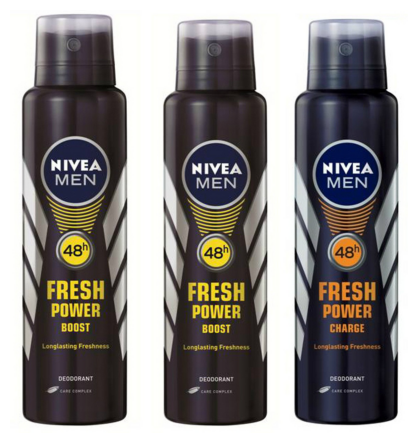

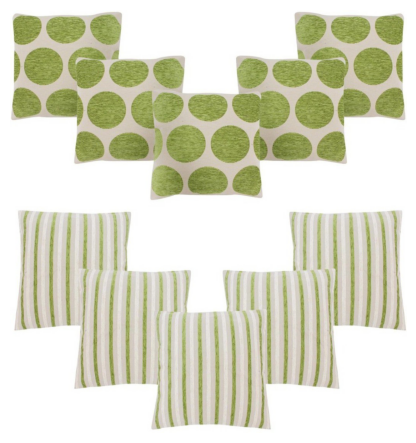

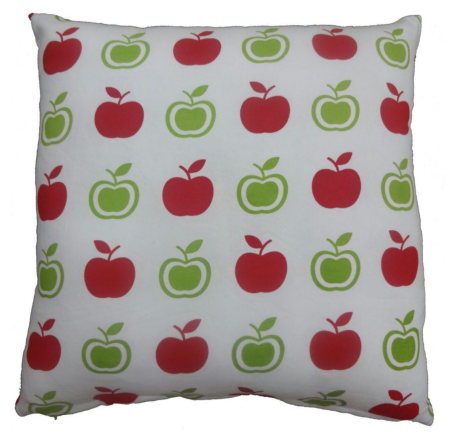

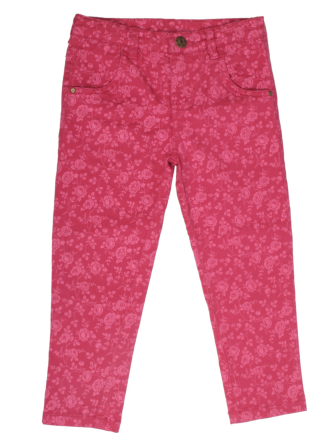

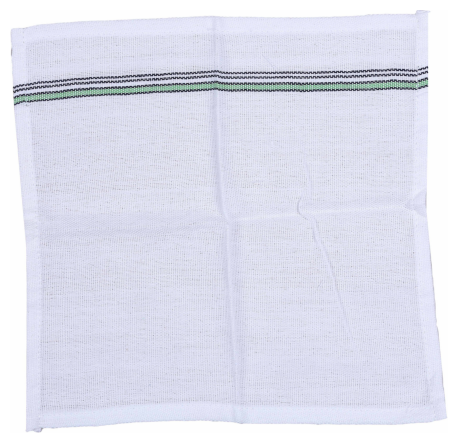

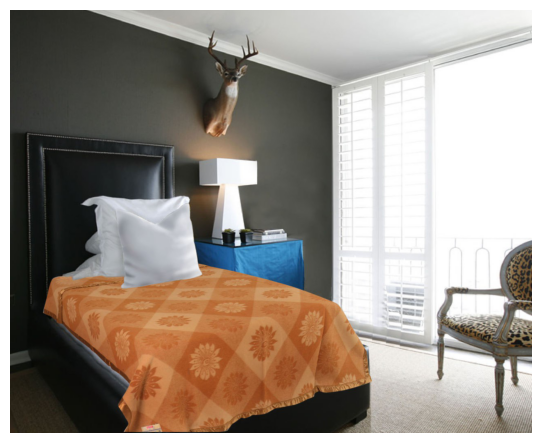

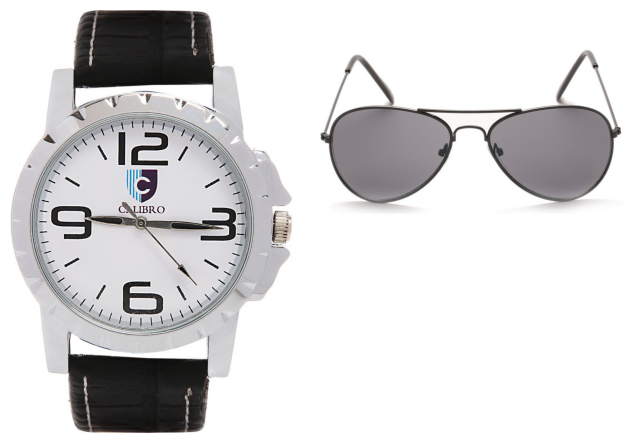

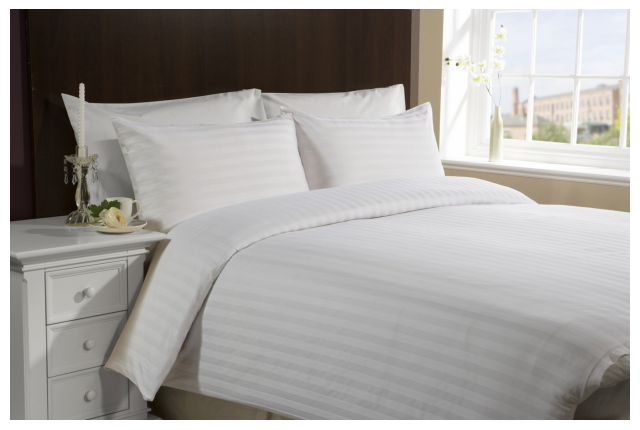

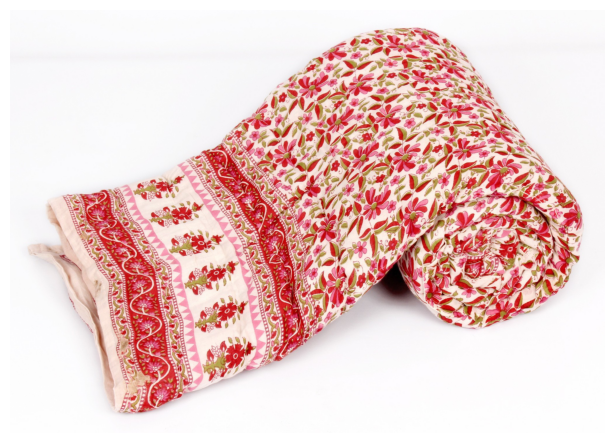

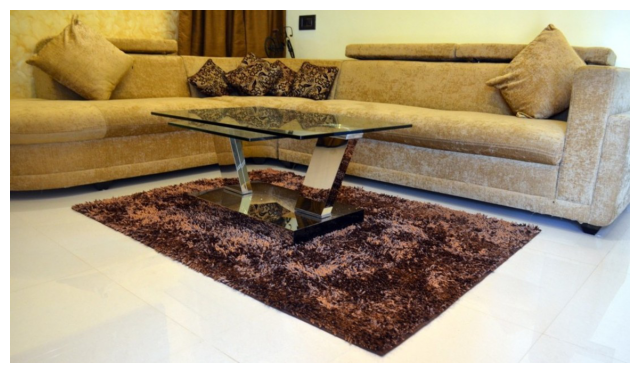

In [7]:
# Limite du nombre d'images à afficher
limite = 10

# Obtenir un échantillon aléatoire de lignes
echantillon = df.sample(n=limite)

# Lire et afficher les images de l'échantillon
for index, row in echantillon.iterrows():
    fichier = row['image']
    chemin_image = os.path.join(dossier_images, fichier)
    
    if os.path.exists(chemin_image):
        # Affichage de l'image
        image = Image.open(chemin_image)
        plt.imshow(image)
        plt.axis('off')
        plt.show()


### 2. Affichage aléatoire par catégorie d'image de la base de données

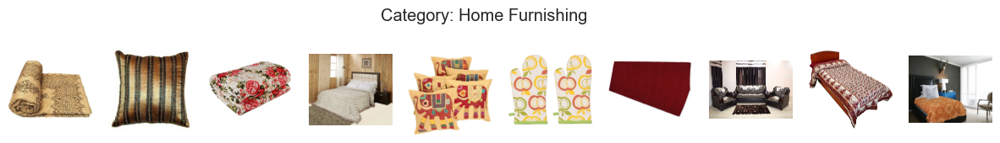

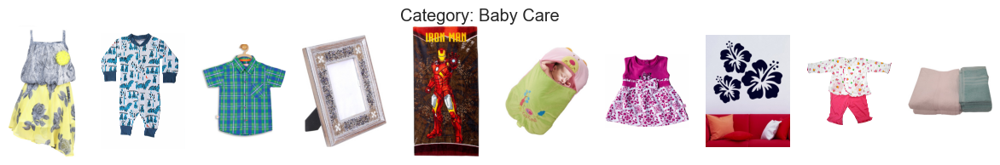

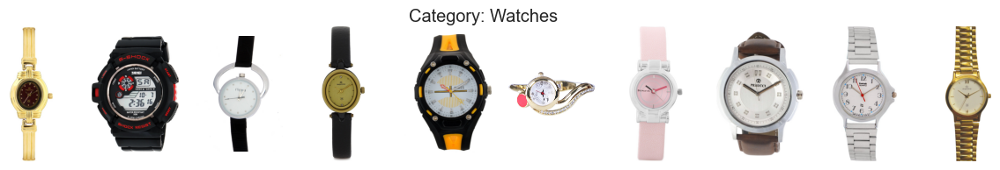

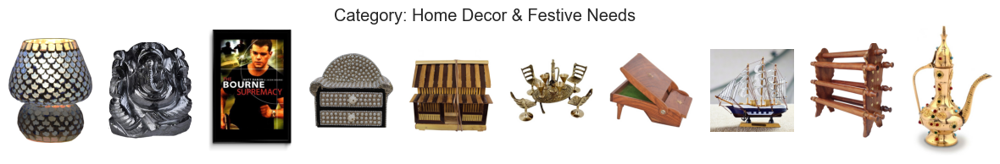

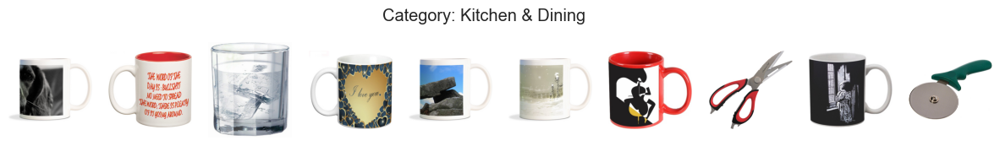

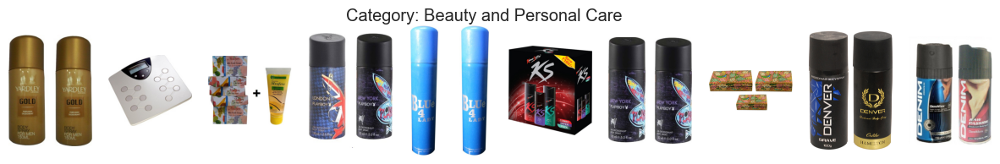

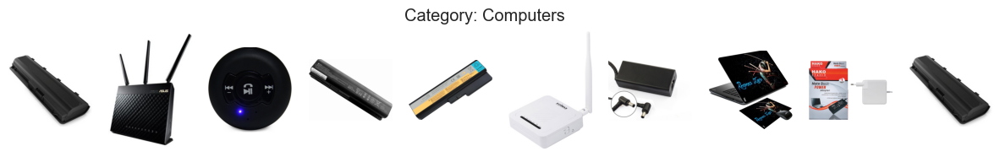

In [6]:
def print_sample_by_from_df(images, categories, n_img=10, n_rows=1, figsize=(15, 2)):
    unique_categories = categories.unique()
    for category in unique_categories:
        category_images = images[categories == category]
        sampled_images = category_images.sample(n=min(n_img, len(category_images)), random_state=42)

        # Configuration de l'affichage
        fig, axes = plt.subplots(n_rows, len(sampled_images) // n_rows + (len(sampled_images) % n_rows > 0),
                                 figsize=figsize)
        axes = axes.flatten()

        for ax, (idx, img_path) in zip(axes, sampled_images.items()):
            full_path = os.path.join(dossier_images, img_path)
            if os.path.exists(full_path):
                image = Image.open(full_path)
                ax.imshow(image)
                ax.axis('off')
            else:
                ax.axis('off')

        # Supprimer les axes restants si le nombre d'images est inférieur au nombre d'axes
        for ax in axes[len(sampled_images):]:
            ax.axis('off')

        plt.suptitle(f"Category: {category}")
        plt.show()


# Appel de la fonction pour afficher les images
print_sample_by_from_df(df['image'], df['Level_1'], n_img=10, n_rows=1, figsize=(15, 2))

# III. Analyse des images & modélisation en non-supervisée (k-means)

## Préambule

In [11]:
# création du dataframe associé à la l'analyse avec sift
df_sift = df[['product_name',
              'image',
              'Level_1']].copy()
df_sift.head(3)

,product_name,image,Level_1
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care


In [12]:
print('accès aux images', dossier_images)

accès aux images C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\Images


In [13]:
print(chemin_image)

C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\Images\4451f1b01168b6a085738d0b0f2f02aa.jpg


In [14]:
print('fichiers des images', fichiers_images)

fichiers des images ['009099b1f6e1e8f893ec29a7023153c4.jpg', '0096e89cc25a8b96fb9808716406fe94.jpg', '00cbbc837d340fa163d11e169fbdb952.jpg', '00d84a518e0550612fcfcba3b02b6255.jpg', '00e966a5049a262cfc72e6bbf68b80e7.jpg', '00ed03657cedbe4663eff2d7fa702a33.jpg', '01089dc3618a0ab7304d784ef400b83d.jpg', '0131e5d87b72877702d536299cf83b75.jpg', '020d2daba55a723128e4e07c0b0393a9.jpg', '02127f52e96fb72c66bf081d25104ef8.jpg', '025a85a3d1cddc6307f7dc075d8d2132.jpg', '02a53d335775b652f22f41b529b9d646.jpg', '02c63a087b298ec74042d557acf61be1.jpg', '031c98cfde349d99fb6d5983f54c8751.jpg', '032e812adcd11a38fd8b764891a852ff.jpg', '037b39bef3db7ccd264c577a0edf0c0a.jpg', '037c2402fee39fbc80433935711d1383.jpg', '04f9f818e2d657b873b07578cfe2eade.jpg', '04f9ff160a1561e3656350f4bd6b8c50.jpg', '050ea3acb555bf641e7ae9b4f3ba684a.jpg', '052559ede419996737893eb47568ee7f.jpg', '057836ecde71565f8ebdd576e41fdc96.jpg', '059493eeb88ebb4cc08d1522f3f87c3f.jpg', '059bc43e03e1824a9ab6466e32e5f137.jpg', '06749cbff1487f4704

## A. Approche avec SIFT

### 1. Prétraitement des images

- Redimensionner les images pour qu'elles aient des dimensions cohérentes
- Convertir les images en niveaux de gris pour simplifier le calcul des descripteurs

#### i. Tests & essais de pré-traitement

Les pré-traitements testés :
- redimensionnement
- la normalisation
- conversion au niveau de gris
- lissage et diminution du bruit
- manipulations diverses (rotation, cisaillement, zoom, ...)
- transformation en array numpy

**Redimensionnement**

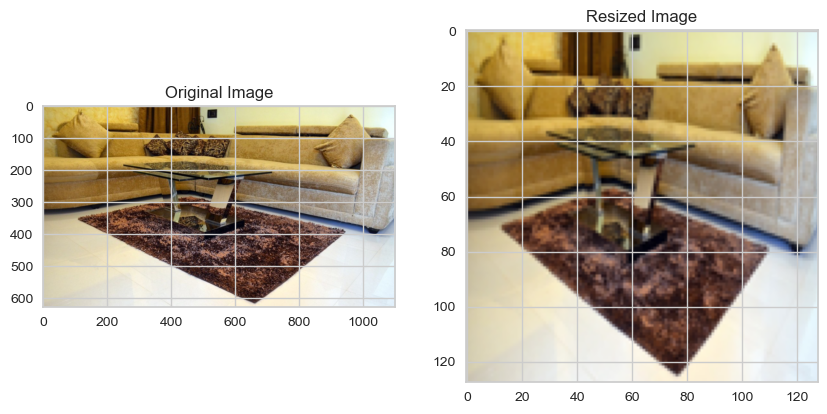

In [8]:
def resize_image(image_path, size=(128, 128)):
    image = Image.open(image_path)
    resized_image = image.resize(size)
    return resized_image

image_path = chemin_image
original_image = Image.open(image_path)
resized_image = resize_image(image_path)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(original_image)
plt.subplot(1, 2, 2)
plt.title("Resized Image")
plt.imshow(resized_image)
plt.show()


**Normalisation**

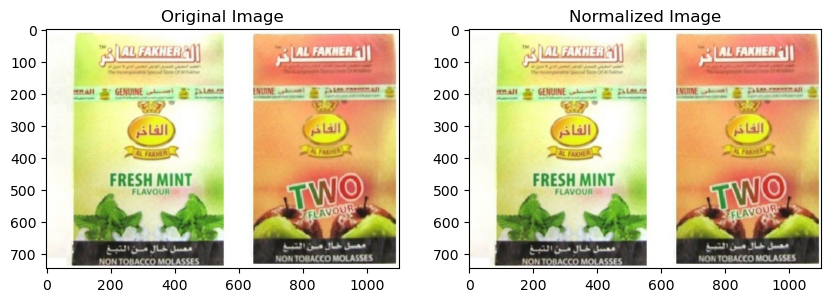

In [24]:
def normalize_image(image):
    image = np.array(image)
    normalized_image = image / 255.0
    return normalized_image

normalized_image = normalize_image(original_image)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(original_image)
plt.subplot(1, 2, 2)
plt.title("Normalized Image")
plt.imshow(normalized_image)
plt.show()

**Conversion en niveau de gris**

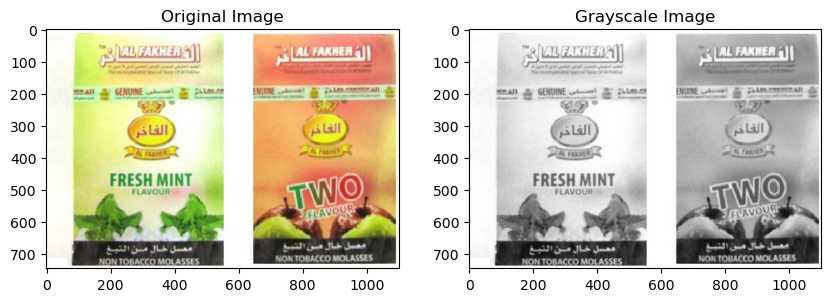

In [25]:
def convert_to_grayscale(image):
    grayscale_image = image.convert("L")
    return grayscale_image

grayscale_image = convert_to_grayscale(original_image)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(original_image)
plt.subplot(1, 2, 2)
plt.title("Grayscale Image")
plt.imshow(grayscale_image, cmap='gray')
plt.show()

**Augmentation des données**

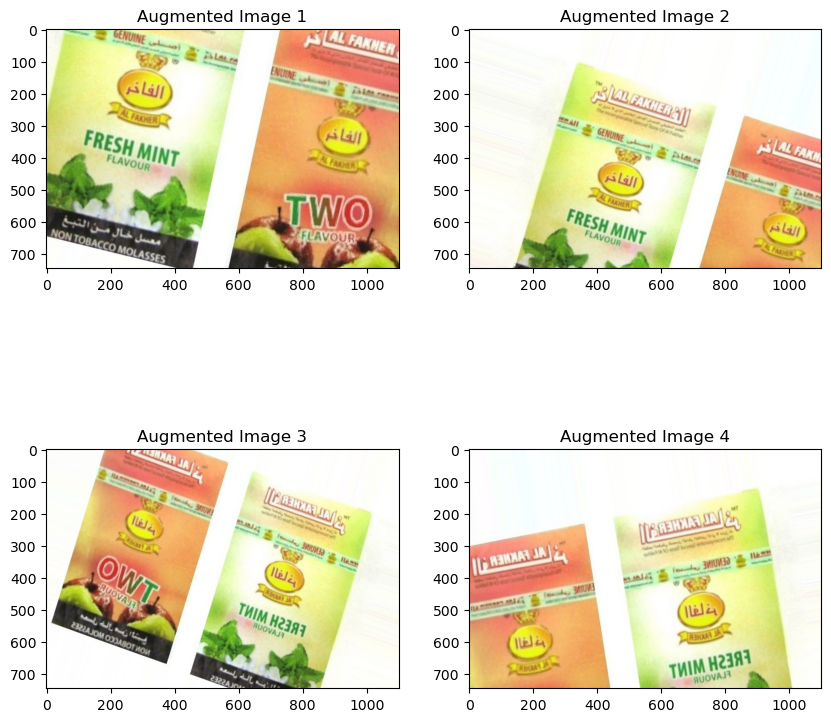

In [31]:
def augment_image(image):
    datagen = ImageDataGenerator(
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest'
    )
    image = img_to_array(image)
    image = image.reshape((1,) + image.shape)
    augmented_images = [next(datagen.flow(image, batch_size=1))[0] for _ in range(4)]
    return augmented_images

augmented_images = augment_image(original_image)

plt.figure(figsize=(10, 10))
plt.subplot(2, 2, 1)
plt.title("Augmented Image 1")
plt.imshow(array_to_img(augmented_images[0]))
plt.subplot(2, 2, 2)
plt.title("Augmented Image 2")
plt.imshow(array_to_img(augmented_images[1]))
plt.subplot(2, 2, 3)
plt.title("Augmented Image 3")
plt.imshow(array_to_img(augmented_images[2]))
plt.subplot(2, 2, 4)
plt.title("Augmented Image 4")
plt.imshow(array_to_img(augmented_images[3]))
plt.show()


**Lissage et diminution du bruit**

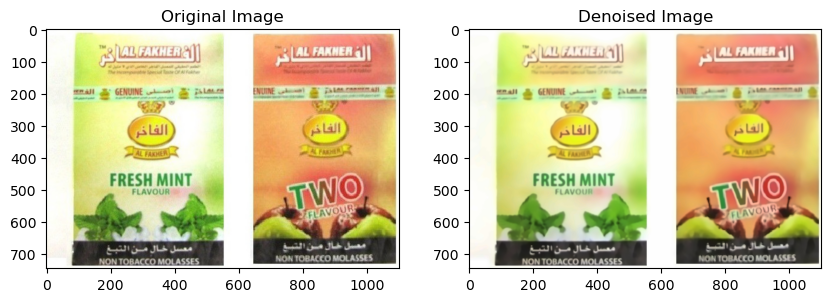

In [32]:
def denoise_image(image):
    image = np.array(image)
    denoised_image = cv2.fastNlMeansDenoisingColored(image, None, 10, 10, 7, 21)
    return denoised_image

denoised_image = denoise_image(original_image)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(original_image)
plt.subplot(1, 2, 2)
plt.title("Denoised Image")
plt.imshow(denoised_image)
plt.show()

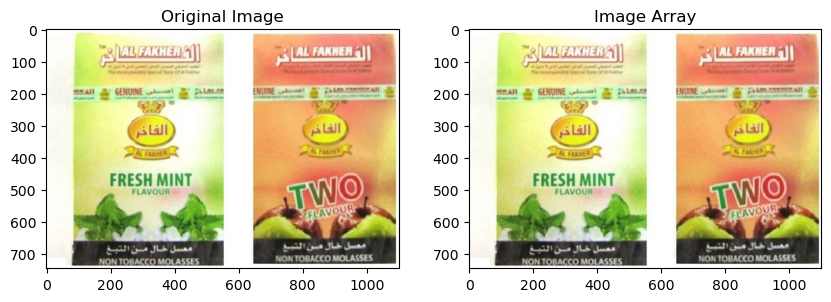

In [33]:
def image_to_array(image):
    return np.array(image)

image_array = image_to_array(original_image)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(original_image)
plt.subplot(1, 2, 2)
plt.title("Image Array")
plt.imshow(image_array)
plt.show()

#### ii. Fonction de pré-traitement des images

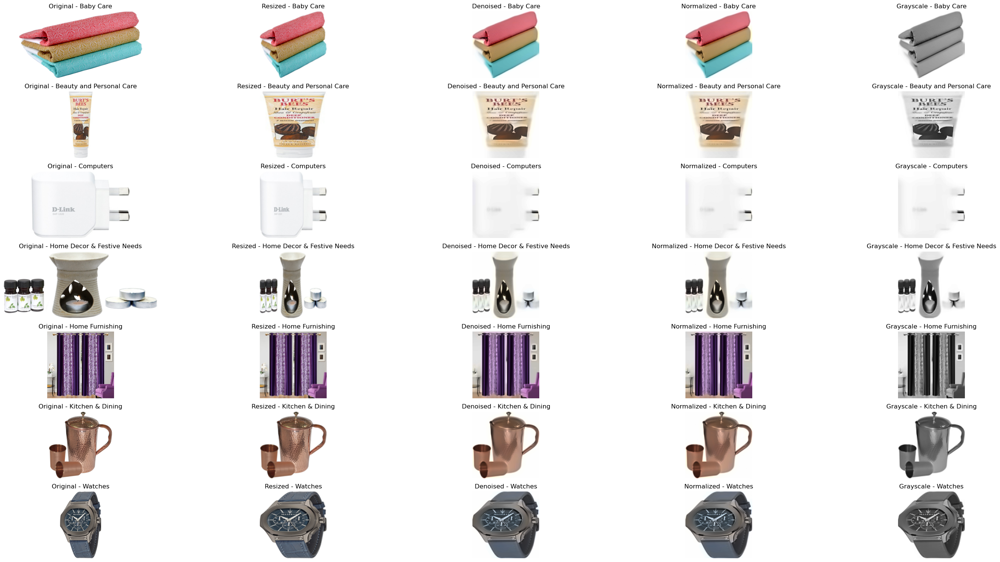

In [14]:
# Augmenter la limite de taille d'image autorisée par PIL
Image.MAX_IMAGE_PIXELS = None

# Fonction pour redimensionner l'image
def resize_image(image, size=(128, 128)):
    return image.resize(size)

# Fonction pour normaliser l'image
def normalize_image(image):
    image = np.array(image)
    return image / 255.0

# Fonction pour convertir en niveaux de gris
def convert_to_grayscale(image):
    return image.convert("L")

# Fonction pour réduire le bruit
def denoise_image(image):
    image = np.array(image)
    denoised_image = cv2.fastNlMeansDenoisingColored(image, None, 10, 10, 7, 21)
    return Image.fromarray(denoised_image)

# Fonction pour appliquer toutes les transformations combinées
def transform_image(image_path, output_dir, size=(128, 128)):
    image = Image.open(image_path)
    
    # Appliquer les transformations
    resized_image = resize_image(image, size)
    denoised_image = denoise_image(np.array(resized_image))
    normalized_image = normalize_image(denoised_image)
    grayscale_image = convert_to_grayscale(Image.fromarray((normalized_image * 255).astype(np.uint8)))
    
    base_name = os.path.basename(image_path)
    name, ext = os.path.splitext(base_name)

    resized_image.save(os.path.join(output_dir, f"{name}_resized{ext}"))
    denoised_image.save(os.path.join(output_dir, f"{name}_denoised{ext}"))
    Image.fromarray((normalized_image * 255).astype(np.uint8)).save(os.path.join(output_dir, f"{name}_normalized{ext}"))
    grayscale_image.save(os.path.join(output_dir, f"{name}_grayscale{ext}"))
    
    return resized_image, denoised_image, normalized_image, grayscale_image

# Sélectionner une image par catégorie
categories = df_sift['Level_1'].unique()
selected_images = df_sift.groupby('Level_1').first().reset_index()

# Dossier d'entrée
input_dir = r"C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\Images"
# Dossier de sortie
output_dir = r"C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\Images_transform"
os.makedirs(output_dir, exist_ok=True)

# Afficher les images avant et après pré-traitement
plt.figure(figsize=(30, 15))
for idx, row in selected_images.iterrows():
    image_path = os.path.join(input_dir, row['image'])
    if os.path.exists(image_path):
        resized_image, denoised_image, normalized_image, grayscale_image = transform_image(image_path, output_dir)
        
        # Afficher l'image originale
        plt.subplot(len(categories), 5, 5*idx + 1)
        plt.title(f"Original - {row['Level_1']}")
        original_image = Image.open(image_path)
        plt.imshow(original_image)
        plt.axis('off')
        
        # Afficher l'image redimensionnée
        plt.subplot(len(categories), 5, 5*idx + 2)
        plt.title(f"Resized - {row['Level_1']}")
        plt.imshow(resized_image)
        plt.axis('off')
        
        # Afficher l'image débruitée
        plt.subplot(len(categories), 5, 5*idx + 3)
        plt.title(f"Denoised - {row['Level_1']}")
        plt.imshow(denoised_image)
        plt.axis('off')
        
        # Afficher l'image normalisée
        plt.subplot(len(categories), 5, 5*idx + 4)
        plt.title(f"Normalized - {row['Level_1']}")
        plt.imshow(normalized_image)
        plt.axis('off')
        
        # Afficher l'image convertie en niveaux de gris (toutes les transformations)
        plt.subplot(len(categories), 5, 5*idx + 5)
        plt.title(f"Grayscale - {row['Level_1']}")
        plt.imshow(grayscale_image, cmap='gray')
        plt.axis('off')

plt.tight_layout()
plt.show()


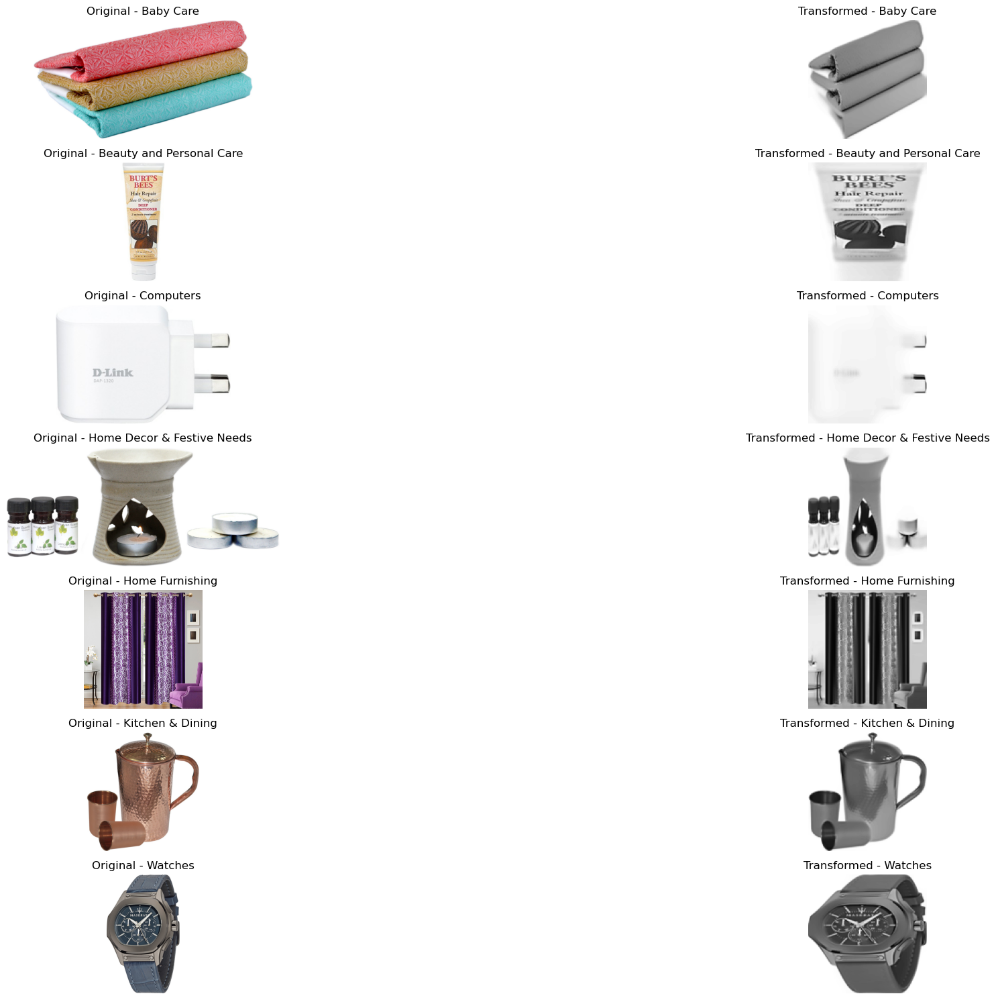

In [16]:
# Augmenter la limite de taille d'image autorisée par PIL
Image.MAX_IMAGE_PIXELS = None

# Fonction pour redimensionner l'image
def resize_image(image, size=(128, 128)):
    return image.resize(size)

# Fonction pour normaliser l'image
def normalize_image(image):
    image = np.array(image)
    return image / 255.0

# Fonction pour convertir en niveaux de gris
def convert_to_grayscale(image):
    return image.convert("L")

# Fonction pour réduire le bruit
def denoise_image(image):
    denoised_image = cv2.fastNlMeansDenoisingColored(np.array(image), None, 10, 10, 7, 21)
    return Image.fromarray(denoised_image)

# Fonction pour appliquer toutes les transformations combinées
def transform_image(image_path, output_dir, size=(128, 128)):
    image = Image.open(image_path)
    
    # Appliquer les transformations
    resized_image = resize_image(image, size)
    denoised_image = denoise_image(resized_image)
    normalized_image = normalize_image(denoised_image)
    grayscale_image = convert_to_grayscale(Image.fromarray((normalized_image * 255).astype(np.uint8)))
    
    base_name = os.path.basename(image_path)
    name, ext = os.path.splitext(base_name)

    # Enregistrer uniquement l'image finale avec toutes les transformations
    grayscale_image.save(os.path.join(output_dir, f"{name}_final{ext}"))
    
    return grayscale_image

# Sélectionner une image par catégorie
categories = df_sift['Level_1'].unique()
selected_images = df_sift.groupby('Level_1').first().reset_index()

# Dossier d'entrée
input_dir = r"C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\Images"
# Dossier de sortie
output_dir = r"C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\Images_transform"
os.makedirs(output_dir, exist_ok=True)

# Afficher les images avant et après pré-traitement
plt.figure(figsize=(30, 15))
for idx, row in selected_images.iterrows():
    image_path = os.path.join(input_dir, row['image'])
    if os.path.exists(image_path):
        final_image = transform_image(image_path, output_dir)
        
        # Afficher l'image originale
        plt.subplot(len(categories), 2, 2*idx + 1)
        plt.title(f"Original - {row['Level_1']}")
        original_image = Image.open(image_path)
        plt.imshow(original_image)
        plt.axis('off')
        
        # Afficher l'image avec toutes les transformations
        plt.subplot(len(categories), 2, 2*idx + 2)
        plt.title(f"Transformed - {row['Level_1']}")
        plt.imshow(final_image, cmap='gray')
        plt.axis('off')

plt.tight_layout()
plt.show()


#### iii. Transformation de la banque d'images

Pré-traitements opérés :
- Augmentation du contraste
- Réduction du bruit 
- Normalisation (valeurs du pixel de 0 à 1, au lien de 0 à 255)
- Conversion en niveau de gris

**Première phase de pré-traitement des images**

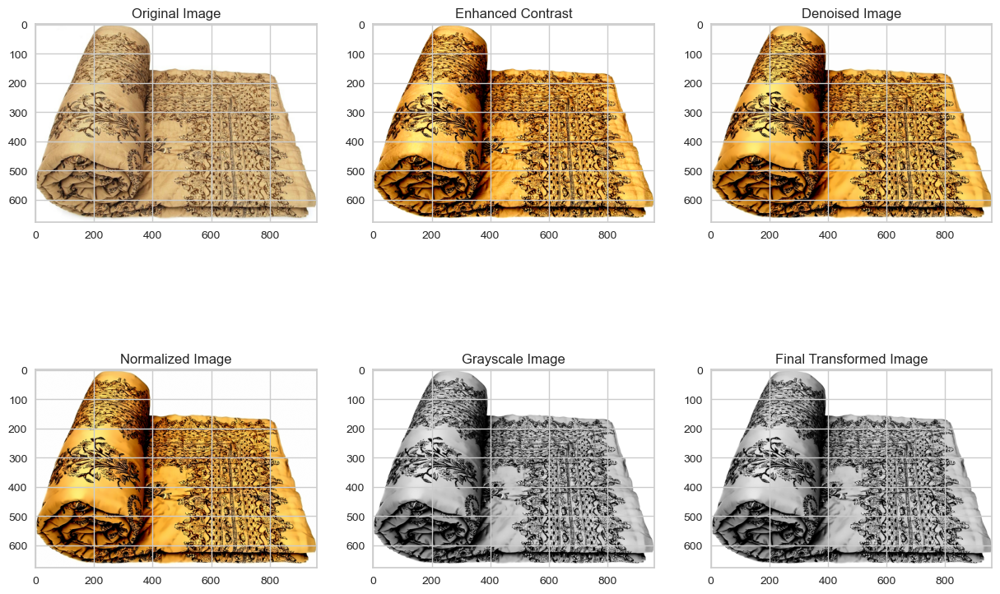

In [9]:
# Augmenter la limite de taille d'image autorisée par PIL
Image.MAX_IMAGE_PIXELS = None

# Fonction pour augmenter le contraste de l'image
def enhance_contrast(image, factor=3):
    enhancer = ImageEnhance.Contrast(image)
    return enhancer.enhance(factor)

# Fonction pour normaliser l'image
def normalize_image(image):
    image = np.array(image)
    return image / 255.0

# Fonction pour convertir en niveaux de gris
def convert_to_grayscale(image):
    return image.convert("L")

# Fonction pour réduire le bruit
def denoise_image(image):
    denoised_image = cv2.fastNlMeansDenoisingColored(np.array(image), None, 10, 10, 7, 21)
    return Image.fromarray(denoised_image)

# Fonction pour appliquer toutes les transformations combinées et afficher les étapes intermédiaires
def visualize_transformations(image_path, contrast_factor=2.0):
    image = Image.open(image_path)
    
    # Afficher l'image d'origine
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 3, 1)
    plt.title('Original Image')
    plt.imshow(image)
    
    # Appliquer et afficher l'augmentation du contraste
    contrast_image = enhance_contrast(image, contrast_factor)
    plt.subplot(2, 3, 2)
    plt.title('Enhanced Contrast')
    plt.imshow(contrast_image)
    
    # Appliquer et afficher la réduction de bruit
    denoised_image = denoise_image(contrast_image)
    plt.subplot(2, 3, 3)
    plt.title('Denoised Image')
    plt.imshow(denoised_image)
    
    # Appliquer et afficher la normalisation
    normalized_image = normalize_image(denoised_image)
    plt.subplot(2, 3, 4)
    plt.title('Normalized Image')
    plt.imshow(normalized_image)
    
    # Appliquer et afficher la conversion en niveaux de gris
    grayscale_image = convert_to_grayscale(Image.fromarray((normalized_image * 255).astype(np.uint8)))
    plt.subplot(2, 3, 5)
    plt.title('Grayscale Image')
    plt.imshow(grayscale_image, cmap='gray')
    
    # Afficher l'image finale avec toutes les transformations
    plt.subplot(2, 3, 6)
    plt.title('Final Transformed Image')
    plt.imshow(grayscale_image, cmap='gray')
    
    plt.show()

# Chemin de l'image à visualiser
image_path = r"C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\Images\8872dd7ca802f56c1c3ee07e22e84cfd.jpg"

# Visualiser les transformations sur une image exemple
visualize_transformations(image_path)


In [53]:
# Augmenter la limite de taille d'image autorisée par PIL
Image.MAX_IMAGE_PIXELS = None

# Fonction pour augmenter le contraste de l'image
def enhance_contrast(image, factor=3):
    enhancer = ImageEnhance.Contrast(image)
    return enhancer.enhance(factor)

# Fonction pour normaliser l'image
def normalize_image(image):
    return np.array(image) / 255.0

# Fonction pour convertir en niveaux de gris
def convert_to_grayscale(image):
    return image.convert("L")

# Fonction pour réduire le bruit
def denoise_image(image):
    return cv2.fastNlMeansDenoisingColored(np.array(image), None, 10, 10, 7, 21)

# Fonction pour appliquer toutes les transformations combinées
def transform_image(image_path, output_dir, contrast_factor=2.0):
    image = Image.open(image_path)

    # Appliquer les transformations
    contrast_image = enhance_contrast(image, contrast_factor)
    denoised_image = denoise_image(contrast_image)
    normalized_image = normalize_image(denoised_image)
    grayscale_image = convert_to_grayscale(Image.fromarray((normalized_image * 255).astype(np.uint8)))

    base_name = os.path.basename(image_path)
    name, ext = os.path.splitext(base_name)

    # Enregistrer l'image finale avec toutes les transformations
    final_path = os.path.join(output_dir, f"{name}_final{ext}")
    grayscale_image.save(final_path)
    
    return final_path

# Dossier d'entrée
input_dir = r"C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\Images"
# Dossier de sortie
output_dir = r"C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\all_transform_sift_aug"
os.makedirs(output_dir, exist_ok=True)

# Parcourir et transformer toutes les images du répertoire d'entrée
image_files = [os.path.join(root, file) for root, _, files in os.walk(input_dir) for file in files if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif'))]

# Utiliser tqdm pour afficher la barre de progression
for image_path in tqdm(image_files, desc="Processing images"):
    transform_image(image_path, output_dir)

print(f"Total number of images transformed: {len(image_files)}")


Processing images: 100%|██████████| 1050/1050 [2:22:26<00:00,  8.14s/it] 

Total number of images transformed: 1050


**Data augmentation**

In [15]:
# Fonction pour créer une nouvelle colonne avec le nom de l'image pré-traitée
def transform_image_name(image_name):
    name, ext = image_name.rsplit('.', 1)
    return f"{name}_final.{ext}"

# application de la fonction
df_sift['image_transform'] = df_sift['image'].apply(transform_image_name)

df_sift.head(3)

,product_name,image,Level_1,image_transform
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,55b85ea15a1536d46b7190ad6fff8ce7_final.jpg
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,7b72c92c2f6c40268628ec5f14c6d590_final.jpg
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,64d5d4a258243731dc7bbb1eef49ad74_final.jpg


In [56]:
# Définir les augmentations à appliquer
augmenters = iaa.Sequential([
    iaa.Fliplr(0.5), # Flip horizontalement avec une probabilité de 50%
    iaa.Flipud(0.5), # Flip verticalement avec une probabilité de 50%
    iaa.Affine(rotate=(-45, 45)), # Rotation entre -45 et 45 degrés
    iaa.Affine(translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)}), # Translation sur les axes x et y
    iaa.Affine(scale=(0.8, 1.2)), # Zoom entre 80% et 120%
    iaa.Multiply((0.8, 1.2)), # Modification de la luminosité
])

# Fonction pour appliquer les augmentations
def augment_image(image):
    image = np.array(image)
    augmented_images = augmenters(images=[image for _ in range(5)]) 
    return [Image.fromarray(aug_img) for aug_img in augmented_images]

# Dossier d'entrée pour les images
input_dir = r"C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\all_transform_sift_aug"

# Dossier de sortie pour les images augmentées
augmented_output_dir = r"C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\augmented_images"
os.makedirs(augmented_output_dir, exist_ok=True)

# DataFrame pour stocker les nouvelles étiquettes
augmented_labels = []

# Appliquer les augmentations à toutes les images transformées avec une barre de progression
for index, row in tqdm(df_sift.iterrows(), total=df_sift.shape[0], desc="Processing images"):
    image_path = os.path.join(input_dir, row['image_transform']) 
    label = row['Level_1']
    
    if os.path.exists(image_path):
        image = Image.open(image_path)
        augmented_images = augment_image(image)
        
        # Sauvegarder les images augmentées et leurs étiquettes
        base_name = os.path.basename(image_path)
        name, ext = os.path.splitext(base_name)
        
        for i, aug_img in enumerate(augmented_images):
            new_image_name = f"{name}_aug_{i}{ext}"
            new_image_path = os.path.join(augmented_output_dir, new_image_name)
            aug_img.save(new_image_path)
            
            # Ajouter le chemin et l'étiquette de la nouvelle image au DataFrame
            augmented_labels.append([new_image_name, label])

# Convertir les nouvelles étiquettes en DataFrame et sauvegarder dans un nouveau fichier CSV
augmented_labels_df = pd.DataFrame(augmented_labels, columns=['image_name', 'Level_1'])
augmented_labels_df.to_csv('augmented_labels.csv', index=False)

print(f"Data augmentation completed and saved in: {augmented_output_dir}")
print(f"New labels saved in: augmented_labels.csv")


Processing images: 100%|██████████| 1050/1050 [04:58<00:00,  3.52it/s]

Data augmentation completed and saved in: C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\augmented_images
New labels saved in: augmented_labels.csv


In [28]:
# afficher le dataframe avec les étiquettes et les nouvelles images
augmented_labels_df = pd.read_csv('augmented_labels.csv')

print('Structure du dataframe:', augmented_labels_df.shape)
augmented_labels_df.head(3)

Structure du dataframe: (5250, 2)


,image_name,Level_1
0,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_0.jpg,Home Furnishing
1,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_1.jpg,Home Furnishing
2,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_2.jpg,Home Furnishing


### 2. Extraction des caractéristiques avec SIFT

Utiliser l'algorithme SIFT pour détecter et décrire les points d'intérêt dans chaque image.

**Les hyperparamètres de Sift**

- contrastThreshold : Définit le seuil de contraste pour filtrer les points faibles.

Plus élevé : Moins de points d'intérêt détectés, plus robuste contre le bruit.
Moins élevé : Plus de points d'intérêt détectés, mais potentiellement plus de bruit.

- edgeThreshold : Fixe le seuil pour éliminer les points sur les bords.

Plus élevé : Moins de points sur les bords, réduction des points d'intérêt non pertinents.
Moins élevé : Plus de points sur les bords, possible détection de points d'intérêt non pertinents.

- sigma : Contrôle l'ampleur du flou gaussien appliqué pour la détection d'échelles.

Plus élevé : Lissage plus important, moins de détails fins détectés.
Moins élevé : Lissage moins important, plus de détails fins détectés.

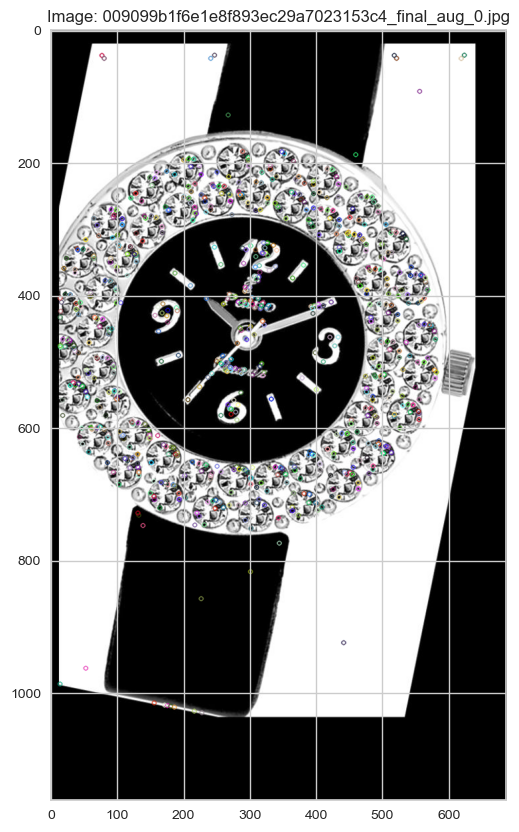

In [13]:
# Chemin vers le répertoire contenant les images
image_directory = r'C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\augmented_images'

# Initialiser SIFT avec des hyperparamètres personnalisés
sift = cv2.SIFT_create(nfeatures= 750, contrastThreshold= 0.05, edgeThreshold=50, sigma=1.6)
                   
# Variable pour indiquer si une image est déjà traitée
image_processed = False

# Parcourir les images dans le répertoire
for filename in os.listdir(image_directory):
    if filename.endswith(".jpg"):
        image_path = os.path.join(image_directory, filename)
        
        # Charger l'image avec PIL
        try:
            pil_image = Image.open(image_path)
        except Exception as e:
            print(f"Erreur lors du chargement de l'image {filename}: {e}")
            continue
        
        # Convertir l'image PIL en image OpenCV
        gray_image = np.array(pil_image.convert('L'))
        
        # Détection des points d'intérêt
        keypoints, descriptors = sift.detectAndCompute(gray_image, None)
        
        if keypoints is None or descriptors is None:
            print(f"Aucun point d'intérêt détecté dans l'image {filename}.")
            continue
        
        # Dessiner les points d'intérêt sur l'image
        sift_image = cv2.drawKeypoints(gray_image, keypoints, None)
        
        # Affichage de l'image avec les points d'intérêt
        plt.figure(figsize=(10, 10))
        plt.imshow(sift_image, cmap='gray')
        plt.title(f'Image: {filename}')
        plt.show()
        
        # Sauvegarder l'image avec les points d'intérêt
        output_path = os.path.join(image_directory, f'sift_{filename}')
        cv2.imwrite(output_path, sift_image)
        
        # Indiquer qu'une image a été traitée
        image_processed = True

        # Quitter la boucle après avoir traité une seule image
        break

# Si aucune image n'a été trouvée et traitée
if not image_processed:
    print("Aucune image trouvée dans le répertoire spécifié.")


In [14]:
# Augmenter le seuil de pixels pour les images
Image.MAX_IMAGE_PIXELS = None

# Chemin vers le répertoire contenant les images
image_directory = r'C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\augmented_images'

# Initialiser SIFT
sift = cv2.SIFT_create(nfeatures= 750, contrastThreshold= 0.05, edgeThreshold=50, sigma=1.6)

# Dictionnaire pour stocker les descripteurs
sift_descriptors = {}

# Obtenir la liste des fichiers d'image
image_files = [f for f in os.listdir(image_directory) if f.endswith(".jpg")]

# Parcourir les images dans le répertoire avec une barre de progression
for filename in tqdm(image_files, desc="Processing images"):
    image_path = os.path.join(image_directory, filename)
    
    # Charger l'image avec PIL
    try:
        pil_image = Image.open(image_path)
    except Exception as e:
        print(f"Erreur lors du chargement de l'image {filename}: {e}")
        continue
    
    # Convertir l'image PIL en image OpenCV
    try:
        gray_image = np.array(pil_image)
    except Exception as e:
        print(f"Erreur lors de la conversion de l'image {filename}: {e}")
        continue
    
    # Détection des points d'intérêt et extraction des descripteurs
    keypoints, descriptors = sift.detectAndCompute(gray_image, None)
    
    # Stocker les descripteurs dans le dictionnaire
    if descriptors is not None:
        sift_descriptors[filename] = descriptors
    else:
        print(f"Aucun descripteur trouvé pour l'image {filename}")

# Sauvegarder les descripteurs dans un fichier pickle
try:
    with open('sift_descriptors.pkl', 'wb') as f:
        pickle.dump(sift_descriptors, f)
    print(f"Descripteurs SIFT extraits et sauvegardés pour {len(sift_descriptors)} images.")
except Exception as e:
    print(f"Erreur lors de la sauvegarde des descripteurs: {e}")


Processing images: 100%|██████████| 5250/5250 [1:08:18<00:00,  1.28it/s] 


Descripteurs SIFT extraits et sauvegardés pour 5250 images.


### 3. Construction d'un dictionnaire visuel (type Bags of Features)

- Combiner tous les descripteurs extraits de toutes les images.
- Utiliser le clustering le k-means pour regrouper ces descripteurs en un nombre fixe de clusters (mots visuels).
- Chaque cluster représentera un mot visuel dans le dictionnaire visuel.

#### 1. Charger et réduire les descripteurs par image avec PCA

In [19]:
# Charger les descripteurs SIFT
with open('sift_descriptors.pkl', 'rb') as f:
    sift_descriptors = pickle.load(f)

# Combine all descriptors to fit PCA
all_descriptors = []
for descriptors in sift_descriptors.values():
    if len(descriptors) > 0 and not np.isnan(descriptors).any() and not np.isinf(descriptors).any():
        all_descriptors.extend(descriptors)
all_descriptors = np.array(all_descriptors)

# Initialiser la PCA pour conserver 98% de la variance
pca = PCA(n_components=0.98)
pca.fit(all_descriptors)

# Réduire les descripteurs par image en utilisant la PCA ajustée
sift_descriptors_reduced = {}
for image, descriptors in sift_descriptors.items():
    if len(descriptors) > 0 and not np.isnan(descriptors).any() and not np.isinf(descriptors).any():
        sift_descriptors_reduced[image] = pca.transform(descriptors)

# Enregistrer les descripteurs réduits
with open('sift_descriptors_reduced.pkl', 'wb') as f:
    pickle.dump(sift_descriptors_reduced, f)

# Afficher le nombre de composantes principales
num_components = pca.n_components_
print('Nombre de composantes principales restantes :', num_components)


Nombre de composantes principales restantes : 92


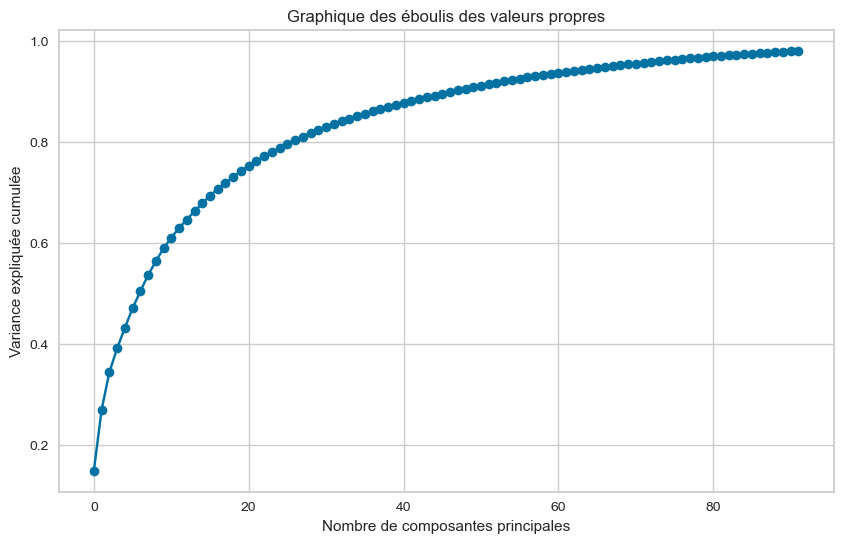

In [20]:
# Tracer le graphique des éboulis des valeurs propres
plt.figure(figsize=(10, 6))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.xlabel('Nombre de composantes principales')
plt.ylabel('Variance expliquée cumulée')
plt.title('Graphique des éboulis des valeurs propres')
plt.grid(True)
plt.show()

#### 2. Clustering avec MiniBatchKMeans

C:\Users\justi\AppData\Roaming\Python\Python311\site-packages\yellowbrick\utils\kneed.py:156: YellowbrickWarning: No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.
  warnings.warn(warning_message, YellowbrickWarning)
C:\Users\justi\AppData\Roaming\Python\Python311\site-packages\yellowbrick\cluster\elbow.py:374: YellowbrickWarning: No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning
  warnings.warn(warning_message, YellowbrickWarning)


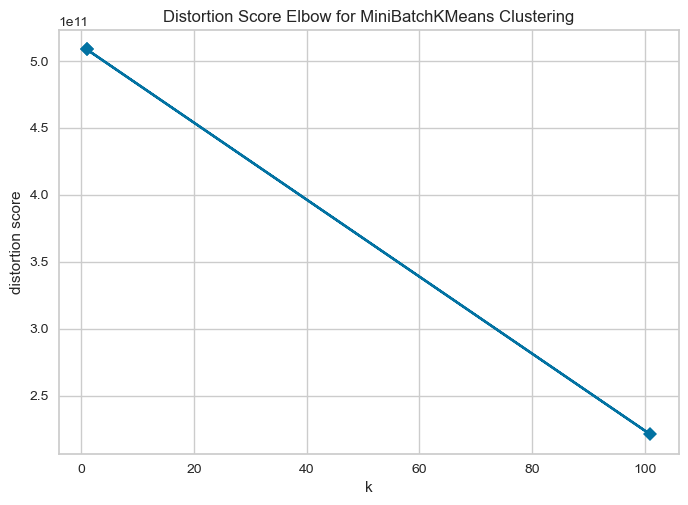

<Axes: title={'center': 'Distortion Score Elbow for MiniBatchKMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [24]:
from yellowbrick.cluster import KElbowVisualizer

# Charger les descripteurs réduits
with open('sift_descriptors_reduced.pkl', 'rb') as f:
    sift_descriptors_reduced = pickle.load(f)

# Rassembler tous les descripteurs réduits
all_descriptors_reduced = np.concatenate(list(sift_descriptors_reduced.values()))

# Utiliser Yellowbrick pour déterminer l'inertie pour différents nombres de clusters
kmeans = MiniBatchKMeans(random_state=42, max_iter=100, batch_size=1000, n_init=10)
visualizer = KElbowVisualizer(kmeans, k=(1, 101, 1), timings=False)

visualizer.fit(all_descriptors_reduced)       
visualizer.show()                             


In [35]:
# Hyperparamètres MiniBatchKMeans
num_clusters = 500
random_state = 42
max_iter = 300
batch_size = 1000
n_init = 10

# Charger les descripteurs réduits
with open('sift_descriptors_reduced.pkl', 'rb') as f:
    sift_descriptors_reduced = pickle.load(f)

# Rassembler tous les descripteurs réduits
all_descriptors_reduced = np.concatenate(list(sift_descriptors_reduced.values()))

# Application de MiniBatchKMeans avec les hyperparamètres spécifiés
minibatch_kmeans_model = MiniBatchKMeans(n_clusters=num_clusters, random_state=random_state, max_iter=max_iter, batch_size=batch_size, n_init=n_init)
minibatch_kmeans_model.fit(all_descriptors_reduced)

# Enregistrer le modèle MiniBatchKMeans dans un fichier pickle
with open('minibatch_kmeans_model.pkl', 'wb') as f:
    pickle.dump(minibatch_kmeans_model, f)

print("MiniBatchKMeans model has been saved to 'minibatch_kmeans_model.pkl'")

MiniBatchKMeans model has been saved to 'minibatch_kmeans_model.pkl'


#### 3. Création des histogrammes pour chaque image

Nous allons utiliser les descripteurs extraits pour générer un histogramme de mots visuels en fonction du dictionnaire construit.
Chaque histogramme représente une image sous forme vectorielle, en comptant la fréquence de chaque mot visuel.

Creating histograms: 100%|██████████| 5250/5250 [00:17<00:00, 297.67it/s]


Histograms created and saved for 5250 images.


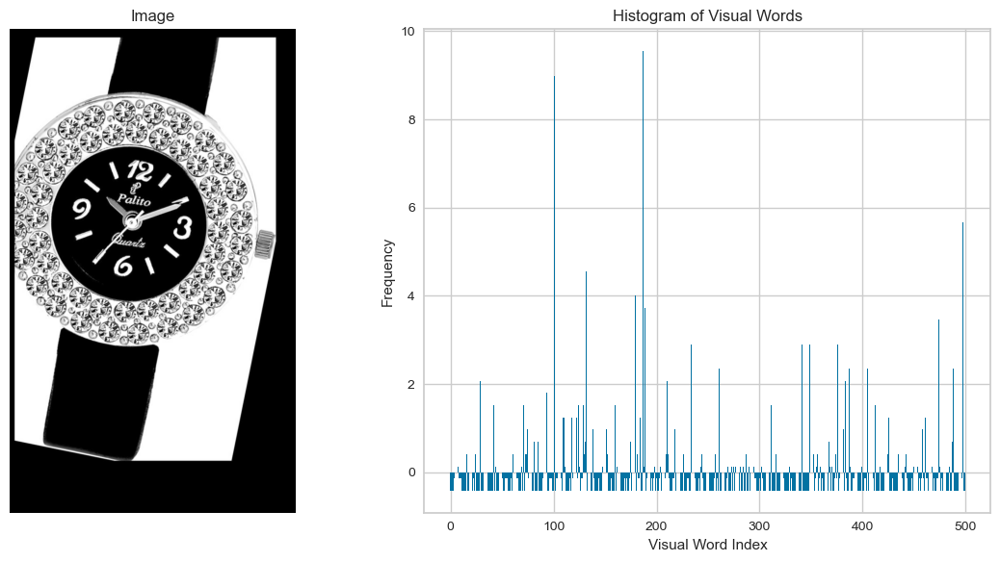

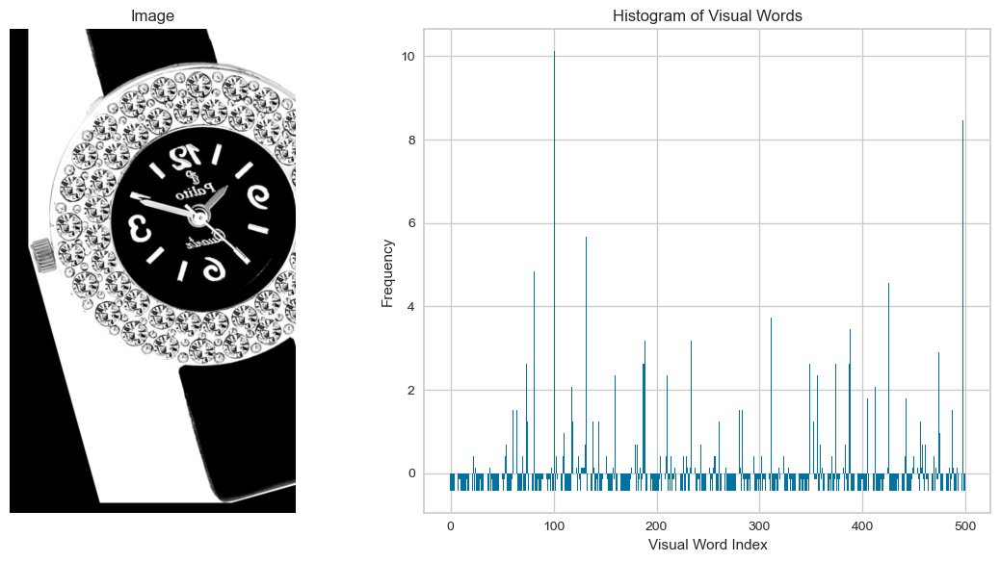

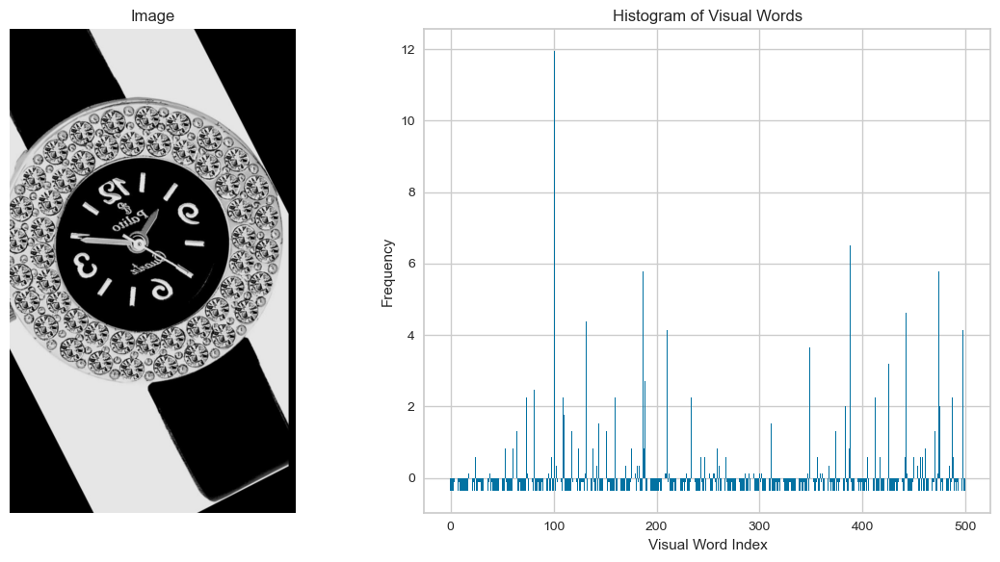

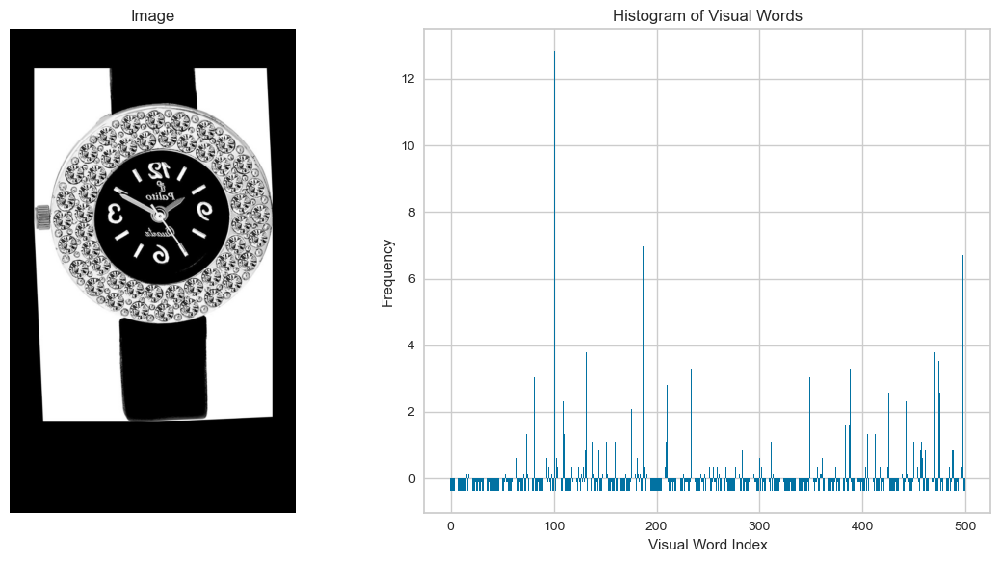

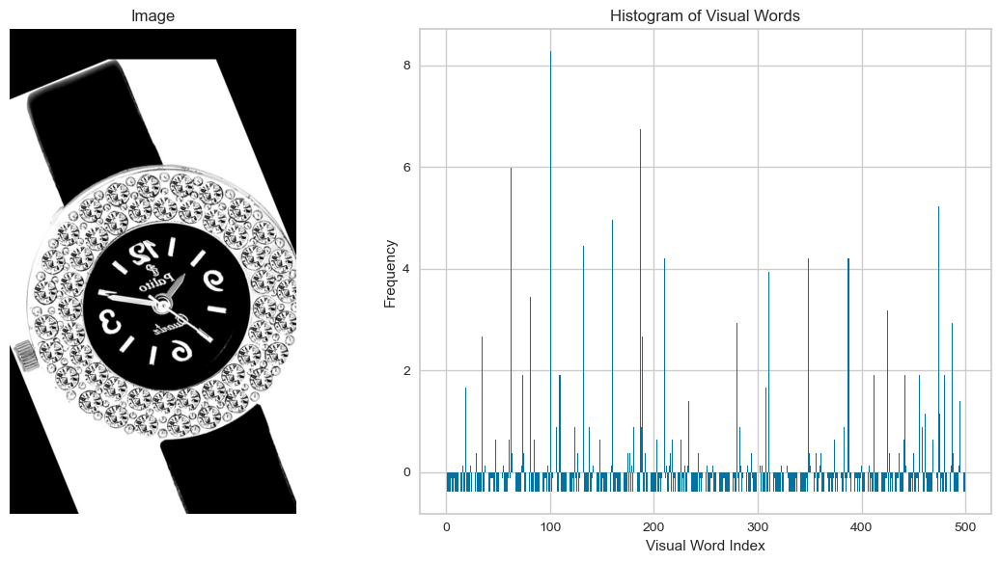

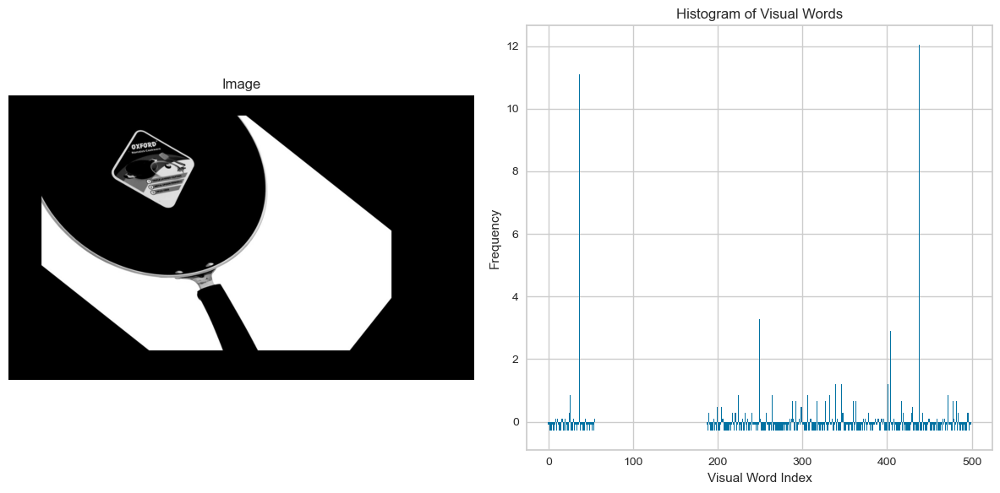

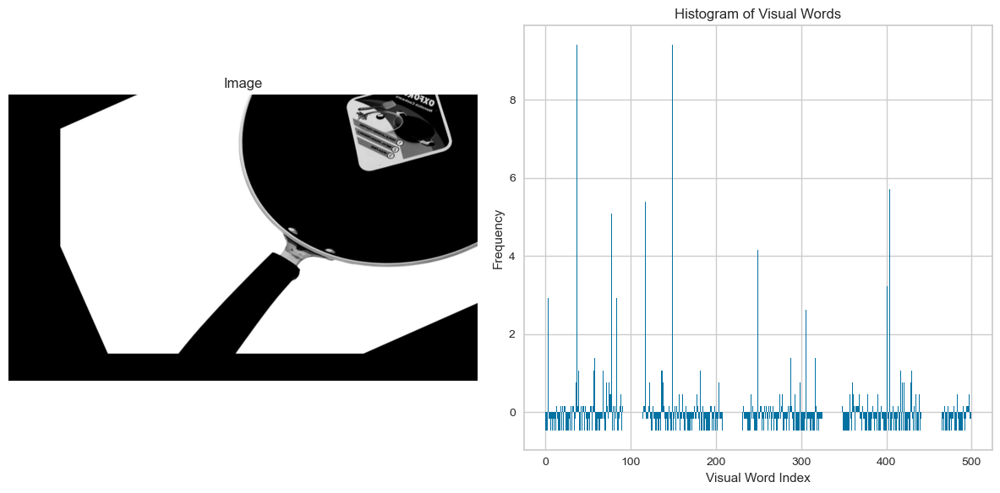

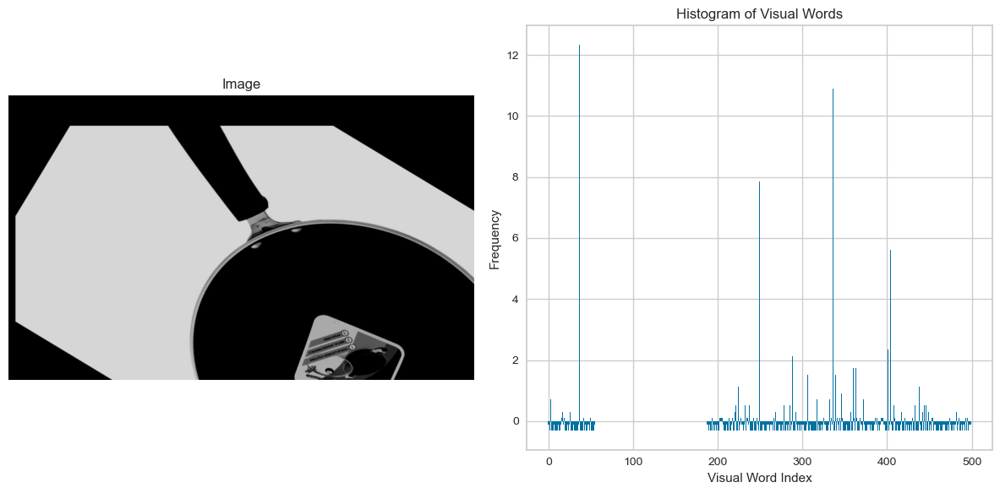

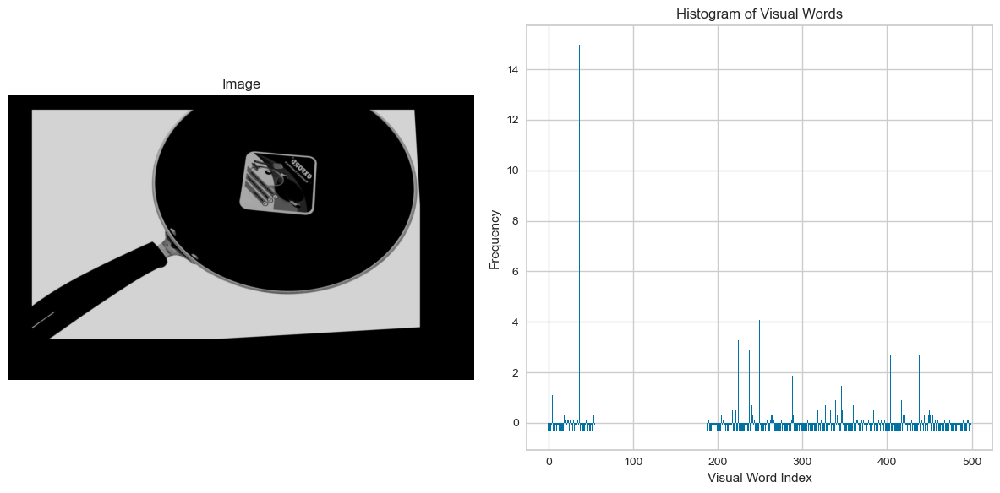

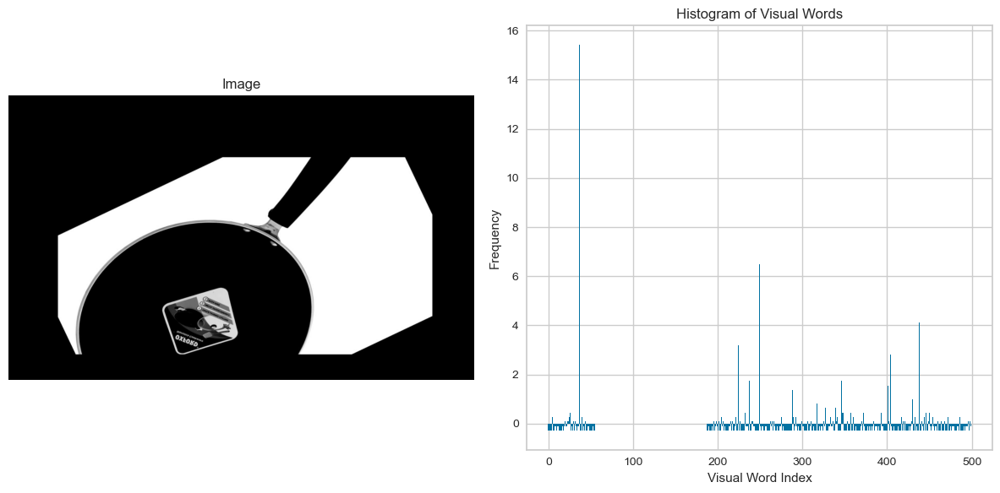

In [36]:
# Charger les descripteurs réduits
with open('sift_descriptors_reduced.pkl', 'rb') as f:
    sift_descriptors_reduced = pickle.load(f)

# Charger le modèle MiniBatchKMeans
with open('minibatch_kmeans_model.pkl', 'rb') as f:
    minibatch_kmeans_model = pickle.load(f)

# Hyperparamètres
num_clusters = minibatch_kmeans_model.n_clusters

# StandardScaler pour normaliser les histogrammes
scaler = StandardScaler()

# Dictionnaire pour stocker les histogrammes
image_histograms = {}

# Construire l'histogramme de caractéristiques pour chaque image
for image, descriptors in tqdm(sift_descriptors_reduced.items(), desc="Creating histograms"):
    histogram = np.zeros(num_clusters)
    cluster_result = minibatch_kmeans_model.predict(descriptors)
    
    for i in cluster_result:
        histogram[i] += 1
    
    # Normaliser l'histogramme
    histogram = scaler.fit_transform(histogram.reshape(-1, 1)).flatten()
    image_histograms[image] = histogram

# Sauvegarder les histogrammes dans un fichier pickle
with open('image_histograms.pkl', 'wb') as f:
    pickle.dump(image_histograms, f)

print(f"Histograms created and saved for {len(image_histograms)} images.")

# Afficher les histogrammes de quelques images avec leurs photos
def display_histogram_and_image(image_path, histogram):
    # Charger l'image en utilisant PIL
    image = Image.open(image_path)
    image_rgb = image.convert('RGB')
    
    plt.figure(figsize=(12, 6))
    
    # Afficher l'image
    plt.subplot(1, 2, 1)
    plt.imshow(image_rgb)
    plt.title('Image')
    plt.axis('off')
    
    # Afficher l'histogramme
    plt.subplot(1, 2, 2)
    plt.bar(range(len(histogram)), histogram)
    plt.title('Histogram of Visual Words')
    plt.xlabel('Visual Word Index')
    plt.ylabel('Frequency')
    
    plt.tight_layout()
    plt.show()

# Assurez-vous que vos images se trouvent dans un répertoire spécifique
image_directory = r'C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\augmented_images' + '/'

# Afficher les histogrammes de quelques images avec leurs photos
for image_filename, histogram in list(image_histograms.items())[:10] :
    image_path = image_directory + image_filename
    display_histogram_and_image(image_path, histogram)


### 4. Clustering des images

Nous appliquons un algorithme de clustering non supervisé, k-means en l'occurence, sur les histogrammes de mots visuels.
Cela regroupera les images en clusters basés sur leurs caractéristiques visuelles.

**Création du dataframe avec les histogrammes & les labels**

In [37]:
# Charger le fichier pickle
with open('image_histograms.pkl', 'rb') as f:
    histograms = pickle.load(f)

# Correspondance entre le dictionnaire des histo & les données du dataframe
histograms_df = pd.DataFrame.from_dict(histograms, orient='index')
histograms_df.reset_index(inplace=True)
histograms_df.rename(columns={'index': 'image_name'}, inplace=True)

# Fusionner les dataframes
augmented_labels_df = pd.merge(augmented_labels_df, histograms_df, on='image_name', how='left')

# Sauvegarder le dataframe
augmented_labels_df.to_csv('augmented_labels_df_with_histograms.csv', index=False)

# Afficher les premières lignes du dataframe mis à jour
augmented_labels_df.head()


,image_name,Level_1,0_x,1_x,2_x,3_x,4_x,5_x,6_x,7_x,...,490,491,492,493,494,495,496,497,498,499
0,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_0.jpg,Home Furnishing,-0.350462,-0.404379,3.477657,-0.404379,0.673965,-0.404379,-0.404379,-0.404379,...,-0.082845,-0.248534,-0.248534,-0.248534,-0.248534,-0.248534,-0.248534,-0.248534,-0.248534,-0.082845
1,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_1.jpg,Home Furnishing,-0.329103,-0.329103,2.717044,-0.448560,0.447366,-0.448560,-0.448560,-0.448560,...,0.596248,-0.256022,-0.256022,-0.256022,-0.256022,-0.256022,1.107610,-0.256022,-0.256022,-0.256022
2,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_2.jpg,Home Furnishing,-0.317220,-0.432573,2.854983,-0.432573,0.951661,-0.432573,-0.432573,-0.432573,...,-0.255919,-0.255919,-0.255919,-0.255919,-0.255919,-0.255919,0.085306,-0.255919,-0.255919,-0.255919
3,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_3.jpg,Home Furnishing,-0.389203,-0.337378,2.253852,-0.389203,1.631957,-0.389203,-0.389203,-0.389203,...,-0.082687,-0.247402,0.082028,-0.247402,-0.247402,-0.247402,0.246744,-0.082687,-0.247402,-0.247402
4,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_4.jpg,Home Furnishing,-0.419886,-0.363902,2.659281,-0.419886,2.659281,-0.419886,-0.419886,-0.307917,...,-0.081040,-0.243121,-0.243121,-0.243121,-0.243121,-0.243121,-0.081040,-0.243121,-0.243121,-0.243121


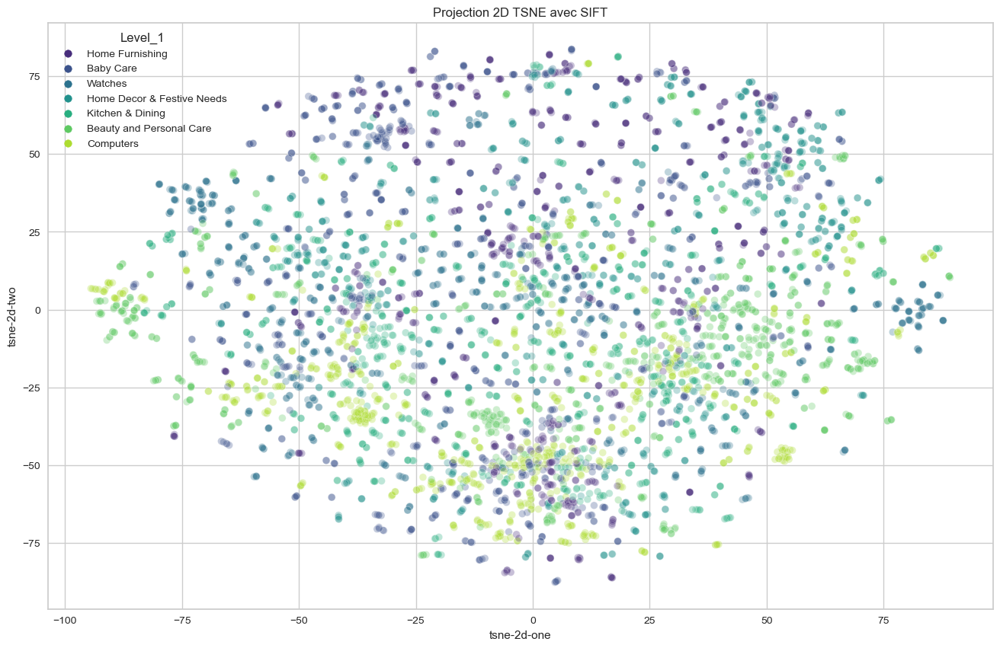

In [5]:
# Charger le dataframe mis à jour
tsne_sift = pd.read_csv('augmented_labels_df_with_histograms.csv')

# Extraire les features
features = tsne_sift.drop(columns=['image_name', 'Level_1'])
labels = tsne_sift['Level_1']

# Normalisation des données
scaler = StandardScaler()
features_normalized = scaler.fit_transform(features)

# Appliquer t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(features_normalized)

# Ajouter les résultats t-SNE au dataframe
tsne_sift['tsne-2d-one'] = tsne_results[:,0]
tsne_sift['tsne-2d-two'] = tsne_results[:,1]

# Visualiser les résultats
plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne-2d-one", y="tsne-2d-two",
    hue="Level_1",
    palette=sns.color_palette("viridis", len(tsne_sift['Level_1'].unique())),
    data=tsne_sift,
    legend="full",
    alpha=0.3
)
plt.title('Projection 2D TSNE avec SIFT')
plt.show()


In [7]:
# charger le df avec les labels et les histogrammes
augmented_labels_df = pd.read_csv('augmented_labels_df_with_histograms.csv')

# Sélectionner les colonnes de features (histogrammes SIFT)
features = augmented_labels_df.iloc[:, 2:]  

# Normaliser les features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# Appliquer k-means clustering avec 7 clusters
kmeans = KMeans(n_clusters=7, n_init=10, random_state=42)
augmented_labels_df['cluster'] = kmeans.fit_predict(features_scaled)

# Afficher les 5 premières lignes du dataframe pour vérifier les résultats
augmented_labels_df.head(3)

,image_name,Level_1,0_x,1_x,2_x,3_x,4_x,5_x,6_x,7_x,...,491,492,493,494,495,496,497,498,499,cluster
0,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_0.jpg,Home Furnishing,-0.350462,-0.404379,3.477657,-0.404379,0.673965,-0.404379,-0.404379,-0.404379,...,-0.248534,-0.248534,-0.248534,-0.248534,-0.248534,-0.248534,-0.248534,-0.248534,-0.082845,0
1,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_1.jpg,Home Furnishing,-0.329103,-0.329103,2.717044,-0.448560,0.447366,-0.448560,-0.448560,-0.448560,...,-0.256022,-0.256022,-0.256022,-0.256022,-0.256022,1.107610,-0.256022,-0.256022,-0.256022,0
2,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_2.jpg,Home Furnishing,-0.317220,-0.432573,2.854983,-0.432573,0.951661,-0.432573,-0.432573,-0.432573,...,-0.255919,-0.255919,-0.255919,-0.255919,-0.255919,0.085306,-0.255919,-0.255919,-0.255919,0


C:\Users\justi\AppData\Roaming\Python\Python311\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


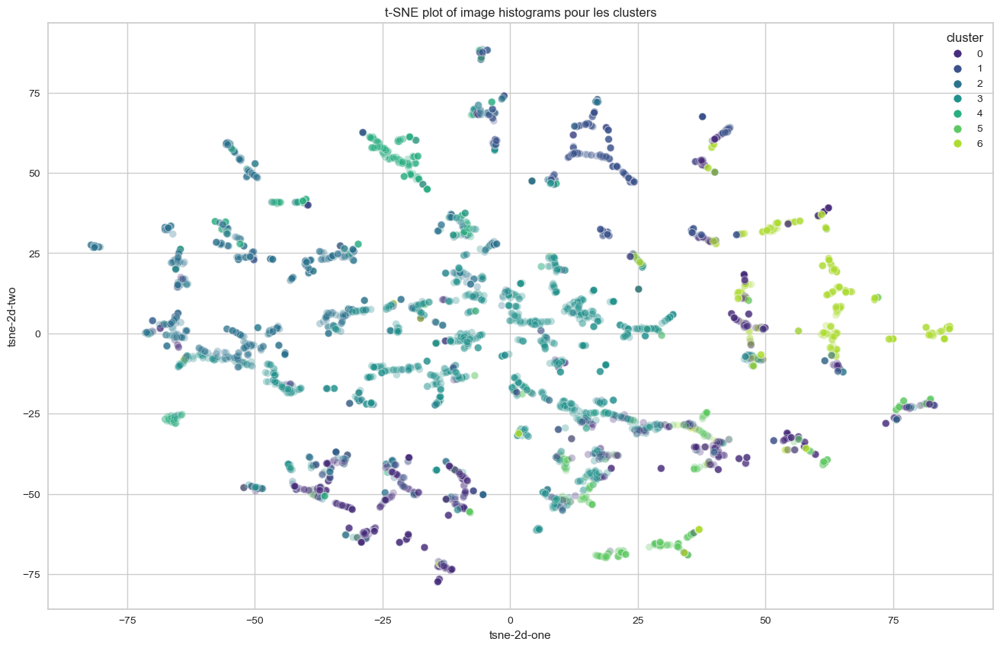

In [8]:
# Charger le dataframe mis à jour
tsne_sift_cluster = augmented_labels_df.copy() 

# Extraire les features 
features = tsne_sift_cluster.drop(columns=['image_name', 'cluster','Level_1'])
labels = tsne_sift_cluster['cluster']

# Appliquer UMAP
umap_reducer = umap.UMAP(n_components=7, random_state=42)
umap_results = umap_reducer.fit_transform(features)

# Appliquer t-SNE sur les résultats de UMAP
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(umap_results)

# Ajouter les résultats t-SNE au dataframe
tsne_sift_cluster['tsne-2d-one'] = tsne_results[:,0]
tsne_sift_cluster['tsne-2d-two'] = tsne_results[:,1]

# Visualiser les résultats
plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne-2d-one", y="tsne-2d-two",
    hue="cluster",
    palette=sns.color_palette("viridis", len(tsne_sift_cluster['cluster'].unique())),
    data= tsne_sift_cluster,
    legend="full",
    alpha=0.3
)
plt.title('t-SNE plot of image histograms pour les clusters')
plt.show()


In [18]:
# Charger votre dataframe
df = pd.read_csv('augmented_labels_df_with_histograms.csv')

# Sélectionner les colonnes de features 
features = df.iloc[:, 2:]
labels = df['Level_1']

# Normaliser les features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# Appliquer UMAP pour réduire les dimensions à xx composantes
#reducer = umap.UMAP(n_components=15, random_state=42)
#features_reduced = reducer.fit_transform(features_scaled)

# Liste pour stocker les évaluations
evaluations = []

# Fonction de mesure de performance adaptée
def fit_and_evaluate(km, X, labels, name=None, n_runs=5):
    name = km.__class__.__name__ if name is None else name

    train_times = []
    scores = defaultdict(list)
    for seed in range(n_runs):
        km.set_params(random_state=seed)
        t0 = time()
        km.fit(X)
        train_times.append(time() - t0)
        scores["Homogeneity"].append(metrics.homogeneity_score(labels, km.labels_))
        scores["Completeness"].append(metrics.completeness_score(labels, km.labels_))
        scores["V-measure"].append(metrics.v_measure_score(labels, km.labels_))
        scores["Adjusted Rand-Index"].append(
            metrics.adjusted_rand_score(labels, km.labels_)
        )
        scores["Silhouette Coefficient"].append(
            metrics.silhouette_score(X, km.labels_, sample_size=2000)
        )
    train_times = np.asarray(train_times)

    print(f"Clustering done in {train_times.mean():.2f} ± {train_times.std():.2f} s ")
    evaluation = {
       # "estimator": name,
       # "train_time_mean": train_times.mean(),
       # "train_time_std": train_times.std(),
    }
    for score_name, score_values in scores.items():
        mean_score, std_score = np.mean(score_values), np.std(score_values)
        print(f"{score_name}: {mean_score:.3f} ± {std_score:.3f}")
        #evaluation[f"{score_name}_mean"] = mean_score
        #evaluation[f"{score_name}_std"] = std_score
    evaluations.append(evaluation)

# Appliquer k-means clustering avec 7 clusters 
kmeans = KMeans(n_clusters=7, n_init=10, random_state=42)

# Application de la fonction d'évaluation
fit_and_evaluate(kmeans, features_scaled, labels)

# Afficher les évaluations
print(evaluations)


Clustering done in 2.83 ± 0.10 s 
Homogeneity: 0.122 ± 0.001
Completeness: 0.131 ± 0.000
V-measure: 0.126 ± 0.001
Adjusted Rand-Index: 0.065 ± 0.000
Silhouette Coefficient: 0.026 ± 0.003
[{'estimator': 'KMeans'}]


### 5. Evaluation & analyse

- Faire des projections en 2D avec PCA & TSNE
- Analyser les clusters formés pour interpréter les catégories d'images identifiées.
- Visualiser quelques images de chaque cluster pour vérifier la cohérence des regroupements.

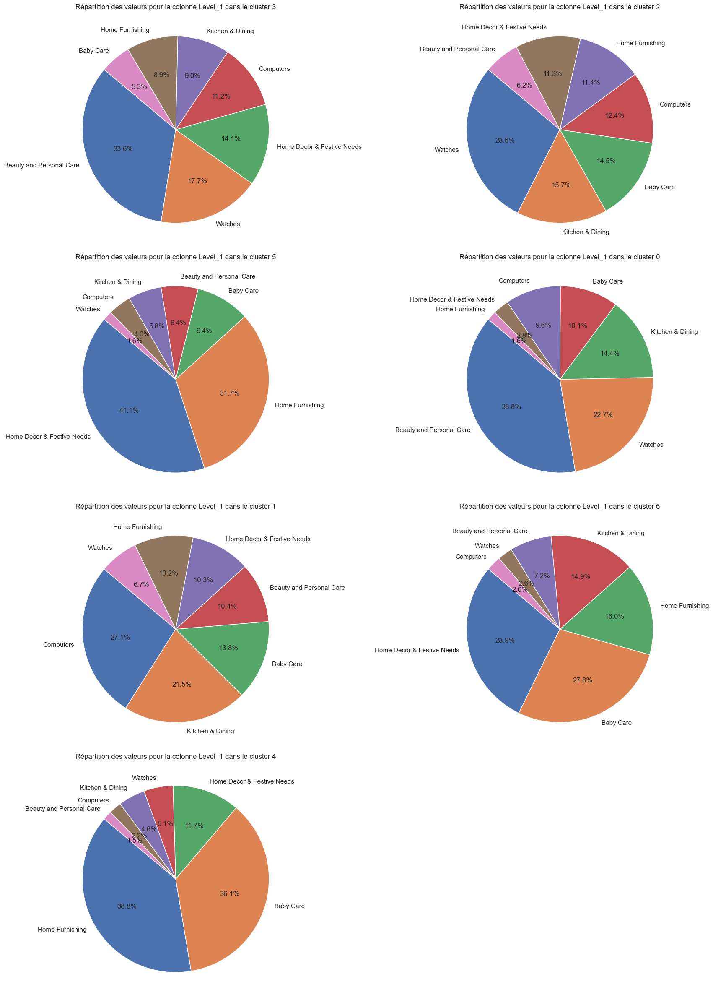

In [55]:
# Obtenir les clusters uniques
clusters = augmented_labels_df['cluster_label'].unique()

# Définir le nombre de colonnes pour les sous-graphes
num_cols = 2

# Calculer le nombre de lignes nécessaires
num_rows = (len(clusters) + num_cols - 1) // num_cols

# Créer les sous-graphes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(18, num_rows * 6))

# Aplatir les axes pour faciliter l'itération
axes = axes.flatten()

# Tracer un diagramme circulaire pour chaque cluster
for i, cluster in enumerate(clusters):
    cluster_data = augmented_labels_df[augmented_labels_df['cluster_label'] == cluster]
    level_1_counts = cluster_data['Level_1'].value_counts()
    
    axes[i].pie(level_1_counts, labels=level_1_counts.index, autopct='%1.1f%%', startangle=140)
    axes[i].set_title(f"Répartition des valeurs pour la colonne Level_1 dans le cluster {cluster}")

# Supprimer les axes vides
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

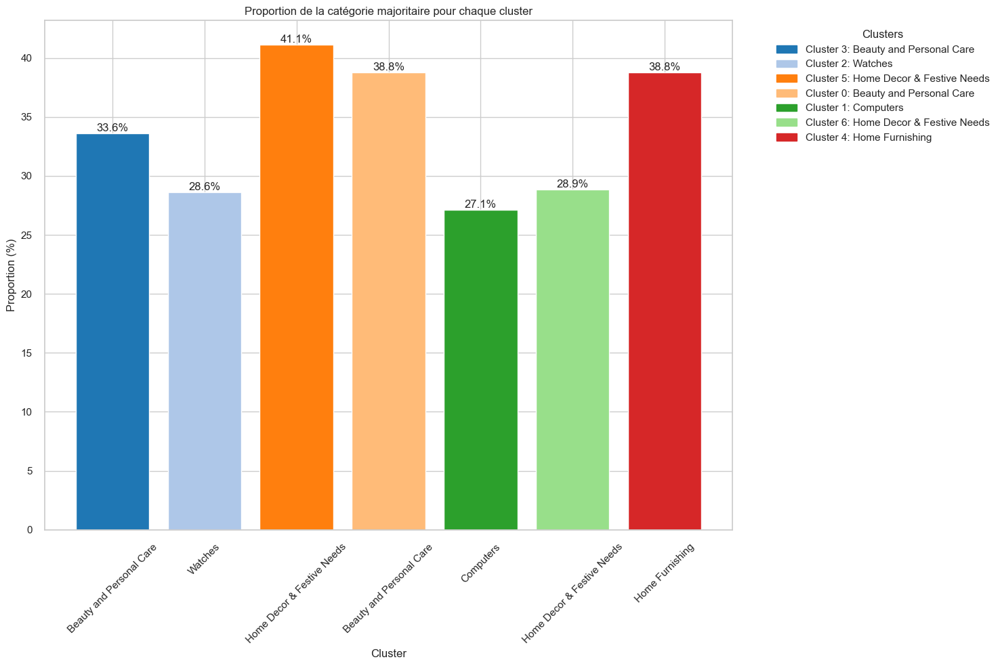

In [56]:
# Obtenir les clusters uniques
clusters = augmented_labels_df['cluster_label'].unique()

# Initialiser une liste pour stocker les informations
top_categories = []

# Extraire la catégorie la plus représentée et sa proportion pour chaque cluster
for cluster in clusters:
    cluster_data = augmented_labels_df[augmented_labels_df['cluster_label'] == cluster]
    level_1_counts = cluster_data['Level_1'].value_counts()
    
    # Obtenir la catégorie et la valeur la plus représentée
    top_category = level_1_counts.idxmax()
    top_value = level_1_counts.max()
    total_values = level_1_counts.sum()
    proportion = top_value / total_values * 100
    
    # Ajouter les informations à la liste
    top_categories.append({'Cluster': cluster, 'Top Category': top_category, 'Proportion': proportion})

# Convertir la liste en DataFrame
top_categories_df = pd.DataFrame(top_categories)

# Définir une palette de couleurs
colors = plt.cm.tab20.colors  # Choisir une palette avec suffisamment de couleurs

# Assigner une couleur à chaque cluster
cluster_colors = {cluster: colors[i % len(colors)] for i, cluster in enumerate(clusters)}

# Tracer l'histogramme des proportions
plt.figure(figsize=(15, 10))
bars = plt.bar(top_categories_df['Cluster'].astype(str), top_categories_df['Proportion'], 
               color=[cluster_colors[cluster] for cluster in top_categories_df['Cluster']], tick_label=top_categories_df['Top Category'])

# Ajouter les étiquettes de valeurs
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.1f}%', ha='center', va='bottom')

# Ajouter la légende avec des descriptions plus complètes
handles = [plt.Rectangle((0,0),1,1, color=cluster_colors[cluster]) for cluster in clusters]
labels = [f'Cluster {cluster}: {top_categories_df[top_categories_df["Cluster"] == cluster]["Top Category"].values[0]}' for cluster in clusters]
plt.legend(handles, labels, title='Clusters', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.xlabel('Cluster')
plt.ylabel('Proportion (%)')
plt.title('Proportion de la catégorie majoritaire pour chaque cluster')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
from sklearn.neighbors import NearestNeighbors

In [ ]:
### essai avec le DBSCAN pour faire les bags of features

# Charger les descripteurs réduits
with open('sift_descriptors_reduced.pkl', 'rb') as f:
    sift_descriptors_reduced = pickle.load(f)

# Rassembler tous les descripteurs réduits
all_descriptors_reduced = np.concatenate(list(sift_descriptors_reduced.values()))

# Calcul des distances des k-voisins les plus proches
k = 5  # vous pouvez ajuster cette valeur en fonction de votre ensemble de données
nbrs = NearestNeighbors(n_neighbors=k).fit(all_descriptors_reduced)
distances, indices = nbrs.kneighbors(all_descriptors_reduced)

# Prendre les distances des k-ièmes voisins les plus proches (k=5)
k_distances = distances[:, k-1]
k_distances = np.sort(k_distances)

# Tracer la courbe des k-voisins les plus proches
plt.figure(figsize=(10, 6))
plt.plot(k_distances)
plt.xlabel('Points de données')
plt.ylabel(f'Distance au {k}-ème plus proche voisin')
plt.title(f'Courbe des {k}-voisins les plus proches')
plt.grid(True)
plt.show()


## B. Approche avec CNN Transfer Learning

### 1ière modélisation avec le ResNet50

### 1. Préparation à l'analyse

In [5]:
df_cnn = df[['product_name',
             'image',
             'Level_1']].copy()

df_cnn.head(3)

,product_name,image,Level_1
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care


In [6]:
# Chemin vers le répertoire contenant les images
directory_path = r'C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images'

### 2. Extraction des features avec "ResNet50" avec pré-traitement "caffe"

In [28]:
# Chemin vers le répertoire contenant les images
directory_path = r'C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images'

# Hyperparamètres
learning_rate = 0.001
batch_size = 64
epochs = 30

# Charger le modèle ResNet50 pré-entraîné
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Ajouter une couche de Global Average Pooling pour l'extraction des features
x = base_model.output
x = GlobalAveragePooling2D()(x)

# Créer le modèle pour l'extraction des features
model = Model(inputs=base_model.input, outputs=x)

# Configuration de l'augmentation des données
datagen = ImageDataGenerator(
    rescale=1.0/255.0,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Fonction pour pré-traiter et extraire les features d'une image
def extract_features(img_path, model):
    try:
        img = image.load_img(img_path, target_size=(224, 224))
        img = image.img_to_array(img)
        img = np.expand_dims(img, axis=0)
        img = preprocess_input(img)  # Pré-traitement spécifique pour Caffe
        features = model.predict(img)
        print(f"Features shape for {img_path}: {features.shape}") 
        return features.flatten()
    except Exception as e:
        print(f"Erreur lors du traitement de l'image {img_path}: {str(e)}")
        return None

# Initialiser une liste pour stocker les features et les noms des images
all_features = []
image_names = []


# Vérifiez si 'image' est dans les colonnes
if 'image' not in df_cnn.columns:
    raise ValueError("Le DataFrame df_cnn ne contient pas de colonne 'image'. Veuillez vérifier le DataFrame d'entrée.")

# Extraction des features avec une barre de progression
progress_bar = tqdm(total=len(df_cnn), desc='Extraction des features')
for img_name in df_cnn['image']:
    img_path = os.path.join(directory_path, img_name)
    if os.path.isfile(img_path):
        features = extract_features(img_path, model)
        if features is not None:
            all_features.append(features)
            image_names.append(img_name)
    progress_bar.update(1)
progress_bar.close()

# Vérifier que all_features n'est pas vide avant de créer le DataFrame
if all_features:
    feature_dimension = len(all_features[0])
    features_df = pd.DataFrame(all_features, columns=[f'feature_{i}' for i in range(feature_dimension)])
    features_df['image'] = image_names

    # Fusionner les features avec le DataFrame d'origine
    df_cnn = pd.merge(df_cnn, features_df, on='image', how='left')

    # Afficher les premières lignes du DataFrame pour vérifier
    print(df_cnn.head())

    # Enregistrer le DataFrame avec les features dans un fichier CSV
    df_cnn.to_csv('df_cnn_with_features.csv', index=False)
else:
    print("Aucune feature extraite. Vérifiez le processus d'extraction.")


Extraction des features:   0%|          | 0/1050 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


Extraction des features:   0%|          | 1/1050 [00:05<1:41:38,  5.81s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55b85ea15a1536d46b7190ad6fff8ce7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:   0%|          | 2/1050 [00:06<46:00,  2.63s/it]  

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b72c92c2f6c40268628ec5f14c6d590.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:   0%|          | 3/1050 [00:06<27:51,  1.60s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64d5d4a258243731dc7bbb1eef49ad74.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


Extraction des features:   0%|          | 4/1050 [00:06<18:59,  1.09s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d4684dcdc759dd9cdf41504698d737d8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


Extraction des features:   0%|          | 5/1050 [00:07<15:05,  1.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6325b6870c54cd47be6ebfbffa620ec7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


Extraction des features:   1%|          | 6/1050 [00:07<11:49,  1.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\893aa5ed55f7cff2eccea7758d7a86bd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


Extraction des features:   1%|          | 7/1050 [00:08<09:50,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f355cc1ccb08bd0d283ed979b7ee7515.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


Extraction des features:   1%|          | 8/1050 [00:08<08:35,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd0e3470a7e6ed76fd69c2da27721041.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


Extraction des features:   1%|          | 9/1050 [00:08<07:40,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41384da51732c0b4df3de8f395714fbb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


Extraction des features:   1%|          | 10/1050 [00:09<07:11,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\710ed5f2393a4b9e8823aa0029f71f93.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


Extraction des features:   1%|          | 11/1050 [00:09<06:42,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\920154acbe49d3202ed7d2ed2df1ea13.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


Extraction des features:   1%|          | 12/1050 [00:09<06:18,  2.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08452abdadb3db1e686b94a9c52fc7b6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


Extraction des features:   1%|          | 13/1050 [00:10<06:08,  2.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1e8741b5ae27a513546c94b3f3312aee.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


Extraction des features:   1%|▏         | 14/1050 [00:10<06:02,  2.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\189fa66a5fa6f08d2802a62ecf0be298.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


Extraction des features:   1%|▏         | 15/1050 [00:10<05:50,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bbb8cdc5406ff60ff06ff64630f2ca47.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


Extraction des features:   2%|▏         | 16/1050 [00:10<05:44,  3.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1120bc768623572513df956172ffefeb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


Extraction des features:   2%|▏         | 17/1050 [00:11<05:30,  3.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5479bb7028827d60000720a2c135976a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


Extraction des features:   2%|▏         | 18/1050 [00:11<05:21,  3.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\733aa1e801a139fa8dc7be9f0eff5ee0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


Extraction des features:   2%|▏         | 19/1050 [00:11<05:24,  3.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62c35de4df27437d3597963fac55a8b6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


Extraction des features:   2%|▏         | 20/1050 [00:12<05:54,  2.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\33d97d63c037078cd3f08033966d6a88.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


Extraction des features:   2%|▏         | 21/1050 [00:12<05:55,  2.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d7ca2b06b4f4d3b98c61c377b18a2d6b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:   2%|▏         | 22/1050 [00:13<06:09,  2.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f74476ba64365d97a5be7d375cbf4c7a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:   2%|▏         | 23/1050 [00:13<06:14,  2.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda50982a672ef8835de5c1cc86f8bfc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


Extraction des features:   2%|▏         | 24/1050 [00:13<06:05,  2.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4788f5466992da09024b8ffcc8a5cba4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


Extraction des features:   2%|▏         | 25/1050 [00:14<06:04,  2.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\653826cd53f1d9e2c086c0ac7846ef70.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


Extraction des features:   2%|▏         | 26/1050 [00:14<05:42,  2.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c74db45cbfc14a78b8466dca494b3bb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


Extraction des features:   3%|▎         | 27/1050 [00:14<05:32,  3.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4aa047f14885c74f155ce5f973e14dff.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


Extraction des features:   3%|▎         | 28/1050 [00:14<05:22,  3.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c4fec2331da8d40f2cb146eb198cb57.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


Extraction des features:   3%|▎         | 29/1050 [00:15<05:12,  3.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b52073e7ed9c00c4108cae4eb0c49c1a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


Extraction des features:   3%|▎         | 30/1050 [00:15<05:13,  3.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee8d9ff65e0fe4278afce7c933d30941.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


Extraction des features:   3%|▎         | 31/1050 [00:15<05:21,  3.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\788dc3a3da91c0f46a7c465e07f91dd4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:   3%|▎         | 32/1050 [00:16<06:02,  2.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29b1ca231e10d5269516b80bf9d0dffc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


Extraction des features:   3%|▎         | 33/1050 [00:16<05:55,  2.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8b268c1e68f198ae2e934717d49f48e9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:   3%|▎         | 34/1050 [00:17<05:55,  2.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b85f8843bb1c297dd5712f0bd287006d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Extraction des features:   3%|▎         | 35/1050 [00:17<06:12,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4b09aa7927c59fbb39960b3d7919909.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:   3%|▎         | 36/1050 [00:17<06:25,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\81e739c7f3be737152f2e6f520e3494b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


Extraction des features:   4%|▎         | 37/1050 [00:18<06:24,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0938b0d88eac91deee6d5add54097d3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:   4%|▎         | 38/1050 [00:18<06:35,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e9420e9483f16db81c64dddf99f34841.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


Extraction des features:   4%|▎         | 39/1050 [00:19<06:32,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a3dea07b2f7bf48276d32513091be717.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


Extraction des features:   4%|▍         | 40/1050 [00:19<06:18,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66191b4a311b5d9babfc00a71ef97c5b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


Extraction des features:   4%|▍         | 41/1050 [00:19<06:05,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90e56526f4c5892beac49f262b85150a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


Extraction des features:   4%|▍         | 42/1050 [00:20<05:59,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a79117ea49a0533f641facdb4c99f502.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


Extraction des features:   4%|▍         | 43/1050 [00:20<06:11,  2.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5325213d84c80ad310b6e4b37a1ac824.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


Extraction des features:   4%|▍         | 44/1050 [00:20<06:04,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2d50e4c6ccf8befe9335ac8f97a11712.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


Extraction des features:   4%|▍         | 45/1050 [00:21<05:56,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8050d31bffe6827c804b8222338aafb2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


Extraction des features:   4%|▍         | 46/1050 [00:21<05:50,  2.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\493d1eb6ad7a48a926092bf994cd0bb0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


Extraction des features:   4%|▍         | 47/1050 [00:21<05:47,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3388d05e88972ff9f3e1321dc0cfdc28.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


Extraction des features:   5%|▍         | 48/1050 [00:22<05:45,  2.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d1899ab1d5c79ddaa311bc9f04d198ed.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


Extraction des features:   5%|▍         | 49/1050 [00:22<05:42,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e7cab08a267e815c72a26513222783e0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


Extraction des features:   5%|▍         | 50/1050 [00:22<05:27,  3.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02a53d335775b652f22f41b529b9d646.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


Extraction des features:   5%|▍         | 51/1050 [00:23<05:23,  3.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\69446af66066146718cd569f87e99fff.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


Extraction des features:   5%|▍         | 52/1050 [00:23<05:17,  3.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4d35b6536b623c83b293eb3a1c02bba.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


Extraction des features:   5%|▌         | 53/1050 [00:23<05:37,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f01140c02fd09e5c56312a64fa8db3da.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:   5%|▌         | 54/1050 [00:24<05:55,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6329ddb46087cb8c09ced95471dd9643.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


Extraction des features:   5%|▌         | 55/1050 [00:24<05:58,  2.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e6ae1b372e8e0b509b83ba3658b8107.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


Extraction des features:   5%|▌         | 56/1050 [00:24<05:49,  2.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e2ae2af58ac50adf4881751ae84a9d8a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features:   5%|▌         | 57/1050 [00:25<06:10,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\24e85c590481a7cedfe66597f253f2b2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:   6%|▌         | 58/1050 [00:25<06:00,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5e84d36ad6db970548498829db8b15de.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


Extraction des features:   6%|▌         | 59/1050 [00:26<05:58,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c4604dba348a99a2dfbbc2cd3928101.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:   6%|▌         | 60/1050 [00:26<06:03,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0abfcbe0e17dd50c4cf5fb1d6037d514.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:   6%|▌         | 61/1050 [00:26<06:11,  2.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4a1b23dacd7d2a9ec7414f7159f25a48.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


Extraction des features:   6%|▌         | 62/1050 [00:27<06:25,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95330f6f0f44d17b918feec36bedcdef.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:   6%|▌         | 63/1050 [00:27<06:34,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66a5a21ea332aefcc7b90dbad94053aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


Extraction des features:   6%|▌         | 64/1050 [00:28<06:25,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f4e7f269319ba9cf5507a9e2febacbf5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


Extraction des features:   6%|▌         | 65/1050 [00:28<06:26,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\80e9cb3d2d7f9ff7bc497c34df366d03.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:   6%|▋         | 66/1050 [00:28<06:24,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2baa415ebcc4fe563ce13b50e60efc1c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


Extraction des features:   6%|▋         | 67/1050 [00:29<05:57,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\903d63e2b71d692ccd628e1de516516e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


Extraction des features:   6%|▋         | 68/1050 [00:29<05:59,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\707b160df4c4dece6cde52b222ce624b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:   7%|▋         | 69/1050 [00:29<06:18,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed9817e8960a6a0d509061c54cfe5ac1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


Extraction des features:   7%|▋         | 70/1050 [00:30<06:49,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a7a1287fef0d986a5e237797beee286.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


Extraction des features:   7%|▋         | 71/1050 [00:30<06:35,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ba898ecb77ab5a6799c8b047c6b6008.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:   7%|▋         | 72/1050 [00:31<06:40,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2658bad8c2b7d5b08984c6ac34267f7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


Extraction des features:   7%|▋         | 73/1050 [00:31<06:19,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\afc3ebd18df498dd87abb7ad7536b5c7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


Extraction des features:   7%|▋         | 74/1050 [00:31<06:13,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\141d2b743c477043041faddf9233c8ad.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


Extraction des features:   7%|▋         | 75/1050 [00:32<06:33,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7a3f11f380a1bf85338ab3771ff81e9f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:   7%|▋         | 76/1050 [00:32<06:33,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae45b64d808a883aa35f2bf4de879cac.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:   7%|▋         | 77/1050 [00:33<06:20,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1971dcd2f3058a4c87bdd7d87d4baeba.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


Extraction des features:   7%|▋         | 78/1050 [00:33<06:12,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4942e0a9c0527dc00319a39fc8f103e6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


Extraction des features:   8%|▊         | 79/1050 [00:34<07:35,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0a8a1e9c6659361c0c2b247f8a6471d0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:   8%|▊         | 80/1050 [00:34<06:58,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\320833ab08c9a94ef83520612899a85f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


Extraction des features:   8%|▊         | 81/1050 [00:34<06:40,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\57578c1e6ec61a880a6f3f971f5f77b8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


Extraction des features:   8%|▊         | 82/1050 [00:35<07:18,  2.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e130ed339dcfe20d2c8b66892278a94.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:   8%|▊         | 83/1050 [00:35<07:00,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\601817defaff9d0e30e1b72f96d3975f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


Extraction des features:   8%|▊         | 84/1050 [00:36<07:25,  2.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3cdfd9df09f61a8fd178bafcc8dbed31.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:   8%|▊         | 85/1050 [00:36<07:02,  2.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\374e63028d691c380bc43b0dc60e460d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:   8%|▊         | 86/1050 [00:37<07:08,  2.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\61c0139f3d5c97f1615797dbf046cc0c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


Extraction des features:   8%|▊         | 87/1050 [00:37<06:58,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0096e89cc25a8b96fb9808716406fe94.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


Extraction des features:   8%|▊         | 88/1050 [00:37<06:30,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e8ee7868b0c3d1d04b482cd4f3ec5ccc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


Extraction des features:   8%|▊         | 89/1050 [00:38<06:32,  2.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\04f9ff160a1561e3656350f4bd6b8c50.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


Extraction des features:   9%|▊         | 90/1050 [00:38<06:22,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aebf3a2172b33ef09acb472009967812.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


Extraction des features:   9%|▊         | 91/1050 [00:39<06:06,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ae332e2bafd23267caedfcc4453257c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


Extraction des features:   9%|▉         | 92/1050 [00:39<05:49,  2.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\57800d48b001f3fad34a4f8fa9207f29.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


Extraction des features:   9%|▉         | 93/1050 [00:39<05:43,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d1e18b4a3aafb0040da2111c8b8ce2e5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:   9%|▉         | 94/1050 [00:40<06:13,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46e6853da6b0c796b7a0d8203ceaa88e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


Extraction des features:   9%|▉         | 95/1050 [00:40<06:21,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22296bfc1c79d9dc88eabbd01220ef0c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:   9%|▉         | 96/1050 [00:40<06:17,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f4d4c2eec77732f56e47722d7a355f2b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


Extraction des features:   9%|▉         | 97/1050 [00:41<06:19,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f12a06b7dbfc55638afafcf8bb03d836.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


Extraction des features:   9%|▉         | 98/1050 [00:41<05:51,  2.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\18bd9b88e23b82fd19f8ab0c9cad6a1a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:   9%|▉         | 99/1050 [00:42<06:09,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5749bae8ccead7997ebf370b6b081d07.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


Extraction des features:  10%|▉         | 100/1050 [00:42<06:32,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\059493eeb88ebb4cc08d1522f3f87c3f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


Extraction des features:  10%|▉         | 101/1050 [00:42<06:20,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9613f2f1e65fb1fc7e181e7f83c217da.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  10%|▉         | 102/1050 [00:43<06:39,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7fcd0d983a51283e58b806f065cc920.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


Extraction des features:  10%|▉         | 103/1050 [00:43<06:34,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b78586222de9a1095d0a9d88455ee75f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


Extraction des features:  10%|▉         | 104/1050 [00:44<06:46,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dfbd96036cbc28566e964cff04b5b3a8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


Extraction des features:  10%|█         | 105/1050 [00:44<06:46,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\336fc49639a5cc45aa532ace3ee1a044.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


Extraction des features:  10%|█         | 106/1050 [00:45<07:27,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\789cf5578f48577a44586fca3adc35d0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:  10%|█         | 107/1050 [00:45<07:17,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\184ecf07ca4e2872eaf53d2344a1e783.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


Extraction des features:  10%|█         | 108/1050 [00:46<06:51,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b515014adccb1fdf5ff1e2c4a8ff9ea6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


Extraction des features:  10%|█         | 109/1050 [00:46<07:15,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5aacf8f5154afea2ac22fc767d072677.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


Extraction des features:  10%|█         | 110/1050 [00:47<06:45,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cbbe686c4a233e8cf53528748f75223.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  11%|█         | 111/1050 [00:47<06:36,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f1ee63a5f0db853e2c1b377778580d39.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


Extraction des features:  11%|█         | 112/1050 [00:47<06:43,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0bb0f7b7a3075f4b9459121abe2185fa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


Extraction des features:  11%|█         | 113/1050 [00:48<06:32,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8015db34d09642b046c775e8157dd729.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  11%|█         | 114/1050 [00:48<06:26,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ddc40c08d9a9bafc4d14eddd98db7c0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


Extraction des features:  11%|█         | 115/1050 [00:49<06:25,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc784846bd59a16832454416ac708003.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


Extraction des features:  11%|█         | 116/1050 [00:49<07:04,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e8f5dc78f80eff3c77a9714303f59d2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:  11%|█         | 117/1050 [00:50<07:02,  2.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53f4bc7d7321f5c41de6b86e41f13e80.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


Extraction des features:  11%|█         | 118/1050 [00:50<06:30,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be09f5a3a88ac10ae14c791fc8ac0dae.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


Extraction des features:  11%|█▏        | 119/1050 [00:50<06:53,  2.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d202ea988ab11f2327279093ac71975d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  11%|█▏        | 120/1050 [00:51<06:41,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\db6c79a1d852944a89e157793f392d67.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  12%|█▏        | 121/1050 [00:51<06:26,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\16c18ce0affca13159e362227c83683c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


Extraction des features:  12%|█▏        | 122/1050 [00:52<06:33,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7dd5e83e2108a97659577e50879f9d9f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


Extraction des features:  12%|█▏        | 123/1050 [00:52<06:11,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a63eecfbb02004863fa1f29a0b8105fc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Extraction des features:  12%|█▏        | 124/1050 [00:52<06:43,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c77aa1fc09901ae07c392c152a70e41.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


Extraction des features:  12%|█▏        | 125/1050 [00:53<07:11,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\640fd08bb3ba538d67a5c0c2c61a5c4c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  12%|█▏        | 126/1050 [00:53<06:47,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7241df1acae1fac892c692097ea3fb98.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


Extraction des features:  12%|█▏        | 127/1050 [00:54<06:26,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a85a7dbd31267a7b02eda3a4d484632d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


Extraction des features:  12%|█▏        | 128/1050 [00:54<06:00,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\13de17e59a92f8bcaec8bf103bbff8c1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


Extraction des features:  12%|█▏        | 129/1050 [00:54<05:33,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ba13df7877fd979d64c87c7586a5ca6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


Extraction des features:  12%|█▏        | 130/1050 [00:55<05:18,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f1484a63c0dc79e96c98b2a250380ed8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  12%|█▏        | 131/1050 [00:55<05:19,  2.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f01ff0a82401117e9da22dd680fd2f36.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


Extraction des features:  13%|█▎        | 132/1050 [00:55<05:37,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de911421573d3e234450040374b55b38.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


Extraction des features:  13%|█▎        | 133/1050 [00:56<05:27,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\614dbfa2f42c4684c0bb6152091113a6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  13%|█▎        | 134/1050 [00:56<05:22,  2.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5531b9f454e2d75cfe00c3f795e06de5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  13%|█▎        | 135/1050 [00:56<05:21,  2.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\258444ac7bb7ad8026800efad5c3502b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


Extraction des features:  13%|█▎        | 136/1050 [00:57<05:30,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd369a1bb58ae02cd925dda7e9e1d00a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


Extraction des features:  13%|█▎        | 137/1050 [00:57<05:14,  2.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73f460cd6f3fd206902d7097a1816405.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:  13%|█▎        | 138/1050 [00:58<05:24,  2.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0d3e1dc0d38be59e9927e47f152e48aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


Extraction des features:  13%|█▎        | 139/1050 [00:58<05:36,  2.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\118b411bf265538461b084ce7abd55a8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:  13%|█▎        | 140/1050 [00:58<05:52,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06749cbff1487f470438823f6952cfd1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


Extraction des features:  13%|█▎        | 141/1050 [00:59<05:44,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\202fc276e672eb8c29891aa50aef0771.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


Extraction des features:  14%|█▎        | 142/1050 [00:59<06:00,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\feefbdff924dd6b7cc266449c9a36d69.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


Extraction des features:  14%|█▎        | 143/1050 [01:00<06:05,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\af1ac46194b5488048c459102a16a57e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


Extraction des features:  14%|█▎        | 144/1050 [01:00<06:02,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1fd886094826c3f25c6ffb380073974.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


Extraction des features:  14%|█▍        | 145/1050 [01:00<06:00,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3847353a4b8de1efc504d589aea74ffe.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


Extraction des features:  14%|█▍        | 146/1050 [01:01<05:46,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60efd61370e70267dc60b11ff2bf974c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


Extraction des features:  14%|█▍        | 147/1050 [01:01<05:40,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63bc43c0000e71eb11bfafd2f46214a4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


Extraction des features:  14%|█▍        | 148/1050 [01:01<05:31,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8794f7a06b530782c66f7c0911bb437.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


Extraction des features:  14%|█▍        | 149/1050 [01:02<05:15,  2.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8507eb0ef32c1c0db700f20aad6d9bcd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


Extraction des features:  14%|█▍        | 150/1050 [01:02<05:04,  2.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc7abdf67b4d7dbf64dffbab7b37599c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


Extraction des features:  14%|█▍        | 151/1050 [01:02<05:02,  2.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1afa5f2c3c9b4b43def6dc2e695d2c87.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:  14%|█▍        | 152/1050 [01:03<05:16,  2.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73503fe89ea77420a598f4a1019e5b6d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


Extraction des features:  15%|█▍        | 153/1050 [01:03<05:12,  2.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ec590694e8bf85f75c9200cf418127aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


Extraction des features:  15%|█▍        | 154/1050 [01:04<05:20,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7956d9586de3e25ff586bca58be7195e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


Extraction des features:  15%|█▍        | 155/1050 [01:04<05:17,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63f6ef8f3fda2c306b27cfbf5a005f1e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


Extraction des features:  15%|█▍        | 156/1050 [01:04<05:22,  2.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\328b66226952d8733c0c48295fae1108.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


Extraction des features:  15%|█▍        | 157/1050 [01:05<05:14,  2.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6efd5d260667b94f04edbbd18bb300b9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  15%|█▌        | 158/1050 [01:05<05:14,  2.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\beaa6285a2b9c66db0e294767711ca3f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


Extraction des features:  15%|█▌        | 159/1050 [01:05<05:04,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41fd5af61752be98b19b611a6ff9a0ef.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


Extraction des features:  15%|█▌        | 160/1050 [01:06<05:16,  2.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\219b24362655097cb41bf06a0be8ee79.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


Extraction des features:  15%|█▌        | 161/1050 [01:06<05:01,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5d1b8ef70b1ce27726f7f6c2f373e56.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:  15%|█▌        | 162/1050 [01:06<05:36,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\69515ea06da8b2b1c881ce34fbf6575a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


Extraction des features:  16%|█▌        | 163/1050 [01:07<05:45,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02127f52e96fb72c66bf081d25104ef8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


Extraction des features:  16%|█▌        | 164/1050 [01:07<06:02,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c4581cae6bf751a7ae5c40bb16b74e98.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  16%|█▌        | 165/1050 [01:08<05:40,  2.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8f42da0f9f695f07067676eae4135c8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


Extraction des features:  16%|█▌        | 166/1050 [01:08<05:45,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\785b4383b12106dd172306d427d8f7b2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  16%|█▌        | 167/1050 [01:08<05:51,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d19d17140fdd9adc09ba6e2ad1e1ebb9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


Extraction des features:  16%|█▌        | 168/1050 [01:09<06:02,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aadbc3b9c32c4535b1bfee7321c4c0e7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


Extraction des features:  16%|█▌        | 169/1050 [01:09<06:02,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea16e13a7cf16d8665d1bc44738dfa88.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


Extraction des features:  16%|█▌        | 170/1050 [01:10<05:51,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a341f915962ee99754e962520f279708.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


Extraction des features:  16%|█▋        | 171/1050 [01:10<05:41,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9077acd25761ea067ac6d9369d8fdf16.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


Extraction des features:  16%|█▋        | 172/1050 [01:10<05:25,  2.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cab75cad4b3a3c593c753a1759df28e2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


Extraction des features:  16%|█▋        | 173/1050 [01:11<05:05,  2.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5590e238d44b370337624f5987fb9b8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


Extraction des features:  17%|█▋        | 174/1050 [01:11<04:49,  3.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b043b37c38f081d96886acb5acfbdf5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


Extraction des features:  17%|█▋        | 175/1050 [01:11<04:55,  2.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b92e13d5ef945d086fd4f42b95bc04ac.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


Extraction des features:  17%|█▋        | 176/1050 [01:12<05:14,  2.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22ea3b69860bc9a5e0c69b87db2dcdab.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


Extraction des features:  17%|█▋        | 177/1050 [01:12<05:01,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\154920adb9d584b55d419227f9b01cc6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


Extraction des features:  17%|█▋        | 178/1050 [01:12<05:11,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5dbf978ab2cf9d2da6446d3e4595f690.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


Extraction des features:  17%|█▋        | 179/1050 [01:13<05:04,  2.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7ef3e6ec248f17f3a6a4697120ddb96.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


Extraction des features:  17%|█▋        | 180/1050 [01:13<04:45,  3.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aab46b84f70cc6774afaafe1d6035de3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


Extraction des features:  17%|█▋        | 181/1050 [01:13<04:56,  2.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\58d7fbbe6d306ecf16e0a7ac05b211d4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


Extraction des features:  17%|█▋        | 182/1050 [01:14<05:21,  2.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59af3731b809a25f2bf99e99f645d8dd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


Extraction des features:  17%|█▋        | 183/1050 [01:14<05:29,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c4ca34c50a5437a1bcc42b72fc1351f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


Extraction des features:  18%|█▊        | 184/1050 [01:14<05:04,  2.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3830dda3491cd5b28ed42ae544bc44f0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


Extraction des features:  18%|█▊        | 185/1050 [01:15<04:48,  3.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f712e172ee77a913b6d627657986b72.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


Extraction des features:  18%|█▊        | 186/1050 [01:15<04:58,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6da53319cc12c9729881f5478ff67223.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  18%|█▊        | 187/1050 [01:16<05:09,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8bf65b132179faf26f61e26274b2b819.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  18%|█▊        | 188/1050 [01:16<05:30,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f69bef5db54cb4c83b2aa8d0ce829d4e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


Extraction des features:  18%|█▊        | 189/1050 [01:16<05:27,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ffbf3794aa8cb6bb8d3f313d0a549a09.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  18%|█▊        | 190/1050 [01:17<05:26,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\acd2f21d63ac0bbed4d52e6010d9460b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


Extraction des features:  18%|█▊        | 191/1050 [01:17<05:06,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b46d7b8e6826ad4c8b40a991da0f54d7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  18%|█▊        | 192/1050 [01:17<05:05,  2.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce2f67c3365846170cb709784d87e45b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


Extraction des features:  18%|█▊        | 193/1050 [01:18<05:01,  2.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4ccd4c315d99edd7c00d015b714485a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  18%|█▊        | 194/1050 [01:18<04:41,  3.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\302c95f6eae5f4ce217fcedc4ef91262.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


Extraction des features:  19%|█▊        | 195/1050 [01:18<04:30,  3.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f756aa2ceb1efda609c428a47308758.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


Extraction des features:  19%|█▊        | 196/1050 [01:19<04:23,  3.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e3586dc60df258c5478446d65a317d2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  19%|█▉        | 197/1050 [01:19<04:49,  2.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40829ac110f344ef35f1c8c32fb311c7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


Extraction des features:  19%|█▉        | 198/1050 [01:19<05:08,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3c741a05c82c54343b94ed8c1292e2a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


Extraction des features:  19%|█▉        | 199/1050 [01:20<05:17,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d75705ad163412347cba51f882e9c0f0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


Extraction des features:  19%|█▉        | 200/1050 [01:20<05:25,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90f86ac4065397340e8012261577c220.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  19%|█▉        | 201/1050 [01:21<05:19,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\168618e93387ad7171d4e4e1eeff9d1a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  19%|█▉        | 202/1050 [01:21<05:28,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c4ab8ab059c912090c83cb0818e7f1c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


Extraction des features:  19%|█▉        | 203/1050 [01:22<06:51,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70578f48cc96bbb60d040e08025e521d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


Extraction des features:  19%|█▉        | 204/1050 [01:22<06:35,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5b378b0925d5409b5d84ceb416fc2afc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:  20%|█▉        | 205/1050 [01:23<06:24,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6775e3b91baa4d368f6d91eb7c24578b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


Extraction des features:  20%|█▉        | 206/1050 [01:23<06:24,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c109187e7975ee8fdb2b3dfbdd9dce20.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


Extraction des features:  20%|█▉        | 207/1050 [01:24<06:33,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8962b50b699ddf4712ad18d29c6a3862.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


Extraction des features:  20%|█▉        | 208/1050 [01:24<06:10,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4d9e71172f619f8e3122e34bb0bf3cc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


Extraction des features:  20%|█▉        | 209/1050 [01:24<05:52,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55ce1309b69e1912d2fd60a3ee3f351b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


Extraction des features:  20%|██        | 210/1050 [01:25<05:37,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a9b35b94610a3d7f4fa91f19693c5248.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


Extraction des features:  20%|██        | 211/1050 [01:25<05:17,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3113367c72125a3355af42426fe14f17.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


Extraction des features:  20%|██        | 212/1050 [01:25<05:04,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e99d9abb115a9bd580bcccf9ff4d4881.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


Extraction des features:  20%|██        | 213/1050 [01:26<05:11,  2.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de29bf3288345e23b0e25345a3a057fb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


Extraction des features:  20%|██        | 214/1050 [01:26<05:06,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3e7c584f317d1b5d6ac0088c411565e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


Extraction des features:  20%|██        | 215/1050 [01:26<05:00,  2.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d279c825ba12804c337f883b366a6e2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


Extraction des features:  21%|██        | 216/1050 [01:27<04:50,  2.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91a5328e7235424885d271dfa0959eeb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  21%|██        | 217/1050 [01:27<04:47,  2.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2110699b945ae766c8b8112038ac58b9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


Extraction des features:  21%|██        | 218/1050 [01:27<04:41,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\198dbe7be6f84f6448197148d7b5e5a5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


Extraction des features:  21%|██        | 219/1050 [01:28<06:17,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce02ab514e4c623dcf7acd7182a7762d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  21%|██        | 220/1050 [01:28<05:51,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2ede595489db33a036d135ce22645515.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


Extraction des features:  21%|██        | 221/1050 [01:29<05:22,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32cf0691248297655e2c1728b12e2262.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


Extraction des features:  21%|██        | 222/1050 [01:29<04:58,  2.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\81a695f80d3f5c445910d310f1a83eb8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


Extraction des features:  21%|██        | 223/1050 [01:29<04:45,  2.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\922a04084481d4b3275a3f7bb54e90f3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


Extraction des features:  21%|██▏       | 224/1050 [01:30<04:46,  2.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2751cf0dd59d223cacbc5da5df42a1a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


Extraction des features:  21%|██▏       | 225/1050 [01:30<04:38,  2.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc2e2bb105a5c2b2e43842886d057b81.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


Extraction des features:  22%|██▏       | 226/1050 [01:30<04:48,  2.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\67d6b4a8aa19d57740b0440365b77624.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


Extraction des features:  22%|██▏       | 227/1050 [01:31<05:07,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f39a2cce8929f5b44087d688995994e4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


Extraction des features:  22%|██▏       | 228/1050 [01:31<05:20,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4451f1b01168b6a085738d0b0f2f02aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


Extraction des features:  22%|██▏       | 229/1050 [01:32<05:06,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f76aaed44b540869da862c5dd4b266f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


Extraction des features:  22%|██▏       | 230/1050 [01:32<04:57,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\caabe6014b914fe2874a9a8d7284f79b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


Extraction des features:  22%|██▏       | 231/1050 [01:32<04:56,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\968a2b3be84193e3f755c2fe71033a2c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  22%|██▏       | 232/1050 [01:33<04:50,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8c1b5fb422d8418dc9e40a43fece55a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


Extraction des features:  22%|██▏       | 233/1050 [01:33<04:48,  2.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4642d967bc34a36454b281de632f6c11.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  22%|██▏       | 234/1050 [01:33<04:43,  2.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\34d3b2b8d263294107a3ffc69b35ff8f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


Extraction des features:  22%|██▏       | 235/1050 [01:34<05:03,  2.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed139e0d1b5c973495e1aa35dd4a5533.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features:  22%|██▏       | 236/1050 [01:34<05:07,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1e133cbe616bee3b3e9e6f4f0882e3d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  23%|██▎       | 237/1050 [01:35<05:22,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf2ba696547459733c6bbfad4e3bcf62.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


Extraction des features:  23%|██▎       | 238/1050 [01:35<05:26,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be0e65c6d8c2cc8cb913b36aa4168cf0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


Extraction des features:  23%|██▎       | 239/1050 [01:36<06:10,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e8df36b35d22cf219cf8bae6c2af752.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


Extraction des features:  23%|██▎       | 240/1050 [01:36<06:18,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8f41774c16a931d71fcf01f8fee171e0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  23%|██▎       | 241/1050 [01:36<06:11,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e4c1d31e279a700c6b8e66d820e8601.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  23%|██▎       | 242/1050 [01:37<05:45,  2.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1357e9d24661c3b5797aa1016e0c3be1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:  23%|██▎       | 243/1050 [01:37<05:38,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\799ddb97164ff2d5d53bb8b27b8c355f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


Extraction des features:  23%|██▎       | 244/1050 [01:38<05:20,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\607dc41467008ee7a8dba0276f180f63.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


Extraction des features:  23%|██▎       | 245/1050 [01:38<05:36,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0c4718ae90f2889b7021a99ee1cc106c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:  23%|██▎       | 246/1050 [01:38<05:31,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\85fe188e1ee8237b70df0d475907bf24.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


Extraction des features:  24%|██▎       | 247/1050 [01:39<05:21,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea42376c9c52752d9d01bba12eb2999b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  24%|██▎       | 248/1050 [01:39<05:15,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87f1807e002d3555b8dfb465a8a61df2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:  24%|██▎       | 249/1050 [01:40<05:17,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\45d0af2c709de47268c80c35a117de44.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


Extraction des features:  24%|██▍       | 250/1050 [01:40<05:13,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0131e5d87b72877702d536299cf83b75.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


Extraction des features:  24%|██▍       | 251/1050 [01:40<05:10,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17611e6e94d73ef376834e5c6ee03dde.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  24%|██▍       | 252/1050 [01:41<05:14,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\72cbc043d14ee578c789c9fab3c43cdd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  24%|██▍       | 253/1050 [01:41<05:12,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6bc04b3ec1f8d4da2a00f8662f4fbed3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  24%|██▍       | 254/1050 [01:42<06:16,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb733e04ff2d72c59d8513eb574e81a2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


Extraction des features:  24%|██▍       | 255/1050 [01:42<05:42,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda51c31a1b7ae8f3c7b5c0174d3e201.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


Extraction des features:  24%|██▍       | 256/1050 [01:43<06:06,  2.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c38eb8abdaa1d8c28bc8c262761dfbc5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


Extraction des features:  24%|██▍       | 257/1050 [01:43<05:44,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73b692cdfce9a77b721a54d4b7fb35a7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


Extraction des features:  25%|██▍       | 258/1050 [01:43<05:37,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40d7d3d1961236dd814e15592fa52994.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  25%|██▍       | 259/1050 [01:44<05:21,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9833d0de7f7e1927c807411c10b19189.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


Extraction des features:  25%|██▍       | 260/1050 [01:44<05:06,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\724e6eb7edc83eb48b6492d12e940ebd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


Extraction des features:  25%|██▍       | 261/1050 [01:45<05:12,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\04f9f818e2d657b873b07578cfe2eade.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


Extraction des features:  25%|██▍       | 262/1050 [01:45<04:51,  2.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\273982a65b9c7dabe56c8345552bfad7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


Extraction des features:  25%|██▌       | 263/1050 [01:45<04:40,  2.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1b2b3ad430dd738d958292441b6d046.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


Extraction des features:  25%|██▌       | 264/1050 [01:46<04:46,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a3cdc88ebbba7612e88eac1b82c5f82.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


Extraction des features:  25%|██▌       | 265/1050 [01:46<04:49,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4951eb41979fe482879f777c8f21d2b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


Extraction des features:  25%|██▌       | 266/1050 [01:46<04:39,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\412d0425bb7076610aace6549ded265c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


Extraction des features:  25%|██▌       | 267/1050 [01:47<04:37,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0e73201f6d8807776e1d21c969078289.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  26%|██▌       | 268/1050 [01:47<04:42,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86dcb7d4ce6ec7bfb3e26d1bd859f4fb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


Extraction des features:  26%|██▌       | 269/1050 [01:47<04:55,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\093097cfe5626f4ad8914e0a16a940b5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


Extraction des features:  26%|██▌       | 270/1050 [01:48<04:55,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\908cc351957d02f72f60916006c531ba.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  26%|██▌       | 271/1050 [01:48<05:03,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ee2e665b7de2e1cc29e3c65bde0c318.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  26%|██▌       | 272/1050 [01:49<05:07,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9906d8f74589c452b00f2b5642a63c5f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


Extraction des features:  26%|██▌       | 273/1050 [01:49<05:09,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0f7a56876c61ba98dfed48ede5d3f3e1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


Extraction des features:  26%|██▌       | 274/1050 [01:50<05:40,  2.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6a1afb657e9ac01e3ca1956dfdcc3e9a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


Extraction des features:  26%|██▌       | 275/1050 [01:50<05:25,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3e1435782c0929327449eec11475b96.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:  26%|██▋       | 276/1050 [01:50<05:15,  2.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\719677b02bfccafb86e9be78f36f938b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  26%|██▋       | 277/1050 [01:51<04:58,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\14826adf9bc4c34ea566dae3d85ef7cf.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


Extraction des features:  26%|██▋       | 278/1050 [01:51<04:53,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\113783ce1db999778b5a4bd374e61209.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


Extraction des features:  27%|██▋       | 279/1050 [01:51<05:01,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\553aa0252537751d153e7c50029f0242.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  27%|██▋       | 280/1050 [01:52<05:17,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e2cec0756030a25f294ead3acc0570d2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:  27%|██▋       | 281/1050 [01:52<05:11,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\009099b1f6e1e8f893ec29a7023153c4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


Extraction des features:  27%|██▋       | 282/1050 [01:53<05:09,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\db3e2eeb4fe90d4755f2911d661eae95.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


Extraction des features:  27%|██▋       | 283/1050 [01:53<04:56,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a8ea6fc2b3cd95f46bced80853ce8e0e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


Extraction des features:  27%|██▋       | 284/1050 [01:53<04:46,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d2e9f36823bad0f6fe8c6b19bb92bdb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


Extraction des features:  27%|██▋       | 285/1050 [01:54<04:29,  2.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63f2d92a3f5fc6cfc11e7f99d5798eac.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


Extraction des features:  27%|██▋       | 286/1050 [01:54<04:12,  3.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64a9d0488652194fd8e879d5e6dc8015.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


Extraction des features:  27%|██▋       | 287/1050 [01:54<04:09,  3.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08613e8b27838b997069b1fedb6e88d2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


Extraction des features:  27%|██▋       | 288/1050 [01:55<05:07,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a66a68fbed935f90b62d5d29003267fc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


Extraction des features:  28%|██▊       | 289/1050 [01:55<05:12,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f7c64d439d64656d6baa40f5798cdf5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


Extraction des features:  28%|██▊       | 290/1050 [01:56<04:47,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2aaa6083689193df5ab01fe37dea1b5e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


Extraction des features:  28%|██▊       | 291/1050 [01:56<04:42,  2.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\45204a03550940bdcbc8e4703c07f550.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


Extraction des features:  28%|██▊       | 292/1050 [01:56<04:50,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8876d7569efdaff5a21b33a1ab44a13d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


Extraction des features:  28%|██▊       | 293/1050 [01:57<04:53,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c15895bbfd7da97c219be5b28150a06.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


Extraction des features:  28%|██▊       | 294/1050 [01:57<04:51,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c2efa8aa11898bdb5fc4e46201973a42.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


Extraction des features:  28%|██▊       | 295/1050 [01:58<04:57,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\688bb32bf0d9b6e350d2c0912a3b7c9f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


Extraction des features:  28%|██▊       | 296/1050 [01:58<04:41,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\735820e1614052fde55659da9dc10ccc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


Extraction des features:  28%|██▊       | 297/1050 [01:58<04:26,  2.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\458c697fe5824552890b0e674cf5c109.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  28%|██▊       | 298/1050 [01:59<04:21,  2.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ed34e1ab886e8a702ec59dd66ba4dff.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


Extraction des features:  28%|██▊       | 299/1050 [01:59<04:22,  2.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2971287a1ac427bd98c4778112d20d06.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


Extraction des features:  29%|██▊       | 300/1050 [01:59<04:19,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b8728226cc2934095782f7e7f3ce740.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


Extraction des features:  29%|██▊       | 301/1050 [02:00<04:45,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c6942026d53b881d1da9359ea19c9fc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


Extraction des features:  29%|██▉       | 302/1050 [02:00<04:24,  2.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\23704dd51c975e845c574b044aae0a9f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


Extraction des features:  29%|██▉       | 303/1050 [02:00<04:29,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26d8d458084ef90d395d303eaeb71587.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


Extraction des features:  29%|██▉       | 304/1050 [02:01<04:24,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a554abb9699959ec78425eac2b997c27.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


Extraction des features:  29%|██▉       | 305/1050 [02:01<04:10,  2.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95cb9561009bd6707c67f05e6a00c16e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


Extraction des features:  29%|██▉       | 306/1050 [02:01<04:16,  2.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\906b5b16c78ba1c718501138702cb32c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:  29%|██▉       | 307/1050 [02:02<04:20,  2.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e11aaffb1d08f8091ea94598f7865aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


Extraction des features:  29%|██▉       | 308/1050 [02:02<04:23,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a12d9ae5720ae41446e084911f0c2865.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


Extraction des features:  29%|██▉       | 309/1050 [02:03<04:49,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\521528ccaa29dd645e869550cae7a249.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


Extraction des features:  30%|██▉       | 310/1050 [02:03<04:32,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f40e01331bc00216d147d4ebfdfbaf3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


Extraction des features:  30%|██▉       | 311/1050 [02:03<04:41,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64b463dc0b75ae40a848498c657041e6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


Extraction des features:  30%|██▉       | 312/1050 [02:04<04:59,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ecb5bba9a5984d2b35b8ac3f56056c67.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  30%|██▉       | 313/1050 [02:04<04:46,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c20bf28cd809790c04e78fdaf47c038f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


Extraction des features:  30%|██▉       | 314/1050 [02:04<04:41,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c8f99e979d4de9ab5d1ad20455622c7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


Extraction des features:  30%|███       | 315/1050 [02:05<04:43,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3adb36e4275733d0d113d9039e6814ea.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


Extraction des features:  30%|███       | 316/1050 [02:05<04:58,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e93cd13f5269dd51b8359ccf93ca5ace.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


Extraction des features:  30%|███       | 317/1050 [02:06<05:24,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b551f20c6a8a1dc3d102a5f04bc8d7d6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


Extraction des features:  30%|███       | 318/1050 [02:06<05:27,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a898bd6978f9f2c6aa940b9fa3352c27.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  30%|███       | 319/1050 [02:07<05:10,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd2716d0e5dd7ffc367ca4dd9f97aaa0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


Extraction des features:  30%|███       | 320/1050 [02:07<05:19,  2.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e94fbcd81112a21860355b3b11cf52d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


Extraction des features:  31%|███       | 321/1050 [02:08<05:03,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ee79b1e51c9f9262e8373ce6b717606.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


Extraction des features:  31%|███       | 322/1050 [02:08<04:54,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5df72b5295dc5e6126693e640b50f3a2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  31%|███       | 323/1050 [02:08<04:40,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\48b9e7f78348b95955d7484910b7af15.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


Extraction des features:  31%|███       | 324/1050 [02:09<04:39,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f309bdd259c5b46a560bc1620e641947.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


Extraction des features:  31%|███       | 325/1050 [02:09<05:11,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a43fbae655e5d13215b9dd65339fa9d4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


Extraction des features:  31%|███       | 326/1050 [02:10<05:00,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3945cc3920106c04648e8ba17ef2b009.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


Extraction des features:  31%|███       | 327/1050 [02:10<04:47,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c75d6d827876b0d0127acb59e5a251ee.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


Extraction des features:  31%|███       | 328/1050 [02:10<04:37,  2.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f3ad282dac6ef0e30585a49ac67a322b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


Extraction des features:  31%|███▏      | 329/1050 [02:11<04:29,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c4c57dda1b2e50f40b331cc8f9d233b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


Extraction des features:  31%|███▏      | 330/1050 [02:11<04:20,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cb0afa31d9ca796908fde019cd64044d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


Extraction des features:  32%|███▏      | 331/1050 [02:11<04:12,  2.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\394c2c627914e1eed9b8ac343583a679.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


Extraction des features:  32%|███▏      | 332/1050 [02:12<04:17,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2689f048b3b6f0ff863bf0cce28873d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


Extraction des features:  32%|███▏      | 333/1050 [02:12<04:06,  2.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\473b1ab1abe21826c41efa1584a88a63.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


Extraction des features:  32%|███▏      | 334/1050 [02:12<03:57,  3.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d4b625befbbb7e8004e53c187f286e11.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  32%|███▏      | 335/1050 [02:13<04:04,  2.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\417ae3e8b08acc19a023b8a958644799.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


Extraction des features:  32%|███▏      | 336/1050 [02:13<04:07,  2.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\353ddb2c8ab6920d8ad1055abee87dda.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


Extraction des features:  32%|███▏      | 337/1050 [02:13<04:02,  2.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6634de7b39a5b0658c74ab098450096d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


Extraction des features:  32%|███▏      | 338/1050 [02:14<04:01,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7680c6bf930669dc0646e3315187dc8c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


Extraction des features:  32%|███▏      | 339/1050 [02:14<03:50,  3.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fe1bd3e2be8112198506daecbac7dc5c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


Extraction des features:  32%|███▏      | 340/1050 [02:14<03:42,  3.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a993e1b59649c93f667d38227325066.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


Extraction des features:  32%|███▏      | 341/1050 [02:15<03:44,  3.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8963e56482bbd3e9d05e0709d61ee0ca.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  33%|███▎      | 342/1050 [02:15<03:41,  3.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fce2bd96b35d531a4784bc57e19aca4f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


Extraction des features:  33%|███▎      | 343/1050 [02:15<03:39,  3.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17a73d7c4b02ada2bfeed1115fed08a4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  33%|███▎      | 344/1050 [02:16<03:53,  3.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9743e6d1c9f3180483825fe4d2e97836.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:  33%|███▎      | 345/1050 [02:16<04:00,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e44d107ee32412243b19b0ed9b415f3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  33%|███▎      | 346/1050 [02:16<03:59,  2.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d43d9bb261aaaf818c81a645e727b2d3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


Extraction des features:  33%|███▎      | 347/1050 [02:17<04:06,  2.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52c5fe837181962a7c1d5883bb9d7007.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


Extraction des features:  33%|███▎      | 348/1050 [02:17<04:03,  2.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\539f82930cfad8afef1a75882eb45703.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  33%|███▎      | 349/1050 [02:17<04:13,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ba69836467fe0795bf0e1161fc481d9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


Extraction des features:  33%|███▎      | 350/1050 [02:18<04:07,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02c63a087b298ec74042d557acf61be1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


Extraction des features:  33%|███▎      | 351/1050 [02:18<04:06,  2.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2670ba9bc61b42937773486ddcae442a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


Extraction des features:  34%|███▎      | 352/1050 [02:18<04:00,  2.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9438a0874e0486f46f3669cac6c2ac90.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  34%|███▎      | 353/1050 [02:19<03:57,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\833a87b0af3b84fe246d2ebf271af177.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


Extraction des features:  34%|███▎      | 354/1050 [02:19<04:06,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5b47b2ecf5cf5760051b0a980ed7a3f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  34%|███▍      | 355/1050 [02:20<04:24,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8e2c85eccdc9db55eeb2231385e4f1c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


Extraction des features:  34%|███▍      | 356/1050 [02:20<04:14,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26989e846c2096a5b59b59cbea2cc7ab.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


Extraction des features:  34%|███▍      | 357/1050 [02:20<04:11,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a02f44389bda4c60e7dc23947dbca58.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


Extraction des features:  34%|███▍      | 358/1050 [02:21<04:22,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\79b78739b0ae84780001fec304ce036c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  34%|███▍      | 359/1050 [02:21<04:26,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91e22428c0dd8871288ba5dac35a7382.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


Extraction des features:  34%|███▍      | 360/1050 [02:21<04:29,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b0e6f200426b1db8824b2ca0c59ecfa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


Extraction des features:  34%|███▍      | 361/1050 [02:22<04:33,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc9412969fab14faba65c70e00fef4a8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  34%|███▍      | 362/1050 [02:22<04:30,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd0b73d97cea6cc71d263a77fa7982be.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  35%|███▍      | 363/1050 [02:23<04:33,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42c5c528ad7ac8ad7a4e7c31f958e25f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


Extraction des features:  35%|███▍      | 364/1050 [02:23<04:27,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8932c9a89b487bf9f2b3fce06c7c6553.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:  35%|███▍      | 365/1050 [02:23<04:30,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4327c9879644be2a04e9b2df963f6cb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features:  35%|███▍      | 366/1050 [02:24<04:30,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7bcabeb38f148041087fafdad40e2c57.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


Extraction des features:  35%|███▍      | 367/1050 [02:24<04:43,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\47d7792e50e69b048b1f17176f170141.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


Extraction des features:  35%|███▌      | 368/1050 [02:25<04:47,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\884ff6050ff3d6b2c8f681c300a21b2a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  35%|███▌      | 369/1050 [02:25<05:00,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f386f28cbc2ca9a63b5dc7a8fe6d5098.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


Extraction des features:  35%|███▌      | 370/1050 [02:26<04:54,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53c4f1e5cb1767f1a6ba05d32dfaf107.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Extraction des features:  35%|███▌      | 371/1050 [02:26<04:54,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b42a9b597a3a3dc8f428e2e2323e9aff.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


Extraction des features:  35%|███▌      | 372/1050 [02:26<04:33,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2a20862f02555a44b0ab301bed987a0b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


Extraction des features:  36%|███▌      | 373/1050 [02:27<04:54,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea82cb68a6e79d3c10fe9c4255c6a508.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


Extraction des features:  36%|███▌      | 374/1050 [02:27<04:53,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c6b9db55291a68d99c4bb9a88266e27.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


Extraction des features:  36%|███▌      | 375/1050 [02:28<04:54,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\df11d370920e09a2985e574ffd9b0ff1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  36%|███▌      | 376/1050 [02:28<04:40,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4c096ad79f63c12a42f56fe8cec37f36.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:  36%|███▌      | 377/1050 [02:28<04:34,  2.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\15f45d08050e8ba24a14804cba000589.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


Extraction des features:  36%|███▌      | 378/1050 [02:29<04:43,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\94a0d2804a77f7d2bfab6f3f0ae5254d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


Extraction des features:  36%|███▌      | 379/1050 [02:29<04:33,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\955abcd11312fce2fd02a91a9b05ae71.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


Extraction des features:  36%|███▌      | 380/1050 [02:30<04:42,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\534d9c3ae2342df2f4f9233622f90711.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


Extraction des features:  36%|███▋      | 381/1050 [02:30<04:26,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1eda39f01d0a8a2e5ce4b32fc7da1027.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


Extraction des features:  36%|███▋      | 382/1050 [02:31<04:52,  2.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\079d049de21fb2426b516a8d2f9a8bdb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


Extraction des features:  36%|███▋      | 383/1050 [02:31<04:27,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4c449766e715bc41023244c9042e0a82.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


Extraction des features:  37%|███▋      | 384/1050 [02:31<04:14,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\54754ccd18f2a75c53de68806176392a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


Extraction des features:  37%|███▋      | 385/1050 [02:32<04:00,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\67119571e4b46deb266236d8e7fad65d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


Extraction des features:  37%|███▋      | 386/1050 [02:32<04:00,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2fa99bfaa4aa65a2bd53337e140f949.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


Extraction des features:  37%|███▋      | 387/1050 [02:32<04:00,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59d964c38c787f829c6cfa5629e4df90.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  37%|███▋      | 388/1050 [02:33<04:11,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\36b965559aa2b97cb961a603f18a9183.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


Extraction des features:  37%|███▋      | 389/1050 [02:33<03:49,  2.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\98ad5b99ad96695568d8f143b11ab740.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


Extraction des features:  37%|███▋      | 390/1050 [02:33<03:37,  3.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51dc964c7a47293ff0ed0c6912813722.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  37%|███▋      | 391/1050 [02:34<03:25,  3.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae19a81b730b48b87ca72521af8fb902.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


Extraction des features:  37%|███▋      | 392/1050 [02:34<03:21,  3.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7fd12776e6d62da6e1dd3cbc9882ee5f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


Extraction des features:  37%|███▋      | 393/1050 [02:34<03:46,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d376da2235096f74600d842b6f5f2d1a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


Extraction des features:  38%|███▊      | 394/1050 [02:35<03:35,  3.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ab3f4b2d2ec007b7e0eaec213bfdbffc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  38%|███▊      | 395/1050 [02:35<03:32,  3.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd95002e0fea67f7ec2f2597814c5eaf.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


Extraction des features:  38%|███▊      | 396/1050 [02:35<03:39,  2.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\862c7462f12de819d93f93dc573289c5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  38%|███▊      | 397/1050 [02:36<04:15,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\387ecd9ec173d61b6dc5ceddc079b150.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  38%|███▊      | 398/1050 [02:36<04:06,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c2e71e7c97489d4efa5eab796ae354ac.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


Extraction des features:  38%|███▊      | 399/1050 [02:37<04:01,  2.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\215decf6f993d7b45d75520d9174493f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


Extraction des features:  38%|███▊      | 400/1050 [02:37<03:52,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8720a25546a572b0217817a82bfd00a5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  38%|███▊      | 401/1050 [02:37<03:49,  2.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4fe24e100a5fcc33cf6054ef101067ed.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


Extraction des features:  38%|███▊      | 402/1050 [02:38<04:18,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\50be4cd92fda2755e1e884421a52e345.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


Extraction des features:  38%|███▊      | 403/1050 [02:38<04:29,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\726de30d1473ecb9641c1cd5286b6344.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


Extraction des features:  38%|███▊      | 404/1050 [02:39<04:23,  2.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1c7aa8e0f50e7ee73ed30d12af1a961.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


Extraction des features:  39%|███▊      | 405/1050 [02:39<03:57,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\07f8bdc4372a73d0820507683a936b6e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


Extraction des features:  39%|███▊      | 406/1050 [02:39<04:07,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a231459c1562ee1117e95a61128820b7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


Extraction des features:  39%|███▉      | 407/1050 [02:40<03:53,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fa6f5eb34be4ad5daec225bfe09f2414.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


Extraction des features:  39%|███▉      | 408/1050 [02:40<03:43,  2.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbf7c443a45d684944b5d9928eef051f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


Extraction des features:  39%|███▉      | 409/1050 [02:40<03:42,  2.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a7a294ddbcd9bbbc46c034079529c17c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  39%|███▉      | 410/1050 [02:41<03:41,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6cd71c28144224b080cdec222bc4833.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


Extraction des features:  39%|███▉      | 411/1050 [02:41<03:50,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e39177ad1acf95e44ddd430bf969a86b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


Extraction des features:  39%|███▉      | 412/1050 [02:41<04:12,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c7b493625b5fc6689cae49d25e1ae17.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


Extraction des features:  39%|███▉      | 413/1050 [02:42<04:22,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f6fbce5fffb82a83d7529815c4be9a72.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


Extraction des features:  39%|███▉      | 414/1050 [02:42<04:19,  2.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d36e6f157d1155369f763a0a434fb129.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


Extraction des features:  40%|███▉      | 415/1050 [02:43<04:18,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2d4f1232af970bd19881ceacad6ccfe3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


Extraction des features:  40%|███▉      | 416/1050 [02:43<04:16,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b17d093c269db6ad3bf4b6076461fd72.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:  40%|███▉      | 417/1050 [02:43<04:15,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\723e472f98180745980efe32411d30c6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


Extraction des features:  40%|███▉      | 418/1050 [02:44<04:34,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f74e1afad2c545c25ee38193d0eb87d5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


Extraction des features:  40%|███▉      | 419/1050 [02:44<04:21,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1d829e0eac91d7e85cdd6d581c363360.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


Extraction des features:  40%|████      | 420/1050 [02:45<04:18,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e365b55f806e5d0abe0094a9f2590e33.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


Extraction des features:  40%|████      | 421/1050 [02:45<04:23,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c3768639e82ceaeab681e083b897672.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


Extraction des features:  40%|████      | 422/1050 [02:46<04:09,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f25d2701ff23f6749e8e69ca17987993.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


Extraction des features:  40%|████      | 423/1050 [02:46<04:05,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0e1e3861d54a8a17b7b91f04071a4ca3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  40%|████      | 424/1050 [02:46<04:05,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00e966a5049a262cfc72e6bbf68b80e7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  40%|████      | 425/1050 [02:47<03:57,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1be8161a259813bca5d068d5730464e7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


Extraction des features:  41%|████      | 426/1050 [02:47<03:41,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60a7313ea1e0ee8d845a0a6dec6117cc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  41%|████      | 427/1050 [02:47<03:35,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70461caa9038cfa34d109ea056d57f5a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


Extraction des features:  41%|████      | 428/1050 [02:48<03:33,  2.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4735953b9c8504eb327675a14c6c33dd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


Extraction des features:  41%|████      | 429/1050 [02:48<03:31,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd5d6f0649f40d49791bbd5c00758e2f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features:  41%|████      | 430/1050 [02:48<03:39,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9fb8662af03c957ade34d4c816d4e903.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


Extraction des features:  41%|████      | 431/1050 [02:49<03:54,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a54b94096938252901d3f7f8de97bffb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


Extraction des features:  41%|████      | 432/1050 [02:49<03:46,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\281dfd9b94b34362c295b3e5f8da5dfa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


Extraction des features:  41%|████      | 433/1050 [02:49<03:40,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f2f1f3039d1f5bc23226fc36577eab9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  41%|████▏     | 434/1050 [02:50<03:38,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32f24a4303050f500dec7cb3608fe089.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


Extraction des features:  41%|████▏     | 435/1050 [02:50<03:28,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea199e645da893f2ab0c45cf07face13.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


Extraction des features:  42%|████▏     | 436/1050 [02:50<03:24,  3.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ccceaae844f34180708cb6cba3441bf.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Extraction des features:  42%|████▏     | 437/1050 [02:51<03:39,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e921fc17a0ed9a58f76d38558deb9337.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  42%|████▏     | 438/1050 [02:51<03:35,  2.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b6c339777814451815fe7950fd4c8536.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


Extraction des features:  42%|████▏     | 439/1050 [02:51<03:21,  3.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee78c1e94bdc217d1d0eaef5c567417a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


Extraction des features:  42%|████▏     | 440/1050 [02:52<03:18,  3.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26269fd0df12630eec4508c2cf3c94e1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


Extraction des features:  42%|████▏     | 441/1050 [02:52<03:19,  3.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b90046b67cafcedfd363afba5fafc1c7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


Extraction des features:  42%|████▏     | 442/1050 [02:52<03:25,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8aa59c4a170e8a90ae832b173b2b2d9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


Extraction des features:  42%|████▏     | 443/1050 [02:53<03:20,  3.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6f4475e2385cc16ce83f21f975614b3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


Extraction des features:  42%|████▏     | 444/1050 [02:53<03:28,  2.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2231a6fc63274c46043e353f1728f077.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


Extraction des features:  42%|████▏     | 445/1050 [02:53<03:27,  2.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc24426f00c1cf9ae0bf76e8bd23c336.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  42%|████▏     | 446/1050 [02:54<03:30,  2.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d8ef80a8ba345dedc9f944cf21201988.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


Extraction des features:  43%|████▎     | 447/1050 [02:54<03:37,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d7fded8e211b3033e424fb450b97caec.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:  43%|████▎     | 448/1050 [02:55<03:38,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e961e4fd248c9496ca54808d2d2b25f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


Extraction des features:  43%|████▎     | 449/1050 [02:55<03:40,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\750f964cf8e6a16412aaf2b0d0350d0a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


Extraction des features:  43%|████▎     | 450/1050 [02:55<03:41,  2.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49f7763dc9c7ece284a1ae27166f8c6c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


Extraction des features:  43%|████▎     | 451/1050 [02:56<03:48,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95feec21a9d076cff084159d61bf9b8e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:  43%|████▎     | 452/1050 [02:56<03:59,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0d5e49c1a5aead18d5ff2e8f611de4e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


Extraction des features:  43%|████▎     | 453/1050 [02:57<04:01,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b8c4bc35aee94af356cb1fd2dfa0219.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


Extraction des features:  43%|████▎     | 454/1050 [02:57<04:08,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e6b483fce5fd910afda67d97dc04e775.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  43%|████▎     | 455/1050 [02:58<04:09,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cb1ea7b2257aeeeba701a8f6e3e0127.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


Extraction des features:  43%|████▎     | 456/1050 [02:58<04:03,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b0f02b3acf1825f8bbc1fb3b860dbb8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  44%|████▎     | 457/1050 [02:58<03:52,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ec6ee9814a27423e66c3c9ea26f77aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  44%|████▎     | 458/1050 [02:59<03:50,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\050ea3acb555bf641e7ae9b4f3ba684a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


Extraction des features:  44%|████▎     | 459/1050 [02:59<03:58,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\650e27dff8f645649353743f64e03f77.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


Extraction des features:  44%|████▍     | 460/1050 [02:59<03:54,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e09d5a71d46d61de3d4c9c5aedb73f2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


Extraction des features:  44%|████▍     | 461/1050 [03:00<04:03,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c62cbbd23958ae380fea906f6b5a994.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


Extraction des features:  44%|████▍     | 462/1050 [03:00<03:56,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b80ac036843b278083fabfd9a3c84ff.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


Extraction des features:  44%|████▍     | 463/1050 [03:01<04:33,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\994f1d8ade16b9fddce3c127eb7f38ed.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


Extraction des features:  44%|████▍     | 464/1050 [03:01<04:21,  2.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17582ae953860b5320683768b8e97d3a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


Extraction des features:  44%|████▍     | 465/1050 [03:02<04:21,  2.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c063d07d78a55a21bf6c0e7c8ae46a6d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


Extraction des features:  44%|████▍     | 466/1050 [03:02<04:05,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\da2ce8d17a17f9d19b368434aedea5e9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


Extraction des features:  44%|████▍     | 467/1050 [03:03<04:30,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3bc98543c7dd0d8fce5b8185b4a58c43.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


Extraction des features:  45%|████▍     | 468/1050 [03:03<04:12,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0bff0eda7a6677dc1acb0477a1f7a121.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  45%|████▍     | 469/1050 [03:04<04:40,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\948699ab8c947ce56c256f9cf7996761.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


Extraction des features:  45%|████▍     | 470/1050 [03:04<04:25,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b852704f2002f8865a68818ad4951da.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


Extraction des features:  45%|████▍     | 471/1050 [03:04<04:24,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b9fc81808086cfd1ce5a2b46e2f9926.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


Extraction des features:  45%|████▍     | 472/1050 [03:05<04:19,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\10ad262ebfdc8614e847d36e6fe9ecf9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


Extraction des features:  45%|████▌     | 473/1050 [03:05<03:58,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dea88a5f46d5fc19236651e6b3e0b3fa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  45%|████▌     | 474/1050 [03:06<03:56,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ba9f3a5ab1517a644322d856a7d25946.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


Extraction des features:  45%|████▌     | 475/1050 [03:06<04:02,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0f4f761de4224b004402c1f97e871ba4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:  45%|████▌     | 476/1050 [03:06<03:58,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1c0fdd598671f6f4e10b21435d766cf3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  45%|████▌     | 477/1050 [03:07<03:52,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd14484c68d8a2992a6fecad36bd9f37.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  46%|████▌     | 478/1050 [03:07<03:52,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\721c1b67f86176f741d43cae1d1c7e93.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


Extraction des features:  46%|████▌     | 479/1050 [03:08<03:45,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a0133654f3911e47f021da4e49d42926.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


Extraction des features:  46%|████▌     | 480/1050 [03:08<03:40,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\209bf06a732416f1ce5147a8b0524808.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  46%|████▌     | 481/1050 [03:08<03:29,  2.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\88ca277594f22bb7494f2d0bbc51f8ba.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  46%|████▌     | 482/1050 [03:09<03:30,  2.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f9bb0ef3bb8af571bcfbfa1a22150bd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  46%|████▌     | 483/1050 [03:09<03:37,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a76bf8400b3dbcdbe5a5678f4a8ea0f6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:  46%|████▌     | 484/1050 [03:10<03:40,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a863d956964ed41b7c90f5138dc69db5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


Extraction des features:  46%|████▌     | 485/1050 [03:10<03:34,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bb18279e9885136f1dbc8676d4af94e3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


Extraction des features:  46%|████▋     | 486/1050 [03:10<03:24,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44b963eb856b4831dfdd21b666593c95.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  46%|████▋     | 487/1050 [03:11<03:23,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\77f659d4d18381c991fb9210e05d9c1b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


Extraction des features:  46%|████▋     | 488/1050 [03:11<03:20,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\98659fb98a4fe903f21f5c315adbaede.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


Extraction des features:  47%|████▋     | 489/1050 [03:11<03:10,  2.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0d02f4703fde00645704e15bba23e77d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


Extraction des features:  47%|████▋     | 490/1050 [03:12<03:24,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a5bb03499009f35759258263fc834a3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


Extraction des features:  47%|████▋     | 491/1050 [03:12<03:39,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a8fa4fd6524ada03411b033a9daadc1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


Extraction des features:  47%|████▋     | 492/1050 [03:12<03:33,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\964648862f322b2cc153239af04b22ef.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:  47%|████▋     | 493/1050 [03:13<03:24,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a8e2698d5bd4347f8136c86104ae03e3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


Extraction des features:  47%|████▋     | 494/1050 [03:13<03:17,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dfecd0265b899cb36fbb1fddc6f861a4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


Extraction des features:  47%|████▋     | 495/1050 [03:13<03:09,  2.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a124d6e4c30b00918c594289266a383c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


Extraction des features:  47%|████▋     | 496/1050 [03:14<03:09,  2.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40efb9474b44fba54b5d2a8df121d727.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


Extraction des features:  47%|████▋     | 497/1050 [03:14<03:09,  2.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\087e83a2406dc98d941b8555356da477.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


Extraction des features:  47%|████▋     | 498/1050 [03:14<03:06,  2.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\75015382e469d36e397c5b47ea613314.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


Extraction des features:  48%|████▊     | 499/1050 [03:15<03:09,  2.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\11502f02601ff063bf7db0a618354652.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


Extraction des features:  48%|████▊     | 500/1050 [03:15<03:09,  2.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d5d6c94b78fb0875b2894d44e7c46312.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:  48%|████▊     | 501/1050 [03:16<03:16,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6776795cc4521a0cb0d54059649f7d72.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:  48%|████▊     | 502/1050 [03:16<03:32,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e474c49a7dfe704c35cf3990740daa3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


Extraction des features:  48%|████▊     | 503/1050 [03:16<03:24,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\71ff6abd7764f2a42fcbefc11429be2d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:  48%|████▊     | 504/1050 [03:17<03:24,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c36ea960a14f164ee0f39ad6beb3796a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:  48%|████▊     | 505/1050 [03:17<03:26,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cd089e2ef349a7f00dcdbf28965914f6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


Extraction des features:  48%|████▊     | 506/1050 [03:17<03:24,  2.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8284c10b2890ed53e17de5cfc33cdb96.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


Extraction des features:  48%|████▊     | 507/1050 [03:18<03:21,  2.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ccc970bf4c55e9b2710d5319161c357.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


Extraction des features:  48%|████▊     | 508/1050 [03:18<03:10,  2.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2580f7559802e4e5e3695fda6cbfc317.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


Extraction des features:  48%|████▊     | 509/1050 [03:18<02:59,  3.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\379ebeb2ad76333ab67afe292688512d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  49%|████▊     | 510/1050 [03:19<02:51,  3.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8fc61e0dae2460bc6e8f152283d20173.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


Extraction des features:  49%|████▊     | 511/1050 [03:19<02:58,  3.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\88650de379b6ecb085ecb3c2e6b42d4c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


Extraction des features:  49%|████▉     | 512/1050 [03:19<03:07,  2.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9dc48a756ba86bbf6934ec6ddf9da03d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:  49%|████▉     | 513/1050 [03:20<03:03,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e57e21d903b752a6b5aa496a43f1590.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


Extraction des features:  49%|████▉     | 514/1050 [03:20<03:01,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93f01d6cd167fa549928a9b649f87ccc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


Extraction des features:  49%|████▉     | 515/1050 [03:20<03:05,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c9531b92270ef77516d5b5b7ba2568e9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


Extraction des features:  49%|████▉     | 516/1050 [03:21<03:03,  2.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9823c07cc256788556e424307f5ae9b6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


Extraction des features:  49%|████▉     | 517/1050 [03:21<02:52,  3.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d77279c8268e231b685cdbaf299e83f2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


Extraction des features:  49%|████▉     | 518/1050 [03:21<02:56,  3.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86b358a265312c139e5714e663daff05.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


Extraction des features:  49%|████▉     | 519/1050 [03:22<03:01,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c0a7134d52d4aa3eb5874aef112f809f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:  50%|████▉     | 520/1050 [03:22<03:12,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbcaa93cc0542079e9c88db51ec23676.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


Extraction des features:  50%|████▉     | 521/1050 [03:23<03:14,  2.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b64149a8a9235f5199c6d8225d5dc602.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


Extraction des features:  50%|████▉     | 522/1050 [03:23<03:14,  2.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66b75f053cb7626f49f1a9bffe77b451.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  50%|████▉     | 523/1050 [03:23<03:12,  2.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7d81193e868b50355412ced7a67f8f3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


Extraction des features:  50%|████▉     | 524/1050 [03:24<03:28,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8d1abb3504a19ab41e7d8b8b1d5dd839.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


Extraction des features:  50%|█████     | 525/1050 [03:24<03:32,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\797d10fe966b3aa35933669c3425525b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


Extraction des features:  50%|█████     | 526/1050 [03:25<03:26,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d21409978f5e404b53f89e444f7893fe.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


Extraction des features:  50%|█████     | 527/1050 [03:25<03:16,  2.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9059227d71995f88a1f48ff63830f716.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


Extraction des features:  50%|█████     | 528/1050 [03:25<03:11,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41ae5a7304f3dc1dc8bc2dfc7765ae4d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  50%|█████     | 529/1050 [03:26<03:14,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4a4ccd1ac291cfc8b3894e691a1c0f7a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


Extraction des features:  50%|█████     | 530/1050 [03:26<03:20,  2.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8c7385b1b9589f009aa836f0590e646.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:  51%|█████     | 531/1050 [03:26<03:11,  2.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1e15dbd9f59a8b2001f91d18ddc84b5a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


Extraction des features:  51%|█████     | 532/1050 [03:27<03:02,  2.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4e829e38d69d299a923abf8d11ac18d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  51%|█████     | 533/1050 [03:27<03:06,  2.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64247967cbf6cd8bb2e243ac53aa5928.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


Extraction des features:  51%|█████     | 534/1050 [03:27<03:11,  2.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5db6bd89da44841c1a5b686e67137704.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


Extraction des features:  51%|█████     | 535/1050 [03:28<03:14,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4019ad332ca3ce22449ff54fdd49a273.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


Extraction des features:  51%|█████     | 536/1050 [03:28<03:10,  2.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b19c9174113c2b9288157e14c48a8250.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  51%|█████     | 537/1050 [03:29<03:12,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2b278ad355318a87c336285689d214f0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:  51%|█████     | 538/1050 [03:29<03:11,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f242a2cf1525f7700770cf1262b4b660.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


Extraction des features:  51%|█████▏    | 539/1050 [03:29<03:02,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3864ab10ef7006452fef45513de8f868.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


Extraction des features:  51%|█████▏    | 540/1050 [03:30<03:14,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\052559ede419996737893eb47568ee7f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


Extraction des features:  52%|█████▏    | 541/1050 [03:30<03:17,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\19a570b6717955a8c48e5f280617ef24.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


Extraction des features:  52%|█████▏    | 542/1050 [03:31<03:20,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\54749618b728306f9b3dc518dec315ee.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


Extraction des features:  52%|█████▏    | 543/1050 [03:31<03:22,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3fa21f35257649e1513ca4ce22c6a68c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


Extraction des features:  52%|█████▏    | 544/1050 [03:31<03:23,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d98fac46793639eceaaa2e74cadd4973.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


Extraction des features:  52%|█████▏    | 545/1050 [03:32<03:18,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\894904e26516d491bf1c7711fe800e78.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


Extraction des features:  52%|█████▏    | 546/1050 [03:32<03:11,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5f8ebf77ba4064b68ea23a41cda71d97.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


Extraction des features:  52%|█████▏    | 547/1050 [03:32<03:12,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\797bb7813ec0bbc99e8b6f1b32c32e52.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


Extraction des features:  52%|█████▏    | 548/1050 [03:33<03:19,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\987e13b445c34bfedb9796d2bb78d593.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  52%|█████▏    | 549/1050 [03:33<03:22,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2541b59d54a3a9f2681c0049f7ddd85c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


Extraction des features:  52%|█████▏    | 550/1050 [03:34<03:20,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a15fa23b8c39ac1c7eaac94cbbe6fc6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  52%|█████▏    | 551/1050 [03:34<03:09,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\321f2ab0dd243778c87ac63ace6639f4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


Extraction des features:  53%|█████▎    | 552/1050 [03:34<02:59,  2.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d98147c96d2eebf723b2b67d791bcdaa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  53%|█████▎    | 553/1050 [03:35<02:53,  2.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2aaeda52ac1f77c2886af013fded02b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


Extraction des features:  53%|█████▎    | 554/1050 [03:35<02:46,  2.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\235410c63d373e2fe141c129de2f624f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


Extraction des features:  53%|█████▎    | 555/1050 [03:35<02:41,  3.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b144a363c107c7bdd91f32d6e28ba6f2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


Extraction des features:  53%|█████▎    | 556/1050 [03:36<02:35,  3.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51c9062e6538c787b14a75a6a7cb7fb3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


Extraction des features:  53%|█████▎    | 557/1050 [03:36<02:35,  3.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d2d833bf63095902417c2a35f72432a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  53%|█████▎    | 558/1050 [03:36<02:42,  3.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1fcff864d6e397e1424d5366e6c6b8fa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  53%|█████▎    | 559/1050 [03:37<02:42,  3.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae03731c3482a5e42d040dbf723c49af.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


Extraction des features:  53%|█████▎    | 560/1050 [03:37<02:38,  3.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c81ed9792bee1c2d6c3b8289d80eece.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


Extraction des features:  53%|█████▎    | 561/1050 [03:37<02:52,  2.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c205b200b10aab43be31df8fc1db6d86.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


Extraction des features:  54%|█████▎    | 562/1050 [03:38<03:09,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49658948b5f4eb06a3ddc2fa75eb41d0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


Extraction des features:  54%|█████▎    | 563/1050 [03:38<03:01,  2.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3693c4e7f7efb47edb3d9eec067ffd93.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  54%|█████▎    | 564/1050 [03:39<03:02,  2.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e15195f2a5ebaa2168ccd65324e65e8e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


Extraction des features:  54%|█████▍    | 565/1050 [03:39<02:50,  2.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7037dbd17682322c89bdf7203b403381.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features:  54%|█████▍    | 566/1050 [03:39<02:51,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51eb5d22eda4be2a409a336651c50bb1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  54%|█████▍    | 567/1050 [03:40<02:52,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ac209ee3c602efed4ff093854a4ade06.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  54%|█████▍    | 568/1050 [03:40<02:54,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\97fba8a02361aa56eaa9fa51bc1d7661.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


Extraction des features:  54%|█████▍    | 569/1050 [03:40<02:51,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f559fdabbcc1f4980f215f847bfdd589.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


Extraction des features:  54%|█████▍    | 570/1050 [03:41<02:54,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9412b6fe7b97e405def91f24f064c547.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


Extraction des features:  54%|█████▍    | 571/1050 [03:41<02:56,  2.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7616c21074fe889defce033dcd0d7cb6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


Extraction des features:  54%|█████▍    | 572/1050 [03:42<03:10,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0e09eaa7fcc9e7de3349959800d2141.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


Extraction des features:  55%|█████▍    | 573/1050 [03:42<03:04,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2cbad7ead8eb8dd92823b9f525c87b9c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


Extraction des features:  55%|█████▍    | 574/1050 [03:42<03:06,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8fffcfe66dfde658580f98f6e28a6a46.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:  55%|█████▍    | 575/1050 [03:43<02:56,  2.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1a266a37d38f7ce41d11f1868d8c9bf.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


Extraction des features:  55%|█████▍    | 576/1050 [03:43<02:53,  2.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\144a5e05bd6e69535c53366a805a8b5f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


Extraction des features:  55%|█████▍    | 577/1050 [03:43<03:00,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7207128c680a437e1cad834a8880007.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


Extraction des features:  55%|█████▌    | 578/1050 [03:44<02:58,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\059bc43e03e1824a9ab6466e32e5f137.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  55%|█████▌    | 579/1050 [03:44<02:58,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5338c00e0ddaec0f3af737077e0bbd91.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


Extraction des features:  55%|█████▌    | 580/1050 [03:45<03:05,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c53dbd7a9d43744920bfae3bc06327f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


Extraction des features:  55%|█████▌    | 581/1050 [03:45<03:06,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6f9c169adda9b562a841a9cf54b16f06.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:  55%|█████▌    | 582/1050 [03:45<03:09,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\15a0364d0efc54d4e272a49f85b149fc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


Extraction des features:  56%|█████▌    | 583/1050 [03:46<03:16,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a7bd63ef1d3b345d7f9a162865bb7c0d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


Extraction des features:  56%|█████▌    | 584/1050 [03:46<03:09,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\35a68b44bef47a809314493d28535b9d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  56%|█████▌    | 585/1050 [03:47<03:12,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8748b6cd9f03afc539f246c55e230502.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


Extraction des features:  56%|█████▌    | 586/1050 [03:47<03:25,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a70ea60f971825b2eb57261029f317ec.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  56%|█████▌    | 587/1050 [03:48<03:16,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87e0ba259a84a10580bd659466e73e23.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


Extraction des features:  56%|█████▌    | 588/1050 [03:48<03:20,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b04c746cac2aa811d7a8753e54dc96e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


Extraction des features:  56%|█████▌    | 589/1050 [03:48<03:10,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\156bcd3aba1838a2b6bad856654db964.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


Extraction des features:  56%|█████▌    | 590/1050 [03:49<03:09,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\621a88993a7033df3440ec816c2e386f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


Extraction des features:  56%|█████▋    | 591/1050 [03:49<03:04,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\25ce025c38c55f28fd0ea3bb0200df79.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  56%|█████▋    | 592/1050 [03:50<03:01,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62a1044ba64031b9e40f98a4fb890d9d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


Extraction des features:  56%|█████▋    | 593/1050 [03:50<02:58,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ec6285cc619688d787d641cb87c10d6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


Extraction des features:  57%|█████▋    | 594/1050 [03:50<03:16,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87f256eeace1a0c2b1f934f061646da5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


Extraction des features:  57%|█████▋    | 595/1050 [03:51<03:28,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3589e80e8f7f3f3a5b65447389b90c2e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  57%|█████▋    | 596/1050 [03:51<03:18,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dde89969aecfa2c5245e8059c660b139.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:  57%|█████▋    | 597/1050 [03:52<03:21,  2.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e4922f01eda047582cd72e9d1063ab7a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


Extraction des features:  57%|█████▋    | 598/1050 [03:52<03:18,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30ab693b54e99a469a1152b5db14aa40.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


Extraction des features:  57%|█████▋    | 599/1050 [03:53<03:15,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\291d5ff1e50dac3058cf10578f692085.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


Extraction des features:  57%|█████▋    | 600/1050 [03:53<03:09,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\84b2e623a4a4327b88f7fe197a09be31.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  57%|█████▋    | 601/1050 [03:53<03:01,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\20a06aad5f04727dd54bf13dd5923518.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


Extraction des features:  57%|█████▋    | 602/1050 [03:54<02:58,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5e52d6ce133e5307814f9f3eedc5806d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


Extraction des features:  57%|█████▋    | 603/1050 [03:54<03:01,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c91f9dc1fdd8b4d60c6b2a2b607e3e8f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


Extraction des features:  58%|█████▊    | 604/1050 [03:55<02:59,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\baa093d149982b010ab72ecbeec6110f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


Extraction des features:  58%|█████▊    | 605/1050 [03:55<02:52,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\85aec4bf3185da7ebcc45003429cbfe2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


Extraction des features:  58%|█████▊    | 606/1050 [03:55<02:45,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bcb8e456728013a90ba66ab3b1b783ad.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


Extraction des features:  58%|█████▊    | 607/1050 [03:56<02:54,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\afc829d45be38102afaa20f4bce2f627.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


Extraction des features:  58%|█████▊    | 608/1050 [03:56<02:48,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1fb0fc88acf0dc6ab9528c26252447e6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  58%|█████▊    | 609/1050 [03:56<02:49,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42a8fef62716772c391fbdd148cc9c16.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


Extraction des features:  58%|█████▊    | 610/1050 [03:57<02:48,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08bdf59c9dcb241e3a57eb4f3729ec70.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


Extraction des features:  58%|█████▊    | 611/1050 [03:57<02:48,  2.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2414e4b7e5948263b8dbb4843557be4d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features:  58%|█████▊    | 612/1050 [03:58<02:47,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e0e261a0d4fd2ffdcbcad324e91a0dd4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


Extraction des features:  58%|█████▊    | 613/1050 [03:58<02:48,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44218245b37581c534038cc27d081093.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  58%|█████▊    | 614/1050 [03:58<02:49,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e03d4e81e6a876f512536f6a57c053e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


Extraction des features:  59%|█████▊    | 615/1050 [03:59<02:49,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4589c5021b21525b4779260f7e86f355.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


Extraction des features:  59%|█████▊    | 616/1050 [03:59<02:53,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5ea8ddb8a5104c5d47c708e8a351e701.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


Extraction des features:  59%|█████▉    | 617/1050 [04:00<02:58,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\99b5905a1079edc2744b06a4049719e0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:  59%|█████▉    | 618/1050 [04:00<03:03,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e812fbc03331ab363789b0f2d6b3ff2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


Extraction des features:  59%|█████▉    | 619/1050 [04:01<03:01,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa41433dfba2c7561fa30be3fed1e8f0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:  59%|█████▉    | 620/1050 [04:01<02:57,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e5ebfc871992e7e22365c0c036a1b89.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:  59%|█████▉    | 621/1050 [04:01<02:57,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a184fe2c82ba6a17fbe07f94d0dd875.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


Extraction des features:  59%|█████▉    | 622/1050 [04:02<02:58,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46ca672fdfff8a1b3641642a9795344a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:  59%|█████▉    | 623/1050 [04:02<02:56,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\672d1c3272eae4586eb5994fe408c12a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:  59%|█████▉    | 624/1050 [04:03<03:00,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0991e8d8f884003ab18890971191085d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


Extraction des features:  60%|█████▉    | 625/1050 [04:03<03:01,  2.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e10cbc680042d27fb747db2ac8e7a585.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


Extraction des features:  60%|█████▉    | 626/1050 [04:03<02:57,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0a3b5fdf77a361c2d7d9b29c259b8c4e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  60%|█████▉    | 627/1050 [04:04<02:47,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73901494efea71869576898c68b5eee4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


Extraction des features:  60%|█████▉    | 628/1050 [04:04<02:38,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e47b9f88b773b3fd97ab3b51642ff6fb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


Extraction des features:  60%|█████▉    | 629/1050 [04:04<02:34,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ed4eb71c0707f1d6fdddcf62562cb02.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


Extraction des features:  60%|██████    | 630/1050 [04:05<02:39,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d3ca83f7017d6e9e129964e88503ff0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


Extraction des features:  60%|██████    | 631/1050 [04:05<02:43,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d774c05556d3de1f991d1a46e204a0ad.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:  60%|██████    | 632/1050 [04:06<02:47,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e40e9b4ae48e452dc407d299b467d0c3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


Extraction des features:  60%|██████    | 633/1050 [04:06<02:44,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\96bc1fbb83ad5a2c0441d132fe8bcf97.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


Extraction des features:  60%|██████    | 634/1050 [04:06<02:39,  2.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a51b2c34b3d5a6e5d0591ee6e0b4d335.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


Extraction des features:  60%|██████    | 635/1050 [04:07<02:38,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32da1bbf4f523bc8a8735701ce4b7726.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


Extraction des features:  61%|██████    | 636/1050 [04:07<02:31,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3ae62ed831fd8b4c20e1742c30d35b5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


Extraction des features:  61%|██████    | 637/1050 [04:08<02:31,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a378736c1510a13966b42c2d6462f526.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


Extraction des features:  61%|██████    | 638/1050 [04:08<02:33,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dc0b5ef48b4c132d0651613a9c1e8e40.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


Extraction des features:  61%|██████    | 639/1050 [04:08<02:44,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa68675f50a0551b8dadb954017a50a1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


Extraction des features:  61%|██████    | 640/1050 [04:09<02:47,  2.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aeb421e416716d5f037d50e8c3b14cd7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


Extraction des features:  61%|██████    | 641/1050 [04:09<03:00,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6d460d2e12ff7c84cb6b9af783d465ae.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


Extraction des features:  61%|██████    | 642/1050 [04:10<03:11,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eaed0897074ee52230ff6c6d73c18dd4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


Extraction des features:  61%|██████    | 643/1050 [04:10<03:02,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d638f7a608a76db27cd7bab13582a93.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


Extraction des features:  61%|██████▏   | 644/1050 [04:11<02:53,  2.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86a39f77de21aa9654e8ea03335244fc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


Extraction des features:  61%|██████▏   | 645/1050 [04:11<02:47,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\68b32e026c109c1bae017d024dd8f590.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


Extraction des features:  62%|██████▏   | 646/1050 [04:11<02:40,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\31376e77d4621c06a45440d42b9fe2ac.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


Extraction des features:  62%|██████▏   | 647/1050 [04:12<02:31,  2.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f79ad10ae634dcfdab6625790d5c5d54.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  62%|██████▏   | 648/1050 [04:12<02:27,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3dfd14b667357e26ff6d66761cdc203f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


Extraction des features:  62%|██████▏   | 649/1050 [04:12<02:22,  2.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9656b0a52d364da5eed38a4bb2d9f6e5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


Extraction des features:  62%|██████▏   | 650/1050 [04:13<02:25,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cf36a3f1f2bd785954cc876a941da40.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


Extraction des features:  62%|██████▏   | 651/1050 [04:13<02:24,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\43f4a023dd92830ab5b26886c496f23e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


Extraction des features:  62%|██████▏   | 652/1050 [04:14<02:32,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\705b90361aeda1849a728d80625a78a9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


Extraction des features:  62%|██████▏   | 653/1050 [04:14<02:38,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0dc4d2767fe8424a3263ab141884f83d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


Extraction des features:  62%|██████▏   | 654/1050 [04:14<02:38,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f89ebd1d0889fbafa7c9453dbb0dfffd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


Extraction des features:  62%|██████▏   | 655/1050 [04:15<02:35,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1d8c5b60f9157f8e21c77cf795952f2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


Extraction des features:  62%|██████▏   | 656/1050 [04:15<02:25,  2.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f79c9db3abd7faca714c92aeba9b6728.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


Extraction des features:  63%|██████▎   | 657/1050 [04:15<02:25,  2.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\260c74b5a09272dec1a8207db3541a0d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


Extraction des features:  63%|██████▎   | 658/1050 [04:16<02:23,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51b6809d527ea36798bddc2bb8557bc2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  63%|██████▎   | 659/1050 [04:16<02:23,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5ae4626271e8eefe5eb2aaf42c00724f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  63%|██████▎   | 660/1050 [04:17<02:29,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90453db0386931707b256dfa1e32c404.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


Extraction des features:  63%|██████▎   | 661/1050 [04:17<02:20,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd2a71a635bf307de0056b74205918b7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  63%|██████▎   | 662/1050 [04:17<02:18,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c90f3ca64ea1a8ce104c3c3f5fc173f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Extraction des features:  63%|██████▎   | 663/1050 [04:18<02:25,  2.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70d571a25d37e16d5d5f4e94faccf454.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


Extraction des features:  63%|██████▎   | 664/1050 [04:18<02:24,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd9a5979c32bbdd836984529af862303.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


Extraction des features:  63%|██████▎   | 665/1050 [04:19<02:37,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c9c4720bca91b8ce27d8190a7c4c139c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


Extraction des features:  63%|██████▎   | 666/1050 [04:19<02:42,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d6a50203fad654981605a70a7bde52b7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


Extraction des features:  64%|██████▎   | 667/1050 [04:19<02:41,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f9a8320c182841024f47ebcba284085a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


Extraction des features:  64%|██████▎   | 668/1050 [04:20<02:32,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5eec66ec172ce096cd4e5c947686b56a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


Extraction des features:  64%|██████▎   | 669/1050 [04:20<02:33,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f025b9dc8065fe5a155573e5b21a70d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


Extraction des features:  64%|██████▍   | 670/1050 [04:21<02:24,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0fee79693c7dc3132d30491323b6407.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  64%|██████▍   | 671/1050 [04:21<02:26,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d06bb04b096c77dc3302eaf2db336f96.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


Extraction des features:  64%|██████▍   | 672/1050 [04:21<02:25,  2.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ca8e323551dd7107ef57ef7c3e77aee.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:  64%|██████▍   | 673/1050 [04:22<02:26,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6eabdbbbffdfae86c3c5177ba0f96ea7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


Extraction des features:  64%|██████▍   | 674/1050 [04:22<02:22,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c997312abfa36281d41366cb4a3b908e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:  64%|██████▍   | 675/1050 [04:22<02:23,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2bf0ca6d25501c067cd12a2a4939443f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  64%|██████▍   | 676/1050 [04:23<02:19,  2.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f6678a6217c831b716feca796f689fd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


Extraction des features:  64%|██████▍   | 677/1050 [04:23<02:14,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce9cb60201f1cdc33e4b58d3583c7a5c.jpg: (1, 2048)


C:\ProgramData\anaconda3\Lib\site-packages\PIL\Image.py:3186: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:  65%|██████▍   | 678/1050 [04:25<04:35,  1.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5518124b75d6c6dfee4c2e4c0cfa716a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


Extraction des features:  65%|██████▍   | 679/1050 [04:25<04:12,  1.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22ac36ba254a68d7dd6173f099771147.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


Extraction des features:  65%|██████▍   | 680/1050 [04:26<03:35,  1.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c441a6ca8eb4e5ca882c9c0df03ff0c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:  65%|██████▍   | 681/1050 [04:26<03:12,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\025a85a3d1cddc6307f7dc075d8d2132.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


Extraction des features:  65%|██████▍   | 682/1050 [04:26<03:01,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd10586bf7f01bc57e0c5364d4b2c3f7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


Extraction des features:  65%|██████▌   | 683/1050 [04:27<02:52,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91795f4b0e4aac27314477a91b63bfb7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


Extraction des features:  65%|██████▌   | 684/1050 [04:27<02:34,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ead122f4b1da293eb2d719baf104dfc9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  65%|██████▌   | 685/1050 [04:28<02:32,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8396537a124f502d11ab99972c816129.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


Extraction des features:  65%|██████▌   | 686/1050 [04:28<02:35,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b5cdfe68595fbcab0e05dc625d3d66a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


Extraction des features:  65%|██████▌   | 687/1050 [04:28<02:31,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\911a6efe69bde398fbbddcb0b4bb466f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features:  66%|██████▌   | 688/1050 [04:29<02:27,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d61b368146f83075937e144dab93c6a1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


Extraction des features:  66%|██████▌   | 689/1050 [04:29<02:29,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc2aaae47829fd5825f6cc2ec51c2c5f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


Extraction des features:  66%|██████▌   | 690/1050 [04:30<02:29,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55195de3873fffaa9e37b041533d7305.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  66%|██████▌   | 691/1050 [04:30<02:28,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cdc33ed715261b08e315a2a19427bc23.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


Extraction des features:  66%|██████▌   | 692/1050 [04:31<02:39,  2.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c65fa0b38ab99792630468bd7dd26416.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:  66%|██████▌   | 693/1050 [04:31<02:38,  2.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\142994b421c052a6193052c6c8c3d076.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  66%|██████▌   | 694/1050 [04:31<02:35,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6adf41cd378b1f6a7ac62675b060411.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


Extraction des features:  66%|██████▌   | 695/1050 [04:32<02:29,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ae859a69c7608d8197c3ba8c37bc6ec.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Extraction des features:  66%|██████▋   | 696/1050 [04:32<02:28,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3bf09b28e3bf526c2dfebfe591921103.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


Extraction des features:  66%|██████▋   | 697/1050 [04:33<02:27,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\82fbc93cd45ab747e7e606f2c52c7335.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


Extraction des features:  66%|██████▋   | 698/1050 [04:33<02:29,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\07912328f580cf080d721e6466287896.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


Extraction des features:  67%|██████▋   | 699/1050 [04:34<02:36,  2.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\10b6738d7058738a9a7d107bbb2833f4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


Extraction des features:  67%|██████▋   | 700/1050 [04:34<02:52,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59247d4024d85bfaf9e48368cba6d870.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


Extraction des features:  67%|██████▋   | 701/1050 [04:35<02:43,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7d99ac27ad194bc62000c46779c42732.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:  67%|██████▋   | 702/1050 [04:35<02:58,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\14bc693d9b86c58696e5917045e9d4de.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  67%|██████▋   | 703/1050 [04:36<02:56,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1218fd9be42d45a81846db9f65a983bd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:  67%|██████▋   | 704/1050 [04:36<03:04,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f9f12fa8fc6d7ebef136040f179a201.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


Extraction des features:  67%|██████▋   | 705/1050 [04:37<02:55,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7915f1c0703450d4b1446c06066d9a59.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


Extraction des features:  67%|██████▋   | 706/1050 [04:37<02:43,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\595f508cdfbfa162d0fe7b97cc99ef42.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


Extraction des features:  67%|██████▋   | 707/1050 [04:38<02:55,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a306758531cffad41e7a28e41576c49.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


Extraction des features:  67%|██████▋   | 708/1050 [04:38<02:40,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ff24511994fc459d04145231c8876d6c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


Extraction des features:  68%|██████▊   | 709/1050 [04:39<02:46,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce9207944cedeaa82e4ea6269586af2a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


Extraction des features:  68%|██████▊   | 710/1050 [04:39<02:32,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbca6ab4ebf827884073e2890388b744.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


Extraction des features:  68%|██████▊   | 711/1050 [04:39<02:21,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7729e54756a60aecb2067a747c890913.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


Extraction des features:  68%|██████▊   | 712/1050 [04:40<02:17,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\28401ff0dbc191d34c2f1103e78e082a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


Extraction des features:  68%|██████▊   | 713/1050 [04:40<02:10,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\227fc5c4fca14c424ff33e40941d22fa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


Extraction des features:  68%|██████▊   | 714/1050 [04:40<02:12,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\841b14271aa4c29f291f600c9556145c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


Extraction des features:  68%|██████▊   | 715/1050 [04:41<02:09,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6acca991d2353781779b866e4f96edd9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


Extraction des features:  68%|██████▊   | 716/1050 [04:41<02:02,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d68b774e9529a4b94a5c6c8943a1b8b3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


Extraction des features:  68%|██████▊   | 717/1050 [04:42<02:09,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\83b7c331ebdd018bea7cecb6171eda96.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


Extraction des features:  68%|██████▊   | 718/1050 [04:42<02:35,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a371cfcae8c6ec3b82ae37a83a8ae9b9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


Extraction des features:  68%|██████▊   | 719/1050 [04:43<02:30,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b33d82c619bf88c3e3bb8f53beab0c4b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


Extraction des features:  69%|██████▊   | 720/1050 [04:43<02:24,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3dfdf277bccb74532c0387adfed2897d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:  69%|██████▊   | 721/1050 [04:43<02:20,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5cd3d274d71e1e0d6bf075421461b2d5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


Extraction des features:  69%|██████▉   | 722/1050 [04:44<02:42,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52a8d66e466da645e413d2cecc294bd9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


Extraction des features:  69%|██████▉   | 723/1050 [04:45<02:34,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7091af252a785131c5a124fb90705fda.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


Extraction des features:  69%|██████▉   | 724/1050 [04:45<02:30,  2.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c785e9e26092c0b6ed038085e90d89d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:  69%|██████▉   | 725/1050 [04:45<02:21,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00cbbc837d340fa163d11e169fbdb952.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


Extraction des features:  69%|██████▉   | 726/1050 [04:46<02:19,  2.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\282102897daa1c2513cf76837a8d5a4c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


Extraction des features:  69%|██████▉   | 727/1050 [04:46<02:16,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eda00df2c5e1d006a8608e881bfcf300.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


Extraction des features:  69%|██████▉   | 728/1050 [04:47<02:16,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd75569f00649bda69d490d54e01378c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


Extraction des features:  69%|██████▉   | 729/1050 [04:47<02:14,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc2acb156df3202f172b280132ab459a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


Extraction des features:  70%|██████▉   | 730/1050 [04:47<02:08,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\984983d05e18e63d1a314e86cb362ae5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


Extraction des features:  70%|██████▉   | 731/1050 [04:48<02:08,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cabeeb2c7f68a833964bf7329d360886.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


Extraction des features:  70%|██████▉   | 732/1050 [04:48<02:03,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed1a2a831475966a779524ba67ae2ac7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


Extraction des features:  70%|██████▉   | 733/1050 [04:49<02:13,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2bf95e5f8c4d7d0126de92e476d4fc8b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  70%|██████▉   | 734/1050 [04:49<02:07,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\470ff3c4e22d237f5a75ac07225e513e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


Extraction des features:  70%|███████   | 735/1050 [04:49<02:09,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f28dbe6996336f063e804f353d7de4ce.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


Extraction des features:  70%|███████   | 736/1050 [04:50<02:13,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa82b75da7579007963e53b6f818281b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:  70%|███████   | 737/1050 [04:50<02:11,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e33795f66b2a42ac56095ae704ab25b6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


Extraction des features:  70%|███████   | 738/1050 [04:51<02:19,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1dbe1f3ba28460dffef4a1d664549621.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  70%|███████   | 739/1050 [04:51<02:17,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5fdb912462da9891e5b21c677ceb15e4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  70%|███████   | 740/1050 [04:52<02:15,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52877a6306aef18af67ab54c8233c931.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  71%|███████   | 741/1050 [04:52<02:11,  2.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd53c8ed19e77c3e65d767e6aee5fad7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


Extraction des features:  71%|███████   | 742/1050 [04:52<02:10,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62cbea6012792cdbe5ff7cac2a6b76d0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  71%|███████   | 743/1050 [04:53<02:09,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a97b85d31d715c65b2970c4177eb0fda.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  71%|███████   | 744/1050 [04:53<02:03,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d47f1cb78db4a23e2516e2d34da34c8a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


Extraction des features:  71%|███████   | 745/1050 [04:54<02:03,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73523a8cc9a5c04a010d0307f2f2827a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  71%|███████   | 746/1050 [04:54<01:58,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\daf06eb2b9613900299539558e287701.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


Extraction des features:  71%|███████   | 747/1050 [04:54<01:56,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\037c2402fee39fbc80433935711d1383.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


Extraction des features:  71%|███████   | 748/1050 [04:55<01:50,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5321f76936848ccc0003f6c11e923fb5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


Extraction des features:  71%|███████▏  | 749/1050 [04:55<01:49,  2.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\532fd66d24261d77d9d8b18cfd1ca0f2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


Extraction des features:  71%|███████▏  | 750/1050 [04:56<01:56,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b2e4a7feb6bbca9cca2c0c1e18acbcfc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


Extraction des features:  72%|███████▏  | 751/1050 [04:56<02:02,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a18d4ddb1a1c3463d6719e526573c4ba.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


Extraction des features:  72%|███████▏  | 752/1050 [04:57<02:09,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a5e1b49a1ddf038888e6de3523b475fb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


Extraction des features:  72%|███████▏  | 753/1050 [04:57<02:08,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\83cef279f0ea5d772523d0d8b2923fbe.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


Extraction des features:  72%|███████▏  | 754/1050 [04:57<02:00,  2.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\998a39dca0ef610c3a0ea4e9cc6e1681.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


Extraction des features:  72%|███████▏  | 755/1050 [04:58<02:03,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08e8af585235d7403ca2b7b56a51a6d4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


Extraction des features:  72%|███████▏  | 756/1050 [04:58<02:00,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8872dd7ca802f56c1c3ee07e22e84cfd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


Extraction des features:  72%|███████▏  | 757/1050 [04:59<02:07,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ed6faebe087745cc1a3ed5aec2a57cf.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


Extraction des features:  72%|███████▏  | 758/1050 [04:59<02:15,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44a6d9f64668b004c3254f3904142064.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  72%|███████▏  | 759/1050 [05:00<02:08,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49852d7f69839e0b1006adc55d56938a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


Extraction des features:  72%|███████▏  | 760/1050 [05:00<02:08,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e80e5151787eb21b0cca0d7dc3b0c338.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


Extraction des features:  72%|███████▏  | 761/1050 [05:00<01:59,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\79e6b64a09ec7d393be193430ea732fe.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  73%|███████▎  | 762/1050 [05:01<01:54,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\294a26262643797cb07f72f1b55262ae.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


Extraction des features:  73%|███████▎  | 763/1050 [05:01<02:00,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53b9357d16d4db0a1f9ec4e8ac91e743.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:  73%|███████▎  | 764/1050 [05:02<02:01,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc93a41f31c4e997fbfcc5bd0a63ee65.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


Extraction des features:  73%|███████▎  | 765/1050 [05:02<02:00,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e24ef34ede03630207f0d367f633d8ea.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:  73%|███████▎  | 766/1050 [05:02<01:56,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3d8222014ec36292c1c143c5f5e12c29.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


Extraction des features:  73%|███████▎  | 767/1050 [05:03<01:48,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\503bb08f7bdf6a395ec564dd1dc83619.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  73%|███████▎  | 768/1050 [05:03<01:45,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2abb35d6affd2796e664349a747bd302.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


Extraction des features:  73%|███████▎  | 769/1050 [05:03<01:45,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f8f64f93f789af51bb07296639acbd2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


Extraction des features:  73%|███████▎  | 770/1050 [05:04<01:42,  2.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8aa19c1f26ee1f256d4c3ab5f2f849be.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


Extraction des features:  73%|███████▎  | 771/1050 [05:04<01:40,  2.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63523a600ab69f276664d0eade9d076e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


Extraction des features:  74%|███████▎  | 772/1050 [05:04<01:38,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42643c1c9403f67921a18654bcf45ead.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


Extraction des features:  74%|███████▎  | 773/1050 [05:05<01:39,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8818424349b75a67775353d1feef2635.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


Extraction des features:  74%|███████▎  | 774/1050 [05:05<01:35,  2.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\109e235d4838002246599f987d935c21.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


Extraction des features:  74%|███████▍  | 775/1050 [05:05<01:34,  2.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\093bcad64d11c0aed903a8dd787ef069.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  74%|███████▍  | 776/1050 [05:06<01:40,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93618b8a998782d4d847ee5cba5c7de2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  74%|███████▍  | 777/1050 [05:06<01:46,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c1e9b5875e442203073211c522072973.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


Extraction des features:  74%|███████▍  | 778/1050 [05:07<01:46,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46c7cb82a768ad8811db821d8649f6e0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


Extraction des features:  74%|███████▍  | 779/1050 [05:07<01:42,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbb55b8da8c30cb67014d81405d98a41.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:  74%|███████▍  | 780/1050 [05:07<01:42,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\141ab1fbe0f943463d4971098647000c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


Extraction des features:  74%|███████▍  | 781/1050 [05:08<01:47,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\35b5dfdda9214c94ab15bf5390e07de9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


Extraction des features:  74%|███████▍  | 782/1050 [05:08<01:53,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9924fba9b2a738e5a141995952e73104.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


Extraction des features:  75%|███████▍  | 783/1050 [05:09<02:00,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30305ade337a4dde171afb90141bcaaa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  75%|███████▍  | 784/1050 [05:09<01:57,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a0413117aa91c668ba5944770347cc5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


Extraction des features:  75%|███████▍  | 785/1050 [05:10<01:53,  2.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb435889d257c924c7bf77396a555e04.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:  75%|███████▍  | 786/1050 [05:10<01:50,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29d7a1b4d4f658fc3082905f65e1b009.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step


Extraction des features:  75%|███████▍  | 787/1050 [05:10<01:45,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c705a5735a94aeee547d1798e3e46ec4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


Extraction des features:  75%|███████▌  | 788/1050 [05:11<01:44,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7264f56639c8c54158b94ced769082c8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


Extraction des features:  75%|███████▌  | 789/1050 [05:11<01:45,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5aafdb7cfde56f3e9e1364eb1efb691.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


Extraction des features:  75%|███████▌  | 790/1050 [05:12<01:42,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\389197b67a189c703f3deb9ca6f1f678.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


Extraction des features:  75%|███████▌  | 791/1050 [05:12<01:44,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\75549ef6adc47e9b6dc2b69f530d9097.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:  75%|███████▌  | 792/1050 [05:12<01:42,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4676a8f96abb86c5d1dc5b06c7a11d95.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


Extraction des features:  76%|███████▌  | 793/1050 [05:13<01:41,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a67d4b8df18ac476cd1b0bbd80e589a4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


Extraction des features:  76%|███████▌  | 794/1050 [05:13<01:39,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda0890dba67c93a7c80b0993651caec.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


Extraction des features:  76%|███████▌  | 795/1050 [05:14<01:34,  2.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aba92798c4b2723e23131478d6c97293.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  76%|███████▌  | 796/1050 [05:14<01:35,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22146eaca9aee0223a4302d87cb3e122.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  76%|███████▌  | 797/1050 [05:14<01:34,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\170fdf050c7a1f8d30ef5a98c4216f9c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


Extraction des features:  76%|███████▌  | 798/1050 [05:15<01:30,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d20743a61f62fe6f9cdc5ff24d46d23.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:  76%|███████▌  | 799/1050 [05:15<01:31,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9993de7e2bcced43dc9edb3b2c81f23d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  76%|███████▌  | 800/1050 [05:15<01:37,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5188dd28a627807407d93549580afb74.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


Extraction des features:  76%|███████▋  | 801/1050 [05:16<01:38,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93f45475c82bdee6df73c6e08011b7da.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


Extraction des features:  76%|███████▋  | 802/1050 [05:16<01:40,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95ea40dc6c0e81407e13d70bd52a5c95.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:  76%|███████▋  | 803/1050 [05:17<01:41,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\020d2daba55a723128e4e07c0b0393a9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


Extraction des features:  77%|███████▋  | 804/1050 [05:17<01:41,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f141b3c3d9096f5a897d01b48e3b360.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:  77%|███████▋  | 805/1050 [05:17<01:35,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\648b52926285610670a756923b8a6f99.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


Extraction des features:  77%|███████▋  | 806/1050 [05:18<01:32,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b793c1727ef52285a25dedf8b86626b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


Extraction des features:  77%|███████▋  | 807/1050 [05:18<01:32,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c06a95a82c3bd6635b9fe6e92b15902.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


Extraction des features:  77%|███████▋  | 808/1050 [05:19<01:35,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0af95243e993331c4357fdf90dc4692.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  77%|███████▋  | 809/1050 [05:19<01:41,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f9f9cd4297b6667488785c2794a754f5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  77%|███████▋  | 810/1050 [05:20<01:39,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1d1be744e491ed61e705c20e4a72320d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:  77%|███████▋  | 811/1050 [05:20<01:40,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1fa0e24b2249ffa81f688c4840f1eb8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  77%|███████▋  | 812/1050 [05:20<01:40,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\285075cfac3036e8d51591dfe5ba24ab.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


Extraction des features:  77%|███████▋  | 813/1050 [05:21<01:38,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ffc2e1fc7c886ec09a331040ada038aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features:  78%|███████▊  | 814/1050 [05:21<01:35,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\39242e5488cf65d8d59eccb2b80e4a65.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


Extraction des features:  78%|███████▊  | 815/1050 [05:22<01:33,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\414d2065e1aed847064bcf14538eabc8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  78%|███████▊  | 816/1050 [05:22<01:32,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee6d5fe464237e85f61cc9128710ce32.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


Extraction des features:  78%|███████▊  | 817/1050 [05:22<01:29,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b362b56f7ee80dcfe9d8bb643df87007.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


Extraction des features:  78%|███████▊  | 818/1050 [05:23<01:30,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc59187b2e011cf098ce420a0ee02e10.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


Extraction des features:  78%|███████▊  | 819/1050 [05:23<01:31,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7436c011ebdfd24b56a77893f210ed3b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


Extraction des features:  78%|███████▊  | 820/1050 [05:24<01:31,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dcab5c08ed8e6c2fa039e01367390071.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


Extraction des features:  78%|███████▊  | 821/1050 [05:24<01:32,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00d84a518e0550612fcfcba3b02b6255.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:  78%|███████▊  | 822/1050 [05:24<01:36,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ca82e1f23bb6cac66a32fce1c22534a3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


Extraction des features:  78%|███████▊  | 823/1050 [05:25<01:35,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3fd4d7ea04624ada39fde3957c7b9b7c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


Extraction des features:  78%|███████▊  | 824/1050 [05:25<01:34,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\697ad1d2e45c1af54cab7847cbe324d8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  79%|███████▊  | 825/1050 [05:26<01:31,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ec47240feda42c63e42f1e9cee60f7a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  79%|███████▊  | 826/1050 [05:26<01:27,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3a7b224bf1bc9cee9052f9c9df0355f6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


Extraction des features:  79%|███████▉  | 827/1050 [05:26<01:22,  2.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\700dfd088162ea00deda33123cd7f2da.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


Extraction des features:  79%|███████▉  | 828/1050 [05:27<01:16,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ad55b7ac6f7284b90d31a1a2f175df8d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


Extraction des features:  79%|███████▉  | 829/1050 [05:27<01:15,  2.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\952a100cf3a5bdf2d655e9cdca0e9dd5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


Extraction des features:  79%|███████▉  | 830/1050 [05:27<01:15,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d86f260ff28af531443f822c11746521.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


Extraction des features:  79%|███████▉  | 831/1050 [05:28<01:19,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4354b7418ee0fab2fd9f8eb493556529.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:  79%|███████▉  | 832/1050 [05:28<01:20,  2.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95b0779b1a04ab70d62c72b53090c4b3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


Extraction des features:  79%|███████▉  | 833/1050 [05:28<01:21,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\078b35be31e8ac99b0cbb817dab4c23f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  79%|███████▉  | 834/1050 [05:29<01:20,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e7cc21610991cab64595af678e8eb5a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


Extraction des features:  80%|███████▉  | 835/1050 [05:29<01:18,  2.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00ed03657cedbe4663eff2d7fa702a33.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


Extraction des features:  80%|███████▉  | 836/1050 [05:29<01:16,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5720509a67da707afcb6f4f0282d529.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


Extraction des features:  80%|███████▉  | 837/1050 [05:30<01:20,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a9402ad55d079c86c302521816b7b0e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:  80%|███████▉  | 838/1050 [05:30<01:20,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\28e3f1e490cfc4b47bfb50671ff93283.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


Extraction des features:  80%|███████▉  | 839/1050 [05:31<01:21,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e426290a8f57e82680275bb91df91ad1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  80%|████████  | 840/1050 [05:31<01:24,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc9a650d545a50c72556bed0df59efa1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


Extraction des features:  80%|████████  | 841/1050 [05:32<01:26,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\812bfd40e47dfde2ff5326e899b42577.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


Extraction des features:  80%|████████  | 842/1050 [05:32<01:24,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\01089dc3618a0ab7304d784ef400b83d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


Extraction des features:  80%|████████  | 843/1050 [05:32<01:22,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de47d0cc0c4875fb97530f66d934c894.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


Extraction des features:  80%|████████  | 844/1050 [05:33<01:19,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e86daf9ebcdfc5c5dd088cdb7f8f8db6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


Extraction des features:  80%|████████  | 845/1050 [05:33<01:22,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2c475daafe597ed93c1e27fcaa38d8cc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:  81%|████████  | 846/1050 [05:34<01:22,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e90fb6c7870637b6f794e4b4c26bd7e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


Extraction des features:  81%|████████  | 847/1050 [05:34<01:21,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\82466269245f199d7f850509307a497b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


Extraction des features:  81%|████████  | 848/1050 [05:34<01:22,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f708bc74c4d29b2967dc38a1f5ae6d5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


Extraction des features:  81%|████████  | 849/1050 [05:35<01:26,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41dccf212ff447cd7213a2b1e669e406.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


Extraction des features:  81%|████████  | 850/1050 [05:35<01:25,  2.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c612bdfa459e1e2f20d57348336c24be.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


Extraction des features:  81%|████████  | 851/1050 [05:36<01:19,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc009e0b404034e5ea065ba980917f33.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


Extraction des features:  81%|████████  | 852/1050 [05:36<01:20,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9da942796e9fac272db50b2f7546b94a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


Extraction des features:  81%|████████  | 853/1050 [05:36<01:20,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70af4c3c05688d8400632e134f258b98.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


Extraction des features:  81%|████████▏ | 854/1050 [05:37<01:18,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\146b0d570d5ab4e27629d48533b7680d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


Extraction des features:  81%|████████▏ | 855/1050 [05:37<01:17,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\136f213080426c35520f1b1540c4a390.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


Extraction des features:  82%|████████▏ | 856/1050 [05:38<01:19,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cdc62f8d3f7ab8b9d2dddc14c86de83.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


Extraction des features:  82%|████████▏ | 857/1050 [05:38<01:21,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\568f331e1039bf2e0635b899c2b3248f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


Extraction des features:  82%|████████▏ | 858/1050 [05:39<01:24,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a41371b2f8859b015031f0d5eda5184c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


Extraction des features:  82%|████████▏ | 859/1050 [05:39<01:23,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fffa2117a4006d4a848eb7d5b80d4816.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


Extraction des features:  82%|████████▏ | 860/1050 [05:39<01:20,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eedee8680f0ed35dcf612c6774affe83.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


Extraction des features:  82%|████████▏ | 861/1050 [05:40<01:20,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6136976dc5a433cdf8e2559b8510bdce.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


Extraction des features:  82%|████████▏ | 862/1050 [05:40<01:21,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ad08a6efe82576ab162a9336feff647f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


Extraction des features:  82%|████████▏ | 863/1050 [05:41<01:22,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\832a66ce379b4c98fd3d748eebd7ae4c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


Extraction des features:  82%|████████▏ | 864/1050 [05:41<01:18,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\112a8a56ee40ee31ea06fb7ff23b5c25.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


Extraction des features:  82%|████████▏ | 865/1050 [05:41<01:14,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\19d2dbc1789653c58bce08c169662cf2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  82%|████████▏ | 866/1050 [05:42<01:13,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8f41c6931b5220c2bb34d1cab21cb220.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


Extraction des features:  83%|████████▎ | 867/1050 [05:42<01:13,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a11773bc4188f1c6226b941ec61c2024.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


Extraction des features:  83%|████████▎ | 868/1050 [05:43<01:07,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2c8912b849cf73676d025aa99203b6d1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step


Extraction des features:  83%|████████▎ | 869/1050 [05:43<01:13,  2.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f6006b716c6546033fbaf9ff32de577.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Extraction des features:  83%|████████▎ | 870/1050 [05:44<01:14,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d218c32df572e82db50faecd62179db2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


Extraction des features:  83%|████████▎ | 871/1050 [05:44<01:12,  2.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e81a24714e06b0ca9b4fed8cae42611.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  83%|████████▎ | 872/1050 [05:44<01:11,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\736191946aaeaa637a0865a42c18b580.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


Extraction des features:  83%|████████▎ | 873/1050 [05:45<01:10,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b1dd192151777c246a1c4e1fe0ddb4c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  83%|████████▎ | 874/1050 [05:45<01:09,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\159b45e4dede207f28319bf1cacee3bc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:  83%|████████▎ | 875/1050 [05:45<01:09,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\da8017c195b3bfa4ef002968a3542707.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


Extraction des features:  83%|████████▎ | 876/1050 [05:46<01:09,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e56ffc10078972b5f4e7302383db8d72.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


Extraction des features:  84%|████████▎ | 877/1050 [05:46<01:09,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f3dec6a97225941bf9c3213e73943bd3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:  84%|████████▎ | 878/1050 [05:47<01:07,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c943647eee4de99fc1b4e233b9a7f47d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  84%|████████▎ | 879/1050 [05:47<01:12,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dc777afc918f513a7253187e00a11948.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step


Extraction des features:  84%|████████▍ | 880/1050 [05:48<01:09,  2.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc976caafdebbab15560dad48bc6ff0f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


Extraction des features:  84%|████████▍ | 881/1050 [05:48<01:12,  2.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc3eb6ffed257270c26943e9f9c347b9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


Extraction des features:  84%|████████▍ | 882/1050 [05:48<01:13,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b6c4cb6a29dcbaf7fa958f04c8215547.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


Extraction des features:  84%|████████▍ | 883/1050 [05:49<01:23,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a6c820b76bc29bbe2d85eecad3de03f8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


Extraction des features:  84%|████████▍ | 884/1050 [05:50<01:17,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7bbcbd91b8865a9f7b254760e5e2e10a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


Extraction des features:  84%|████████▍ | 885/1050 [05:50<01:29,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d395b2f3d13ff8897f403c6141e0e39a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step


Extraction des features:  84%|████████▍ | 886/1050 [05:51<01:22,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a30aa3b765b613c158fd3a295ed934fa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


Extraction des features:  84%|████████▍ | 887/1050 [05:51<01:16,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee27bc4719ae58c5cb3f1dede61fcf54.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


Extraction des features:  85%|████████▍ | 888/1050 [05:51<01:15,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\456ec612b30d4b091639843cdb66bf54.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


Extraction des features:  85%|████████▍ | 889/1050 [05:52<01:19,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0bc8dff0e2ef0b75f1c78b4f67bcd63.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features:  85%|████████▍ | 890/1050 [05:52<01:14,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b454f9f449c9dff58b90113ba984ea98.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


Extraction des features:  85%|████████▍ | 891/1050 [05:53<01:08,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\72db37ec42ee76d79cf395221e0f4cce.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  85%|████████▍ | 892/1050 [05:53<01:05,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\463492671c5c19316a0fb9fe1c53da48.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


Extraction des features:  85%|████████▌ | 893/1050 [05:53<01:00,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6858fd9265d348803b18667fe43cd054.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


Extraction des features:  85%|████████▌ | 894/1050 [05:54<00:57,  2.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\526cb1e7675adb39a1ea68f1f2a3fd59.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


Extraction des features:  85%|████████▌ | 895/1050 [05:54<00:56,  2.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ddd2f062730c2aea8bb8843d5a96125.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


Extraction des features:  85%|████████▌ | 896/1050 [05:55<00:58,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\597a9549a3e397d52dca62ee47b1f60a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


Extraction des features:  85%|████████▌ | 897/1050 [05:55<01:02,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2eb07dc77e2fc7e3668fd7ed9b864039.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


Extraction des features:  86%|████████▌ | 898/1050 [05:56<01:04,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1e2883b6845cb214ec8d365cd496008.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:  86%|████████▌ | 899/1050 [05:56<01:01,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b03cdfc7d1135c972e5c620dd7da66c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


Extraction des features:  86%|████████▌ | 900/1050 [05:56<01:02,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0ab5f12bd777e28a401a728fcb93a4b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


Extraction des features:  86%|████████▌ | 901/1050 [05:57<01:01,  2.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d3f4a4336324a3d180de23df1e75b9b7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


Extraction des features:  86%|████████▌ | 902/1050 [05:57<01:06,  2.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c0fe2919e49f30aff91d46800cdf149.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


Extraction des features:  86%|████████▌ | 903/1050 [05:58<01:04,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b59516432fbc3d61e8e58d547fde431.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


Extraction des features:  86%|████████▌ | 904/1050 [05:58<01:02,  2.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a060b5acc6e3fb814769805db61f589b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


Extraction des features:  86%|████████▌ | 905/1050 [05:58<00:58,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a541b3aba326d7749b4c086c3cea9273.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


Extraction des features:  86%|████████▋ | 906/1050 [05:59<00:55,  2.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d136aa676ef52b09eab65762940957fe.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


Extraction des features:  86%|████████▋ | 907/1050 [05:59<00:53,  2.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b00cab981ab825158c05c9e54b866d4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


Extraction des features:  86%|████████▋ | 908/1050 [05:59<00:51,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\480d24adbc304a52a4e01e45bf8bbccc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


Extraction des features:  87%|████████▋ | 909/1050 [06:00<00:55,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a445d1f73be8f81dd902fd5dc8529416.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


Extraction des features:  87%|████████▋ | 910/1050 [06:00<00:55,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3aaa50eb5d2cf4c18b57346423871624.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


Extraction des features:  87%|████████▋ | 911/1050 [06:01<00:53,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\23b0bdd337f7d1b4b70ad13726a122ab.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


Extraction des features:  87%|████████▋ | 912/1050 [06:01<00:54,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e3d8e737aec8f1eca019302593c732e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


Extraction des features:  87%|████████▋ | 913/1050 [06:01<00:51,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e225be101bbad1ea9d031261ba4387b8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


Extraction des features:  87%|████████▋ | 914/1050 [06:02<01:09,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\89b95537d8697203ab278237289a52a8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


Extraction des features:  87%|████████▋ | 915/1050 [06:03<01:05,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\762b6b22cccf91935e92446efe298fe3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


Extraction des features:  87%|████████▋ | 916/1050 [06:03<01:07,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f7514f6068377bcaed80043a5e321131.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


Extraction des features:  87%|████████▋ | 917/1050 [06:04<01:03,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5c559012b742d9966df82182b90c6da.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


Extraction des features:  87%|████████▋ | 918/1050 [06:04<01:01,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\27175ea71cc5f2879882c77b9931cf8b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


Extraction des features:  88%|████████▊ | 919/1050 [06:04<00:58,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f54d0c5cbd8e2270742293edf9075cb1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


Extraction des features:  88%|████████▊ | 920/1050 [06:05<00:57,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66d91765da568f133f040b951f25e702.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


Extraction des features:  88%|████████▊ | 921/1050 [06:05<00:54,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e87bad0de3447c9ac3a8555e89545c75.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


Extraction des features:  88%|████████▊ | 922/1050 [06:06<00:52,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1d61c60791a01827e3251e362c78573.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  88%|████████▊ | 923/1050 [06:06<00:52,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\486e98154514ed485f0b2f9bc9f24549.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Extraction des features:  88%|████████▊ | 924/1050 [06:07<00:54,  2.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf03921bd7eb3afd84c4b12a434d03e5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


Extraction des features:  88%|████████▊ | 925/1050 [06:07<00:53,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a618354ba17cff64826558d81afc77ab.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  88%|████████▊ | 926/1050 [06:07<00:52,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5307e0db12b1018746ac3801d189c379.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 247ms/step


Extraction des features:  88%|████████▊ | 927/1050 [06:08<00:52,  2.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62e36e018c9ee4b282cf674e84054df8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  88%|████████▊ | 928/1050 [06:08<00:51,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb42fce44e11f4dab8de99f8488281f8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


Extraction des features:  88%|████████▊ | 929/1050 [06:09<00:50,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f9c4d0e8c3bca9c870e41f5098f90d6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


Extraction des features:  89%|████████▊ | 930/1050 [06:09<00:57,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\af13232271963742c118a1c58affa259.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


Extraction des features:  89%|████████▊ | 931/1050 [06:10<00:53,  2.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c333641c63bd7519432ae83744b8db4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  89%|████████▉ | 932/1050 [06:10<00:49,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60395c709b4a933319e2713e3ae620d4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


Extraction des features:  89%|████████▉ | 933/1050 [06:11<00:53,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf1be83386eb96b2ab9598944ebca6fc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


Extraction des features:  89%|████████▉ | 934/1050 [06:11<00:49,  2.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\037b39bef3db7ccd264c577a0edf0c0a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


Extraction des features:  89%|████████▉ | 935/1050 [06:11<00:53,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\43da6e88dcb61e027ea9112cfab158ee.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  89%|████████▉ | 936/1050 [06:12<00:51,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b1c5edc85bc7e31edf49ab70034bb3a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


Extraction des features:  89%|████████▉ | 937/1050 [06:12<00:56,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e6694c52c9273cde2163d34d5b44e94.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


Extraction des features:  89%|████████▉ | 938/1050 [06:13<01:00,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\09f9f9b420edea2f39c0dc3c24d5be07.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


Extraction des features:  89%|████████▉ | 939/1050 [06:14<00:57,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e07a3eeee6aa9e656106281cdd30d67.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


Extraction des features:  90%|████████▉ | 940/1050 [06:14<00:54,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7e42b52534c5e49eb03817d754c2153.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


Extraction des features:  90%|████████▉ | 941/1050 [06:14<00:48,  2.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c9385abdb73ec1f1f93acaf81c6e1d7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  90%|████████▉ | 942/1050 [06:15<00:44,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c12fd368ff03f5224b92771824cafb9c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


Extraction des features:  90%|████████▉ | 943/1050 [06:15<00:41,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\283e2c4d728bdb193834d876ec27e6dd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step


Extraction des features:  90%|████████▉ | 944/1050 [06:15<00:40,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9cd443dad2c8f354fd01869a57fdc171.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


Extraction des features:  90%|█████████ | 945/1050 [06:16<00:38,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8b7a51c69b47f4714b5f7131077b5d30.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step


Extraction des features:  90%|█████████ | 946/1050 [06:16<00:37,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8026dc3e27e8e318cc7431a723f7ebc1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


Extraction des features:  90%|█████████ | 947/1050 [06:16<00:36,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2cc24452688ed35dfbff566e22e53c95.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


Extraction des features:  90%|█████████ | 948/1050 [06:17<00:39,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4946e2411d24801b9e8f7dbe97ab1b93.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


Extraction des features:  90%|█████████ | 949/1050 [06:17<00:39,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c417f408340252f170f05dadf88160d7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


Extraction des features:  90%|█████████ | 950/1050 [06:18<00:43,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f41761a931135c6c043c7e04abda41b0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


Extraction des features:  91%|█████████ | 951/1050 [06:18<00:47,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cd71b07a1d37a5e2cc04240e8498cc76.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:  91%|█████████ | 952/1050 [06:19<00:43,  2.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\edec3bb5df9c4bc618752e94532bb36e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  91%|█████████ | 953/1050 [06:19<00:41,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5be86e35f21b1514d0e7742893d6cfba.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


Extraction des features:  91%|█████████ | 954/1050 [06:20<00:40,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\13596c5cc53a74268613e5c0b7d46b60.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


Extraction des features:  91%|█████████ | 955/1050 [06:20<00:37,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bba68d75eff1b7b5eef7f6c1c68f2227.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


Extraction des features:  91%|█████████ | 956/1050 [06:20<00:35,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1738ddb8f47f11ff0cb96fe6cad302c2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


Extraction des features:  91%|█████████ | 957/1050 [06:21<00:34,  2.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b91b13aceec0a140944a2c8915e45e59.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


Extraction des features:  91%|█████████ | 958/1050 [06:21<00:33,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e488005c7fb68747d3458c7d73760bae.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step


Extraction des features:  91%|█████████▏| 959/1050 [06:21<00:33,  2.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2476ae5a5e045876aa08f5919cb3b91b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


Extraction des features:  91%|█████████▏| 960/1050 [06:22<00:32,  2.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f622e6c12de2c6534c94635f671af107.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


Extraction des features:  92%|█████████▏| 961/1050 [06:22<00:33,  2.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c41f67773da27940d77460715e880be.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


Extraction des features:  92%|█████████▏| 962/1050 [06:22<00:35,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf6a4daf0e795838061b0eb832bbc99d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


Extraction des features:  92%|█████████▏| 963/1050 [06:23<00:38,  2.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ff973688c976a08fc7242da37101417.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  92%|█████████▏| 964/1050 [06:23<00:36,  2.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bcb51cec3d290e6a661586d0df30e091.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


Extraction des features:  92%|█████████▏| 965/1050 [06:24<00:41,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06b8da0c6a24b91c8020f8b1c78d04c3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


Extraction des features:  92%|█████████▏| 966/1050 [06:24<00:39,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c8fdf6c9c631d0892e9a6f55a4a2fd2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


Extraction des features:  92%|█████████▏| 967/1050 [06:25<00:39,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\378d7dbdb97ecc62c9ad52cb6df23a86.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features:  92%|█████████▏| 968/1050 [06:25<00:36,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d627a270302d23eef773d05ad01fd03c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


Extraction des features:  92%|█████████▏| 969/1050 [06:26<00:35,  2.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\634c89325a6c7752985a74a67f985c1f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


Extraction des features:  92%|█████████▏| 970/1050 [06:26<00:41,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b3e5f93856cce162850713bb8edce52a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


Extraction des features:  92%|█████████▏| 971/1050 [06:27<00:41,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3e2b2a04696f7d83a7835e9894d79df7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


Extraction des features:  93%|█████████▎| 972/1050 [06:27<00:38,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0906fd9cc604fbba05a502e01d763cd9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


Extraction des features:  93%|█████████▎| 973/1050 [06:28<00:35,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\729864e0d25e06cbf68561529bcdd4f0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


Extraction des features:  93%|█████████▎| 974/1050 [06:28<00:32,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\798346b99002495667bb87626d33b99c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


Extraction des features:  93%|█████████▎| 975/1050 [06:29<00:32,  2.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b0229d4466ac60c7ba53c7ce9fabad7c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


Extraction des features:  93%|█████████▎| 976/1050 [06:29<00:32,  2.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b500e244f11a45f5171bd3665413044.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  93%|█████████▎| 977/1050 [06:29<00:31,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fa2e5f01bbb642c49e4b2e19d2b39dcf.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


Extraction des features:  93%|█████████▎| 978/1050 [06:30<00:29,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\967d91e162afb44a67c0281f71766e4d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


Extraction des features:  93%|█████████▎| 979/1050 [06:30<00:27,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\74e5a3f6edb34d7e593a0d1854b0b886.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


Extraction des features:  93%|█████████▎| 980/1050 [06:31<00:26,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c44a5dc5b5ebe5b3e0535b7c2b7921e4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  93%|█████████▎| 981/1050 [06:31<00:26,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\27b7851ae3dfc2ae8c1958cebe93bf0b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


Extraction des features:  94%|█████████▎| 982/1050 [06:31<00:29,  2.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86089ddd9f9e52127ce838f210f776d7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  94%|█████████▎| 983/1050 [06:32<00:27,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bdcc7e18ffed5390cd3107030992ffa6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step


Extraction des features:  94%|█████████▎| 984/1050 [06:32<00:25,  2.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b58309ed929c2bf7d6096c03667b654f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


Extraction des features:  94%|█████████▍| 985/1050 [06:33<00:26,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\357432a848c3f13fa614efe5dddd99b6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  94%|█████████▍| 986/1050 [06:33<00:26,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\edb97bd2433fd9de301c8a44344777bb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


Extraction des features:  94%|█████████▍| 987/1050 [06:33<00:26,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3c23b5aa5e388e5f71883f61d1a0561.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


Extraction des features:  94%|█████████▍| 988/1050 [06:34<00:26,  2.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42770faa04bfcf2b62e7ef335e1b1965.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


Extraction des features:  94%|█████████▍| 989/1050 [06:34<00:25,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eaf55e90d0e4295cb84cb0276e78c35c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


Extraction des features:  94%|█████████▍| 990/1050 [06:35<00:30,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\216c6c3527984be3d7ad9023d5cd9bd1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


Extraction des features:  94%|█████████▍| 991/1050 [06:36<00:33,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e347e7eca70e01badc3bdf6c154ac7c4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


Extraction des features:  94%|█████████▍| 992/1050 [06:36<00:29,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06fdaa2b03d70da4358311d260456729.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step


Extraction des features:  95%|█████████▍| 993/1050 [06:36<00:26,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d79e6ae847a561c284a2b14e42500698.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 251ms/step


Extraction des features:  95%|█████████▍| 994/1050 [06:37<00:31,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c4ac93e194281d6d1450ffdaa52f5f99.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


Extraction des features:  95%|█████████▍| 995/1050 [06:38<00:27,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc8ff72b68b0f3736a9aff8f03aa712f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


Extraction des features:  95%|█████████▍| 996/1050 [06:38<00:24,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fe05e9ff9e31a310c35626ab6f2b4fe2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  95%|█████████▍| 997/1050 [06:38<00:21,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\873a955df5a2f677a41a7efc94060e41.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  95%|█████████▌| 998/1050 [06:39<00:21,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\032e812adcd11a38fd8b764891a852ff.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 264ms/step


Extraction des features:  95%|█████████▌| 999/1050 [06:39<00:20,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\78fcb634d9838127464d827234ab05ad.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


Extraction des features:  95%|█████████▌| 1000/1050 [06:40<00:20,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc6b11881b783f275edd051431e531a8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step


Extraction des features:  95%|█████████▌| 1001/1050 [06:40<00:19,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4cc971d2c9c0f1056bc124031ed52c1e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  95%|█████████▌| 1002/1050 [06:40<00:18,  2.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\31ac1b66cc6bb396c83f124317589f8c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


Extraction des features:  96%|█████████▌| 1003/1050 [06:41<00:17,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5bc04e6a0b6256dc78bb9cb22b39ef41.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


Extraction des features:  96%|█████████▌| 1004/1050 [06:41<00:16,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0c70a580d96e50966130e2885d8c3505.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


Extraction des features:  96%|█████████▌| 1005/1050 [06:41<00:15,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6325bf868b9040a0599f257aba42e9e0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step


Extraction des features:  96%|█████████▌| 1006/1050 [06:42<00:15,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cb096f17218f0e4ccd7424963e2cd0f8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


Extraction des features:  96%|█████████▌| 1007/1050 [06:42<00:15,  2.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf3e938bf6d66c65ce94f8c206ed0809.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 204ms/step


Extraction des features:  96%|█████████▌| 1008/1050 [06:42<00:14,  2.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2651ce313a5a3aedb7c566394a3b3b26.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


Extraction des features:  96%|█████████▌| 1009/1050 [06:43<00:14,  2.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cdf4aedfc9420a2e212fb64e2688bcdc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


Extraction des features:  96%|█████████▌| 1010/1050 [06:43<00:14,  2.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9bd8526e99697998cdf7dcbdfa044847.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


Extraction des features:  96%|█████████▋| 1011/1050 [06:43<00:13,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ff54c12cc7ffd7c1a6724477b8fea2f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


Extraction des features:  96%|█████████▋| 1012/1050 [06:44<00:13,  2.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\11f06dffebf7edf9e15351834a190c2c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


Extraction des features:  96%|█████████▋| 1013/1050 [06:44<00:13,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29def171d7e31d48571a52f0fb3e6b07.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


Extraction des features:  97%|█████████▋| 1014/1050 [06:45<00:14,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b48218a94e220c20373ed50dc4254093.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  97%|█████████▋| 1015/1050 [06:45<00:14,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\721d6fc10f52e76007c3c0405cf967c5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  97%|█████████▋| 1016/1050 [06:45<00:14,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eeecf5d16fa6591290706f1fd0c6fc6e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


Extraction des features:  97%|█████████▋| 1017/1050 [06:46<00:13,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\747b170919791d6111847d3485b5b77b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


Extraction des features:  97%|█████████▋| 1018/1050 [06:46<00:12,  2.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4748b7ea0e01cffa561f1a7a7a432813.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


Extraction des features:  97%|█████████▋| 1019/1050 [06:47<00:11,  2.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6057d1b6682ab473a3fe2ca8b4577259.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step


Extraction des features:  97%|█████████▋| 1020/1050 [06:47<00:10,  2.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\031c98cfde349d99fb6d5983f54c8751.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


Extraction des features:  97%|█████████▋| 1021/1050 [06:47<00:10,  2.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6eaa9bd9e9285d77891bb76d30e6ebe7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  97%|█████████▋| 1022/1050 [06:48<00:09,  2.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8141b9d5af35017a907b1e88c17f7963.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


Extraction des features:  97%|█████████▋| 1023/1050 [06:48<00:08,  3.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ec5ac2dea80b6c5e4cfd20eba597d20.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


Extraction des features:  98%|█████████▊| 1024/1050 [06:48<00:08,  3.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7214d4c357e3f7acae72fcbe7d31afe.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


Extraction des features:  98%|█████████▊| 1025/1050 [06:48<00:08,  3.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7fd3f7b35e8b4a66432c974c8cb5c46d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  98%|█████████▊| 1026/1050 [06:49<00:08,  2.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30ad2acaccdd2e1691a61c44079c2b5a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step


Extraction des features:  98%|█████████▊| 1027/1050 [06:49<00:08,  2.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f97735a6c61a3587cefceaef36c280c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


Extraction des features:  98%|█████████▊| 1028/1050 [06:50<00:09,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\362714cbba2f5ae412d2f26bae99a266.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


Extraction des features:  98%|█████████▊| 1029/1050 [06:50<00:08,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b805665a791f40e7946a73dcea17e35.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step


Extraction des features:  98%|█████████▊| 1030/1050 [06:51<00:07,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90906358dac904c4f05c12c798ac5221.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


Extraction des features:  98%|█████████▊| 1031/1050 [06:51<00:07,  2.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d6bf06ef01f80130a1ab28dfdeb7aa3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


Extraction des features:  98%|█████████▊| 1032/1050 [06:51<00:06,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7d2883d833e215d3092c7f53572f870d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


Extraction des features:  98%|█████████▊| 1033/1050 [06:52<00:06,  2.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5834f1e97c74d2833dbcb09a3f27926.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


Extraction des features:  98%|█████████▊| 1034/1050 [06:52<00:07,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ace154420a51fad090b3543995630051.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:  99%|█████████▊| 1035/1050 [06:53<00:06,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7815fb39feb773db944c9f03bbdcbf64.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  99%|█████████▊| 1036/1050 [06:53<00:06,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d407ab825e1a266635214bfe893f29c4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:  99%|█████████▉| 1037/1050 [06:54<00:06,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a54c78b52c984e56500809e5bc27ae1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step


Extraction des features:  99%|█████████▉| 1038/1050 [06:54<00:05,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\678ebb5f6057dcc51948253c1b39b0b8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 215ms/step


Extraction des features:  99%|█████████▉| 1039/1050 [06:55<00:04,  2.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7821fb1cbf8d3bb294c3c20527119f15.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


Extraction des features:  99%|█████████▉| 1040/1050 [06:55<00:04,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b96a152c8fac4421fb67b6190584976.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  99%|█████████▉| 1041/1050 [06:55<00:03,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b465b02720ef7c930cb2e065a8fc05d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  99%|█████████▉| 1042/1050 [06:56<00:03,  2.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1644f47c7dfa58f8c06677f2a27ee09.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step


Extraction des features:  99%|█████████▉| 1043/1050 [06:56<00:03,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\057836ecde71565f8ebdd576e41fdc96.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


Extraction des features:  99%|█████████▉| 1044/1050 [06:57<00:02,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\38782cce965307ddcdbedfcb7fa409c3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


Extraction des features: 100%|█████████▉| 1045/1050 [06:57<00:01,  2.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be0f39341d771aac57084970f1ed6425.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


Extraction des features: 100%|█████████▉| 1046/1050 [06:57<00:01,  2.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\958f54f4c46b53c8a0a9b8167d9140bc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features: 100%|█████████▉| 1047/1050 [06:58<00:01,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd6cbcc22efb6b761bd564c28928483c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features: 100%|█████████▉| 1048/1050 [06:58<00:00,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5912e037d12774bb73a2048f35a00009.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


Extraction des features: 100%|█████████▉| 1049/1050 [06:58<00:00,  2.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3edc504d1b4f0ba6224fa53a43a7ad6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


Extraction des features: 100%|██████████| 1050/1050 [06:59<00:00,  2.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2f027ad6a6df617c9f125173da71e44.jpg: (1, 2048)


                                        product_name  \
0  Elegance Polyester Multicolor Abstract Eyelet ...   
1                         Sathiyas Cotton Bath Towel   
2                Eurospa Cotton Terry Face Towel Set   
3  SANTOSH ROYAL FASHION Cotton Printed King size...   
4  Jaipur Print Cotton Floral King sized Double B...   

                                  image          Level_1  feature_0  \
0  55b85ea15a1536d46b7190ad6fff8ce7.jpg  Home Furnishing   1.625402   
1  7b72c92c2f6c40268628ec5f14c6d590.jpg        Baby Care   0.000000   
2  64d5d4a258243731dc7bbb1eef49ad74.jpg        Baby Care   0.000000   
3  d4684dcdc759dd9cdf41504698d737d8.jpg  Home Furnishing   0.000000   
4  6325b6870c54cd47be6ebfbffa620ec7.jpg  Home Furnishing   0.662005   

   feature_1  feature_2  feature_3  feature_4  feature_5  feature_6  ...  \
0   0.235864   0.083625   0.375941   0.338542   0.531578   0.314768  ...   
1   0.000000   0.083596   0.000000   0.518592   0.030334   0.151841  ...   
2   0.74

In [8]:
# afficher le dataframe avec les features
df_cnn = pd.read_csv('df_cnn_with_features.csv')

### 3. Projection 2D avec le T-SNE

Number of feature columns: 2048


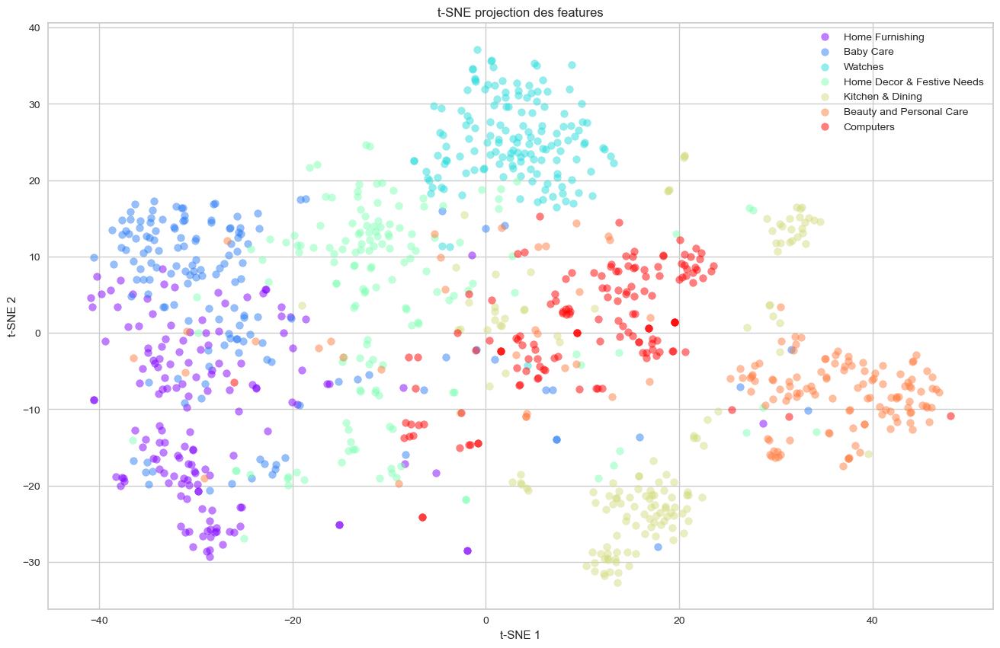

In [30]:
# Lire le DataFrame avec les features extraites
df_cnn_tsne = pd.read_csv('df_cnn_with_features.csv')
df_cnn_tsne.head(5)

# Vérifier le nombre de features disponibles dans le DataFrame
features_columns = [col for col in df_cnn_tsne.columns if col.startswith('feature_')]
num_features = len(features_columns)
print(f'Number of feature columns: {num_features}')

# Appliquer t-SNE pour réduire les dimensions à 2D
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(df_cnn_tsne[features_columns])

# Ajouter les résultats t-SNE au DataFrame
df_cnn_tsne['tsne_2d_one'] = tsne_results[:, 0]
df_cnn_tsne['tsne_2d_two'] = tsne_results[:, 1]

# Visualisation des résultats t-SNE avec Matplotlib
plt.figure(figsize=(16, 10))
categories = df_cnn_tsne['Level_1'].unique()
colors = plt.cm.rainbow(np.linspace(0, 1, len(categories)))

for category, color in zip(categories, colors):
    subset = df_cnn_tsne[df_cnn_tsne['Level_1'] == category]
    plt.scatter(subset['tsne_2d_one'], subset['tsne_2d_two'], c=[color], label=category, alpha=0.5)

plt.title('t-SNE projection des features')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(loc='best')
plt.show()


### 4. Réduction avec PCA

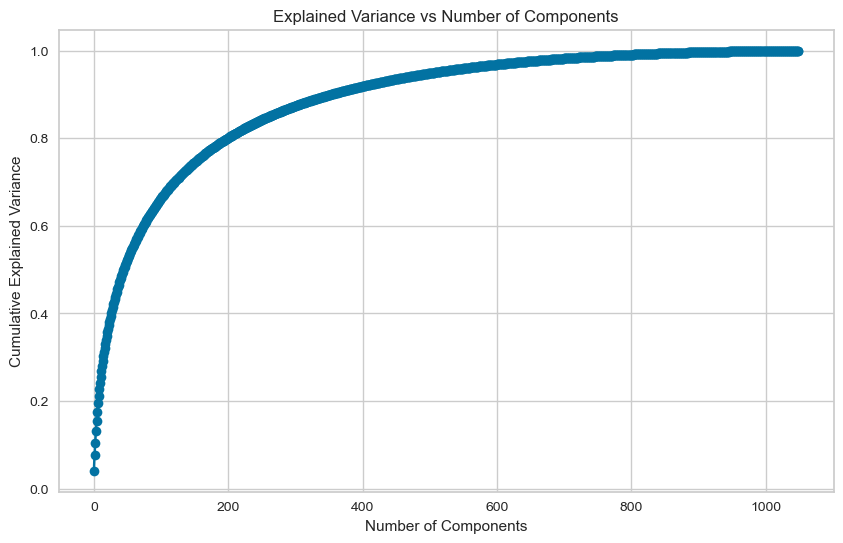

Entrez le seuil de variance à conserver (entre 0 et 1) :  0.98


Nombre de composantes retenues: 682
                                           product_name  \
0     Elegance Polyester Multicolor Abstract Eyelet ...   
1                            Sathiyas Cotton Bath Towel   
2                   Eurospa Cotton Terry Face Towel Set   
3     SANTOSH ROYAL FASHION Cotton Printed King size...   
4     Jaipur Print Cotton Floral King sized Double B...   
...                                                 ...   
1045     Oren Empower Extra Large Self Adhesive Sticker   
1046             Wallmantra Large Vinyl Sticker Sticker   
1047  Uberlyfe Extra Large Pigmented Polyvinyl Films...   
1048            Wallmantra Medium Vinyl Sticker Sticker   
1049                       Uberlyfe Large Vinyl Sticker   

                                     image          Level_1        PC1  \
0     55b85ea15a1536d46b7190ad6fff8ce7.jpg  Home Furnishing   9.742116   
1     7b72c92c2f6c40268628ec5f14c6d590.jpg        Baby Care   5.108805   
2     64d5d4a258243731dc7bbb1eef4

In [32]:
# Séparer les colonnes string
string_columns = df_cnn[['product_name','image','Level_1']]

# Suppression des colonnes 'product_name' et 'level_1' pour la PCA
df_cleaned = df_cnn.drop(columns=['product_name','image','Level_1'])

# Standardisation des données
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_cleaned)

# Application de la PCA pour déterminer le nombre de composantes
pca = PCA().fit(df_scaled)

# Calcul de la variance cumulée
cumulative_variance = pca.explained_variance_ratio_.cumsum()

# Affichage de la variance cumulée pour choisir le seuil
plt.figure(figsize=(10, 6))
plt.plot(cumulative_variance, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance vs Number of Components')
plt.grid(True)
plt.show()

# Demander à l'utilisateur de choisir le seuil de variance
variance_threshold = float(input("Entrez le seuil de variance à conserver (entre 0 et 1) : "))

# Déterminer le nombre de composantes nécessaires pour atteindre le seuil de variance
num_components = next(i for i, total_variance in enumerate(cumulative_variance) if total_variance >= variance_threshold) + 1

# Application de la PCA avec le nombre de composantes sélectionné
pca = PCA(n_components=num_components)
df_pca = pca.fit_transform(df_scaled)

# Création d'un DataFrame pour les résultats de la PCA
df_pca_result = pd.DataFrame(df_pca, columns=[f'PC{i+1}' for i in range(df_pca.shape[1])])

# Ajout des colonnes string au DataFrame final
df_cnn_pca = pd.concat([string_columns, df_pca_result], axis=1)

# Affichage du nombre de composantes retenues
print(f"Nombre de composantes retenues: {num_components}")
print(df_cnn_pca)


### 5. Application du k-means (k=7)

In [45]:
# Définition des hyperparamètres pour K-means
n_clusters = 7 
init = 'k-means++'  
n_init = 25  
max_iter = 300  
random_state = 42  

# Application de K-means avec les hyperparamètres définis
kmeans = KMeans(n_clusters=n_clusters, init=init, n_init=n_init, max_iter=max_iter, random_state=random_state)
kmeans.fit(df_pca)

# Ajout des labels K-means au DataFrame final
df_cnn_pca['kmeans_label'] = kmeans.labels_

Nombre de composantes retenues: 682


,product_name,image,Level_1,PC1,PC2,PC3,PC4,PC5,PC6,PC7,...,PC674,PC675,PC676,PC677,PC678,PC679,PC680,PC681,PC682,kmeans_label
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,9.742116,-9.297303,5.777017,13.237864,5.415145,1.774509,-6.500410,...,-0.373433,-0.824270,0.880588,-0.478860,0.505596,0.606865,-0.350167,0.824825,-0.661540,1
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,5.108805,-9.796033,-9.745273,4.424346,5.529744,0.653491,-7.754826,...,0.119514,0.266931,0.304763,1.323333,-0.309471,0.121995,0.436360,-0.627157,-0.690931,4
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,13.089608,-10.945718,-11.403981,-2.197904,9.030901,1.921000,0.061918,...,-0.181893,0.007551,0.909530,-0.066174,-0.428222,0.817275,0.693369,0.118094,-0.106047,4
3,SANTOSH ROYAL FASHION Cotton Printed King size...,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,7.978684,-6.715612,-8.334166,5.706779,6.682405,-9.128370,-8.677408,...,0.074293,0.513775,0.429452,-0.209921,-0.063619,-0.041705,0.239889,0.036330,-0.113275,1
4,Jaipur Print Cotton Floral King sized Double B...,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,20.292347,-1.931288,2.099765,9.006221,14.769156,-9.483969,-0.720765,...,-0.392305,0.629201,-0.042636,0.013164,0.825858,0.054610,0.478360,-0.683140,-0.409202,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,Oren Empower Extra Large Self Adhesive Sticker,958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,14.065403,-5.665536,8.302663,12.928732,6.462562,-11.913699,3.236462,...,0.625553,0.423152,-0.290118,0.200610,0.295061,0.876875,-0.171605,0.252232,0.020634,1
1046,Wallmantra Large Vinyl Sticker Sticker,fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,9.754827,-0.394320,8.664474,6.601359,-4.937101,0.167950,8.269191,...,0.105297,0.111228,0.916922,0.583024,-0.469940,-0.906626,-0.380797,-0.175288,0.415852,1
1047,Uberlyfe Extra Large Pigmented Polyvinyl Films...,5912e037d12774bb73a2048f35a00009.jpg,Baby Care,13.978935,1.945714,10.803073,15.682812,1.401761,-3.118676,1.705615,...,0.717893,-0.938164,-0.490335,0.287188,-0.179288,0.157061,-0.029442,-0.856240,0.413505,1
1048,Wallmantra Medium Vinyl Sticker Sticker,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,15.093513,0.460257,-3.450070,2.693493,-0.051841,0.803130,0.030367,...,0.300295,-0.851058,-0.346037,-0.311090,-0.607617,0.201677,0.444243,-0.195929,-0.402137,4


### 6. Mesures de performance du partitionnement & correspondance des catégories

In [46]:
# Évaluation des performances du K-means
df_cnn_pca['Level_1'] = df_cnn_pca['Level_1'].astype('category')

# Liste pour stocker les évaluations
evaluations = []
evaluations_std = []

def fit_and_evaluate(km, X, labels, name=None, n_runs=5):
    name = km.__class__.__name__ if name is None else name

    train_times = []
    scores = defaultdict(list)
    for seed in range(n_runs):
        km.set_params(random_state=seed)
        t0 = time()
        km.fit(X)
        train_times.append(time() - t0)
        scores["Homogeneity"].append(metrics.homogeneity_score(labels, km.labels_))
        scores["Completeness"].append(metrics.completeness_score(labels, km.labels_))
        scores["V-measure"].append(metrics.v_measure_score(labels, km.labels_))
        scores["Adjusted Rand-Index"].append(
            metrics.adjusted_rand_score(labels, km.labels_)
        )
        scores["Silhouette Coefficient"].append(
            metrics.silhouette_score(X, km.labels_, sample_size=2000)
        )
    train_times = np.asarray(train_times)

    print(f"Clustering done in {train_times.mean():.2f} ± {train_times.std():.2f} s ")
    evaluation = {
        "estimator": name,
        "train_time": train_times.mean(),
    }
    evaluation_std = {
        "estimator": name,
        "train_time": train_times.std(),
    }
    for score_name, score_values in scores.items():
        mean_score, std_score = np.mean(score_values), np.std(score_values)
        print(f"{score_name}: {mean_score:.3f} ± {std_score:.3f}")
        evaluation[score_name] = mean_score
        evaluation_std[score_name] = std_score
    evaluations.append(evaluation)
    evaluations_std.append(evaluation_std)

# Application de la fonction d'évaluation
fit_and_evaluate(kmeans, df_pca, df_cnn_pca['Level_1'].cat.codes)

Clustering done in 2.10 ± 0.14 s 
Homogeneity: 0.587 ± 0.016
Completeness: 0.603 ± 0.015
V-measure: 0.595 ± 0.016
Adjusted Rand-Index: 0.523 ± 0.028
Silhouette Coefficient: 0.028 ± 0.008


In [36]:
df_cnn_pca

,product_name,image,Level_1,PC1,PC2,PC3,PC4,PC5,PC6,PC7,...,PC674,PC675,PC676,PC677,PC678,PC679,PC680,PC681,PC682,kmeans_label
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,9.742116,-9.297303,5.777017,13.237864,5.415145,1.774509,-6.500410,...,-0.373433,-0.824270,0.880588,-0.478860,0.505596,0.606865,-0.350167,0.824825,-0.661540,1
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,5.108805,-9.796033,-9.745273,4.424346,5.529744,0.653491,-7.754826,...,0.119514,0.266931,0.304763,1.323333,-0.309471,0.121995,0.436360,-0.627157,-0.690931,4
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,13.089608,-10.945718,-11.403981,-2.197904,9.030901,1.921000,0.061918,...,-0.181893,0.007551,0.909530,-0.066174,-0.428222,0.817275,0.693369,0.118094,-0.106047,4
3,SANTOSH ROYAL FASHION Cotton Printed King size...,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,7.978684,-6.715612,-8.334166,5.706779,6.682405,-9.128370,-8.677408,...,0.074293,0.513775,0.429452,-0.209921,-0.063619,-0.041705,0.239889,0.036330,-0.113275,1
4,Jaipur Print Cotton Floral King sized Double B...,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,20.292347,-1.931288,2.099765,9.006221,14.769156,-9.483969,-0.720765,...,-0.392305,0.629201,-0.042636,0.013164,0.825858,0.054610,0.478360,-0.683140,-0.409202,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,Oren Empower Extra Large Self Adhesive Sticker,958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,14.065403,-5.665536,8.302663,12.928732,6.462562,-11.913699,3.236462,...,0.625553,0.423152,-0.290118,0.200610,0.295061,0.876875,-0.171605,0.252232,0.020634,1
1046,Wallmantra Large Vinyl Sticker Sticker,fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,9.754827,-0.394320,8.664474,6.601359,-4.937101,0.167950,8.269191,...,0.105297,0.111228,0.916922,0.583024,-0.469940,-0.906626,-0.380797,-0.175288,0.415852,1
1047,Uberlyfe Extra Large Pigmented Polyvinyl Films...,5912e037d12774bb73a2048f35a00009.jpg,Baby Care,13.978935,1.945714,10.803073,15.682812,1.401761,-3.118676,1.705615,...,0.717893,-0.938164,-0.490335,0.287188,-0.179288,0.157061,-0.029442,-0.856240,0.413505,1
1048,Wallmantra Medium Vinyl Sticker Sticker,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,15.093513,0.460257,-3.450070,2.693493,-0.051841,0.803130,0.030367,...,0.300295,-0.851058,-0.346037,-0.311090,-0.607617,0.201677,0.444243,-0.195929,-0.402137,4


### 7. Analyse des clusters

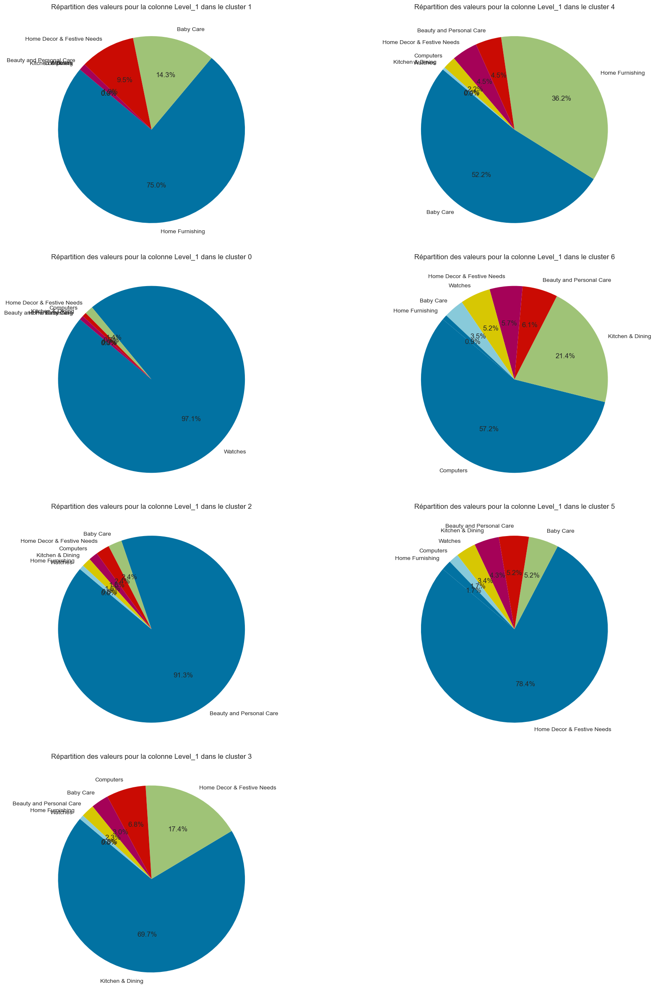

In [38]:
# Obtenir les clusters uniques
clusters = df_cnn_pca['kmeans_label'].unique()

# Définir le nombre de colonnes pour les sous-graphes
num_cols = 2

# Calculer le nombre de lignes nécessaires
num_rows = (len(clusters) + num_cols - 1) // num_cols

# Créer les sous-graphes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(18, num_rows * 6))

# Aplatir les axes pour faciliter l'itération
axes = axes.flatten()

# Tracer un diagramme circulaire pour chaque cluster
for i, cluster in enumerate(clusters):
    cluster_data = df_cnn_pca[df_cnn_pca['kmeans_label'] == cluster]
    level_1_counts = cluster_data['Level_1'].value_counts()
    
    axes[i].pie(level_1_counts, labels=level_1_counts.index, autopct='%1.1f%%', startangle=140)
    axes[i].set_title(f"Répartition des valeurs pour la colonne Level_1 dans le cluster {cluster}")

# Supprimer les axes vides 
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

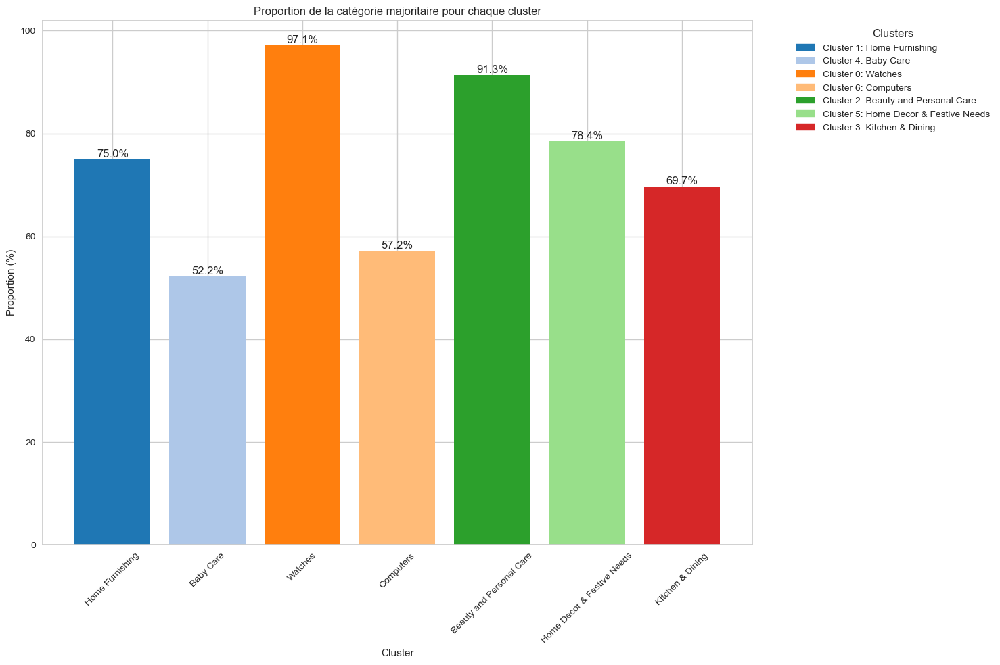

In [40]:
# Obtenir les clusters uniques
clusters = df_cnn_pca['kmeans_label'].unique()

# Initialiser une liste pour stocker les informations
top_categories = []

# Extraire la catégorie la plus représentée et sa proportion pour chaque cluster
for cluster in clusters:
    cluster_data = df_cnn_pca[df_cnn_pca['kmeans_label'] == cluster]
    level_1_counts = cluster_data['Level_1'].value_counts()
    
    # Obtenir la catégorie et la valeur la plus représentée
    top_category = level_1_counts.idxmax()
    top_value = level_1_counts.max()
    total_values = level_1_counts.sum()
    proportion = top_value / total_values * 100
    
    # Ajouter les informations à la liste
    top_categories.append({'Cluster': cluster, 'Top Category': top_category, 'Proportion': proportion})

# Convertir la liste en DataFrame
top_categories_df = pd.DataFrame(top_categories)

# Définir une palette de couleurs
colors = plt.cm.tab20.colors 

# Assigner une couleur à chaque cluster
cluster_colors = {cluster: colors[i % len(colors)] for i, cluster in enumerate(clusters)}

# Tracer l'histogramme des proportions
plt.figure(figsize=(15, 10))
bars = plt.bar(top_categories_df['Cluster'].astype(str), top_categories_df['Proportion'], 
               color=[cluster_colors[cluster] for cluster in top_categories_df['Cluster']], tick_label=top_categories_df['Top Category'])

# Ajouter les étiquettes de valeurs
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.1f}%', ha='center', va='bottom')

# Ajouter la légende avec des descriptions plus complètes
handles = [plt.Rectangle((0,0),1,1, color=cluster_colors[cluster]) for cluster in clusters]
labels = [f'Cluster {cluster}: {top_categories_df[top_categories_df["Cluster"] == cluster]["Top Category"].values[0]}' for cluster in clusters]
plt.legend(handles, labels, title='Clusters', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.xlabel('Cluster')
plt.ylabel('Proportion (%)')
plt.title('Proportion de la catégorie majoritaire pour chaque cluster')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


Le score obtenu de 0.53 pour le Ari est encourageant. Nous allons approfondir le sujet en essayant d'autres modèles de CNN

## C. Deuxième approche avec plusieurs modèles

Nous allons tester d'autres sur la même démarche, afin de voir si nous pouvons avoir de meilleurs résultats en terme de ariscore pour le non-supervisé.

Les modèles seront les suivants : 
- Le resnet101
- Le VGG
- Le effb0
- Le effb7

Pour des raisons de performances et ressources en terme "compute", je choisis de reproduire la démarche avec un modèle à la fois.
Le modèle qui présentera les meilleurs performances dans les mêmes condition sera choisis et nous essayerons d'aller plus loin dans une démarche modèle centrique, en jouant avec une gridsearchvalue

In [7]:
df_pict = df[['product_name',
              'image',
              'Level_1']].copy()
df_pict.head(5)

,product_name,image,Level_1
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care
3,SANTOSH ROYAL FASHION Cotton Printed King size...,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing
4,Jaipur Print Cotton Floral King sized Double B...,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing


### 1. Resnet101 (ARI = 0.511)

In [27]:
# Chemin vers le répertoire contenant les images
directory_path = r'C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images'

# Hyperparamètres
learning_rate = 0.001
batch_size = 64
epochs = 30

# Charger le modèle ResNet50 pré-entraîné
base_model = ResNet101(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Ajouter une couche de Global Average Pooling pour l'extraction des features
x = base_model.output
x = GlobalAveragePooling2D()(x)

# Créer le modèle pour l'extraction des features
model = Model(inputs=base_model.input, outputs=x)

# Configuration de l'augmentation des données
datagen = ImageDataGenerator(
    rescale=1.0/255.0,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Fonction pour pré-traiter et extraire les features d'une image
def extract_features(img_path, model):
    try:
        img = image.load_img(img_path, target_size=(224, 224))
        img = image.img_to_array(img)
        img = np.expand_dims(img, axis=0)
        img = preprocess_input(img)  # Pré-traitement spécifique pour Caffe
        features = model.predict(img)
        print(f"Features shape for {img_path}: {features.shape}") 
        return features.flatten()
    except Exception as e:
        print(f"Erreur lors du traitement de l'image {img_path}: {str(e)}")
        return None

# Initialiser une liste pour stocker les features et les noms des images
all_features = []
image_names = []


# Vérifiez si 'image' est dans les colonnes
if 'image' not in df_pict.columns:
    raise ValueError("Le DataFrame df_pict ne contient pas de colonne 'image'. Veuillez vérifier le DataFrame d'entrée.")

# Extraction des features avec une barre de progression
progress_bar = tqdm(total=len(df_pict), desc='Extraction des features')
for img_name in df_pict['image']:
    img_path = os.path.join(directory_path, img_name)
    if os.path.isfile(img_path):
        features = extract_features(img_path, model)
        if features is not None:
            all_features.append(features)
            image_names.append(img_name)
    progress_bar.update(1)
progress_bar.close()

# Vérifier que all_features n'est pas vide avant de créer le DataFrame
if all_features:
    feature_dimension = len(all_features[0])
    features_df = pd.DataFrame(all_features, columns=[f'feature_{i}' for i in range(feature_dimension)])
    features_df['image'] = image_names

    # Fusionner les features avec le DataFrame d'origine
    df_pict = pd.merge(df_pict, features_df, on='image', how='left')

    # Afficher les premières lignes du DataFrame pour vérifier
    print(df_pict.head())

    # Enregistrer le DataFrame avec les features dans un fichier CSV
    df_pict.to_csv('df_pict_with_features.csv', index=False)
else:
    print("Aucune feature extraite. Vérifiez le processus d'extraction.")


Extraction des features:   0%|          | 0/1050 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


Extraction des features:   0%|          | 1/1050 [00:04<1:13:48,  4.22s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55b85ea15a1536d46b7190ad6fff8ce7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:   0%|          | 2/1050 [00:04<32:17,  1.85s/it]  

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b72c92c2f6c40268628ec5f14c6d590.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   0%|          | 3/1050 [00:04<18:56,  1.09s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64d5d4a258243731dc7bbb1eef49ad74.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:   0%|          | 4/1050 [00:04<12:49,  1.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d4684dcdc759dd9cdf41504698d737d8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:   0%|          | 5/1050 [00:05<09:37,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6325b6870c54cd47be6ebfbffa620ec7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:   1%|          | 6/1050 [00:05<07:37,  2.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\893aa5ed55f7cff2eccea7758d7a86bd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:   1%|          | 7/1050 [00:05<06:16,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f355cc1ccb08bd0d283ed979b7ee7515.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:   1%|          | 8/1050 [00:05<05:10,  3.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd0e3470a7e6ed76fd69c2da27721041.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:   1%|          | 9/1050 [00:05<04:28,  3.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41384da51732c0b4df3de8f395714fbb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


Extraction des features:   1%|          | 10/1050 [00:05<04:14,  4.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\710ed5f2393a4b9e8823aa0029f71f93.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   1%|          | 11/1050 [00:06<03:51,  4.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\920154acbe49d3202ed7d2ed2df1ea13.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:   1%|          | 12/1050 [00:06<03:33,  4.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08452abdadb3db1e686b94a9c52fc7b6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   1%|          | 13/1050 [00:06<03:17,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1e8741b5ae27a513546c94b3f3312aee.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:   1%|▏         | 14/1050 [00:06<03:08,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\189fa66a5fa6f08d2802a62ecf0be298.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:   1%|▏         | 15/1050 [00:06<03:10,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bbb8cdc5406ff60ff06ff64630f2ca47.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:   2%|▏         | 16/1050 [00:07<03:10,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1120bc768623572513df956172ffefeb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:   2%|▏         | 17/1050 [00:07<03:08,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5479bb7028827d60000720a2c135976a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:   2%|▏         | 18/1050 [00:07<03:03,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\733aa1e801a139fa8dc7be9f0eff5ee0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:   2%|▏         | 19/1050 [00:07<03:00,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62c35de4df27437d3597963fac55a8b6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


Extraction des features:   2%|▏         | 20/1050 [00:07<03:20,  5.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\33d97d63c037078cd3f08033966d6a88.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:   2%|▏         | 21/1050 [00:07<03:14,  5.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d7ca2b06b4f4d3b98c61c377b18a2d6b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:   2%|▏         | 22/1050 [00:08<03:08,  5.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f74476ba64365d97a5be7d375cbf4c7a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:   2%|▏         | 23/1050 [00:08<03:03,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda50982a672ef8835de5c1cc86f8bfc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:   2%|▏         | 24/1050 [00:08<03:04,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4788f5466992da09024b8ffcc8a5cba4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   2%|▏         | 25/1050 [00:08<03:00,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\653826cd53f1d9e2c086c0ac7846ef70.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


Extraction des features:   2%|▏         | 26/1050 [00:08<03:20,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c74db45cbfc14a78b8466dca494b3bb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:   3%|▎         | 27/1050 [00:09<03:10,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4aa047f14885c74f155ce5f973e14dff.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step


Extraction des features:   3%|▎         | 28/1050 [00:09<03:33,  4.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c4fec2331da8d40f2cb146eb198cb57.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


Extraction des features:   3%|▎         | 29/1050 [00:09<03:38,  4.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b52073e7ed9c00c4108cae4eb0c49c1a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:   3%|▎         | 30/1050 [00:09<03:26,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee8d9ff65e0fe4278afce7c933d30941.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:   3%|▎         | 31/1050 [00:09<03:08,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\788dc3a3da91c0f46a7c465e07f91dd4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   3%|▎         | 32/1050 [00:10<03:07,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29b1ca231e10d5269516b80bf9d0dffc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:   3%|▎         | 33/1050 [00:10<03:03,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8b268c1e68f198ae2e934717d49f48e9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:   3%|▎         | 34/1050 [00:10<03:02,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b85f8843bb1c297dd5712f0bd287006d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:   3%|▎         | 35/1050 [00:10<02:56,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4b09aa7927c59fbb39960b3d7919909.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:   3%|▎         | 36/1050 [00:10<02:53,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\81e739c7f3be737152f2e6f520e3494b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:   4%|▎         | 37/1050 [00:10<03:00,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0938b0d88eac91deee6d5add54097d3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Extraction des features:   4%|▎         | 38/1050 [00:11<03:08,  5.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e9420e9483f16db81c64dddf99f34841.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


Extraction des features:   4%|▎         | 39/1050 [00:11<03:20,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a3dea07b2f7bf48276d32513091be717.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


Extraction des features:   4%|▍         | 40/1050 [00:11<03:31,  4.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66191b4a311b5d9babfc00a71ef97c5b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:   4%|▍         | 41/1050 [00:11<03:17,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90e56526f4c5892beac49f262b85150a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:   4%|▍         | 42/1050 [00:11<03:15,  5.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a79117ea49a0533f641facdb4c99f502.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:   4%|▍         | 43/1050 [00:12<03:09,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5325213d84c80ad310b6e4b37a1ac824.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:   4%|▍         | 44/1050 [00:12<03:09,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2d50e4c6ccf8befe9335ac8f97a11712.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


Extraction des features:   4%|▍         | 45/1050 [00:12<03:14,  5.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8050d31bffe6827c804b8222338aafb2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:   4%|▍         | 46/1050 [00:12<03:07,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\493d1eb6ad7a48a926092bf994cd0bb0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:   4%|▍         | 47/1050 [00:12<03:01,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3388d05e88972ff9f3e1321dc0cfdc28.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:   5%|▍         | 48/1050 [00:12<02:58,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d1899ab1d5c79ddaa311bc9f04d198ed.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   5%|▍         | 49/1050 [00:13<02:56,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e7cab08a267e815c72a26513222783e0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Extraction des features:   5%|▍         | 50/1050 [00:13<03:01,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02a53d335775b652f22f41b529b9d646.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:   5%|▍         | 51/1050 [00:13<02:56,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\69446af66066146718cd569f87e99fff.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:   5%|▍         | 52/1050 [00:13<02:51,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4d35b6536b623c83b293eb3a1c02bba.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:   5%|▌         | 53/1050 [00:13<02:48,  5.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f01140c02fd09e5c56312a64fa8db3da.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:   5%|▌         | 54/1050 [00:14<02:46,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6329ddb46087cb8c09ced95471dd9643.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:   5%|▌         | 55/1050 [00:14<02:46,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e6ae1b372e8e0b509b83ba3658b8107.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


Extraction des features:   5%|▌         | 56/1050 [00:14<03:11,  5.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e2ae2af58ac50adf4881751ae84a9d8a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:   5%|▌         | 57/1050 [00:14<03:08,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\24e85c590481a7cedfe66597f253f2b2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:   6%|▌         | 58/1050 [00:14<03:11,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5e84d36ad6db970548498829db8b15de.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:   6%|▌         | 59/1050 [00:14<03:00,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c4604dba348a99a2dfbbc2cd3928101.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:   6%|▌         | 60/1050 [00:15<03:10,  5.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0abfcbe0e17dd50c4cf5fb1d6037d514.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:   6%|▌         | 61/1050 [00:15<03:02,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4a1b23dacd7d2a9ec7414f7159f25a48.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   6%|▌         | 62/1050 [00:15<02:56,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95330f6f0f44d17b918feec36bedcdef.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:   6%|▌         | 63/1050 [00:15<03:00,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66a5a21ea332aefcc7b90dbad94053aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:   6%|▌         | 64/1050 [00:15<02:58,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f4e7f269319ba9cf5507a9e2febacbf5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:   6%|▌         | 65/1050 [00:16<02:59,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\80e9cb3d2d7f9ff7bc497c34df366d03.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:   6%|▋         | 66/1050 [00:16<03:02,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2baa415ebcc4fe563ce13b50e60efc1c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:   6%|▋         | 67/1050 [00:16<02:58,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\903d63e2b71d692ccd628e1de516516e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


Extraction des features:   6%|▋         | 68/1050 [00:16<03:14,  5.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\707b160df4c4dece6cde52b222ce624b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:   7%|▋         | 69/1050 [00:16<03:13,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed9817e8960a6a0d509061c54cfe5ac1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:   7%|▋         | 70/1050 [00:17<03:19,  4.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a7a1287fef0d986a5e237797beee286.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   7%|▋         | 71/1050 [00:17<03:06,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ba898ecb77ab5a6799c8b047c6b6008.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:   7%|▋         | 72/1050 [00:17<03:06,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2658bad8c2b7d5b08984c6ac34267f7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:   7%|▋         | 73/1050 [00:17<03:08,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\afc3ebd18df498dd87abb7ad7536b5c7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:   7%|▋         | 74/1050 [00:17<03:02,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\141d2b743c477043041faddf9233c8ad.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


Extraction des features:   7%|▋         | 75/1050 [00:18<03:30,  4.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7a3f11f380a1bf85338ab3771ff81e9f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:   7%|▋         | 76/1050 [00:18<03:38,  4.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae45b64d808a883aa35f2bf4de879cac.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:   7%|▋         | 77/1050 [00:18<03:29,  4.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1971dcd2f3058a4c87bdd7d87d4baeba.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:   7%|▋         | 78/1050 [00:18<03:16,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4942e0a9c0527dc00319a39fc8f103e6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:   8%|▊         | 79/1050 [00:18<03:36,  4.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0a8a1e9c6659361c0c2b247f8a6471d0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   8%|▊         | 80/1050 [00:19<03:24,  4.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\320833ab08c9a94ef83520612899a85f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:   8%|▊         | 81/1050 [00:19<03:10,  5.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\57578c1e6ec61a880a6f3f971f5f77b8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:   8%|▊         | 82/1050 [00:19<03:21,  4.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e130ed339dcfe20d2c8b66892278a94.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:   8%|▊         | 83/1050 [00:19<03:14,  4.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\601817defaff9d0e30e1b72f96d3975f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:   8%|▊         | 84/1050 [00:19<03:12,  5.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3cdfd9df09f61a8fd178bafcc8dbed31.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   8%|▊         | 85/1050 [00:20<03:05,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\374e63028d691c380bc43b0dc60e460d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:   8%|▊         | 86/1050 [00:20<02:58,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\61c0139f3d5c97f1615797dbf046cc0c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:   8%|▊         | 87/1050 [00:20<02:51,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0096e89cc25a8b96fb9808716406fe94.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:   8%|▊         | 88/1050 [00:20<02:48,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e8ee7868b0c3d1d04b482cd4f3ec5ccc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   8%|▊         | 89/1050 [00:20<02:46,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\04f9ff160a1561e3656350f4bd6b8c50.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:   9%|▊         | 90/1050 [00:20<02:44,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aebf3a2172b33ef09acb472009967812.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   9%|▊         | 91/1050 [00:21<02:40,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ae332e2bafd23267caedfcc4453257c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   9%|▉         | 92/1050 [00:21<02:52,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\57800d48b001f3fad34a4f8fa9207f29.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step


Extraction des features:   9%|▉         | 93/1050 [00:21<03:15,  4.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d1e18b4a3aafb0040da2111c8b8ce2e5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


Extraction des features:   9%|▉         | 94/1050 [00:21<03:23,  4.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46e6853da6b0c796b7a0d8203ceaa88e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:   9%|▉         | 95/1050 [00:21<03:13,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22296bfc1c79d9dc88eabbd01220ef0c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:   9%|▉         | 96/1050 [00:22<03:10,  5.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f4d4c2eec77732f56e47722d7a355f2b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:   9%|▉         | 97/1050 [00:22<03:00,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f12a06b7dbfc55638afafcf8bb03d836.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:   9%|▉         | 98/1050 [00:22<02:58,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\18bd9b88e23b82fd19f8ab0c9cad6a1a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:   9%|▉         | 99/1050 [00:22<02:50,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5749bae8ccead7997ebf370b6b081d07.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  10%|▉         | 100/1050 [00:22<02:51,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\059493eeb88ebb4cc08d1522f3f87c3f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


Extraction des features:  10%|▉         | 101/1050 [00:23<02:56,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9613f2f1e65fb1fc7e181e7f83c217da.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  10%|▉         | 102/1050 [00:23<02:56,  5.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7fcd0d983a51283e58b806f065cc920.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  10%|▉         | 103/1050 [00:23<02:59,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b78586222de9a1095d0a9d88455ee75f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  10%|▉         | 104/1050 [00:23<02:55,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dfbd96036cbc28566e964cff04b5b3a8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  10%|█         | 105/1050 [00:23<02:54,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\336fc49639a5cc45aa532ace3ee1a044.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  10%|█         | 106/1050 [00:24<03:12,  4.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\789cf5578f48577a44586fca3adc35d0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  10%|█         | 107/1050 [00:24<03:06,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\184ecf07ca4e2872eaf53d2344a1e783.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  10%|█         | 108/1050 [00:24<02:57,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b515014adccb1fdf5ff1e2c4a8ff9ea6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  10%|█         | 109/1050 [00:24<02:57,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5aacf8f5154afea2ac22fc767d072677.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  10%|█         | 110/1050 [00:24<02:51,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cbbe686c4a233e8cf53528748f75223.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  11%|█         | 111/1050 [00:24<02:50,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f1ee63a5f0db853e2c1b377778580d39.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  11%|█         | 112/1050 [00:25<02:53,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0bb0f7b7a3075f4b9459121abe2185fa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  11%|█         | 113/1050 [00:25<02:49,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8015db34d09642b046c775e8157dd729.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  11%|█         | 114/1050 [00:25<02:44,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ddc40c08d9a9bafc4d14eddd98db7c0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  11%|█         | 115/1050 [00:25<02:35,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc784846bd59a16832454416ac708003.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  11%|█         | 116/1050 [00:25<02:53,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e8f5dc78f80eff3c77a9714303f59d2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


Extraction des features:  11%|█         | 117/1050 [00:26<03:11,  4.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53f4bc7d7321f5c41de6b86e41f13e80.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  11%|█         | 118/1050 [00:26<03:12,  4.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be09f5a3a88ac10ae14c791fc8ac0dae.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  11%|█▏        | 119/1050 [00:26<03:08,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d202ea988ab11f2327279093ac71975d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  11%|█▏        | 120/1050 [00:26<03:07,  4.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\db6c79a1d852944a89e157793f392d67.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


Extraction des features:  12%|█▏        | 121/1050 [00:26<03:12,  4.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\16c18ce0affca13159e362227c83683c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


Extraction des features:  12%|█▏        | 122/1050 [00:27<03:18,  4.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7dd5e83e2108a97659577e50879f9d9f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  12%|█▏        | 123/1050 [00:27<03:09,  4.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a63eecfbb02004863fa1f29a0b8105fc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  12%|█▏        | 124/1050 [00:27<03:25,  4.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c77aa1fc09901ae07c392c152a70e41.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  12%|█▏        | 125/1050 [00:27<03:27,  4.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\640fd08bb3ba538d67a5c0c2c61a5c4c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  12%|█▏        | 126/1050 [00:28<03:13,  4.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7241df1acae1fac892c692097ea3fb98.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  12%|█▏        | 127/1050 [00:28<03:08,  4.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a85a7dbd31267a7b02eda3a4d484632d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  12%|█▏        | 128/1050 [00:28<03:02,  5.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\13de17e59a92f8bcaec8bf103bbff8c1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  12%|█▏        | 129/1050 [00:28<02:56,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ba13df7877fd979d64c87c7586a5ca6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  12%|█▏        | 130/1050 [00:28<02:55,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f1484a63c0dc79e96c98b2a250380ed8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  12%|█▏        | 131/1050 [00:28<02:50,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f01ff0a82401117e9da22dd680fd2f36.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  13%|█▎        | 132/1050 [00:29<02:43,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de911421573d3e234450040374b55b38.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  13%|█▎        | 133/1050 [00:29<02:43,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\614dbfa2f42c4684c0bb6152091113a6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  13%|█▎        | 134/1050 [00:29<02:43,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5531b9f454e2d75cfe00c3f795e06de5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  13%|█▎        | 135/1050 [00:29<02:44,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\258444ac7bb7ad8026800efad5c3502b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  13%|█▎        | 136/1050 [00:29<02:48,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd369a1bb58ae02cd925dda7e9e1d00a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Extraction des features:  13%|█▎        | 137/1050 [00:30<02:54,  5.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73f460cd6f3fd206902d7097a1816405.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  13%|█▎        | 138/1050 [00:30<02:50,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0d3e1dc0d38be59e9927e47f152e48aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


Extraction des features:  13%|█▎        | 139/1050 [00:30<03:00,  5.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\118b411bf265538461b084ce7abd55a8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  13%|█▎        | 140/1050 [00:30<02:54,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06749cbff1487f470438823f6952cfd1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  13%|█▎        | 141/1050 [00:30<02:50,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\202fc276e672eb8c29891aa50aef0771.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  14%|█▎        | 142/1050 [00:30<02:44,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\feefbdff924dd6b7cc266449c9a36d69.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  14%|█▎        | 143/1050 [00:31<02:42,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\af1ac46194b5488048c459102a16a57e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  14%|█▎        | 144/1050 [00:31<02:41,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1fd886094826c3f25c6ffb380073974.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


Extraction des features:  14%|█▍        | 145/1050 [00:31<02:52,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3847353a4b8de1efc504d589aea74ffe.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


Extraction des features:  14%|█▍        | 146/1050 [00:31<02:58,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60efd61370e70267dc60b11ff2bf974c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 195ms/step


Extraction des features:  14%|█▍        | 147/1050 [00:31<03:17,  4.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63bc43c0000e71eb11bfafd2f46214a4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  14%|█▍        | 148/1050 [00:32<02:58,  5.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8794f7a06b530782c66f7c0911bb437.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  14%|█▍        | 149/1050 [00:32<02:52,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8507eb0ef32c1c0db700f20aad6d9bcd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  14%|█▍        | 150/1050 [00:32<02:47,  5.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc7abdf67b4d7dbf64dffbab7b37599c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  14%|█▍        | 151/1050 [00:32<02:43,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1afa5f2c3c9b4b43def6dc2e695d2c87.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  14%|█▍        | 152/1050 [00:32<02:38,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73503fe89ea77420a598f4a1019e5b6d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  15%|█▍        | 153/1050 [00:33<02:41,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ec590694e8bf85f75c9200cf418127aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  15%|█▍        | 154/1050 [00:33<02:34,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7956d9586de3e25ff586bca58be7195e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  15%|█▍        | 155/1050 [00:33<02:31,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63f6ef8f3fda2c306b27cfbf5a005f1e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  15%|█▍        | 156/1050 [00:33<02:29,  5.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\328b66226952d8733c0c48295fae1108.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  15%|█▍        | 157/1050 [00:33<02:52,  5.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6efd5d260667b94f04edbbd18bb300b9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


Extraction des features:  15%|█▌        | 158/1050 [00:33<03:01,  4.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\beaa6285a2b9c66db0e294767711ca3f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  15%|█▌        | 159/1050 [00:34<03:14,  4.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41fd5af61752be98b19b611a6ff9a0ef.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  15%|█▌        | 160/1050 [00:34<03:08,  4.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\219b24362655097cb41bf06a0be8ee79.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  15%|█▌        | 161/1050 [00:34<03:01,  4.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5d1b8ef70b1ce27726f7f6c2f373e56.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  15%|█▌        | 162/1050 [00:34<02:55,  5.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\69515ea06da8b2b1c881ce34fbf6575a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  16%|█▌        | 163/1050 [00:35<02:56,  5.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02127f52e96fb72c66bf081d25104ef8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  16%|█▌        | 164/1050 [00:35<02:56,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c4581cae6bf751a7ae5c40bb16b74e98.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  16%|█▌        | 165/1050 [00:35<02:47,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8f42da0f9f695f07067676eae4135c8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  16%|█▌        | 166/1050 [00:35<02:47,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\785b4383b12106dd172306d427d8f7b2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  16%|█▌        | 167/1050 [00:35<02:43,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d19d17140fdd9adc09ba6e2ad1e1ebb9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  16%|█▌        | 168/1050 [00:35<02:34,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aadbc3b9c32c4535b1bfee7321c4c0e7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  16%|█▌        | 169/1050 [00:36<02:32,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea16e13a7cf16d8665d1bc44738dfa88.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  16%|█▌        | 170/1050 [00:36<02:28,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a341f915962ee99754e962520f279708.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  16%|█▋        | 171/1050 [00:36<02:31,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9077acd25761ea067ac6d9369d8fdf16.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  16%|█▋        | 172/1050 [00:36<02:33,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cab75cad4b3a3c593c753a1759df28e2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  16%|█▋        | 173/1050 [00:36<02:27,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5590e238d44b370337624f5987fb9b8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  17%|█▋        | 174/1050 [00:36<02:29,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b043b37c38f081d96886acb5acfbdf5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  17%|█▋        | 175/1050 [00:37<02:29,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b92e13d5ef945d086fd4f42b95bc04ac.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  17%|█▋        | 176/1050 [00:37<02:29,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22ea3b69860bc9a5e0c69b87db2dcdab.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  17%|█▋        | 177/1050 [00:37<02:34,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\154920adb9d584b55d419227f9b01cc6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  17%|█▋        | 178/1050 [00:37<02:41,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5dbf978ab2cf9d2da6446d3e4595f690.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  17%|█▋        | 179/1050 [00:37<02:37,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7ef3e6ec248f17f3a6a4697120ddb96.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  17%|█▋        | 180/1050 [00:37<02:31,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aab46b84f70cc6774afaafe1d6035de3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  17%|█▋        | 181/1050 [00:38<02:31,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\58d7fbbe6d306ecf16e0a7ac05b211d4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  17%|█▋        | 182/1050 [00:38<02:28,  5.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59af3731b809a25f2bf99e99f645d8dd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  17%|█▋        | 183/1050 [00:38<02:31,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c4ca34c50a5437a1bcc42b72fc1351f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  18%|█▊        | 184/1050 [00:38<02:29,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3830dda3491cd5b28ed42ae544bc44f0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  18%|█▊        | 185/1050 [00:38<02:29,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f712e172ee77a913b6d627657986b72.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


Extraction des features:  18%|█▊        | 186/1050 [00:39<02:38,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6da53319cc12c9729881f5478ff67223.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  18%|█▊        | 187/1050 [00:39<02:32,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8bf65b132179faf26f61e26274b2b819.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  18%|█▊        | 188/1050 [00:39<02:31,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f69bef5db54cb4c83b2aa8d0ce829d4e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  18%|█▊        | 189/1050 [00:39<02:32,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ffbf3794aa8cb6bb8d3f313d0a549a09.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  18%|█▊        | 190/1050 [00:39<02:25,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\acd2f21d63ac0bbed4d52e6010d9460b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  18%|█▊        | 191/1050 [00:39<02:29,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b46d7b8e6826ad4c8b40a991da0f54d7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  18%|█▊        | 192/1050 [00:40<02:27,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce2f67c3365846170cb709784d87e45b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  18%|█▊        | 193/1050 [00:40<02:23,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4ccd4c315d99edd7c00d015b714485a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  18%|█▊        | 194/1050 [00:40<02:23,  5.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\302c95f6eae5f4ce217fcedc4ef91262.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  19%|█▊        | 195/1050 [00:40<02:25,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f756aa2ceb1efda609c428a47308758.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  19%|█▊        | 196/1050 [00:40<02:23,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e3586dc60df258c5478446d65a317d2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


Extraction des features:  19%|█▉        | 197/1050 [00:40<02:38,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40829ac110f344ef35f1c8c32fb311c7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


Extraction des features:  19%|█▉        | 198/1050 [00:41<02:52,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3c741a05c82c54343b94ed8c1292e2a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  19%|█▉        | 199/1050 [00:41<02:41,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d75705ad163412347cba51f882e9c0f0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  19%|█▉        | 200/1050 [00:41<02:37,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90f86ac4065397340e8012261577c220.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  19%|█▉        | 201/1050 [00:41<02:34,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\168618e93387ad7171d4e4e1eeff9d1a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  19%|█▉        | 202/1050 [00:41<02:32,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c4ab8ab059c912090c83cb0818e7f1c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  19%|█▉        | 203/1050 [00:42<03:06,  4.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70578f48cc96bbb60d040e08025e521d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  19%|█▉        | 204/1050 [00:42<02:57,  4.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5b378b0925d5409b5d84ceb416fc2afc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  20%|█▉        | 205/1050 [00:42<02:48,  5.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6775e3b91baa4d368f6d91eb7c24578b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  20%|█▉        | 206/1050 [00:42<02:42,  5.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c109187e7975ee8fdb2b3dfbdd9dce20.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  20%|█▉        | 207/1050 [00:42<02:39,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8962b50b699ddf4712ad18d29c6a3862.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  20%|█▉        | 208/1050 [00:43<02:33,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4d9e71172f619f8e3122e34bb0bf3cc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  20%|█▉        | 209/1050 [00:43<02:29,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55ce1309b69e1912d2fd60a3ee3f351b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  20%|██        | 210/1050 [00:43<02:28,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a9b35b94610a3d7f4fa91f19693c5248.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  20%|██        | 211/1050 [00:43<02:25,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3113367c72125a3355af42426fe14f17.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  20%|██        | 212/1050 [00:43<02:25,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e99d9abb115a9bd580bcccf9ff4d4881.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  20%|██        | 213/1050 [00:43<02:21,  5.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de29bf3288345e23b0e25345a3a057fb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  20%|██        | 214/1050 [00:44<02:22,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3e7c584f317d1b5d6ac0088c411565e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  20%|██        | 215/1050 [00:44<02:15,  6.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d279c825ba12804c337f883b366a6e2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  21%|██        | 216/1050 [00:44<02:17,  6.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91a5328e7235424885d271dfa0959eeb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  21%|██        | 217/1050 [00:44<02:16,  6.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2110699b945ae766c8b8112038ac58b9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  21%|██        | 218/1050 [00:44<02:15,  6.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\198dbe7be6f84f6448197148d7b5e5a5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  21%|██        | 219/1050 [00:45<02:53,  4.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce02ab514e4c623dcf7acd7182a7762d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  21%|██        | 220/1050 [00:45<02:45,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2ede595489db33a036d135ce22645515.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  21%|██        | 221/1050 [00:45<02:37,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32cf0691248297655e2c1728b12e2262.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  21%|██        | 222/1050 [00:45<02:26,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\81a695f80d3f5c445910d310f1a83eb8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  21%|██        | 223/1050 [00:45<02:24,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\922a04084481d4b3275a3f7bb54e90f3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  21%|██▏       | 224/1050 [00:45<02:21,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2751cf0dd59d223cacbc5da5df42a1a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  21%|██▏       | 225/1050 [00:46<02:17,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc2e2bb105a5c2b2e43842886d057b81.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  22%|██▏       | 226/1050 [00:46<02:19,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\67d6b4a8aa19d57740b0440365b77624.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  22%|██▏       | 227/1050 [00:46<02:23,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f39a2cce8929f5b44087d688995994e4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  22%|██▏       | 228/1050 [00:46<02:23,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4451f1b01168b6a085738d0b0f2f02aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  22%|██▏       | 229/1050 [00:46<02:22,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f76aaed44b540869da862c5dd4b266f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  22%|██▏       | 230/1050 [00:46<02:33,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\caabe6014b914fe2874a9a8d7284f79b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  22%|██▏       | 231/1050 [00:47<02:27,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\968a2b3be84193e3f755c2fe71033a2c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  22%|██▏       | 232/1050 [00:47<02:25,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8c1b5fb422d8418dc9e40a43fece55a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  22%|██▏       | 233/1050 [00:47<02:20,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4642d967bc34a36454b281de632f6c11.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


Extraction des features:  22%|██▏       | 234/1050 [00:47<02:33,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\34d3b2b8d263294107a3ffc69b35ff8f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  22%|██▏       | 235/1050 [00:47<02:27,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed139e0d1b5c973495e1aa35dd4a5533.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  22%|██▏       | 236/1050 [00:48<02:30,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1e133cbe616bee3b3e9e6f4f0882e3d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  23%|██▎       | 237/1050 [00:48<02:25,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf2ba696547459733c6bbfad4e3bcf62.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  23%|██▎       | 238/1050 [00:48<02:25,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be0e65c6d8c2cc8cb913b36aa4168cf0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:  23%|██▎       | 239/1050 [00:48<02:59,  4.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e8df36b35d22cf219cf8bae6c2af752.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


Extraction des features:  23%|██▎       | 240/1050 [00:48<02:54,  4.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8f41774c16a931d71fcf01f8fee171e0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  23%|██▎       | 241/1050 [00:49<02:39,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e4c1d31e279a700c6b8e66d820e8601.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  23%|██▎       | 242/1050 [00:49<02:28,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1357e9d24661c3b5797aa1016e0c3be1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  23%|██▎       | 243/1050 [00:49<02:21,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\799ddb97164ff2d5d53bb8b27b8c355f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  23%|██▎       | 244/1050 [00:49<02:18,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\607dc41467008ee7a8dba0276f180f63.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  23%|██▎       | 245/1050 [00:49<02:24,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0c4718ae90f2889b7021a99ee1cc106c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  23%|██▎       | 246/1050 [00:49<02:21,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\85fe188e1ee8237b70df0d475907bf24.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  24%|██▎       | 247/1050 [00:50<02:22,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea42376c9c52752d9d01bba12eb2999b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  24%|██▎       | 248/1050 [00:50<02:23,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87f1807e002d3555b8dfb465a8a61df2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  24%|██▎       | 249/1050 [00:50<02:26,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\45d0af2c709de47268c80c35a117de44.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  24%|██▍       | 250/1050 [00:50<02:27,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0131e5d87b72877702d536299cf83b75.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  24%|██▍       | 251/1050 [00:50<02:29,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17611e6e94d73ef376834e5c6ee03dde.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  24%|██▍       | 252/1050 [00:50<02:25,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\72cbc043d14ee578c789c9fab3c43cdd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  24%|██▍       | 253/1050 [00:51<02:20,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6bc04b3ec1f8d4da2a00f8662f4fbed3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  24%|██▍       | 254/1050 [00:51<02:47,  4.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb733e04ff2d72c59d8513eb574e81a2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  24%|██▍       | 255/1050 [00:51<02:39,  4.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda51c31a1b7ae8f3c7b5c0174d3e201.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


Extraction des features:  24%|██▍       | 256/1050 [00:51<03:00,  4.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c38eb8abdaa1d8c28bc8c262761dfbc5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  24%|██▍       | 257/1050 [00:52<02:57,  4.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73b692cdfce9a77b721a54d4b7fb35a7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  25%|██▍       | 258/1050 [00:52<02:42,  4.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40d7d3d1961236dd814e15592fa52994.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  25%|██▍       | 259/1050 [00:52<02:31,  5.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9833d0de7f7e1927c807411c10b19189.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  25%|██▍       | 260/1050 [00:52<02:26,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\724e6eb7edc83eb48b6492d12e940ebd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  25%|██▍       | 261/1050 [00:52<02:25,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\04f9f818e2d657b873b07578cfe2eade.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  25%|██▍       | 262/1050 [00:52<02:19,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\273982a65b9c7dabe56c8345552bfad7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  25%|██▌       | 263/1050 [00:53<02:15,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1b2b3ad430dd738d958292441b6d046.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:  25%|██▌       | 264/1050 [00:53<02:20,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a3cdc88ebbba7612e88eac1b82c5f82.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  25%|██▌       | 265/1050 [00:53<02:24,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4951eb41979fe482879f777c8f21d2b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  25%|██▌       | 266/1050 [00:53<02:24,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\412d0425bb7076610aace6549ded265c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Extraction des features:  25%|██▌       | 267/1050 [00:53<02:28,  5.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0e73201f6d8807776e1d21c969078289.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  26%|██▌       | 268/1050 [00:54<02:22,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86dcb7d4ce6ec7bfb3e26d1bd859f4fb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:  26%|██▌       | 269/1050 [00:54<02:14,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\093097cfe5626f4ad8914e0a16a940b5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  26%|██▌       | 270/1050 [00:54<02:12,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\908cc351957d02f72f60916006c531ba.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  26%|██▌       | 271/1050 [00:54<02:20,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ee2e665b7de2e1cc29e3c65bde0c318.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  26%|██▌       | 272/1050 [00:54<02:14,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9906d8f74589c452b00f2b5642a63c5f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  26%|██▌       | 273/1050 [00:54<02:15,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0f7a56876c61ba98dfed48ede5d3f3e1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  26%|██▌       | 274/1050 [00:55<02:32,  5.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6a1afb657e9ac01e3ca1956dfdcc3e9a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  26%|██▌       | 275/1050 [00:55<02:23,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3e1435782c0929327449eec11475b96.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  26%|██▋       | 276/1050 [00:55<02:21,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\719677b02bfccafb86e9be78f36f938b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  26%|██▋       | 277/1050 [00:55<02:15,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\14826adf9bc4c34ea566dae3d85ef7cf.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  26%|██▋       | 278/1050 [00:55<02:12,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\113783ce1db999778b5a4bd374e61209.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  27%|██▋       | 279/1050 [00:56<02:16,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\553aa0252537751d153e7c50029f0242.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  27%|██▋       | 280/1050 [00:56<02:16,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e2cec0756030a25f294ead3acc0570d2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  27%|██▋       | 281/1050 [00:56<02:12,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\009099b1f6e1e8f893ec29a7023153c4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  27%|██▋       | 282/1050 [00:56<02:10,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\db3e2eeb4fe90d4755f2911d661eae95.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  27%|██▋       | 283/1050 [00:56<02:09,  5.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a8ea6fc2b3cd95f46bced80853ce8e0e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


Extraction des features:  27%|██▋       | 284/1050 [00:56<02:20,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d2e9f36823bad0f6fe8c6b19bb92bdb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


Extraction des features:  27%|██▋       | 285/1050 [00:57<02:28,  5.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63f2d92a3f5fc6cfc11e7f99d5798eac.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  27%|██▋       | 286/1050 [00:57<02:20,  5.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64a9d0488652194fd8e879d5e6dc8015.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  27%|██▋       | 287/1050 [00:57<02:19,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08613e8b27838b997069b1fedb6e88d2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  27%|██▋       | 288/1050 [00:57<02:44,  4.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a66a68fbed935f90b62d5d29003267fc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  28%|██▊       | 289/1050 [00:57<02:41,  4.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f7c64d439d64656d6baa40f5798cdf5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  28%|██▊       | 290/1050 [00:58<02:28,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2aaa6083689193df5ab01fe37dea1b5e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  28%|██▊       | 291/1050 [00:58<02:24,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\45204a03550940bdcbc8e4703c07f550.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  28%|██▊       | 292/1050 [00:58<02:27,  5.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8876d7569efdaff5a21b33a1ab44a13d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  28%|██▊       | 293/1050 [00:58<02:22,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c15895bbfd7da97c219be5b28150a06.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


Extraction des features:  28%|██▊       | 294/1050 [00:58<02:33,  4.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c2efa8aa11898bdb5fc4e46201973a42.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


Extraction des features:  28%|██▊       | 295/1050 [00:59<02:34,  4.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\688bb32bf0d9b6e350d2c0912a3b7c9f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  28%|██▊       | 296/1050 [00:59<02:27,  5.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\735820e1614052fde55659da9dc10ccc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  28%|██▊       | 297/1050 [00:59<02:21,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\458c697fe5824552890b0e674cf5c109.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  28%|██▊       | 298/1050 [00:59<02:15,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ed34e1ab886e8a702ec59dd66ba4dff.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  28%|██▊       | 299/1050 [00:59<02:08,  5.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2971287a1ac427bd98c4778112d20d06.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  29%|██▊       | 300/1050 [00:59<02:07,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b8728226cc2934095782f7e7f3ce740.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  29%|██▊       | 301/1050 [01:00<02:23,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c6942026d53b881d1da9359ea19c9fc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  29%|██▉       | 302/1050 [01:00<02:17,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\23704dd51c975e845c574b044aae0a9f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  29%|██▉       | 303/1050 [01:00<02:17,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26d8d458084ef90d395d303eaeb71587.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  29%|██▉       | 304/1050 [01:00<02:15,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a554abb9699959ec78425eac2b997c27.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  29%|██▉       | 305/1050 [01:00<02:15,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95cb9561009bd6707c67f05e6a00c16e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  29%|██▉       | 306/1050 [01:01<02:23,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\906b5b16c78ba1c718501138702cb32c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  29%|██▉       | 307/1050 [01:01<02:17,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e11aaffb1d08f8091ea94598f7865aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  29%|██▉       | 308/1050 [01:01<02:16,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a12d9ae5720ae41446e084911f0c2865.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  29%|██▉       | 309/1050 [01:01<02:16,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\521528ccaa29dd645e869550cae7a249.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  30%|██▉       | 310/1050 [01:01<02:13,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f40e01331bc00216d147d4ebfdfbaf3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  30%|██▉       | 311/1050 [01:01<02:10,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64b463dc0b75ae40a848498c657041e6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  30%|██▉       | 312/1050 [01:02<02:07,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ecb5bba9a5984d2b35b8ac3f56056c67.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  30%|██▉       | 313/1050 [01:02<02:05,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c20bf28cd809790c04e78fdaf47c038f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  30%|██▉       | 314/1050 [01:02<02:06,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c8f99e979d4de9ab5d1ad20455622c7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  30%|███       | 315/1050 [01:02<02:04,  5.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3adb36e4275733d0d113d9039e6814ea.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  30%|███       | 316/1050 [01:02<02:05,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e93cd13f5269dd51b8359ccf93ca5ace.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Extraction des features:  30%|███       | 317/1050 [01:03<02:11,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b551f20c6a8a1dc3d102a5f04bc8d7d6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  30%|███       | 318/1050 [01:03<02:08,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a898bd6978f9f2c6aa940b9fa3352c27.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Extraction des features:  30%|███       | 319/1050 [01:03<02:14,  5.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd2716d0e5dd7ffc367ca4dd9f97aaa0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  30%|███       | 320/1050 [01:03<02:27,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e94fbcd81112a21860355b3b11cf52d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  31%|███       | 321/1050 [01:03<02:22,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ee79b1e51c9f9262e8373ce6b717606.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  31%|███       | 322/1050 [01:03<02:14,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5df72b5295dc5e6126693e640b50f3a2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  31%|███       | 323/1050 [01:04<02:09,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\48b9e7f78348b95955d7484910b7af15.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  31%|███       | 324/1050 [01:04<02:15,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f309bdd259c5b46a560bc1620e641947.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  31%|███       | 325/1050 [01:04<02:24,  5.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a43fbae655e5d13215b9dd65339fa9d4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  31%|███       | 326/1050 [01:04<02:22,  5.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3945cc3920106c04648e8ba17ef2b009.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  31%|███       | 327/1050 [01:04<02:13,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c75d6d827876b0d0127acb59e5a251ee.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


Extraction des features:  31%|███       | 328/1050 [01:05<02:21,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f3ad282dac6ef0e30585a49ac67a322b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  31%|███▏      | 329/1050 [01:05<02:17,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c4c57dda1b2e50f40b331cc8f9d233b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  31%|███▏      | 330/1050 [01:05<02:13,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cb0afa31d9ca796908fde019cd64044d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  32%|███▏      | 331/1050 [01:05<02:10,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\394c2c627914e1eed9b8ac343583a679.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  32%|███▏      | 332/1050 [01:05<02:06,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2689f048b3b6f0ff863bf0cce28873d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  32%|███▏      | 333/1050 [01:06<02:04,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\473b1ab1abe21826c41efa1584a88a63.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  32%|███▏      | 334/1050 [01:06<02:03,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d4b625befbbb7e8004e53c187f286e11.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  32%|███▏      | 335/1050 [01:06<02:03,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\417ae3e8b08acc19a023b8a958644799.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  32%|███▏      | 336/1050 [01:06<02:02,  5.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\353ddb2c8ab6920d8ad1055abee87dda.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  32%|███▏      | 337/1050 [01:06<02:01,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6634de7b39a5b0658c74ab098450096d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  32%|███▏      | 338/1050 [01:06<01:57,  6.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7680c6bf930669dc0646e3315187dc8c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  32%|███▏      | 339/1050 [01:07<01:59,  5.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fe1bd3e2be8112198506daecbac7dc5c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  32%|███▏      | 340/1050 [01:07<01:58,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a993e1b59649c93f667d38227325066.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  32%|███▏      | 341/1050 [01:07<01:59,  5.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8963e56482bbd3e9d05e0709d61ee0ca.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  33%|███▎      | 342/1050 [01:07<01:55,  6.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fce2bd96b35d531a4784bc57e19aca4f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  33%|███▎      | 343/1050 [01:07<02:05,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17a73d7c4b02ada2bfeed1115fed08a4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Extraction des features:  33%|███▎      | 344/1050 [01:07<02:10,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9743e6d1c9f3180483825fe4d2e97836.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  33%|███▎      | 345/1050 [01:08<02:03,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e44d107ee32412243b19b0ed9b415f3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  33%|███▎      | 346/1050 [01:08<01:58,  5.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d43d9bb261aaaf818c81a645e727b2d3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  33%|███▎      | 347/1050 [01:08<02:01,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52c5fe837181962a7c1d5883bb9d7007.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  33%|███▎      | 348/1050 [01:08<02:00,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\539f82930cfad8afef1a75882eb45703.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  33%|███▎      | 349/1050 [01:08<01:57,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ba69836467fe0795bf0e1161fc481d9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  33%|███▎      | 350/1050 [01:08<01:58,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02c63a087b298ec74042d557acf61be1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


Extraction des features:  33%|███▎      | 351/1050 [01:09<02:06,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2670ba9bc61b42937773486ddcae442a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  34%|███▎      | 352/1050 [01:09<02:02,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9438a0874e0486f46f3669cac6c2ac90.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  34%|███▎      | 353/1050 [01:09<02:01,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\833a87b0af3b84fe246d2ebf271af177.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  34%|███▎      | 354/1050 [01:09<01:55,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5b47b2ecf5cf5760051b0a980ed7a3f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  34%|███▍      | 355/1050 [01:09<01:54,  6.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8e2c85eccdc9db55eeb2231385e4f1c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


Extraction des features:  34%|███▍      | 356/1050 [01:09<02:04,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26989e846c2096a5b59b59cbea2cc7ab.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  34%|███▍      | 357/1050 [01:10<02:00,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a02f44389bda4c60e7dc23947dbca58.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  34%|███▍      | 358/1050 [01:10<01:58,  5.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\79b78739b0ae84780001fec304ce036c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  34%|███▍      | 359/1050 [01:10<01:55,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91e22428c0dd8871288ba5dac35a7382.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Extraction des features:  34%|███▍      | 360/1050 [01:10<02:02,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b0e6f200426b1db8824b2ca0c59ecfa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  34%|███▍      | 361/1050 [01:10<02:07,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc9412969fab14faba65c70e00fef4a8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  34%|███▍      | 362/1050 [01:11<02:06,  5.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd0b73d97cea6cc71d263a77fa7982be.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  35%|███▍      | 363/1050 [01:11<02:00,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42c5c528ad7ac8ad7a4e7c31f958e25f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  35%|███▍      | 364/1050 [01:11<01:59,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8932c9a89b487bf9f2b3fce06c7c6553.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  35%|███▍      | 365/1050 [01:11<01:59,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4327c9879644be2a04e9b2df963f6cb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  35%|███▍      | 366/1050 [01:11<02:00,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7bcabeb38f148041087fafdad40e2c57.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


Extraction des features:  35%|███▍      | 367/1050 [01:11<02:08,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\47d7792e50e69b048b1f17176f170141.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  35%|███▌      | 368/1050 [01:12<02:04,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\884ff6050ff3d6b2c8f681c300a21b2a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  35%|███▌      | 369/1050 [01:12<02:14,  5.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f386f28cbc2ca9a63b5dc7a8fe6d5098.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  35%|███▌      | 370/1050 [01:12<02:09,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53c4f1e5cb1767f1a6ba05d32dfaf107.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  35%|███▌      | 371/1050 [01:12<02:02,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b42a9b597a3a3dc8f428e2e2323e9aff.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  35%|███▌      | 372/1050 [01:12<01:59,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2a20862f02555a44b0ab301bed987a0b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  36%|███▌      | 373/1050 [01:13<02:02,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea82cb68a6e79d3c10fe9c4255c6a508.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  36%|███▌      | 374/1050 [01:13<01:59,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c6b9db55291a68d99c4bb9a88266e27.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


Extraction des features:  36%|███▌      | 375/1050 [01:13<02:04,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\df11d370920e09a2985e574ffd9b0ff1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  36%|███▌      | 376/1050 [01:13<02:04,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4c096ad79f63c12a42f56fe8cec37f36.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  36%|███▌      | 377/1050 [01:13<02:01,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\15f45d08050e8ba24a14804cba000589.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  36%|███▌      | 378/1050 [01:13<02:03,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\94a0d2804a77f7d2bfab6f3f0ae5254d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  36%|███▌      | 379/1050 [01:14<02:00,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\955abcd11312fce2fd02a91a9b05ae71.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  36%|███▌      | 380/1050 [01:14<01:55,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\534d9c3ae2342df2f4f9233622f90711.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  36%|███▋      | 381/1050 [01:14<01:54,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1eda39f01d0a8a2e5ce4b32fc7da1027.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  36%|███▋      | 382/1050 [01:14<02:07,  5.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\079d049de21fb2426b516a8d2f9a8bdb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  36%|███▋      | 383/1050 [01:14<01:57,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4c449766e715bc41023244c9042e0a82.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  37%|███▋      | 384/1050 [01:14<01:58,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\54754ccd18f2a75c53de68806176392a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  37%|███▋      | 385/1050 [01:15<01:56,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\67119571e4b46deb266236d8e7fad65d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  37%|███▋      | 386/1050 [01:15<01:55,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2fa99bfaa4aa65a2bd53337e140f949.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  37%|███▋      | 387/1050 [01:15<02:01,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59d964c38c787f829c6cfa5629e4df90.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  37%|███▋      | 388/1050 [01:15<02:05,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\36b965559aa2b97cb961a603f18a9183.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  37%|███▋      | 389/1050 [01:15<02:01,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\98ad5b99ad96695568d8f143b11ab740.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  37%|███▋      | 390/1050 [01:16<01:58,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51dc964c7a47293ff0ed0c6912813722.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  37%|███▋      | 391/1050 [01:16<01:56,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae19a81b730b48b87ca72521af8fb902.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  37%|███▋      | 392/1050 [01:16<01:52,  5.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7fd12776e6d62da6e1dd3cbc9882ee5f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  37%|███▋      | 393/1050 [01:16<02:01,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d376da2235096f74600d842b6f5f2d1a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  38%|███▊      | 394/1050 [01:16<01:56,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ab3f4b2d2ec007b7e0eaec213bfdbffc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  38%|███▊      | 395/1050 [01:16<01:54,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd95002e0fea67f7ec2f2597814c5eaf.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  38%|███▊      | 396/1050 [01:17<02:00,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\862c7462f12de819d93f93dc573289c5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  38%|███▊      | 397/1050 [01:17<02:05,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\387ecd9ec173d61b6dc5ceddc079b150.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  38%|███▊      | 398/1050 [01:17<02:00,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c2e71e7c97489d4efa5eab796ae354ac.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  38%|███▊      | 399/1050 [01:17<01:57,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\215decf6f993d7b45d75520d9174493f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Extraction des features:  38%|███▊      | 400/1050 [01:17<01:59,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8720a25546a572b0217817a82bfd00a5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  38%|███▊      | 401/1050 [01:18<01:55,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4fe24e100a5fcc33cf6054ef101067ed.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  38%|███▊      | 402/1050 [01:18<01:54,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\50be4cd92fda2755e1e884421a52e345.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  38%|███▊      | 403/1050 [01:18<01:55,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\726de30d1473ecb9641c1cd5286b6344.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  38%|███▊      | 404/1050 [01:18<01:53,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1c7aa8e0f50e7ee73ed30d12af1a961.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  39%|███▊      | 405/1050 [01:18<01:52,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\07f8bdc4372a73d0820507683a936b6e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  39%|███▊      | 406/1050 [01:18<01:57,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a231459c1562ee1117e95a61128820b7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  39%|███▉      | 407/1050 [01:19<01:52,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fa6f5eb34be4ad5daec225bfe09f2414.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  39%|███▉      | 408/1050 [01:19<01:46,  6.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbf7c443a45d684944b5d9928eef051f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  39%|███▉      | 409/1050 [01:19<01:47,  5.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a7a294ddbcd9bbbc46c034079529c17c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  39%|███▉      | 410/1050 [01:19<01:45,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6cd71c28144224b080cdec222bc4833.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  39%|███▉      | 411/1050 [01:19<01:43,  6.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e39177ad1acf95e44ddd430bf969a86b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  39%|███▉      | 412/1050 [01:19<01:43,  6.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c7b493625b5fc6689cae49d25e1ae17.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  39%|███▉      | 413/1050 [01:20<01:48,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f6fbce5fffb82a83d7529815c4be9a72.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  39%|███▉      | 414/1050 [01:20<01:49,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d36e6f157d1155369f763a0a434fb129.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  40%|███▉      | 415/1050 [01:20<01:48,  5.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2d4f1232af970bd19881ceacad6ccfe3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  40%|███▉      | 416/1050 [01:20<01:45,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b17d093c269db6ad3bf4b6076461fd72.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  40%|███▉      | 417/1050 [01:20<01:45,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\723e472f98180745980efe32411d30c6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  40%|███▉      | 418/1050 [01:20<01:44,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f74e1afad2c545c25ee38193d0eb87d5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  40%|███▉      | 419/1050 [01:21<01:45,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1d829e0eac91d7e85cdd6d581c363360.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  40%|████      | 420/1050 [01:21<01:45,  6.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e365b55f806e5d0abe0094a9f2590e33.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  40%|████      | 421/1050 [01:21<01:43,  6.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c3768639e82ceaeab681e083b897672.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  40%|████      | 422/1050 [01:21<01:44,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f25d2701ff23f6749e8e69ca17987993.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  40%|████      | 423/1050 [01:21<01:43,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0e1e3861d54a8a17b7b91f04071a4ca3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  40%|████      | 424/1050 [01:21<01:49,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00e966a5049a262cfc72e6bbf68b80e7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


Extraction des features:  40%|████      | 425/1050 [01:22<01:53,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1be8161a259813bca5d068d5730464e7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  41%|████      | 426/1050 [01:22<01:54,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60a7313ea1e0ee8d845a0a6dec6117cc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  41%|████      | 427/1050 [01:22<01:54,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70461caa9038cfa34d109ea056d57f5a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  41%|████      | 428/1050 [01:22<01:52,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4735953b9c8504eb327675a14c6c33dd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  41%|████      | 429/1050 [01:22<01:52,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd5d6f0649f40d49791bbd5c00758e2f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  41%|████      | 430/1050 [01:23<01:52,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9fb8662af03c957ade34d4c816d4e903.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  41%|████      | 431/1050 [01:23<01:50,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a54b94096938252901d3f7f8de97bffb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  41%|████      | 432/1050 [01:23<01:48,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\281dfd9b94b34362c295b3e5f8da5dfa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  41%|████      | 433/1050 [01:23<01:45,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f2f1f3039d1f5bc23226fc36577eab9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


Extraction des features:  41%|████▏     | 434/1050 [01:23<01:51,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32f24a4303050f500dec7cb3608fe089.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  41%|████▏     | 435/1050 [01:23<01:48,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea199e645da893f2ab0c45cf07face13.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  42%|████▏     | 436/1050 [01:24<01:48,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ccceaae844f34180708cb6cba3441bf.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  42%|████▏     | 437/1050 [01:24<01:46,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e921fc17a0ed9a58f76d38558deb9337.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  42%|████▏     | 438/1050 [01:24<01:46,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b6c339777814451815fe7950fd4c8536.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  42%|████▏     | 439/1050 [01:24<01:45,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee78c1e94bdc217d1d0eaef5c567417a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  42%|████▏     | 440/1050 [01:24<01:45,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26269fd0df12630eec4508c2cf3c94e1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  42%|████▏     | 441/1050 [01:24<01:43,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b90046b67cafcedfd363afba5fafc1c7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  42%|████▏     | 442/1050 [01:25<01:44,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8aa59c4a170e8a90ae832b173b2b2d9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  42%|████▏     | 443/1050 [01:25<01:49,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6f4475e2385cc16ce83f21f975614b3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  42%|████▏     | 444/1050 [01:25<01:50,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2231a6fc63274c46043e353f1728f077.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  42%|████▏     | 445/1050 [01:25<01:49,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc24426f00c1cf9ae0bf76e8bd23c336.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


Extraction des features:  42%|████▏     | 446/1050 [01:25<01:55,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d8ef80a8ba345dedc9f944cf21201988.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


Extraction des features:  43%|████▎     | 447/1050 [01:26<02:03,  4.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d7fded8e211b3033e424fb450b97caec.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  43%|████▎     | 448/1050 [01:26<01:56,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e961e4fd248c9496ca54808d2d2b25f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  43%|████▎     | 449/1050 [01:26<01:51,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\750f964cf8e6a16412aaf2b0d0350d0a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  43%|████▎     | 450/1050 [01:26<01:48,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49f7763dc9c7ece284a1ae27166f8c6c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  43%|████▎     | 451/1050 [01:26<01:44,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95feec21a9d076cff084159d61bf9b8e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  43%|████▎     | 452/1050 [01:27<01:49,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0d5e49c1a5aead18d5ff2e8f611de4e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  43%|████▎     | 453/1050 [01:27<01:48,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b8c4bc35aee94af356cb1fd2dfa0219.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:  43%|████▎     | 454/1050 [01:27<01:57,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e6b483fce5fd910afda67d97dc04e775.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  43%|████▎     | 455/1050 [01:27<01:54,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cb1ea7b2257aeeeba701a8f6e3e0127.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step


Extraction des features:  43%|████▎     | 456/1050 [01:27<02:04,  4.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b0f02b3acf1825f8bbc1fb3b860dbb8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step


Extraction des features:  44%|████▎     | 457/1050 [01:28<02:07,  4.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ec6ee9814a27423e66c3c9ea26f77aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  44%|████▎     | 458/1050 [01:28<02:06,  4.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\050ea3acb555bf641e7ae9b4f3ba684a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  44%|████▎     | 459/1050 [01:28<01:57,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\650e27dff8f645649353743f64e03f77.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  44%|████▍     | 460/1050 [01:28<01:48,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e09d5a71d46d61de3d4c9c5aedb73f2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  44%|████▍     | 461/1050 [01:28<01:50,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c62cbbd23958ae380fea906f6b5a994.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step


Extraction des features:  44%|████▍     | 462/1050 [01:29<02:00,  4.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b80ac036843b278083fabfd9a3c84ff.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  44%|████▍     | 463/1050 [01:29<02:13,  4.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\994f1d8ade16b9fddce3c127eb7f38ed.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:  44%|████▍     | 464/1050 [01:29<02:00,  4.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17582ae953860b5320683768b8e97d3a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  44%|████▍     | 465/1050 [01:29<01:56,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c063d07d78a55a21bf6c0e7c8ae46a6d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  44%|████▍     | 466/1050 [01:29<01:50,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\da2ce8d17a17f9d19b368434aedea5e9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  44%|████▍     | 467/1050 [01:30<02:03,  4.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3bc98543c7dd0d8fce5b8185b4a58c43.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  45%|████▍     | 468/1050 [01:30<02:02,  4.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0bff0eda7a6677dc1acb0477a1f7a121.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  45%|████▍     | 469/1050 [01:30<02:08,  4.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\948699ab8c947ce56c256f9cf7996761.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  45%|████▍     | 470/1050 [01:30<01:55,  5.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b852704f2002f8865a68818ad4951da.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  45%|████▍     | 471/1050 [01:30<01:53,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b9fc81808086cfd1ce5a2b46e2f9926.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  45%|████▍     | 472/1050 [01:31<01:45,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\10ad262ebfdc8614e847d36e6fe9ecf9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  45%|████▌     | 473/1050 [01:31<01:42,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dea88a5f46d5fc19236651e6b3e0b3fa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  45%|████▌     | 474/1050 [01:31<01:37,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ba9f3a5ab1517a644322d856a7d25946.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  45%|████▌     | 475/1050 [01:31<01:37,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0f4f761de4224b004402c1f97e871ba4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  45%|████▌     | 476/1050 [01:31<01:35,  6.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1c0fdd598671f6f4e10b21435d766cf3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  45%|████▌     | 477/1050 [01:31<01:36,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd14484c68d8a2992a6fecad36bd9f37.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  46%|████▌     | 478/1050 [01:32<01:36,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\721c1b67f86176f741d43cae1d1c7e93.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  46%|████▌     | 479/1050 [01:32<01:35,  5.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a0133654f3911e47f021da4e49d42926.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  46%|████▌     | 480/1050 [01:32<01:34,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\209bf06a732416f1ce5147a8b0524808.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  46%|████▌     | 481/1050 [01:32<01:35,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\88ca277594f22bb7494f2d0bbc51f8ba.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  46%|████▌     | 482/1050 [01:32<01:34,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f9bb0ef3bb8af571bcfbfa1a22150bd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  46%|████▌     | 483/1050 [01:32<01:39,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a76bf8400b3dbcdbe5a5678f4a8ea0f6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  46%|████▌     | 484/1050 [01:33<01:37,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a863d956964ed41b7c90f5138dc69db5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


Extraction des features:  46%|████▌     | 485/1050 [01:33<01:49,  5.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bb18279e9885136f1dbc8676d4af94e3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


Extraction des features:  46%|████▋     | 486/1050 [01:33<01:52,  5.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44b963eb856b4831dfdd21b666593c95.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  46%|████▋     | 487/1050 [01:33<01:47,  5.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\77f659d4d18381c991fb9210e05d9c1b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  46%|████▋     | 488/1050 [01:33<01:44,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\98659fb98a4fe903f21f5c315adbaede.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  47%|████▋     | 489/1050 [01:34<01:44,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0d02f4703fde00645704e15bba23e77d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  47%|████▋     | 490/1050 [01:34<01:40,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a5bb03499009f35759258263fc834a3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  47%|████▋     | 491/1050 [01:34<01:37,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a8fa4fd6524ada03411b033a9daadc1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  47%|████▋     | 492/1050 [01:34<01:34,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\964648862f322b2cc153239af04b22ef.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  47%|████▋     | 493/1050 [01:34<01:31,  6.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a8e2698d5bd4347f8136c86104ae03e3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  47%|████▋     | 494/1050 [01:34<01:35,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dfecd0265b899cb36fbb1fddc6f861a4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


Extraction des features:  47%|████▋     | 495/1050 [01:35<01:39,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a124d6e4c30b00918c594289266a383c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  47%|████▋     | 496/1050 [01:35<01:37,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40efb9474b44fba54b5d2a8df121d727.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  47%|████▋     | 497/1050 [01:35<01:34,  5.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\087e83a2406dc98d941b8555356da477.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  47%|████▋     | 498/1050 [01:35<01:36,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\75015382e469d36e397c5b47ea613314.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  48%|████▊     | 499/1050 [01:35<01:35,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\11502f02601ff063bf7db0a618354652.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  48%|████▊     | 500/1050 [01:35<01:38,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d5d6c94b78fb0875b2894d44e7c46312.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  48%|████▊     | 501/1050 [01:36<01:38,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6776795cc4521a0cb0d54059649f7d72.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  48%|████▊     | 502/1050 [01:36<01:44,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e474c49a7dfe704c35cf3990740daa3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  48%|████▊     | 503/1050 [01:36<01:39,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\71ff6abd7764f2a42fcbefc11429be2d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


Extraction des features:  48%|████▊     | 504/1050 [01:36<01:47,  5.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c36ea960a14f164ee0f39ad6beb3796a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  48%|████▊     | 505/1050 [01:36<01:43,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cd089e2ef349a7f00dcdbf28965914f6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  48%|████▊     | 506/1050 [01:37<01:36,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8284c10b2890ed53e17de5cfc33cdb96.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  48%|████▊     | 507/1050 [01:37<01:34,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ccc970bf4c55e9b2710d5319161c357.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  48%|████▊     | 508/1050 [01:37<01:33,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2580f7559802e4e5e3695fda6cbfc317.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  48%|████▊     | 509/1050 [01:37<01:30,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\379ebeb2ad76333ab67afe292688512d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  49%|████▊     | 510/1050 [01:37<01:28,  6.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8fc61e0dae2460bc6e8f152283d20173.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


Extraction des features:  49%|████▊     | 511/1050 [01:37<01:42,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\88650de379b6ecb085ecb3c2e6b42d4c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  49%|████▉     | 512/1050 [01:38<01:42,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9dc48a756ba86bbf6934ec6ddf9da03d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


Extraction des features:  49%|████▉     | 513/1050 [01:38<01:45,  5.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e57e21d903b752a6b5aa496a43f1590.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  49%|████▉     | 514/1050 [01:38<01:42,  5.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93f01d6cd167fa549928a9b649f87ccc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  49%|████▉     | 515/1050 [01:38<01:41,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c9531b92270ef77516d5b5b7ba2568e9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  49%|████▉     | 516/1050 [01:38<01:37,  5.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9823c07cc256788556e424307f5ae9b6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  49%|████▉     | 517/1050 [01:39<01:33,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d77279c8268e231b685cdbaf299e83f2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  49%|████▉     | 518/1050 [01:39<01:41,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86b358a265312c139e5714e663daff05.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  49%|████▉     | 519/1050 [01:39<01:35,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c0a7134d52d4aa3eb5874aef112f809f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  50%|████▉     | 520/1050 [01:39<01:37,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbcaa93cc0542079e9c88db51ec23676.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  50%|████▉     | 521/1050 [01:39<01:34,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b64149a8a9235f5199c6d8225d5dc602.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  50%|████▉     | 522/1050 [01:39<01:32,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66b75f053cb7626f49f1a9bffe77b451.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  50%|████▉     | 523/1050 [01:40<01:30,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7d81193e868b50355412ced7a67f8f3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  50%|████▉     | 524/1050 [01:40<01:28,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8d1abb3504a19ab41e7d8b8b1d5dd839.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  50%|█████     | 525/1050 [01:40<01:30,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\797d10fe966b3aa35933669c3425525b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  50%|█████     | 526/1050 [01:40<01:28,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d21409978f5e404b53f89e444f7893fe.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  50%|█████     | 527/1050 [01:40<01:27,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9059227d71995f88a1f48ff63830f716.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  50%|█████     | 528/1050 [01:40<01:28,  5.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41ae5a7304f3dc1dc8bc2dfc7765ae4d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


Extraction des features:  50%|█████     | 529/1050 [01:41<01:36,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4a4ccd1ac291cfc8b3894e691a1c0f7a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  50%|█████     | 530/1050 [01:41<01:33,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8c7385b1b9589f009aa836f0590e646.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


Extraction des features:  51%|█████     | 531/1050 [01:41<01:40,  5.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1e15dbd9f59a8b2001f91d18ddc84b5a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  51%|█████     | 532/1050 [01:41<01:36,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4e829e38d69d299a923abf8d11ac18d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  51%|█████     | 533/1050 [01:41<01:30,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64247967cbf6cd8bb2e243ac53aa5928.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


Extraction des features:  51%|█████     | 534/1050 [01:42<01:37,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5db6bd89da44841c1a5b686e67137704.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  51%|█████     | 535/1050 [01:42<01:36,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4019ad332ca3ce22449ff54fdd49a273.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


Extraction des features:  51%|█████     | 536/1050 [01:42<01:49,  4.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b19c9174113c2b9288157e14c48a8250.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  51%|█████     | 537/1050 [01:42<01:43,  4.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2b278ad355318a87c336285689d214f0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


Extraction des features:  51%|█████     | 538/1050 [01:42<01:47,  4.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f242a2cf1525f7700770cf1262b4b660.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


Extraction des features:  51%|█████▏    | 539/1050 [01:43<01:47,  4.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3864ab10ef7006452fef45513de8f868.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  51%|█████▏    | 540/1050 [01:43<01:54,  4.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\052559ede419996737893eb47568ee7f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


Extraction des features:  52%|█████▏    | 541/1050 [01:43<01:58,  4.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\19a570b6717955a8c48e5f280617ef24.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  52%|█████▏    | 542/1050 [01:43<01:45,  4.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\54749618b728306f9b3dc518dec315ee.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  52%|█████▏    | 543/1050 [01:44<01:39,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3fa21f35257649e1513ca4ce22c6a68c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  52%|█████▏    | 544/1050 [01:44<01:35,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d98fac46793639eceaaa2e74cadd4973.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  52%|█████▏    | 545/1050 [01:44<01:27,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\894904e26516d491bf1c7711fe800e78.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  52%|█████▏    | 546/1050 [01:44<01:27,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5f8ebf77ba4064b68ea23a41cda71d97.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  52%|█████▏    | 547/1050 [01:44<01:25,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\797bb7813ec0bbc99e8b6f1b32c32e52.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


Extraction des features:  52%|█████▏    | 548/1050 [01:44<01:34,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\987e13b445c34bfedb9796d2bb78d593.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  52%|█████▏    | 549/1050 [01:45<01:30,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2541b59d54a3a9f2681c0049f7ddd85c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  52%|█████▏    | 550/1050 [01:45<01:27,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a15fa23b8c39ac1c7eaac94cbbe6fc6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  52%|█████▏    | 551/1050 [01:45<01:25,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\321f2ab0dd243778c87ac63ace6639f4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  53%|█████▎    | 552/1050 [01:45<01:21,  6.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d98147c96d2eebf723b2b67d791bcdaa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  53%|█████▎    | 553/1050 [01:45<01:27,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2aaeda52ac1f77c2886af013fded02b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:  53%|█████▎    | 554/1050 [01:45<01:25,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\235410c63d373e2fe141c129de2f624f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  53%|█████▎    | 555/1050 [01:46<01:24,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b144a363c107c7bdd91f32d6e28ba6f2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  53%|█████▎    | 556/1050 [01:46<01:25,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51c9062e6538c787b14a75a6a7cb7fb3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  53%|█████▎    | 557/1050 [01:46<01:23,  5.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d2d833bf63095902417c2a35f72432a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  53%|█████▎    | 558/1050 [01:46<01:20,  6.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1fcff864d6e397e1424d5366e6c6b8fa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  53%|█████▎    | 559/1050 [01:46<01:20,  6.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae03731c3482a5e42d040dbf723c49af.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  53%|█████▎    | 560/1050 [01:46<01:21,  6.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c81ed9792bee1c2d6c3b8289d80eece.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  53%|█████▎    | 561/1050 [01:47<01:21,  6.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c205b200b10aab43be31df8fc1db6d86.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  54%|█████▎    | 562/1050 [01:47<01:22,  5.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49658948b5f4eb06a3ddc2fa75eb41d0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  54%|█████▎    | 563/1050 [01:47<01:19,  6.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3693c4e7f7efb47edb3d9eec067ffd93.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  54%|█████▎    | 564/1050 [01:47<01:21,  5.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e15195f2a5ebaa2168ccd65324e65e8e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  54%|█████▍    | 565/1050 [01:47<01:18,  6.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7037dbd17682322c89bdf7203b403381.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  54%|█████▍    | 566/1050 [01:47<01:20,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51eb5d22eda4be2a409a336651c50bb1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  54%|█████▍    | 567/1050 [01:48<01:19,  6.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ac209ee3c602efed4ff093854a4ade06.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  54%|█████▍    | 568/1050 [01:48<01:19,  6.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\97fba8a02361aa56eaa9fa51bc1d7661.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  54%|█████▍    | 569/1050 [01:48<01:21,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f559fdabbcc1f4980f215f847bfdd589.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  54%|█████▍    | 570/1050 [01:48<01:46,  4.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9412b6fe7b97e405def91f24f064c547.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  54%|█████▍    | 571/1050 [01:48<01:41,  4.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7616c21074fe889defce033dcd0d7cb6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


Extraction des features:  54%|█████▍    | 572/1050 [01:49<01:44,  4.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0e09eaa7fcc9e7de3349959800d2141.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  55%|█████▍    | 573/1050 [01:49<01:39,  4.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2cbad7ead8eb8dd92823b9f525c87b9c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


Extraction des features:  55%|█████▍    | 574/1050 [01:49<01:47,  4.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8fffcfe66dfde658580f98f6e28a6a46.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  55%|█████▍    | 575/1050 [01:49<01:41,  4.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1a266a37d38f7ce41d11f1868d8c9bf.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


Extraction des features:  55%|█████▍    | 576/1050 [01:50<01:43,  4.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\144a5e05bd6e69535c53366a805a8b5f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  55%|█████▍    | 577/1050 [01:50<01:39,  4.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7207128c680a437e1cad834a8880007.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


Extraction des features:  55%|█████▌    | 578/1050 [01:50<01:47,  4.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\059bc43e03e1824a9ab6466e32e5f137.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  55%|█████▌    | 579/1050 [01:50<01:44,  4.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5338c00e0ddaec0f3af737077e0bbd91.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


Extraction des features:  55%|█████▌    | 580/1050 [01:50<01:44,  4.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c53dbd7a9d43744920bfae3bc06327f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  55%|█████▌    | 581/1050 [01:51<01:34,  4.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6f9c169adda9b562a841a9cf54b16f06.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  55%|█████▌    | 582/1050 [01:51<01:28,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\15a0364d0efc54d4e272a49f85b149fc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  56%|█████▌    | 583/1050 [01:51<01:25,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a7bd63ef1d3b345d7f9a162865bb7c0d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


Extraction des features:  56%|█████▌    | 584/1050 [01:51<01:30,  5.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\35a68b44bef47a809314493d28535b9d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  56%|█████▌    | 585/1050 [01:51<01:25,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8748b6cd9f03afc539f246c55e230502.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  56%|█████▌    | 586/1050 [01:51<01:26,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a70ea60f971825b2eb57261029f317ec.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  56%|█████▌    | 587/1050 [01:52<01:27,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87e0ba259a84a10580bd659466e73e23.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  56%|█████▌    | 588/1050 [01:52<01:25,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b04c746cac2aa811d7a8753e54dc96e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  56%|█████▌    | 589/1050 [01:52<01:24,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\156bcd3aba1838a2b6bad856654db964.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:  56%|█████▌    | 590/1050 [01:52<01:21,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\621a88993a7033df3440ec816c2e386f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  56%|█████▋    | 591/1050 [01:52<01:19,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\25ce025c38c55f28fd0ea3bb0200df79.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  56%|█████▋    | 592/1050 [01:53<01:16,  5.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62a1044ba64031b9e40f98a4fb890d9d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  56%|█████▋    | 593/1050 [01:53<01:15,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ec6285cc619688d787d641cb87c10d6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  57%|█████▋    | 594/1050 [01:53<01:29,  5.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87f256eeace1a0c2b1f934f061646da5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  57%|█████▋    | 595/1050 [01:53<01:32,  4.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3589e80e8f7f3f3a5b65447389b90c2e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  57%|█████▋    | 596/1050 [01:53<01:27,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dde89969aecfa2c5245e8059c660b139.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  57%|█████▋    | 597/1050 [01:54<01:29,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e4922f01eda047582cd72e9d1063ab7a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  57%|█████▋    | 598/1050 [01:54<01:26,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30ab693b54e99a469a1152b5db14aa40.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  57%|█████▋    | 599/1050 [01:54<01:29,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\291d5ff1e50dac3058cf10578f692085.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  57%|█████▋    | 600/1050 [01:54<01:25,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\84b2e623a4a4327b88f7fe197a09be31.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  57%|█████▋    | 601/1050 [01:54<01:22,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\20a06aad5f04727dd54bf13dd5923518.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  57%|█████▋    | 602/1050 [01:54<01:21,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5e52d6ce133e5307814f9f3eedc5806d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  57%|█████▋    | 603/1050 [01:55<01:20,  5.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c91f9dc1fdd8b4d60c6b2a2b607e3e8f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  58%|█████▊    | 604/1050 [01:55<01:18,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\baa093d149982b010ab72ecbeec6110f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  58%|█████▊    | 605/1050 [01:55<01:18,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\85aec4bf3185da7ebcc45003429cbfe2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  58%|█████▊    | 606/1050 [01:55<01:16,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bcb8e456728013a90ba66ab3b1b783ad.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  58%|█████▊    | 607/1050 [01:55<01:20,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\afc829d45be38102afaa20f4bce2f627.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  58%|█████▊    | 608/1050 [01:55<01:19,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1fb0fc88acf0dc6ab9528c26252447e6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  58%|█████▊    | 609/1050 [01:56<01:19,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42a8fef62716772c391fbdd148cc9c16.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  58%|█████▊    | 610/1050 [01:56<01:15,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08bdf59c9dcb241e3a57eb4f3729ec70.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  58%|█████▊    | 611/1050 [01:56<01:23,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2414e4b7e5948263b8dbb4843557be4d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  58%|█████▊    | 612/1050 [01:56<01:22,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e0e261a0d4fd2ffdcbcad324e91a0dd4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  58%|█████▊    | 613/1050 [01:56<01:24,  5.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44218245b37581c534038cc27d081093.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  58%|█████▊    | 614/1050 [01:57<01:23,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e03d4e81e6a876f512536f6a57c053e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


Extraction des features:  59%|█████▊    | 615/1050 [01:57<01:25,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4589c5021b21525b4779260f7e86f355.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  59%|█████▊    | 616/1050 [01:57<01:20,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5ea8ddb8a5104c5d47c708e8a351e701.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  59%|█████▉    | 617/1050 [01:57<01:19,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\99b5905a1079edc2744b06a4049719e0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  59%|█████▉    | 618/1050 [01:57<01:17,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e812fbc03331ab363789b0f2d6b3ff2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  59%|█████▉    | 619/1050 [01:58<01:16,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa41433dfba2c7561fa30be3fed1e8f0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  59%|█████▉    | 620/1050 [01:58<01:15,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e5ebfc871992e7e22365c0c036a1b89.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


Extraction des features:  59%|█████▉    | 621/1050 [01:58<01:24,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a184fe2c82ba6a17fbe07f94d0dd875.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  59%|█████▉    | 622/1050 [01:58<01:18,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46ca672fdfff8a1b3641642a9795344a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  59%|█████▉    | 623/1050 [01:58<01:17,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\672d1c3272eae4586eb5994fe408c12a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  59%|█████▉    | 624/1050 [01:58<01:16,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0991e8d8f884003ab18890971191085d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


Extraction des features:  60%|█████▉    | 625/1050 [01:59<01:23,  5.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e10cbc680042d27fb747db2ac8e7a585.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  60%|█████▉    | 626/1050 [01:59<01:20,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0a3b5fdf77a361c2d7d9b29c259b8c4e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  60%|█████▉    | 627/1050 [01:59<01:18,  5.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73901494efea71869576898c68b5eee4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  60%|█████▉    | 628/1050 [01:59<01:17,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e47b9f88b773b3fd97ab3b51642ff6fb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:  60%|█████▉    | 629/1050 [01:59<01:13,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ed4eb71c0707f1d6fdddcf62562cb02.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  60%|██████    | 630/1050 [02:00<01:10,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d3ca83f7017d6e9e129964e88503ff0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  60%|██████    | 631/1050 [02:00<01:11,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d774c05556d3de1f991d1a46e204a0ad.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  60%|██████    | 632/1050 [02:00<01:12,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e40e9b4ae48e452dc407d299b467d0c3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  60%|██████    | 633/1050 [02:00<01:11,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\96bc1fbb83ad5a2c0441d132fe8bcf97.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  60%|██████    | 634/1050 [02:00<01:10,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a51b2c34b3d5a6e5d0591ee6e0b4d335.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  60%|██████    | 635/1050 [02:00<01:10,  5.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32da1bbf4f523bc8a8735701ce4b7726.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  61%|██████    | 636/1050 [02:01<01:11,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3ae62ed831fd8b4c20e1742c30d35b5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  61%|██████    | 637/1050 [02:01<01:12,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a378736c1510a13966b42c2d6462f526.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  61%|██████    | 638/1050 [02:01<01:14,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dc0b5ef48b4c132d0651613a9c1e8e40.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  61%|██████    | 639/1050 [02:01<01:16,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa68675f50a0551b8dadb954017a50a1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Extraction des features:  61%|██████    | 640/1050 [02:01<01:18,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aeb421e416716d5f037d50e8c3b14cd7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  61%|██████    | 641/1050 [02:02<01:17,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6d460d2e12ff7c84cb6b9af783d465ae.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  61%|██████    | 642/1050 [02:02<01:21,  5.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eaed0897074ee52230ff6c6d73c18dd4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  61%|██████    | 643/1050 [02:02<01:16,  5.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d638f7a608a76db27cd7bab13582a93.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  61%|██████▏   | 644/1050 [02:02<01:14,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86a39f77de21aa9654e8ea03335244fc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  61%|██████▏   | 645/1050 [02:02<01:19,  5.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\68b32e026c109c1bae017d024dd8f590.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


Extraction des features:  62%|██████▏   | 646/1050 [02:03<01:22,  4.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\31376e77d4621c06a45440d42b9fe2ac.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  62%|██████▏   | 647/1050 [02:03<01:20,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f79ad10ae634dcfdab6625790d5c5d54.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  62%|██████▏   | 648/1050 [02:03<01:16,  5.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3dfd14b667357e26ff6d66761cdc203f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  62%|██████▏   | 649/1050 [02:03<01:14,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9656b0a52d364da5eed38a4bb2d9f6e5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  62%|██████▏   | 650/1050 [02:03<01:12,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cf36a3f1f2bd785954cc876a941da40.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  62%|██████▏   | 651/1050 [02:03<01:12,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\43f4a023dd92830ab5b26886c496f23e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step


Extraction des features:  62%|██████▏   | 652/1050 [02:04<01:25,  4.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\705b90361aeda1849a728d80625a78a9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  62%|██████▏   | 653/1050 [02:04<01:19,  4.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0dc4d2767fe8424a3263ab141884f83d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  62%|██████▏   | 654/1050 [02:04<01:15,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f89ebd1d0889fbafa7c9453dbb0dfffd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  62%|██████▏   | 655/1050 [02:04<01:11,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1d8c5b60f9157f8e21c77cf795952f2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  62%|██████▏   | 656/1050 [02:04<01:09,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f79c9db3abd7faca714c92aeba9b6728.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  63%|██████▎   | 657/1050 [02:05<01:09,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\260c74b5a09272dec1a8207db3541a0d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  63%|██████▎   | 658/1050 [02:05<01:09,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51b6809d527ea36798bddc2bb8557bc2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  63%|██████▎   | 659/1050 [02:05<01:09,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5ae4626271e8eefe5eb2aaf42c00724f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  63%|██████▎   | 660/1050 [02:05<01:11,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90453db0386931707b256dfa1e32c404.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  63%|██████▎   | 661/1050 [02:05<01:08,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd2a71a635bf307de0056b74205918b7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  63%|██████▎   | 662/1050 [02:05<01:05,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c90f3ca64ea1a8ce104c3c3f5fc173f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Extraction des features:  63%|██████▎   | 663/1050 [02:06<01:10,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70d571a25d37e16d5d5f4e94faccf454.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  63%|██████▎   | 664/1050 [02:06<01:12,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd9a5979c32bbdd836984529af862303.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  63%|██████▎   | 665/1050 [02:06<01:11,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c9c4720bca91b8ce27d8190a7c4c139c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  63%|██████▎   | 666/1050 [02:06<01:08,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d6a50203fad654981605a70a7bde52b7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  64%|██████▎   | 667/1050 [02:06<01:06,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f9a8320c182841024f47ebcba284085a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  64%|██████▎   | 668/1050 [02:06<01:04,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5eec66ec172ce096cd4e5c947686b56a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  64%|██████▎   | 669/1050 [02:07<01:07,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f025b9dc8065fe5a155573e5b21a70d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  64%|██████▍   | 670/1050 [02:07<01:05,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0fee79693c7dc3132d30491323b6407.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  64%|██████▍   | 671/1050 [02:07<01:08,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d06bb04b096c77dc3302eaf2db336f96.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  64%|██████▍   | 672/1050 [02:07<01:05,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ca8e323551dd7107ef57ef7c3e77aee.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  64%|██████▍   | 673/1050 [02:07<01:05,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6eabdbbbffdfae86c3c5177ba0f96ea7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  64%|██████▍   | 674/1050 [02:08<01:04,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c997312abfa36281d41366cb4a3b908e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  64%|██████▍   | 675/1050 [02:08<01:06,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2bf0ca6d25501c067cd12a2a4939443f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  64%|██████▍   | 676/1050 [02:08<01:05,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f6678a6217c831b716feca796f689fd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  64%|██████▍   | 677/1050 [02:08<01:07,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce9cb60201f1cdc33e4b58d3583c7a5c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Extraction des features:  65%|██████▍   | 678/1050 [02:09<02:13,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5518124b75d6c6dfee4c2e4c0cfa716a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  65%|██████▍   | 679/1050 [02:09<02:06,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22ac36ba254a68d7dd6173f099771147.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  65%|██████▍   | 680/1050 [02:09<01:50,  3.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c441a6ca8eb4e5ca882c9c0df03ff0c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


Extraction des features:  65%|██████▍   | 681/1050 [02:10<01:39,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\025a85a3d1cddc6307f7dc075d8d2132.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  65%|██████▍   | 682/1050 [02:10<01:29,  4.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd10586bf7f01bc57e0c5364d4b2c3f7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  65%|██████▌   | 683/1050 [02:10<01:24,  4.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91795f4b0e4aac27314477a91b63bfb7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  65%|██████▌   | 684/1050 [02:10<01:19,  4.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ead122f4b1da293eb2d719baf104dfc9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  65%|██████▌   | 685/1050 [02:10<01:15,  4.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8396537a124f502d11ab99972c816129.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  65%|██████▌   | 686/1050 [02:10<01:11,  5.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b5cdfe68595fbcab0e05dc625d3d66a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  65%|██████▌   | 687/1050 [02:11<01:07,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\911a6efe69bde398fbbddcb0b4bb466f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  66%|██████▌   | 688/1050 [02:11<01:05,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d61b368146f83075937e144dab93c6a1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  66%|██████▌   | 689/1050 [02:11<01:04,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc2aaae47829fd5825f6cc2ec51c2c5f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  66%|██████▌   | 690/1050 [02:11<01:07,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55195de3873fffaa9e37b041533d7305.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  66%|██████▌   | 691/1050 [02:11<01:05,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cdc33ed715261b08e315a2a19427bc23.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  66%|██████▌   | 692/1050 [02:12<01:03,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c65fa0b38ab99792630468bd7dd26416.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  66%|██████▌   | 693/1050 [02:12<01:02,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\142994b421c052a6193052c6c8c3d076.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  66%|██████▌   | 694/1050 [02:12<01:01,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6adf41cd378b1f6a7ac62675b060411.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  66%|██████▌   | 695/1050 [02:12<01:01,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ae859a69c7608d8197c3ba8c37bc6ec.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  66%|██████▋   | 696/1050 [02:12<01:00,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3bf09b28e3bf526c2dfebfe591921103.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  66%|██████▋   | 697/1050 [02:12<01:01,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\82fbc93cd45ab747e7e606f2c52c7335.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  66%|██████▋   | 698/1050 [02:13<00:59,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\07912328f580cf080d721e6466287896.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  67%|██████▋   | 699/1050 [02:13<01:09,  5.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\10b6738d7058738a9a7d107bbb2833f4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


Extraction des features:  67%|██████▋   | 700/1050 [02:13<01:18,  4.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59247d4024d85bfaf9e48368cba6d870.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  67%|██████▋   | 701/1050 [02:13<01:18,  4.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7d99ac27ad194bc62000c46779c42732.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  67%|██████▋   | 702/1050 [02:14<01:23,  4.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\14bc693d9b86c58696e5917045e9d4de.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  67%|██████▋   | 703/1050 [02:14<01:19,  4.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1218fd9be42d45a81846db9f65a983bd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  67%|██████▋   | 704/1050 [02:14<01:20,  4.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f9f12fa8fc6d7ebef136040f179a201.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  67%|██████▋   | 705/1050 [02:14<01:13,  4.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7915f1c0703450d4b1446c06066d9a59.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  67%|██████▋   | 706/1050 [02:14<01:08,  5.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\595f508cdfbfa162d0fe7b97cc99ef42.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  67%|██████▋   | 707/1050 [02:15<01:13,  4.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a306758531cffad41e7a28e41576c49.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  67%|██████▋   | 708/1050 [02:15<01:08,  4.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ff24511994fc459d04145231c8876d6c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  68%|██████▊   | 709/1050 [02:15<01:11,  4.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce9207944cedeaa82e4ea6269586af2a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  68%|██████▊   | 710/1050 [02:15<01:09,  4.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbca6ab4ebf827884073e2890388b744.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  68%|██████▊   | 711/1050 [02:15<01:05,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7729e54756a60aecb2067a747c890913.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  68%|██████▊   | 712/1050 [02:16<01:02,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\28401ff0dbc191d34c2f1103e78e082a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  68%|██████▊   | 713/1050 [02:16<01:00,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\227fc5c4fca14c424ff33e40941d22fa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  68%|██████▊   | 714/1050 [02:16<01:00,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\841b14271aa4c29f291f600c9556145c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  68%|██████▊   | 715/1050 [02:16<00:59,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6acca991d2353781779b866e4f96edd9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  68%|██████▊   | 716/1050 [02:16<00:58,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d68b774e9529a4b94a5c6c8943a1b8b3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  68%|██████▊   | 717/1050 [02:16<00:58,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\83b7c331ebdd018bea7cecb6171eda96.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  68%|██████▊   | 718/1050 [02:17<01:05,  5.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a371cfcae8c6ec3b82ae37a83a8ae9b9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  68%|██████▊   | 719/1050 [02:17<01:01,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b33d82c619bf88c3e3bb8f53beab0c4b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Extraction des features:  69%|██████▊   | 720/1050 [02:17<01:05,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3dfdf277bccb74532c0387adfed2897d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  69%|██████▊   | 721/1050 [02:17<01:02,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5cd3d274d71e1e0d6bf075421461b2d5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


Extraction des features:  69%|██████▉   | 722/1050 [02:18<01:20,  4.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52a8d66e466da645e413d2cecc294bd9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  69%|██████▉   | 723/1050 [02:18<01:14,  4.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7091af252a785131c5a124fb90705fda.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


Extraction des features:  69%|██████▉   | 724/1050 [02:18<01:13,  4.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c785e9e26092c0b6ed038085e90d89d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


Extraction des features:  69%|██████▉   | 725/1050 [02:18<01:12,  4.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00cbbc837d340fa163d11e169fbdb952.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  69%|██████▉   | 726/1050 [02:18<01:08,  4.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\282102897daa1c2513cf76837a8d5a4c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  69%|██████▉   | 727/1050 [02:19<01:03,  5.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eda00df2c5e1d006a8608e881bfcf300.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  69%|██████▉   | 728/1050 [02:19<01:02,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd75569f00649bda69d490d54e01378c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  69%|██████▉   | 729/1050 [02:19<01:01,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc2acb156df3202f172b280132ab459a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  70%|██████▉   | 730/1050 [02:19<01:00,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\984983d05e18e63d1a314e86cb362ae5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Extraction des features:  70%|██████▉   | 731/1050 [02:19<01:01,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cabeeb2c7f68a833964bf7329d360886.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


Extraction des features:  70%|██████▉   | 732/1050 [02:20<01:09,  4.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed1a2a831475966a779524ba67ae2ac7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  70%|██████▉   | 733/1050 [02:20<01:06,  4.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2bf95e5f8c4d7d0126de92e476d4fc8b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  70%|██████▉   | 734/1050 [02:20<01:02,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\470ff3c4e22d237f5a75ac07225e513e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  70%|███████   | 735/1050 [02:20<00:59,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f28dbe6996336f063e804f353d7de4ce.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  70%|███████   | 736/1050 [02:20<01:00,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa82b75da7579007963e53b6f818281b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Extraction des features:  70%|███████   | 737/1050 [02:21<01:02,  4.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e33795f66b2a42ac56095ae704ab25b6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  70%|███████   | 738/1050 [02:21<00:59,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1dbe1f3ba28460dffef4a1d664549621.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  70%|███████   | 739/1050 [02:21<00:56,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5fdb912462da9891e5b21c677ceb15e4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  70%|███████   | 740/1050 [02:21<00:54,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52877a6306aef18af67ab54c8233c931.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  71%|███████   | 741/1050 [02:21<00:53,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd53c8ed19e77c3e65d767e6aee5fad7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  71%|███████   | 742/1050 [02:21<00:53,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62cbea6012792cdbe5ff7cac2a6b76d0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  71%|███████   | 743/1050 [02:22<00:50,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a97b85d31d715c65b2970c4177eb0fda.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  71%|███████   | 744/1050 [02:22<00:51,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d47f1cb78db4a23e2516e2d34da34c8a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  71%|███████   | 745/1050 [02:22<00:49,  6.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73523a8cc9a5c04a010d0307f2f2827a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  71%|███████   | 746/1050 [02:22<00:49,  6.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\daf06eb2b9613900299539558e287701.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  71%|███████   | 747/1050 [02:22<00:51,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\037c2402fee39fbc80433935711d1383.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


Extraction des features:  71%|███████   | 748/1050 [02:22<00:58,  5.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5321f76936848ccc0003f6c11e923fb5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step


Extraction des features:  71%|███████▏  | 749/1050 [02:23<01:03,  4.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\532fd66d24261d77d9d8b18cfd1ca0f2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  71%|███████▏  | 750/1050 [02:23<01:03,  4.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b2e4a7feb6bbca9cca2c0c1e18acbcfc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  72%|███████▏  | 751/1050 [02:23<01:03,  4.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a18d4ddb1a1c3463d6719e526573c4ba.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  72%|███████▏  | 752/1050 [02:23<01:04,  4.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a5e1b49a1ddf038888e6de3523b475fb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  72%|███████▏  | 753/1050 [02:24<01:03,  4.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\83cef279f0ea5d772523d0d8b2923fbe.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  72%|███████▏  | 754/1050 [02:24<00:59,  4.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\998a39dca0ef610c3a0ea4e9cc6e1681.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  72%|███████▏  | 755/1050 [02:24<00:56,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08e8af585235d7403ca2b7b56a51a6d4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  72%|███████▏  | 756/1050 [02:24<00:56,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8872dd7ca802f56c1c3ee07e22e84cfd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  72%|███████▏  | 757/1050 [02:24<00:59,  4.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ed6faebe087745cc1a3ed5aec2a57cf.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  72%|███████▏  | 758/1050 [02:25<01:02,  4.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44a6d9f64668b004c3254f3904142064.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  72%|███████▏  | 759/1050 [02:25<00:58,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49852d7f69839e0b1006adc55d56938a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  72%|███████▏  | 760/1050 [02:25<00:54,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e80e5151787eb21b0cca0d7dc3b0c338.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  72%|███████▏  | 761/1050 [02:25<00:51,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\79e6b64a09ec7d393be193430ea732fe.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  73%|███████▎  | 762/1050 [02:25<00:51,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\294a26262643797cb07f72f1b55262ae.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  73%|███████▎  | 763/1050 [02:25<00:51,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53b9357d16d4db0a1f9ec4e8ac91e743.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  73%|███████▎  | 764/1050 [02:26<00:51,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc93a41f31c4e997fbfcc5bd0a63ee65.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  73%|███████▎  | 765/1050 [02:26<00:50,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e24ef34ede03630207f0d367f633d8ea.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  73%|███████▎  | 766/1050 [02:26<00:50,  5.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3d8222014ec36292c1c143c5f5e12c29.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  73%|███████▎  | 767/1050 [02:26<00:50,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\503bb08f7bdf6a395ec564dd1dc83619.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  73%|███████▎  | 768/1050 [02:26<00:49,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2abb35d6affd2796e664349a747bd302.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  73%|███████▎  | 769/1050 [02:26<00:50,  5.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f8f64f93f789af51bb07296639acbd2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  73%|███████▎  | 770/1050 [02:27<00:49,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8aa19c1f26ee1f256d4c3ab5f2f849be.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  73%|███████▎  | 771/1050 [02:27<00:48,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63523a600ab69f276664d0eade9d076e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  74%|███████▎  | 772/1050 [02:27<00:49,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42643c1c9403f67921a18654bcf45ead.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  74%|███████▎  | 773/1050 [02:27<00:48,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8818424349b75a67775353d1feef2635.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:  74%|███████▎  | 774/1050 [02:27<00:48,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\109e235d4838002246599f987d935c21.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  74%|███████▍  | 775/1050 [02:28<00:49,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\093bcad64d11c0aed903a8dd787ef069.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  74%|███████▍  | 776/1050 [02:28<00:50,  5.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93618b8a998782d4d847ee5cba5c7de2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  74%|███████▍  | 777/1050 [02:28<00:51,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c1e9b5875e442203073211c522072973.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  74%|███████▍  | 778/1050 [02:28<00:49,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46c7cb82a768ad8811db821d8649f6e0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  74%|███████▍  | 779/1050 [02:28<00:48,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbb55b8da8c30cb67014d81405d98a41.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  74%|███████▍  | 780/1050 [02:28<00:48,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\141ab1fbe0f943463d4971098647000c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  74%|███████▍  | 781/1050 [02:29<00:48,  5.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\35b5dfdda9214c94ab15bf5390e07de9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  74%|███████▍  | 782/1050 [02:29<00:48,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9924fba9b2a738e5a141995952e73104.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  75%|███████▍  | 783/1050 [02:29<00:51,  5.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30305ade337a4dde171afb90141bcaaa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  75%|███████▍  | 784/1050 [02:29<00:48,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a0413117aa91c668ba5944770347cc5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


Extraction des features:  75%|███████▍  | 785/1050 [02:29<00:51,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb435889d257c924c7bf77396a555e04.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  75%|███████▍  | 786/1050 [02:30<00:49,  5.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29d7a1b4d4f658fc3082905f65e1b009.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  75%|███████▍  | 787/1050 [02:30<00:48,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c705a5735a94aeee547d1798e3e46ec4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  75%|███████▌  | 788/1050 [02:30<00:48,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7264f56639c8c54158b94ced769082c8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  75%|███████▌  | 789/1050 [02:30<00:54,  4.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5aafdb7cfde56f3e9e1364eb1efb691.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  75%|███████▌  | 790/1050 [02:30<00:50,  5.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\389197b67a189c703f3deb9ca6f1f678.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  75%|███████▌  | 791/1050 [02:31<00:49,  5.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\75549ef6adc47e9b6dc2b69f530d9097.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Extraction des features:  75%|███████▌  | 792/1050 [02:31<00:49,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4676a8f96abb86c5d1dc5b06c7a11d95.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  76%|███████▌  | 793/1050 [02:31<00:48,  5.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a67d4b8df18ac476cd1b0bbd80e589a4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  76%|███████▌  | 794/1050 [02:31<00:49,  5.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda0890dba67c93a7c80b0993651caec.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  76%|███████▌  | 795/1050 [02:31<00:56,  4.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aba92798c4b2723e23131478d6c97293.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  76%|███████▌  | 796/1050 [02:32<00:53,  4.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22146eaca9aee0223a4302d87cb3e122.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


Extraction des features:  76%|███████▌  | 797/1050 [02:32<00:54,  4.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\170fdf050c7a1f8d30ef5a98c4216f9c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


Extraction des features:  76%|███████▌  | 798/1050 [02:32<00:51,  4.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d20743a61f62fe6f9cdc5ff24d46d23.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  76%|███████▌  | 799/1050 [02:32<00:48,  5.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9993de7e2bcced43dc9edb3b2c81f23d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  76%|███████▌  | 800/1050 [02:32<00:47,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5188dd28a627807407d93549580afb74.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  76%|███████▋  | 801/1050 [02:33<00:45,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93f45475c82bdee6df73c6e08011b7da.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  76%|███████▋  | 802/1050 [02:33<00:44,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95ea40dc6c0e81407e13d70bd52a5c95.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  76%|███████▋  | 803/1050 [02:33<00:42,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\020d2daba55a723128e4e07c0b0393a9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  77%|███████▋  | 804/1050 [02:33<00:42,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f141b3c3d9096f5a897d01b48e3b360.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  77%|███████▋  | 805/1050 [02:33<00:41,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\648b52926285610670a756923b8a6f99.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  77%|███████▋  | 806/1050 [02:33<00:40,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b793c1727ef52285a25dedf8b86626b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


Extraction des features:  77%|███████▋  | 807/1050 [02:34<00:43,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c06a95a82c3bd6635b9fe6e92b15902.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  77%|███████▋  | 808/1050 [02:34<00:42,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0af95243e993331c4357fdf90dc4692.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  77%|███████▋  | 809/1050 [02:34<00:41,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f9f9cd4297b6667488785c2794a754f5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


Extraction des features:  77%|███████▋  | 810/1050 [02:34<00:47,  5.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1d1be744e491ed61e705c20e4a72320d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  77%|███████▋  | 811/1050 [02:34<00:44,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1fa0e24b2249ffa81f688c4840f1eb8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  77%|███████▋  | 812/1050 [02:35<00:44,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\285075cfac3036e8d51591dfe5ba24ab.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  77%|███████▋  | 813/1050 [02:35<00:43,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ffc2e1fc7c886ec09a331040ada038aa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  78%|███████▊  | 814/1050 [02:35<00:41,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\39242e5488cf65d8d59eccb2b80e4a65.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  78%|███████▊  | 815/1050 [02:35<00:42,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\414d2065e1aed847064bcf14538eabc8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  78%|███████▊  | 816/1050 [02:35<00:41,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee6d5fe464237e85f61cc9128710ce32.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


Extraction des features:  78%|███████▊  | 817/1050 [02:35<00:44,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b362b56f7ee80dcfe9d8bb643df87007.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


Extraction des features:  78%|███████▊  | 818/1050 [02:36<00:47,  4.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc59187b2e011cf098ce420a0ee02e10.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  78%|███████▊  | 819/1050 [02:36<00:44,  5.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7436c011ebdfd24b56a77893f210ed3b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  78%|███████▊  | 820/1050 [02:36<00:43,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dcab5c08ed8e6c2fa039e01367390071.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


Extraction des features:  78%|███████▊  | 821/1050 [02:36<00:44,  5.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00d84a518e0550612fcfcba3b02b6255.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


Extraction des features:  78%|███████▊  | 822/1050 [02:36<00:47,  4.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ca82e1f23bb6cac66a32fce1c22534a3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


Extraction des features:  78%|███████▊  | 823/1050 [02:37<00:53,  4.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3fd4d7ea04624ada39fde3957c7b9b7c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Extraction des features:  78%|███████▊  | 824/1050 [02:37<00:51,  4.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\697ad1d2e45c1af54cab7847cbe324d8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  79%|███████▊  | 825/1050 [02:37<00:47,  4.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ec47240feda42c63e42f1e9cee60f7a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


Extraction des features:  79%|███████▊  | 826/1050 [02:37<00:49,  4.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3a7b224bf1bc9cee9052f9c9df0355f6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


Extraction des features:  79%|███████▉  | 827/1050 [02:38<00:49,  4.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\700dfd088162ea00deda33123cd7f2da.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  79%|███████▉  | 828/1050 [02:38<00:48,  4.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ad55b7ac6f7284b90d31a1a2f175df8d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  79%|███████▉  | 829/1050 [02:38<00:44,  4.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\952a100cf3a5bdf2d655e9cdca0e9dd5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  79%|███████▉  | 830/1050 [02:38<00:45,  4.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d86f260ff28af531443f822c11746521.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  79%|███████▉  | 831/1050 [02:38<00:43,  5.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4354b7418ee0fab2fd9f8eb493556529.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  79%|███████▉  | 832/1050 [02:39<00:42,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95b0779b1a04ab70d62c72b53090c4b3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  79%|███████▉  | 833/1050 [02:39<00:39,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\078b35be31e8ac99b0cbb817dab4c23f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  79%|███████▉  | 834/1050 [02:39<00:37,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e7cc21610991cab64595af678e8eb5a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  80%|███████▉  | 835/1050 [02:39<00:36,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00ed03657cedbe4663eff2d7fa702a33.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  80%|███████▉  | 836/1050 [02:39<00:36,  5.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5720509a67da707afcb6f4f0282d529.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  80%|███████▉  | 837/1050 [02:39<00:35,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a9402ad55d079c86c302521816b7b0e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  80%|███████▉  | 838/1050 [02:40<00:35,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\28e3f1e490cfc4b47bfb50671ff93283.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  80%|███████▉  | 839/1050 [02:40<00:35,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e426290a8f57e82680275bb91df91ad1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  80%|████████  | 840/1050 [02:40<00:35,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc9a650d545a50c72556bed0df59efa1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  80%|████████  | 841/1050 [02:40<00:35,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\812bfd40e47dfde2ff5326e899b42577.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  80%|████████  | 842/1050 [02:40<00:37,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\01089dc3618a0ab7304d784ef400b83d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


Extraction des features:  80%|████████  | 843/1050 [02:40<00:38,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de47d0cc0c4875fb97530f66d934c894.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


Extraction des features:  80%|████████  | 844/1050 [02:41<00:39,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e86daf9ebcdfc5c5dd088cdb7f8f8db6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


Extraction des features:  80%|████████  | 845/1050 [02:41<00:43,  4.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2c475daafe597ed93c1e27fcaa38d8cc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


Extraction des features:  81%|████████  | 846/1050 [02:41<00:44,  4.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e90fb6c7870637b6f794e4b4c26bd7e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


Extraction des features:  81%|████████  | 847/1050 [02:41<00:45,  4.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\82466269245f199d7f850509307a497b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step


Extraction des features:  81%|████████  | 848/1050 [02:42<00:46,  4.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f708bc74c4d29b2967dc38a1f5ae6d5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  81%|████████  | 849/1050 [02:42<00:45,  4.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41dccf212ff447cd7213a2b1e669e406.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  81%|████████  | 850/1050 [02:42<00:42,  4.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c612bdfa459e1e2f20d57348336c24be.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  81%|████████  | 851/1050 [02:42<00:39,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc009e0b404034e5ea065ba980917f33.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  81%|████████  | 852/1050 [02:42<00:36,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9da942796e9fac272db50b2f7546b94a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  81%|████████  | 853/1050 [02:43<00:36,  5.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70af4c3c05688d8400632e134f258b98.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  81%|████████▏ | 854/1050 [02:43<00:35,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\146b0d570d5ab4e27629d48533b7680d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  81%|████████▏ | 855/1050 [02:43<00:35,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\136f213080426c35520f1b1540c4a390.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  82%|████████▏ | 856/1050 [02:43<00:35,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cdc62f8d3f7ab8b9d2dddc14c86de83.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  82%|████████▏ | 857/1050 [02:43<00:34,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\568f331e1039bf2e0635b899c2b3248f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  82%|████████▏ | 858/1050 [02:43<00:34,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a41371b2f8859b015031f0d5eda5184c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  82%|████████▏ | 859/1050 [02:44<00:33,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fffa2117a4006d4a848eb7d5b80d4816.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:  82%|████████▏ | 860/1050 [02:44<00:34,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eedee8680f0ed35dcf612c6774affe83.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


Extraction des features:  82%|████████▏ | 861/1050 [02:44<00:36,  5.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6136976dc5a433cdf8e2559b8510bdce.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


Extraction des features:  82%|████████▏ | 862/1050 [02:44<00:35,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ad08a6efe82576ab162a9336feff647f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  82%|████████▏ | 863/1050 [02:44<00:33,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\832a66ce379b4c98fd3d748eebd7ae4c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  82%|████████▏ | 864/1050 [02:45<00:33,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\112a8a56ee40ee31ea06fb7ff23b5c25.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:  82%|████████▏ | 865/1050 [02:45<00:33,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\19d2dbc1789653c58bce08c169662cf2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  82%|████████▏ | 866/1050 [02:45<00:33,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8f41c6931b5220c2bb34d1cab21cb220.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  83%|████████▎ | 867/1050 [02:45<00:34,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a11773bc4188f1c6226b941ec61c2024.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  83%|████████▎ | 868/1050 [02:45<00:33,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2c8912b849cf73676d025aa99203b6d1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  83%|████████▎ | 869/1050 [02:46<00:36,  4.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f6006b716c6546033fbaf9ff32de577.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


Extraction des features:  83%|████████▎ | 870/1050 [02:46<00:38,  4.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d218c32df572e82db50faecd62179db2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  83%|████████▎ | 871/1050 [02:46<00:36,  4.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e81a24714e06b0ca9b4fed8cae42611.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  83%|████████▎ | 872/1050 [02:46<00:35,  5.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\736191946aaeaa637a0865a42c18b580.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  83%|████████▎ | 873/1050 [02:46<00:33,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b1dd192151777c246a1c4e1fe0ddb4c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  83%|████████▎ | 874/1050 [02:46<00:32,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\159b45e4dede207f28319bf1cacee3bc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  83%|████████▎ | 875/1050 [02:47<00:30,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\da8017c195b3bfa4ef002968a3542707.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


Extraction des features:  83%|████████▎ | 876/1050 [02:47<00:33,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e56ffc10078972b5f4e7302383db8d72.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  84%|████████▎ | 877/1050 [02:47<00:31,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f3dec6a97225941bf9c3213e73943bd3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


Extraction des features:  84%|████████▎ | 878/1050 [02:47<00:34,  5.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c943647eee4de99fc1b4e233b9a7f47d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  84%|████████▎ | 879/1050 [02:47<00:35,  4.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dc777afc918f513a7253187e00a11948.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  84%|████████▍ | 880/1050 [02:48<00:34,  4.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc976caafdebbab15560dad48bc6ff0f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


Extraction des features:  84%|████████▍ | 881/1050 [02:48<00:36,  4.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc3eb6ffed257270c26943e9f9c347b9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Extraction des features:  84%|████████▍ | 882/1050 [02:48<00:36,  4.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b6c4cb6a29dcbaf7fa958f04c8215547.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  84%|████████▍ | 883/1050 [02:48<00:37,  4.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a6c820b76bc29bbe2d85eecad3de03f8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  84%|████████▍ | 884/1050 [02:49<00:33,  4.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7bbcbd91b8865a9f7b254760e5e2e10a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  84%|████████▍ | 885/1050 [02:49<00:36,  4.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d395b2f3d13ff8897f403c6141e0e39a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  84%|████████▍ | 886/1050 [02:49<00:32,  4.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a30aa3b765b613c158fd3a295ed934fa.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  84%|████████▍ | 887/1050 [02:49<00:30,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee27bc4719ae58c5cb3f1dede61fcf54.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:  85%|████████▍ | 888/1050 [02:49<00:30,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\456ec612b30d4b091639843cdb66bf54.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  85%|████████▍ | 889/1050 [02:50<00:33,  4.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0bc8dff0e2ef0b75f1c78b4f67bcd63.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  85%|████████▍ | 890/1050 [02:50<00:30,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b454f9f449c9dff58b90113ba984ea98.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  85%|████████▍ | 891/1050 [02:50<00:29,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\72db37ec42ee76d79cf395221e0f4cce.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  85%|████████▍ | 892/1050 [02:50<00:30,  5.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\463492671c5c19316a0fb9fe1c53da48.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  85%|████████▌ | 893/1050 [02:50<00:28,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6858fd9265d348803b18667fe43cd054.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  85%|████████▌ | 894/1050 [02:50<00:27,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\526cb1e7675adb39a1ea68f1f2a3fd59.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  85%|████████▌ | 895/1050 [02:51<00:26,  5.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ddd2f062730c2aea8bb8843d5a96125.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  85%|████████▌ | 896/1050 [02:51<00:27,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\597a9549a3e397d52dca62ee47b1f60a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  85%|████████▌ | 897/1050 [02:51<00:29,  5.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2eb07dc77e2fc7e3668fd7ed9b864039.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  86%|████████▌ | 898/1050 [02:51<00:28,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1e2883b6845cb214ec8d365cd496008.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  86%|████████▌ | 899/1050 [02:51<00:27,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b03cdfc7d1135c972e5c620dd7da66c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  86%|████████▌ | 900/1050 [02:51<00:26,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0ab5f12bd777e28a401a728fcb93a4b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:  86%|████████▌ | 901/1050 [02:52<00:25,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d3f4a4336324a3d180de23df1e75b9b7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


Extraction des features:  86%|████████▌ | 902/1050 [02:52<00:32,  4.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c0fe2919e49f30aff91d46800cdf149.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  86%|████████▌ | 903/1050 [02:52<00:30,  4.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b59516432fbc3d61e8e58d547fde431.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  86%|████████▌ | 904/1050 [02:52<00:30,  4.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a060b5acc6e3fb814769805db61f589b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


Extraction des features:  86%|████████▌ | 905/1050 [02:53<00:30,  4.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a541b3aba326d7749b4c086c3cea9273.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  86%|████████▋ | 906/1050 [02:53<00:28,  5.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d136aa676ef52b09eab65762940957fe.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  86%|████████▋ | 907/1050 [02:53<00:26,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b00cab981ab825158c05c9e54b866d4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  86%|████████▋ | 908/1050 [02:53<00:25,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\480d24adbc304a52a4e01e45bf8bbccc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  87%|████████▋ | 909/1050 [02:53<00:25,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a445d1f73be8f81dd902fd5dc8529416.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


Extraction des features:  87%|████████▋ | 910/1050 [02:53<00:26,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3aaa50eb5d2cf4c18b57346423871624.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  87%|████████▋ | 911/1050 [02:54<00:30,  4.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\23b0bdd337f7d1b4b70ad13726a122ab.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  87%|████████▋ | 912/1050 [02:54<00:28,  4.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e3d8e737aec8f1eca019302593c732e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


Extraction des features:  87%|████████▋ | 913/1050 [02:54<00:30,  4.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e225be101bbad1ea9d031261ba4387b8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  87%|████████▋ | 914/1050 [02:55<00:38,  3.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\89b95537d8697203ab278237289a52a8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  87%|████████▋ | 915/1050 [02:55<00:33,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\762b6b22cccf91935e92446efe298fe3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


Extraction des features:  87%|████████▋ | 916/1050 [02:55<00:34,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f7514f6068377bcaed80043a5e321131.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  87%|████████▋ | 917/1050 [02:55<00:35,  3.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5c559012b742d9966df82182b90c6da.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  87%|████████▋ | 918/1050 [02:56<00:30,  4.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\27175ea71cc5f2879882c77b9931cf8b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  88%|████████▊ | 919/1050 [02:56<00:27,  4.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f54d0c5cbd8e2270742293edf9075cb1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


Extraction des features:  88%|████████▊ | 920/1050 [02:56<00:29,  4.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66d91765da568f133f040b951f25e702.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  88%|████████▊ | 921/1050 [02:56<00:27,  4.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e87bad0de3447c9ac3a8555e89545c75.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  88%|████████▊ | 922/1050 [02:56<00:25,  5.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1d61c60791a01827e3251e362c78573.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  88%|████████▊ | 923/1050 [02:56<00:23,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\486e98154514ed485f0b2f9bc9f24549.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  88%|████████▊ | 924/1050 [02:57<00:24,  5.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf03921bd7eb3afd84c4b12a434d03e5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  88%|████████▊ | 925/1050 [02:57<00:24,  5.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a618354ba17cff64826558d81afc77ab.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


Extraction des features:  88%|████████▊ | 926/1050 [02:57<00:25,  4.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5307e0db12b1018746ac3801d189c379.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  88%|████████▊ | 927/1050 [02:57<00:29,  4.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62e36e018c9ee4b282cf674e84054df8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  88%|████████▊ | 928/1050 [02:58<00:26,  4.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb42fce44e11f4dab8de99f8488281f8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


Extraction des features:  88%|████████▊ | 929/1050 [02:58<00:26,  4.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f9c4d0e8c3bca9c870e41f5098f90d6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  89%|████████▊ | 930/1050 [02:58<00:26,  4.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\af13232271963742c118a1c58affa259.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  89%|████████▊ | 931/1050 [02:58<00:24,  4.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c333641c63bd7519432ae83744b8db4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  89%|████████▉ | 932/1050 [02:58<00:22,  5.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60395c709b4a933319e2713e3ae620d4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  89%|████████▉ | 933/1050 [02:59<00:23,  4.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf1be83386eb96b2ab9598944ebca6fc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  89%|████████▉ | 934/1050 [02:59<00:21,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\037b39bef3db7ccd264c577a0edf0c0a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  89%|████████▉ | 935/1050 [02:59<00:22,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\43da6e88dcb61e027ea9112cfab158ee.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  89%|████████▉ | 936/1050 [02:59<00:22,  5.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b1c5edc85bc7e31edf49ab70034bb3a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  89%|████████▉ | 937/1050 [02:59<00:24,  4.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e6694c52c9273cde2163d34d5b44e94.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  89%|████████▉ | 938/1050 [03:00<00:26,  4.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\09f9f9b420edea2f39c0dc3c24d5be07.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  89%|████████▉ | 939/1050 [03:00<00:24,  4.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e07a3eeee6aa9e656106281cdd30d67.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  90%|████████▉ | 940/1050 [03:00<00:23,  4.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7e42b52534c5e49eb03817d754c2153.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  90%|████████▉ | 941/1050 [03:00<00:22,  4.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c9385abdb73ec1f1f93acaf81c6e1d7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  90%|████████▉ | 942/1050 [03:00<00:20,  5.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c12fd368ff03f5224b92771824cafb9c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


Extraction des features:  90%|████████▉ | 943/1050 [03:01<00:20,  5.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\283e2c4d728bdb193834d876ec27e6dd.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


Extraction des features:  90%|████████▉ | 944/1050 [03:01<00:22,  4.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9cd443dad2c8f354fd01869a57fdc171.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


Extraction des features:  90%|█████████ | 945/1050 [03:01<00:22,  4.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8b7a51c69b47f4714b5f7131077b5d30.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  90%|█████████ | 946/1050 [03:01<00:21,  4.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8026dc3e27e8e318cc7431a723f7ebc1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  90%|█████████ | 947/1050 [03:01<00:20,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2cc24452688ed35dfbff566e22e53c95.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  90%|█████████ | 948/1050 [03:02<00:20,  5.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4946e2411d24801b9e8f7dbe97ab1b93.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  90%|█████████ | 949/1050 [03:02<00:19,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c417f408340252f170f05dadf88160d7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  90%|█████████ | 950/1050 [03:02<00:19,  5.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f41761a931135c6c043c7e04abda41b0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  91%|█████████ | 951/1050 [03:02<00:19,  5.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cd71b07a1d37a5e2cc04240e8498cc76.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  91%|█████████ | 952/1050 [03:02<00:18,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\edec3bb5df9c4bc618752e94532bb36e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  91%|█████████ | 953/1050 [03:03<00:17,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5be86e35f21b1514d0e7742893d6cfba.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  91%|█████████ | 954/1050 [03:03<00:18,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\13596c5cc53a74268613e5c0b7d46b60.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  91%|█████████ | 955/1050 [03:03<00:17,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bba68d75eff1b7b5eef7f6c1c68f2227.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  91%|█████████ | 956/1050 [03:03<00:16,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1738ddb8f47f11ff0cb96fe6cad302c2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  91%|█████████ | 957/1050 [03:03<00:15,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b91b13aceec0a140944a2c8915e45e59.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  91%|█████████ | 958/1050 [03:03<00:15,  5.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e488005c7fb68747d3458c7d73760bae.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


Extraction des features:  91%|█████████▏| 959/1050 [03:04<00:17,  5.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2476ae5a5e045876aa08f5919cb3b91b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  91%|█████████▏| 960/1050 [03:04<00:16,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f622e6c12de2c6534c94635f671af107.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  92%|█████████▏| 961/1050 [03:04<00:15,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c41f67773da27940d77460715e880be.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  92%|█████████▏| 962/1050 [03:04<00:18,  4.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf6a4daf0e795838061b0eb832bbc99d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


Extraction des features:  92%|█████████▏| 963/1050 [03:05<00:19,  4.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ff973688c976a08fc7242da37101417.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


Extraction des features:  92%|█████████▏| 964/1050 [03:05<00:19,  4.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bcb51cec3d290e6a661586d0df30e091.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  92%|█████████▏| 965/1050 [03:05<00:20,  4.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06b8da0c6a24b91c8020f8b1c78d04c3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  92%|█████████▏| 966/1050 [03:05<00:19,  4.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c8fdf6c9c631d0892e9a6f55a4a2fd2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


Extraction des features:  92%|█████████▏| 967/1050 [03:05<00:18,  4.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\378d7dbdb97ecc62c9ad52cb6df23a86.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  92%|█████████▏| 968/1050 [03:06<00:16,  4.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d627a270302d23eef773d05ad01fd03c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


Extraction des features:  92%|█████████▏| 969/1050 [03:06<00:18,  4.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\634c89325a6c7752985a74a67f985c1f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step


Extraction des features:  92%|█████████▏| 970/1050 [03:06<00:22,  3.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b3e5f93856cce162850713bb8edce52a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  92%|█████████▏| 971/1050 [03:07<00:20,  3.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3e2b2a04696f7d83a7835e9894d79df7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


Extraction des features:  93%|█████████▎| 972/1050 [03:07<00:20,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0906fd9cc604fbba05a502e01d763cd9.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  93%|█████████▎| 973/1050 [03:07<00:17,  4.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\729864e0d25e06cbf68561529bcdd4f0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:  93%|█████████▎| 974/1050 [03:07<00:16,  4.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\798346b99002495667bb87626d33b99c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  93%|█████████▎| 975/1050 [03:07<00:14,  5.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b0229d4466ac60c7ba53c7ce9fabad7c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


Extraction des features:  93%|█████████▎| 976/1050 [03:08<00:15,  4.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b500e244f11a45f5171bd3665413044.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  93%|█████████▎| 977/1050 [03:08<00:13,  5.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fa2e5f01bbb642c49e4b2e19d2b39dcf.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  93%|█████████▎| 978/1050 [03:08<00:13,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\967d91e162afb44a67c0281f71766e4d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  93%|█████████▎| 979/1050 [03:08<00:12,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\74e5a3f6edb34d7e593a0d1854b0b886.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  93%|█████████▎| 980/1050 [03:08<00:12,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c44a5dc5b5ebe5b3e0535b7c2b7921e4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  93%|█████████▎| 981/1050 [03:08<00:12,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\27b7851ae3dfc2ae8c1958cebe93bf0b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  94%|█████████▎| 982/1050 [03:09<00:14,  4.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86089ddd9f9e52127ce838f210f776d7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  94%|█████████▎| 983/1050 [03:09<00:13,  5.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bdcc7e18ffed5390cd3107030992ffa6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  94%|█████████▎| 984/1050 [03:09<00:12,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b58309ed929c2bf7d6096c03667b654f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  94%|█████████▍| 985/1050 [03:09<00:11,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\357432a848c3f13fa614efe5dddd99b6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  94%|█████████▍| 986/1050 [03:09<00:11,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\edb97bd2433fd9de301c8a44344777bb.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  94%|█████████▍| 987/1050 [03:09<00:11,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3c23b5aa5e388e5f71883f61d1a0561.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  94%|█████████▍| 988/1050 [03:10<00:11,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42770faa04bfcf2b62e7ef335e1b1965.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  94%|█████████▍| 989/1050 [03:10<00:10,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eaf55e90d0e4295cb84cb0276e78c35c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  94%|█████████▍| 990/1050 [03:10<00:12,  4.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\216c6c3527984be3d7ad9023d5cd9bd1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  94%|█████████▍| 991/1050 [03:10<00:13,  4.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e347e7eca70e01badc3bdf6c154ac7c4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  94%|█████████▍| 992/1050 [03:11<00:11,  4.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06fdaa2b03d70da4358311d260456729.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  95%|█████████▍| 993/1050 [03:11<00:11,  4.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d79e6ae847a561c284a2b14e42500698.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  95%|█████████▍| 994/1050 [03:11<00:13,  4.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c4ac93e194281d6d1450ffdaa52f5f99.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  95%|█████████▍| 995/1050 [03:11<00:11,  4.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc8ff72b68b0f3736a9aff8f03aa712f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  95%|█████████▍| 996/1050 [03:11<00:10,  5.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fe05e9ff9e31a310c35626ab6f2b4fe2.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


Extraction des features:  95%|█████████▍| 997/1050 [03:12<00:10,  4.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\873a955df5a2f677a41a7efc94060e41.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  95%|█████████▌| 998/1050 [03:12<00:09,  5.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\032e812adcd11a38fd8b764891a852ff.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  95%|█████████▌| 999/1050 [03:12<00:09,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\78fcb634d9838127464d827234ab05ad.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  95%|█████████▌| 1000/1050 [03:12<00:09,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc6b11881b783f275edd051431e531a8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  95%|█████████▌| 1001/1050 [03:12<00:08,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4cc971d2c9c0f1056bc124031ed52c1e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  95%|█████████▌| 1002/1050 [03:12<00:08,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\31ac1b66cc6bb396c83f124317589f8c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  96%|█████████▌| 1003/1050 [03:13<00:08,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5bc04e6a0b6256dc78bb9cb22b39ef41.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  96%|█████████▌| 1004/1050 [03:13<00:07,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0c70a580d96e50966130e2885d8c3505.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  96%|█████████▌| 1005/1050 [03:13<00:07,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6325bf868b9040a0599f257aba42e9e0.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  96%|█████████▌| 1006/1050 [03:13<00:07,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cb096f17218f0e4ccd7424963e2cd0f8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  96%|█████████▌| 1007/1050 [03:13<00:07,  5.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf3e938bf6d66c65ce94f8c206ed0809.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  96%|█████████▌| 1008/1050 [03:13<00:07,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2651ce313a5a3aedb7c566394a3b3b26.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  96%|█████████▌| 1009/1050 [03:14<00:06,  5.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cdf4aedfc9420a2e212fb64e2688bcdc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  96%|█████████▌| 1010/1050 [03:14<00:07,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9bd8526e99697998cdf7dcbdfa044847.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  96%|█████████▋| 1011/1050 [03:14<00:06,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ff54c12cc7ffd7c1a6724477b8fea2f.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


Extraction des features:  96%|█████████▋| 1012/1050 [03:14<00:06,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\11f06dffebf7edf9e15351834a190c2c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  96%|█████████▋| 1013/1050 [03:14<00:07,  5.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29def171d7e31d48571a52f0fb3e6b07.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  97%|█████████▋| 1014/1050 [03:15<00:07,  5.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b48218a94e220c20373ed50dc4254093.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  97%|█████████▋| 1015/1050 [03:15<00:06,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\721d6fc10f52e76007c3c0405cf967c5.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  97%|█████████▋| 1016/1050 [03:15<00:06,  5.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eeecf5d16fa6591290706f1fd0c6fc6e.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  97%|█████████▋| 1017/1050 [03:15<00:06,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\747b170919791d6111847d3485b5b77b.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


Extraction des features:  97%|█████████▋| 1018/1050 [03:15<00:06,  4.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4748b7ea0e01cffa561f1a7a7a432813.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  97%|█████████▋| 1019/1050 [03:16<00:06,  5.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6057d1b6682ab473a3fe2ca8b4577259.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  97%|█████████▋| 1020/1050 [03:16<00:05,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\031c98cfde349d99fb6d5983f54c8751.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  97%|█████████▋| 1021/1050 [03:16<00:05,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6eaa9bd9e9285d77891bb76d30e6ebe7.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  97%|█████████▋| 1022/1050 [03:16<00:05,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8141b9d5af35017a907b1e88c17f7963.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  97%|█████████▋| 1023/1050 [03:16<00:04,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ec5ac2dea80b6c5e4cfd20eba597d20.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  98%|█████████▊| 1024/1050 [03:16<00:04,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7214d4c357e3f7acae72fcbe7d31afe.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  98%|█████████▊| 1025/1050 [03:17<00:04,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7fd3f7b35e8b4a66432c974c8cb5c46d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  98%|█████████▊| 1026/1050 [03:17<00:04,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30ad2acaccdd2e1691a61c44079c2b5a.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  98%|█████████▊| 1027/1050 [03:17<00:04,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f97735a6c61a3587cefceaef36c280c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  98%|█████████▊| 1028/1050 [03:17<00:04,  4.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\362714cbba2f5ae412d2f26bae99a266.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  98%|█████████▊| 1029/1050 [03:17<00:04,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b805665a791f40e7946a73dcea17e35.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


Extraction des features:  98%|█████████▊| 1030/1050 [03:18<00:04,  4.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90906358dac904c4f05c12c798ac5221.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  98%|█████████▊| 1031/1050 [03:18<00:03,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d6bf06ef01f80130a1ab28dfdeb7aa3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  98%|█████████▊| 1032/1050 [03:18<00:03,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7d2883d833e215d3092c7f53572f870d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  98%|█████████▊| 1033/1050 [03:18<00:03,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5834f1e97c74d2833dbcb09a3f27926.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  98%|█████████▊| 1034/1050 [03:18<00:03,  4.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ace154420a51fad090b3543995630051.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  99%|█████████▊| 1035/1050 [03:19<00:03,  4.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7815fb39feb773db944c9f03bbdcbf64.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


Extraction des features:  99%|█████████▊| 1036/1050 [03:19<00:03,  3.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d407ab825e1a266635214bfe893f29c4.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  99%|█████████▉| 1037/1050 [03:19<00:03,  3.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a54c78b52c984e56500809e5bc27ae1.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  99%|█████████▉| 1038/1050 [03:19<00:02,  4.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\678ebb5f6057dcc51948253c1b39b0b8.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  99%|█████████▉| 1039/1050 [03:20<00:02,  4.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7821fb1cbf8d3bb294c3c20527119f15.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


Extraction des features:  99%|█████████▉| 1040/1050 [03:20<00:02,  4.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b96a152c8fac4421fb67b6190584976.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  99%|█████████▉| 1041/1050 [03:20<00:02,  4.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b465b02720ef7c930cb2e065a8fc05d.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


Extraction des features:  99%|█████████▉| 1042/1050 [03:20<00:01,  4.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1644f47c7dfa58f8c06677f2a27ee09.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  99%|█████████▉| 1043/1050 [03:21<00:01,  4.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\057836ecde71565f8ebdd576e41fdc96.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


Extraction des features:  99%|█████████▉| 1044/1050 [03:21<00:01,  4.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\38782cce965307ddcdbedfcb7fa409c3.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features: 100%|█████████▉| 1045/1050 [03:21<00:01,  4.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be0f39341d771aac57084970f1ed6425.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features: 100%|█████████▉| 1046/1050 [03:21<00:00,  5.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\958f54f4c46b53c8a0a9b8167d9140bc.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features: 100%|█████████▉| 1047/1050 [03:21<00:00,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd6cbcc22efb6b761bd564c28928483c.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features: 100%|█████████▉| 1048/1050 [03:22<00:00,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5912e037d12774bb73a2048f35a00009.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features: 100%|█████████▉| 1049/1050 [03:22<00:00,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3edc504d1b4f0ba6224fa53a43a7ad6.jpg: (1, 2048)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features: 100%|██████████| 1050/1050 [03:22<00:00,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2f027ad6a6df617c9f125173da71e44.jpg: (1, 2048)


                                        product_name  \
0  Elegance Polyester Multicolor Abstract Eyelet ...   
1                         Sathiyas Cotton Bath Towel   
2                Eurospa Cotton Terry Face Towel Set   
3  SANTOSH ROYAL FASHION Cotton Printed King size...   
4  Jaipur Print Cotton Floral King sized Double B...   

                                  image          Level_1  feature_0  \
0  55b85ea15a1536d46b7190ad6fff8ce7.jpg  Home Furnishing   2.007980   
1  7b72c92c2f6c40268628ec5f14c6d590.jpg        Baby Care   1.725524   
2  64d5d4a258243731dc7bbb1eef49ad74.jpg        Baby Care   0.619780   
3  d4684dcdc759dd9cdf41504698d737d8.jpg  Home Furnishing   2.675643   
4  6325b6870c54cd47be6ebfbffa620ec7.jpg  Home Furnishing   0.856472   

   feature_1  feature_2  feature_3  feature_4  feature_5  feature_6  ...  \
0   1.349362   0.018852   0.007979   0.056075   0.012852   0.161151  ...   
1   0.000000   0.045211   0.000000   0.000000   0.000000   0.038382  ...   
2   0.26

Number of feature columns: 2048


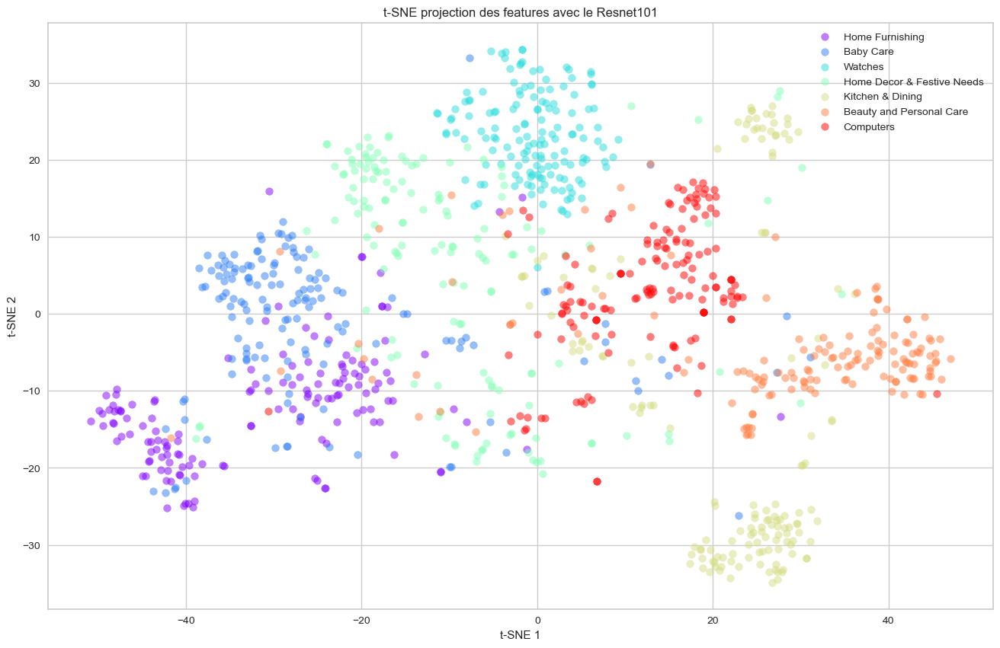

In [30]:
# Lire le DataFrame avec les features extraites
df_101_tsne = pd.read_csv('df_pict_with_features.csv')
df_101_tsne.head(5)

# Vérifier le nombre de features disponibles dans le DataFrame
features_columns = [col for col in df_101_tsne.columns if col.startswith('feature_')]
num_features = len(features_columns)
print(f'Number of feature columns: {num_features}')

# Appliquer t-SNE pour réduire les dimensions à 2D
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(df_101_tsne[features_columns])

# Ajouter les résultats t-SNE au DataFrame
df_101_tsne['tsne_2d_one'] = tsne_results[:, 0]
df_101_tsne['tsne_2d_two'] = tsne_results[:, 1]

# Visualisation des résultats t-SNE avec Matplotlib
plt.figure(figsize=(16, 10))
categories = df_101_tsne['Level_1'].unique()
colors = plt.cm.rainbow(np.linspace(0, 1, len(categories)))

for category, color in zip(categories, colors):
    subset = df_101_tsne[df_101_tsne['Level_1'] == category]
    plt.scatter(subset['tsne_2d_one'], subset['tsne_2d_two'], c=[color], label=category, alpha=0.5)

plt.title('t-SNE projection des features avec le Resnet101')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(loc='best')
plt.show()


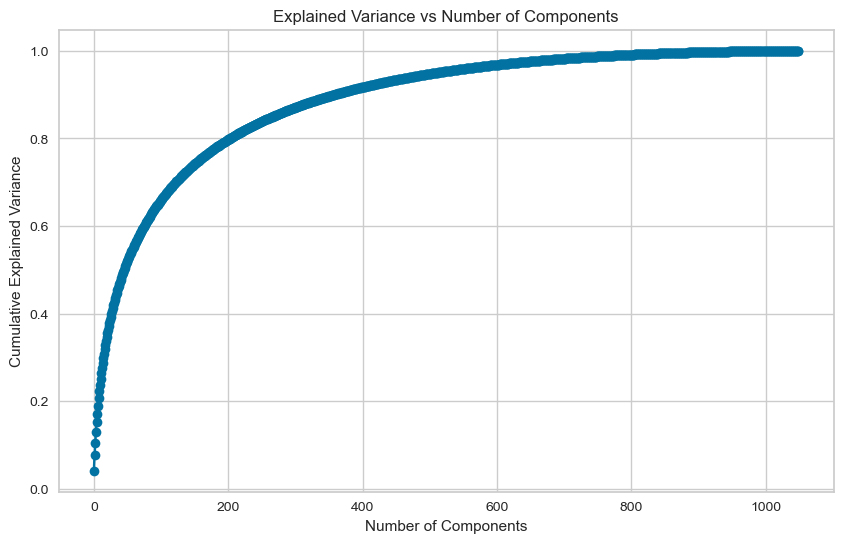

Entrez le seuil de variance à conserver (entre 0 et 1) :  0.98


Nombre de composantes retenues: 685


,product_name,image,Level_1,PC1,PC2,PC3,PC4,PC5,PC6,PC7,...,PC676,PC677,PC678,PC679,PC680,PC681,PC682,PC683,PC684,PC685
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,4.021329,-13.891022,-3.813687,7.778519,-3.477680,-8.864403,2.269255,...,-0.913476,0.115110,0.059717,-0.327428,0.333190,-0.148465,-0.748034,0.118688,0.585287,-0.188164
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,-1.056725,-10.635972,-9.088902,-3.082617,-3.237289,-8.259501,-7.371607,...,0.690301,-1.364488,1.489574,-0.485609,0.205994,0.365540,0.995589,-0.302941,0.561466,0.317759
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,2.788376,-14.059979,-8.953447,-7.961301,-6.171661,-0.071301,-2.698048,...,0.594087,-0.387981,0.095778,0.707052,-0.307764,-0.719350,-0.047394,0.262902,-0.317872,-1.051133


In [32]:
# Séparer les colonnes string
string_columns = df_pict[['product_name','image','Level_1']]

# Suppression des colonnes 'product_name' et 'level_1' pour la PCA
df_cleaned = df_pict.drop(columns=['product_name','image','Level_1'])

# Standardisation des données
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_cleaned)

# Application de la PCA pour déterminer le nombre de composantes
pca = PCA().fit(df_scaled)

# Calcul de la variance cumulée
cumulative_variance = pca.explained_variance_ratio_.cumsum()

# Affichage de la variance cumulée pour choisir le seuil
plt.figure(figsize=(10, 6))
plt.plot(cumulative_variance, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance vs Number of Components')
plt.grid(True)
plt.show()

# Demander à l'utilisateur de choisir le seuil de variance
variance_threshold = float(input("Entrez le seuil de variance à conserver (entre 0 et 1) : "))

# Déterminer le nombre de composantes nécessaires pour atteindre le seuil de variance
num_components = next(i for i, total_variance in enumerate(cumulative_variance) if total_variance >= variance_threshold) + 1

# Application de la PCA avec le nombre de composantes sélectionné
pca = PCA(n_components=num_components)
df_pca = pca.fit_transform(df_scaled)

# Création d'un DataFrame pour les résultats de la PCA
df_pca_result = pd.DataFrame(df_pca, columns=[f'PC{i+1}' for i in range(df_pca.shape[1])])

# Ajout des colonnes string au DataFrame final
df_101_pca = pd.concat([string_columns, df_pca_result], axis=1)

# Affichage du nombre de composantes retenues
print(f"Nombre de composantes retenues: {num_components}")
df_101_pca.head(3)


In [34]:
# Définition des hyperparamètres pour K-means
n_clusters = 7  
init = 'k-means++' 
n_init = 25  
max_iter = 300  
random_state = 42

# Application de K-means avec les hyperparamètres définis
kmeans = KMeans(n_clusters=n_clusters, init=init, n_init=n_init, max_iter=max_iter, random_state=random_state)
kmeans.fit(df_pca)

# Ajout des labels K-means au DataFrame final
df_101_pca['kmeans_label'] = kmeans.labels_

Nombre de composantes retenues: 685


In [36]:
# Évaluation des performances du K-means
df_101_pca['Level_1'] = df_101_pca['Level_1'].astype('category')

# Liste pour stocker les évaluations
evaluations = []
evaluations_std = []

def fit_and_evaluate(km, X, labels, name=None, n_runs=5):
    name = km.__class__.__name__ if name is None else name

    train_times = []
    scores = defaultdict(list)
    for seed in range(n_runs):
        km.set_params(random_state=seed)
        t0 = time()
        km.fit(X)
        train_times.append(time() - t0)
        scores["Homogeneity"].append(metrics.homogeneity_score(labels, km.labels_))
        scores["Completeness"].append(metrics.completeness_score(labels, km.labels_))
        scores["V-measure"].append(metrics.v_measure_score(labels, km.labels_))
        scores["Adjusted Rand-Index"].append(
            metrics.adjusted_rand_score(labels, km.labels_)
        )
        scores["Silhouette Coefficient"].append(
            metrics.silhouette_score(X, km.labels_, sample_size=2000)
        )
    train_times = np.asarray(train_times)

    print(f"Clustering done in {train_times.mean():.2f} ± {train_times.std():.2f} s ")
    evaluation = {
        "estimator": name,
        "train_time": train_times.mean(),
    }
    evaluation_std = {
        "estimator": name,
        "train_time": train_times.std(),
    }
    for score_name, score_values in scores.items():
        mean_score, std_score = np.mean(score_values), np.std(score_values)
        print(f"{score_name}: {mean_score:.3f} ± {std_score:.3f}")
        evaluation[score_name] = mean_score
        evaluation_std[score_name] = std_score
    evaluations.append(evaluation)
    evaluations_std.append(evaluation_std)

# Application de la fonction d'évaluation
fit_and_evaluate(kmeans, df_pca, df_101_pca['Level_1'].cat.codes)

Clustering done in 1.00 ± 0.02 s 
Homogeneity: 0.577 ± 0.022
Completeness: 0.597 ± 0.021
V-measure: 0.587 ± 0.021
Adjusted Rand-Index: 0.511 ± 0.031
Silhouette Coefficient: 0.021 ± 0.006


### 2. Le VGG (ARI = 0.343)

In [39]:
df_vgg = df[['product_name',
            'image',
            'Level_1']].copy()
df_vgg.head(3)

,product_name,image,Level_1
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care


In [40]:
# Chemin vers le répertoire contenant les images
directory_path = r'C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images'

# Hyperparamètres
learning_rate = 0.001
batch_size = 64
epochs = 30

# Charger le modèle VGG16 pré-entraîné
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Ajouter une couche de Global Average Pooling pour l'extraction des features
x = base_model.output
x = GlobalAveragePooling2D()(x)

# Créer le modèle pour l'extraction des features
model = Model(inputs=base_model.input, outputs=x)

# Configuration de l'augmentation des données
datagen = ImageDataGenerator(
    rescale=1.0/255.0,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Fonction pour pré-traiter et extraire les features d'une image
def extract_features(img_path, model):
    try:
        img = image.load_img(img_path, target_size=(224, 224))
        img = image.img_to_array(img)
        img = np.expand_dims(img, axis=0)
        img = preprocess_input(img)  # Pré-traitement spécifique pour VGG
        features = model.predict(img)
        print(f"Features shape for {img_path}: {features.shape}") 
        return features.flatten()
    except Exception as e:
        print(f"Erreur lors du traitement de l'image {img_path}: {str(e)}")
        return None

# Initialiser une liste pour stocker les features et les noms des images
all_features = []
image_names = []

# Vérifiez si 'image' est dans les colonnes
if 'image' not in df_vgg.columns:
    raise ValueError("Le DataFrame df_vgg ne contient pas de colonne 'image'. Veuillez vérifier le DataFrame d'entrée.")

# Extraction des features avec une barre de progression
progress_bar = tqdm(total=len(df_vgg), desc='Extraction des features')
for img_name in df_vgg['image']:
    img_path = os.path.join(directory_path, img_name)
    if os.path.isfile(img_path):
        features = extract_features(img_path, model)
        if features is not None:
            all_features.append(features)
            image_names.append(img_name)
    progress_bar.update(1)
progress_bar.close()

# Vérifier que all_features n'est pas vide avant de créer le DataFrame
if all_features:
    feature_dimension = len(all_features[0])
    features_df = pd.DataFrame(all_features, columns=[f'feature_{i}' for i in range(feature_dimension)])
    features_df['image'] = image_names

    # Fusionner les features avec le DataFrame d'origine
    df_vgg = pd.merge(df_vgg, features_df, on='image', how='left')

    # Afficher les premières lignes du DataFrame pour vérifier
    #print(df_vgg.head())

    # Enregistrer le DataFrame avec les features dans un fichier CSV
    df_vgg.to_csv('df_vgg_with_features.csv', index=False)
else:
    print("Aucune feature extraite. Vérifiez le processus d'extraction.")


Extraction des features:   0%|          | 0/1050 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:   0%|          | 1/1050 [00:00<08:09,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55b85ea15a1536d46b7190ad6fff8ce7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:   0%|          | 2/1050 [00:00<05:18,  3.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b72c92c2f6c40268628ec5f14c6d590.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:   0%|          | 3/1050 [00:00<04:15,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64d5d4a258243731dc7bbb1eef49ad74.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   0%|          | 4/1050 [00:00<03:39,  4.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d4684dcdc759dd9cdf41504698d737d8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:   0%|          | 5/1050 [00:01<03:45,  4.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6325b6870c54cd47be6ebfbffa620ec7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:   1%|          | 6/1050 [00:01<03:30,  4.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\893aa5ed55f7cff2eccea7758d7a86bd.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:   1%|          | 7/1050 [00:01<03:26,  5.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f355cc1ccb08bd0d283ed979b7ee7515.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:   1%|          | 8/1050 [00:01<03:12,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd0e3470a7e6ed76fd69c2da27721041.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:   1%|          | 9/1050 [00:01<03:07,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41384da51732c0b4df3de8f395714fbb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   1%|          | 10/1050 [00:02<02:59,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\710ed5f2393a4b9e8823aa0029f71f93.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


Extraction des features:   1%|          | 11/1050 [00:02<03:19,  5.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\920154acbe49d3202ed7d2ed2df1ea13.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:   1%|          | 12/1050 [00:02<03:26,  5.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08452abdadb3db1e686b94a9c52fc7b6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   1%|          | 13/1050 [00:02<03:10,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1e8741b5ae27a513546c94b3f3312aee.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:   1%|▏         | 14/1050 [00:02<03:12,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\189fa66a5fa6f08d2802a62ecf0be298.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   1%|▏         | 15/1050 [00:03<03:03,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bbb8cdc5406ff60ff06ff64630f2ca47.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:   2%|▏         | 16/1050 [00:03<02:59,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1120bc768623572513df956172ffefeb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   2%|▏         | 17/1050 [00:03<02:55,  5.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5479bb7028827d60000720a2c135976a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:   2%|▏         | 18/1050 [00:03<03:00,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\733aa1e801a139fa8dc7be9f0eff5ee0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   2%|▏         | 19/1050 [00:03<02:58,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62c35de4df27437d3597963fac55a8b6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   2%|▏         | 20/1050 [00:03<03:01,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\33d97d63c037078cd3f08033966d6a88.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   2%|▏         | 21/1050 [00:04<02:58,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d7ca2b06b4f4d3b98c61c377b18a2d6b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   2%|▏         | 22/1050 [00:04<03:02,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f74476ba64365d97a5be7d375cbf4c7a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   2%|▏         | 23/1050 [00:04<02:57,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda50982a672ef8835de5c1cc86f8bfc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   2%|▏         | 24/1050 [00:04<03:01,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4788f5466992da09024b8ffcc8a5cba4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:   2%|▏         | 25/1050 [00:04<03:02,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\653826cd53f1d9e2c086c0ac7846ef70.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   2%|▏         | 26/1050 [00:04<02:57,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c74db45cbfc14a78b8466dca494b3bb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   3%|▎         | 27/1050 [00:05<02:49,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4aa047f14885c74f155ce5f973e14dff.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   3%|▎         | 28/1050 [00:05<02:50,  6.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c4fec2331da8d40f2cb146eb198cb57.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   3%|▎         | 29/1050 [00:05<02:47,  6.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b52073e7ed9c00c4108cae4eb0c49c1a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:   3%|▎         | 30/1050 [00:05<02:50,  5.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee8d9ff65e0fe4278afce7c933d30941.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   3%|▎         | 31/1050 [00:05<02:45,  6.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\788dc3a3da91c0f46a7c465e07f91dd4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:   3%|▎         | 32/1050 [00:05<02:56,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29b1ca231e10d5269516b80bf9d0dffc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   3%|▎         | 33/1050 [00:06<02:51,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8b268c1e68f198ae2e934717d49f48e9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   3%|▎         | 34/1050 [00:06<02:51,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b85f8843bb1c297dd5712f0bd287006d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:   3%|▎         | 35/1050 [00:06<02:58,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4b09aa7927c59fbb39960b3d7919909.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   3%|▎         | 36/1050 [00:06<02:57,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\81e739c7f3be737152f2e6f520e3494b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


Extraction des features:   4%|▎         | 37/1050 [00:06<02:53,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0938b0d88eac91deee6d5add54097d3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:   4%|▎         | 38/1050 [00:06<02:55,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e9420e9483f16db81c64dddf99f34841.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   4%|▎         | 39/1050 [00:07<02:51,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a3dea07b2f7bf48276d32513091be717.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:   4%|▍         | 40/1050 [00:07<03:01,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66191b4a311b5d9babfc00a71ef97c5b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:   4%|▍         | 41/1050 [00:07<02:57,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90e56526f4c5892beac49f262b85150a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   4%|▍         | 42/1050 [00:07<02:52,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a79117ea49a0533f641facdb4c99f502.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


Extraction des features:   4%|▍         | 43/1050 [00:07<02:58,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5325213d84c80ad310b6e4b37a1ac824.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   4%|▍         | 44/1050 [00:07<02:53,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2d50e4c6ccf8befe9335ac8f97a11712.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   4%|▍         | 45/1050 [00:08<02:47,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8050d31bffe6827c804b8222338aafb2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   4%|▍         | 46/1050 [00:08<02:44,  6.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\493d1eb6ad7a48a926092bf994cd0bb0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:   4%|▍         | 47/1050 [00:08<02:49,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3388d05e88972ff9f3e1321dc0cfdc28.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   5%|▍         | 48/1050 [00:08<02:44,  6.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d1899ab1d5c79ddaa311bc9f04d198ed.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:   5%|▍         | 49/1050 [00:08<02:52,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e7cab08a267e815c72a26513222783e0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   5%|▍         | 50/1050 [00:08<02:44,  6.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02a53d335775b652f22f41b529b9d646.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   5%|▍         | 51/1050 [00:09<02:48,  5.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\69446af66066146718cd569f87e99fff.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   5%|▍         | 52/1050 [00:09<02:44,  6.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4d35b6536b623c83b293eb3a1c02bba.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:   5%|▌         | 53/1050 [00:09<02:49,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f01140c02fd09e5c56312a64fa8db3da.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   5%|▌         | 54/1050 [00:09<02:44,  6.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6329ddb46087cb8c09ced95471dd9643.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:   5%|▌         | 55/1050 [00:09<02:49,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e6ae1b372e8e0b509b83ba3658b8107.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:   5%|▌         | 56/1050 [00:10<02:58,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e2ae2af58ac50adf4881751ae84a9d8a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   5%|▌         | 57/1050 [00:10<02:56,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\24e85c590481a7cedfe66597f253f2b2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   6%|▌         | 58/1050 [00:10<02:56,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5e84d36ad6db970548498829db8b15de.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   6%|▌         | 59/1050 [00:10<02:48,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c4604dba348a99a2dfbbc2cd3928101.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Extraction des features:   6%|▌         | 60/1050 [00:10<02:58,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0abfcbe0e17dd50c4cf5fb1d6037d514.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   6%|▌         | 61/1050 [00:10<02:52,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4a1b23dacd7d2a9ec7414f7159f25a48.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   6%|▌         | 62/1050 [00:11<02:53,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95330f6f0f44d17b918feec36bedcdef.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   6%|▌         | 63/1050 [00:11<02:53,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66a5a21ea332aefcc7b90dbad94053aa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:   6%|▌         | 64/1050 [00:11<02:51,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f4e7f269319ba9cf5507a9e2febacbf5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   6%|▌         | 65/1050 [00:11<02:50,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\80e9cb3d2d7f9ff7bc497c34df366d03.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Extraction des features:   6%|▋         | 66/1050 [00:11<02:57,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2baa415ebcc4fe563ce13b50e60efc1c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   6%|▋         | 67/1050 [00:11<02:52,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\903d63e2b71d692ccd628e1de516516e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   6%|▋         | 68/1050 [00:12<02:51,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\707b160df4c4dece6cde52b222ce624b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   7%|▋         | 69/1050 [00:12<02:55,  5.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed9817e8960a6a0d509061c54cfe5ac1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   7%|▋         | 70/1050 [00:12<03:05,  5.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a7a1287fef0d986a5e237797beee286.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   7%|▋         | 71/1050 [00:12<02:55,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ba898ecb77ab5a6799c8b047c6b6008.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   7%|▋         | 72/1050 [00:12<02:51,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2658bad8c2b7d5b08984c6ac34267f7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:   7%|▋         | 73/1050 [00:13<02:47,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\afc3ebd18df498dd87abb7ad7536b5c7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:   7%|▋         | 74/1050 [00:13<02:45,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\141d2b743c477043041faddf9233c8ad.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   7%|▋         | 75/1050 [00:13<02:49,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7a3f11f380a1bf85338ab3771ff81e9f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   7%|▋         | 76/1050 [00:13<02:53,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae45b64d808a883aa35f2bf4de879cac.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   7%|▋         | 77/1050 [00:13<02:48,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1971dcd2f3058a4c87bdd7d87d4baeba.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   7%|▋         | 78/1050 [00:13<02:43,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4942e0a9c0527dc00319a39fc8f103e6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:   8%|▊         | 79/1050 [00:14<03:16,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0a8a1e9c6659361c0c2b247f8a6471d0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:   8%|▊         | 80/1050 [00:14<03:06,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\320833ab08c9a94ef83520612899a85f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   8%|▊         | 81/1050 [00:14<03:00,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\57578c1e6ec61a880a6f3f971f5f77b8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   8%|▊         | 82/1050 [00:14<03:10,  5.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e130ed339dcfe20d2c8b66892278a94.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   8%|▊         | 83/1050 [00:14<03:00,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\601817defaff9d0e30e1b72f96d3975f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:   8%|▊         | 84/1050 [00:15<03:02,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3cdfd9df09f61a8fd178bafcc8dbed31.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   8%|▊         | 85/1050 [00:15<02:52,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\374e63028d691c380bc43b0dc60e460d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   8%|▊         | 86/1050 [00:15<02:50,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\61c0139f3d5c97f1615797dbf046cc0c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   8%|▊         | 87/1050 [00:15<02:45,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0096e89cc25a8b96fb9808716406fe94.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   8%|▊         | 88/1050 [00:15<02:47,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e8ee7868b0c3d1d04b482cd4f3ec5ccc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   8%|▊         | 89/1050 [00:15<02:44,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\04f9ff160a1561e3656350f4bd6b8c50.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   9%|▊         | 90/1050 [00:16<02:40,  5.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aebf3a2172b33ef09acb472009967812.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:   9%|▊         | 91/1050 [00:16<02:40,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ae332e2bafd23267caedfcc4453257c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   9%|▉         | 92/1050 [00:16<02:45,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\57800d48b001f3fad34a4f8fa9207f29.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   9%|▉         | 93/1050 [00:16<02:48,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d1e18b4a3aafb0040da2111c8b8ce2e5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:   9%|▉         | 94/1050 [00:16<02:54,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46e6853da6b0c796b7a0d8203ceaa88e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:   9%|▉         | 95/1050 [00:16<02:56,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22296bfc1c79d9dc88eabbd01220ef0c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   9%|▉         | 96/1050 [00:17<02:56,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f4d4c2eec77732f56e47722d7a355f2b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   9%|▉         | 97/1050 [00:17<02:49,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f12a06b7dbfc55638afafcf8bb03d836.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:   9%|▉         | 98/1050 [00:17<02:48,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\18bd9b88e23b82fd19f8ab0c9cad6a1a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   9%|▉         | 99/1050 [00:17<02:41,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5749bae8ccead7997ebf370b6b081d07.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  10%|▉         | 100/1050 [00:17<02:47,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\059493eeb88ebb4cc08d1522f3f87c3f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  10%|▉         | 101/1050 [00:18<02:40,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9613f2f1e65fb1fc7e181e7f83c217da.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  10%|▉         | 102/1050 [00:18<02:40,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7fcd0d983a51283e58b806f065cc920.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  10%|▉         | 103/1050 [00:18<02:44,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b78586222de9a1095d0a9d88455ee75f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  10%|▉         | 104/1050 [00:18<02:53,  5.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dfbd96036cbc28566e964cff04b5b3a8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  10%|█         | 105/1050 [00:18<02:48,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\336fc49639a5cc45aa532ace3ee1a044.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  10%|█         | 106/1050 [00:19<03:19,  4.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\789cf5578f48577a44586fca3adc35d0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  10%|█         | 107/1050 [00:19<03:04,  5.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\184ecf07ca4e2872eaf53d2344a1e783.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  10%|█         | 108/1050 [00:19<02:59,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b515014adccb1fdf5ff1e2c4a8ff9ea6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  10%|█         | 109/1050 [00:19<03:05,  5.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5aacf8f5154afea2ac22fc767d072677.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  10%|█         | 110/1050 [00:19<02:55,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cbbe686c4a233e8cf53528748f75223.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  11%|█         | 111/1050 [00:19<02:50,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f1ee63a5f0db853e2c1b377778580d39.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  11%|█         | 112/1050 [00:20<02:56,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0bb0f7b7a3075f4b9459121abe2185fa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  11%|█         | 113/1050 [00:20<02:49,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8015db34d09642b046c775e8157dd729.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  11%|█         | 114/1050 [00:20<02:39,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ddc40c08d9a9bafc4d14eddd98db7c0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc784846bd59a16832454416ac708003.jpg: (1, 512)


Extraction des features:  11%|█         | 115/1050 [00:20<02:41,  5.79it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  11%|█         | 116/1050 [00:20<03:00,  5.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e8f5dc78f80eff3c77a9714303f59d2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  11%|█         | 117/1050 [00:21<03:00,  5.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53f4bc7d7321f5c41de6b86e41f13e80.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  11%|█         | 118/1050 [00:21<02:48,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be09f5a3a88ac10ae14c791fc8ac0dae.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  11%|█▏        | 119/1050 [00:21<02:55,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d202ea988ab11f2327279093ac71975d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  11%|█▏        | 120/1050 [00:21<02:46,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\db6c79a1d852944a89e157793f392d67.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  12%|█▏        | 121/1050 [00:21<02:43,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\16c18ce0affca13159e362227c83683c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  12%|█▏        | 122/1050 [00:21<02:48,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7dd5e83e2108a97659577e50879f9d9f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  12%|█▏        | 123/1050 [00:22<02:42,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a63eecfbb02004863fa1f29a0b8105fc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  12%|█▏        | 124/1050 [00:22<03:03,  5.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c77aa1fc09901ae07c392c152a70e41.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  12%|█▏        | 125/1050 [00:22<03:10,  4.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\640fd08bb3ba538d67a5c0c2c61a5c4c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  12%|█▏        | 126/1050 [00:22<03:02,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7241df1acae1fac892c692097ea3fb98.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  12%|█▏        | 127/1050 [00:22<03:01,  5.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a85a7dbd31267a7b02eda3a4d484632d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  12%|█▏        | 128/1050 [00:23<02:50,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\13de17e59a92f8bcaec8bf103bbff8c1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  12%|█▏        | 129/1050 [00:23<02:40,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ba13df7877fd979d64c87c7586a5ca6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  12%|█▏        | 130/1050 [00:23<02:41,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f1484a63c0dc79e96c98b2a250380ed8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  12%|█▏        | 131/1050 [00:23<02:46,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f01ff0a82401117e9da22dd680fd2f36.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  13%|█▎        | 132/1050 [00:23<02:44,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de911421573d3e234450040374b55b38.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  13%|█▎        | 133/1050 [00:23<02:38,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\614dbfa2f42c4684c0bb6152091113a6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  13%|█▎        | 134/1050 [00:24<02:38,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5531b9f454e2d75cfe00c3f795e06de5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  13%|█▎        | 135/1050 [00:24<02:34,  5.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\258444ac7bb7ad8026800efad5c3502b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  13%|█▎        | 136/1050 [00:24<02:38,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd369a1bb58ae02cd925dda7e9e1d00a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  13%|█▎        | 137/1050 [00:24<02:33,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73f460cd6f3fd206902d7097a1816405.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  13%|█▎        | 138/1050 [00:24<02:34,  5.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0d3e1dc0d38be59e9927e47f152e48aa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  13%|█▎        | 139/1050 [00:24<02:31,  6.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\118b411bf265538461b084ce7abd55a8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  13%|█▎        | 140/1050 [00:25<02:36,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06749cbff1487f470438823f6952cfd1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  13%|█▎        | 141/1050 [00:25<02:32,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\202fc276e672eb8c29891aa50aef0771.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  14%|█▎        | 142/1050 [00:25<02:34,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\feefbdff924dd6b7cc266449c9a36d69.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  14%|█▎        | 143/1050 [00:25<02:30,  6.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\af1ac46194b5488048c459102a16a57e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  14%|█▎        | 144/1050 [00:25<02:27,  6.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1fd886094826c3f25c6ffb380073974.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  14%|█▍        | 145/1050 [00:25<02:30,  6.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3847353a4b8de1efc504d589aea74ffe.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  14%|█▍        | 146/1050 [00:26<02:28,  6.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60efd61370e70267dc60b11ff2bf974c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  14%|█▍        | 147/1050 [00:26<02:30,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63bc43c0000e71eb11bfafd2f46214a4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  14%|█▍        | 148/1050 [00:26<02:27,  6.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8794f7a06b530782c66f7c0911bb437.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  14%|█▍        | 149/1050 [00:26<02:30,  6.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8507eb0ef32c1c0db700f20aad6d9bcd.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  14%|█▍        | 150/1050 [00:26<02:31,  5.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc7abdf67b4d7dbf64dffbab7b37599c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  14%|█▍        | 151/1050 [00:26<02:27,  6.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1afa5f2c3c9b4b43def6dc2e695d2c87.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  14%|█▍        | 152/1050 [00:27<02:31,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73503fe89ea77420a598f4a1019e5b6d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  15%|█▍        | 153/1050 [00:27<02:28,  6.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ec590694e8bf85f75c9200cf418127aa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  15%|█▍        | 154/1050 [00:27<02:28,  6.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7956d9586de3e25ff586bca58be7195e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  15%|█▍        | 155/1050 [00:27<02:26,  6.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63f6ef8f3fda2c306b27cfbf5a005f1e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  15%|█▍        | 156/1050 [00:27<02:27,  6.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\328b66226952d8733c0c48295fae1108.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  15%|█▍        | 157/1050 [00:27<02:34,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6efd5d260667b94f04edbbd18bb300b9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  15%|█▌        | 158/1050 [00:28<02:31,  5.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\beaa6285a2b9c66db0e294767711ca3f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  15%|█▌        | 159/1050 [00:28<02:27,  6.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41fd5af61752be98b19b611a6ff9a0ef.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  15%|█▌        | 160/1050 [00:28<02:25,  6.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\219b24362655097cb41bf06a0be8ee79.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  15%|█▌        | 161/1050 [00:28<02:29,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5d1b8ef70b1ce27726f7f6c2f373e56.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  15%|█▌        | 162/1050 [00:28<02:31,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\69515ea06da8b2b1c881ce34fbf6575a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  16%|█▌        | 163/1050 [00:28<02:26,  6.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02127f52e96fb72c66bf081d25104ef8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  16%|█▌        | 164/1050 [00:29<02:31,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c4581cae6bf751a7ae5c40bb16b74e98.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  16%|█▌        | 165/1050 [00:29<02:28,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8f42da0f9f695f07067676eae4135c8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  16%|█▌        | 166/1050 [00:29<02:32,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\785b4383b12106dd172306d427d8f7b2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  16%|█▌        | 167/1050 [00:29<02:35,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d19d17140fdd9adc09ba6e2ad1e1ebb9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  16%|█▌        | 168/1050 [00:29<02:32,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aadbc3b9c32c4535b1bfee7321c4c0e7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  16%|█▌        | 169/1050 [00:29<02:33,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea16e13a7cf16d8665d1bc44738dfa88.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  16%|█▌        | 170/1050 [00:30<02:33,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a341f915962ee99754e962520f279708.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  16%|█▋        | 171/1050 [00:30<02:29,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9077acd25761ea067ac6d9369d8fdf16.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  16%|█▋        | 172/1050 [00:30<02:26,  5.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cab75cad4b3a3c593c753a1759df28e2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  16%|█▋        | 173/1050 [00:30<02:29,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5590e238d44b370337624f5987fb9b8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  17%|█▋        | 174/1050 [00:30<02:31,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b043b37c38f081d96886acb5acfbdf5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  17%|█▋        | 175/1050 [00:31<02:32,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b92e13d5ef945d086fd4f42b95bc04ac.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  17%|█▋        | 176/1050 [00:31<02:37,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22ea3b69860bc9a5e0c69b87db2dcdab.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  17%|█▋        | 177/1050 [00:31<02:34,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\154920adb9d584b55d419227f9b01cc6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  17%|█▋        | 178/1050 [00:31<02:31,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5dbf978ab2cf9d2da6446d3e4595f690.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  17%|█▋        | 179/1050 [00:31<02:27,  5.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7ef3e6ec248f17f3a6a4697120ddb96.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


Extraction des features:  17%|█▋        | 180/1050 [00:31<02:33,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aab46b84f70cc6774afaafe1d6035de3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  17%|█▋        | 181/1050 [00:32<02:32,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\58d7fbbe6d306ecf16e0a7ac05b211d4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  17%|█▋        | 182/1050 [00:32<02:36,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59af3731b809a25f2bf99e99f645d8dd.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


Extraction des features:  17%|█▋        | 183/1050 [00:32<02:48,  5.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c4ca34c50a5437a1bcc42b72fc1351f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  18%|█▊        | 184/1050 [00:32<02:45,  5.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3830dda3491cd5b28ed42ae544bc44f0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  18%|█▊        | 185/1050 [00:32<02:37,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f712e172ee77a913b6d627657986b72.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  18%|█▊        | 186/1050 [00:32<02:30,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6da53319cc12c9729881f5478ff67223.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  18%|█▊        | 187/1050 [00:33<02:30,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8bf65b132179faf26f61e26274b2b819.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  18%|█▊        | 188/1050 [00:33<02:31,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f69bef5db54cb4c83b2aa8d0ce829d4e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  18%|█▊        | 189/1050 [00:33<02:26,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ffbf3794aa8cb6bb8d3f313d0a549a09.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  18%|█▊        | 190/1050 [00:33<02:33,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\acd2f21d63ac0bbed4d52e6010d9460b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  18%|█▊        | 191/1050 [00:33<02:27,  5.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b46d7b8e6826ad4c8b40a991da0f54d7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  18%|█▊        | 192/1050 [00:34<02:27,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce2f67c3365846170cb709784d87e45b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  18%|█▊        | 193/1050 [00:34<02:23,  5.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4ccd4c315d99edd7c00d015b714485a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  18%|█▊        | 194/1050 [00:34<02:24,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\302c95f6eae5f4ce217fcedc4ef91262.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  19%|█▊        | 195/1050 [00:34<02:26,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f756aa2ceb1efda609c428a47308758.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  19%|█▊        | 196/1050 [00:34<02:25,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e3586dc60df258c5478446d65a317d2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  19%|█▉        | 197/1050 [00:34<02:32,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40829ac110f344ef35f1c8c32fb311c7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  19%|█▉        | 198/1050 [00:35<02:29,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3c741a05c82c54343b94ed8c1292e2a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  19%|█▉        | 199/1050 [00:35<02:34,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d75705ad163412347cba51f882e9c0f0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  19%|█▉        | 200/1050 [00:35<02:34,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90f86ac4065397340e8012261577c220.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  19%|█▉        | 201/1050 [00:35<02:26,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\168618e93387ad7171d4e4e1eeff9d1a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  19%|█▉        | 202/1050 [00:35<02:21,  5.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c4ab8ab059c912090c83cb0818e7f1c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  19%|█▉        | 203/1050 [00:36<03:00,  4.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70578f48cc96bbb60d040e08025e521d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  19%|█▉        | 204/1050 [00:36<02:53,  4.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5b378b0925d5409b5d84ceb416fc2afc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  20%|█▉        | 205/1050 [00:36<02:51,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6775e3b91baa4d368f6d91eb7c24578b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  20%|█▉        | 206/1050 [00:36<02:38,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c109187e7975ee8fdb2b3dfbdd9dce20.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  20%|█▉        | 207/1050 [00:36<02:35,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8962b50b699ddf4712ad18d29c6a3862.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  20%|█▉        | 208/1050 [00:36<02:27,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4d9e71172f619f8e3122e34bb0bf3cc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  20%|█▉        | 209/1050 [00:37<02:27,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55ce1309b69e1912d2fd60a3ee3f351b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  20%|██        | 210/1050 [00:37<02:21,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a9b35b94610a3d7f4fa91f19693c5248.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  20%|██        | 211/1050 [00:37<02:24,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3113367c72125a3355af42426fe14f17.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  20%|██        | 212/1050 [00:37<02:26,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e99d9abb115a9bd580bcccf9ff4d4881.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  20%|██        | 213/1050 [00:37<02:32,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de29bf3288345e23b0e25345a3a057fb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  20%|██        | 214/1050 [00:38<02:32,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3e7c584f317d1b5d6ac0088c411565e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  20%|██        | 215/1050 [00:38<02:29,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d279c825ba12804c337f883b366a6e2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  21%|██        | 216/1050 [00:38<02:26,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91a5328e7235424885d271dfa0959eeb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  21%|██        | 217/1050 [00:38<02:26,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2110699b945ae766c8b8112038ac58b9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  21%|██        | 218/1050 [00:38<02:26,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\198dbe7be6f84f6448197148d7b5e5a5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  21%|██        | 219/1050 [00:39<03:02,  4.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce02ab514e4c623dcf7acd7182a7762d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  21%|██        | 220/1050 [00:39<02:49,  4.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2ede595489db33a036d135ce22645515.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  21%|██        | 221/1050 [00:39<02:40,  5.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32cf0691248297655e2c1728b12e2262.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  21%|██        | 222/1050 [00:39<02:34,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\81a695f80d3f5c445910d310f1a83eb8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  21%|██        | 223/1050 [00:39<02:27,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\922a04084481d4b3275a3f7bb54e90f3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  21%|██▏       | 224/1050 [00:39<02:36,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2751cf0dd59d223cacbc5da5df42a1a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  21%|██▏       | 225/1050 [00:40<02:29,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc2e2bb105a5c2b2e43842886d057b81.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  22%|██▏       | 226/1050 [00:40<02:27,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\67d6b4a8aa19d57740b0440365b77624.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  22%|██▏       | 227/1050 [00:40<02:28,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f39a2cce8929f5b44087d688995994e4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  22%|██▏       | 228/1050 [00:40<02:22,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4451f1b01168b6a085738d0b0f2f02aa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  22%|██▏       | 229/1050 [00:40<02:27,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f76aaed44b540869da862c5dd4b266f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  22%|██▏       | 230/1050 [00:40<02:21,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\caabe6014b914fe2874a9a8d7284f79b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  22%|██▏       | 231/1050 [00:41<02:20,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\968a2b3be84193e3f755c2fe71033a2c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  22%|██▏       | 232/1050 [00:41<02:16,  5.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8c1b5fb422d8418dc9e40a43fece55a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  22%|██▏       | 233/1050 [00:41<02:13,  6.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4642d967bc34a36454b281de632f6c11.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  22%|██▏       | 234/1050 [00:41<02:16,  5.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\34d3b2b8d263294107a3ffc69b35ff8f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  22%|██▏       | 235/1050 [00:41<02:12,  6.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed139e0d1b5c973495e1aa35dd4a5533.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  22%|██▏       | 236/1050 [00:41<02:11,  6.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1e133cbe616bee3b3e9e6f4f0882e3d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  23%|██▎       | 237/1050 [00:42<02:13,  6.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf2ba696547459733c6bbfad4e3bcf62.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  23%|██▎       | 238/1050 [00:42<02:12,  6.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be0e65c6d8c2cc8cb913b36aa4168cf0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  23%|██▎       | 239/1050 [00:42<02:47,  4.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e8df36b35d22cf219cf8bae6c2af752.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  23%|██▎       | 240/1050 [00:42<02:36,  5.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8f41774c16a931d71fcf01f8fee171e0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  23%|██▎       | 241/1050 [00:42<02:28,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e4c1d31e279a700c6b8e66d820e8601.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  23%|██▎       | 242/1050 [00:43<02:28,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1357e9d24661c3b5797aa1016e0c3be1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  23%|██▎       | 243/1050 [00:43<02:20,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\799ddb97164ff2d5d53bb8b27b8c355f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  23%|██▎       | 244/1050 [00:43<02:19,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\607dc41467008ee7a8dba0276f180f63.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  23%|██▎       | 245/1050 [00:43<02:23,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0c4718ae90f2889b7021a99ee1cc106c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  23%|██▎       | 246/1050 [00:43<02:16,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\85fe188e1ee8237b70df0d475907bf24.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  24%|██▎       | 247/1050 [00:43<02:14,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea42376c9c52752d9d01bba12eb2999b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  24%|██▎       | 248/1050 [00:44<02:08,  6.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87f1807e002d3555b8dfb465a8a61df2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  24%|██▎       | 249/1050 [00:44<02:08,  6.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\45d0af2c709de47268c80c35a117de44.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  24%|██▍       | 250/1050 [00:44<02:04,  6.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0131e5d87b72877702d536299cf83b75.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  24%|██▍       | 251/1050 [00:44<02:04,  6.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17611e6e94d73ef376834e5c6ee03dde.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  24%|██▍       | 252/1050 [00:44<02:03,  6.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\72cbc043d14ee578c789c9fab3c43cdd.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  24%|██▍       | 253/1050 [00:44<02:02,  6.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6bc04b3ec1f8d4da2a00f8662f4fbed3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  24%|██▍       | 254/1050 [00:45<02:37,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb733e04ff2d72c59d8513eb574e81a2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  24%|██▍       | 255/1050 [00:45<02:29,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda51c31a1b7ae8f3c7b5c0174d3e201.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  24%|██▍       | 256/1050 [00:45<02:44,  4.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c38eb8abdaa1d8c28bc8c262761dfbc5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  24%|██▍       | 257/1050 [00:45<02:35,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73b692cdfce9a77b721a54d4b7fb35a7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  25%|██▍       | 258/1050 [00:45<02:26,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40d7d3d1961236dd814e15592fa52994.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  25%|██▍       | 259/1050 [00:46<02:24,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9833d0de7f7e1927c807411c10b19189.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  25%|██▍       | 260/1050 [00:46<02:17,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\724e6eb7edc83eb48b6492d12e940ebd.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  25%|██▍       | 261/1050 [00:46<02:20,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\04f9f818e2d657b873b07578cfe2eade.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  25%|██▍       | 262/1050 [00:46<02:22,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\273982a65b9c7dabe56c8345552bfad7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  25%|██▌       | 263/1050 [00:46<02:20,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1b2b3ad430dd738d958292441b6d046.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  25%|██▌       | 264/1050 [00:46<02:15,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a3cdc88ebbba7612e88eac1b82c5f82.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  25%|██▌       | 265/1050 [00:47<02:26,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4951eb41979fe482879f777c8f21d2b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


Extraction des features:  25%|██▌       | 266/1050 [00:47<02:33,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\412d0425bb7076610aace6549ded265c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  25%|██▌       | 267/1050 [00:47<02:26,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0e73201f6d8807776e1d21c969078289.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  26%|██▌       | 268/1050 [00:47<02:19,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86dcb7d4ce6ec7bfb3e26d1bd859f4fb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


Extraction des features:  26%|██▌       | 269/1050 [00:47<02:25,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\093097cfe5626f4ad8914e0a16a940b5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  26%|██▌       | 270/1050 [00:47<02:17,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\908cc351957d02f72f60916006c531ba.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  26%|██▌       | 271/1050 [00:48<02:23,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ee2e665b7de2e1cc29e3c65bde0c318.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  26%|██▌       | 272/1050 [00:48<02:15,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9906d8f74589c452b00f2b5642a63c5f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  26%|██▌       | 273/1050 [00:48<02:15,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0f7a56876c61ba98dfed48ede5d3f3e1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  26%|██▌       | 274/1050 [00:48<02:32,  5.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6a1afb657e9ac01e3ca1956dfdcc3e9a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  26%|██▌       | 275/1050 [00:48<02:23,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3e1435782c0929327449eec11475b96.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  26%|██▋       | 276/1050 [00:49<02:25,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\719677b02bfccafb86e9be78f36f938b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  26%|██▋       | 277/1050 [00:49<02:18,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\14826adf9bc4c34ea566dae3d85ef7cf.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  26%|██▋       | 278/1050 [00:49<02:13,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\113783ce1db999778b5a4bd374e61209.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  27%|██▋       | 279/1050 [00:49<02:17,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\553aa0252537751d153e7c50029f0242.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  27%|██▋       | 280/1050 [00:49<02:16,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e2cec0756030a25f294ead3acc0570d2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  27%|██▋       | 281/1050 [00:49<02:17,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\009099b1f6e1e8f893ec29a7023153c4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  27%|██▋       | 282/1050 [00:50<02:18,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\db3e2eeb4fe90d4755f2911d661eae95.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  27%|██▋       | 283/1050 [00:50<02:12,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a8ea6fc2b3cd95f46bced80853ce8e0e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  27%|██▋       | 284/1050 [00:50<02:16,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d2e9f36823bad0f6fe8c6b19bb92bdb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  27%|██▋       | 285/1050 [00:50<02:09,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63f2d92a3f5fc6cfc11e7f99d5798eac.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  27%|██▋       | 286/1050 [00:50<02:07,  5.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64a9d0488652194fd8e879d5e6dc8015.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  27%|██▋       | 287/1050 [00:51<02:15,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08613e8b27838b997069b1fedb6e88d2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  27%|██▋       | 288/1050 [00:51<02:40,  4.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a66a68fbed935f90b62d5d29003267fc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  28%|██▊       | 289/1050 [00:51<02:43,  4.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f7c64d439d64656d6baa40f5798cdf5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  28%|██▊       | 290/1050 [00:51<02:29,  5.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2aaa6083689193df5ab01fe37dea1b5e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  28%|██▊       | 291/1050 [00:51<02:24,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\45204a03550940bdcbc8e4703c07f550.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  28%|██▊       | 292/1050 [00:52<02:21,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8876d7569efdaff5a21b33a1ab44a13d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  28%|██▊       | 293/1050 [00:52<02:18,  5.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c15895bbfd7da97c219be5b28150a06.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  28%|██▊       | 294/1050 [00:52<02:11,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c2efa8aa11898bdb5fc4e46201973a42.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  28%|██▊       | 295/1050 [00:52<02:15,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\688bb32bf0d9b6e350d2c0912a3b7c9f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  28%|██▊       | 296/1050 [00:52<02:17,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\735820e1614052fde55659da9dc10ccc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  28%|██▊       | 297/1050 [00:52<02:14,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\458c697fe5824552890b0e674cf5c109.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  28%|██▊       | 298/1050 [00:53<02:09,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ed34e1ab886e8a702ec59dd66ba4dff.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  28%|██▊       | 299/1050 [00:53<02:09,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2971287a1ac427bd98c4778112d20d06.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


Extraction des features:  29%|██▊       | 300/1050 [00:53<02:16,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b8728226cc2934095782f7e7f3ce740.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  29%|██▊       | 301/1050 [00:53<02:31,  4.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c6942026d53b881d1da9359ea19c9fc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  29%|██▉       | 302/1050 [00:53<02:19,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\23704dd51c975e845c574b044aae0a9f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  29%|██▉       | 303/1050 [00:54<02:23,  5.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26d8d458084ef90d395d303eaeb71587.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  29%|██▉       | 304/1050 [00:54<02:15,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a554abb9699959ec78425eac2b997c27.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  29%|██▉       | 305/1050 [00:54<02:13,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95cb9561009bd6707c67f05e6a00c16e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  29%|██▉       | 306/1050 [00:54<02:10,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\906b5b16c78ba1c718501138702cb32c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  29%|██▉       | 307/1050 [00:54<02:12,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e11aaffb1d08f8091ea94598f7865aa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  29%|██▉       | 308/1050 [00:54<02:09,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a12d9ae5720ae41446e084911f0c2865.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  29%|██▉       | 309/1050 [00:55<02:17,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\521528ccaa29dd645e869550cae7a249.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  30%|██▉       | 310/1050 [00:55<02:10,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f40e01331bc00216d147d4ebfdfbaf3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  30%|██▉       | 311/1050 [00:55<02:02,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64b463dc0b75ae40a848498c657041e6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  30%|██▉       | 312/1050 [00:55<02:06,  5.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ecb5bba9a5984d2b35b8ac3f56056c67.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  30%|██▉       | 313/1050 [00:55<02:05,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c20bf28cd809790c04e78fdaf47c038f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  30%|██▉       | 314/1050 [00:55<02:12,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c8f99e979d4de9ab5d1ad20455622c7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  30%|███       | 315/1050 [00:56<02:05,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3adb36e4275733d0d113d9039e6814ea.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  30%|███       | 316/1050 [00:56<02:06,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e93cd13f5269dd51b8359ccf93ca5ace.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  30%|███       | 317/1050 [00:56<02:01,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b551f20c6a8a1dc3d102a5f04bc8d7d6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  30%|███       | 318/1050 [00:56<01:58,  6.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a898bd6978f9f2c6aa940b9fa3352c27.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  30%|███       | 319/1050 [00:56<02:02,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd2716d0e5dd7ffc367ca4dd9f97aaa0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  30%|███       | 320/1050 [00:56<02:11,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e94fbcd81112a21860355b3b11cf52d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  31%|███       | 321/1050 [00:57<02:07,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ee79b1e51c9f9262e8373ce6b717606.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  31%|███       | 322/1050 [00:57<02:11,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5df72b5295dc5e6126693e640b50f3a2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  31%|███       | 323/1050 [00:57<02:06,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\48b9e7f78348b95955d7484910b7af15.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  31%|███       | 324/1050 [00:57<02:17,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f309bdd259c5b46a560bc1620e641947.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  31%|███       | 325/1050 [00:57<02:26,  4.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a43fbae655e5d13215b9dd65339fa9d4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  31%|███       | 326/1050 [00:58<02:26,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3945cc3920106c04648e8ba17ef2b009.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  31%|███       | 327/1050 [00:58<02:20,  5.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c75d6d827876b0d0127acb59e5a251ee.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  31%|███       | 328/1050 [00:58<02:11,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f3ad282dac6ef0e30585a49ac67a322b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  31%|███▏      | 329/1050 [00:58<02:04,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c4c57dda1b2e50f40b331cc8f9d233b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  31%|███▏      | 330/1050 [00:58<02:04,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cb0afa31d9ca796908fde019cd64044d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  32%|███▏      | 331/1050 [00:58<01:59,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\394c2c627914e1eed9b8ac343583a679.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  32%|███▏      | 332/1050 [00:59<02:00,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2689f048b3b6f0ff863bf0cce28873d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  32%|███▏      | 333/1050 [00:59<02:00,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\473b1ab1abe21826c41efa1584a88a63.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  32%|███▏      | 334/1050 [00:59<01:56,  6.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d4b625befbbb7e8004e53c187f286e11.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  32%|███▏      | 335/1050 [00:59<01:57,  6.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\417ae3e8b08acc19a023b8a958644799.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  32%|███▏      | 336/1050 [00:59<01:53,  6.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\353ddb2c8ab6920d8ad1055abee87dda.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  32%|███▏      | 337/1050 [00:59<01:52,  6.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6634de7b39a5b0658c74ab098450096d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  32%|███▏      | 338/1050 [01:00<01:51,  6.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7680c6bf930669dc0646e3315187dc8c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  32%|███▏      | 339/1050 [01:00<01:52,  6.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fe1bd3e2be8112198506daecbac7dc5c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  32%|███▏      | 340/1050 [01:00<01:52,  6.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a993e1b59649c93f667d38227325066.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  32%|███▏      | 341/1050 [01:00<01:52,  6.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8963e56482bbd3e9d05e0709d61ee0ca.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  33%|███▎      | 342/1050 [01:00<01:50,  6.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fce2bd96b35d531a4784bc57e19aca4f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  33%|███▎      | 343/1050 [01:00<01:56,  6.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17a73d7c4b02ada2bfeed1115fed08a4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  33%|███▎      | 344/1050 [01:01<01:53,  6.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9743e6d1c9f3180483825fe4d2e97836.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  33%|███▎      | 345/1050 [01:01<01:56,  6.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e44d107ee32412243b19b0ed9b415f3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  33%|███▎      | 346/1050 [01:01<01:53,  6.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d43d9bb261aaaf818c81a645e727b2d3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  33%|███▎      | 347/1050 [01:01<01:56,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52c5fe837181962a7c1d5883bb9d7007.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  33%|███▎      | 348/1050 [01:01<01:56,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\539f82930cfad8afef1a75882eb45703.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  33%|███▎      | 349/1050 [01:01<02:00,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ba69836467fe0795bf0e1161fc481d9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  33%|███▎      | 350/1050 [01:02<01:57,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02c63a087b298ec74042d557acf61be1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  33%|███▎      | 351/1050 [01:02<01:59,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2670ba9bc61b42937773486ddcae442a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  34%|███▎      | 352/1050 [01:02<01:54,  6.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9438a0874e0486f46f3669cac6c2ac90.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  34%|███▎      | 353/1050 [01:02<01:53,  6.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\833a87b0af3b84fe246d2ebf271af177.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  34%|███▎      | 354/1050 [01:02<01:53,  6.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5b47b2ecf5cf5760051b0a980ed7a3f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  34%|███▍      | 355/1050 [01:02<01:53,  6.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8e2c85eccdc9db55eeb2231385e4f1c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  34%|███▍      | 356/1050 [01:03<01:53,  6.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26989e846c2096a5b59b59cbea2cc7ab.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  34%|███▍      | 357/1050 [01:03<01:55,  5.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a02f44389bda4c60e7dc23947dbca58.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  34%|███▍      | 358/1050 [01:03<01:56,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\79b78739b0ae84780001fec304ce036c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  34%|███▍      | 359/1050 [01:03<01:57,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91e22428c0dd8871288ba5dac35a7382.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  34%|███▍      | 360/1050 [01:03<01:56,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b0e6f200426b1db8824b2ca0c59ecfa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  34%|███▍      | 361/1050 [01:03<02:03,  5.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc9412969fab14faba65c70e00fef4a8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  34%|███▍      | 362/1050 [01:04<02:01,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd0b73d97cea6cc71d263a77fa7982be.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  35%|███▍      | 363/1050 [01:04<02:03,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42c5c528ad7ac8ad7a4e7c31f958e25f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  35%|███▍      | 364/1050 [01:04<01:57,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8932c9a89b487bf9f2b3fce06c7c6553.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  35%|███▍      | 365/1050 [01:04<02:00,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4327c9879644be2a04e9b2df963f6cb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  35%|███▍      | 366/1050 [01:04<02:02,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7bcabeb38f148041087fafdad40e2c57.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  35%|███▍      | 367/1050 [01:04<02:03,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\47d7792e50e69b048b1f17176f170141.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  35%|███▌      | 368/1050 [01:05<01:58,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\884ff6050ff3d6b2c8f681c300a21b2a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  35%|███▌      | 369/1050 [01:05<02:12,  5.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f386f28cbc2ca9a63b5dc7a8fe6d5098.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  35%|███▌      | 370/1050 [01:05<02:02,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53c4f1e5cb1767f1a6ba05d32dfaf107.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  35%|███▌      | 371/1050 [01:05<02:03,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b42a9b597a3a3dc8f428e2e2323e9aff.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Extraction des features:  35%|███▌      | 372/1050 [01:05<02:04,  5.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2a20862f02555a44b0ab301bed987a0b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  36%|███▌      | 373/1050 [01:06<02:09,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea82cb68a6e79d3c10fe9c4255c6a508.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  36%|███▌      | 374/1050 [01:06<02:01,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c6b9db55291a68d99c4bb9a88266e27.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  36%|███▌      | 375/1050 [01:06<01:57,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\df11d370920e09a2985e574ffd9b0ff1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  36%|███▌      | 376/1050 [01:06<01:54,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4c096ad79f63c12a42f56fe8cec37f36.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  36%|███▌      | 377/1050 [01:06<01:55,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\15f45d08050e8ba24a14804cba000589.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  36%|███▌      | 378/1050 [01:06<01:55,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\94a0d2804a77f7d2bfab6f3f0ae5254d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  36%|███▌      | 379/1050 [01:07<01:54,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\955abcd11312fce2fd02a91a9b05ae71.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  36%|███▌      | 380/1050 [01:07<01:50,  6.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\534d9c3ae2342df2f4f9233622f90711.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  36%|███▋      | 381/1050 [01:07<01:48,  6.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1eda39f01d0a8a2e5ce4b32fc7da1027.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  36%|███▋      | 382/1050 [01:07<02:11,  5.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\079d049de21fb2426b516a8d2f9a8bdb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  36%|███▋      | 383/1050 [01:07<02:01,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4c449766e715bc41023244c9042e0a82.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  37%|███▋      | 384/1050 [01:08<01:58,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\54754ccd18f2a75c53de68806176392a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  37%|███▋      | 385/1050 [01:08<01:54,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\67119571e4b46deb266236d8e7fad65d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  37%|███▋      | 386/1050 [01:08<01:57,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2fa99bfaa4aa65a2bd53337e140f949.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  37%|███▋      | 387/1050 [01:08<01:53,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59d964c38c787f829c6cfa5629e4df90.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  37%|███▋      | 388/1050 [01:08<02:00,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\36b965559aa2b97cb961a603f18a9183.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  37%|███▋      | 389/1050 [01:08<01:54,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\98ad5b99ad96695568d8f143b11ab740.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  37%|███▋      | 390/1050 [01:09<01:56,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51dc964c7a47293ff0ed0c6912813722.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  37%|███▋      | 391/1050 [01:09<01:59,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae19a81b730b48b87ca72521af8fb902.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  37%|███▋      | 392/1050 [01:09<01:56,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7fd12776e6d62da6e1dd3cbc9882ee5f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  37%|███▋      | 393/1050 [01:09<02:03,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d376da2235096f74600d842b6f5f2d1a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  38%|███▊      | 394/1050 [01:09<01:56,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ab3f4b2d2ec007b7e0eaec213bfdbffc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  38%|███▊      | 395/1050 [01:09<02:00,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd95002e0fea67f7ec2f2597814c5eaf.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  38%|███▊      | 396/1050 [01:10<01:58,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\862c7462f12de819d93f93dc573289c5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  38%|███▊      | 397/1050 [01:10<02:03,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\387ecd9ec173d61b6dc5ceddc079b150.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  38%|███▊      | 398/1050 [01:10<02:04,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c2e71e7c97489d4efa5eab796ae354ac.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  38%|███▊      | 399/1050 [01:10<02:00,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\215decf6f993d7b45d75520d9174493f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  38%|███▊      | 400/1050 [01:10<01:53,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8720a25546a572b0217817a82bfd00a5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  38%|███▊      | 401/1050 [01:11<01:52,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4fe24e100a5fcc33cf6054ef101067ed.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  38%|███▊      | 402/1050 [01:11<01:56,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\50be4cd92fda2755e1e884421a52e345.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  38%|███▊      | 403/1050 [01:11<01:54,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\726de30d1473ecb9641c1cd5286b6344.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  38%|███▊      | 404/1050 [01:11<01:49,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1c7aa8e0f50e7ee73ed30d12af1a961.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  39%|███▊      | 405/1050 [01:11<01:43,  6.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\07f8bdc4372a73d0820507683a936b6e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  39%|███▊      | 406/1050 [01:11<01:56,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a231459c1562ee1117e95a61128820b7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  39%|███▉      | 407/1050 [01:12<01:51,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fa6f5eb34be4ad5daec225bfe09f2414.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  39%|███▉      | 408/1050 [01:12<01:49,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbf7c443a45d684944b5d9928eef051f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  39%|███▉      | 409/1050 [01:12<01:50,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a7a294ddbcd9bbbc46c034079529c17c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  39%|███▉      | 410/1050 [01:12<01:49,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6cd71c28144224b080cdec222bc4833.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  39%|███▉      | 411/1050 [01:12<01:44,  6.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e39177ad1acf95e44ddd430bf969a86b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  39%|███▉      | 412/1050 [01:12<01:45,  6.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c7b493625b5fc6689cae49d25e1ae17.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  39%|███▉      | 413/1050 [01:13<01:45,  6.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f6fbce5fffb82a83d7529815c4be9a72.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  39%|███▉      | 414/1050 [01:13<01:49,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d36e6f157d1155369f763a0a434fb129.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  40%|███▉      | 415/1050 [01:13<01:44,  6.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2d4f1232af970bd19881ceacad6ccfe3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


Extraction des features:  40%|███▉      | 416/1050 [01:13<01:54,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b17d093c269db6ad3bf4b6076461fd72.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  40%|███▉      | 417/1050 [01:13<01:49,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\723e472f98180745980efe32411d30c6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  40%|███▉      | 418/1050 [01:13<01:48,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f74e1afad2c545c25ee38193d0eb87d5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:  40%|███▉      | 419/1050 [01:14<01:52,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1d829e0eac91d7e85cdd6d581c363360.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  40%|████      | 420/1050 [01:14<01:47,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e365b55f806e5d0abe0094a9f2590e33.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  40%|████      | 421/1050 [01:14<01:45,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c3768639e82ceaeab681e083b897672.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  40%|████      | 422/1050 [01:14<01:43,  6.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f25d2701ff23f6749e8e69ca17987993.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


Extraction des features:  40%|████      | 423/1050 [01:14<01:57,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0e1e3861d54a8a17b7b91f04071a4ca3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  40%|████      | 424/1050 [01:15<01:57,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00e966a5049a262cfc72e6bbf68b80e7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  40%|████      | 425/1050 [01:15<02:00,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1be8161a259813bca5d068d5730464e7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  41%|████      | 426/1050 [01:15<01:56,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60a7313ea1e0ee8d845a0a6dec6117cc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  41%|████      | 427/1050 [01:15<01:55,  5.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70461caa9038cfa34d109ea056d57f5a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  41%|████      | 428/1050 [01:15<01:54,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4735953b9c8504eb327675a14c6c33dd.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


Extraction des features:  41%|████      | 429/1050 [01:16<02:06,  4.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd5d6f0649f40d49791bbd5c00758e2f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  41%|████      | 430/1050 [01:16<02:01,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9fb8662af03c957ade34d4c816d4e903.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  41%|████      | 431/1050 [01:16<01:58,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a54b94096938252901d3f7f8de97bffb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  41%|████      | 432/1050 [01:16<01:58,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\281dfd9b94b34362c295b3e5f8da5dfa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  41%|████      | 433/1050 [01:16<02:01,  5.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f2f1f3039d1f5bc23226fc36577eab9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  41%|████▏     | 434/1050 [01:17<02:00,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32f24a4303050f500dec7cb3608fe089.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  41%|████▏     | 435/1050 [01:17<01:53,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea199e645da893f2ab0c45cf07face13.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Extraction des features:  42%|████▏     | 436/1050 [01:17<01:54,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ccceaae844f34180708cb6cba3441bf.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  42%|████▏     | 437/1050 [01:17<01:53,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e921fc17a0ed9a58f76d38558deb9337.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  42%|████▏     | 438/1050 [01:17<01:54,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b6c339777814451815fe7950fd4c8536.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  42%|████▏     | 439/1050 [01:17<01:52,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee78c1e94bdc217d1d0eaef5c567417a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  42%|████▏     | 440/1050 [01:18<01:53,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26269fd0df12630eec4508c2cf3c94e1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  42%|████▏     | 441/1050 [01:18<01:53,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b90046b67cafcedfd363afba5fafc1c7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  42%|████▏     | 442/1050 [01:18<01:51,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8aa59c4a170e8a90ae832b173b2b2d9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  42%|████▏     | 443/1050 [01:18<01:50,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6f4475e2385cc16ce83f21f975614b3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  42%|████▏     | 444/1050 [01:18<01:52,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2231a6fc63274c46043e353f1728f077.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  42%|████▏     | 445/1050 [01:19<01:54,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc24426f00c1cf9ae0bf76e8bd23c336.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  42%|████▏     | 446/1050 [01:19<01:54,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d8ef80a8ba345dedc9f944cf21201988.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  43%|████▎     | 447/1050 [01:19<01:51,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d7fded8e211b3033e424fb450b97caec.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  43%|████▎     | 448/1050 [01:19<01:53,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e961e4fd248c9496ca54808d2d2b25f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


Extraction des features:  43%|████▎     | 449/1050 [01:19<01:54,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\750f964cf8e6a16412aaf2b0d0350d0a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  43%|████▎     | 450/1050 [01:19<01:57,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49f7763dc9c7ece284a1ae27166f8c6c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  43%|████▎     | 451/1050 [01:20<01:54,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95feec21a9d076cff084159d61bf9b8e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  43%|████▎     | 452/1050 [01:20<01:52,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0d5e49c1a5aead18d5ff2e8f611de4e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  43%|████▎     | 453/1050 [01:20<01:53,  5.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b8c4bc35aee94af356cb1fd2dfa0219.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  43%|████▎     | 454/1050 [01:20<01:54,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e6b483fce5fd910afda67d97dc04e775.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  43%|████▎     | 455/1050 [01:20<01:48,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cb1ea7b2257aeeeba701a8f6e3e0127.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  43%|████▎     | 456/1050 [01:21<01:43,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b0f02b3acf1825f8bbc1fb3b860dbb8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  44%|████▎     | 457/1050 [01:21<01:44,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ec6ee9814a27423e66c3c9ea26f77aa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  44%|████▎     | 458/1050 [01:21<01:43,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\050ea3acb555bf641e7ae9b4f3ba684a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  44%|████▎     | 459/1050 [01:21<01:42,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\650e27dff8f645649353743f64e03f77.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


Extraction des features:  44%|████▍     | 460/1050 [01:21<01:49,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e09d5a71d46d61de3d4c9c5aedb73f2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  44%|████▍     | 461/1050 [01:21<01:48,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c62cbbd23958ae380fea906f6b5a994.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


Extraction des features:  44%|████▍     | 462/1050 [01:22<01:52,  5.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b80ac036843b278083fabfd9a3c84ff.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  44%|████▍     | 463/1050 [01:22<02:09,  4.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\994f1d8ade16b9fddce3c127eb7f38ed.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  44%|████▍     | 464/1050 [01:22<01:58,  4.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17582ae953860b5320683768b8e97d3a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  44%|████▍     | 465/1050 [01:22<01:57,  4.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c063d07d78a55a21bf6c0e7c8ae46a6d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  44%|████▍     | 466/1050 [01:23<01:54,  5.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\da2ce8d17a17f9d19b368434aedea5e9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  44%|████▍     | 467/1050 [01:23<02:07,  4.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3bc98543c7dd0d8fce5b8185b4a58c43.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  45%|████▍     | 468/1050 [01:23<02:08,  4.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0bff0eda7a6677dc1acb0477a1f7a121.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  45%|████▍     | 469/1050 [01:23<02:13,  4.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\948699ab8c947ce56c256f9cf7996761.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  45%|████▍     | 470/1050 [01:23<02:00,  4.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b852704f2002f8865a68818ad4951da.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  45%|████▍     | 471/1050 [01:24<01:54,  5.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b9fc81808086cfd1ce5a2b46e2f9926.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  45%|████▍     | 472/1050 [01:24<01:49,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\10ad262ebfdc8614e847d36e6fe9ecf9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  45%|████▌     | 473/1050 [01:24<01:47,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dea88a5f46d5fc19236651e6b3e0b3fa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  45%|████▌     | 474/1050 [01:24<01:42,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ba9f3a5ab1517a644322d856a7d25946.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  45%|████▌     | 475/1050 [01:24<01:37,  5.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0f4f761de4224b004402c1f97e871ba4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  45%|████▌     | 476/1050 [01:24<01:35,  6.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1c0fdd598671f6f4e10b21435d766cf3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  45%|████▌     | 477/1050 [01:25<01:32,  6.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd14484c68d8a2992a6fecad36bd9f37.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  46%|████▌     | 478/1050 [01:25<01:35,  5.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\721c1b67f86176f741d43cae1d1c7e93.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  46%|████▌     | 479/1050 [01:25<01:36,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a0133654f3911e47f021da4e49d42926.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:  46%|████▌     | 480/1050 [01:25<01:32,  6.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\209bf06a732416f1ce5147a8b0524808.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  46%|████▌     | 481/1050 [01:25<01:32,  6.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\88ca277594f22bb7494f2d0bbc51f8ba.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  46%|████▌     | 482/1050 [01:25<01:33,  6.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f9bb0ef3bb8af571bcfbfa1a22150bd.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  46%|████▌     | 483/1050 [01:26<01:36,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a76bf8400b3dbcdbe5a5678f4a8ea0f6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  46%|████▌     | 484/1050 [01:26<01:32,  6.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a863d956964ed41b7c90f5138dc69db5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Extraction des features:  46%|████▌     | 485/1050 [01:26<01:40,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bb18279e9885136f1dbc8676d4af94e3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  46%|████▋     | 486/1050 [01:26<01:40,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44b963eb856b4831dfdd21b666593c95.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  46%|████▋     | 487/1050 [01:26<01:37,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\77f659d4d18381c991fb9210e05d9c1b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  46%|████▋     | 488/1050 [01:26<01:33,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\98659fb98a4fe903f21f5c315adbaede.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


Extraction des features:  47%|████▋     | 489/1050 [01:27<01:40,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0d02f4703fde00645704e15bba23e77d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  47%|████▋     | 490/1050 [01:27<01:37,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a5bb03499009f35759258263fc834a3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  47%|████▋     | 491/1050 [01:27<01:37,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a8fa4fd6524ada03411b033a9daadc1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  47%|████▋     | 492/1050 [01:27<01:33,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\964648862f322b2cc153239af04b22ef.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  47%|████▋     | 493/1050 [01:27<01:35,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a8e2698d5bd4347f8136c86104ae03e3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  47%|████▋     | 494/1050 [01:28<01:40,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dfecd0265b899cb36fbb1fddc6f861a4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  47%|████▋     | 495/1050 [01:28<01:38,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a124d6e4c30b00918c594289266a383c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  47%|████▋     | 496/1050 [01:28<01:32,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40efb9474b44fba54b5d2a8df121d727.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  47%|████▋     | 497/1050 [01:28<01:31,  6.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\087e83a2406dc98d941b8555356da477.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  47%|████▋     | 498/1050 [01:28<01:37,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\75015382e469d36e397c5b47ea613314.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  48%|████▊     | 499/1050 [01:28<01:36,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\11502f02601ff063bf7db0a618354652.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  48%|████▊     | 500/1050 [01:29<01:35,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d5d6c94b78fb0875b2894d44e7c46312.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  48%|████▊     | 501/1050 [01:29<01:35,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6776795cc4521a0cb0d54059649f7d72.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  48%|████▊     | 502/1050 [01:29<01:39,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e474c49a7dfe704c35cf3990740daa3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  48%|████▊     | 503/1050 [01:29<01:35,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\71ff6abd7764f2a42fcbefc11429be2d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  48%|████▊     | 504/1050 [01:29<01:36,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c36ea960a14f164ee0f39ad6beb3796a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  48%|████▊     | 505/1050 [01:29<01:35,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cd089e2ef349a7f00dcdbf28965914f6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  48%|████▊     | 506/1050 [01:30<01:30,  6.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8284c10b2890ed53e17de5cfc33cdb96.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  48%|████▊     | 507/1050 [01:30<01:31,  5.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ccc970bf4c55e9b2710d5319161c357.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  48%|████▊     | 508/1050 [01:30<01:29,  6.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2580f7559802e4e5e3695fda6cbfc317.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  48%|████▊     | 509/1050 [01:30<01:31,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\379ebeb2ad76333ab67afe292688512d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  49%|████▊     | 510/1050 [01:30<01:31,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8fc61e0dae2460bc6e8f152283d20173.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


Extraction des features:  49%|████▊     | 511/1050 [01:30<01:43,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\88650de379b6ecb085ecb3c2e6b42d4c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  49%|████▉     | 512/1050 [01:31<01:37,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9dc48a756ba86bbf6934ec6ddf9da03d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  49%|████▉     | 513/1050 [01:31<01:39,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e57e21d903b752a6b5aa496a43f1590.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  49%|████▉     | 514/1050 [01:31<01:38,  5.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93f01d6cd167fa549928a9b649f87ccc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  49%|████▉     | 515/1050 [01:31<01:37,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c9531b92270ef77516d5b5b7ba2568e9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  49%|████▉     | 516/1050 [01:31<01:35,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9823c07cc256788556e424307f5ae9b6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  49%|████▉     | 517/1050 [01:32<01:33,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d77279c8268e231b685cdbaf299e83f2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  49%|████▉     | 518/1050 [01:32<01:35,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86b358a265312c139e5714e663daff05.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  49%|████▉     | 519/1050 [01:32<01:32,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c0a7134d52d4aa3eb5874aef112f809f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  50%|████▉     | 520/1050 [01:32<01:34,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbcaa93cc0542079e9c88db51ec23676.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  50%|████▉     | 521/1050 [01:32<01:33,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b64149a8a9235f5199c6d8225d5dc602.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  50%|████▉     | 522/1050 [01:32<01:30,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66b75f053cb7626f49f1a9bffe77b451.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  50%|████▉     | 523/1050 [01:33<01:29,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7d81193e868b50355412ced7a67f8f3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  50%|████▉     | 524/1050 [01:33<01:29,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8d1abb3504a19ab41e7d8b8b1d5dd839.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  50%|█████     | 525/1050 [01:33<01:35,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\797d10fe966b3aa35933669c3425525b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  50%|█████     | 526/1050 [01:33<01:33,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d21409978f5e404b53f89e444f7893fe.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  50%|█████     | 527/1050 [01:33<01:32,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9059227d71995f88a1f48ff63830f716.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  50%|█████     | 528/1050 [01:33<01:31,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41ae5a7304f3dc1dc8bc2dfc7765ae4d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  50%|█████     | 529/1050 [01:34<01:32,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4a4ccd1ac291cfc8b3894e691a1c0f7a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  50%|█████     | 530/1050 [01:34<01:32,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8c7385b1b9589f009aa836f0590e646.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  51%|█████     | 531/1050 [01:34<01:31,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1e15dbd9f59a8b2001f91d18ddc84b5a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  51%|█████     | 532/1050 [01:34<01:30,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4e829e38d69d299a923abf8d11ac18d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  51%|█████     | 533/1050 [01:34<01:27,  5.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64247967cbf6cd8bb2e243ac53aa5928.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  51%|█████     | 534/1050 [01:35<01:28,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5db6bd89da44841c1a5b686e67137704.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  51%|█████     | 535/1050 [01:35<01:26,  5.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4019ad332ca3ce22449ff54fdd49a273.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  51%|█████     | 536/1050 [01:35<01:26,  5.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b19c9174113c2b9288157e14c48a8250.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  51%|█████     | 537/1050 [01:35<01:30,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2b278ad355318a87c336285689d214f0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  51%|█████     | 538/1050 [01:35<01:28,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f242a2cf1525f7700770cf1262b4b660.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  51%|█████▏    | 539/1050 [01:35<01:29,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3864ab10ef7006452fef45513de8f868.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  51%|█████▏    | 540/1050 [01:36<01:28,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\052559ede419996737893eb47568ee7f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  52%|█████▏    | 541/1050 [01:36<01:25,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\19a570b6717955a8c48e5f280617ef24.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  52%|█████▏    | 542/1050 [01:36<01:26,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\54749618b728306f9b3dc518dec315ee.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  52%|█████▏    | 543/1050 [01:36<01:27,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3fa21f35257649e1513ca4ce22c6a68c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  52%|█████▏    | 544/1050 [01:36<01:23,  6.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d98fac46793639eceaaa2e74cadd4973.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  52%|█████▏    | 545/1050 [01:36<01:24,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\894904e26516d491bf1c7711fe800e78.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  52%|█████▏    | 546/1050 [01:37<01:26,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5f8ebf77ba4064b68ea23a41cda71d97.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  52%|█████▏    | 547/1050 [01:37<01:29,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\797bb7813ec0bbc99e8b6f1b32c32e52.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  52%|█████▏    | 548/1050 [01:37<01:27,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\987e13b445c34bfedb9796d2bb78d593.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:  52%|█████▏    | 549/1050 [01:37<01:23,  5.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2541b59d54a3a9f2681c0049f7ddd85c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  52%|█████▏    | 550/1050 [01:37<01:24,  5.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a15fa23b8c39ac1c7eaac94cbbe6fc6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  52%|█████▏    | 551/1050 [01:37<01:22,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\321f2ab0dd243778c87ac63ace6639f4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  53%|█████▎    | 552/1050 [01:38<01:27,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d98147c96d2eebf723b2b67d791bcdaa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  53%|█████▎    | 553/1050 [01:38<01:24,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2aaeda52ac1f77c2886af013fded02b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  53%|█████▎    | 554/1050 [01:38<01:22,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\235410c63d373e2fe141c129de2f624f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  53%|█████▎    | 555/1050 [01:38<01:19,  6.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b144a363c107c7bdd91f32d6e28ba6f2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  53%|█████▎    | 556/1050 [01:38<01:22,  6.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51c9062e6538c787b14a75a6a7cb7fb3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  53%|█████▎    | 557/1050 [01:38<01:21,  6.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d2d833bf63095902417c2a35f72432a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  53%|█████▎    | 558/1050 [01:39<01:21,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1fcff864d6e397e1424d5366e6c6b8fa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  53%|█████▎    | 559/1050 [01:39<01:17,  6.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae03731c3482a5e42d040dbf723c49af.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  53%|█████▎    | 560/1050 [01:39<01:23,  5.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c81ed9792bee1c2d6c3b8289d80eece.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  53%|█████▎    | 561/1050 [01:39<01:22,  5.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c205b200b10aab43be31df8fc1db6d86.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  54%|█████▎    | 562/1050 [01:39<01:24,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49658948b5f4eb06a3ddc2fa75eb41d0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  54%|█████▎    | 563/1050 [01:39<01:23,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3693c4e7f7efb47edb3d9eec067ffd93.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  54%|█████▎    | 564/1050 [01:40<01:23,  5.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e15195f2a5ebaa2168ccd65324e65e8e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  54%|█████▍    | 565/1050 [01:40<01:22,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7037dbd17682322c89bdf7203b403381.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  54%|█████▍    | 566/1050 [01:40<01:20,  6.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51eb5d22eda4be2a409a336651c50bb1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  54%|█████▍    | 567/1050 [01:40<01:18,  6.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ac209ee3c602efed4ff093854a4ade06.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  54%|█████▍    | 568/1050 [01:40<01:17,  6.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\97fba8a02361aa56eaa9fa51bc1d7661.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Extraction des features:  54%|█████▍    | 569/1050 [01:40<01:23,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f559fdabbcc1f4980f215f847bfdd589.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  54%|█████▍    | 570/1050 [01:41<01:23,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9412b6fe7b97e405def91f24f064c547.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  54%|█████▍    | 571/1050 [01:41<01:21,  5.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7616c21074fe889defce033dcd0d7cb6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  54%|█████▍    | 572/1050 [01:41<01:20,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0e09eaa7fcc9e7de3349959800d2141.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  55%|█████▍    | 573/1050 [01:41<01:21,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2cbad7ead8eb8dd92823b9f525c87b9c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  55%|█████▍    | 574/1050 [01:41<01:18,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8fffcfe66dfde658580f98f6e28a6a46.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  55%|█████▍    | 575/1050 [01:41<01:18,  6.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1a266a37d38f7ce41d11f1868d8c9bf.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  55%|█████▍    | 576/1050 [01:42<01:16,  6.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\144a5e05bd6e69535c53366a805a8b5f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


Extraction des features:  55%|█████▍    | 577/1050 [01:42<01:23,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7207128c680a437e1cad834a8880007.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  55%|█████▌    | 578/1050 [01:42<01:22,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\059bc43e03e1824a9ab6466e32e5f137.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  55%|█████▌    | 579/1050 [01:42<01:21,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5338c00e0ddaec0f3af737077e0bbd91.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


Extraction des features:  55%|█████▌    | 580/1050 [01:42<01:25,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c53dbd7a9d43744920bfae3bc06327f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


Extraction des features:  55%|█████▌    | 581/1050 [01:43<01:24,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6f9c169adda9b562a841a9cf54b16f06.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  55%|█████▌    | 582/1050 [01:43<01:25,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\15a0364d0efc54d4e272a49f85b149fc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  56%|█████▌    | 583/1050 [01:43<01:26,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a7bd63ef1d3b345d7f9a162865bb7c0d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  56%|█████▌    | 584/1050 [01:43<01:22,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\35a68b44bef47a809314493d28535b9d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  56%|█████▌    | 585/1050 [01:43<01:22,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8748b6cd9f03afc539f246c55e230502.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  56%|█████▌    | 586/1050 [01:43<01:20,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a70ea60f971825b2eb57261029f317ec.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  56%|█████▌    | 587/1050 [01:44<01:19,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87e0ba259a84a10580bd659466e73e23.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  56%|█████▌    | 588/1050 [01:44<01:20,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b04c746cac2aa811d7a8753e54dc96e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  56%|█████▌    | 589/1050 [01:44<01:19,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\156bcd3aba1838a2b6bad856654db964.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  56%|█████▌    | 590/1050 [01:44<01:21,  5.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\621a88993a7033df3440ec816c2e386f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  56%|█████▋    | 591/1050 [01:44<01:19,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\25ce025c38c55f28fd0ea3bb0200df79.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  56%|█████▋    | 592/1050 [01:44<01:17,  5.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62a1044ba64031b9e40f98a4fb890d9d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  56%|█████▋    | 593/1050 [01:45<01:20,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ec6285cc619688d787d641cb87c10d6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


Extraction des features:  57%|█████▋    | 594/1050 [01:45<01:32,  4.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87f256eeace1a0c2b1f934f061646da5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  57%|█████▋    | 595/1050 [01:45<01:35,  4.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3589e80e8f7f3f3a5b65447389b90c2e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  57%|█████▋    | 596/1050 [01:45<01:28,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dde89969aecfa2c5245e8059c660b139.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  57%|█████▋    | 597/1050 [01:46<01:35,  4.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e4922f01eda047582cd72e9d1063ab7a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  57%|█████▋    | 598/1050 [01:46<01:29,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30ab693b54e99a469a1152b5db14aa40.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  57%|█████▋    | 599/1050 [01:46<01:25,  5.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\291d5ff1e50dac3058cf10578f692085.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  57%|█████▋    | 600/1050 [01:46<01:24,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\84b2e623a4a4327b88f7fe197a09be31.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  57%|█████▋    | 601/1050 [01:46<01:20,  5.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\20a06aad5f04727dd54bf13dd5923518.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Extraction des features:  57%|█████▋    | 602/1050 [01:46<01:23,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5e52d6ce133e5307814f9f3eedc5806d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  57%|█████▋    | 603/1050 [01:47<01:25,  5.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c91f9dc1fdd8b4d60c6b2a2b607e3e8f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  58%|█████▊    | 604/1050 [01:47<01:27,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\baa093d149982b010ab72ecbeec6110f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  58%|█████▊    | 605/1050 [01:47<01:23,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\85aec4bf3185da7ebcc45003429cbfe2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  58%|█████▊    | 606/1050 [01:47<01:21,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bcb8e456728013a90ba66ab3b1b783ad.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  58%|█████▊    | 607/1050 [01:47<01:26,  5.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\afc829d45be38102afaa20f4bce2f627.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  58%|█████▊    | 608/1050 [01:48<01:24,  5.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1fb0fc88acf0dc6ab9528c26252447e6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  58%|█████▊    | 609/1050 [01:48<01:23,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42a8fef62716772c391fbdd148cc9c16.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  58%|█████▊    | 610/1050 [01:48<01:18,  5.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08bdf59c9dcb241e3a57eb4f3729ec70.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  58%|█████▊    | 611/1050 [01:48<01:21,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2414e4b7e5948263b8dbb4843557be4d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  58%|█████▊    | 612/1050 [01:48<01:18,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e0e261a0d4fd2ffdcbcad324e91a0dd4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  58%|█████▊    | 613/1050 [01:48<01:18,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44218245b37581c534038cc27d081093.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  58%|█████▊    | 614/1050 [01:49<01:18,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e03d4e81e6a876f512536f6a57c053e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  59%|█████▊    | 615/1050 [01:49<01:17,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4589c5021b21525b4779260f7e86f355.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  59%|█████▊    | 616/1050 [01:49<01:17,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5ea8ddb8a5104c5d47c708e8a351e701.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  59%|█████▉    | 617/1050 [01:49<01:20,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\99b5905a1079edc2744b06a4049719e0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  59%|█████▉    | 618/1050 [01:49<01:21,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e812fbc03331ab363789b0f2d6b3ff2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  59%|█████▉    | 619/1050 [01:50<01:18,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa41433dfba2c7561fa30be3fed1e8f0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  59%|█████▉    | 620/1050 [01:50<01:19,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e5ebfc871992e7e22365c0c036a1b89.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  59%|█████▉    | 621/1050 [01:50<01:15,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a184fe2c82ba6a17fbe07f94d0dd875.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  59%|█████▉    | 622/1050 [01:50<01:15,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46ca672fdfff8a1b3641642a9795344a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  59%|█████▉    | 623/1050 [01:50<01:17,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\672d1c3272eae4586eb5994fe408c12a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Extraction des features:  59%|█████▉    | 624/1050 [01:50<01:18,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0991e8d8f884003ab18890971191085d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  60%|█████▉    | 625/1050 [01:51<01:15,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e10cbc680042d27fb747db2ac8e7a585.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  60%|█████▉    | 626/1050 [01:51<01:17,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0a3b5fdf77a361c2d7d9b29c259b8c4e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  60%|█████▉    | 627/1050 [01:51<01:18,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73901494efea71869576898c68b5eee4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  60%|█████▉    | 628/1050 [01:51<01:17,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e47b9f88b773b3fd97ab3b51642ff6fb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  60%|█████▉    | 629/1050 [01:51<01:21,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ed4eb71c0707f1d6fdddcf62562cb02.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Extraction des features:  60%|██████    | 630/1050 [01:52<01:21,  5.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d3ca83f7017d6e9e129964e88503ff0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  60%|██████    | 631/1050 [01:52<01:21,  5.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d774c05556d3de1f991d1a46e204a0ad.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  60%|██████    | 632/1050 [01:52<01:19,  5.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e40e9b4ae48e452dc407d299b467d0c3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  60%|██████    | 633/1050 [01:52<01:17,  5.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\96bc1fbb83ad5a2c0441d132fe8bcf97.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


Extraction des features:  60%|██████    | 634/1050 [01:52<01:21,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a51b2c34b3d5a6e5d0591ee6e0b4d335.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  60%|██████    | 635/1050 [01:53<01:21,  5.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32da1bbf4f523bc8a8735701ce4b7726.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  61%|██████    | 636/1050 [01:53<01:21,  5.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3ae62ed831fd8b4c20e1742c30d35b5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Extraction des features:  61%|██████    | 637/1050 [01:53<01:23,  4.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a378736c1510a13966b42c2d6462f526.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  61%|██████    | 638/1050 [01:53<01:20,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dc0b5ef48b4c132d0651613a9c1e8e40.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  61%|██████    | 639/1050 [01:53<01:23,  4.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa68675f50a0551b8dadb954017a50a1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  61%|██████    | 640/1050 [01:54<01:19,  5.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aeb421e416716d5f037d50e8c3b14cd7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  61%|██████    | 641/1050 [01:54<01:25,  4.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6d460d2e12ff7c84cb6b9af783d465ae.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


Extraction des features:  61%|██████    | 642/1050 [01:54<01:29,  4.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eaed0897074ee52230ff6c6d73c18dd4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


Extraction des features:  61%|██████    | 643/1050 [01:54<01:28,  4.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d638f7a608a76db27cd7bab13582a93.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  61%|██████▏   | 644/1050 [01:54<01:26,  4.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86a39f77de21aa9654e8ea03335244fc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  61%|██████▏   | 645/1050 [01:55<01:26,  4.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\68b32e026c109c1bae017d024dd8f590.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  62%|██████▏   | 646/1050 [01:55<01:23,  4.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\31376e77d4621c06a45440d42b9fe2ac.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  62%|██████▏   | 647/1050 [01:55<01:19,  5.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f79ad10ae634dcfdab6625790d5c5d54.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


Extraction des features:  62%|██████▏   | 648/1050 [01:55<01:20,  4.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3dfd14b667357e26ff6d66761cdc203f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  62%|██████▏   | 649/1050 [01:55<01:16,  5.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9656b0a52d364da5eed38a4bb2d9f6e5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  62%|██████▏   | 650/1050 [01:56<01:16,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cf36a3f1f2bd785954cc876a941da40.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step


Extraction des features:  62%|██████▏   | 651/1050 [01:56<01:20,  4.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\43f4a023dd92830ab5b26886c496f23e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  62%|██████▏   | 652/1050 [01:56<01:17,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\705b90361aeda1849a728d80625a78a9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  62%|██████▏   | 653/1050 [01:56<01:13,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0dc4d2767fe8424a3263ab141884f83d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  62%|██████▏   | 654/1050 [01:56<01:13,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f89ebd1d0889fbafa7c9453dbb0dfffd.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  62%|██████▏   | 655/1050 [01:56<01:09,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1d8c5b60f9157f8e21c77cf795952f2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  62%|██████▏   | 656/1050 [01:57<01:10,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f79c9db3abd7faca714c92aeba9b6728.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  63%|██████▎   | 657/1050 [01:57<01:09,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\260c74b5a09272dec1a8207db3541a0d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  63%|██████▎   | 658/1050 [01:57<01:09,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51b6809d527ea36798bddc2bb8557bc2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


Extraction des features:  63%|██████▎   | 659/1050 [01:57<01:15,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5ae4626271e8eefe5eb2aaf42c00724f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


Extraction des features:  63%|██████▎   | 660/1050 [01:57<01:19,  4.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90453db0386931707b256dfa1e32c404.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


Extraction des features:  63%|██████▎   | 661/1050 [01:58<01:21,  4.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd2a71a635bf307de0056b74205918b7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  63%|██████▎   | 662/1050 [01:58<01:16,  5.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c90f3ca64ea1a8ce104c3c3f5fc173f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  63%|██████▎   | 663/1050 [01:58<01:11,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70d571a25d37e16d5d5f4e94faccf454.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  63%|██████▎   | 664/1050 [01:58<01:08,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd9a5979c32bbdd836984529af862303.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  63%|██████▎   | 665/1050 [01:58<01:09,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c9c4720bca91b8ce27d8190a7c4c139c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  63%|██████▎   | 666/1050 [01:59<01:06,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d6a50203fad654981605a70a7bde52b7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  64%|██████▎   | 667/1050 [01:59<01:08,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f9a8320c182841024f47ebcba284085a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  64%|██████▎   | 668/1050 [01:59<01:05,  5.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5eec66ec172ce096cd4e5c947686b56a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  64%|██████▎   | 669/1050 [01:59<01:07,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f025b9dc8065fe5a155573e5b21a70d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  64%|██████▍   | 670/1050 [01:59<01:08,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0fee79693c7dc3132d30491323b6407.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


Extraction des features:  64%|██████▍   | 671/1050 [01:59<01:11,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d06bb04b096c77dc3302eaf2db336f96.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  64%|██████▍   | 672/1050 [02:00<01:10,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ca8e323551dd7107ef57ef7c3e77aee.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  64%|██████▍   | 673/1050 [02:00<01:09,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6eabdbbbffdfae86c3c5177ba0f96ea7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  64%|██████▍   | 674/1050 [02:00<01:09,  5.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c997312abfa36281d41366cb4a3b908e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  64%|██████▍   | 675/1050 [02:00<01:11,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2bf0ca6d25501c067cd12a2a4939443f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  64%|██████▍   | 676/1050 [02:00<01:10,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f6678a6217c831b716feca796f689fd.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  64%|██████▍   | 677/1050 [02:01<01:10,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce9cb60201f1cdc33e4b58d3583c7a5c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  65%|██████▍   | 678/1050 [02:01<02:15,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5518124b75d6c6dfee4c2e4c0cfa716a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  65%|██████▍   | 679/1050 [02:02<02:06,  2.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22ac36ba254a68d7dd6173f099771147.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  65%|██████▍   | 680/1050 [02:02<01:49,  3.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c441a6ca8eb4e5ca882c9c0df03ff0c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  65%|██████▍   | 681/1050 [02:02<01:35,  3.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\025a85a3d1cddc6307f7dc075d8d2132.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


Extraction des features:  65%|██████▍   | 682/1050 [02:02<01:29,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd10586bf7f01bc57e0c5364d4b2c3f7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Extraction des features:  65%|██████▌   | 683/1050 [02:02<01:26,  4.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91795f4b0e4aac27314477a91b63bfb7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:  65%|██████▌   | 684/1050 [02:03<01:21,  4.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ead122f4b1da293eb2d719baf104dfc9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  65%|██████▌   | 685/1050 [02:03<01:15,  4.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8396537a124f502d11ab99972c816129.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  65%|██████▌   | 686/1050 [02:03<01:11,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b5cdfe68595fbcab0e05dc625d3d66a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  65%|██████▌   | 687/1050 [02:03<01:07,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\911a6efe69bde398fbbddcb0b4bb466f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  66%|██████▌   | 688/1050 [02:03<01:05,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d61b368146f83075937e144dab93c6a1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  66%|██████▌   | 689/1050 [02:03<01:03,  5.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc2aaae47829fd5825f6cc2ec51c2c5f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  66%|██████▌   | 690/1050 [02:04<01:01,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55195de3873fffaa9e37b041533d7305.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  66%|██████▌   | 691/1050 [02:04<01:00,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cdc33ed715261b08e315a2a19427bc23.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  66%|██████▌   | 692/1050 [02:04<00:59,  6.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c65fa0b38ab99792630468bd7dd26416.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  66%|██████▌   | 693/1050 [02:04<00:58,  6.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\142994b421c052a6193052c6c8c3d076.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  66%|██████▌   | 694/1050 [02:04<00:55,  6.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6adf41cd378b1f6a7ac62675b060411.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  66%|██████▌   | 695/1050 [02:04<00:57,  6.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ae859a69c7608d8197c3ba8c37bc6ec.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  66%|██████▋   | 696/1050 [02:05<00:56,  6.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3bf09b28e3bf526c2dfebfe591921103.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  66%|██████▋   | 697/1050 [02:05<00:57,  6.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\82fbc93cd45ab747e7e606f2c52c7335.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  66%|██████▋   | 698/1050 [02:05<01:00,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\07912328f580cf080d721e6466287896.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  67%|██████▋   | 699/1050 [02:05<01:06,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\10b6738d7058738a9a7d107bbb2833f4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


Extraction des features:  67%|██████▋   | 700/1050 [02:06<01:22,  4.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59247d4024d85bfaf9e48368cba6d870.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  67%|██████▋   | 701/1050 [02:06<01:16,  4.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7d99ac27ad194bc62000c46779c42732.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  67%|██████▋   | 702/1050 [02:06<01:21,  4.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\14bc693d9b86c58696e5917045e9d4de.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  67%|██████▋   | 703/1050 [02:06<01:14,  4.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1218fd9be42d45a81846db9f65a983bd.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  67%|██████▋   | 704/1050 [02:06<01:19,  4.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f9f12fa8fc6d7ebef136040f179a201.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  67%|██████▋   | 705/1050 [02:07<01:12,  4.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7915f1c0703450d4b1446c06066d9a59.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:  67%|██████▋   | 706/1050 [02:07<01:05,  5.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\595f508cdfbfa162d0fe7b97cc99ef42.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  67%|██████▋   | 707/1050 [02:07<01:13,  4.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a306758531cffad41e7a28e41576c49.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  67%|██████▋   | 708/1050 [02:07<01:07,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ff24511994fc459d04145231c8876d6c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  68%|██████▊   | 709/1050 [02:07<01:11,  4.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce9207944cedeaa82e4ea6269586af2a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  68%|██████▊   | 710/1050 [02:08<01:12,  4.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbca6ab4ebf827884073e2890388b744.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  68%|██████▊   | 711/1050 [02:08<01:09,  4.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7729e54756a60aecb2067a747c890913.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  68%|██████▊   | 712/1050 [02:08<01:06,  5.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\28401ff0dbc191d34c2f1103e78e082a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  68%|██████▊   | 713/1050 [02:08<01:04,  5.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\227fc5c4fca14c424ff33e40941d22fa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  68%|██████▊   | 714/1050 [02:08<01:02,  5.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\841b14271aa4c29f291f600c9556145c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  68%|██████▊   | 715/1050 [02:08<00:58,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6acca991d2353781779b866e4f96edd9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  68%|██████▊   | 716/1050 [02:09<01:00,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d68b774e9529a4b94a5c6c8943a1b8b3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  68%|██████▊   | 717/1050 [02:09<00:59,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\83b7c331ebdd018bea7cecb6171eda96.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


Extraction des features:  68%|██████▊   | 718/1050 [02:09<01:10,  4.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a371cfcae8c6ec3b82ae37a83a8ae9b9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  68%|██████▊   | 719/1050 [02:09<01:05,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b33d82c619bf88c3e3bb8f53beab0c4b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  69%|██████▊   | 720/1050 [02:10<01:05,  5.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3dfdf277bccb74532c0387adfed2897d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  69%|██████▊   | 721/1050 [02:10<01:03,  5.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5cd3d274d71e1e0d6bf075421461b2d5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  69%|██████▉   | 722/1050 [02:10<01:10,  4.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52a8d66e466da645e413d2cecc294bd9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  69%|██████▉   | 723/1050 [02:10<01:05,  4.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7091af252a785131c5a124fb90705fda.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  69%|██████▉   | 724/1050 [02:10<01:01,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c785e9e26092c0b6ed038085e90d89d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  69%|██████▉   | 725/1050 [02:10<00:56,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00cbbc837d340fa163d11e169fbdb952.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  69%|██████▉   | 726/1050 [02:11<00:57,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\282102897daa1c2513cf76837a8d5a4c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  69%|██████▉   | 727/1050 [02:11<00:55,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eda00df2c5e1d006a8608e881bfcf300.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  69%|██████▉   | 728/1050 [02:11<00:57,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd75569f00649bda69d490d54e01378c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  69%|██████▉   | 729/1050 [02:11<01:00,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc2acb156df3202f172b280132ab459a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  70%|██████▉   | 730/1050 [02:11<00:58,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\984983d05e18e63d1a314e86cb362ae5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  70%|██████▉   | 731/1050 [02:12<00:57,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cabeeb2c7f68a833964bf7329d360886.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  70%|██████▉   | 732/1050 [02:12<00:57,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed1a2a831475966a779524ba67ae2ac7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  70%|██████▉   | 733/1050 [02:12<00:58,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2bf95e5f8c4d7d0126de92e476d4fc8b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  70%|██████▉   | 734/1050 [02:12<00:55,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\470ff3c4e22d237f5a75ac07225e513e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  70%|███████   | 735/1050 [02:12<00:56,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f28dbe6996336f063e804f353d7de4ce.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


Extraction des features:  70%|███████   | 736/1050 [02:12<00:59,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa82b75da7579007963e53b6f818281b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  70%|███████   | 737/1050 [02:13<00:58,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e33795f66b2a42ac56095ae704ab25b6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  70%|███████   | 738/1050 [02:13<00:57,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1dbe1f3ba28460dffef4a1d664549621.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  70%|███████   | 739/1050 [02:13<00:55,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5fdb912462da9891e5b21c677ceb15e4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  70%|███████   | 740/1050 [02:13<00:53,  5.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52877a6306aef18af67ab54c8233c931.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  71%|███████   | 741/1050 [02:13<00:54,  5.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd53c8ed19e77c3e65d767e6aee5fad7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  71%|███████   | 742/1050 [02:13<00:55,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62cbea6012792cdbe5ff7cac2a6b76d0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  71%|███████   | 743/1050 [02:14<00:51,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a97b85d31d715c65b2970c4177eb0fda.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  71%|███████   | 744/1050 [02:14<00:51,  5.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d47f1cb78db4a23e2516e2d34da34c8a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  71%|███████   | 745/1050 [02:14<00:50,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73523a8cc9a5c04a010d0307f2f2827a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  71%|███████   | 746/1050 [02:14<00:48,  6.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\daf06eb2b9613900299539558e287701.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  71%|███████   | 747/1050 [02:14<00:49,  6.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\037c2402fee39fbc80433935711d1383.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  71%|███████   | 748/1050 [02:14<00:50,  5.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5321f76936848ccc0003f6c11e923fb5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  71%|███████▏  | 749/1050 [02:15<00:52,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\532fd66d24261d77d9d8b18cfd1ca0f2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


Extraction des features:  71%|███████▏  | 750/1050 [02:15<00:58,  5.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b2e4a7feb6bbca9cca2c0c1e18acbcfc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  72%|███████▏  | 751/1050 [02:15<01:01,  4.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a18d4ddb1a1c3463d6719e526573c4ba.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  72%|███████▏  | 752/1050 [02:15<01:02,  4.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a5e1b49a1ddf038888e6de3523b475fb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  72%|███████▏  | 753/1050 [02:16<01:02,  4.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\83cef279f0ea5d772523d0d8b2923fbe.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


Extraction des features:  72%|███████▏  | 754/1050 [02:16<01:03,  4.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\998a39dca0ef610c3a0ea4e9cc6e1681.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  72%|███████▏  | 755/1050 [02:16<01:02,  4.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08e8af585235d7403ca2b7b56a51a6d4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  72%|███████▏  | 756/1050 [02:16<00:59,  4.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8872dd7ca802f56c1c3ee07e22e84cfd.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  72%|███████▏  | 757/1050 [02:16<01:01,  4.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ed6faebe087745cc1a3ed5aec2a57cf.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  72%|███████▏  | 758/1050 [02:17<01:02,  4.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44a6d9f64668b004c3254f3904142064.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  72%|███████▏  | 759/1050 [02:17<00:57,  5.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49852d7f69839e0b1006adc55d56938a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  72%|███████▏  | 760/1050 [02:17<00:55,  5.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e80e5151787eb21b0cca0d7dc3b0c338.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  72%|███████▏  | 761/1050 [02:17<00:51,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\79e6b64a09ec7d393be193430ea732fe.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  73%|███████▎  | 762/1050 [02:17<00:51,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\294a26262643797cb07f72f1b55262ae.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  73%|███████▎  | 763/1050 [02:17<00:49,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53b9357d16d4db0a1f9ec4e8ac91e743.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  73%|███████▎  | 764/1050 [02:18<00:50,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc93a41f31c4e997fbfcc5bd0a63ee65.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  73%|███████▎  | 765/1050 [02:18<00:46,  6.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e24ef34ede03630207f0d367f633d8ea.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


Extraction des features:  73%|███████▎  | 766/1050 [02:18<00:49,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3d8222014ec36292c1c143c5f5e12c29.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  73%|███████▎  | 767/1050 [02:18<00:46,  6.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\503bb08f7bdf6a395ec564dd1dc83619.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  73%|███████▎  | 768/1050 [02:18<00:46,  6.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2abb35d6affd2796e664349a747bd302.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  73%|███████▎  | 769/1050 [02:18<00:45,  6.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f8f64f93f789af51bb07296639acbd2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  73%|███████▎  | 770/1050 [02:19<00:48,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8aa19c1f26ee1f256d4c3ab5f2f849be.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  73%|███████▎  | 771/1050 [02:19<00:49,  5.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63523a600ab69f276664d0eade9d076e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  74%|███████▎  | 772/1050 [02:19<00:48,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42643c1c9403f67921a18654bcf45ead.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  74%|███████▎  | 773/1050 [02:19<00:47,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8818424349b75a67775353d1feef2635.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  74%|███████▎  | 774/1050 [02:19<00:46,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\109e235d4838002246599f987d935c21.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  74%|███████▍  | 775/1050 [02:19<00:46,  5.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\093bcad64d11c0aed903a8dd787ef069.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  74%|███████▍  | 776/1050 [02:20<00:47,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93618b8a998782d4d847ee5cba5c7de2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  74%|███████▍  | 777/1050 [02:20<00:48,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c1e9b5875e442203073211c522072973.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  74%|███████▍  | 778/1050 [02:20<00:45,  5.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46c7cb82a768ad8811db821d8649f6e0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  74%|███████▍  | 779/1050 [02:20<00:44,  6.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbb55b8da8c30cb67014d81405d98a41.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  74%|███████▍  | 780/1050 [02:20<00:45,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\141ab1fbe0f943463d4971098647000c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  74%|███████▍  | 781/1050 [02:21<00:48,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\35b5dfdda9214c94ab15bf5390e07de9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  74%|███████▍  | 782/1050 [02:21<00:49,  5.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9924fba9b2a738e5a141995952e73104.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  75%|███████▍  | 783/1050 [02:21<00:52,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30305ade337a4dde171afb90141bcaaa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  75%|███████▍  | 784/1050 [02:21<00:50,  5.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a0413117aa91c668ba5944770347cc5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  75%|███████▍  | 785/1050 [02:21<00:48,  5.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb435889d257c924c7bf77396a555e04.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  75%|███████▍  | 786/1050 [02:21<00:48,  5.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29d7a1b4d4f658fc3082905f65e1b009.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  75%|███████▍  | 787/1050 [02:22<00:48,  5.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c705a5735a94aeee547d1798e3e46ec4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  75%|███████▌  | 788/1050 [02:22<00:49,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7264f56639c8c54158b94ced769082c8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  75%|███████▌  | 789/1050 [02:22<00:47,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5aafdb7cfde56f3e9e1364eb1efb691.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  75%|███████▌  | 790/1050 [02:22<00:47,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\389197b67a189c703f3deb9ca6f1f678.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  75%|███████▌  | 791/1050 [02:22<00:47,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\75549ef6adc47e9b6dc2b69f530d9097.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  75%|███████▌  | 792/1050 [02:23<00:48,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4676a8f96abb86c5d1dc5b06c7a11d95.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  76%|███████▌  | 793/1050 [02:23<00:46,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a67d4b8df18ac476cd1b0bbd80e589a4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  76%|███████▌  | 794/1050 [02:23<00:49,  5.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda0890dba67c93a7c80b0993651caec.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  76%|███████▌  | 795/1050 [02:23<00:49,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aba92798c4b2723e23131478d6c97293.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  76%|███████▌  | 796/1050 [02:23<00:47,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22146eaca9aee0223a4302d87cb3e122.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  76%|███████▌  | 797/1050 [02:24<00:47,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\170fdf050c7a1f8d30ef5a98c4216f9c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  76%|███████▌  | 798/1050 [02:24<00:47,  5.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d20743a61f62fe6f9cdc5ff24d46d23.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  76%|███████▌  | 799/1050 [02:24<00:46,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9993de7e2bcced43dc9edb3b2c81f23d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  76%|███████▌  | 800/1050 [02:24<00:45,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5188dd28a627807407d93549580afb74.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  76%|███████▋  | 801/1050 [02:24<00:43,  5.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93f45475c82bdee6df73c6e08011b7da.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  76%|███████▋  | 802/1050 [02:24<00:43,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95ea40dc6c0e81407e13d70bd52a5c95.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  76%|███████▋  | 803/1050 [02:25<00:42,  5.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\020d2daba55a723128e4e07c0b0393a9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  77%|███████▋  | 804/1050 [02:25<00:42,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f141b3c3d9096f5a897d01b48e3b360.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  77%|███████▋  | 805/1050 [02:25<00:41,  5.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\648b52926285610670a756923b8a6f99.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  77%|███████▋  | 806/1050 [02:25<00:41,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b793c1727ef52285a25dedf8b86626b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  77%|███████▋  | 807/1050 [02:25<00:41,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c06a95a82c3bd6635b9fe6e92b15902.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  77%|███████▋  | 808/1050 [02:25<00:43,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0af95243e993331c4357fdf90dc4692.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  77%|███████▋  | 809/1050 [02:26<00:43,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f9f9cd4297b6667488785c2794a754f5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  77%|███████▋  | 810/1050 [02:26<00:41,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1d1be744e491ed61e705c20e4a72320d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  77%|███████▋  | 811/1050 [02:26<00:39,  5.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1fa0e24b2249ffa81f688c4840f1eb8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  77%|███████▋  | 812/1050 [02:26<00:40,  5.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\285075cfac3036e8d51591dfe5ba24ab.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  77%|███████▋  | 813/1050 [02:26<00:41,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ffc2e1fc7c886ec09a331040ada038aa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  78%|███████▊  | 814/1050 [02:27<00:43,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\39242e5488cf65d8d59eccb2b80e4a65.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  78%|███████▊  | 815/1050 [02:27<00:42,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\414d2065e1aed847064bcf14538eabc8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


Extraction des features:  78%|███████▊  | 816/1050 [02:27<00:46,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee6d5fe464237e85f61cc9128710ce32.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  78%|███████▊  | 817/1050 [02:27<00:45,  5.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b362b56f7ee80dcfe9d8bb643df87007.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  78%|███████▊  | 818/1050 [02:27<00:46,  5.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc59187b2e011cf098ce420a0ee02e10.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  78%|███████▊  | 819/1050 [02:28<00:44,  5.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7436c011ebdfd24b56a77893f210ed3b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  78%|███████▊  | 820/1050 [02:28<00:45,  5.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dcab5c08ed8e6c2fa039e01367390071.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  78%|███████▊  | 821/1050 [02:28<00:45,  5.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00d84a518e0550612fcfcba3b02b6255.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  78%|███████▊  | 822/1050 [02:28<00:44,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ca82e1f23bb6cac66a32fce1c22534a3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  78%|███████▊  | 823/1050 [02:28<00:43,  5.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3fd4d7ea04624ada39fde3957c7b9b7c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  78%|███████▊  | 824/1050 [02:29<00:45,  4.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\697ad1d2e45c1af54cab7847cbe324d8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  79%|███████▊  | 825/1050 [02:29<00:43,  5.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ec47240feda42c63e42f1e9cee60f7a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  79%|███████▊  | 826/1050 [02:29<00:43,  5.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3a7b224bf1bc9cee9052f9c9df0355f6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  79%|███████▉  | 827/1050 [02:29<00:42,  5.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\700dfd088162ea00deda33123cd7f2da.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  79%|███████▉  | 828/1050 [02:29<00:42,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ad55b7ac6f7284b90d31a1a2f175df8d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  79%|███████▉  | 829/1050 [02:29<00:40,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\952a100cf3a5bdf2d655e9cdca0e9dd5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  79%|███████▉  | 830/1050 [02:30<00:43,  5.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d86f260ff28af531443f822c11746521.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  79%|███████▉  | 831/1050 [02:30<00:41,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4354b7418ee0fab2fd9f8eb493556529.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  79%|███████▉  | 832/1050 [02:30<00:39,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95b0779b1a04ab70d62c72b53090c4b3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


Extraction des features:  79%|███████▉  | 833/1050 [02:30<00:41,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\078b35be31e8ac99b0cbb817dab4c23f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  79%|███████▉  | 834/1050 [02:30<00:40,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e7cc21610991cab64595af678e8eb5a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Extraction des features:  80%|███████▉  | 835/1050 [02:31<00:41,  5.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00ed03657cedbe4663eff2d7fa702a33.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  80%|███████▉  | 836/1050 [02:31<00:41,  5.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5720509a67da707afcb6f4f0282d529.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  80%|███████▉  | 837/1050 [02:31<00:40,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a9402ad55d079c86c302521816b7b0e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  80%|███████▉  | 838/1050 [02:31<00:39,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\28e3f1e490cfc4b47bfb50671ff93283.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  80%|███████▉  | 839/1050 [02:31<00:38,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e426290a8f57e82680275bb91df91ad1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  80%|████████  | 840/1050 [02:32<00:38,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc9a650d545a50c72556bed0df59efa1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  80%|████████  | 841/1050 [02:32<00:37,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\812bfd40e47dfde2ff5326e899b42577.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  80%|████████  | 842/1050 [02:32<00:36,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\01089dc3618a0ab7304d784ef400b83d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  80%|████████  | 843/1050 [02:32<00:35,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de47d0cc0c4875fb97530f66d934c894.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  80%|████████  | 844/1050 [02:32<00:35,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e86daf9ebcdfc5c5dd088cdb7f8f8db6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Extraction des features:  80%|████████  | 845/1050 [02:32<00:37,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2c475daafe597ed93c1e27fcaa38d8cc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  81%|████████  | 846/1050 [02:33<00:36,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e90fb6c7870637b6f794e4b4c26bd7e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  81%|████████  | 847/1050 [02:33<00:36,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\82466269245f199d7f850509307a497b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  81%|████████  | 848/1050 [02:33<00:34,  5.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f708bc74c4d29b2967dc38a1f5ae6d5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  81%|████████  | 849/1050 [02:33<00:34,  5.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41dccf212ff447cd7213a2b1e669e406.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


Extraction des features:  81%|████████  | 850/1050 [02:33<00:36,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c612bdfa459e1e2f20d57348336c24be.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  81%|████████  | 851/1050 [02:33<00:34,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc009e0b404034e5ea065ba980917f33.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  81%|████████  | 852/1050 [02:34<00:32,  6.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9da942796e9fac272db50b2f7546b94a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:  81%|████████  | 853/1050 [02:34<00:32,  6.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70af4c3c05688d8400632e134f258b98.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step


Extraction des features:  81%|████████▏ | 854/1050 [02:34<00:36,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\146b0d570d5ab4e27629d48533b7680d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  81%|████████▏ | 855/1050 [02:34<00:36,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\136f213080426c35520f1b1540c4a390.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  82%|████████▏ | 856/1050 [02:34<00:35,  5.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cdc62f8d3f7ab8b9d2dddc14c86de83.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  82%|████████▏ | 857/1050 [02:35<00:35,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\568f331e1039bf2e0635b899c2b3248f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  82%|████████▏ | 858/1050 [02:35<00:33,  5.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a41371b2f8859b015031f0d5eda5184c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  82%|████████▏ | 859/1050 [02:35<00:33,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fffa2117a4006d4a848eb7d5b80d4816.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  82%|████████▏ | 860/1050 [02:35<00:34,  5.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eedee8680f0ed35dcf612c6774affe83.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  82%|████████▏ | 861/1050 [02:35<00:33,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6136976dc5a433cdf8e2559b8510bdce.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  82%|████████▏ | 862/1050 [02:35<00:33,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ad08a6efe82576ab162a9336feff647f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  82%|████████▏ | 863/1050 [02:36<00:33,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\832a66ce379b4c98fd3d748eebd7ae4c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  82%|████████▏ | 864/1050 [02:36<00:32,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\112a8a56ee40ee31ea06fb7ff23b5c25.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  82%|████████▏ | 865/1050 [02:36<00:31,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\19d2dbc1789653c58bce08c169662cf2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  82%|████████▏ | 866/1050 [02:36<00:31,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8f41c6931b5220c2bb34d1cab21cb220.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  83%|████████▎ | 867/1050 [02:36<00:34,  5.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a11773bc4188f1c6226b941ec61c2024.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  83%|████████▎ | 868/1050 [02:36<00:33,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2c8912b849cf73676d025aa99203b6d1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


Extraction des features:  83%|████████▎ | 869/1050 [02:37<00:40,  4.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f6006b716c6546033fbaf9ff32de577.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  83%|████████▎ | 870/1050 [02:37<00:37,  4.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d218c32df572e82db50faecd62179db2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  83%|████████▎ | 871/1050 [02:37<00:36,  4.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e81a24714e06b0ca9b4fed8cae42611.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  83%|████████▎ | 872/1050 [02:37<00:36,  4.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\736191946aaeaa637a0865a42c18b580.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  83%|████████▎ | 873/1050 [02:38<00:33,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b1dd192151777c246a1c4e1fe0ddb4c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  83%|████████▎ | 874/1050 [02:38<00:34,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\159b45e4dede207f28319bf1cacee3bc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  83%|████████▎ | 875/1050 [02:38<00:32,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\da8017c195b3bfa4ef002968a3542707.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  83%|████████▎ | 876/1050 [02:38<00:31,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e56ffc10078972b5f4e7302383db8d72.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  84%|████████▎ | 877/1050 [02:38<00:30,  5.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f3dec6a97225941bf9c3213e73943bd3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  84%|████████▎ | 878/1050 [02:38<00:30,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c943647eee4de99fc1b4e233b9a7f47d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  84%|████████▎ | 879/1050 [02:39<00:33,  5.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dc777afc918f513a7253187e00a11948.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  84%|████████▍ | 880/1050 [02:39<00:31,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc976caafdebbab15560dad48bc6ff0f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  84%|████████▍ | 881/1050 [02:39<00:31,  5.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc3eb6ffed257270c26943e9f9c347b9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  84%|████████▍ | 882/1050 [02:39<00:32,  5.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b6c4cb6a29dcbaf7fa958f04c8215547.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  84%|████████▍ | 883/1050 [02:39<00:35,  4.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a6c820b76bc29bbe2d85eecad3de03f8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  84%|████████▍ | 884/1050 [02:40<00:33,  4.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7bbcbd91b8865a9f7b254760e5e2e10a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


Extraction des features:  84%|████████▍ | 885/1050 [02:40<00:42,  3.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d395b2f3d13ff8897f403c6141e0e39a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


Extraction des features:  84%|████████▍ | 886/1050 [02:40<00:39,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a30aa3b765b613c158fd3a295ed934fa.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  84%|████████▍ | 887/1050 [02:40<00:36,  4.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee27bc4719ae58c5cb3f1dede61fcf54.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


Extraction des features:  85%|████████▍ | 888/1050 [02:41<00:37,  4.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\456ec612b30d4b091639843cdb66bf54.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  85%|████████▍ | 889/1050 [02:41<00:37,  4.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0bc8dff0e2ef0b75f1c78b4f67bcd63.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  85%|████████▍ | 890/1050 [02:41<00:34,  4.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b454f9f449c9dff58b90113ba984ea98.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Extraction des features:  85%|████████▍ | 891/1050 [02:41<00:34,  4.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\72db37ec42ee76d79cf395221e0f4cce.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


Extraction des features:  85%|████████▍ | 892/1050 [02:42<00:35,  4.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\463492671c5c19316a0fb9fe1c53da48.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  85%|████████▌ | 893/1050 [02:42<00:33,  4.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6858fd9265d348803b18667fe43cd054.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  85%|████████▌ | 894/1050 [02:42<00:31,  4.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\526cb1e7675adb39a1ea68f1f2a3fd59.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


Extraction des features:  85%|████████▌ | 895/1050 [02:42<00:31,  4.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ddd2f062730c2aea8bb8843d5a96125.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  85%|████████▌ | 896/1050 [02:42<00:30,  5.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\597a9549a3e397d52dca62ee47b1f60a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  85%|████████▌ | 897/1050 [02:43<00:31,  4.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2eb07dc77e2fc7e3668fd7ed9b864039.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  86%|████████▌ | 898/1050 [02:43<00:29,  5.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1e2883b6845cb214ec8d365cd496008.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:  86%|████████▌ | 899/1050 [02:43<00:28,  5.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b03cdfc7d1135c972e5c620dd7da66c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  86%|████████▌ | 900/1050 [02:43<00:27,  5.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0ab5f12bd777e28a401a728fcb93a4b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  86%|████████▌ | 901/1050 [02:43<00:28,  5.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d3f4a4336324a3d180de23df1e75b9b7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  86%|████████▌ | 902/1050 [02:43<00:30,  4.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c0fe2919e49f30aff91d46800cdf149.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  86%|████████▌ | 903/1050 [02:44<00:29,  4.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b59516432fbc3d61e8e58d547fde431.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  86%|████████▌ | 904/1050 [02:44<00:28,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a060b5acc6e3fb814769805db61f589b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


Extraction des features:  86%|████████▌ | 905/1050 [02:44<00:28,  5.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a541b3aba326d7749b4c086c3cea9273.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


Extraction des features:  86%|████████▋ | 906/1050 [02:44<00:32,  4.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d136aa676ef52b09eab65762940957fe.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  86%|████████▋ | 907/1050 [02:44<00:28,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b00cab981ab825158c05c9e54b866d4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  86%|████████▋ | 908/1050 [02:45<00:27,  5.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\480d24adbc304a52a4e01e45bf8bbccc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  87%|████████▋ | 909/1050 [02:45<00:26,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a445d1f73be8f81dd902fd5dc8529416.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  87%|████████▋ | 910/1050 [02:45<00:25,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3aaa50eb5d2cf4c18b57346423871624.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  87%|████████▋ | 911/1050 [02:45<00:24,  5.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\23b0bdd337f7d1b4b70ad13726a122ab.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  87%|████████▋ | 912/1050 [02:45<00:24,  5.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e3d8e737aec8f1eca019302593c732e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:  87%|████████▋ | 913/1050 [02:45<00:23,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e225be101bbad1ea9d031261ba4387b8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  87%|████████▋ | 914/1050 [02:46<00:29,  4.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\89b95537d8697203ab278237289a52a8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  87%|████████▋ | 915/1050 [02:46<00:27,  4.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\762b6b22cccf91935e92446efe298fe3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  87%|████████▋ | 916/1050 [02:46<00:27,  4.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f7514f6068377bcaed80043a5e321131.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  87%|████████▋ | 917/1050 [02:46<00:26,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5c559012b742d9966df82182b90c6da.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  87%|████████▋ | 918/1050 [02:47<00:25,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\27175ea71cc5f2879882c77b9931cf8b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  88%|████████▊ | 919/1050 [02:47<00:23,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f54d0c5cbd8e2270742293edf9075cb1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Extraction des features:  88%|████████▊ | 920/1050 [02:47<00:23,  5.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66d91765da568f133f040b951f25e702.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  88%|████████▊ | 921/1050 [02:47<00:23,  5.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e87bad0de3447c9ac3a8555e89545c75.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  88%|████████▊ | 922/1050 [02:47<00:23,  5.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1d61c60791a01827e3251e362c78573.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  88%|████████▊ | 923/1050 [02:47<00:21,  5.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\486e98154514ed485f0b2f9bc9f24549.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


Extraction des features:  88%|████████▊ | 924/1050 [02:48<00:22,  5.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf03921bd7eb3afd84c4b12a434d03e5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  88%|████████▊ | 925/1050 [02:48<00:22,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a618354ba17cff64826558d81afc77ab.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  88%|████████▊ | 926/1050 [02:48<00:22,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5307e0db12b1018746ac3801d189c379.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  88%|████████▊ | 927/1050 [02:48<00:23,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62e36e018c9ee4b282cf674e84054df8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  88%|████████▊ | 928/1050 [02:48<00:22,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb42fce44e11f4dab8de99f8488281f8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  88%|████████▊ | 929/1050 [02:49<00:21,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f9c4d0e8c3bca9c870e41f5098f90d6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  89%|████████▊ | 930/1050 [02:49<00:23,  5.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\af13232271963742c118a1c58affa259.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  89%|████████▊ | 931/1050 [02:49<00:21,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c333641c63bd7519432ae83744b8db4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  89%|████████▉ | 932/1050 [02:49<00:20,  5.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60395c709b4a933319e2713e3ae620d4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  89%|████████▉ | 933/1050 [02:49<00:22,  5.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf1be83386eb96b2ab9598944ebca6fc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  89%|████████▉ | 934/1050 [02:49<00:21,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\037b39bef3db7ccd264c577a0edf0c0a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  89%|████████▉ | 935/1050 [02:50<00:21,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\43da6e88dcb61e027ea9112cfab158ee.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  89%|████████▉ | 936/1050 [02:50<00:20,  5.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b1c5edc85bc7e31edf49ab70034bb3a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  89%|████████▉ | 937/1050 [02:50<00:23,  4.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e6694c52c9273cde2163d34d5b44e94.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  89%|████████▉ | 938/1050 [02:50<00:25,  4.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\09f9f9b420edea2f39c0dc3c24d5be07.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:  89%|████████▉ | 939/1050 [02:51<00:23,  4.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e07a3eeee6aa9e656106281cdd30d67.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  90%|████████▉ | 940/1050 [02:51<00:23,  4.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7e42b52534c5e49eb03817d754c2153.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  90%|████████▉ | 941/1050 [02:51<00:21,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c9385abdb73ec1f1f93acaf81c6e1d7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  90%|████████▉ | 942/1050 [02:51<00:20,  5.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c12fd368ff03f5224b92771824cafb9c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  90%|████████▉ | 943/1050 [02:51<00:19,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\283e2c4d728bdb193834d876ec27e6dd.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  90%|████████▉ | 944/1050 [02:51<00:18,  5.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9cd443dad2c8f354fd01869a57fdc171.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  90%|█████████ | 945/1050 [02:52<00:18,  5.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8b7a51c69b47f4714b5f7131077b5d30.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  90%|█████████ | 946/1050 [02:52<00:17,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8026dc3e27e8e318cc7431a723f7ebc1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  90%|█████████ | 947/1050 [02:52<00:17,  5.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2cc24452688ed35dfbff566e22e53c95.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  90%|█████████ | 948/1050 [02:52<00:17,  5.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4946e2411d24801b9e8f7dbe97ab1b93.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  90%|█████████ | 949/1050 [02:52<00:16,  5.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c417f408340252f170f05dadf88160d7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  90%|█████████ | 950/1050 [02:52<00:18,  5.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f41761a931135c6c043c7e04abda41b0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  91%|█████████ | 951/1050 [02:53<00:19,  5.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cd71b07a1d37a5e2cc04240e8498cc76.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  91%|█████████ | 952/1050 [02:53<00:18,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\edec3bb5df9c4bc618752e94532bb36e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  91%|█████████ | 953/1050 [02:53<00:17,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5be86e35f21b1514d0e7742893d6cfba.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  91%|█████████ | 954/1050 [02:53<00:18,  5.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\13596c5cc53a74268613e5c0b7d46b60.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  91%|█████████ | 955/1050 [02:53<00:17,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bba68d75eff1b7b5eef7f6c1c68f2227.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  91%|█████████ | 956/1050 [02:54<00:17,  5.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1738ddb8f47f11ff0cb96fe6cad302c2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  91%|█████████ | 957/1050 [02:54<00:16,  5.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b91b13aceec0a140944a2c8915e45e59.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  91%|█████████ | 958/1050 [02:54<00:15,  5.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e488005c7fb68747d3458c7d73760bae.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  91%|█████████▏| 959/1050 [02:54<00:15,  5.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2476ae5a5e045876aa08f5919cb3b91b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  91%|█████████▏| 960/1050 [02:54<00:15,  5.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f622e6c12de2c6534c94635f671af107.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


Extraction des features:  92%|█████████▏| 961/1050 [02:54<00:16,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c41f67773da27940d77460715e880be.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  92%|█████████▏| 962/1050 [02:55<00:20,  4.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf6a4daf0e795838061b0eb832bbc99d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


Extraction des features:  92%|█████████▏| 963/1050 [02:55<00:22,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ff973688c976a08fc7242da37101417.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  92%|█████████▏| 964/1050 [02:55<00:20,  4.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bcb51cec3d290e6a661586d0df30e091.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  92%|█████████▏| 965/1050 [02:56<00:20,  4.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06b8da0c6a24b91c8020f8b1c78d04c3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  92%|█████████▏| 966/1050 [02:56<00:19,  4.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c8fdf6c9c631d0892e9a6f55a4a2fd2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  92%|█████████▏| 967/1050 [02:56<00:17,  4.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\378d7dbdb97ecc62c9ad52cb6df23a86.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  92%|█████████▏| 968/1050 [02:56<00:16,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d627a270302d23eef773d05ad01fd03c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:  92%|█████████▏| 969/1050 [02:56<00:17,  4.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\634c89325a6c7752985a74a67f985c1f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  92%|█████████▏| 970/1050 [02:57<00:20,  3.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b3e5f93856cce162850713bb8edce52a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  92%|█████████▏| 971/1050 [02:57<00:20,  3.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3e2b2a04696f7d83a7835e9894d79df7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  93%|█████████▎| 972/1050 [02:57<00:18,  4.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0906fd9cc604fbba05a502e01d763cd9.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  93%|█████████▎| 973/1050 [02:57<00:16,  4.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\729864e0d25e06cbf68561529bcdd4f0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  93%|█████████▎| 974/1050 [02:58<00:15,  4.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\798346b99002495667bb87626d33b99c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  93%|█████████▎| 975/1050 [02:58<00:14,  5.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b0229d4466ac60c7ba53c7ce9fabad7c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  93%|█████████▎| 976/1050 [02:58<00:14,  5.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b500e244f11a45f5171bd3665413044.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  93%|█████████▎| 977/1050 [02:58<00:13,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fa2e5f01bbb642c49e4b2e19d2b39dcf.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  93%|█████████▎| 978/1050 [02:58<00:14,  5.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\967d91e162afb44a67c0281f71766e4d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  93%|█████████▎| 979/1050 [02:58<00:13,  5.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\74e5a3f6edb34d7e593a0d1854b0b886.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  93%|█████████▎| 980/1050 [02:59<00:13,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c44a5dc5b5ebe5b3e0535b7c2b7921e4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  93%|█████████▎| 981/1050 [02:59<00:12,  5.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\27b7851ae3dfc2ae8c1958cebe93bf0b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


Extraction des features:  94%|█████████▎| 982/1050 [02:59<00:15,  4.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86089ddd9f9e52127ce838f210f776d7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  94%|█████████▎| 983/1050 [02:59<00:14,  4.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bdcc7e18ffed5390cd3107030992ffa6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  94%|█████████▎| 984/1050 [02:59<00:12,  5.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b58309ed929c2bf7d6096c03667b654f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  94%|█████████▍| 985/1050 [03:00<00:12,  5.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\357432a848c3f13fa614efe5dddd99b6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  94%|█████████▍| 986/1050 [03:00<00:11,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\edb97bd2433fd9de301c8a44344777bb.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  94%|█████████▍| 987/1050 [03:00<00:21,  2.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3c23b5aa5e388e5f71883f61d1a0561.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  94%|█████████▍| 988/1050 [03:01<00:17,  3.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42770faa04bfcf2b62e7ef335e1b1965.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  94%|█████████▍| 989/1050 [03:01<00:15,  3.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eaf55e90d0e4295cb84cb0276e78c35c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  94%|█████████▍| 990/1050 [03:01<00:16,  3.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\216c6c3527984be3d7ad9023d5cd9bd1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  94%|█████████▍| 991/1050 [03:01<00:16,  3.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e347e7eca70e01badc3bdf6c154ac7c4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  94%|█████████▍| 992/1050 [03:02<00:14,  3.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06fdaa2b03d70da4358311d260456729.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  95%|█████████▍| 993/1050 [03:02<00:12,  4.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d79e6ae847a561c284a2b14e42500698.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  95%|█████████▍| 994/1050 [03:02<00:14,  3.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c4ac93e194281d6d1450ffdaa52f5f99.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  95%|█████████▍| 995/1050 [03:02<00:12,  4.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc8ff72b68b0f3736a9aff8f03aa712f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  95%|█████████▍| 996/1050 [03:02<00:11,  4.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fe05e9ff9e31a310c35626ab6f2b4fe2.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  95%|█████████▍| 997/1050 [03:03<00:10,  4.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\873a955df5a2f677a41a7efc94060e41.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  95%|█████████▌| 998/1050 [03:03<00:10,  5.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\032e812adcd11a38fd8b764891a852ff.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  95%|█████████▌| 999/1050 [03:03<00:09,  5.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\78fcb634d9838127464d827234ab05ad.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  95%|█████████▌| 1000/1050 [03:03<00:10,  4.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc6b11881b783f275edd051431e531a8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  95%|█████████▌| 1001/1050 [03:03<00:09,  5.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4cc971d2c9c0f1056bc124031ed52c1e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  95%|█████████▌| 1002/1050 [03:04<00:09,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\31ac1b66cc6bb396c83f124317589f8c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  96%|█████████▌| 1003/1050 [03:04<00:08,  5.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5bc04e6a0b6256dc78bb9cb22b39ef41.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  96%|█████████▌| 1004/1050 [03:04<00:08,  5.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0c70a580d96e50966130e2885d8c3505.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  96%|█████████▌| 1005/1050 [03:04<00:07,  5.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6325bf868b9040a0599f257aba42e9e0.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  96%|█████████▌| 1006/1050 [03:04<00:07,  5.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cb096f17218f0e4ccd7424963e2cd0f8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  96%|█████████▌| 1007/1050 [03:04<00:07,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf3e938bf6d66c65ce94f8c206ed0809.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  96%|█████████▌| 1008/1050 [03:05<00:07,  5.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2651ce313a5a3aedb7c566394a3b3b26.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  96%|█████████▌| 1009/1050 [03:05<00:06,  5.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cdf4aedfc9420a2e212fb64e2688bcdc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  96%|█████████▌| 1010/1050 [03:05<00:07,  5.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9bd8526e99697998cdf7dcbdfa044847.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  96%|█████████▋| 1011/1050 [03:05<00:06,  5.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ff54c12cc7ffd7c1a6724477b8fea2f.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


Extraction des features:  96%|█████████▋| 1012/1050 [03:05<00:07,  5.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\11f06dffebf7edf9e15351834a190c2c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  96%|█████████▋| 1013/1050 [03:06<00:06,  5.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29def171d7e31d48571a52f0fb3e6b07.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  97%|█████████▋| 1014/1050 [03:06<00:06,  5.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b48218a94e220c20373ed50dc4254093.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  97%|█████████▋| 1015/1050 [03:06<00:06,  5.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\721d6fc10f52e76007c3c0405cf967c5.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


Extraction des features:  97%|█████████▋| 1016/1050 [03:06<00:06,  5.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eeecf5d16fa6591290706f1fd0c6fc6e.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


Extraction des features:  97%|█████████▋| 1017/1050 [03:06<00:06,  4.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\747b170919791d6111847d3485b5b77b.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  97%|█████████▋| 1018/1050 [03:07<00:06,  4.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4748b7ea0e01cffa561f1a7a7a432813.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  97%|█████████▋| 1019/1050 [03:07<00:06,  4.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6057d1b6682ab473a3fe2ca8b4577259.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  97%|█████████▋| 1020/1050 [03:07<00:06,  4.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\031c98cfde349d99fb6d5983f54c8751.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  97%|█████████▋| 1021/1050 [03:07<00:05,  4.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6eaa9bd9e9285d77891bb76d30e6ebe7.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  97%|█████████▋| 1022/1050 [03:07<00:05,  5.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8141b9d5af35017a907b1e88c17f7963.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  97%|█████████▋| 1023/1050 [03:08<00:05,  5.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ec5ac2dea80b6c5e4cfd20eba597d20.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  98%|█████████▊| 1024/1050 [03:08<00:04,  5.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7214d4c357e3f7acae72fcbe7d31afe.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  98%|█████████▊| 1025/1050 [03:08<00:04,  5.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7fd3f7b35e8b4a66432c974c8cb5c46d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  98%|█████████▊| 1026/1050 [03:08<00:04,  4.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30ad2acaccdd2e1691a61c44079c2b5a.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  98%|█████████▊| 1027/1050 [03:08<00:04,  5.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f97735a6c61a3587cefceaef36c280c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


Extraction des features:  98%|█████████▊| 1028/1050 [03:09<00:05,  4.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\362714cbba2f5ae412d2f26bae99a266.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


Extraction des features:  98%|█████████▊| 1029/1050 [03:09<00:05,  4.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b805665a791f40e7946a73dcea17e35.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  98%|█████████▊| 1030/1050 [03:09<00:04,  4.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90906358dac904c4f05c12c798ac5221.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


Extraction des features:  98%|█████████▊| 1031/1050 [03:09<00:04,  4.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d6bf06ef01f80130a1ab28dfdeb7aa3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  98%|█████████▊| 1032/1050 [03:10<00:04,  4.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7d2883d833e215d3092c7f53572f870d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


Extraction des features:  98%|█████████▊| 1033/1050 [03:10<00:03,  4.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5834f1e97c74d2833dbcb09a3f27926.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


Extraction des features:  98%|█████████▊| 1034/1050 [03:10<00:04,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ace154420a51fad090b3543995630051.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  99%|█████████▊| 1035/1050 [03:10<00:03,  3.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7815fb39feb773db944c9f03bbdcbf64.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  99%|█████████▊| 1036/1050 [03:11<00:03,  4.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d407ab825e1a266635214bfe893f29c4.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  99%|█████████▉| 1037/1050 [03:11<00:03,  4.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a54c78b52c984e56500809e5bc27ae1.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  99%|█████████▉| 1038/1050 [03:11<00:02,  4.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\678ebb5f6057dcc51948253c1b39b0b8.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  99%|█████████▉| 1039/1050 [03:11<00:02,  4.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7821fb1cbf8d3bb294c3c20527119f15.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  99%|█████████▉| 1040/1050 [03:11<00:02,  4.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b96a152c8fac4421fb67b6190584976.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  99%|█████████▉| 1041/1050 [03:12<00:01,  5.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b465b02720ef7c930cb2e065a8fc05d.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  99%|█████████▉| 1042/1050 [03:12<00:01,  5.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1644f47c7dfa58f8c06677f2a27ee09.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  99%|█████████▉| 1043/1050 [03:12<00:01,  4.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\057836ecde71565f8ebdd576e41fdc96.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  99%|█████████▉| 1044/1050 [03:12<00:01,  4.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\38782cce965307ddcdbedfcb7fa409c3.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features: 100%|█████████▉| 1045/1050 [03:12<00:00,  5.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be0f39341d771aac57084970f1ed6425.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features: 100%|█████████▉| 1046/1050 [03:13<00:00,  5.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\958f54f4c46b53c8a0a9b8167d9140bc.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features: 100%|█████████▉| 1047/1050 [03:13<00:00,  5.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd6cbcc22efb6b761bd564c28928483c.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features: 100%|█████████▉| 1048/1050 [03:13<00:00,  5.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5912e037d12774bb73a2048f35a00009.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


Extraction des features: 100%|█████████▉| 1049/1050 [03:13<00:00,  5.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3edc504d1b4f0ba6224fa53a43a7ad6.jpg: (1, 512)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features: 100%|██████████| 1050/1050 [03:13<00:00,  5.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2f027ad6a6df617c9f125173da71e44.jpg: (1, 512)


Number of feature columns: 512


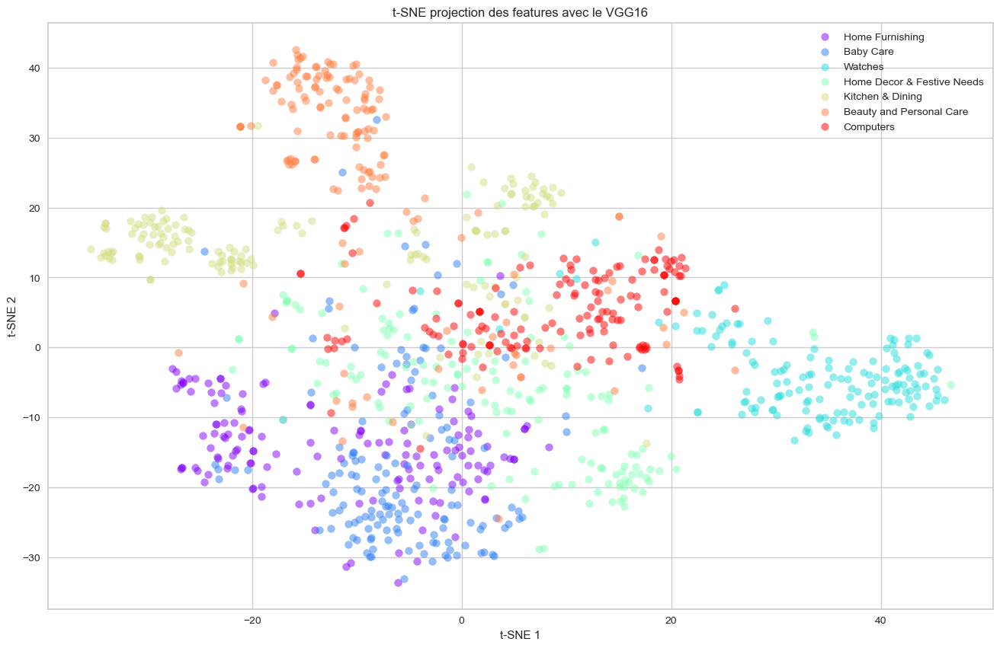

In [42]:
# Lire le DataFrame avec les features extraites
df_vgg_tsne = pd.read_csv('df_vgg_with_features.csv')
#df_vgg_tsne.head(5)

# Vérifier le nombre de features disponibles dans le DataFrame
features_columns = [col for col in df_vgg_tsne.columns if col.startswith('feature_')]
num_features = len(features_columns)
print(f'Number of feature columns: {num_features}')

# Appliquer t-SNE pour réduire les dimensions à 2D
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(df_vgg_tsne[features_columns])

# Ajouter les résultats t-SNE au DataFrame
df_vgg_tsne['tsne_2d_one'] = tsne_results[:, 0]
df_vgg_tsne['tsne_2d_two'] = tsne_results[:, 1]

# Visualisation des résultats t-SNE avec Matplotlib
plt.figure(figsize=(16, 10))
categories = df_vgg_tsne['Level_1'].unique()
colors = plt.cm.rainbow(np.linspace(0, 1, len(categories)))

for category, color in zip(categories, colors):
    subset = df_vgg_tsne[df_vgg_tsne['Level_1'] == category]
    plt.scatter(subset['tsne_2d_one'], subset['tsne_2d_two'], c=[color], label=category, alpha=0.5)

plt.title('t-SNE projection des features avec le VGG16')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(loc='best')
plt.show()


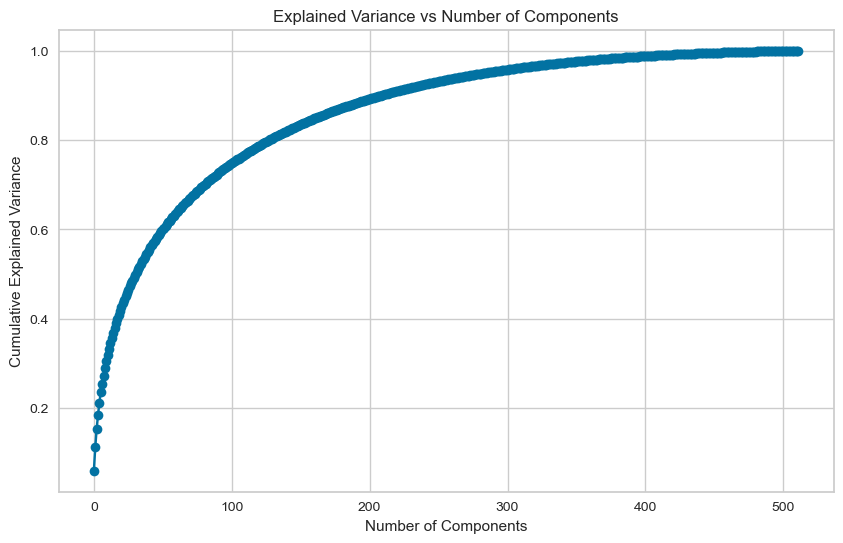

Entrez le seuil de variance à conserver (entre 0 et 1) :  0.98


Nombre de composantes retenues: 366


,product_name,image,Level_1,PC1,PC2,PC3,PC4,PC5,PC6,PC7,...,PC357,PC358,PC359,PC360,PC361,PC362,PC363,PC364,PC365,PC366
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,-2.239658,4.254417,-1.324011,7.156378,4.847639,3.804104,-2.144171,...,0.465358,-0.642978,-0.192581,0.008004,-0.259460,-0.366671,0.511062,-1.061155,0.552372,0.384021
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,-1.724884,5.360836,-6.853731,3.358370,-1.367954,0.706015,0.507467,...,0.224905,0.395895,-0.852515,-0.145386,0.839349,0.306282,-0.516029,0.617820,0.499397,0.391515
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,-5.076012,3.874737,-6.097013,2.435429,-4.871335,-2.893219,0.995747,...,0.020677,0.586597,0.156116,-0.518574,-0.511241,0.329855,-0.434128,-0.065878,-0.108926,-0.129376


In [43]:
# Séparer les colonnes string
string_columns = df_vgg[['product_name','image','Level_1']]

# Suppression des colonnes 'product_name' et 'level_1' pour la PCA
df_cleaned = df_vgg.drop(columns=['product_name','image','Level_1'])

# Standardisation des données
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_cleaned)

# Application de la PCA pour déterminer le nombre de composantes
pca = PCA().fit(df_scaled)

# Calcul de la variance cumulée
cumulative_variance = pca.explained_variance_ratio_.cumsum()

# Affichage de la variance cumulée pour choisir le seuil
plt.figure(figsize=(10, 6))
plt.plot(cumulative_variance, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance vs Number of Components')
plt.grid(True)
plt.show()

# Demander à l'utilisateur de choisir le seuil de variance
variance_threshold = float(input("Entrez le seuil de variance à conserver (entre 0 et 1) : "))

# Déterminer le nombre de composantes nécessaires pour atteindre le seuil de variance
num_components = next(i for i, total_variance in enumerate(cumulative_variance) if total_variance >= variance_threshold) + 1

# Application de la PCA avec le nombre de composantes sélectionné
pca = PCA(n_components=num_components)
df_pca = pca.fit_transform(df_scaled)

# Création d'un DataFrame pour les résultats de la PCA
df_pca_result = pd.DataFrame(df_pca, columns=[f'PC{i+1}' for i in range(df_pca.shape[1])])

# Ajout des colonnes string au DataFrame final
df_vgg_pca = pd.concat([string_columns, df_pca_result], axis=1)

# Affichage du nombre de composantes retenues
print(f"Nombre de composantes retenues: {num_components}")
df_vgg_pca.head(3)


In [44]:
# Définition des hyperparamètres pour K-means
n_clusters = 7  
init = 'k-means++' 
n_init = 25  
max_iter = 300  
random_state = 42

# Application de K-means avec les hyperparamètres définis
kmeans = KMeans(n_clusters=n_clusters, init=init, n_init=n_init, max_iter=max_iter, random_state=random_state)
kmeans.fit(df_pca)

# Ajout des labels K-means au DataFrame final
df_vgg_pca['kmeans_label'] = kmeans.labels_

In [45]:
# Évaluation des performances du K-means
df_vgg_pca['Level_1'] = df_vgg_pca['Level_1'].astype('category')

# Liste pour stocker les évaluations
evaluations = []
evaluations_std = []

def fit_and_evaluate(km, X, labels, name=None, n_runs=5):
    name = km.__class__.__name__ if name is None else name

    train_times = []
    scores = defaultdict(list)
    for seed in range(n_runs):
        km.set_params(random_state=seed)
        t0 = time()
        km.fit(X)
        train_times.append(time() - t0)
        scores["Homogeneity"].append(metrics.homogeneity_score(labels, km.labels_))
        scores["Completeness"].append(metrics.completeness_score(labels, km.labels_))
        scores["V-measure"].append(metrics.v_measure_score(labels, km.labels_))
        scores["Adjusted Rand-Index"].append(
            metrics.adjusted_rand_score(labels, km.labels_)
        )
        scores["Silhouette Coefficient"].append(
            metrics.silhouette_score(X, km.labels_, sample_size=2000)
        )
    train_times = np.asarray(train_times)

    print(f"Clustering done in {train_times.mean():.2f} ± {train_times.std():.2f} s ")
    evaluation = {
        "estimator": name,
        "train_time": train_times.mean(),
    }
    evaluation_std = {
        "estimator": name,
        "train_time": train_times.std(),
    }
    for score_name, score_values in scores.items():
        mean_score, std_score = np.mean(score_values), np.std(score_values)
        print(f"{score_name}: {mean_score:.3f} ± {std_score:.3f}")
        evaluation[score_name] = mean_score
        evaluation_std[score_name] = std_score
    evaluations.append(evaluation)
    evaluations_std.append(evaluation_std)

# Application de la fonction d'évaluation
fit_and_evaluate(kmeans, df_pca, df_vgg_pca['Level_1'].cat.codes)

Clustering done in 0.66 ± 0.02 s 
Homogeneity: 0.481 ± 0.006
Completeness: 0.522 ± 0.009
V-measure: 0.501 ± 0.007
Adjusted Rand-Index: 0.343 ± 0.014
Silhouette Coefficient: 0.035 ± 0.003


### 3. Le EffB0 (ARI = 0.550)

In [15]:
df_effb0 = df[['product_name',
            'image',
            'Level_1']].copy()
df_effb0.head(3)

,product_name,image,Level_1
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care


In [17]:
# Chemin vers le répertoire contenant les images
directory_path = r'C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images'

# Hyperparamètres ajustés
learning_rate = 0.0001
batch_size = 32
epochs = 50

# Charger le modèle EfficientNetB0 pré-entraîné
base_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Ajouter une couche de Global Average Pooling pour l'extraction des features
x = base_model.output
x = GlobalAveragePooling2D()(x)

# Créer le modèle pour l'extraction des features
model = Model(inputs=base_model.input, outputs=x)

# Configuration de l'augmentation des données
datagen = ImageDataGenerator(
    rescale=1.0/255.0,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Fonction pour pré-traiter et extraire les features d'une image
def extract_features(img_path, model):
    try:
        img = image.load_img(img_path, target_size=(224, 224))
        img = image.img_to_array(img)
        img = np.expand_dims(img, axis=0)
        img = preprocess_input(img)
        features = model.predict(img)
        print(f"Features shape for {img_path}: {features.shape}") 
        return features.flatten()
    except Exception as e:
        print(f"Erreur lors du traitement de l'image {img_path}: {str(e)}")
        return None

# Initialiser une liste pour stocker les features et les noms des images
all_features = []
image_names = []

# Vérification si 'image' est dans les colonnes
if 'image' not in df_effb0.columns:
    raise ValueError("Le DataFrame df_effb0 ne contient pas de colonne 'image'. Veuillez vérifier le DataFrame d'entrée.")

# Extraction des features avec une barre de progression
progress_bar = tqdm(total=len(df_effb0), desc='Extraction des features')
for img_name in df_effb0['image']:
    img_path = os.path.join(directory_path, img_name)
    if os.path.isfile(img_path):
        features = extract_features(img_path, model)
        if features is not None:
            all_features.append(features)
            image_names.append(img_name)
    progress_bar.update(1)
progress_bar.close()

# Vérifier que all_features n'est pas vide avant de créer le DataFrame
if all_features:
    feature_dimension = len(all_features[0])
    features_df = pd.DataFrame(all_features, columns=[f'feature_{i}' for i in range(feature_dimension)])
    features_df['image'] = image_names

    # Fusionner les features avec le DataFrame d'origine
    df_effb0 = pd.merge(df_effb0, features_df, on='image', how='left')

    # Enregistrer le DataFrame avec les features dans un fichier CSV
    df_effb0.to_csv('df_effb0_with_features.csv', index=False)
else:
    print("Aucune feature extraite. Vérifiez le processus d'extraction.")


Extraction des features:   0%|          | 0/1050 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


Extraction des features:   0%|          | 1/1050 [00:05<1:44:35,  5.98s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55b85ea15a1536d46b7190ad6fff8ce7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:   0%|          | 2/1050 [00:06<46:04,  2.64s/it]  

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b72c92c2f6c40268628ec5f14c6d590.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:   0%|          | 3/1050 [00:06<27:03,  1.55s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64d5d4a258243731dc7bbb1eef49ad74.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:   0%|          | 4/1050 [00:06<18:03,  1.04s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d4684dcdc759dd9cdf41504698d737d8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:   0%|          | 5/1050 [00:07<13:53,  1.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6325b6870c54cd47be6ebfbffa620ec7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:   1%|          | 6/1050 [00:07<11:06,  1.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\893aa5ed55f7cff2eccea7758d7a86bd.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:   1%|          | 7/1050 [00:07<09:07,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f355cc1ccb08bd0d283ed979b7ee7515.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:   1%|          | 8/1050 [00:08<07:31,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd0e3470a7e6ed76fd69c2da27721041.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:   1%|          | 9/1050 [00:08<06:26,  2.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41384da51732c0b4df3de8f395714fbb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:   1%|          | 10/1050 [00:08<05:42,  3.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\710ed5f2393a4b9e8823aa0029f71f93.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:   1%|          | 11/1050 [00:08<05:20,  3.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\920154acbe49d3202ed7d2ed2df1ea13.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:   1%|          | 12/1050 [00:09<05:14,  3.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08452abdadb3db1e686b94a9c52fc7b6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:   1%|          | 13/1050 [00:09<05:01,  3.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1e8741b5ae27a513546c94b3f3312aee.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:   1%|▏         | 14/1050 [00:09<04:44,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\189fa66a5fa6f08d2802a62ecf0be298.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:   1%|▏         | 15/1050 [00:09<04:35,  3.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bbb8cdc5406ff60ff06ff64630f2ca47.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:   2%|▏         | 16/1050 [00:10<04:31,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1120bc768623572513df956172ffefeb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:   2%|▏         | 17/1050 [00:10<04:23,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5479bb7028827d60000720a2c135976a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   2%|▏         | 18/1050 [00:10<04:20,  3.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\733aa1e801a139fa8dc7be9f0eff5ee0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   2%|▏         | 19/1050 [00:10<04:10,  4.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62c35de4df27437d3597963fac55a8b6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:   2%|▏         | 20/1050 [00:10<04:04,  4.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\33d97d63c037078cd3f08033966d6a88.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:   2%|▏         | 21/1050 [00:11<03:56,  4.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d7ca2b06b4f4d3b98c61c377b18a2d6b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:   2%|▏         | 22/1050 [00:11<03:50,  4.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f74476ba64365d97a5be7d375cbf4c7a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


Extraction des features:   2%|▏         | 23/1050 [00:11<03:43,  4.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda50982a672ef8835de5c1cc86f8bfc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


Extraction des features:   2%|▏         | 24/1050 [00:11<03:49,  4.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4788f5466992da09024b8ffcc8a5cba4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:   2%|▏         | 25/1050 [00:12<03:49,  4.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\653826cd53f1d9e2c086c0ac7846ef70.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:   2%|▏         | 26/1050 [00:12<04:13,  4.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c74db45cbfc14a78b8466dca494b3bb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   3%|▎         | 27/1050 [00:12<04:11,  4.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4aa047f14885c74f155ce5f973e14dff.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:   3%|▎         | 28/1050 [00:12<04:06,  4.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c4fec2331da8d40f2cb146eb198cb57.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:   3%|▎         | 29/1050 [00:13<04:05,  4.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b52073e7ed9c00c4108cae4eb0c49c1a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:   3%|▎         | 30/1050 [00:13<04:18,  3.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee8d9ff65e0fe4278afce7c933d30941.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


Extraction des features:   3%|▎         | 31/1050 [00:13<03:57,  4.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\788dc3a3da91c0f46a7c465e07f91dd4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


Extraction des features:   3%|▎         | 32/1050 [00:13<04:34,  3.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29b1ca231e10d5269516b80bf9d0dffc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:   3%|▎         | 33/1050 [00:14<04:17,  3.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8b268c1e68f198ae2e934717d49f48e9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:   3%|▎         | 34/1050 [00:14<04:10,  4.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b85f8843bb1c297dd5712f0bd287006d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:   3%|▎         | 35/1050 [00:14<04:08,  4.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4b09aa7927c59fbb39960b3d7919909.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:   3%|▎         | 36/1050 [00:14<04:12,  4.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\81e739c7f3be737152f2e6f520e3494b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:   4%|▎         | 37/1050 [00:15<04:21,  3.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0938b0d88eac91deee6d5add54097d3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:   4%|▎         | 38/1050 [00:15<04:27,  3.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e9420e9483f16db81c64dddf99f34841.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:   4%|▎         | 39/1050 [00:15<04:30,  3.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a3dea07b2f7bf48276d32513091be717.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:   4%|▍         | 40/1050 [00:15<04:33,  3.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66191b4a311b5d9babfc00a71ef97c5b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:   4%|▍         | 41/1050 [00:16<04:29,  3.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90e56526f4c5892beac49f262b85150a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


Extraction des features:   4%|▍         | 42/1050 [00:16<04:48,  3.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a79117ea49a0533f641facdb4c99f502.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:   4%|▍         | 43/1050 [00:16<04:39,  3.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5325213d84c80ad310b6e4b37a1ac824.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:   4%|▍         | 44/1050 [00:17<04:29,  3.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2d50e4c6ccf8befe9335ac8f97a11712.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:   4%|▍         | 45/1050 [00:17<04:26,  3.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8050d31bffe6827c804b8222338aafb2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


Extraction des features:   4%|▍         | 46/1050 [00:17<04:34,  3.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\493d1eb6ad7a48a926092bf994cd0bb0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:   4%|▍         | 47/1050 [00:17<04:21,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3388d05e88972ff9f3e1321dc0cfdc28.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


Extraction des features:   5%|▍         | 48/1050 [00:18<04:06,  4.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d1899ab1d5c79ddaa311bc9f04d198ed.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:   5%|▍         | 49/1050 [00:18<04:07,  4.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e7cab08a267e815c72a26513222783e0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


Extraction des features:   5%|▍         | 50/1050 [00:18<04:18,  3.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02a53d335775b652f22f41b529b9d646.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:   5%|▍         | 51/1050 [00:18<04:19,  3.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\69446af66066146718cd569f87e99fff.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:   5%|▍         | 52/1050 [00:19<04:32,  3.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4d35b6536b623c83b293eb3a1c02bba.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


Extraction des features:   5%|▌         | 53/1050 [00:19<05:01,  3.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f01140c02fd09e5c56312a64fa8db3da.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


Extraction des features:   5%|▌         | 54/1050 [00:19<04:33,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6329ddb46087cb8c09ced95471dd9643.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:   5%|▌         | 55/1050 [00:19<04:25,  3.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e6ae1b372e8e0b509b83ba3658b8107.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:   5%|▌         | 56/1050 [00:20<04:15,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e2ae2af58ac50adf4881751ae84a9d8a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:   5%|▌         | 57/1050 [00:20<04:18,  3.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\24e85c590481a7cedfe66597f253f2b2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:   6%|▌         | 58/1050 [00:20<04:09,  3.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5e84d36ad6db970548498829db8b15de.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:   6%|▌         | 59/1050 [00:20<04:07,  4.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c4604dba348a99a2dfbbc2cd3928101.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:   6%|▌         | 60/1050 [00:21<04:04,  4.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0abfcbe0e17dd50c4cf5fb1d6037d514.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:   6%|▌         | 61/1050 [00:21<04:05,  4.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4a1b23dacd7d2a9ec7414f7159f25a48.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:   6%|▌         | 62/1050 [00:21<04:04,  4.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95330f6f0f44d17b918feec36bedcdef.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:   6%|▌         | 63/1050 [00:21<04:18,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66a5a21ea332aefcc7b90dbad94053aa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:   6%|▌         | 64/1050 [00:22<04:19,  3.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f4e7f269319ba9cf5507a9e2febacbf5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


Extraction des features:   6%|▌         | 65/1050 [00:22<04:54,  3.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\80e9cb3d2d7f9ff7bc497c34df366d03.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:   6%|▋         | 66/1050 [00:22<04:43,  3.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2baa415ebcc4fe563ce13b50e60efc1c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:   6%|▋         | 67/1050 [00:23<04:35,  3.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\903d63e2b71d692ccd628e1de516516e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:   6%|▋         | 68/1050 [00:23<04:32,  3.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\707b160df4c4dece6cde52b222ce624b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:   7%|▋         | 69/1050 [00:23<04:39,  3.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed9817e8960a6a0d509061c54cfe5ac1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:   7%|▋         | 70/1050 [00:24<05:10,  3.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a7a1287fef0d986a5e237797beee286.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:   7%|▋         | 71/1050 [00:24<05:00,  3.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ba898ecb77ab5a6799c8b047c6b6008.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:   7%|▋         | 72/1050 [00:24<04:55,  3.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2658bad8c2b7d5b08984c6ac34267f7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:   7%|▋         | 73/1050 [00:25<04:56,  3.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\afc3ebd18df498dd87abb7ad7536b5c7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:   7%|▋         | 74/1050 [00:25<04:53,  3.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\141d2b743c477043041faddf9233c8ad.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:   7%|▋         | 75/1050 [00:25<04:49,  3.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7a3f11f380a1bf85338ab3771ff81e9f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:   7%|▋         | 76/1050 [00:25<04:49,  3.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae45b64d808a883aa35f2bf4de879cac.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:   7%|▋         | 77/1050 [00:26<05:00,  3.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1971dcd2f3058a4c87bdd7d87d4baeba.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   7%|▋         | 78/1050 [00:26<04:40,  3.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4942e0a9c0527dc00319a39fc8f103e6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


Extraction des features:   8%|▊         | 79/1050 [00:26<05:30,  2.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0a8a1e9c6659361c0c2b247f8a6471d0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:   8%|▊         | 80/1050 [00:27<04:55,  3.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\320833ab08c9a94ef83520612899a85f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:   8%|▊         | 81/1050 [00:27<04:27,  3.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\57578c1e6ec61a880a6f3f971f5f77b8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


Extraction des features:   8%|▊         | 82/1050 [00:27<04:46,  3.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e130ed339dcfe20d2c8b66892278a94.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


Extraction des features:   8%|▊         | 83/1050 [00:27<04:21,  3.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\601817defaff9d0e30e1b72f96d3975f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:   8%|▊         | 84/1050 [00:28<04:25,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3cdfd9df09f61a8fd178bafcc8dbed31.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:   8%|▊         | 85/1050 [00:28<04:20,  3.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\374e63028d691c380bc43b0dc60e460d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:   8%|▊         | 86/1050 [00:28<04:04,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\61c0139f3d5c97f1615797dbf046cc0c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:   8%|▊         | 87/1050 [00:28<04:01,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0096e89cc25a8b96fb9808716406fe94.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:   8%|▊         | 88/1050 [00:29<03:54,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e8ee7868b0c3d1d04b482cd4f3ec5ccc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:   8%|▊         | 89/1050 [00:29<03:55,  4.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\04f9ff160a1561e3656350f4bd6b8c50.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:   9%|▊         | 90/1050 [00:29<03:55,  4.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aebf3a2172b33ef09acb472009967812.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:   9%|▊         | 91/1050 [00:29<03:46,  4.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ae332e2bafd23267caedfcc4453257c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:   9%|▉         | 92/1050 [00:30<03:49,  4.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\57800d48b001f3fad34a4f8fa9207f29.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:   9%|▉         | 93/1050 [00:30<03:55,  4.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d1e18b4a3aafb0040da2111c8b8ce2e5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:   9%|▉         | 94/1050 [00:30<04:12,  3.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46e6853da6b0c796b7a0d8203ceaa88e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:   9%|▉         | 95/1050 [00:30<04:02,  3.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22296bfc1c79d9dc88eabbd01220ef0c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   9%|▉         | 96/1050 [00:31<04:09,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f4d4c2eec77732f56e47722d7a355f2b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:   9%|▉         | 97/1050 [00:31<04:01,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f12a06b7dbfc55638afafcf8bb03d836.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:   9%|▉         | 98/1050 [00:31<03:54,  4.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\18bd9b88e23b82fd19f8ab0c9cad6a1a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:   9%|▉         | 99/1050 [00:31<03:50,  4.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5749bae8ccead7997ebf370b6b081d07.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  10%|▉         | 100/1050 [00:32<04:03,  3.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\059493eeb88ebb4cc08d1522f3f87c3f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  10%|▉         | 101/1050 [00:32<03:54,  4.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9613f2f1e65fb1fc7e181e7f83c217da.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  10%|▉         | 102/1050 [00:32<03:54,  4.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7fcd0d983a51283e58b806f065cc920.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  10%|▉         | 103/1050 [00:32<04:13,  3.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b78586222de9a1095d0a9d88455ee75f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  10%|▉         | 104/1050 [00:33<04:20,  3.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dfbd96036cbc28566e964cff04b5b3a8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  10%|█         | 105/1050 [00:33<04:13,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\336fc49639a5cc45aa532ace3ee1a044.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  10%|█         | 106/1050 [00:33<05:04,  3.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\789cf5578f48577a44586fca3adc35d0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step


Extraction des features:  10%|█         | 107/1050 [00:34<05:12,  3.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\184ecf07ca4e2872eaf53d2344a1e783.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  10%|█         | 108/1050 [00:34<05:00,  3.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b515014adccb1fdf5ff1e2c4a8ff9ea6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step


Extraction des features:  10%|█         | 109/1050 [00:34<05:17,  2.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5aacf8f5154afea2ac22fc767d072677.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  10%|█         | 110/1050 [00:35<04:58,  3.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cbbe686c4a233e8cf53528748f75223.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  11%|█         | 111/1050 [00:35<04:40,  3.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f1ee63a5f0db853e2c1b377778580d39.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  11%|█         | 112/1050 [00:35<04:49,  3.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0bb0f7b7a3075f4b9459121abe2185fa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  11%|█         | 113/1050 [00:36<04:41,  3.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8015db34d09642b046c775e8157dd729.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  11%|█         | 114/1050 [00:36<04:27,  3.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ddc40c08d9a9bafc4d14eddd98db7c0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  11%|█         | 115/1050 [00:36<04:11,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc784846bd59a16832454416ac708003.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  11%|█         | 116/1050 [00:36<04:34,  3.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e8f5dc78f80eff3c77a9714303f59d2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  11%|█         | 117/1050 [00:37<04:43,  3.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53f4bc7d7321f5c41de6b86e41f13e80.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  11%|█         | 118/1050 [00:37<04:29,  3.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be09f5a3a88ac10ae14c791fc8ac0dae.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


Extraction des features:  11%|█▏        | 119/1050 [00:37<04:42,  3.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d202ea988ab11f2327279093ac71975d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step


Extraction des features:  11%|█▏        | 120/1050 [00:38<04:44,  3.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\db6c79a1d852944a89e157793f392d67.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  12%|█▏        | 121/1050 [00:38<04:29,  3.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\16c18ce0affca13159e362227c83683c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  12%|█▏        | 122/1050 [00:38<04:29,  3.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7dd5e83e2108a97659577e50879f9d9f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  12%|█▏        | 123/1050 [00:38<04:30,  3.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a63eecfbb02004863fa1f29a0b8105fc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  12%|█▏        | 124/1050 [00:39<05:07,  3.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c77aa1fc09901ae07c392c152a70e41.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  12%|█▏        | 125/1050 [00:39<05:15,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\640fd08bb3ba538d67a5c0c2c61a5c4c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Extraction des features:  12%|█▏        | 126/1050 [00:40<04:50,  3.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7241df1acae1fac892c692097ea3fb98.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  12%|█▏        | 127/1050 [00:40<04:40,  3.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a85a7dbd31267a7b02eda3a4d484632d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  12%|█▏        | 128/1050 [00:40<04:25,  3.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\13de17e59a92f8bcaec8bf103bbff8c1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  12%|█▏        | 129/1050 [00:40<04:09,  3.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ba13df7877fd979d64c87c7586a5ca6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  12%|█▏        | 130/1050 [00:41<04:00,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f1484a63c0dc79e96c98b2a250380ed8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  12%|█▏        | 131/1050 [00:41<03:56,  3.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f01ff0a82401117e9da22dd680fd2f36.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  13%|█▎        | 132/1050 [00:41<03:49,  4.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de911421573d3e234450040374b55b38.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  13%|█▎        | 133/1050 [00:41<03:47,  4.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\614dbfa2f42c4684c0bb6152091113a6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  13%|█▎        | 134/1050 [00:42<03:49,  4.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5531b9f454e2d75cfe00c3f795e06de5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  13%|█▎        | 135/1050 [00:42<03:47,  4.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\258444ac7bb7ad8026800efad5c3502b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


Extraction des features:  13%|█▎        | 136/1050 [00:42<03:38,  4.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd369a1bb58ae02cd925dda7e9e1d00a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  13%|█▎        | 137/1050 [00:42<03:33,  4.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73f460cd6f3fd206902d7097a1816405.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  13%|█▎        | 138/1050 [00:42<03:32,  4.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0d3e1dc0d38be59e9927e47f152e48aa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  13%|█▎        | 139/1050 [00:43<03:38,  4.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\118b411bf265538461b084ce7abd55a8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  13%|█▎        | 140/1050 [00:43<03:37,  4.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06749cbff1487f470438823f6952cfd1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  13%|█▎        | 141/1050 [00:43<03:32,  4.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\202fc276e672eb8c29891aa50aef0771.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  14%|█▎        | 142/1050 [00:43<03:40,  4.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\feefbdff924dd6b7cc266449c9a36d69.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


Extraction des features:  14%|█▎        | 143/1050 [00:44<03:32,  4.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\af1ac46194b5488048c459102a16a57e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  14%|█▎        | 144/1050 [00:44<03:35,  4.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1fd886094826c3f25c6ffb380073974.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  14%|█▍        | 145/1050 [00:44<03:30,  4.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3847353a4b8de1efc504d589aea74ffe.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


Extraction des features:  14%|█▍        | 146/1050 [00:44<03:27,  4.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60efd61370e70267dc60b11ff2bf974c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  14%|█▍        | 147/1050 [00:45<03:24,  4.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63bc43c0000e71eb11bfafd2f46214a4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  14%|█▍        | 148/1050 [00:45<03:34,  4.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8794f7a06b530782c66f7c0911bb437.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  14%|█▍        | 149/1050 [00:45<03:43,  4.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8507eb0ef32c1c0db700f20aad6d9bcd.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  14%|█▍        | 150/1050 [00:45<03:40,  4.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc7abdf67b4d7dbf64dffbab7b37599c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  14%|█▍        | 151/1050 [00:46<03:42,  4.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1afa5f2c3c9b4b43def6dc2e695d2c87.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  14%|█▍        | 152/1050 [00:46<03:49,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73503fe89ea77420a598f4a1019e5b6d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  15%|█▍        | 153/1050 [00:46<03:54,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ec590694e8bf85f75c9200cf418127aa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  15%|█▍        | 154/1050 [00:46<03:56,  3.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7956d9586de3e25ff586bca58be7195e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  15%|█▍        | 155/1050 [00:47<03:54,  3.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63f6ef8f3fda2c306b27cfbf5a005f1e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


Extraction des features:  15%|█▍        | 156/1050 [00:47<03:45,  3.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\328b66226952d8733c0c48295fae1108.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  15%|█▍        | 157/1050 [00:47<03:43,  4.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6efd5d260667b94f04edbbd18bb300b9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  15%|█▌        | 158/1050 [00:47<03:45,  3.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\beaa6285a2b9c66db0e294767711ca3f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  15%|█▌        | 159/1050 [00:48<03:46,  3.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41fd5af61752be98b19b611a6ff9a0ef.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  15%|█▌        | 160/1050 [00:48<03:50,  3.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\219b24362655097cb41bf06a0be8ee79.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  15%|█▌        | 161/1050 [00:48<03:52,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5d1b8ef70b1ce27726f7f6c2f373e56.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  15%|█▌        | 162/1050 [00:48<03:51,  3.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\69515ea06da8b2b1c881ce34fbf6575a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  16%|█▌        | 163/1050 [00:49<03:50,  3.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02127f52e96fb72c66bf081d25104ef8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  16%|█▌        | 164/1050 [00:49<03:49,  3.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c4581cae6bf751a7ae5c40bb16b74e98.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  16%|█▌        | 165/1050 [00:49<03:53,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8f42da0f9f695f07067676eae4135c8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


Extraction des features:  16%|█▌        | 166/1050 [00:50<04:09,  3.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\785b4383b12106dd172306d427d8f7b2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  16%|█▌        | 167/1050 [00:50<03:56,  3.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d19d17140fdd9adc09ba6e2ad1e1ebb9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:  16%|█▌        | 168/1050 [00:50<03:39,  4.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aadbc3b9c32c4535b1bfee7321c4c0e7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  16%|█▌        | 169/1050 [00:50<03:37,  4.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea16e13a7cf16d8665d1bc44738dfa88.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  16%|█▌        | 170/1050 [00:50<03:36,  4.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a341f915962ee99754e962520f279708.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  16%|█▋        | 171/1050 [00:51<03:39,  4.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9077acd25761ea067ac6d9369d8fdf16.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  16%|█▋        | 172/1050 [00:51<03:39,  4.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cab75cad4b3a3c593c753a1759df28e2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  16%|█▋        | 173/1050 [00:51<03:32,  4.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5590e238d44b370337624f5987fb9b8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  17%|█▋        | 174/1050 [00:51<03:29,  4.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b043b37c38f081d96886acb5acfbdf5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  17%|█▋        | 175/1050 [00:52<03:26,  4.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b92e13d5ef945d086fd4f42b95bc04ac.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  17%|█▋        | 176/1050 [00:52<03:25,  4.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22ea3b69860bc9a5e0c69b87db2dcdab.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  17%|█▋        | 177/1050 [00:52<03:23,  4.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\154920adb9d584b55d419227f9b01cc6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  17%|█▋        | 178/1050 [00:52<03:28,  4.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5dbf978ab2cf9d2da6446d3e4595f690.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  17%|█▋        | 179/1050 [00:53<03:32,  4.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7ef3e6ec248f17f3a6a4697120ddb96.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  17%|█▋        | 180/1050 [00:53<03:31,  4.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aab46b84f70cc6774afaafe1d6035de3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  17%|█▋        | 181/1050 [00:53<03:38,  3.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\58d7fbbe6d306ecf16e0a7ac05b211d4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  17%|█▋        | 182/1050 [00:53<03:40,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59af3731b809a25f2bf99e99f645d8dd.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


Extraction des features:  17%|█▋        | 183/1050 [00:54<04:11,  3.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c4ca34c50a5437a1bcc42b72fc1351f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  18%|█▊        | 184/1050 [00:54<04:09,  3.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3830dda3491cd5b28ed42ae544bc44f0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  18%|█▊        | 185/1050 [00:54<04:05,  3.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f712e172ee77a913b6d627657986b72.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  18%|█▊        | 186/1050 [00:55<04:00,  3.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6da53319cc12c9729881f5478ff67223.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  18%|█▊        | 187/1050 [00:55<04:08,  3.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8bf65b132179faf26f61e26274b2b819.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  18%|█▊        | 188/1050 [00:55<04:06,  3.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f69bef5db54cb4c83b2aa8d0ce829d4e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  18%|█▊        | 189/1050 [00:55<04:00,  3.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ffbf3794aa8cb6bb8d3f313d0a549a09.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  18%|█▊        | 190/1050 [00:56<03:44,  3.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\acd2f21d63ac0bbed4d52e6010d9460b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  18%|█▊        | 191/1050 [00:56<03:57,  3.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b46d7b8e6826ad4c8b40a991da0f54d7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  18%|█▊        | 192/1050 [00:56<03:55,  3.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce2f67c3365846170cb709784d87e45b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  18%|█▊        | 193/1050 [00:57<03:56,  3.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4ccd4c315d99edd7c00d015b714485a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  18%|█▊        | 194/1050 [00:57<03:49,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\302c95f6eae5f4ce217fcedc4ef91262.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  19%|█▊        | 195/1050 [00:57<03:51,  3.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f756aa2ceb1efda609c428a47308758.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  19%|█▊        | 196/1050 [00:57<03:45,  3.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e3586dc60df258c5478446d65a317d2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  19%|█▉        | 197/1050 [00:58<03:49,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40829ac110f344ef35f1c8c32fb311c7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  19%|█▉        | 198/1050 [00:58<03:47,  3.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3c741a05c82c54343b94ed8c1292e2a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  19%|█▉        | 199/1050 [00:58<03:42,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d75705ad163412347cba51f882e9c0f0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  19%|█▉        | 200/1050 [00:58<03:37,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90f86ac4065397340e8012261577c220.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:  19%|█▉        | 201/1050 [00:59<03:27,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\168618e93387ad7171d4e4e1eeff9d1a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  19%|█▉        | 202/1050 [00:59<03:23,  4.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c4ab8ab059c912090c83cb0818e7f1c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  19%|█▉        | 203/1050 [00:59<04:46,  2.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70578f48cc96bbb60d040e08025e521d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  19%|█▉        | 204/1050 [01:00<04:30,  3.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5b378b0925d5409b5d84ceb416fc2afc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  20%|█▉        | 205/1050 [01:00<04:13,  3.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6775e3b91baa4d368f6d91eb7c24578b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  20%|█▉        | 206/1050 [01:00<04:00,  3.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c109187e7975ee8fdb2b3dfbdd9dce20.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  20%|█▉        | 207/1050 [01:00<03:46,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8962b50b699ddf4712ad18d29c6a3862.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  20%|█▉        | 208/1050 [01:01<03:35,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4d9e71172f619f8e3122e34bb0bf3cc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  20%|█▉        | 209/1050 [01:01<03:27,  4.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55ce1309b69e1912d2fd60a3ee3f351b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  20%|██        | 210/1050 [01:01<03:25,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a9b35b94610a3d7f4fa91f19693c5248.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  20%|██        | 211/1050 [01:01<03:22,  4.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3113367c72125a3355af42426fe14f17.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  20%|██        | 212/1050 [01:02<03:16,  4.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e99d9abb115a9bd580bcccf9ff4d4881.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  20%|██        | 213/1050 [01:02<03:24,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de29bf3288345e23b0e25345a3a057fb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  20%|██        | 214/1050 [01:02<03:30,  3.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3e7c584f317d1b5d6ac0088c411565e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  20%|██        | 215/1050 [01:02<03:28,  4.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d279c825ba12804c337f883b366a6e2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  21%|██        | 216/1050 [01:03<03:31,  3.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91a5328e7235424885d271dfa0959eeb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  21%|██        | 217/1050 [01:03<03:31,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2110699b945ae766c8b8112038ac58b9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  21%|██        | 218/1050 [01:03<03:37,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\198dbe7be6f84f6448197148d7b5e5a5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  21%|██        | 219/1050 [01:04<05:14,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce02ab514e4c623dcf7acd7182a7762d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  21%|██        | 220/1050 [01:04<04:51,  2.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2ede595489db33a036d135ce22645515.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  21%|██        | 221/1050 [01:04<04:34,  3.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32cf0691248297655e2c1728b12e2262.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


Extraction des features:  21%|██        | 222/1050 [01:05<04:21,  3.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\81a695f80d3f5c445910d310f1a83eb8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  21%|██        | 223/1050 [01:05<04:08,  3.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\922a04084481d4b3275a3f7bb54e90f3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  21%|██▏       | 224/1050 [01:05<03:58,  3.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2751cf0dd59d223cacbc5da5df42a1a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  21%|██▏       | 225/1050 [01:05<03:49,  3.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc2e2bb105a5c2b2e43842886d057b81.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  22%|██▏       | 226/1050 [01:06<03:53,  3.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\67d6b4a8aa19d57740b0440365b77624.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  22%|██▏       | 227/1050 [01:06<03:47,  3.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f39a2cce8929f5b44087d688995994e4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  22%|██▏       | 228/1050 [01:06<03:43,  3.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4451f1b01168b6a085738d0b0f2f02aa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  22%|██▏       | 229/1050 [01:06<03:37,  3.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f76aaed44b540869da862c5dd4b266f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  22%|██▏       | 230/1050 [01:07<03:41,  3.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\caabe6014b914fe2874a9a8d7284f79b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  22%|██▏       | 231/1050 [01:07<03:41,  3.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\968a2b3be84193e3f755c2fe71033a2c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  22%|██▏       | 232/1050 [01:07<03:45,  3.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8c1b5fb422d8418dc9e40a43fece55a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  22%|██▏       | 233/1050 [01:08<03:41,  3.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4642d967bc34a36454b281de632f6c11.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  22%|██▏       | 234/1050 [01:08<03:40,  3.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\34d3b2b8d263294107a3ffc69b35ff8f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:  22%|██▏       | 235/1050 [01:08<03:43,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed139e0d1b5c973495e1aa35dd4a5533.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  22%|██▏       | 236/1050 [01:08<03:43,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1e133cbe616bee3b3e9e6f4f0882e3d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  23%|██▎       | 237/1050 [01:09<03:47,  3.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf2ba696547459733c6bbfad4e3bcf62.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  23%|██▎       | 238/1050 [01:09<03:42,  3.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be0e65c6d8c2cc8cb913b36aa4168cf0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  23%|██▎       | 239/1050 [01:10<05:49,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e8df36b35d22cf219cf8bae6c2af752.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


Extraction des features:  23%|██▎       | 240/1050 [01:10<05:24,  2.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8f41774c16a931d71fcf01f8fee171e0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  23%|██▎       | 241/1050 [01:10<04:56,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e4c1d31e279a700c6b8e66d820e8601.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  23%|██▎       | 242/1050 [01:11<04:32,  2.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1357e9d24661c3b5797aa1016e0c3be1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  23%|██▎       | 243/1050 [01:11<04:13,  3.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\799ddb97164ff2d5d53bb8b27b8c355f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  23%|██▎       | 244/1050 [01:11<03:57,  3.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\607dc41467008ee7a8dba0276f180f63.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  23%|██▎       | 245/1050 [01:11<04:06,  3.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0c4718ae90f2889b7021a99ee1cc106c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


Extraction des features:  23%|██▎       | 246/1050 [01:12<04:41,  2.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\85fe188e1ee8237b70df0d475907bf24.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  24%|██▎       | 247/1050 [01:12<04:43,  2.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea42376c9c52752d9d01bba12eb2999b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Extraction des features:  24%|██▎       | 248/1050 [01:13<04:20,  3.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87f1807e002d3555b8dfb465a8a61df2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  24%|██▎       | 249/1050 [01:13<04:25,  3.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\45d0af2c709de47268c80c35a117de44.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  24%|██▍       | 250/1050 [01:13<04:04,  3.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0131e5d87b72877702d536299cf83b75.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  24%|██▍       | 251/1050 [01:13<03:48,  3.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17611e6e94d73ef376834e5c6ee03dde.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  24%|██▍       | 252/1050 [01:14<03:44,  3.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\72cbc043d14ee578c789c9fab3c43cdd.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  24%|██▍       | 253/1050 [01:14<03:37,  3.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6bc04b3ec1f8d4da2a00f8662f4fbed3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:  24%|██▍       | 254/1050 [01:14<04:47,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb733e04ff2d72c59d8513eb574e81a2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  24%|██▍       | 255/1050 [01:15<04:13,  3.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda51c31a1b7ae8f3c7b5c0174d3e201.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  24%|██▍       | 256/1050 [01:15<04:34,  2.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c38eb8abdaa1d8c28bc8c262761dfbc5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  24%|██▍       | 257/1050 [01:15<04:04,  3.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73b692cdfce9a77b721a54d4b7fb35a7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  25%|██▍       | 258/1050 [01:15<03:38,  3.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40d7d3d1961236dd814e15592fa52994.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:  25%|██▍       | 259/1050 [01:16<03:27,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9833d0de7f7e1927c807411c10b19189.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  25%|██▍       | 260/1050 [01:16<03:21,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\724e6eb7edc83eb48b6492d12e940ebd.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  25%|██▍       | 261/1050 [01:16<03:17,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\04f9f818e2d657b873b07578cfe2eade.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  25%|██▍       | 262/1050 [01:16<03:10,  4.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\273982a65b9c7dabe56c8345552bfad7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  25%|██▌       | 263/1050 [01:17<03:02,  4.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1b2b3ad430dd738d958292441b6d046.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  25%|██▌       | 264/1050 [01:17<02:59,  4.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a3cdc88ebbba7612e88eac1b82c5f82.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  25%|██▌       | 265/1050 [01:17<03:13,  4.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4951eb41979fe482879f777c8f21d2b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


Extraction des features:  25%|██▌       | 266/1050 [01:17<03:34,  3.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\412d0425bb7076610aace6549ded265c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  25%|██▌       | 267/1050 [01:18<03:33,  3.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0e73201f6d8807776e1d21c969078289.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  26%|██▌       | 268/1050 [01:18<03:31,  3.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86dcb7d4ce6ec7bfb3e26d1bd859f4fb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  26%|██▌       | 269/1050 [01:18<03:21,  3.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\093097cfe5626f4ad8914e0a16a940b5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  26%|██▌       | 270/1050 [01:18<03:19,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\908cc351957d02f72f60916006c531ba.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  26%|██▌       | 271/1050 [01:19<03:27,  3.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ee2e665b7de2e1cc29e3c65bde0c318.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  26%|██▌       | 272/1050 [01:19<03:27,  3.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9906d8f74589c452b00f2b5642a63c5f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  26%|██▌       | 273/1050 [01:19<03:27,  3.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0f7a56876c61ba98dfed48ede5d3f3e1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


Extraction des features:  26%|██▌       | 274/1050 [01:20<04:29,  2.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6a1afb657e9ac01e3ca1956dfdcc3e9a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  26%|██▌       | 275/1050 [01:20<04:07,  3.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3e1435782c0929327449eec11475b96.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  26%|██▋       | 276/1050 [01:20<04:03,  3.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\719677b02bfccafb86e9be78f36f938b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  26%|██▋       | 277/1050 [01:21<03:47,  3.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\14826adf9bc4c34ea566dae3d85ef7cf.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  26%|██▋       | 278/1050 [01:21<03:35,  3.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\113783ce1db999778b5a4bd374e61209.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  27%|██▋       | 279/1050 [01:21<03:32,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\553aa0252537751d153e7c50029f0242.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  27%|██▋       | 280/1050 [01:21<03:36,  3.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e2cec0756030a25f294ead3acc0570d2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  27%|██▋       | 281/1050 [01:22<03:31,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\009099b1f6e1e8f893ec29a7023153c4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  27%|██▋       | 282/1050 [01:22<03:30,  3.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\db3e2eeb4fe90d4755f2911d661eae95.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  27%|██▋       | 283/1050 [01:22<03:24,  3.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a8ea6fc2b3cd95f46bced80853ce8e0e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  27%|██▋       | 284/1050 [01:23<03:26,  3.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d2e9f36823bad0f6fe8c6b19bb92bdb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  27%|██▋       | 285/1050 [01:23<03:18,  3.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63f2d92a3f5fc6cfc11e7f99d5798eac.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  27%|██▋       | 286/1050 [01:23<03:13,  3.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64a9d0488652194fd8e879d5e6dc8015.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  27%|██▋       | 287/1050 [01:23<03:17,  3.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08613e8b27838b997069b1fedb6e88d2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  27%|██▋       | 288/1050 [01:24<04:17,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a66a68fbed935f90b62d5d29003267fc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  28%|██▊       | 289/1050 [01:24<04:21,  2.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f7c64d439d64656d6baa40f5798cdf5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  28%|██▊       | 290/1050 [01:24<04:15,  2.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2aaa6083689193df5ab01fe37dea1b5e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  28%|██▊       | 291/1050 [01:25<03:59,  3.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\45204a03550940bdcbc8e4703c07f550.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  28%|██▊       | 292/1050 [01:25<03:53,  3.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8876d7569efdaff5a21b33a1ab44a13d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  28%|██▊       | 293/1050 [01:25<03:46,  3.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c15895bbfd7da97c219be5b28150a06.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  28%|██▊       | 294/1050 [01:26<03:36,  3.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c2efa8aa11898bdb5fc4e46201973a42.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  28%|██▊       | 295/1050 [01:26<03:37,  3.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\688bb32bf0d9b6e350d2c0912a3b7c9f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  28%|██▊       | 296/1050 [01:26<03:31,  3.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\735820e1614052fde55659da9dc10ccc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  28%|██▊       | 297/1050 [01:26<03:21,  3.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\458c697fe5824552890b0e674cf5c109.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  28%|██▊       | 298/1050 [01:27<03:18,  3.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ed34e1ab886e8a702ec59dd66ba4dff.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  28%|██▊       | 299/1050 [01:27<03:16,  3.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2971287a1ac427bd98c4778112d20d06.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  29%|██▊       | 300/1050 [01:27<03:11,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b8728226cc2934095782f7e7f3ce740.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  29%|██▊       | 301/1050 [01:27<03:38,  3.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c6942026d53b881d1da9359ea19c9fc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  29%|██▉       | 302/1050 [01:28<03:24,  3.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\23704dd51c975e845c574b044aae0a9f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  29%|██▉       | 303/1050 [01:28<03:38,  3.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26d8d458084ef90d395d303eaeb71587.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  29%|██▉       | 304/1050 [01:28<03:29,  3.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a554abb9699959ec78425eac2b997c27.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  29%|██▉       | 305/1050 [01:29<03:23,  3.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95cb9561009bd6707c67f05e6a00c16e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


Extraction des features:  29%|██▉       | 306/1050 [01:29<03:33,  3.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\906b5b16c78ba1c718501138702cb32c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  29%|██▉       | 307/1050 [01:29<03:30,  3.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e11aaffb1d08f8091ea94598f7865aa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  29%|██▉       | 308/1050 [01:29<03:25,  3.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a12d9ae5720ae41446e084911f0c2865.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  29%|██▉       | 309/1050 [01:30<03:33,  3.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\521528ccaa29dd645e869550cae7a249.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  30%|██▉       | 310/1050 [01:30<03:21,  3.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f40e01331bc00216d147d4ebfdfbaf3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  30%|██▉       | 311/1050 [01:30<03:09,  3.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64b463dc0b75ae40a848498c657041e6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


Extraction des features:  30%|██▉       | 312/1050 [01:30<02:59,  4.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ecb5bba9a5984d2b35b8ac3f56056c67.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  30%|██▉       | 313/1050 [01:31<02:51,  4.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c20bf28cd809790c04e78fdaf47c038f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  30%|██▉       | 314/1050 [01:31<02:48,  4.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c8f99e979d4de9ab5d1ad20455622c7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  30%|███       | 315/1050 [01:31<02:42,  4.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3adb36e4275733d0d113d9039e6814ea.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  30%|███       | 316/1050 [01:31<02:37,  4.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e93cd13f5269dd51b8359ccf93ca5ace.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


Extraction des features:  30%|███       | 317/1050 [01:31<02:35,  4.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b551f20c6a8a1dc3d102a5f04bc8d7d6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:  30%|███       | 318/1050 [01:32<02:36,  4.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a898bd6978f9f2c6aa940b9fa3352c27.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  30%|███       | 319/1050 [01:32<02:38,  4.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd2716d0e5dd7ffc367ca4dd9f97aaa0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  30%|███       | 320/1050 [01:32<03:10,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e94fbcd81112a21860355b3b11cf52d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  31%|███       | 321/1050 [01:32<03:03,  3.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ee79b1e51c9f9262e8373ce6b717606.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  31%|███       | 322/1050 [01:33<02:54,  4.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5df72b5295dc5e6126693e640b50f3a2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  31%|███       | 323/1050 [01:33<02:52,  4.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\48b9e7f78348b95955d7484910b7af15.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  31%|███       | 324/1050 [01:33<03:13,  3.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f309bdd259c5b46a560bc1620e641947.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  31%|███       | 325/1050 [01:34<03:34,  3.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a43fbae655e5d13215b9dd65339fa9d4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  31%|███       | 326/1050 [01:34<03:46,  3.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3945cc3920106c04648e8ba17ef2b009.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  31%|███       | 327/1050 [01:34<03:25,  3.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c75d6d827876b0d0127acb59e5a251ee.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  31%|███       | 328/1050 [01:34<03:18,  3.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f3ad282dac6ef0e30585a49ac67a322b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  31%|███▏      | 329/1050 [01:35<03:12,  3.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c4c57dda1b2e50f40b331cc8f9d233b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  31%|███▏      | 330/1050 [01:35<03:07,  3.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cb0afa31d9ca796908fde019cd64044d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  32%|███▏      | 331/1050 [01:35<02:59,  4.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\394c2c627914e1eed9b8ac343583a679.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  32%|███▏      | 332/1050 [01:35<02:59,  4.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2689f048b3b6f0ff863bf0cce28873d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  32%|███▏      | 333/1050 [01:36<02:53,  4.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\473b1ab1abe21826c41efa1584a88a63.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  32%|███▏      | 334/1050 [01:36<02:52,  4.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d4b625befbbb7e8004e53c187f286e11.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  32%|███▏      | 335/1050 [01:36<02:56,  4.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\417ae3e8b08acc19a023b8a958644799.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  32%|███▏      | 336/1050 [01:36<02:52,  4.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\353ddb2c8ab6920d8ad1055abee87dda.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  32%|███▏      | 337/1050 [01:37<02:49,  4.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6634de7b39a5b0658c74ab098450096d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  32%|███▏      | 338/1050 [01:37<02:47,  4.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7680c6bf930669dc0646e3315187dc8c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  32%|███▏      | 339/1050 [01:37<02:48,  4.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fe1bd3e2be8112198506daecbac7dc5c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  32%|███▏      | 340/1050 [01:37<02:48,  4.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a993e1b59649c93f667d38227325066.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  32%|███▏      | 341/1050 [01:38<02:51,  4.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8963e56482bbd3e9d05e0709d61ee0ca.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  33%|███▎      | 342/1050 [01:38<02:54,  4.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fce2bd96b35d531a4784bc57e19aca4f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  33%|███▎      | 343/1050 [01:38<02:50,  4.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17a73d7c4b02ada2bfeed1115fed08a4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  33%|███▎      | 344/1050 [01:38<02:46,  4.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9743e6d1c9f3180483825fe4d2e97836.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  33%|███▎      | 345/1050 [01:39<03:10,  3.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e44d107ee32412243b19b0ed9b415f3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  33%|███▎      | 346/1050 [01:39<03:01,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d43d9bb261aaaf818c81a645e727b2d3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  33%|███▎      | 347/1050 [01:39<02:59,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52c5fe837181962a7c1d5883bb9d7007.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  33%|███▎      | 348/1050 [01:39<02:58,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\539f82930cfad8afef1a75882eb45703.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  33%|███▎      | 349/1050 [01:40<02:53,  4.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ba69836467fe0795bf0e1161fc481d9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  33%|███▎      | 350/1050 [01:40<02:55,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02c63a087b298ec74042d557acf61be1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  33%|███▎      | 351/1050 [01:40<02:53,  4.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2670ba9bc61b42937773486ddcae442a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  34%|███▎      | 352/1050 [01:40<02:50,  4.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9438a0874e0486f46f3669cac6c2ac90.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  34%|███▎      | 353/1050 [01:41<02:49,  4.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\833a87b0af3b84fe246d2ebf271af177.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  34%|███▎      | 354/1050 [01:41<02:46,  4.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5b47b2ecf5cf5760051b0a980ed7a3f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  34%|███▍      | 355/1050 [01:41<02:43,  4.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8e2c85eccdc9db55eeb2231385e4f1c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  34%|███▍      | 356/1050 [01:41<02:43,  4.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26989e846c2096a5b59b59cbea2cc7ab.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  34%|███▍      | 357/1050 [01:41<02:42,  4.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a02f44389bda4c60e7dc23947dbca58.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  34%|███▍      | 358/1050 [01:42<02:44,  4.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\79b78739b0ae84780001fec304ce036c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  34%|███▍      | 359/1050 [01:42<02:47,  4.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91e22428c0dd8871288ba5dac35a7382.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  34%|███▍      | 360/1050 [01:42<02:48,  4.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b0e6f200426b1db8824b2ca0c59ecfa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  34%|███▍      | 361/1050 [01:43<02:57,  3.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc9412969fab14faba65c70e00fef4a8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  34%|███▍      | 362/1050 [01:43<02:55,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd0b73d97cea6cc71d263a77fa7982be.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  35%|███▍      | 363/1050 [01:43<02:52,  3.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42c5c528ad7ac8ad7a4e7c31f958e25f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  35%|███▍      | 364/1050 [01:43<02:51,  4.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8932c9a89b487bf9f2b3fce06c7c6553.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  35%|███▍      | 365/1050 [01:43<02:51,  3.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4327c9879644be2a04e9b2df963f6cb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  35%|███▍      | 366/1050 [01:44<02:56,  3.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7bcabeb38f148041087fafdad40e2c57.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  35%|███▍      | 367/1050 [01:44<02:59,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\47d7792e50e69b048b1f17176f170141.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  35%|███▌      | 368/1050 [01:44<02:55,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\884ff6050ff3d6b2c8f681c300a21b2a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  35%|███▌      | 369/1050 [01:45<03:15,  3.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f386f28cbc2ca9a63b5dc7a8fe6d5098.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  35%|███▌      | 370/1050 [01:45<03:05,  3.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53c4f1e5cb1767f1a6ba05d32dfaf107.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  35%|███▌      | 371/1050 [01:45<02:57,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b42a9b597a3a3dc8f428e2e2323e9aff.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  35%|███▌      | 372/1050 [01:45<02:52,  3.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2a20862f02555a44b0ab301bed987a0b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  36%|███▌      | 373/1050 [01:46<03:03,  3.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea82cb68a6e79d3c10fe9c4255c6a508.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  36%|███▌      | 374/1050 [01:46<02:51,  3.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c6b9db55291a68d99c4bb9a88266e27.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  36%|███▌      | 375/1050 [01:46<02:45,  4.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\df11d370920e09a2985e574ffd9b0ff1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  36%|███▌      | 376/1050 [01:46<02:38,  4.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4c096ad79f63c12a42f56fe8cec37f36.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  36%|███▌      | 377/1050 [01:47<04:55,  2.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\15f45d08050e8ba24a14804cba000589.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  36%|███▌      | 378/1050 [01:47<04:20,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\94a0d2804a77f7d2bfab6f3f0ae5254d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  36%|███▌      | 379/1050 [01:48<03:47,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\955abcd11312fce2fd02a91a9b05ae71.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


Extraction des features:  36%|███▌      | 380/1050 [01:48<03:32,  3.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\534d9c3ae2342df2f4f9233622f90711.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  36%|███▋      | 381/1050 [01:48<03:12,  3.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1eda39f01d0a8a2e5ce4b32fc7da1027.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  36%|███▋      | 382/1050 [01:49<03:40,  3.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\079d049de21fb2426b516a8d2f9a8bdb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


Extraction des features:  36%|███▋      | 383/1050 [01:49<03:42,  3.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4c449766e715bc41023244c9042e0a82.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  37%|███▋      | 384/1050 [01:49<03:21,  3.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\54754ccd18f2a75c53de68806176392a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  37%|███▋      | 385/1050 [01:49<03:14,  3.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\67119571e4b46deb266236d8e7fad65d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  37%|███▋      | 386/1050 [01:50<03:02,  3.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2fa99bfaa4aa65a2bd53337e140f949.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  37%|███▋      | 387/1050 [01:50<02:59,  3.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59d964c38c787f829c6cfa5629e4df90.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  37%|███▋      | 388/1050 [01:50<03:16,  3.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\36b965559aa2b97cb961a603f18a9183.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  37%|███▋      | 389/1050 [01:51<03:04,  3.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\98ad5b99ad96695568d8f143b11ab740.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  37%|███▋      | 390/1050 [01:51<02:58,  3.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51dc964c7a47293ff0ed0c6912813722.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  37%|███▋      | 391/1050 [01:51<02:52,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae19a81b730b48b87ca72521af8fb902.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  37%|███▋      | 392/1050 [01:51<02:47,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7fd12776e6d62da6e1dd3cbc9882ee5f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  37%|███▋      | 393/1050 [01:52<03:07,  3.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d376da2235096f74600d842b6f5f2d1a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  38%|███▊      | 394/1050 [01:52<03:00,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ab3f4b2d2ec007b7e0eaec213bfdbffc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  38%|███▊      | 395/1050 [01:52<03:09,  3.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd95002e0fea67f7ec2f2597814c5eaf.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  38%|███▊      | 396/1050 [01:53<03:14,  3.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\862c7462f12de819d93f93dc573289c5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  38%|███▊      | 397/1050 [01:53<03:29,  3.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\387ecd9ec173d61b6dc5ceddc079b150.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  38%|███▊      | 398/1050 [01:53<03:13,  3.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c2e71e7c97489d4efa5eab796ae354ac.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  38%|███▊      | 399/1050 [01:53<03:00,  3.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\215decf6f993d7b45d75520d9174493f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  38%|███▊      | 400/1050 [01:54<02:52,  3.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8720a25546a572b0217817a82bfd00a5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  38%|███▊      | 401/1050 [01:54<02:55,  3.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4fe24e100a5fcc33cf6054ef101067ed.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  38%|███▊      | 402/1050 [01:54<02:54,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\50be4cd92fda2755e1e884421a52e345.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  38%|███▊      | 403/1050 [01:54<02:50,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\726de30d1473ecb9641c1cd5286b6344.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  38%|███▊      | 404/1050 [01:55<02:47,  3.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1c7aa8e0f50e7ee73ed30d12af1a961.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  39%|███▊      | 405/1050 [01:55<02:41,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\07f8bdc4372a73d0820507683a936b6e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  39%|███▊      | 406/1050 [01:55<03:02,  3.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a231459c1562ee1117e95a61128820b7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  39%|███▉      | 407/1050 [01:56<02:59,  3.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fa6f5eb34be4ad5daec225bfe09f2414.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  39%|███▉      | 408/1050 [01:56<02:53,  3.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbf7c443a45d684944b5d9928eef051f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  39%|███▉      | 409/1050 [01:56<02:51,  3.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a7a294ddbcd9bbbc46c034079529c17c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  39%|███▉      | 410/1050 [01:56<02:42,  3.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6cd71c28144224b080cdec222bc4833.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  39%|███▉      | 411/1050 [01:57<02:39,  4.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e39177ad1acf95e44ddd430bf969a86b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:  39%|███▉      | 412/1050 [01:57<02:41,  3.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c7b493625b5fc6689cae49d25e1ae17.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  39%|███▉      | 413/1050 [01:57<02:40,  3.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f6fbce5fffb82a83d7529815c4be9a72.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  39%|███▉      | 414/1050 [01:57<02:46,  3.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d36e6f157d1155369f763a0a434fb129.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  40%|███▉      | 415/1050 [01:58<02:40,  3.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2d4f1232af970bd19881ceacad6ccfe3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  40%|███▉      | 416/1050 [01:58<02:41,  3.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b17d093c269db6ad3bf4b6076461fd72.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  40%|███▉      | 417/1050 [01:58<02:40,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\723e472f98180745980efe32411d30c6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  40%|███▉      | 418/1050 [01:58<02:50,  3.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f74e1afad2c545c25ee38193d0eb87d5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  40%|███▉      | 419/1050 [01:59<02:48,  3.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1d829e0eac91d7e85cdd6d581c363360.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  40%|████      | 420/1050 [01:59<02:44,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e365b55f806e5d0abe0094a9f2590e33.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  40%|████      | 421/1050 [01:59<02:37,  4.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c3768639e82ceaeab681e083b897672.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  40%|████      | 422/1050 [01:59<02:34,  4.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f25d2701ff23f6749e8e69ca17987993.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  40%|████      | 423/1050 [02:00<02:31,  4.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0e1e3861d54a8a17b7b91f04071a4ca3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  40%|████      | 424/1050 [02:00<02:33,  4.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00e966a5049a262cfc72e6bbf68b80e7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  40%|████      | 425/1050 [02:00<02:35,  4.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1be8161a259813bca5d068d5730464e7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  41%|████      | 426/1050 [02:00<02:33,  4.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60a7313ea1e0ee8d845a0a6dec6117cc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  41%|████      | 427/1050 [02:01<02:32,  4.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70461caa9038cfa34d109ea056d57f5a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step


Extraction des features:  41%|████      | 428/1050 [02:01<02:45,  3.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4735953b9c8504eb327675a14c6c33dd.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  41%|████      | 429/1050 [02:01<02:53,  3.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd5d6f0649f40d49791bbd5c00758e2f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  41%|████      | 430/1050 [02:01<02:46,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9fb8662af03c957ade34d4c816d4e903.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  41%|████      | 431/1050 [02:02<02:42,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a54b94096938252901d3f7f8de97bffb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  41%|████      | 432/1050 [02:02<02:36,  3.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\281dfd9b94b34362c295b3e5f8da5dfa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  41%|████      | 433/1050 [02:02<02:30,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f2f1f3039d1f5bc23226fc36577eab9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  41%|████▏     | 434/1050 [02:02<02:29,  4.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32f24a4303050f500dec7cb3608fe089.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  41%|████▏     | 435/1050 [02:03<02:25,  4.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea199e645da893f2ab0c45cf07face13.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  42%|████▏     | 436/1050 [02:03<02:25,  4.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ccceaae844f34180708cb6cba3441bf.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  42%|████▏     | 437/1050 [02:03<02:20,  4.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e921fc17a0ed9a58f76d38558deb9337.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  42%|████▏     | 438/1050 [02:03<02:21,  4.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b6c339777814451815fe7950fd4c8536.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  42%|████▏     | 439/1050 [02:03<02:19,  4.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee78c1e94bdc217d1d0eaef5c567417a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  42%|████▏     | 440/1050 [02:04<02:19,  4.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26269fd0df12630eec4508c2cf3c94e1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  42%|████▏     | 441/1050 [02:04<02:25,  4.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b90046b67cafcedfd363afba5fafc1c7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  42%|████▏     | 442/1050 [02:04<02:24,  4.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8aa59c4a170e8a90ae832b173b2b2d9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  42%|████▏     | 443/1050 [02:04<02:21,  4.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6f4475e2385cc16ce83f21f975614b3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  42%|████▏     | 444/1050 [02:05<02:27,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2231a6fc63274c46043e353f1728f077.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  42%|████▏     | 445/1050 [02:05<02:24,  4.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc24426f00c1cf9ae0bf76e8bd23c336.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  42%|████▏     | 446/1050 [02:05<02:23,  4.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d8ef80a8ba345dedc9f944cf21201988.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  43%|████▎     | 447/1050 [02:05<02:25,  4.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d7fded8e211b3033e424fb450b97caec.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  43%|████▎     | 448/1050 [02:06<02:29,  4.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e961e4fd248c9496ca54808d2d2b25f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  43%|████▎     | 449/1050 [02:06<02:29,  4.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\750f964cf8e6a16412aaf2b0d0350d0a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  43%|████▎     | 450/1050 [02:06<02:26,  4.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49f7763dc9c7ece284a1ae27166f8c6c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  43%|████▎     | 451/1050 [02:06<02:22,  4.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95feec21a9d076cff084159d61bf9b8e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  43%|████▎     | 452/1050 [02:07<02:32,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0d5e49c1a5aead18d5ff2e8f611de4e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


Extraction des features:  43%|████▎     | 453/1050 [02:07<02:43,  3.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b8c4bc35aee94af356cb1fd2dfa0219.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  43%|████▎     | 454/1050 [02:07<02:52,  3.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e6b483fce5fd910afda67d97dc04e775.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  43%|████▎     | 455/1050 [02:08<02:45,  3.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cb1ea7b2257aeeeba701a8f6e3e0127.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  43%|████▎     | 456/1050 [02:08<02:38,  3.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b0f02b3acf1825f8bbc1fb3b860dbb8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  44%|████▎     | 457/1050 [02:08<02:34,  3.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ec6ee9814a27423e66c3c9ea26f77aa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  44%|████▎     | 458/1050 [02:08<02:31,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\050ea3acb555bf641e7ae9b4f3ba684a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  44%|████▎     | 459/1050 [02:09<02:38,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\650e27dff8f645649353743f64e03f77.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  44%|████▍     | 460/1050 [02:09<02:32,  3.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e09d5a71d46d61de3d4c9c5aedb73f2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  44%|████▍     | 461/1050 [02:09<02:35,  3.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c62cbbd23958ae380fea906f6b5a994.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  44%|████▍     | 462/1050 [02:09<02:30,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b80ac036843b278083fabfd9a3c84ff.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  44%|████▍     | 463/1050 [02:10<03:14,  3.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\994f1d8ade16b9fddce3c127eb7f38ed.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  44%|████▍     | 464/1050 [02:10<02:59,  3.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17582ae953860b5320683768b8e97d3a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  44%|████▍     | 465/1050 [02:10<02:54,  3.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c063d07d78a55a21bf6c0e7c8ae46a6d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  44%|████▍     | 466/1050 [02:11<02:46,  3.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\da2ce8d17a17f9d19b368434aedea5e9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  44%|████▍     | 467/1050 [02:11<03:25,  2.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3bc98543c7dd0d8fce5b8185b4a58c43.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  45%|████▍     | 468/1050 [02:11<03:21,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0bff0eda7a6677dc1acb0477a1f7a121.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  45%|████▍     | 469/1050 [02:12<03:41,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\948699ab8c947ce56c256f9cf7996761.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:  45%|████▍     | 470/1050 [02:12<03:12,  3.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b852704f2002f8865a68818ad4951da.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  45%|████▍     | 471/1050 [02:12<02:56,  3.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b9fc81808086cfd1ce5a2b46e2f9926.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  45%|████▍     | 472/1050 [02:13<02:43,  3.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\10ad262ebfdc8614e847d36e6fe9ecf9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  45%|████▌     | 473/1050 [02:13<02:36,  3.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dea88a5f46d5fc19236651e6b3e0b3fa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  45%|████▌     | 474/1050 [02:13<02:31,  3.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ba9f3a5ab1517a644322d856a7d25946.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  45%|████▌     | 475/1050 [02:13<02:30,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0f4f761de4224b004402c1f97e871ba4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  45%|████▌     | 476/1050 [02:14<02:23,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1c0fdd598671f6f4e10b21435d766cf3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  45%|████▌     | 477/1050 [02:14<02:24,  3.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd14484c68d8a2992a6fecad36bd9f37.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  46%|████▌     | 478/1050 [02:14<02:21,  4.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\721c1b67f86176f741d43cae1d1c7e93.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  46%|████▌     | 479/1050 [02:14<02:24,  3.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a0133654f3911e47f021da4e49d42926.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  46%|████▌     | 480/1050 [02:15<02:27,  3.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\209bf06a732416f1ce5147a8b0524808.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  46%|████▌     | 481/1050 [02:15<02:19,  4.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\88ca277594f22bb7494f2d0bbc51f8ba.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  46%|████▌     | 482/1050 [02:15<02:15,  4.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f9bb0ef3bb8af571bcfbfa1a22150bd.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  46%|████▌     | 483/1050 [02:15<02:22,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a76bf8400b3dbcdbe5a5678f4a8ea0f6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


Extraction des features:  46%|████▌     | 484/1050 [02:16<02:31,  3.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a863d956964ed41b7c90f5138dc69db5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  46%|████▌     | 485/1050 [02:16<02:29,  3.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bb18279e9885136f1dbc8676d4af94e3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  46%|████▋     | 486/1050 [02:16<02:34,  3.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44b963eb856b4831dfdd21b666593c95.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  46%|████▋     | 487/1050 [02:16<02:31,  3.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\77f659d4d18381c991fb9210e05d9c1b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  46%|████▋     | 488/1050 [02:17<02:24,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\98659fb98a4fe903f21f5c315adbaede.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  47%|████▋     | 489/1050 [02:17<02:17,  4.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0d02f4703fde00645704e15bba23e77d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  47%|████▋     | 490/1050 [02:17<02:20,  4.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a5bb03499009f35759258263fc834a3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  47%|████▋     | 491/1050 [02:17<02:16,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a8fa4fd6524ada03411b033a9daadc1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  47%|████▋     | 492/1050 [02:18<02:17,  4.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\964648862f322b2cc153239af04b22ef.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  47%|████▋     | 493/1050 [02:18<02:13,  4.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a8e2698d5bd4347f8136c86104ae03e3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  47%|████▋     | 494/1050 [02:18<02:18,  4.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dfecd0265b899cb36fbb1fddc6f861a4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


Extraction des features:  47%|████▋     | 495/1050 [02:18<02:12,  4.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a124d6e4c30b00918c594289266a383c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  47%|████▋     | 496/1050 [02:19<02:08,  4.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40efb9474b44fba54b5d2a8df121d727.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  47%|████▋     | 497/1050 [02:19<02:05,  4.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\087e83a2406dc98d941b8555356da477.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  47%|████▋     | 498/1050 [02:19<02:05,  4.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\75015382e469d36e397c5b47ea613314.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  48%|████▊     | 499/1050 [02:19<02:05,  4.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\11502f02601ff063bf7db0a618354652.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  48%|████▊     | 500/1050 [02:19<02:03,  4.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d5d6c94b78fb0875b2894d44e7c46312.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  48%|████▊     | 501/1050 [02:20<02:02,  4.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6776795cc4521a0cb0d54059649f7d72.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  48%|████▊     | 502/1050 [02:20<02:19,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e474c49a7dfe704c35cf3990740daa3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  48%|████▊     | 503/1050 [02:20<02:12,  4.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\71ff6abd7764f2a42fcbefc11429be2d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


Extraction des features:  48%|████▊     | 504/1050 [02:21<02:15,  4.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c36ea960a14f164ee0f39ad6beb3796a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  48%|████▊     | 505/1050 [02:21<02:14,  4.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cd089e2ef349a7f00dcdbf28965914f6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  48%|████▊     | 506/1050 [02:21<02:17,  3.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8284c10b2890ed53e17de5cfc33cdb96.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:  48%|████▊     | 507/1050 [02:21<02:08,  4.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ccc970bf4c55e9b2710d5319161c357.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


Extraction des features:  48%|████▊     | 508/1050 [02:22<02:22,  3.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2580f7559802e4e5e3695fda6cbfc317.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  48%|████▊     | 509/1050 [02:22<02:13,  4.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\379ebeb2ad76333ab67afe292688512d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  49%|████▊     | 510/1050 [02:22<02:10,  4.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8fc61e0dae2460bc6e8f152283d20173.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  49%|████▊     | 511/1050 [02:22<02:28,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\88650de379b6ecb085ecb3c2e6b42d4c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  49%|████▉     | 512/1050 [02:23<02:20,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9dc48a756ba86bbf6934ec6ddf9da03d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  49%|████▉     | 513/1050 [02:23<02:17,  3.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e57e21d903b752a6b5aa496a43f1590.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


Extraction des features:  49%|████▉     | 514/1050 [02:23<02:24,  3.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93f01d6cd167fa549928a9b649f87ccc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  49%|████▉     | 515/1050 [02:23<02:25,  3.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c9531b92270ef77516d5b5b7ba2568e9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  49%|████▉     | 516/1050 [02:24<02:15,  3.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9823c07cc256788556e424307f5ae9b6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  49%|████▉     | 517/1050 [02:24<02:16,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d77279c8268e231b685cdbaf299e83f2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  49%|████▉     | 518/1050 [02:24<02:28,  3.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86b358a265312c139e5714e663daff05.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  49%|████▉     | 519/1050 [02:24<02:19,  3.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c0a7134d52d4aa3eb5874aef112f809f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  50%|████▉     | 520/1050 [02:25<02:25,  3.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbcaa93cc0542079e9c88db51ec23676.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  50%|████▉     | 521/1050 [02:25<02:23,  3.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b64149a8a9235f5199c6d8225d5dc602.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  50%|████▉     | 522/1050 [02:25<02:18,  3.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66b75f053cb7626f49f1a9bffe77b451.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  50%|████▉     | 523/1050 [02:25<02:15,  3.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7d81193e868b50355412ced7a67f8f3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  50%|████▉     | 524/1050 [02:26<02:15,  3.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8d1abb3504a19ab41e7d8b8b1d5dd839.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  50%|█████     | 525/1050 [02:26<02:25,  3.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\797d10fe966b3aa35933669c3425525b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  50%|█████     | 526/1050 [02:26<02:16,  3.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d21409978f5e404b53f89e444f7893fe.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  50%|█████     | 527/1050 [02:27<02:23,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9059227d71995f88a1f48ff63830f716.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  50%|█████     | 528/1050 [02:27<02:23,  3.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41ae5a7304f3dc1dc8bc2dfc7765ae4d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  50%|█████     | 529/1050 [02:27<02:15,  3.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4a4ccd1ac291cfc8b3894e691a1c0f7a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  50%|█████     | 530/1050 [02:27<02:12,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8c7385b1b9589f009aa836f0590e646.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  51%|█████     | 531/1050 [02:28<02:10,  3.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1e15dbd9f59a8b2001f91d18ddc84b5a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  51%|█████     | 532/1050 [02:28<02:09,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4e829e38d69d299a923abf8d11ac18d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  51%|█████     | 533/1050 [02:28<02:04,  4.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64247967cbf6cd8bb2e243ac53aa5928.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  51%|█████     | 534/1050 [02:28<02:03,  4.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5db6bd89da44841c1a5b686e67137704.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  51%|█████     | 535/1050 [02:28<01:58,  4.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4019ad332ca3ce22449ff54fdd49a273.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  51%|█████     | 536/1050 [02:29<02:01,  4.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b19c9174113c2b9288157e14c48a8250.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  51%|█████     | 537/1050 [02:29<02:02,  4.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2b278ad355318a87c336285689d214f0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  51%|█████     | 538/1050 [02:29<01:57,  4.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f242a2cf1525f7700770cf1262b4b660.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  51%|█████▏    | 539/1050 [02:29<01:57,  4.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3864ab10ef7006452fef45513de8f868.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  51%|█████▏    | 540/1050 [02:30<01:55,  4.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\052559ede419996737893eb47568ee7f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  52%|█████▏    | 541/1050 [02:30<02:01,  4.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\19a570b6717955a8c48e5f280617ef24.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  52%|█████▏    | 542/1050 [02:30<01:59,  4.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\54749618b728306f9b3dc518dec315ee.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  52%|█████▏    | 543/1050 [02:30<02:00,  4.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3fa21f35257649e1513ca4ce22c6a68c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  52%|█████▏    | 544/1050 [02:31<01:58,  4.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d98fac46793639eceaaa2e74cadd4973.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  52%|█████▏    | 545/1050 [02:31<02:02,  4.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\894904e26516d491bf1c7711fe800e78.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  52%|█████▏    | 546/1050 [02:31<02:01,  4.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5f8ebf77ba4064b68ea23a41cda71d97.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  52%|█████▏    | 547/1050 [02:31<02:01,  4.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\797bb7813ec0bbc99e8b6f1b32c32e52.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  52%|█████▏    | 548/1050 [02:32<01:55,  4.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\987e13b445c34bfedb9796d2bb78d593.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  52%|█████▏    | 549/1050 [02:32<01:56,  4.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2541b59d54a3a9f2681c0049f7ddd85c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  52%|█████▏    | 550/1050 [02:32<01:58,  4.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a15fa23b8c39ac1c7eaac94cbbe6fc6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


Extraction des features:  52%|█████▏    | 551/1050 [02:32<02:06,  3.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\321f2ab0dd243778c87ac63ace6639f4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


Extraction des features:  53%|█████▎    | 552/1050 [02:33<02:09,  3.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d98147c96d2eebf723b2b67d791bcdaa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  53%|█████▎    | 553/1050 [02:33<02:08,  3.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2aaeda52ac1f77c2886af013fded02b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


Extraction des features:  53%|█████▎    | 554/1050 [02:33<02:17,  3.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\235410c63d373e2fe141c129de2f624f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


Extraction des features:  53%|█████▎    | 555/1050 [02:34<02:28,  3.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b144a363c107c7bdd91f32d6e28ba6f2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


Extraction des features:  53%|█████▎    | 556/1050 [02:34<02:47,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51c9062e6538c787b14a75a6a7cb7fb3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  53%|█████▎    | 557/1050 [02:34<02:45,  2.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d2d833bf63095902417c2a35f72432a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  53%|█████▎    | 558/1050 [02:35<02:30,  3.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1fcff864d6e397e1424d5366e6c6b8fa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  53%|█████▎    | 559/1050 [02:35<02:15,  3.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae03731c3482a5e42d040dbf723c49af.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  53%|█████▎    | 560/1050 [02:35<02:08,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c81ed9792bee1c2d6c3b8289d80eece.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  53%|█████▎    | 561/1050 [02:35<02:02,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c205b200b10aab43be31df8fc1db6d86.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  54%|█████▎    | 562/1050 [02:35<01:58,  4.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49658948b5f4eb06a3ddc2fa75eb41d0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  54%|█████▎    | 563/1050 [02:36<01:54,  4.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3693c4e7f7efb47edb3d9eec067ffd93.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  54%|█████▎    | 564/1050 [02:36<01:52,  4.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e15195f2a5ebaa2168ccd65324e65e8e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  54%|█████▍    | 565/1050 [02:36<01:51,  4.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7037dbd17682322c89bdf7203b403381.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  54%|█████▍    | 566/1050 [02:36<01:46,  4.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51eb5d22eda4be2a409a336651c50bb1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  54%|█████▍    | 567/1050 [02:36<01:44,  4.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ac209ee3c602efed4ff093854a4ade06.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  54%|█████▍    | 568/1050 [02:37<01:46,  4.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\97fba8a02361aa56eaa9fa51bc1d7661.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  54%|█████▍    | 569/1050 [02:37<01:51,  4.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f559fdabbcc1f4980f215f847bfdd589.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  54%|█████▍    | 570/1050 [02:37<01:48,  4.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9412b6fe7b97e405def91f24f064c547.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  54%|█████▍    | 571/1050 [02:37<01:50,  4.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7616c21074fe889defce033dcd0d7cb6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  54%|█████▍    | 572/1050 [02:38<01:52,  4.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0e09eaa7fcc9e7de3349959800d2141.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  55%|█████▍    | 573/1050 [02:38<01:55,  4.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2cbad7ead8eb8dd92823b9f525c87b9c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  55%|█████▍    | 574/1050 [02:38<01:56,  4.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8fffcfe66dfde658580f98f6e28a6a46.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  55%|█████▍    | 575/1050 [02:38<01:54,  4.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1a266a37d38f7ce41d11f1868d8c9bf.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  55%|█████▍    | 576/1050 [02:39<01:53,  4.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\144a5e05bd6e69535c53366a805a8b5f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  55%|█████▍    | 577/1050 [02:39<01:52,  4.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7207128c680a437e1cad834a8880007.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  55%|█████▌    | 578/1050 [02:39<01:52,  4.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\059bc43e03e1824a9ab6466e32e5f137.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  55%|█████▌    | 579/1050 [02:39<02:00,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5338c00e0ddaec0f3af737077e0bbd91.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  55%|█████▌    | 580/1050 [02:40<02:00,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c53dbd7a9d43744920bfae3bc06327f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  55%|█████▌    | 581/1050 [02:40<01:59,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6f9c169adda9b562a841a9cf54b16f06.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 244ms/step


Extraction des features:  55%|█████▌    | 582/1050 [02:40<02:16,  3.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\15a0364d0efc54d4e272a49f85b149fc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


Extraction des features:  56%|█████▌    | 583/1050 [02:41<02:21,  3.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a7bd63ef1d3b345d7f9a162865bb7c0d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


Extraction des features:  56%|█████▌    | 584/1050 [02:41<02:18,  3.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\35a68b44bef47a809314493d28535b9d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  56%|█████▌    | 585/1050 [02:41<02:13,  3.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8748b6cd9f03afc539f246c55e230502.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  56%|█████▌    | 586/1050 [02:41<02:13,  3.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a70ea60f971825b2eb57261029f317ec.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Extraction des features:  56%|█████▌    | 587/1050 [02:42<02:13,  3.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87e0ba259a84a10580bd659466e73e23.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  56%|█████▌    | 588/1050 [02:42<02:16,  3.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b04c746cac2aa811d7a8753e54dc96e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step


Extraction des features:  56%|█████▌    | 589/1050 [02:42<02:13,  3.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\156bcd3aba1838a2b6bad856654db964.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  56%|█████▌    | 590/1050 [02:43<02:12,  3.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\621a88993a7033df3440ec816c2e386f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  56%|█████▋    | 591/1050 [02:43<02:05,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\25ce025c38c55f28fd0ea3bb0200df79.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 236ms/step


Extraction des features:  56%|█████▋    | 592/1050 [02:43<02:18,  3.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62a1044ba64031b9e40f98a4fb890d9d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


Extraction des features:  56%|█████▋    | 593/1050 [02:44<02:30,  3.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ec6285cc619688d787d641cb87c10d6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step


Extraction des features:  57%|█████▋    | 594/1050 [02:44<03:02,  2.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87f256eeace1a0c2b1f934f061646da5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step


Extraction des features:  57%|█████▋    | 595/1050 [02:45<03:10,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3589e80e8f7f3f3a5b65447389b90c2e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  57%|█████▋    | 596/1050 [02:45<02:51,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dde89969aecfa2c5245e8059c660b139.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  57%|█████▋    | 597/1050 [02:45<02:54,  2.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e4922f01eda047582cd72e9d1063ab7a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  57%|█████▋    | 598/1050 [02:46<02:37,  2.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30ab693b54e99a469a1152b5db14aa40.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step


Extraction des features:  57%|█████▋    | 599/1050 [02:46<02:33,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\291d5ff1e50dac3058cf10578f692085.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  57%|█████▋    | 600/1050 [02:46<02:20,  3.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\84b2e623a4a4327b88f7fe197a09be31.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  57%|█████▋    | 601/1050 [02:46<02:12,  3.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\20a06aad5f04727dd54bf13dd5923518.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  57%|█████▋    | 602/1050 [02:47<02:06,  3.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5e52d6ce133e5307814f9f3eedc5806d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  57%|█████▋    | 603/1050 [02:47<02:06,  3.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c91f9dc1fdd8b4d60c6b2a2b607e3e8f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  58%|█████▊    | 604/1050 [02:47<01:59,  3.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\baa093d149982b010ab72ecbeec6110f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  58%|█████▊    | 605/1050 [02:47<02:01,  3.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\85aec4bf3185da7ebcc45003429cbfe2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  58%|█████▊    | 606/1050 [02:48<02:00,  3.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bcb8e456728013a90ba66ab3b1b783ad.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  58%|█████▊    | 607/1050 [02:48<02:17,  3.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\afc829d45be38102afaa20f4bce2f627.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  58%|█████▊    | 608/1050 [02:48<02:10,  3.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1fb0fc88acf0dc6ab9528c26252447e6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  58%|█████▊    | 609/1050 [02:49<02:06,  3.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42a8fef62716772c391fbdd148cc9c16.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  58%|█████▊    | 610/1050 [02:49<02:02,  3.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08bdf59c9dcb241e3a57eb4f3729ec70.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  58%|█████▊    | 611/1050 [02:49<02:12,  3.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2414e4b7e5948263b8dbb4843557be4d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  58%|█████▊    | 612/1050 [02:50<02:06,  3.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e0e261a0d4fd2ffdcbcad324e91a0dd4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  58%|█████▊    | 613/1050 [02:50<02:02,  3.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44218245b37581c534038cc27d081093.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  58%|█████▊    | 614/1050 [02:50<01:59,  3.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e03d4e81e6a876f512536f6a57c053e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


Extraction des features:  59%|█████▊    | 615/1050 [02:50<01:50,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4589c5021b21525b4779260f7e86f355.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  59%|█████▊    | 616/1050 [02:50<01:45,  4.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5ea8ddb8a5104c5d47c708e8a351e701.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  59%|█████▉    | 617/1050 [02:51<01:49,  3.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\99b5905a1079edc2744b06a4049719e0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  59%|█████▉    | 618/1050 [02:51<01:50,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e812fbc03331ab363789b0f2d6b3ff2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  59%|█████▉    | 619/1050 [02:51<01:46,  4.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa41433dfba2c7561fa30be3fed1e8f0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  59%|█████▉    | 620/1050 [02:51<01:45,  4.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e5ebfc871992e7e22365c0c036a1b89.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  59%|█████▉    | 621/1050 [02:52<01:42,  4.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a184fe2c82ba6a17fbe07f94d0dd875.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  59%|█████▉    | 622/1050 [02:52<01:45,  4.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46ca672fdfff8a1b3641642a9795344a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  59%|█████▉    | 623/1050 [02:52<01:44,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\672d1c3272eae4586eb5994fe408c12a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  59%|█████▉    | 624/1050 [02:52<01:38,  4.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0991e8d8f884003ab18890971191085d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  60%|█████▉    | 625/1050 [02:53<01:37,  4.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e10cbc680042d27fb747db2ac8e7a585.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  60%|█████▉    | 626/1050 [02:53<01:36,  4.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0a3b5fdf77a361c2d7d9b29c259b8c4e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  60%|█████▉    | 627/1050 [02:53<01:36,  4.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73901494efea71869576898c68b5eee4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


Extraction des features:  60%|█████▉    | 628/1050 [02:53<01:41,  4.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e47b9f88b773b3fd97ab3b51642ff6fb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  60%|█████▉    | 629/1050 [02:54<01:45,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ed4eb71c0707f1d6fdddcf62562cb02.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  60%|██████    | 630/1050 [02:54<01:50,  3.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d3ca83f7017d6e9e129964e88503ff0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  60%|██████    | 631/1050 [02:54<01:50,  3.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d774c05556d3de1f991d1a46e204a0ad.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  60%|██████    | 632/1050 [02:54<01:44,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e40e9b4ae48e452dc407d299b467d0c3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  60%|██████    | 633/1050 [02:55<01:39,  4.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\96bc1fbb83ad5a2c0441d132fe8bcf97.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  60%|██████    | 634/1050 [02:55<01:48,  3.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a51b2c34b3d5a6e5d0591ee6e0b4d335.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  60%|██████    | 635/1050 [02:55<01:49,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32da1bbf4f523bc8a8735701ce4b7726.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  61%|██████    | 636/1050 [02:55<01:50,  3.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3ae62ed831fd8b4c20e1742c30d35b5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  61%|██████    | 637/1050 [02:56<01:53,  3.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a378736c1510a13966b42c2d6462f526.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  61%|██████    | 638/1050 [02:56<01:53,  3.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dc0b5ef48b4c132d0651613a9c1e8e40.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  61%|██████    | 639/1050 [02:56<02:01,  3.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa68675f50a0551b8dadb954017a50a1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step


Extraction des features:  61%|██████    | 640/1050 [02:57<02:19,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aeb421e416716d5f037d50e8c3b14cd7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  61%|██████    | 641/1050 [02:57<02:20,  2.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6d460d2e12ff7c84cb6b9af783d465ae.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  61%|██████    | 642/1050 [02:58<02:21,  2.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eaed0897074ee52230ff6c6d73c18dd4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  61%|██████    | 643/1050 [02:58<02:05,  3.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d638f7a608a76db27cd7bab13582a93.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  61%|██████▏   | 644/1050 [02:58<02:00,  3.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86a39f77de21aa9654e8ea03335244fc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  61%|██████▏   | 645/1050 [02:58<02:01,  3.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\68b32e026c109c1bae017d024dd8f590.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  62%|██████▏   | 646/1050 [02:59<01:53,  3.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\31376e77d4621c06a45440d42b9fe2ac.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  62%|██████▏   | 647/1050 [02:59<01:54,  3.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f79ad10ae634dcfdab6625790d5c5d54.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  62%|██████▏   | 648/1050 [02:59<01:50,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3dfd14b667357e26ff6d66761cdc203f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  62%|██████▏   | 649/1050 [02:59<01:47,  3.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9656b0a52d364da5eed38a4bb2d9f6e5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  62%|██████▏   | 650/1050 [03:00<01:53,  3.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cf36a3f1f2bd785954cc876a941da40.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  62%|██████▏   | 651/1050 [03:00<01:57,  3.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\43f4a023dd92830ab5b26886c496f23e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Extraction des features:  62%|██████▏   | 652/1050 [03:00<02:01,  3.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\705b90361aeda1849a728d80625a78a9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  62%|██████▏   | 653/1050 [03:01<01:55,  3.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0dc4d2767fe8424a3263ab141884f83d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  62%|██████▏   | 654/1050 [03:01<01:51,  3.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f89ebd1d0889fbafa7c9453dbb0dfffd.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  62%|██████▏   | 655/1050 [03:01<01:48,  3.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1d8c5b60f9157f8e21c77cf795952f2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  62%|██████▏   | 656/1050 [03:01<01:43,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f79c9db3abd7faca714c92aeba9b6728.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  63%|██████▎   | 657/1050 [03:02<01:43,  3.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\260c74b5a09272dec1a8207db3541a0d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  63%|██████▎   | 658/1050 [03:02<01:44,  3.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51b6809d527ea36798bddc2bb8557bc2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  63%|██████▎   | 659/1050 [03:02<01:45,  3.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5ae4626271e8eefe5eb2aaf42c00724f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  63%|██████▎   | 660/1050 [03:03<01:52,  3.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90453db0386931707b256dfa1e32c404.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  63%|██████▎   | 661/1050 [03:03<01:48,  3.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd2a71a635bf307de0056b74205918b7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  63%|██████▎   | 662/1050 [03:03<01:50,  3.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c90f3ca64ea1a8ce104c3c3f5fc173f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  63%|██████▎   | 663/1050 [03:03<01:46,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70d571a25d37e16d5d5f4e94faccf454.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  63%|██████▎   | 664/1050 [03:04<01:43,  3.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd9a5979c32bbdd836984529af862303.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  63%|██████▎   | 665/1050 [03:04<01:42,  3.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c9c4720bca91b8ce27d8190a7c4c139c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  63%|██████▎   | 666/1050 [03:04<01:40,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d6a50203fad654981605a70a7bde52b7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  64%|██████▎   | 667/1050 [03:04<01:37,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f9a8320c182841024f47ebcba284085a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Extraction des features:  64%|██████▎   | 668/1050 [03:05<01:37,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5eec66ec172ce096cd4e5c947686b56a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  64%|██████▎   | 669/1050 [03:05<01:42,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f025b9dc8065fe5a155573e5b21a70d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  64%|██████▍   | 670/1050 [03:05<01:41,  3.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0fee79693c7dc3132d30491323b6407.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  64%|██████▍   | 671/1050 [03:05<01:47,  3.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d06bb04b096c77dc3302eaf2db336f96.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  64%|██████▍   | 672/1050 [03:06<01:44,  3.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ca8e323551dd7107ef57ef7c3e77aee.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  64%|██████▍   | 673/1050 [03:06<01:38,  3.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6eabdbbbffdfae86c3c5177ba0f96ea7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  64%|██████▍   | 674/1050 [03:06<01:36,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c997312abfa36281d41366cb4a3b908e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


Extraction des features:  64%|██████▍   | 675/1050 [03:07<01:51,  3.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2bf0ca6d25501c067cd12a2a4939443f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  64%|██████▍   | 676/1050 [03:07<01:44,  3.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f6678a6217c831b716feca796f689fd.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  64%|██████▍   | 677/1050 [03:07<01:43,  3.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce9cb60201f1cdc33e4b58d3583c7a5c.jpg: (1, 1280)


C:\ProgramData\anaconda3\Lib\site-packages\PIL\Image.py:3186: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


Extraction des features:  65%|██████▍   | 678/1050 [03:09<04:22,  1.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5518124b75d6c6dfee4c2e4c0cfa716a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:  65%|██████▍   | 679/1050 [03:09<03:55,  1.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22ac36ba254a68d7dd6173f099771147.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  65%|██████▍   | 680/1050 [03:10<03:10,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c441a6ca8eb4e5ca882c9c0df03ff0c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  65%|██████▍   | 681/1050 [03:10<02:35,  2.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\025a85a3d1cddc6307f7dc075d8d2132.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  65%|██████▍   | 682/1050 [03:10<02:22,  2.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd10586bf7f01bc57e0c5364d4b2c3f7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  65%|██████▌   | 683/1050 [03:10<02:06,  2.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91795f4b0e4aac27314477a91b63bfb7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  65%|██████▌   | 684/1050 [03:11<01:58,  3.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ead122f4b1da293eb2d719baf104dfc9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Extraction des features:  65%|██████▌   | 685/1050 [03:11<01:52,  3.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8396537a124f502d11ab99972c816129.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  65%|██████▌   | 686/1050 [03:11<01:46,  3.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b5cdfe68595fbcab0e05dc625d3d66a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  65%|██████▌   | 687/1050 [03:11<01:41,  3.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\911a6efe69bde398fbbddcb0b4bb466f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  66%|██████▌   | 688/1050 [03:12<01:41,  3.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d61b368146f83075937e144dab93c6a1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  66%|██████▌   | 689/1050 [03:12<01:36,  3.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc2aaae47829fd5825f6cc2ec51c2c5f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  66%|██████▌   | 690/1050 [03:12<01:35,  3.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55195de3873fffaa9e37b041533d7305.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  66%|██████▌   | 691/1050 [03:12<01:32,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cdc33ed715261b08e315a2a19427bc23.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  66%|██████▌   | 692/1050 [03:13<01:31,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c65fa0b38ab99792630468bd7dd26416.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  66%|██████▌   | 693/1050 [03:13<01:30,  3.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\142994b421c052a6193052c6c8c3d076.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  66%|██████▌   | 694/1050 [03:13<01:31,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6adf41cd378b1f6a7ac62675b060411.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step


Extraction des features:  66%|██████▌   | 695/1050 [03:13<01:36,  3.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ae859a69c7608d8197c3ba8c37bc6ec.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  66%|██████▋   | 696/1050 [03:14<01:33,  3.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3bf09b28e3bf526c2dfebfe591921103.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  66%|██████▋   | 697/1050 [03:14<01:33,  3.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\82fbc93cd45ab747e7e606f2c52c7335.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  66%|██████▋   | 698/1050 [03:14<01:40,  3.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\07912328f580cf080d721e6466287896.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


Extraction des features:  67%|██████▋   | 699/1050 [03:15<02:02,  2.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\10b6738d7058738a9a7d107bbb2833f4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  67%|██████▋   | 700/1050 [03:15<02:25,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59247d4024d85bfaf9e48368cba6d870.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  67%|██████▋   | 701/1050 [03:16<02:10,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7d99ac27ad194bc62000c46779c42732.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  67%|██████▋   | 702/1050 [03:16<02:27,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\14bc693d9b86c58696e5917045e9d4de.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  67%|██████▋   | 703/1050 [03:16<02:10,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1218fd9be42d45a81846db9f65a983bd.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


Extraction des features:  67%|██████▋   | 704/1050 [03:17<02:39,  2.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f9f12fa8fc6d7ebef136040f179a201.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  67%|██████▋   | 705/1050 [03:17<02:24,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7915f1c0703450d4b1446c06066d9a59.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  67%|██████▋   | 706/1050 [03:18<02:08,  2.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\595f508cdfbfa162d0fe7b97cc99ef42.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step


Extraction des features:  67%|██████▋   | 707/1050 [03:18<02:26,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a306758531cffad41e7a28e41576c49.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


Extraction des features:  67%|██████▋   | 708/1050 [03:19<02:13,  2.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ff24511994fc459d04145231c8876d6c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  68%|██████▊   | 709/1050 [03:19<02:18,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce9207944cedeaa82e4ea6269586af2a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  68%|██████▊   | 710/1050 [03:19<02:11,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbca6ab4ebf827884073e2890388b744.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  68%|██████▊   | 711/1050 [03:20<02:01,  2.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7729e54756a60aecb2067a747c890913.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  68%|██████▊   | 712/1050 [03:20<01:54,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\28401ff0dbc191d34c2f1103e78e082a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  68%|██████▊   | 713/1050 [03:20<01:46,  3.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\227fc5c4fca14c424ff33e40941d22fa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  68%|██████▊   | 714/1050 [03:20<01:44,  3.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\841b14271aa4c29f291f600c9556145c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  68%|██████▊   | 715/1050 [03:21<01:42,  3.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6acca991d2353781779b866e4f96edd9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  68%|██████▊   | 716/1050 [03:21<01:39,  3.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d68b774e9529a4b94a5c6c8943a1b8b3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  68%|██████▊   | 717/1050 [03:21<01:35,  3.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\83b7c331ebdd018bea7cecb6171eda96.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  68%|██████▊   | 718/1050 [03:22<01:50,  3.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a371cfcae8c6ec3b82ae37a83a8ae9b9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  68%|██████▊   | 719/1050 [03:22<01:46,  3.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b33d82c619bf88c3e3bb8f53beab0c4b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  69%|██████▊   | 720/1050 [03:22<01:40,  3.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3dfdf277bccb74532c0387adfed2897d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


Extraction des features:  69%|██████▊   | 721/1050 [03:23<01:33,  3.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5cd3d274d71e1e0d6bf075421461b2d5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  69%|██████▉   | 722/1050 [03:23<01:52,  2.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52a8d66e466da645e413d2cecc294bd9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:  69%|██████▉   | 723/1050 [03:23<01:41,  3.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7091af252a785131c5a124fb90705fda.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  69%|██████▉   | 724/1050 [03:23<01:30,  3.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c785e9e26092c0b6ed038085e90d89d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  69%|██████▉   | 725/1050 [03:24<01:24,  3.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00cbbc837d340fa163d11e169fbdb952.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  69%|██████▉   | 726/1050 [03:24<01:23,  3.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\282102897daa1c2513cf76837a8d5a4c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  69%|██████▉   | 727/1050 [03:24<01:23,  3.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eda00df2c5e1d006a8608e881bfcf300.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  69%|██████▉   | 728/1050 [03:24<01:21,  3.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd75569f00649bda69d490d54e01378c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  69%|██████▉   | 729/1050 [03:25<01:21,  3.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc2acb156df3202f172b280132ab459a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  70%|██████▉   | 730/1050 [03:25<01:19,  4.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\984983d05e18e63d1a314e86cb362ae5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  70%|██████▉   | 731/1050 [03:25<01:18,  4.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cabeeb2c7f68a833964bf7329d360886.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  70%|██████▉   | 732/1050 [03:25<01:17,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed1a2a831475966a779524ba67ae2ac7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  70%|██████▉   | 733/1050 [03:26<01:25,  3.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2bf95e5f8c4d7d0126de92e476d4fc8b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  70%|██████▉   | 734/1050 [03:26<01:21,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\470ff3c4e22d237f5a75ac07225e513e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  70%|███████   | 735/1050 [03:26<01:20,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f28dbe6996336f063e804f353d7de4ce.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  70%|███████   | 736/1050 [03:26<01:23,  3.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa82b75da7579007963e53b6f818281b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  70%|███████   | 737/1050 [03:27<01:25,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e33795f66b2a42ac56095ae704ab25b6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  70%|███████   | 738/1050 [03:27<01:28,  3.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1dbe1f3ba28460dffef4a1d664549621.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  70%|███████   | 739/1050 [03:27<01:24,  3.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5fdb912462da9891e5b21c677ceb15e4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  70%|███████   | 740/1050 [03:28<01:23,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52877a6306aef18af67ab54c8233c931.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  71%|███████   | 741/1050 [03:28<01:21,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd53c8ed19e77c3e65d767e6aee5fad7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  71%|███████   | 742/1050 [03:28<01:19,  3.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62cbea6012792cdbe5ff7cac2a6b76d0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  71%|███████   | 743/1050 [03:28<01:17,  3.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a97b85d31d715c65b2970c4177eb0fda.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


Extraction des features:  71%|███████   | 744/1050 [03:29<01:22,  3.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d47f1cb78db4a23e2516e2d34da34c8a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  71%|███████   | 745/1050 [03:29<01:17,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73523a8cc9a5c04a010d0307f2f2827a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  71%|███████   | 746/1050 [03:29<01:17,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\daf06eb2b9613900299539558e287701.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  71%|███████   | 747/1050 [03:29<01:16,  3.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\037c2402fee39fbc80433935711d1383.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  71%|███████   | 748/1050 [03:30<01:17,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5321f76936848ccc0003f6c11e923fb5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  71%|███████▏  | 749/1050 [03:30<01:18,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\532fd66d24261d77d9d8b18cfd1ca0f2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  71%|███████▏  | 750/1050 [03:30<01:23,  3.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b2e4a7feb6bbca9cca2c0c1e18acbcfc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  72%|███████▏  | 751/1050 [03:31<01:31,  3.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a18d4ddb1a1c3463d6719e526573c4ba.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  72%|███████▏  | 752/1050 [03:31<01:33,  3.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a5e1b49a1ddf038888e6de3523b475fb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  72%|███████▏  | 753/1050 [03:31<01:34,  3.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\83cef279f0ea5d772523d0d8b2923fbe.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  72%|███████▏  | 754/1050 [03:31<01:30,  3.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\998a39dca0ef610c3a0ea4e9cc6e1681.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  72%|███████▏  | 755/1050 [03:32<01:24,  3.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08e8af585235d7403ca2b7b56a51a6d4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  72%|███████▏  | 756/1050 [03:32<01:20,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8872dd7ca802f56c1c3ee07e22e84cfd.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  72%|███████▏  | 757/1050 [03:32<01:30,  3.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ed6faebe087745cc1a3ed5aec2a57cf.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  72%|███████▏  | 758/1050 [03:33<01:35,  3.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44a6d9f64668b004c3254f3904142064.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  72%|███████▏  | 759/1050 [03:33<01:28,  3.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49852d7f69839e0b1006adc55d56938a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  72%|███████▏  | 760/1050 [03:33<01:23,  3.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e80e5151787eb21b0cca0d7dc3b0c338.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  72%|███████▏  | 761/1050 [03:33<01:19,  3.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\79e6b64a09ec7d393be193430ea732fe.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  73%|███████▎  | 762/1050 [03:34<01:18,  3.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\294a26262643797cb07f72f1b55262ae.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  73%|███████▎  | 763/1050 [03:34<01:18,  3.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53b9357d16d4db0a1f9ec4e8ac91e743.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  73%|███████▎  | 764/1050 [03:34<01:17,  3.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc93a41f31c4e997fbfcc5bd0a63ee65.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Extraction des features:  73%|███████▎  | 765/1050 [03:35<01:17,  3.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e24ef34ede03630207f0d367f633d8ea.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  73%|███████▎  | 766/1050 [03:35<01:15,  3.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3d8222014ec36292c1c143c5f5e12c29.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  73%|███████▎  | 767/1050 [03:35<01:13,  3.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\503bb08f7bdf6a395ec564dd1dc83619.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  73%|███████▎  | 768/1050 [03:35<01:12,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2abb35d6affd2796e664349a747bd302.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  73%|███████▎  | 769/1050 [03:36<01:11,  3.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f8f64f93f789af51bb07296639acbd2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  73%|███████▎  | 770/1050 [03:36<01:11,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8aa19c1f26ee1f256d4c3ab5f2f849be.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  73%|███████▎  | 771/1050 [03:36<01:11,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63523a600ab69f276664d0eade9d076e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  74%|███████▎  | 772/1050 [03:36<01:12,  3.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42643c1c9403f67921a18654bcf45ead.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  74%|███████▎  | 773/1050 [03:37<01:14,  3.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8818424349b75a67775353d1feef2635.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  74%|███████▎  | 774/1050 [03:37<01:14,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\109e235d4838002246599f987d935c21.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  74%|███████▍  | 775/1050 [03:37<01:11,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\093bcad64d11c0aed903a8dd787ef069.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  74%|███████▍  | 776/1050 [03:37<01:15,  3.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93618b8a998782d4d847ee5cba5c7de2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  74%|███████▍  | 777/1050 [03:38<01:15,  3.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c1e9b5875e442203073211c522072973.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  74%|███████▍  | 778/1050 [03:38<01:11,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46c7cb82a768ad8811db821d8649f6e0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:  74%|███████▍  | 779/1050 [03:38<01:06,  4.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbb55b8da8c30cb67014d81405d98a41.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:  74%|███████▍  | 780/1050 [03:38<01:03,  4.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\141ab1fbe0f943463d4971098647000c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  74%|███████▍  | 781/1050 [03:39<01:03,  4.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\35b5dfdda9214c94ab15bf5390e07de9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


Extraction des features:  74%|███████▍  | 782/1050 [03:39<01:04,  4.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9924fba9b2a738e5a141995952e73104.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:  75%|███████▍  | 783/1050 [03:39<01:11,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30305ade337a4dde171afb90141bcaaa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  75%|███████▍  | 784/1050 [03:39<01:07,  3.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a0413117aa91c668ba5944770347cc5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:  75%|███████▍  | 785/1050 [03:40<01:02,  4.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb435889d257c924c7bf77396a555e04.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  75%|███████▍  | 786/1050 [03:40<01:03,  4.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29d7a1b4d4f658fc3082905f65e1b009.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  75%|███████▍  | 787/1050 [03:40<01:05,  4.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c705a5735a94aeee547d1798e3e46ec4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  75%|███████▌  | 788/1050 [03:40<01:06,  3.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7264f56639c8c54158b94ced769082c8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  75%|███████▌  | 789/1050 [03:41<01:07,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5aafdb7cfde56f3e9e1364eb1efb691.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  75%|███████▌  | 790/1050 [03:41<01:03,  4.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\389197b67a189c703f3deb9ca6f1f678.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  75%|███████▌  | 791/1050 [03:41<01:01,  4.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\75549ef6adc47e9b6dc2b69f530d9097.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  75%|███████▌  | 792/1050 [03:41<00:58,  4.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4676a8f96abb86c5d1dc5b06c7a11d95.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  76%|███████▌  | 793/1050 [03:42<00:57,  4.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a67d4b8df18ac476cd1b0bbd80e589a4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  76%|███████▌  | 794/1050 [03:42<01:00,  4.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda0890dba67c93a7c80b0993651caec.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  76%|███████▌  | 795/1050 [03:42<01:01,  4.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aba92798c4b2723e23131478d6c97293.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:  76%|███████▌  | 796/1050 [03:42<00:59,  4.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22146eaca9aee0223a4302d87cb3e122.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  76%|███████▌  | 797/1050 [03:42<00:58,  4.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\170fdf050c7a1f8d30ef5a98c4216f9c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  76%|███████▌  | 798/1050 [03:43<00:58,  4.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d20743a61f62fe6f9cdc5ff24d46d23.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  76%|███████▌  | 799/1050 [03:43<00:59,  4.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9993de7e2bcced43dc9edb3b2c81f23d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  76%|███████▌  | 800/1050 [03:43<00:59,  4.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5188dd28a627807407d93549580afb74.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  76%|███████▋  | 801/1050 [03:43<00:58,  4.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93f45475c82bdee6df73c6e08011b7da.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  76%|███████▋  | 802/1050 [03:44<00:57,  4.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95ea40dc6c0e81407e13d70bd52a5c95.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  76%|███████▋  | 803/1050 [03:44<00:56,  4.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\020d2daba55a723128e4e07c0b0393a9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  77%|███████▋  | 804/1050 [03:44<00:56,  4.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f141b3c3d9096f5a897d01b48e3b360.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  77%|███████▋  | 805/1050 [03:44<00:56,  4.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\648b52926285610670a756923b8a6f99.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  77%|███████▋  | 806/1050 [03:45<00:57,  4.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b793c1727ef52285a25dedf8b86626b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  77%|███████▋  | 807/1050 [03:45<00:57,  4.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c06a95a82c3bd6635b9fe6e92b15902.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  77%|███████▋  | 808/1050 [03:45<00:58,  4.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0af95243e993331c4357fdf90dc4692.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


Extraction des features:  77%|███████▋  | 809/1050 [03:45<01:03,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f9f9cd4297b6667488785c2794a754f5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  77%|███████▋  | 810/1050 [03:46<01:00,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1d1be744e491ed61e705c20e4a72320d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  77%|███████▋  | 811/1050 [03:46<00:59,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1fa0e24b2249ffa81f688c4840f1eb8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  77%|███████▋  | 812/1050 [03:46<01:00,  3.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\285075cfac3036e8d51591dfe5ba24ab.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  77%|███████▋  | 813/1050 [03:46<00:59,  3.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ffc2e1fc7c886ec09a331040ada038aa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  78%|███████▊  | 814/1050 [03:47<01:00,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\39242e5488cf65d8d59eccb2b80e4a65.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  78%|███████▊  | 815/1050 [03:47<00:59,  3.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\414d2065e1aed847064bcf14538eabc8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  78%|███████▊  | 816/1050 [03:47<00:57,  4.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee6d5fe464237e85f61cc9128710ce32.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  78%|███████▊  | 817/1050 [03:47<00:57,  4.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b362b56f7ee80dcfe9d8bb643df87007.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  78%|███████▊  | 818/1050 [03:48<00:57,  4.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc59187b2e011cf098ce420a0ee02e10.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  78%|███████▊  | 819/1050 [03:48<01:01,  3.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7436c011ebdfd24b56a77893f210ed3b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:  78%|███████▊  | 820/1050 [03:48<01:00,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dcab5c08ed8e6c2fa039e01367390071.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  78%|███████▊  | 821/1050 [03:48<00:57,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00d84a518e0550612fcfcba3b02b6255.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  78%|███████▊  | 822/1050 [03:49<00:56,  4.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ca82e1f23bb6cac66a32fce1c22534a3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  78%|███████▊  | 823/1050 [03:49<00:56,  4.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3fd4d7ea04624ada39fde3957c7b9b7c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  78%|███████▊  | 824/1050 [03:49<00:56,  3.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\697ad1d2e45c1af54cab7847cbe324d8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  79%|███████▊  | 825/1050 [03:49<00:59,  3.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ec47240feda42c63e42f1e9cee60f7a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  79%|███████▊  | 826/1050 [03:50<00:59,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3a7b224bf1bc9cee9052f9c9df0355f6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  79%|███████▉  | 827/1050 [03:50<00:57,  3.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\700dfd088162ea00deda33123cd7f2da.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  79%|███████▉  | 828/1050 [03:50<00:57,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ad55b7ac6f7284b90d31a1a2f175df8d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  79%|███████▉  | 829/1050 [03:50<00:57,  3.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\952a100cf3a5bdf2d655e9cdca0e9dd5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  79%|███████▉  | 830/1050 [03:51<00:59,  3.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d86f260ff28af531443f822c11746521.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  79%|███████▉  | 831/1050 [03:51<00:56,  3.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4354b7418ee0fab2fd9f8eb493556529.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  79%|███████▉  | 832/1050 [03:51<00:55,  3.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95b0779b1a04ab70d62c72b53090c4b3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  79%|███████▉  | 833/1050 [03:51<00:53,  4.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\078b35be31e8ac99b0cbb817dab4c23f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  79%|███████▉  | 834/1050 [03:52<00:52,  4.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e7cc21610991cab64595af678e8eb5a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  80%|███████▉  | 835/1050 [03:52<00:53,  4.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00ed03657cedbe4663eff2d7fa702a33.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  80%|███████▉  | 836/1050 [03:52<00:53,  4.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5720509a67da707afcb6f4f0282d529.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  80%|███████▉  | 837/1050 [03:52<00:52,  4.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a9402ad55d079c86c302521816b7b0e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  80%|███████▉  | 838/1050 [03:53<00:50,  4.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\28e3f1e490cfc4b47bfb50671ff93283.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step


Extraction des features:  80%|███████▉  | 839/1050 [03:53<00:54,  3.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e426290a8f57e82680275bb91df91ad1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  80%|████████  | 840/1050 [03:53<00:53,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc9a650d545a50c72556bed0df59efa1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  80%|████████  | 841/1050 [03:53<00:51,  4.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\812bfd40e47dfde2ff5326e899b42577.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  80%|████████  | 842/1050 [03:54<00:49,  4.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\01089dc3618a0ab7304d784ef400b83d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  80%|████████  | 843/1050 [03:54<00:47,  4.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de47d0cc0c4875fb97530f66d934c894.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


Extraction des features:  80%|████████  | 844/1050 [03:54<00:47,  4.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e86daf9ebcdfc5c5dd088cdb7f8f8db6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


Extraction des features:  80%|████████  | 845/1050 [03:54<00:45,  4.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2c475daafe597ed93c1e27fcaa38d8cc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  81%|████████  | 846/1050 [03:55<00:46,  4.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e90fb6c7870637b6f794e4b4c26bd7e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  81%|████████  | 847/1050 [03:55<00:45,  4.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\82466269245f199d7f850509307a497b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  81%|████████  | 848/1050 [03:55<00:45,  4.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f708bc74c4d29b2967dc38a1f5ae6d5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  81%|████████  | 849/1050 [03:55<00:44,  4.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41dccf212ff447cd7213a2b1e669e406.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  81%|████████  | 850/1050 [03:55<00:44,  4.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c612bdfa459e1e2f20d57348336c24be.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  81%|████████  | 851/1050 [03:56<00:43,  4.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc009e0b404034e5ea065ba980917f33.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


Extraction des features:  81%|████████  | 852/1050 [03:56<00:42,  4.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9da942796e9fac272db50b2f7546b94a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  81%|████████  | 853/1050 [03:56<00:43,  4.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70af4c3c05688d8400632e134f258b98.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  81%|████████▏ | 854/1050 [03:56<00:43,  4.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\146b0d570d5ab4e27629d48533b7680d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  81%|████████▏ | 855/1050 [03:57<00:43,  4.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\136f213080426c35520f1b1540c4a390.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  82%|████████▏ | 856/1050 [03:57<00:44,  4.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cdc62f8d3f7ab8b9d2dddc14c86de83.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  82%|████████▏ | 857/1050 [03:57<00:46,  4.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\568f331e1039bf2e0635b899c2b3248f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  82%|████████▏ | 858/1050 [03:57<00:46,  4.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a41371b2f8859b015031f0d5eda5184c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  82%|████████▏ | 859/1050 [03:58<00:47,  4.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fffa2117a4006d4a848eb7d5b80d4816.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  82%|████████▏ | 860/1050 [03:58<00:48,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eedee8680f0ed35dcf612c6774affe83.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  82%|████████▏ | 861/1050 [03:58<00:47,  3.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6136976dc5a433cdf8e2559b8510bdce.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


Extraction des features:  82%|████████▏ | 862/1050 [03:58<00:45,  4.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ad08a6efe82576ab162a9336feff647f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  82%|████████▏ | 863/1050 [03:59<00:43,  4.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\832a66ce379b4c98fd3d748eebd7ae4c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  82%|████████▏ | 864/1050 [03:59<00:44,  4.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\112a8a56ee40ee31ea06fb7ff23b5c25.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


Extraction des features:  82%|████████▏ | 865/1050 [03:59<00:43,  4.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\19d2dbc1789653c58bce08c169662cf2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  82%|████████▏ | 866/1050 [03:59<00:45,  4.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8f41c6931b5220c2bb34d1cab21cb220.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  83%|████████▎ | 867/1050 [04:00<00:53,  3.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a11773bc4188f1c6226b941ec61c2024.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  83%|████████▎ | 868/1050 [04:00<00:51,  3.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2c8912b849cf73676d025aa99203b6d1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  83%|████████▎ | 869/1050 [04:00<00:58,  3.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f6006b716c6546033fbaf9ff32de577.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  83%|████████▎ | 870/1050 [04:01<00:55,  3.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d218c32df572e82db50faecd62179db2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  83%|████████▎ | 871/1050 [04:01<00:51,  3.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e81a24714e06b0ca9b4fed8cae42611.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  83%|████████▎ | 872/1050 [04:01<00:51,  3.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\736191946aaeaa637a0865a42c18b580.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  83%|████████▎ | 873/1050 [04:01<00:48,  3.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b1dd192151777c246a1c4e1fe0ddb4c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  83%|████████▎ | 874/1050 [04:02<00:46,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\159b45e4dede207f28319bf1cacee3bc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  83%|████████▎ | 875/1050 [04:02<00:44,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\da8017c195b3bfa4ef002968a3542707.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  83%|████████▎ | 876/1050 [04:02<00:42,  4.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e56ffc10078972b5f4e7302383db8d72.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  84%|████████▎ | 877/1050 [04:02<00:41,  4.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f3dec6a97225941bf9c3213e73943bd3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step


Extraction des features:  84%|████████▎ | 878/1050 [04:03<00:40,  4.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c943647eee4de99fc1b4e233b9a7f47d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  84%|████████▎ | 879/1050 [04:03<00:51,  3.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dc777afc918f513a7253187e00a11948.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  84%|████████▍ | 880/1050 [04:03<00:47,  3.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc976caafdebbab15560dad48bc6ff0f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  84%|████████▍ | 881/1050 [04:03<00:44,  3.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc3eb6ffed257270c26943e9f9c347b9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


Extraction des features:  84%|████████▍ | 882/1050 [04:04<00:45,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b6c4cb6a29dcbaf7fa958f04c8215547.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  84%|████████▍ | 883/1050 [04:04<00:51,  3.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a6c820b76bc29bbe2d85eecad3de03f8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  84%|████████▍ | 884/1050 [04:04<00:48,  3.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7bbcbd91b8865a9f7b254760e5e2e10a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  84%|████████▍ | 885/1050 [04:05<00:58,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d395b2f3d13ff8897f403c6141e0e39a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


Extraction des features:  84%|████████▍ | 886/1050 [04:05<00:53,  3.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a30aa3b765b613c158fd3a295ed934fa.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  84%|████████▍ | 887/1050 [04:05<00:50,  3.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee27bc4719ae58c5cb3f1dede61fcf54.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  85%|████████▍ | 888/1050 [04:06<00:49,  3.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\456ec612b30d4b091639843cdb66bf54.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  85%|████████▍ | 889/1050 [04:06<00:55,  2.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0bc8dff0e2ef0b75f1c78b4f67bcd63.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  85%|████████▍ | 890/1050 [04:06<00:50,  3.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b454f9f449c9dff58b90113ba984ea98.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  85%|████████▍ | 891/1050 [04:07<00:50,  3.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\72db37ec42ee76d79cf395221e0f4cce.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  85%|████████▍ | 892/1050 [04:07<00:52,  3.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\463492671c5c19316a0fb9fe1c53da48.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  85%|████████▌ | 893/1050 [04:07<00:46,  3.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6858fd9265d348803b18667fe43cd054.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  85%|████████▌ | 894/1050 [04:08<00:44,  3.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\526cb1e7675adb39a1ea68f1f2a3fd59.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  85%|████████▌ | 895/1050 [04:08<00:42,  3.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ddd2f062730c2aea8bb8843d5a96125.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  85%|████████▌ | 896/1050 [04:08<00:40,  3.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\597a9549a3e397d52dca62ee47b1f60a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  85%|████████▌ | 897/1050 [04:08<00:42,  3.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2eb07dc77e2fc7e3668fd7ed9b864039.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  86%|████████▌ | 898/1050 [04:09<00:39,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1e2883b6845cb214ec8d365cd496008.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  86%|████████▌ | 899/1050 [04:09<00:39,  3.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b03cdfc7d1135c972e5c620dd7da66c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  86%|████████▌ | 900/1050 [04:09<00:38,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0ab5f12bd777e28a401a728fcb93a4b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  86%|████████▌ | 901/1050 [04:09<00:37,  4.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d3f4a4336324a3d180de23df1e75b9b7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  86%|████████▌ | 902/1050 [04:10<00:42,  3.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c0fe2919e49f30aff91d46800cdf149.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  86%|████████▌ | 903/1050 [04:10<00:39,  3.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b59516432fbc3d61e8e58d547fde431.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  86%|████████▌ | 904/1050 [04:10<00:39,  3.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a060b5acc6e3fb814769805db61f589b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


Extraction des features:  86%|████████▌ | 905/1050 [04:10<00:37,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a541b3aba326d7749b4c086c3cea9273.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


Extraction des features:  86%|████████▋ | 906/1050 [04:11<00:36,  3.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d136aa676ef52b09eab65762940957fe.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


Extraction des features:  86%|████████▋ | 907/1050 [04:11<00:34,  4.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b00cab981ab825158c05c9e54b866d4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


Extraction des features:  86%|████████▋ | 908/1050 [04:11<00:33,  4.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\480d24adbc304a52a4e01e45bf8bbccc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


Extraction des features:  87%|████████▋ | 909/1050 [04:11<00:31,  4.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a445d1f73be8f81dd902fd5dc8529416.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  87%|████████▋ | 910/1050 [04:12<00:31,  4.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3aaa50eb5d2cf4c18b57346423871624.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  87%|████████▋ | 911/1050 [04:12<00:31,  4.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\23b0bdd337f7d1b4b70ad13726a122ab.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  87%|████████▋ | 912/1050 [04:12<00:31,  4.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e3d8e737aec8f1eca019302593c732e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  87%|████████▋ | 913/1050 [04:12<00:32,  4.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e225be101bbad1ea9d031261ba4387b8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  87%|████████▋ | 914/1050 [04:13<00:47,  2.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\89b95537d8697203ab278237289a52a8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  87%|████████▋ | 915/1050 [04:13<00:43,  3.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\762b6b22cccf91935e92446efe298fe3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  87%|████████▋ | 916/1050 [04:14<00:45,  2.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f7514f6068377bcaed80043a5e321131.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  87%|████████▋ | 917/1050 [04:14<00:41,  3.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5c559012b742d9966df82182b90c6da.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step


Extraction des features:  87%|████████▋ | 918/1050 [04:14<00:39,  3.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\27175ea71cc5f2879882c77b9931cf8b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step


Extraction des features:  88%|████████▊ | 919/1050 [04:14<00:39,  3.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f54d0c5cbd8e2270742293edf9075cb1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  88%|████████▊ | 920/1050 [04:15<00:36,  3.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66d91765da568f133f040b951f25e702.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  88%|████████▊ | 921/1050 [04:15<00:35,  3.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e87bad0de3447c9ac3a8555e89545c75.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  88%|████████▊ | 922/1050 [04:15<00:33,  3.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1d61c60791a01827e3251e362c78573.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  88%|████████▊ | 923/1050 [04:15<00:32,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\486e98154514ed485f0b2f9bc9f24549.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  88%|████████▊ | 924/1050 [04:16<00:33,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf03921bd7eb3afd84c4b12a434d03e5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  88%|████████▊ | 925/1050 [04:16<00:33,  3.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a618354ba17cff64826558d81afc77ab.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  88%|████████▊ | 926/1050 [04:16<00:33,  3.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5307e0db12b1018746ac3801d189c379.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  88%|████████▊ | 927/1050 [04:16<00:35,  3.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62e36e018c9ee4b282cf674e84054df8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  88%|████████▊ | 928/1050 [04:17<00:33,  3.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb42fce44e11f4dab8de99f8488281f8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  88%|████████▊ | 929/1050 [04:17<00:32,  3.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f9c4d0e8c3bca9c870e41f5098f90d6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


Extraction des features:  89%|████████▊ | 930/1050 [04:17<00:40,  2.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\af13232271963742c118a1c58affa259.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  89%|████████▊ | 931/1050 [04:18<00:36,  3.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c333641c63bd7519432ae83744b8db4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  89%|████████▉ | 932/1050 [04:18<00:34,  3.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60395c709b4a933319e2713e3ae620d4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


Extraction des features:  89%|████████▉ | 933/1050 [04:18<00:36,  3.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf1be83386eb96b2ab9598944ebca6fc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  89%|████████▉ | 934/1050 [04:19<00:34,  3.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\037b39bef3db7ccd264c577a0edf0c0a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  89%|████████▉ | 935/1050 [04:19<00:33,  3.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\43da6e88dcb61e027ea9112cfab158ee.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  89%|████████▉ | 936/1050 [04:19<00:33,  3.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b1c5edc85bc7e31edf49ab70034bb3a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  89%|████████▉ | 937/1050 [04:20<00:37,  3.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e6694c52c9273cde2163d34d5b44e94.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  89%|████████▉ | 938/1050 [04:20<00:43,  2.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\09f9f9b420edea2f39c0dc3c24d5be07.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  89%|████████▉ | 939/1050 [04:20<00:38,  2.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e07a3eeee6aa9e656106281cdd30d67.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  90%|████████▉ | 940/1050 [04:21<00:39,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7e42b52534c5e49eb03817d754c2153.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  90%|████████▉ | 941/1050 [04:21<00:35,  3.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c9385abdb73ec1f1f93acaf81c6e1d7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  90%|████████▉ | 942/1050 [04:21<00:33,  3.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c12fd368ff03f5224b92771824cafb9c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  90%|████████▉ | 943/1050 [04:22<00:31,  3.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\283e2c4d728bdb193834d876ec27e6dd.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  90%|████████▉ | 944/1050 [04:22<00:30,  3.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9cd443dad2c8f354fd01869a57fdc171.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  90%|█████████ | 945/1050 [04:22<00:28,  3.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8b7a51c69b47f4714b5f7131077b5d30.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  90%|█████████ | 946/1050 [04:22<00:28,  3.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8026dc3e27e8e318cc7431a723f7ebc1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  90%|█████████ | 947/1050 [04:23<00:27,  3.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2cc24452688ed35dfbff566e22e53c95.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


Extraction des features:  90%|█████████ | 948/1050 [04:23<00:28,  3.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4946e2411d24801b9e8f7dbe97ab1b93.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  90%|█████████ | 949/1050 [04:23<00:26,  3.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c417f408340252f170f05dadf88160d7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  90%|█████████ | 950/1050 [04:23<00:29,  3.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f41761a931135c6c043c7e04abda41b0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  91%|█████████ | 951/1050 [04:24<00:31,  3.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cd71b07a1d37a5e2cc04240e8498cc76.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  91%|█████████ | 952/1050 [04:24<00:28,  3.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\edec3bb5df9c4bc618752e94532bb36e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  91%|█████████ | 953/1050 [04:24<00:28,  3.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5be86e35f21b1514d0e7742893d6cfba.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  91%|█████████ | 954/1050 [04:25<00:29,  3.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\13596c5cc53a74268613e5c0b7d46b60.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step


Extraction des features:  91%|█████████ | 955/1050 [04:25<00:28,  3.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bba68d75eff1b7b5eef7f6c1c68f2227.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  91%|█████████ | 956/1050 [04:25<00:26,  3.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1738ddb8f47f11ff0cb96fe6cad302c2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  91%|█████████ | 957/1050 [04:25<00:25,  3.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b91b13aceec0a140944a2c8915e45e59.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


Extraction des features:  91%|█████████ | 958/1050 [04:26<00:24,  3.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e488005c7fb68747d3458c7d73760bae.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  91%|█████████▏| 959/1050 [04:26<00:24,  3.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2476ae5a5e045876aa08f5919cb3b91b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


Extraction des features:  91%|█████████▏| 960/1050 [04:26<00:22,  3.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f622e6c12de2c6534c94635f671af107.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


Extraction des features:  92%|█████████▏| 961/1050 [04:26<00:21,  4.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c41f67773da27940d77460715e880be.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


Extraction des features:  92%|█████████▏| 962/1050 [04:27<00:25,  3.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf6a4daf0e795838061b0eb832bbc99d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


Extraction des features:  92%|█████████▏| 963/1050 [04:27<00:26,  3.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ff973688c976a08fc7242da37101417.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  92%|█████████▏| 964/1050 [04:27<00:24,  3.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bcb51cec3d290e6a661586d0df30e091.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  92%|█████████▏| 965/1050 [04:28<00:27,  3.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06b8da0c6a24b91c8020f8b1c78d04c3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  92%|█████████▏| 966/1050 [04:28<00:27,  3.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c8fdf6c9c631d0892e9a6f55a4a2fd2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  92%|█████████▏| 967/1050 [04:28<00:25,  3.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\378d7dbdb97ecc62c9ad52cb6df23a86.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Extraction des features:  92%|█████████▏| 968/1050 [04:29<00:24,  3.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d627a270302d23eef773d05ad01fd03c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  92%|█████████▏| 969/1050 [04:29<00:25,  3.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\634c89325a6c7752985a74a67f985c1f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step


Extraction des features:  92%|█████████▏| 970/1050 [04:30<00:35,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b3e5f93856cce162850713bb8edce52a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


Extraction des features:  92%|█████████▏| 971/1050 [04:30<00:35,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3e2b2a04696f7d83a7835e9894d79df7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  93%|█████████▎| 972/1050 [04:31<00:31,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0906fd9cc604fbba05a502e01d763cd9.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  93%|█████████▎| 973/1050 [04:31<00:28,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\729864e0d25e06cbf68561529bcdd4f0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Extraction des features:  93%|█████████▎| 974/1050 [04:31<00:25,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\798346b99002495667bb87626d33b99c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


Extraction des features:  93%|█████████▎| 975/1050 [04:31<00:24,  3.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b0229d4466ac60c7ba53c7ce9fabad7c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step


Extraction des features:  93%|█████████▎| 976/1050 [04:32<00:25,  2.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b500e244f11a45f5171bd3665413044.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Extraction des features:  93%|█████████▎| 977/1050 [04:32<00:23,  3.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fa2e5f01bbb642c49e4b2e19d2b39dcf.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


Extraction des features:  93%|█████████▎| 978/1050 [04:32<00:23,  3.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\967d91e162afb44a67c0281f71766e4d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  93%|█████████▎| 979/1050 [04:33<00:21,  3.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\74e5a3f6edb34d7e593a0d1854b0b886.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  93%|█████████▎| 980/1050 [04:33<00:21,  3.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c44a5dc5b5ebe5b3e0535b7c2b7921e4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Extraction des features:  93%|█████████▎| 981/1050 [04:33<00:20,  3.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\27b7851ae3dfc2ae8c1958cebe93bf0b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  94%|█████████▎| 982/1050 [04:34<00:25,  2.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86089ddd9f9e52127ce838f210f776d7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  94%|█████████▎| 983/1050 [04:34<00:23,  2.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bdcc7e18ffed5390cd3107030992ffa6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  94%|█████████▎| 984/1050 [04:34<00:21,  3.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b58309ed929c2bf7d6096c03667b654f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  94%|█████████▍| 985/1050 [04:35<00:19,  3.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\357432a848c3f13fa614efe5dddd99b6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Extraction des features:  94%|█████████▍| 986/1050 [04:35<00:19,  3.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\edb97bd2433fd9de301c8a44344777bb.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  94%|█████████▍| 987/1050 [04:35<00:19,  3.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3c23b5aa5e388e5f71883f61d1a0561.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Extraction des features:  94%|█████████▍| 988/1050 [04:36<00:19,  3.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42770faa04bfcf2b62e7ef335e1b1965.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step


Extraction des features:  94%|█████████▍| 989/1050 [04:36<00:19,  3.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eaf55e90d0e4295cb84cb0276e78c35c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:  94%|█████████▍| 990/1050 [04:37<00:26,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\216c6c3527984be3d7ad9023d5cd9bd1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  94%|█████████▍| 991/1050 [04:37<00:29,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e347e7eca70e01badc3bdf6c154ac7c4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


Extraction des features:  94%|█████████▍| 992/1050 [04:38<00:24,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06fdaa2b03d70da4358311d260456729.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  95%|█████████▍| 993/1050 [04:38<00:21,  2.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d79e6ae847a561c284a2b14e42500698.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  95%|█████████▍| 994/1050 [04:38<00:25,  2.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c4ac93e194281d6d1450ffdaa52f5f99.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


Extraction des features:  95%|█████████▍| 995/1050 [04:39<00:22,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc8ff72b68b0f3736a9aff8f03aa712f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  95%|█████████▍| 996/1050 [04:39<00:19,  2.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fe05e9ff9e31a310c35626ab6f2b4fe2.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Extraction des features:  95%|█████████▍| 997/1050 [04:39<00:17,  3.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\873a955df5a2f677a41a7efc94060e41.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Extraction des features:  95%|█████████▌| 998/1050 [04:40<00:16,  3.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\032e812adcd11a38fd8b764891a852ff.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  95%|█████████▌| 999/1050 [04:40<00:15,  3.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\78fcb634d9838127464d827234ab05ad.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features:  95%|█████████▌| 1000/1050 [04:40<00:16,  3.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc6b11881b783f275edd051431e531a8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Extraction des features:  95%|█████████▌| 1001/1050 [04:40<00:15,  3.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4cc971d2c9c0f1056bc124031ed52c1e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step


Extraction des features:  95%|█████████▌| 1002/1050 [04:41<00:16,  2.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\31ac1b66cc6bb396c83f124317589f8c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  96%|█████████▌| 1003/1050 [04:41<00:15,  3.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5bc04e6a0b6256dc78bb9cb22b39ef41.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


Extraction des features:  96%|█████████▌| 1004/1050 [04:41<00:13,  3.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0c70a580d96e50966130e2885d8c3505.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


Extraction des features:  96%|█████████▌| 1005/1050 [04:42<00:13,  3.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6325bf868b9040a0599f257aba42e9e0.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Extraction des features:  96%|█████████▌| 1006/1050 [04:42<00:12,  3.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cb096f17218f0e4ccd7424963e2cd0f8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


Extraction des features:  96%|█████████▌| 1007/1050 [04:42<00:11,  3.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf3e938bf6d66c65ce94f8c206ed0809.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


Extraction des features:  96%|█████████▌| 1008/1050 [04:42<00:11,  3.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2651ce313a5a3aedb7c566394a3b3b26.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


Extraction des features:  96%|█████████▌| 1009/1050 [04:43<00:10,  4.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cdf4aedfc9420a2e212fb64e2688bcdc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  96%|█████████▌| 1010/1050 [04:43<00:10,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9bd8526e99697998cdf7dcbdfa044847.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  96%|█████████▋| 1011/1050 [04:43<00:09,  4.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ff54c12cc7ffd7c1a6724477b8fea2f.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


Extraction des features:  96%|█████████▋| 1012/1050 [04:43<00:09,  4.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\11f06dffebf7edf9e15351834a190c2c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


Extraction des features:  96%|█████████▋| 1013/1050 [04:44<00:08,  4.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29def171d7e31d48571a52f0fb3e6b07.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  97%|█████████▋| 1014/1050 [04:44<00:09,  3.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b48218a94e220c20373ed50dc4254093.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


Extraction des features:  97%|█████████▋| 1015/1050 [04:44<00:09,  3.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\721d6fc10f52e76007c3c0405cf967c5.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


Extraction des features:  97%|█████████▋| 1016/1050 [04:45<00:09,  3.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eeecf5d16fa6591290706f1fd0c6fc6e.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  97%|█████████▋| 1017/1050 [04:45<00:08,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\747b170919791d6111847d3485b5b77b.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


Extraction des features:  97%|█████████▋| 1018/1050 [04:45<00:08,  3.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4748b7ea0e01cffa561f1a7a7a432813.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step


Extraction des features:  97%|█████████▋| 1019/1050 [04:45<00:08,  3.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6057d1b6682ab473a3fe2ca8b4577259.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


Extraction des features:  97%|█████████▋| 1020/1050 [04:46<00:07,  3.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\031c98cfde349d99fb6d5983f54c8751.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step


Extraction des features:  97%|█████████▋| 1021/1050 [04:46<00:07,  3.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6eaa9bd9e9285d77891bb76d30e6ebe7.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  97%|█████████▋| 1022/1050 [04:46<00:07,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8141b9d5af35017a907b1e88c17f7963.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  97%|█████████▋| 1023/1050 [04:46<00:06,  3.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ec5ac2dea80b6c5e4cfd20eba597d20.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


Extraction des features:  98%|█████████▊| 1024/1050 [04:47<00:06,  3.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7214d4c357e3f7acae72fcbe7d31afe.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Extraction des features:  98%|█████████▊| 1025/1050 [04:47<00:06,  3.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7fd3f7b35e8b4a66432c974c8cb5c46d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Extraction des features:  98%|█████████▊| 1026/1050 [04:47<00:06,  3.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30ad2acaccdd2e1691a61c44079c2b5a.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  98%|█████████▊| 1027/1050 [04:48<00:06,  3.42it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f97735a6c61a3587cefceaef36c280c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


Extraction des features:  98%|█████████▊| 1028/1050 [04:48<00:08,  2.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\362714cbba2f5ae412d2f26bae99a266.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Extraction des features:  98%|█████████▊| 1029/1050 [04:48<00:07,  2.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b805665a791f40e7946a73dcea17e35.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Extraction des features:  98%|█████████▊| 1030/1050 [04:49<00:06,  2.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90906358dac904c4f05c12c798ac5221.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Extraction des features:  98%|█████████▊| 1031/1050 [04:49<00:06,  3.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d6bf06ef01f80130a1ab28dfdeb7aa3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


Extraction des features:  98%|█████████▊| 1032/1050 [04:49<00:05,  3.45it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7d2883d833e215d3092c7f53572f870d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


Extraction des features:  98%|█████████▊| 1033/1050 [04:50<00:05,  3.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5834f1e97c74d2833dbcb09a3f27926.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features:  98%|█████████▊| 1034/1050 [04:50<00:06,  2.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ace154420a51fad090b3543995630051.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step


Extraction des features:  99%|█████████▊| 1035/1050 [04:51<00:06,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7815fb39feb773db944c9f03bbdcbf64.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


Extraction des features:  99%|█████████▊| 1036/1050 [04:51<00:05,  2.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d407ab825e1a266635214bfe893f29c4.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features:  99%|█████████▉| 1037/1050 [04:51<00:04,  2.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a54c78b52c984e56500809e5bc27ae1.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  99%|█████████▉| 1038/1050 [04:52<00:04,  2.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\678ebb5f6057dcc51948253c1b39b0b8.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step


Extraction des features:  99%|█████████▉| 1039/1050 [04:52<00:03,  2.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7821fb1cbf8d3bb294c3c20527119f15.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step


Extraction des features:  99%|█████████▉| 1040/1050 [04:52<00:03,  3.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b96a152c8fac4421fb67b6190584976.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Extraction des features:  99%|█████████▉| 1041/1050 [04:52<00:02,  3.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b465b02720ef7c930cb2e065a8fc05d.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step


Extraction des features:  99%|█████████▉| 1042/1050 [04:53<00:02,  3.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1644f47c7dfa58f8c06677f2a27ee09.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


Extraction des features:  99%|█████████▉| 1043/1050 [04:53<00:02,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\057836ecde71565f8ebdd576e41fdc96.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step


Extraction des features:  99%|█████████▉| 1044/1050 [04:54<00:02,  2.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\38782cce965307ddcdbedfcb7fa409c3.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


Extraction des features: 100%|█████████▉| 1045/1050 [04:54<00:01,  2.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be0f39341d771aac57084970f1ed6425.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Extraction des features: 100%|█████████▉| 1046/1050 [04:54<00:01,  2.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\958f54f4c46b53c8a0a9b8167d9140bc.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


Extraction des features: 100%|█████████▉| 1047/1050 [04:55<00:01,  2.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd6cbcc22efb6b761bd564c28928483c.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


Extraction des features: 100%|█████████▉| 1048/1050 [04:55<00:00,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5912e037d12774bb73a2048f35a00009.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


Extraction des features: 100%|█████████▉| 1049/1050 [04:55<00:00,  2.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3edc504d1b4f0ba6224fa53a43a7ad6.jpg: (1, 1280)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


Extraction des features: 100%|██████████| 1050/1050 [04:56<00:00,  3.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2f027ad6a6df617c9f125173da71e44.jpg: (1, 1280)


Number of feature columns: 1280


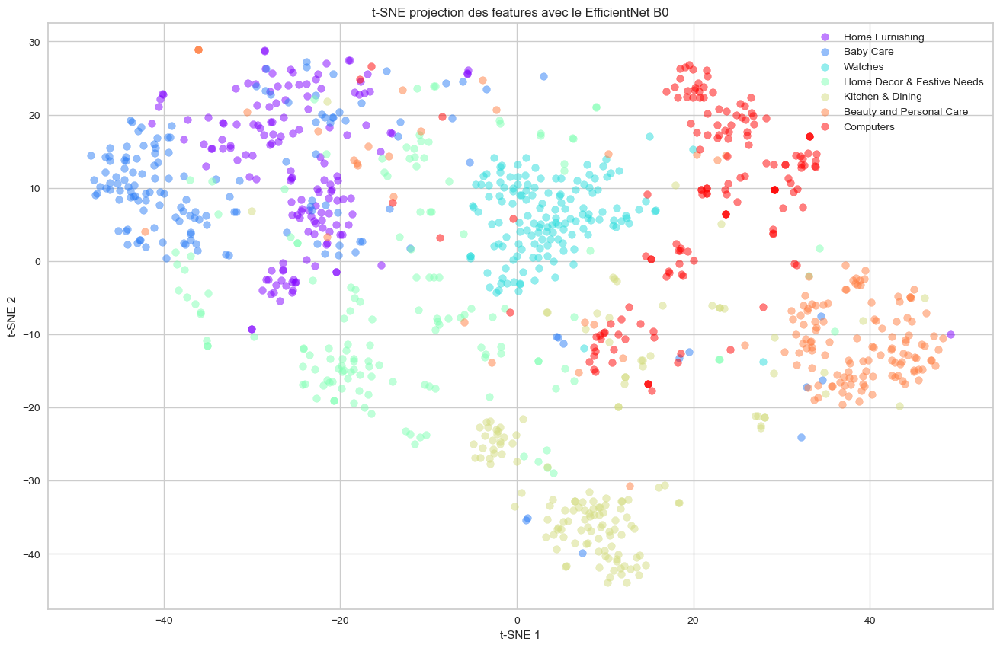

In [17]:
# Lire le DataFrame avec les features extraites
df_b0_tsne = pd.read_csv('df_effb0_with_features.csv')

# Vérifier le nombre de features disponibles dans le DataFrame
features_columns = [col for col in df_b0_tsne.columns if col.startswith('feature_')]
num_features = len(features_columns)
print(f'Number of feature columns: {num_features}')

# Appliquer t-SNE pour réduire les dimensions à 2D
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(df_b0_tsne[features_columns])

# Ajouter les résultats t-SNE au DataFrame
df_b0_tsne['tsne_2d_one'] = tsne_results[:, 0]
df_b0_tsne['tsne_2d_two'] = tsne_results[:, 1]

# Visualisation des résultats t-SNE avec Matplotlib
plt.figure(figsize=(16, 10))
categories = df_b0_tsne['Level_1'].unique()
colors = plt.cm.rainbow(np.linspace(0, 1, len(categories)))

for category, color in zip(categories, colors):
    subset = df_b0_tsne[df_b0_tsne['Level_1'] == category]
    plt.scatter(subset['tsne_2d_one'], subset['tsne_2d_two'], c=[color], label=category, alpha=0.5)

plt.title('t-SNE projection des features avec le EfficientNet B0')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(loc='best')
plt.show()

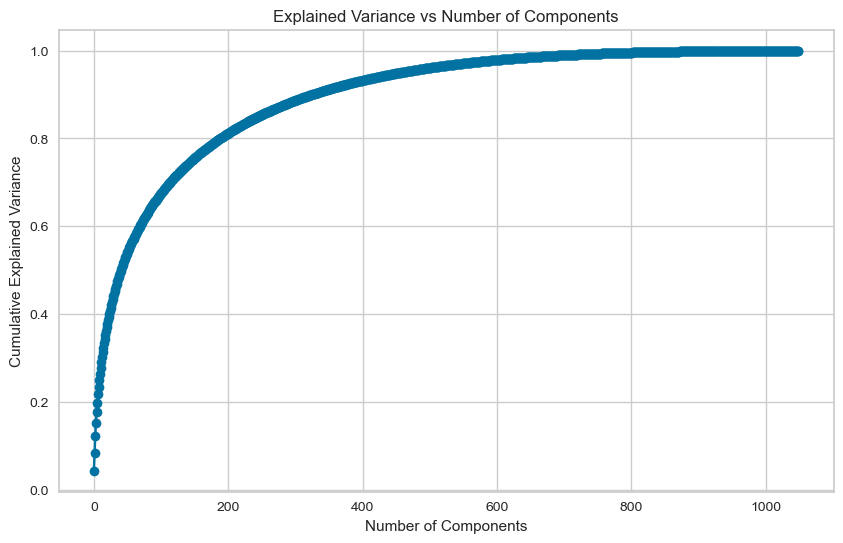

Entrez le seuil de variance à conserver (entre 0 et 1) :  0.98


Nombre de composantes retenues: 608
                                        product_name  \
0  Elegance Polyester Multicolor Abstract Eyelet ...   
1                         Sathiyas Cotton Bath Towel   
2                Eurospa Cotton Terry Face Towel Set   

                                  image          Level_1       PC1       PC2  \
0  55b85ea15a1536d46b7190ad6fff8ce7.jpg  Home Furnishing -0.259930 -5.206437   
1  7b72c92c2f6c40268628ec5f14c6d590.jpg        Baby Care  6.796184  1.702003   
2  64d5d4a258243731dc7bbb1eef49ad74.jpg        Baby Care  5.085978  0.883515   

         PC3       PC4       PC5       PC6       PC7  ...     PC599     PC600  \
0   7.361264  1.702355 -0.163395 -4.915830  9.618637  ... -0.084365  0.333844   
1  10.660210  4.695606 -3.015608 -0.390582  4.731469  ... -0.037026 -0.500017   
2  17.670578  1.572234 -3.362485 -0.181936 -1.291651  ...  0.273005 -0.346646   

      PC601     PC602     PC603     PC604     PC605     PC606     PC607  \
0 -0.139916  0.127

In [23]:
# Lire le DataFrame avec les features extraites
df_effb0 = pd.read_csv('df_effb0_with_features.csv')

# Séparer les colonnes string
string_columns = df_effb0[['product_name', 'image', 'Level_1']]

# Suppression des colonnes 'product_name', 'image' et 'Level_1' pour la PCA
df_cleaned = df_effb0.drop(columns=['product_name', 'image', 'Level_1'])

# Standardisation des données
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_cleaned)

# Application de la PCA pour déterminer le nombre de composantes
pca = PCA().fit(df_scaled)

# Calcul de la variance cumulée
cumulative_variance = pca.explained_variance_ratio_.cumsum()

# Affichage de la variance cumulée pour choisir le seuil
plt.figure(figsize=(10, 6))
plt.plot(cumulative_variance, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance vs Number of Components')
plt.grid(True)
plt.show()

# Demander à l'utilisateur de choisir le seuil de variance
variance_threshold = float(input("Entrez le seuil de variance à conserver (entre 0 et 1) : "))

# Déterminer le nombre de composantes nécessaires pour atteindre le seuil de variance
num_components = next(i for i, total_variance in enumerate(cumulative_variance) if total_variance >= variance_threshold) + 1

# Application de la PCA avec le nombre de composantes sélectionné
pca = PCA(n_components=num_components)
df_pca = pca.fit_transform(df_scaled)

# Création d'un DataFrame pour les résultats de la PCA
df_pca_result = pd.DataFrame(df_pca, columns=[f'PC{i+1}' for i in range(df_pca.shape[1])])

# Ajout des colonnes string au DataFrame final
df_effb0_pca = pd.concat([string_columns.reset_index(drop=True), df_pca_result.reset_index(drop=True)], axis=1)

# Affichage du nombre de composantes retenues
print(f"Nombre de composantes retenues: {num_components}")



In [24]:
# Définition des hyperparamètres pour K-means
n_clusters = 7  
init = 'k-means++' 
n_init = 25  
max_iter = 300  
random_state = 42

# Application de K-means avec les hyperparamètres définis
kmeans = KMeans(n_clusters=n_clusters, init=init, n_init=n_init, max_iter=max_iter, random_state=random_state)
kmeans.fit(df_pca)

# Ajout des labels K-means au DataFrame final
df_effb0_pca['kmeans_label'] = kmeans.labels_

In [25]:
# Évaluation des performances du K-means
df_effb0_pca['Level_1'] = df_effb0_pca['Level_1'].astype('category')

# Liste pour stocker les évaluations
evaluations = []
evaluations_std = []

def fit_and_evaluate(km, X, labels, name=None, n_runs=5):
    name = km.__class__.__name__ if name is None else name

    train_times = []
    scores = defaultdict(list)
    for seed in range(n_runs):
        km.set_params(random_state=seed)
        t0 = time()
        km.fit(X)
        train_times.append(time() - t0)
        scores["Homogeneity"].append(metrics.homogeneity_score(labels, km.labels_))
        scores["Completeness"].append(metrics.completeness_score(labels, km.labels_))
        scores["V-measure"].append(metrics.v_measure_score(labels, km.labels_))
        scores["Adjusted Rand-Index"].append(
            metrics.adjusted_rand_score(labels, km.labels_)
        )
        scores["Silhouette Coefficient"].append(
            metrics.silhouette_score(X, km.labels_, sample_size=2000)
        )
    train_times = np.asarray(train_times)

    print(f"Clustering done in {train_times.mean():.2f} ± {train_times.std():.2f} s ")
    evaluation = {
        "estimator": name,
        "train_time": train_times.mean(),
    }
    evaluation_std = {
        "estimator": name,
        "train_time": train_times.std(),
    }
    for score_name, score_values in scores.items():
        mean_score, std_score = np.mean(score_values), np.std(score_values)
        print(f"{score_name}: {mean_score:.3f} ± {std_score:.3f}")
        evaluation[score_name] = mean_score
        evaluation_std[score_name] = std_score
    evaluations.append(evaluation)
    evaluations_std.append(evaluation_std)

# Application de la fonction d'évaluation
fit_and_evaluate(kmeans, df_pca, df_effb0_pca['Level_1'].cat.codes)

Clustering done in 1.21 ± 0.01 s 
Homogeneity: 0.609 ± 0.007
Completeness: 0.623 ± 0.005
V-measure: 0.616 ± 0.006
Adjusted Rand-Index: 0.550 ± 0.013
Silhouette Coefficient: 0.051 ± 0.002


Nous allons analyser les résultats sur la correspondance labels / clusters sur ce modèle qui présente le meilleur ariscore.

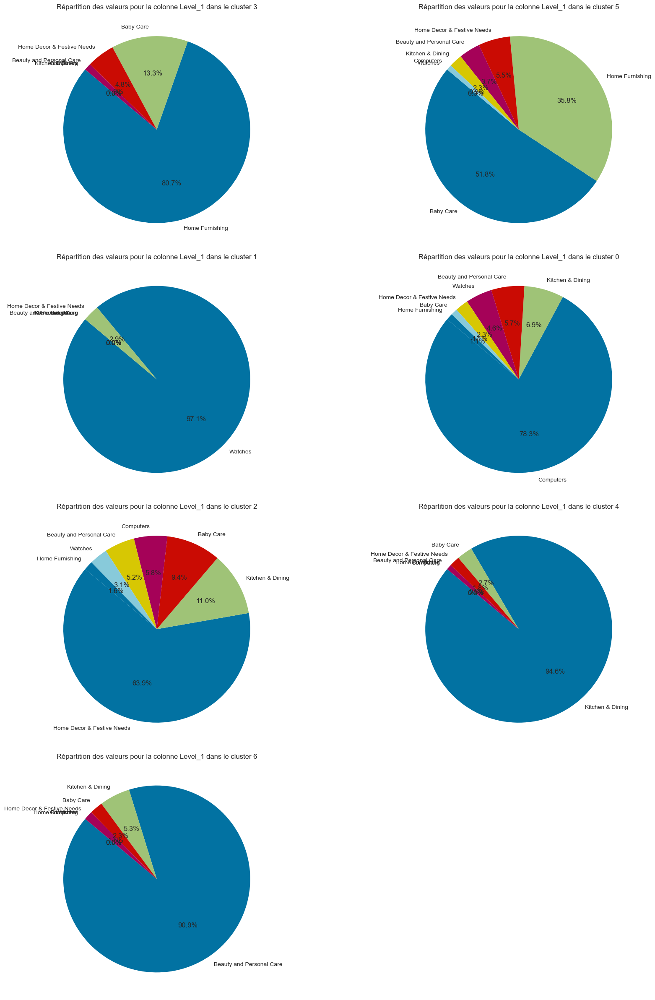

In [26]:
# Obtenir les clusters uniques
clusters = df_effb0_pca['kmeans_label'].unique()

# Définir le nombre de colonnes pour les sous-graphes
num_cols = 2

# Calculer le nombre de lignes nécessaires
num_rows = (len(clusters) + num_cols - 1) // num_cols

# Créer les sous-graphes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(18, num_rows * 6))

# Aplatir les axes pour faciliter l'itération
axes = axes.flatten()

# Tracer un diagramme circulaire pour chaque cluster
for i, cluster in enumerate(clusters):
    cluster_data = df_effb0_pca[df_effb0_pca['kmeans_label'] == cluster]
    level_1_counts = cluster_data['Level_1'].value_counts()
    
    axes[i].pie(level_1_counts, labels=level_1_counts.index, autopct='%1.1f%%', startangle=140)
    axes[i].set_title(f"Répartition des valeurs pour la colonne Level_1 dans le cluster {cluster}")

# Supprimer les axes vides 
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

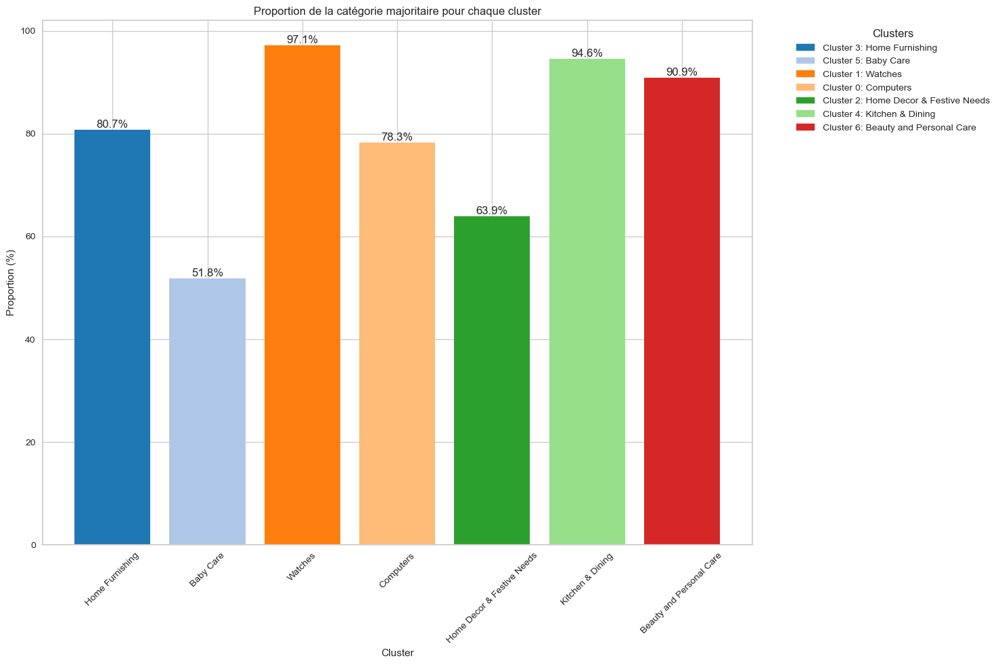

In [27]:
# Obtenir les clusters uniques
clusters = df_effb0_pca['kmeans_label'].unique()

# Initialiser une liste pour stocker les informations
top_categories = []

# Extraire la catégorie la plus représentée et sa proportion pour chaque cluster
for cluster in clusters:
    cluster_data = df_effb0_pca[df_effb0_pca['kmeans_label'] == cluster]
    level_1_counts = cluster_data['Level_1'].value_counts()
    
    # Obtenir la catégorie et la valeur la plus représentée
    top_category = level_1_counts.idxmax()
    top_value = level_1_counts.max()
    total_values = level_1_counts.sum()
    proportion = top_value / total_values * 100
    
    # Ajouter les informations à la liste
    top_categories.append({'Cluster': cluster, 'Top Category': top_category, 'Proportion': proportion})

# Convertir la liste en DataFrame
top_categories_df = pd.DataFrame(top_categories)

# Définir une palette de couleurs
colors = plt.cm.tab20.colors 

# Assigner une couleur à chaque cluster
cluster_colors = {cluster: colors[i % len(colors)] for i, cluster in enumerate(clusters)}

# Tracer l'histogramme des proportions
plt.figure(figsize=(15, 10))
bars = plt.bar(top_categories_df['Cluster'].astype(str), top_categories_df['Proportion'], 
               color=[cluster_colors[cluster] for cluster in top_categories_df['Cluster']], tick_label=top_categories_df['Top Category'])

# Ajouter les étiquettes de valeurs
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.1f}%', ha='center', va='bottom')

# Ajouter la légende avec des descriptions plus complètes
handles = [plt.Rectangle((0,0),1,1, color=cluster_colors[cluster]) for cluster in clusters]
labels = [f'Cluster {cluster}: {top_categories_df[top_categories_df["Cluster"] == cluster]["Top Category"].values[0]}' for cluster in clusters]
plt.legend(handles, labels, title='Clusters', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.xlabel('Cluster')
plt.ylabel('Proportion (%)')
plt.title('Proportion de la catégorie majoritaire pour chaque cluster')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


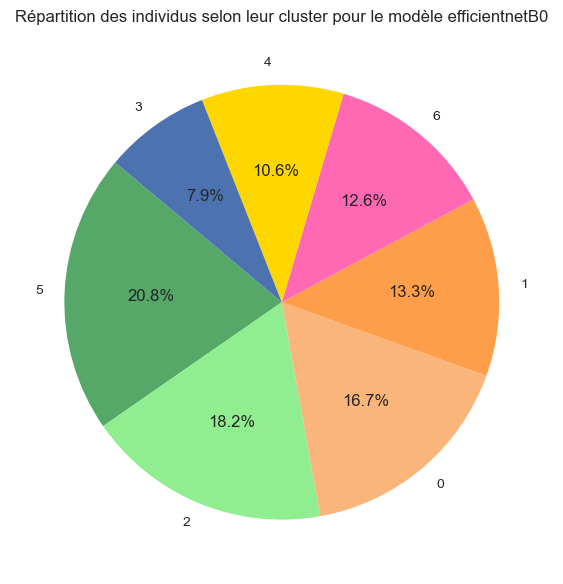

In [33]:
import matplotlib.pyplot as plt

# Calculer la répartition des individus selon leur cluster
cluster_counts = df_effb0_pca['kmeans_label'].value_counts()

# Définir la correspondance des couleurs des clusters selon la légende
cluster_colors = {
    3: '#4C72B0',  # Home Furnishing
    5: '#55A868',  # Baby Care
    1: '#FF9E4A',  # Watches
    0: '#FAB57A',  # Computers
    2: '#90EE90',  # Home Decor & Festive Needs
    4: '#FFD700',  # Kitchen & Dining
    6: '#FF69B4',  # Beauty and Personal Care
}

# Créer un diagramme circulaire avec des couleurs personnalisées
plt.figure(figsize=(10, 6))
plt.pie(cluster_counts, labels=cluster_counts.index, colors=[cluster_colors[cluster] for cluster in cluster_counts.index], autopct='%1.1f%%', startangle=140)
plt.title("Répartition des individus selon leur cluster pour le modèle efficientnetB0")
plt.tight_layout()
plt.show()


### 4. Le EffB7 (ARI = 0.438)

In [8]:
df_effb7 = df[['product_name',
            'image',
            'Level_1']].copy()
df_effb7.head(3)

,product_name,image,Level_1
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care


In [13]:
# Chemin vers le répertoire contenant les images
directory_path = r'C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images'

# Hyperparamètres
learning_rate = 0.001
batch_size = 64
epochs = 30

# Charger le modèle EfficientNetB7 pré-entraîné
base_model = EfficientNetB7(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Ajouter une couche de Global Average Pooling pour l'extraction des features
x = base_model.output
x = GlobalAveragePooling2D()(x)

# Créer le modèle pour l'extraction des features
model = Model(inputs=base_model.input, outputs=x)

# Configuration de l'augmentation des données
datagen = ImageDataGenerator(
    rescale=1.0/255.0,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)


# Fonction pour pré-traiter et extraire les features d'une image
def extract_features(img_path, model):
    try:
        img = image.load_img(img_path, target_size=(224, 224))
        img = image.img_to_array(img)
        img = np.expand_dims(img, axis=0)
        img = preprocess_input(img)  # Pré-traitement spécifique pour EfficientNetB0
        features = model.predict(img)
        print(f"Features shape for {img_path}: {features.shape}") 
        return features.flatten()
    except Exception as e:
        print(f"Erreur lors du traitement de l'image {img_path}: {str(e)}")
        return None

# Initialiser une liste pour stocker les features et les noms des images
all_features = []
image_names = []

# Vérifiez si 'image' est dans les colonnes
if 'image' not in df_effb7.columns:
    raise ValueError("Le DataFrame df_effb0 ne contient pas de colonne 'image'. Veuillez vérifier le DataFrame d'entrée.")

# Extraction des features avec une barre de progression
progress_bar = tqdm(total=len(df_effb7), desc='Extraction des features')
for img_name in df_effb7['image']:
    img_path = os.path.join(directory_path, img_name)
    if os.path.isfile(img_path):
        features = extract_features(img_path, model)
        if features is not None:
            all_features.append(features)
            image_names.append(img_name)
    progress_bar.update(1)
progress_bar.close()

# Vérifier que all_features n'est pas vide avant de créer le DataFrame
if all_features:
    feature_dimension = len(all_features[0])
    features_df = pd.DataFrame(all_features, columns=[f'feature_{i}' for i in range(feature_dimension)])
    features_df['image'] = image_names

    # Fusionner les features avec le DataFrame d'origine
    df_effb7 = pd.merge(df_effb7, features_df, on='image', how='left')

    # Afficher les premières lignes du DataFrame pour vérifier
    #print(df_effb0.head())

    # Enregistrer le DataFrame avec les features dans un fichier CSV
    df_effb7.to_csv('df_effb7_with_features.csv', index=False)
else:
    print("Aucune feature extraite. Vérifiez le processus d'extraction.")

Extraction des features:   0%|          | 0/1050 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 20s 20s/step


Extraction des features:   0%|          | 1/1050 [00:20<5:54:00, 20.25s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55b85ea15a1536d46b7190ad6fff8ce7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


Extraction des features:   0%|          | 2/1050 [00:20<2:31:44,  8.69s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b72c92c2f6c40268628ec5f14c6d590.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


Extraction des features:   0%|          | 3/1050 [00:21<1:26:24,  4.95s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64d5d4a258243731dc7bbb1eef49ad74.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


Extraction des features:   0%|          | 4/1050 [00:21<55:43,  3.20s/it]  

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d4684dcdc759dd9cdf41504698d737d8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


Extraction des features:   0%|          | 5/1050 [00:22<39:01,  2.24s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6325b6870c54cd47be6ebfbffa620ec7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


Extraction des features:   1%|          | 6/1050 [00:22<28:18,  1.63s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\893aa5ed55f7cff2eccea7758d7a86bd.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:   1%|          | 7/1050 [00:23<21:47,  1.25s/it]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f355cc1ccb08bd0d283ed979b7ee7515.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


Extraction des features:   1%|          | 8/1050 [00:23<17:01,  1.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd0e3470a7e6ed76fd69c2da27721041.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


Extraction des features:   1%|          | 9/1050 [00:24<13:43,  1.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41384da51732c0b4df3de8f395714fbb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


Extraction des features:   1%|          | 10/1050 [00:24<11:51,  1.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\710ed5f2393a4b9e8823aa0029f71f93.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


Extraction des features:   1%|          | 11/1050 [00:25<10:52,  1.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\920154acbe49d3202ed7d2ed2df1ea13.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


Extraction des features:   1%|          | 12/1050 [00:25<10:15,  1.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08452abdadb3db1e686b94a9c52fc7b6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:   1%|          | 13/1050 [00:26<09:41,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1e8741b5ae27a513546c94b3f3312aee.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:   1%|▏         | 14/1050 [00:26<09:13,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\189fa66a5fa6f08d2802a62ecf0be298.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


Extraction des features:   1%|▏         | 15/1050 [00:27<09:15,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bbb8cdc5406ff60ff06ff64630f2ca47.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


Extraction des features:   2%|▏         | 16/1050 [00:27<08:53,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1120bc768623572513df956172ffefeb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


Extraction des features:   2%|▏         | 17/1050 [00:27<08:37,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5479bb7028827d60000720a2c135976a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


Extraction des features:   2%|▏         | 18/1050 [00:28<08:29,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\733aa1e801a139fa8dc7be9f0eff5ee0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


Extraction des features:   2%|▏         | 19/1050 [00:28<08:22,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62c35de4df27437d3597963fac55a8b6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


Extraction des features:   2%|▏         | 20/1050 [00:29<08:26,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\33d97d63c037078cd3f08033966d6a88.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:   2%|▏         | 21/1050 [00:29<08:19,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d7ca2b06b4f4d3b98c61c377b18a2d6b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Extraction des features:   2%|▏         | 22/1050 [00:30<07:58,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f74476ba64365d97a5be7d375cbf4c7a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


Extraction des features:   2%|▏         | 23/1050 [00:30<08:03,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda50982a672ef8835de5c1cc86f8bfc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


Extraction des features:   2%|▏         | 24/1050 [00:31<08:01,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4788f5466992da09024b8ffcc8a5cba4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


Extraction des features:   2%|▏         | 25/1050 [00:31<08:07,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\653826cd53f1d9e2c086c0ac7846ef70.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


Extraction des features:   2%|▏         | 26/1050 [00:32<08:05,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c74db45cbfc14a78b8466dca494b3bb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


Extraction des features:   3%|▎         | 27/1050 [00:32<08:23,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4aa047f14885c74f155ce5f973e14dff.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


Extraction des features:   3%|▎         | 28/1050 [00:33<08:35,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c4fec2331da8d40f2cb146eb198cb57.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step


Extraction des features:   3%|▎         | 29/1050 [00:33<08:54,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b52073e7ed9c00c4108cae4eb0c49c1a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step


Extraction des features:   3%|▎         | 30/1050 [00:34<09:04,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee8d9ff65e0fe4278afce7c933d30941.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


Extraction des features:   3%|▎         | 31/1050 [00:34<09:06,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\788dc3a3da91c0f46a7c465e07f91dd4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step


Extraction des features:   3%|▎         | 32/1050 [00:35<09:34,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29b1ca231e10d5269516b80bf9d0dffc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


Extraction des features:   3%|▎         | 33/1050 [00:36<09:28,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8b268c1e68f198ae2e934717d49f48e9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step


Extraction des features:   3%|▎         | 34/1050 [00:36<09:48,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b85f8843bb1c297dd5712f0bd287006d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


Extraction des features:   3%|▎         | 35/1050 [00:37<09:46,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4b09aa7927c59fbb39960b3d7919909.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


Extraction des features:   3%|▎         | 36/1050 [00:37<09:43,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\81e739c7f3be737152f2e6f520e3494b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


Extraction des features:   4%|▎         | 37/1050 [00:38<09:05,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0938b0d88eac91deee6d5add54097d3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


Extraction des features:   4%|▎         | 38/1050 [00:38<08:27,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e9420e9483f16db81c64dddf99f34841.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:   4%|▎         | 39/1050 [00:39<08:00,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a3dea07b2f7bf48276d32513091be717.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:   4%|▍         | 40/1050 [00:39<07:44,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66191b4a311b5d9babfc00a71ef97c5b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


Extraction des features:   4%|▍         | 41/1050 [00:40<07:34,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90e56526f4c5892beac49f262b85150a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


Extraction des features:   4%|▍         | 42/1050 [00:40<07:41,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a79117ea49a0533f641facdb4c99f502.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


Extraction des features:   4%|▍         | 43/1050 [00:41<07:47,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5325213d84c80ad310b6e4b37a1ac824.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


Extraction des features:   4%|▍         | 44/1050 [00:41<07:52,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2d50e4c6ccf8befe9335ac8f97a11712.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


Extraction des features:   4%|▍         | 45/1050 [00:41<08:00,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8050d31bffe6827c804b8222338aafb2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


Extraction des features:   4%|▍         | 46/1050 [00:42<07:53,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\493d1eb6ad7a48a926092bf994cd0bb0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


Extraction des features:   4%|▍         | 47/1050 [00:42<08:13,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3388d05e88972ff9f3e1321dc0cfdc28.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


Extraction des features:   5%|▍         | 48/1050 [00:43<08:29,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d1899ab1d5c79ddaa311bc9f04d198ed.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


Extraction des features:   5%|▍         | 49/1050 [00:44<08:41,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e7cab08a267e815c72a26513222783e0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


Extraction des features:   5%|▍         | 50/1050 [00:44<08:53,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02a53d335775b652f22f41b529b9d646.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:   5%|▍         | 51/1050 [00:45<08:52,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\69446af66066146718cd569f87e99fff.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step


Extraction des features:   5%|▍         | 52/1050 [00:45<09:02,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4d35b6536b623c83b293eb3a1c02bba.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


Extraction des features:   5%|▌         | 53/1050 [00:46<09:13,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f01140c02fd09e5c56312a64fa8db3da.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


Extraction des features:   5%|▌         | 54/1050 [00:46<09:13,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6329ddb46087cb8c09ced95471dd9643.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


Extraction des features:   5%|▌         | 55/1050 [00:47<08:55,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e6ae1b372e8e0b509b83ba3658b8107.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


Extraction des features:   5%|▌         | 56/1050 [00:47<08:59,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e2ae2af58ac50adf4881751ae84a9d8a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


Extraction des features:   5%|▌         | 57/1050 [00:48<09:07,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\24e85c590481a7cedfe66597f253f2b2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


Extraction des features:   6%|▌         | 58/1050 [00:49<08:59,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5e84d36ad6db970548498829db8b15de.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step


Extraction des features:   6%|▌         | 59/1050 [00:49<08:53,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c4604dba348a99a2dfbbc2cd3928101.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


Extraction des features:   6%|▌         | 60/1050 [00:50<08:54,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0abfcbe0e17dd50c4cf5fb1d6037d514.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


Extraction des features:   6%|▌         | 61/1050 [00:50<08:55,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4a1b23dacd7d2a9ec7414f7159f25a48.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


Extraction des features:   6%|▌         | 62/1050 [00:51<08:51,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95330f6f0f44d17b918feec36bedcdef.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


Extraction des features:   6%|▌         | 63/1050 [00:51<09:05,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66a5a21ea332aefcc7b90dbad94053aa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 433ms/step


Extraction des features:   6%|▌         | 64/1050 [00:52<09:11,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f4e7f269319ba9cf5507a9e2febacbf5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


Extraction des features:   6%|▌         | 65/1050 [00:52<09:10,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\80e9cb3d2d7f9ff7bc497c34df366d03.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step


Extraction des features:   6%|▋         | 66/1050 [00:53<09:15,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2baa415ebcc4fe563ce13b50e60efc1c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


Extraction des features:   6%|▋         | 67/1050 [00:53<09:00,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\903d63e2b71d692ccd628e1de516516e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:   6%|▋         | 68/1050 [00:54<08:24,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\707b160df4c4dece6cde52b222ce624b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


Extraction des features:   7%|▋         | 69/1050 [00:54<08:24,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed9817e8960a6a0d509061c54cfe5ac1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:   7%|▋         | 70/1050 [00:55<08:30,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a7a1287fef0d986a5e237797beee286.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


Extraction des features:   7%|▋         | 71/1050 [00:55<07:58,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ba898ecb77ab5a6799c8b047c6b6008.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


Extraction des features:   7%|▋         | 72/1050 [00:56<07:58,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2658bad8c2b7d5b08984c6ac34267f7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


Extraction des features:   7%|▋         | 73/1050 [00:56<08:03,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\afc3ebd18df498dd87abb7ad7536b5c7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step


Extraction des features:   7%|▋         | 74/1050 [00:57<08:26,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\141d2b743c477043041faddf9233c8ad.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


Extraction des features:   7%|▋         | 75/1050 [00:57<08:21,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7a3f11f380a1bf85338ab3771ff81e9f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


Extraction des features:   7%|▋         | 76/1050 [00:58<08:12,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae45b64d808a883aa35f2bf4de879cac.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


Extraction des features:   7%|▋         | 77/1050 [00:58<08:23,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1971dcd2f3058a4c87bdd7d87d4baeba.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step


Extraction des features:   7%|▋         | 78/1050 [00:59<08:37,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4942e0a9c0527dc00319a39fc8f103e6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


Extraction des features:   8%|▊         | 79/1050 [01:00<10:04,  1.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0a8a1e9c6659361c0c2b247f8a6471d0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


Extraction des features:   8%|▊         | 80/1050 [01:00<09:40,  1.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\320833ab08c9a94ef83520612899a85f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


Extraction des features:   8%|▊         | 81/1050 [01:01<09:24,  1.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\57578c1e6ec61a880a6f3f971f5f77b8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


Extraction des features:   8%|▊         | 82/1050 [01:02<09:37,  1.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e130ed339dcfe20d2c8b66892278a94.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


Extraction des features:   8%|▊         | 83/1050 [01:02<08:42,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\601817defaff9d0e30e1b72f96d3975f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


Extraction des features:   8%|▊         | 84/1050 [01:03<08:59,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3cdfd9df09f61a8fd178bafcc8dbed31.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step


Extraction des features:   8%|▊         | 85/1050 [01:03<09:22,  1.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\374e63028d691c380bc43b0dc60e460d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step


Extraction des features:   8%|▊         | 86/1050 [01:04<09:05,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\61c0139f3d5c97f1615797dbf046cc0c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


Extraction des features:   8%|▊         | 87/1050 [01:04<08:28,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0096e89cc25a8b96fb9808716406fe94.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


Extraction des features:   8%|▊         | 88/1050 [01:05<07:58,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e8ee7868b0c3d1d04b482cd4f3ec5ccc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:   8%|▊         | 89/1050 [01:05<07:29,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\04f9ff160a1561e3656350f4bd6b8c50.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


Extraction des features:   9%|▊         | 90/1050 [01:06<07:40,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aebf3a2172b33ef09acb472009967812.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


Extraction des features:   9%|▊         | 91/1050 [01:06<07:52,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ae332e2bafd23267caedfcc4453257c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:   9%|▉         | 92/1050 [01:07<07:53,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\57800d48b001f3fad34a4f8fa9207f29.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


Extraction des features:   9%|▉         | 93/1050 [01:07<08:02,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d1e18b4a3aafb0040da2111c8b8ce2e5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step


Extraction des features:   9%|▉         | 94/1050 [01:08<08:28,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46e6853da6b0c796b7a0d8203ceaa88e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step


Extraction des features:   9%|▉         | 95/1050 [01:08<08:49,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22296bfc1c79d9dc88eabbd01220ef0c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


Extraction des features:   9%|▉         | 96/1050 [01:09<08:40,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f4d4c2eec77732f56e47722d7a355f2b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


Extraction des features:   9%|▉         | 97/1050 [01:09<08:23,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f12a06b7dbfc55638afafcf8bb03d836.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


Extraction des features:   9%|▉         | 98/1050 [01:10<07:46,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\18bd9b88e23b82fd19f8ab0c9cad6a1a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


Extraction des features:   9%|▉         | 99/1050 [01:10<07:23,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5749bae8ccead7997ebf370b6b081d07.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  10%|▉         | 100/1050 [01:11<07:19,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\059493eeb88ebb4cc08d1522f3f87c3f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


Extraction des features:  10%|▉         | 101/1050 [01:11<07:07,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9613f2f1e65fb1fc7e181e7f83c217da.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  10%|▉         | 102/1050 [01:11<06:58,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7fcd0d983a51283e58b806f065cc920.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step


Extraction des features:  10%|▉         | 103/1050 [01:12<08:09,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b78586222de9a1095d0a9d88455ee75f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


Extraction des features:  10%|▉         | 104/1050 [01:13<08:25,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dfbd96036cbc28566e964cff04b5b3a8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


Extraction des features:  10%|█         | 105/1050 [01:13<08:18,  1.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\336fc49639a5cc45aa532ace3ee1a044.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


Extraction des features:  10%|█         | 106/1050 [01:14<09:16,  1.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\789cf5578f48577a44586fca3adc35d0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


Extraction des features:  10%|█         | 107/1050 [01:14<08:46,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\184ecf07ca4e2872eaf53d2344a1e783.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


Extraction des features:  10%|█         | 108/1050 [01:15<08:23,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b515014adccb1fdf5ff1e2c4a8ff9ea6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


Extraction des features:  10%|█         | 109/1050 [01:16<08:41,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5aacf8f5154afea2ac22fc767d072677.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  10%|█         | 110/1050 [01:16<08:11,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cbbe686c4a233e8cf53528748f75223.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


Extraction des features:  11%|█         | 111/1050 [01:17<08:17,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f1ee63a5f0db853e2c1b377778580d39.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


Extraction des features:  11%|█         | 112/1050 [01:17<08:21,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0bb0f7b7a3075f4b9459121abe2185fa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


Extraction des features:  11%|█         | 113/1050 [01:18<08:10,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8015db34d09642b046c775e8157dd729.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


Extraction des features:  11%|█         | 114/1050 [01:18<07:58,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ddc40c08d9a9bafc4d14eddd98db7c0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


Extraction des features:  11%|█         | 115/1050 [01:18<07:45,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc784846bd59a16832454416ac708003.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


Extraction des features:  11%|█         | 116/1050 [01:19<07:59,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e8f5dc78f80eff3c77a9714303f59d2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


Extraction des features:  11%|█         | 117/1050 [01:20<08:09,  1.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53f4bc7d7321f5c41de6b86e41f13e80.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 524ms/step


Extraction des features:  11%|█         | 118/1050 [01:20<08:53,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be09f5a3a88ac10ae14c791fc8ac0dae.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


Extraction des features:  11%|█▏        | 119/1050 [01:21<08:41,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d202ea988ab11f2327279093ac71975d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


Extraction des features:  11%|█▏        | 120/1050 [01:21<08:08,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\db6c79a1d852944a89e157793f392d67.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


Extraction des features:  12%|█▏        | 121/1050 [01:22<07:50,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\16c18ce0affca13159e362227c83683c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


Extraction des features:  12%|█▏        | 122/1050 [01:22<07:55,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7dd5e83e2108a97659577e50879f9d9f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


Extraction des features:  12%|█▏        | 123/1050 [01:23<07:31,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a63eecfbb02004863fa1f29a0b8105fc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  12%|█▏        | 124/1050 [01:23<07:53,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c77aa1fc09901ae07c392c152a70e41.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  12%|█▏        | 125/1050 [01:24<08:25,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\640fd08bb3ba538d67a5c0c2c61a5c4c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


Extraction des features:  12%|█▏        | 126/1050 [01:24<08:02,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7241df1acae1fac892c692097ea3fb98.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  12%|█▏        | 127/1050 [01:25<07:40,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a85a7dbd31267a7b02eda3a4d484632d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


Extraction des features:  12%|█▏        | 128/1050 [01:25<07:41,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\13de17e59a92f8bcaec8bf103bbff8c1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  12%|█▏        | 129/1050 [01:26<07:11,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ba13df7877fd979d64c87c7586a5ca6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


Extraction des features:  12%|█▏        | 130/1050 [01:26<06:52,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f1484a63c0dc79e96c98b2a250380ed8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:  12%|█▏        | 131/1050 [01:26<06:39,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f01ff0a82401117e9da22dd680fd2f36.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


Extraction des features:  13%|█▎        | 132/1050 [01:27<06:32,  2.34it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de911421573d3e234450040374b55b38.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  13%|█▎        | 133/1050 [01:27<06:30,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\614dbfa2f42c4684c0bb6152091113a6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features:  13%|█▎        | 134/1050 [01:28<06:20,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5531b9f454e2d75cfe00c3f795e06de5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


Extraction des features:  13%|█▎        | 135/1050 [01:28<06:46,  2.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\258444ac7bb7ad8026800efad5c3502b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


Extraction des features:  13%|█▎        | 136/1050 [01:29<06:43,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd369a1bb58ae02cd925dda7e9e1d00a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


Extraction des features:  13%|█▎        | 137/1050 [01:29<06:54,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73f460cd6f3fd206902d7097a1816405.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


Extraction des features:  13%|█▎        | 138/1050 [01:30<06:52,  2.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0d3e1dc0d38be59e9927e47f152e48aa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step


Extraction des features:  13%|█▎        | 139/1050 [01:30<07:24,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\118b411bf265538461b084ce7abd55a8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


Extraction des features:  13%|█▎        | 140/1050 [01:31<07:17,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06749cbff1487f470438823f6952cfd1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


Extraction des features:  13%|█▎        | 141/1050 [01:31<07:27,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\202fc276e672eb8c29891aa50aef0771.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


Extraction des features:  14%|█▎        | 142/1050 [01:32<07:28,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\feefbdff924dd6b7cc266449c9a36d69.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step


Extraction des features:  14%|█▎        | 143/1050 [01:32<07:52,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\af1ac46194b5488048c459102a16a57e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


Extraction des features:  14%|█▎        | 144/1050 [01:33<07:39,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1fd886094826c3f25c6ffb380073974.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


Extraction des features:  14%|█▍        | 145/1050 [01:33<07:30,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3847353a4b8de1efc504d589aea74ffe.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step


Extraction des features:  14%|█▍        | 146/1050 [01:34<08:02,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60efd61370e70267dc60b11ff2bf974c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step


Extraction des features:  14%|█▍        | 147/1050 [01:34<08:18,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63bc43c0000e71eb11bfafd2f46214a4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step


Extraction des features:  14%|█▍        | 148/1050 [01:35<08:30,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8794f7a06b530782c66f7c0911bb437.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:  14%|█▍        | 149/1050 [01:35<08:09,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8507eb0ef32c1c0db700f20aad6d9bcd.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


Extraction des features:  14%|█▍        | 150/1050 [01:36<08:10,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc7abdf67b4d7dbf64dffbab7b37599c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


Extraction des features:  14%|█▍        | 151/1050 [01:37<08:02,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1afa5f2c3c9b4b43def6dc2e695d2c87.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


Extraction des features:  14%|█▍        | 152/1050 [01:37<08:05,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73503fe89ea77420a598f4a1019e5b6d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


Extraction des features:  15%|█▍        | 153/1050 [01:38<08:19,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ec590694e8bf85f75c9200cf418127aa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


Extraction des features:  15%|█▍        | 154/1050 [01:38<08:24,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7956d9586de3e25ff586bca58be7195e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


Extraction des features:  15%|█▍        | 155/1050 [01:39<08:03,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63f6ef8f3fda2c306b27cfbf5a005f1e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step


Extraction des features:  15%|█▍        | 156/1050 [01:39<08:20,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\328b66226952d8733c0c48295fae1108.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


Extraction des features:  15%|█▍        | 157/1050 [01:40<08:26,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6efd5d260667b94f04edbbd18bb300b9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step


Extraction des features:  15%|█▌        | 158/1050 [01:40<08:24,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\beaa6285a2b9c66db0e294767711ca3f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


Extraction des features:  15%|█▌        | 159/1050 [01:41<08:19,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41fd5af61752be98b19b611a6ff9a0ef.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


Extraction des features:  15%|█▌        | 160/1050 [01:42<07:54,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\219b24362655097cb41bf06a0be8ee79.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


Extraction des features:  15%|█▌        | 161/1050 [01:42<07:21,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5d1b8ef70b1ce27726f7f6c2f373e56.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


Extraction des features:  15%|█▌        | 162/1050 [01:42<06:57,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\69515ea06da8b2b1c881ce34fbf6575a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step


Extraction des features:  16%|█▌        | 163/1050 [01:43<06:42,  2.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02127f52e96fb72c66bf081d25104ef8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  16%|█▌        | 164/1050 [01:43<06:34,  2.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c4581cae6bf751a7ae5c40bb16b74e98.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


Extraction des features:  16%|█▌        | 165/1050 [01:44<06:22,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8f42da0f9f695f07067676eae4135c8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step


Extraction des features:  16%|█▌        | 166/1050 [01:44<07:04,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\785b4383b12106dd172306d427d8f7b2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


Extraction des features:  16%|█▌        | 167/1050 [01:45<06:49,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d19d17140fdd9adc09ba6e2ad1e1ebb9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


Extraction des features:  16%|█▌        | 168/1050 [01:45<07:11,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aadbc3b9c32c4535b1bfee7321c4c0e7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:  16%|█▌        | 169/1050 [01:46<07:00,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea16e13a7cf16d8665d1bc44738dfa88.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


Extraction des features:  16%|█▌        | 170/1050 [01:46<07:01,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a341f915962ee99754e962520f279708.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


Extraction des features:  16%|█▋        | 171/1050 [01:47<07:24,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9077acd25761ea067ac6d9369d8fdf16.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


Extraction des features:  16%|█▋        | 172/1050 [01:47<07:17,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cab75cad4b3a3c593c753a1759df28e2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step


Extraction des features:  16%|█▋        | 173/1050 [01:48<07:53,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5590e238d44b370337624f5987fb9b8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step


Extraction des features:  17%|█▋        | 174/1050 [01:48<08:17,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b043b37c38f081d96886acb5acfbdf5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


Extraction des features:  17%|█▋        | 175/1050 [01:49<08:20,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b92e13d5ef945d086fd4f42b95bc04ac.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step


Extraction des features:  17%|█▋        | 176/1050 [01:50<08:33,  1.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22ea3b69860bc9a5e0c69b87db2dcdab.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step


Extraction des features:  17%|█▋        | 177/1050 [01:50<08:46,  1.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\154920adb9d584b55d419227f9b01cc6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step


Extraction des features:  17%|█▋        | 178/1050 [01:51<08:47,  1.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5dbf978ab2cf9d2da6446d3e4595f690.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


Extraction des features:  17%|█▋        | 179/1050 [01:51<08:52,  1.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7ef3e6ec248f17f3a6a4697120ddb96.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


Extraction des features:  17%|█▋        | 180/1050 [01:53<11:18,  1.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aab46b84f70cc6774afaafe1d6035de3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 522ms/step


Extraction des features:  17%|█▋        | 181/1050 [01:53<10:51,  1.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\58d7fbbe6d306ecf16e0a7ac05b211d4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step


Extraction des features:  17%|█▋        | 182/1050 [01:54<10:15,  1.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59af3731b809a25f2bf99e99f645d8dd.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


Extraction des features:  17%|█▋        | 183/1050 [01:55<09:37,  1.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3c4ca34c50a5437a1bcc42b72fc1351f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


Extraction des features:  18%|█▊        | 184/1050 [01:55<09:08,  1.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3830dda3491cd5b28ed42ae544bc44f0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step


Extraction des features:  18%|█▊        | 185/1050 [01:56<09:06,  1.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f712e172ee77a913b6d627657986b72.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


Extraction des features:  18%|█▊        | 186/1050 [01:56<08:26,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6da53319cc12c9729881f5478ff67223.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


Extraction des features:  18%|█▊        | 187/1050 [01:57<07:52,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8bf65b132179faf26f61e26274b2b819.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


Extraction des features:  18%|█▊        | 188/1050 [01:57<07:42,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f69bef5db54cb4c83b2aa8d0ce829d4e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step


Extraction des features:  18%|█▊        | 189/1050 [01:58<07:11,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ffbf3794aa8cb6bb8d3f313d0a549a09.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:  18%|█▊        | 190/1050 [01:58<06:53,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\acd2f21d63ac0bbed4d52e6010d9460b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  18%|█▊        | 191/1050 [01:58<06:37,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b46d7b8e6826ad4c8b40a991da0f54d7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


Extraction des features:  18%|█▊        | 192/1050 [01:59<06:28,  2.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce2f67c3365846170cb709784d87e45b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


Extraction des features:  18%|█▊        | 193/1050 [01:59<06:18,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4ccd4c315d99edd7c00d015b714485a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


Extraction des features:  18%|█▊        | 194/1050 [02:00<06:20,  2.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\302c95f6eae5f4ce217fcedc4ef91262.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


Extraction des features:  19%|█▊        | 195/1050 [02:00<06:31,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f756aa2ceb1efda609c428a47308758.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


Extraction des features:  19%|█▊        | 196/1050 [02:01<06:30,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e3586dc60df258c5478446d65a317d2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


Extraction des features:  19%|█▉        | 197/1050 [02:01<06:32,  2.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40829ac110f344ef35f1c8c32fb311c7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  19%|█▉        | 198/1050 [02:02<06:31,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3c741a05c82c54343b94ed8c1292e2a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


Extraction des features:  19%|█▉        | 199/1050 [02:02<06:41,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d75705ad163412347cba51f882e9c0f0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


Extraction des features:  19%|█▉        | 200/1050 [02:03<06:48,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90f86ac4065397340e8012261577c220.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step


Extraction des features:  19%|█▉        | 201/1050 [02:03<07:01,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\168618e93387ad7171d4e4e1eeff9d1a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


Extraction des features:  19%|█▉        | 202/1050 [02:04<07:01,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c4ab8ab059c912090c83cb0818e7f1c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step


Extraction des features:  19%|█▉        | 203/1050 [02:05<09:11,  1.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70578f48cc96bbb60d040e08025e521d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


Extraction des features:  19%|█▉        | 204/1050 [02:05<08:41,  1.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5b378b0925d5409b5d84ceb416fc2afc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


Extraction des features:  20%|█▉        | 205/1050 [02:06<08:15,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6775e3b91baa4d368f6d91eb7c24578b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step


Extraction des features:  20%|█▉        | 206/1050 [02:06<08:05,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c109187e7975ee8fdb2b3dfbdd9dce20.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


Extraction des features:  20%|█▉        | 207/1050 [02:07<07:55,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8962b50b699ddf4712ad18d29c6a3862.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


Extraction des features:  20%|█▉        | 208/1050 [02:07<07:47,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4d9e71172f619f8e3122e34bb0bf3cc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


Extraction des features:  20%|█▉        | 209/1050 [02:08<07:37,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55ce1309b69e1912d2fd60a3ee3f351b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


Extraction des features:  20%|██        | 210/1050 [02:08<07:19,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a9b35b94610a3d7f4fa91f19693c5248.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


Extraction des features:  20%|██        | 211/1050 [02:09<07:15,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3113367c72125a3355af42426fe14f17.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


Extraction des features:  20%|██        | 212/1050 [02:09<07:08,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e99d9abb115a9bd580bcccf9ff4d4881.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


Extraction des features:  20%|██        | 213/1050 [02:10<07:04,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de29bf3288345e23b0e25345a3a057fb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


Extraction des features:  20%|██        | 214/1050 [02:10<07:10,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3e7c584f317d1b5d6ac0088c411565e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  20%|██        | 215/1050 [02:11<06:46,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d279c825ba12804c337f883b366a6e2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


Extraction des features:  21%|██        | 216/1050 [02:11<06:23,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91a5328e7235424885d271dfa0959eeb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


Extraction des features:  21%|██        | 217/1050 [02:12<06:25,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2110699b945ae766c8b8112038ac58b9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


Extraction des features:  21%|██        | 218/1050 [02:12<06:41,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\198dbe7be6f84f6448197148d7b5e5a5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  21%|██        | 219/1050 [02:13<07:38,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce02ab514e4c623dcf7acd7182a7762d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


Extraction des features:  21%|██        | 220/1050 [02:13<07:30,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2ede595489db33a036d135ce22645515.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:  21%|██        | 221/1050 [02:14<06:59,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32cf0691248297655e2c1728b12e2262.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


Extraction des features:  21%|██        | 222/1050 [02:14<06:35,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\81a695f80d3f5c445910d310f1a83eb8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  21%|██        | 223/1050 [02:15<06:20,  2.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\922a04084481d4b3275a3f7bb54e90f3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  21%|██▏       | 224/1050 [02:15<06:00,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2751cf0dd59d223cacbc5da5df42a1a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


Extraction des features:  21%|██▏       | 225/1050 [02:15<05:51,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc2e2bb105a5c2b2e43842886d057b81.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


Extraction des features:  22%|██▏       | 226/1050 [02:16<06:05,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\67d6b4a8aa19d57740b0440365b77624.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


Extraction des features:  22%|██▏       | 227/1050 [02:16<06:26,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f39a2cce8929f5b44087d688995994e4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


Extraction des features:  22%|██▏       | 228/1050 [02:17<06:36,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4451f1b01168b6a085738d0b0f2f02aa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:  22%|██▏       | 229/1050 [02:17<06:33,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f76aaed44b540869da862c5dd4b266f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


Extraction des features:  22%|██▏       | 230/1050 [02:18<06:50,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\caabe6014b914fe2874a9a8d7284f79b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


Extraction des features:  22%|██▏       | 231/1050 [02:19<07:06,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\968a2b3be84193e3f755c2fe71033a2c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


Extraction des features:  22%|██▏       | 232/1050 [02:19<07:11,  1.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8c1b5fb422d8418dc9e40a43fece55a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


Extraction des features:  22%|██▏       | 233/1050 [02:20<07:09,  1.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4642d967bc34a36454b281de632f6c11.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step


Extraction des features:  22%|██▏       | 234/1050 [02:20<07:15,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\34d3b2b8d263294107a3ffc69b35ff8f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step


Extraction des features:  22%|██▏       | 235/1050 [02:21<07:14,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed139e0d1b5c973495e1aa35dd4a5533.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


Extraction des features:  22%|██▏       | 236/1050 [02:21<07:22,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1e133cbe616bee3b3e9e6f4f0882e3d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


Extraction des features:  23%|██▎       | 237/1050 [02:22<07:24,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf2ba696547459733c6bbfad4e3bcf62.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


Extraction des features:  23%|██▎       | 238/1050 [02:22<07:19,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be0e65c6d8c2cc8cb913b36aa4168cf0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 443ms/step


Extraction des features:  23%|██▎       | 239/1050 [02:23<08:50,  1.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e8df36b35d22cf219cf8bae6c2af752.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step


Extraction des features:  23%|██▎       | 240/1050 [02:24<08:12,  1.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8f41774c16a931d71fcf01f8fee171e0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


Extraction des features:  23%|██▎       | 241/1050 [02:24<07:53,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e4c1d31e279a700c6b8e66d820e8601.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


Extraction des features:  23%|██▎       | 242/1050 [02:25<07:48,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1357e9d24661c3b5797aa1016e0c3be1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step


Extraction des features:  23%|██▎       | 243/1050 [02:25<07:44,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\799ddb97164ff2d5d53bb8b27b8c355f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


Extraction des features:  23%|██▎       | 244/1050 [02:26<07:33,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\607dc41467008ee7a8dba0276f180f63.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


Extraction des features:  23%|██▎       | 245/1050 [02:27<07:46,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0c4718ae90f2889b7021a99ee1cc106c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step


Extraction des features:  23%|██▎       | 246/1050 [02:27<07:38,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\85fe188e1ee8237b70df0d475907bf24.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


Extraction des features:  24%|██▎       | 247/1050 [02:28<07:27,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea42376c9c52752d9d01bba12eb2999b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


Extraction des features:  24%|██▎       | 248/1050 [02:28<07:19,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87f1807e002d3555b8dfb465a8a61df2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step


Extraction des features:  24%|██▎       | 249/1050 [02:29<07:05,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\45d0af2c709de47268c80c35a117de44.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


Extraction des features:  24%|██▍       | 250/1050 [02:29<07:02,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0131e5d87b72877702d536299cf83b75.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


Extraction des features:  24%|██▍       | 251/1050 [02:30<06:46,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17611e6e94d73ef376834e5c6ee03dde.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


Extraction des features:  24%|██▍       | 252/1050 [02:30<06:28,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\72cbc043d14ee578c789c9fab3c43cdd.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


Extraction des features:  24%|██▍       | 253/1050 [02:31<06:14,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6bc04b3ec1f8d4da2a00f8662f4fbed3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


Extraction des features:  24%|██▍       | 254/1050 [02:31<07:22,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb733e04ff2d72c59d8513eb574e81a2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


Extraction des features:  24%|██▍       | 255/1050 [02:32<06:56,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda51c31a1b7ae8f3c7b5c0174d3e201.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


Extraction des features:  24%|██▍       | 256/1050 [02:32<07:15,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c38eb8abdaa1d8c28bc8c262761dfbc5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


Extraction des features:  24%|██▍       | 257/1050 [02:33<06:49,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73b692cdfce9a77b721a54d4b7fb35a7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step


Extraction des features:  25%|██▍       | 258/1050 [02:33<06:29,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40d7d3d1961236dd814e15592fa52994.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


Extraction des features:  25%|██▍       | 259/1050 [02:34<06:17,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9833d0de7f7e1927c807411c10b19189.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  25%|██▍       | 260/1050 [02:34<06:11,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\724e6eb7edc83eb48b6492d12e940ebd.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


Extraction des features:  25%|██▍       | 261/1050 [02:35<06:25,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\04f9f818e2d657b873b07578cfe2eade.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


Extraction des features:  25%|██▍       | 262/1050 [02:35<06:43,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\273982a65b9c7dabe56c8345552bfad7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


Extraction des features:  25%|██▌       | 263/1050 [02:36<06:47,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1b2b3ad430dd738d958292441b6d046.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step


Extraction des features:  25%|██▌       | 264/1050 [02:36<06:47,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a3cdc88ebbba7612e88eac1b82c5f82.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:  25%|██▌       | 265/1050 [02:37<06:58,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a4951eb41979fe482879f777c8f21d2b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step


Extraction des features:  25%|██▌       | 266/1050 [02:37<07:07,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\412d0425bb7076610aace6549ded265c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


Extraction des features:  25%|██▌       | 267/1050 [02:38<07:08,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0e73201f6d8807776e1d21c969078289.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


Extraction des features:  26%|██▌       | 268/1050 [02:38<07:10,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86dcb7d4ce6ec7bfb3e26d1bd859f4fb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


Extraction des features:  26%|██▌       | 269/1050 [02:39<07:05,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\093097cfe5626f4ad8914e0a16a940b5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step


Extraction des features:  26%|██▌       | 270/1050 [02:40<07:10,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\908cc351957d02f72f60916006c531ba.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


Extraction des features:  26%|██▌       | 271/1050 [02:40<07:20,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ee2e665b7de2e1cc29e3c65bde0c318.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


Extraction des features:  26%|██▌       | 272/1050 [02:41<07:11,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9906d8f74589c452b00f2b5642a63c5f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


Extraction des features:  26%|██▌       | 273/1050 [02:41<07:13,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0f7a56876c61ba98dfed48ede5d3f3e1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


Extraction des features:  26%|██▌       | 274/1050 [02:42<07:57,  1.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6a1afb657e9ac01e3ca1956dfdcc3e9a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 449ms/step


Extraction des features:  26%|██▌       | 275/1050 [02:43<07:43,  1.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3e1435782c0929327449eec11475b96.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


Extraction des features:  26%|██▋       | 276/1050 [02:44<09:19,  1.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\719677b02bfccafb86e9be78f36f938b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


Extraction des features:  26%|██▋       | 277/1050 [02:44<08:42,  1.48it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\14826adf9bc4c34ea566dae3d85ef7cf.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 466ms/step


Extraction des features:  26%|██▋       | 278/1050 [02:45<08:20,  1.54it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\113783ce1db999778b5a4bd374e61209.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


Extraction des features:  27%|██▋       | 279/1050 [02:45<07:59,  1.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\553aa0252537751d153e7c50029f0242.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  27%|██▋       | 280/1050 [02:46<07:18,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e2cec0756030a25f294ead3acc0570d2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  27%|██▋       | 281/1050 [02:46<06:44,  1.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\009099b1f6e1e8f893ec29a7023153c4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


Extraction des features:  27%|██▋       | 282/1050 [02:47<06:22,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\db3e2eeb4fe90d4755f2911d661eae95.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


Extraction des features:  27%|██▋       | 283/1050 [02:47<06:14,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a8ea6fc2b3cd95f46bced80853ce8e0e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


Extraction des features:  27%|██▋       | 284/1050 [02:48<06:05,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d2e9f36823bad0f6fe8c6b19bb92bdb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


Extraction des features:  27%|██▋       | 285/1050 [02:48<05:59,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63f2d92a3f5fc6cfc11e7f99d5798eac.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


Extraction des features:  27%|██▋       | 286/1050 [02:49<06:12,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64a9d0488652194fd8e879d5e6dc8015.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  27%|██▋       | 287/1050 [02:49<06:22,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08613e8b27838b997069b1fedb6e88d2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  27%|██▋       | 288/1050 [02:50<07:06,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a66a68fbed935f90b62d5d29003267fc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


Extraction des features:  28%|██▊       | 289/1050 [02:50<07:35,  1.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f7c64d439d64656d6baa40f5798cdf5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


Extraction des features:  28%|██▊       | 290/1050 [02:51<07:19,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2aaa6083689193df5ab01fe37dea1b5e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


Extraction des features:  28%|██▊       | 291/1050 [02:52<07:10,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\45204a03550940bdcbc8e4703c07f550.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


Extraction des features:  28%|██▊       | 292/1050 [02:52<07:13,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8876d7569efdaff5a21b33a1ab44a13d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


Extraction des features:  28%|██▊       | 293/1050 [02:53<06:58,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c15895bbfd7da97c219be5b28150a06.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


Extraction des features:  28%|██▊       | 294/1050 [02:53<06:52,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c2efa8aa11898bdb5fc4e46201973a42.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step


Extraction des features:  28%|██▊       | 295/1050 [02:54<07:01,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\688bb32bf0d9b6e350d2c0912a3b7c9f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


Extraction des features:  28%|██▊       | 296/1050 [02:54<07:00,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\735820e1614052fde55659da9dc10ccc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step


Extraction des features:  28%|██▊       | 297/1050 [02:55<07:00,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\458c697fe5824552890b0e674cf5c109.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step


Extraction des features:  28%|██▊       | 298/1050 [02:55<07:13,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ed34e1ab886e8a702ec59dd66ba4dff.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


Extraction des features:  28%|██▊       | 299/1050 [02:56<07:02,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2971287a1ac427bd98c4778112d20d06.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step


Extraction des features:  29%|██▊       | 300/1050 [02:57<07:03,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b8728226cc2934095782f7e7f3ce740.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


Extraction des features:  29%|██▊       | 301/1050 [02:57<07:29,  1.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c6942026d53b881d1da9359ea19c9fc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


Extraction des features:  29%|██▉       | 302/1050 [02:58<07:06,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\23704dd51c975e845c574b044aae0a9f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


Extraction des features:  29%|██▉       | 303/1050 [02:58<07:20,  1.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26d8d458084ef90d395d303eaeb71587.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


Extraction des features:  29%|██▉       | 304/1050 [02:59<07:17,  1.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a554abb9699959ec78425eac2b997c27.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


Extraction des features:  29%|██▉       | 305/1050 [03:00<07:12,  1.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95cb9561009bd6707c67f05e6a00c16e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


Extraction des features:  29%|██▉       | 306/1050 [03:00<07:03,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\906b5b16c78ba1c718501138702cb32c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


Extraction des features:  29%|██▉       | 307/1050 [03:01<06:56,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e11aaffb1d08f8091ea94598f7865aa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


Extraction des features:  29%|██▉       | 308/1050 [03:01<06:53,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a12d9ae5720ae41446e084911f0c2865.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


Extraction des features:  29%|██▉       | 309/1050 [03:02<06:43,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\521528ccaa29dd645e869550cae7a249.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  30%|██▉       | 310/1050 [03:02<06:11,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2f40e01331bc00216d147d4ebfdfbaf3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


Extraction des features:  30%|██▉       | 311/1050 [03:02<05:48,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64b463dc0b75ae40a848498c657041e6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  30%|██▉       | 312/1050 [03:03<05:35,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ecb5bba9a5984d2b35b8ac3f56056c67.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


Extraction des features:  30%|██▉       | 313/1050 [03:03<05:30,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c20bf28cd809790c04e78fdaf47c038f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


Extraction des features:  30%|██▉       | 314/1050 [03:04<05:34,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c8f99e979d4de9ab5d1ad20455622c7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


Extraction des features:  30%|███       | 315/1050 [03:04<05:32,  2.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3adb36e4275733d0d113d9039e6814ea.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


Extraction des features:  30%|███       | 316/1050 [03:05<05:35,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e93cd13f5269dd51b8359ccf93ca5ace.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


Extraction des features:  30%|███       | 317/1050 [03:05<05:44,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b551f20c6a8a1dc3d102a5f04bc8d7d6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


Extraction des features:  30%|███       | 318/1050 [03:06<05:43,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a898bd6978f9f2c6aa940b9fa3352c27.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


Extraction des features:  30%|███       | 319/1050 [03:06<05:49,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd2716d0e5dd7ffc367ca4dd9f97aaa0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


Extraction des features:  30%|███       | 320/1050 [03:07<06:15,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e94fbcd81112a21860355b3b11cf52d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step


Extraction des features:  31%|███       | 321/1050 [03:07<06:55,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ee79b1e51c9f9262e8373ce6b717606.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  31%|███       | 322/1050 [03:08<06:34,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5df72b5295dc5e6126693e640b50f3a2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step


Extraction des features:  31%|███       | 323/1050 [03:08<06:31,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\48b9e7f78348b95955d7484910b7af15.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


Extraction des features:  31%|███       | 324/1050 [03:09<06:20,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f309bdd259c5b46a560bc1620e641947.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


Extraction des features:  31%|███       | 325/1050 [03:10<06:49,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a43fbae655e5d13215b9dd65339fa9d4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


Extraction des features:  31%|███       | 326/1050 [03:10<06:30,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3945cc3920106c04648e8ba17ef2b009.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


Extraction des features:  31%|███       | 327/1050 [03:11<06:14,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c75d6d827876b0d0127acb59e5a251ee.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


Extraction des features:  31%|███       | 328/1050 [03:11<06:13,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f3ad282dac6ef0e30585a49ac67a322b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


Extraction des features:  31%|███▏      | 329/1050 [03:12<06:12,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c4c57dda1b2e50f40b331cc8f9d233b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


Extraction des features:  31%|███▏      | 330/1050 [03:12<06:03,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cb0afa31d9ca796908fde019cd64044d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step


Extraction des features:  32%|███▏      | 331/1050 [03:13<06:02,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\394c2c627914e1eed9b8ac343583a679.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


Extraction des features:  32%|███▏      | 332/1050 [03:13<06:05,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2689f048b3b6f0ff863bf0cce28873d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


Extraction des features:  32%|███▏      | 333/1050 [03:14<05:47,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\473b1ab1abe21826c41efa1584a88a63.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  32%|███▏      | 334/1050 [03:14<05:25,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d4b625befbbb7e8004e53c187f286e11.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


Extraction des features:  32%|███▏      | 335/1050 [03:14<05:41,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\417ae3e8b08acc19a023b8a958644799.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


Extraction des features:  32%|███▏      | 336/1050 [03:15<05:25,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\353ddb2c8ab6920d8ad1055abee87dda.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


Extraction des features:  32%|███▏      | 337/1050 [03:15<05:28,  2.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6634de7b39a5b0658c74ab098450096d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


Extraction des features:  32%|███▏      | 338/1050 [03:16<05:27,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7680c6bf930669dc0646e3315187dc8c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


Extraction des features:  32%|███▏      | 339/1050 [03:16<05:41,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fe1bd3e2be8112198506daecbac7dc5c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


Extraction des features:  32%|███▏      | 340/1050 [03:17<05:38,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a993e1b59649c93f667d38227325066.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


Extraction des features:  32%|███▏      | 341/1050 [03:17<05:29,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8963e56482bbd3e9d05e0709d61ee0ca.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  33%|███▎      | 342/1050 [03:18<05:16,  2.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fce2bd96b35d531a4784bc57e19aca4f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  33%|███▎      | 343/1050 [03:18<05:11,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17a73d7c4b02ada2bfeed1115fed08a4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  33%|███▎      | 344/1050 [03:18<05:02,  2.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9743e6d1c9f3180483825fe4d2e97836.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  33%|███▎      | 345/1050 [03:19<04:52,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e44d107ee32412243b19b0ed9b415f3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:  33%|███▎      | 346/1050 [03:19<04:59,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d43d9bb261aaaf818c81a645e727b2d3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  33%|███▎      | 347/1050 [03:20<04:57,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52c5fe837181962a7c1d5883bb9d7007.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


Extraction des features:  33%|███▎      | 348/1050 [03:20<05:23,  2.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\539f82930cfad8afef1a75882eb45703.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


Extraction des features:  33%|███▎      | 349/1050 [03:21<05:20,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ba69836467fe0795bf0e1161fc481d9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


Extraction des features:  33%|███▎      | 350/1050 [03:21<05:04,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\02c63a087b298ec74042d557acf61be1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


Extraction des features:  33%|███▎      | 351/1050 [03:22<05:12,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2670ba9bc61b42937773486ddcae442a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


Extraction des features:  34%|███▎      | 352/1050 [03:22<05:21,  2.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9438a0874e0486f46f3669cac6c2ac90.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


Extraction des features:  34%|███▎      | 353/1050 [03:22<05:15,  2.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\833a87b0af3b84fe246d2ebf271af177.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


Extraction des features:  34%|███▎      | 354/1050 [03:23<05:00,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5b47b2ecf5cf5760051b0a980ed7a3f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


Extraction des features:  34%|███▍      | 355/1050 [03:23<05:14,  2.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8e2c85eccdc9db55eeb2231385e4f1c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step


Extraction des features:  34%|███▍      | 356/1050 [03:24<05:32,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26989e846c2096a5b59b59cbea2cc7ab.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  34%|███▍      | 357/1050 [03:24<05:34,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a02f44389bda4c60e7dc23947dbca58.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


Extraction des features:  34%|███▍      | 358/1050 [03:25<05:37,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\79b78739b0ae84780001fec304ce036c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step


Extraction des features:  34%|███▍      | 359/1050 [03:25<05:43,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91e22428c0dd8871288ba5dac35a7382.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


Extraction des features:  34%|███▍      | 360/1050 [03:26<05:50,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b0e6f200426b1db8824b2ca0c59ecfa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 472ms/step


Extraction des features:  34%|███▍      | 361/1050 [03:27<06:25,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc9412969fab14faba65c70e00fef4a8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


Extraction des features:  34%|███▍      | 362/1050 [03:27<06:21,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd0b73d97cea6cc71d263a77fa7982be.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step


Extraction des features:  35%|███▍      | 363/1050 [03:28<06:28,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42c5c528ad7ac8ad7a4e7c31f958e25f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


Extraction des features:  35%|███▍      | 364/1050 [03:28<06:28,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8932c9a89b487bf9f2b3fce06c7c6553.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


Extraction des features:  35%|███▍      | 365/1050 [03:29<06:17,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4327c9879644be2a04e9b2df963f6cb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


Extraction des features:  35%|███▍      | 366/1050 [03:29<06:06,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7bcabeb38f148041087fafdad40e2c57.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


Extraction des features:  35%|███▍      | 367/1050 [03:30<05:58,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\47d7792e50e69b048b1f17176f170141.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step


Extraction des features:  35%|███▌      | 368/1050 [03:30<06:16,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\884ff6050ff3d6b2c8f681c300a21b2a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 872ms/step


Extraction des features:  35%|███▌      | 369/1050 [03:32<08:11,  1.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f386f28cbc2ca9a63b5dc7a8fe6d5098.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 839ms/step


Extraction des features:  35%|███▌      | 370/1050 [03:33<09:00,  1.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53c4f1e5cb1767f1a6ba05d32dfaf107.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


Extraction des features:  35%|███▌      | 371/1050 [03:33<08:06,  1.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b42a9b597a3a3dc8f428e2e2323e9aff.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


Extraction des features:  35%|███▌      | 372/1050 [03:34<07:22,  1.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2a20862f02555a44b0ab301bed987a0b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:  36%|███▌      | 373/1050 [03:34<06:58,  1.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea82cb68a6e79d3c10fe9c4255c6a508.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


Extraction des features:  36%|███▌      | 374/1050 [03:35<06:21,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c6b9db55291a68d99c4bb9a88266e27.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


Extraction des features:  36%|███▌      | 375/1050 [03:35<05:54,  1.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\df11d370920e09a2985e574ffd9b0ff1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


Extraction des features:  36%|███▌      | 376/1050 [03:35<05:34,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4c096ad79f63c12a42f56fe8cec37f36.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 296ms/step


Extraction des features:  36%|███▌      | 377/1050 [03:36<05:15,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\15f45d08050e8ba24a14804cba000589.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step


Extraction des features:  36%|███▌      | 378/1050 [03:36<05:47,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\94a0d2804a77f7d2bfab6f3f0ae5254d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  36%|███▌      | 379/1050 [03:37<05:27,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\955abcd11312fce2fd02a91a9b05ae71.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


Extraction des features:  36%|███▌      | 380/1050 [03:37<05:38,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\534d9c3ae2342df2f4f9233622f90711.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


Extraction des features:  36%|███▋      | 381/1050 [03:38<05:32,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1eda39f01d0a8a2e5ce4b32fc7da1027.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


Extraction des features:  36%|███▋      | 382/1050 [03:39<06:17,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\079d049de21fb2426b516a8d2f9a8bdb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step


Extraction des features:  36%|███▋      | 383/1050 [03:39<05:44,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4c449766e715bc41023244c9042e0a82.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 428ms/step


Extraction des features:  37%|███▋      | 384/1050 [03:40<05:47,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\54754ccd18f2a75c53de68806176392a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


Extraction des features:  37%|███▋      | 385/1050 [03:40<05:40,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\67119571e4b46deb266236d8e7fad65d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


Extraction des features:  37%|███▋      | 386/1050 [03:41<05:44,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2fa99bfaa4aa65a2bd53337e140f949.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


Extraction des features:  37%|███▋      | 387/1050 [03:41<05:38,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59d964c38c787f829c6cfa5629e4df90.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


Extraction des features:  37%|███▋      | 388/1050 [03:42<05:57,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\36b965559aa2b97cb961a603f18a9183.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


Extraction des features:  37%|███▋      | 389/1050 [03:42<05:44,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\98ad5b99ad96695568d8f143b11ab740.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


Extraction des features:  37%|███▋      | 390/1050 [03:43<05:49,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51dc964c7a47293ff0ed0c6912813722.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


Extraction des features:  37%|███▋      | 391/1050 [03:43<05:56,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae19a81b730b48b87ca72521af8fb902.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 925ms/step


Extraction des features:  37%|███▋      | 392/1050 [03:44<07:36,  1.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7fd12776e6d62da6e1dd3cbc9882ee5f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 912ms/step


Extraction des features:  37%|███▋      | 393/1050 [03:45<09:05,  1.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d376da2235096f74600d842b6f5f2d1a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 890ms/step


Extraction des features:  38%|███▊      | 394/1050 [03:47<10:04,  1.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ab3f4b2d2ec007b7e0eaec213bfdbffc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step


Extraction des features:  38%|███▊      | 395/1050 [03:47<09:09,  1.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd95002e0fea67f7ec2f2597814c5eaf.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step


Extraction des features:  38%|███▊      | 396/1050 [03:48<08:26,  1.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\862c7462f12de819d93f93dc573289c5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 883ms/step


Extraction des features:  38%|███▊      | 397/1050 [03:49<09:31,  1.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\387ecd9ec173d61b6dc5ceddc079b150.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 636ms/step


Extraction des features:  38%|███▊      | 398/1050 [03:50<09:05,  1.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c2e71e7c97489d4efa5eab796ae354ac.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


Extraction des features:  38%|███▊      | 399/1050 [03:50<07:43,  1.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\215decf6f993d7b45d75520d9174493f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


Extraction des features:  38%|███▊      | 400/1050 [03:51<06:45,  1.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8720a25546a572b0217817a82bfd00a5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


Extraction des features:  38%|███▊      | 401/1050 [03:51<06:10,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4fe24e100a5fcc33cf6054ef101067ed.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step


Extraction des features:  38%|███▊      | 402/1050 [03:52<05:51,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\50be4cd92fda2755e1e884421a52e345.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  38%|███▊      | 403/1050 [03:52<05:33,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\726de30d1473ecb9641c1cd5286b6344.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


Extraction des features:  38%|███▊      | 404/1050 [03:52<05:33,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1c7aa8e0f50e7ee73ed30d12af1a961.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


Extraction des features:  39%|███▊      | 405/1050 [03:53<05:14,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\07f8bdc4372a73d0820507683a936b6e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 567ms/step


Extraction des features:  39%|███▊      | 406/1050 [03:54<06:10,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a231459c1562ee1117e95a61128820b7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


Extraction des features:  39%|███▉      | 407/1050 [03:54<05:34,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fa6f5eb34be4ad5daec225bfe09f2414.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


Extraction des features:  39%|███▉      | 408/1050 [03:55<05:26,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbf7c443a45d684944b5d9928eef051f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


Extraction des features:  39%|███▉      | 409/1050 [03:55<05:24,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a7a294ddbcd9bbbc46c034079529c17c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


Extraction des features:  39%|███▉      | 410/1050 [03:56<05:22,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6cd71c28144224b080cdec222bc4833.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step


Extraction des features:  39%|███▉      | 411/1050 [03:56<05:14,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e39177ad1acf95e44ddd430bf969a86b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


Extraction des features:  39%|███▉      | 412/1050 [03:56<05:12,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c7b493625b5fc6689cae49d25e1ae17.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step


Extraction des features:  39%|███▉      | 413/1050 [03:57<05:26,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f6fbce5fffb82a83d7529815c4be9a72.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


Extraction des features:  39%|███▉      | 414/1050 [03:58<05:23,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d36e6f157d1155369f763a0a434fb129.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


Extraction des features:  40%|███▉      | 415/1050 [03:58<05:11,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2d4f1232af970bd19881ceacad6ccfe3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


Extraction des features:  40%|███▉      | 416/1050 [03:59<05:12,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b17d093c269db6ad3bf4b6076461fd72.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


Extraction des features:  40%|███▉      | 417/1050 [03:59<05:11,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\723e472f98180745980efe32411d30c6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  40%|███▉      | 418/1050 [03:59<05:09,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f74e1afad2c545c25ee38193d0eb87d5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


Extraction des features:  40%|███▉      | 419/1050 [04:00<05:13,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1d829e0eac91d7e85cdd6d581c363360.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


Extraction des features:  40%|████      | 420/1050 [04:01<05:22,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e365b55f806e5d0abe0094a9f2590e33.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  40%|████      | 421/1050 [04:01<05:20,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c3768639e82ceaeab681e083b897672.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  40%|████      | 422/1050 [04:02<05:12,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f25d2701ff23f6749e8e69ca17987993.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


Extraction des features:  40%|████      | 423/1050 [04:02<05:05,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0e1e3861d54a8a17b7b91f04071a4ca3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


Extraction des features:  40%|████      | 424/1050 [04:02<04:56,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00e966a5049a262cfc72e6bbf68b80e7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:  40%|████      | 425/1050 [04:03<04:56,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1be8161a259813bca5d068d5730464e7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


Extraction des features:  41%|████      | 426/1050 [04:03<04:54,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60a7313ea1e0ee8d845a0a6dec6117cc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


Extraction des features:  41%|████      | 427/1050 [04:04<04:55,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70461caa9038cfa34d109ea056d57f5a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


Extraction des features:  41%|████      | 428/1050 [04:04<04:53,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4735953b9c8504eb327675a14c6c33dd.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


Extraction des features:  41%|████      | 429/1050 [04:05<05:01,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd5d6f0649f40d49791bbd5c00758e2f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


Extraction des features:  41%|████      | 430/1050 [04:05<05:00,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9fb8662af03c957ade34d4c816d4e903.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


Extraction des features:  41%|████      | 431/1050 [04:06<04:44,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a54b94096938252901d3f7f8de97bffb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


Extraction des features:  41%|████      | 432/1050 [04:06<04:31,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\281dfd9b94b34362c295b3e5f8da5dfa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


Extraction des features:  41%|████      | 433/1050 [04:07<04:25,  2.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f2f1f3039d1f5bc23226fc36577eab9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  41%|████▏     | 434/1050 [04:07<04:16,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32f24a4303050f500dec7cb3608fe089.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:  41%|████▏     | 435/1050 [04:07<04:09,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ea199e645da893f2ab0c45cf07face13.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


Extraction des features:  42%|████▏     | 436/1050 [04:08<04:08,  2.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ccceaae844f34180708cb6cba3441bf.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


Extraction des features:  42%|████▏     | 437/1050 [04:08<04:15,  2.40it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e921fc17a0ed9a58f76d38558deb9337.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


Extraction des features:  42%|████▏     | 438/1050 [04:09<04:36,  2.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b6c339777814451815fe7950fd4c8536.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


Extraction des features:  42%|████▏     | 439/1050 [04:09<04:50,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee78c1e94bdc217d1d0eaef5c567417a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


Extraction des features:  42%|████▏     | 440/1050 [04:10<05:00,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\26269fd0df12630eec4508c2cf3c94e1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  42%|████▏     | 441/1050 [04:10<04:58,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b90046b67cafcedfd363afba5fafc1c7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


Extraction des features:  42%|████▏     | 442/1050 [04:11<05:04,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f8aa59c4a170e8a90ae832b173b2b2d9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  42%|████▏     | 443/1050 [04:11<05:06,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6f4475e2385cc16ce83f21f975614b3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


Extraction des features:  42%|████▏     | 444/1050 [04:12<05:13,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2231a6fc63274c46043e353f1728f077.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


Extraction des features:  42%|████▏     | 445/1050 [04:12<05:17,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc24426f00c1cf9ae0bf76e8bd23c336.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


Extraction des features:  42%|████▏     | 446/1050 [04:13<05:13,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d8ef80a8ba345dedc9f944cf21201988.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


Extraction des features:  43%|████▎     | 447/1050 [04:13<05:19,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d7fded8e211b3033e424fb450b97caec.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


Extraction des features:  43%|████▎     | 448/1050 [04:14<05:09,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8e961e4fd248c9496ca54808d2d2b25f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


Extraction des features:  43%|████▎     | 449/1050 [04:14<05:00,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\750f964cf8e6a16412aaf2b0d0350d0a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


Extraction des features:  43%|████▎     | 450/1050 [04:15<05:00,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49f7763dc9c7ece284a1ae27166f8c6c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


Extraction des features:  43%|████▎     | 451/1050 [04:15<05:00,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95feec21a9d076cff084159d61bf9b8e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


Extraction des features:  43%|████▎     | 452/1050 [04:16<04:55,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0d5e49c1a5aead18d5ff2e8f611de4e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


Extraction des features:  43%|████▎     | 453/1050 [04:16<05:03,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b8c4bc35aee94af356cb1fd2dfa0219.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


Extraction des features:  43%|████▎     | 454/1050 [04:17<05:20,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e6b483fce5fd910afda67d97dc04e775.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


Extraction des features:  43%|████▎     | 455/1050 [04:18<05:18,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cb1ea7b2257aeeeba701a8f6e3e0127.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


Extraction des features:  43%|████▎     | 456/1050 [04:18<04:58,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b0f02b3acf1825f8bbc1fb3b860dbb8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


Extraction des features:  44%|████▎     | 457/1050 [04:18<04:59,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ec6ee9814a27423e66c3c9ea26f77aa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


Extraction des features:  44%|████▎     | 458/1050 [04:19<04:55,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\050ea3acb555bf641e7ae9b4f3ba684a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


Extraction des features:  44%|████▎     | 459/1050 [04:19<04:57,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\650e27dff8f645649353743f64e03f77.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step


Extraction des features:  44%|████▍     | 460/1050 [04:20<05:03,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e09d5a71d46d61de3d4c9c5aedb73f2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 446ms/step


Extraction des features:  44%|████▍     | 461/1050 [04:21<05:15,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c62cbbd23958ae380fea906f6b5a994.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


Extraction des features:  44%|████▍     | 462/1050 [04:21<05:12,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b80ac036843b278083fabfd9a3c84ff.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


Extraction des features:  44%|████▍     | 463/1050 [04:22<05:46,  1.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\994f1d8ade16b9fddce3c127eb7f38ed.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


Extraction des features:  44%|████▍     | 464/1050 [04:22<05:17,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\17582ae953860b5320683768b8e97d3a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  44%|████▍     | 465/1050 [04:23<04:54,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c063d07d78a55a21bf6c0e7c8ae46a6d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


Extraction des features:  44%|████▍     | 466/1050 [04:23<04:42,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\da2ce8d17a17f9d19b368434aedea5e9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  44%|████▍     | 467/1050 [04:24<05:13,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3bc98543c7dd0d8fce5b8185b4a58c43.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step


Extraction des features:  45%|████▍     | 468/1050 [04:24<05:13,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0bff0eda7a6677dc1acb0477a1f7a121.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


Extraction des features:  45%|████▍     | 469/1050 [04:25<05:39,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\948699ab8c947ce56c256f9cf7996761.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


Extraction des features:  45%|████▍     | 470/1050 [04:26<05:30,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b852704f2002f8865a68818ad4951da.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


Extraction des features:  45%|████▍     | 471/1050 [04:26<05:20,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b9fc81808086cfd1ce5a2b46e2f9926.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


Extraction des features:  45%|████▍     | 472/1050 [04:27<05:14,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\10ad262ebfdc8614e847d36e6fe9ecf9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


Extraction des features:  45%|████▌     | 473/1050 [04:27<05:00,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dea88a5f46d5fc19236651e6b3e0b3fa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  45%|████▌     | 474/1050 [04:27<04:44,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ba9f3a5ab1517a644322d856a7d25946.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  45%|████▌     | 475/1050 [04:28<04:32,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0f4f761de4224b004402c1f97e871ba4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


Extraction des features:  45%|████▌     | 476/1050 [04:28<04:28,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1c0fdd598671f6f4e10b21435d766cf3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  45%|████▌     | 477/1050 [04:29<04:36,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd14484c68d8a2992a6fecad36bd9f37.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step


Extraction des features:  46%|████▌     | 478/1050 [04:29<04:44,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\721c1b67f86176f741d43cae1d1c7e93.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


Extraction des features:  46%|████▌     | 479/1050 [04:30<04:42,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a0133654f3911e47f021da4e49d42926.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


Extraction des features:  46%|████▌     | 480/1050 [04:30<04:47,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\209bf06a732416f1ce5147a8b0524808.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


Extraction des features:  46%|████▌     | 481/1050 [04:31<04:33,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\88ca277594f22bb7494f2d0bbc51f8ba.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step


Extraction des features:  46%|████▌     | 482/1050 [04:31<04:32,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f9bb0ef3bb8af571bcfbfa1a22150bd.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  46%|████▌     | 483/1050 [04:32<04:25,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a76bf8400b3dbcdbe5a5678f4a8ea0f6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


Extraction des features:  46%|████▌     | 484/1050 [04:32<04:09,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a863d956964ed41b7c90f5138dc69db5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


Extraction des features:  46%|████▌     | 485/1050 [04:33<04:12,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bb18279e9885136f1dbc8676d4af94e3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


Extraction des features:  46%|████▋     | 486/1050 [04:33<04:33,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44b963eb856b4831dfdd21b666593c95.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


Extraction des features:  46%|████▋     | 487/1050 [04:34<04:33,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\77f659d4d18381c991fb9210e05d9c1b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


Extraction des features:  46%|████▋     | 488/1050 [04:34<04:50,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\98659fb98a4fe903f21f5c315adbaede.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


Extraction des features:  47%|████▋     | 489/1050 [04:35<04:44,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0d02f4703fde00645704e15bba23e77d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


Extraction des features:  47%|████▋     | 490/1050 [04:35<04:37,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a5bb03499009f35759258263fc834a3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


Extraction des features:  47%|████▋     | 491/1050 [04:36<04:36,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a8fa4fd6524ada03411b033a9daadc1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


Extraction des features:  47%|████▋     | 492/1050 [04:36<04:32,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\964648862f322b2cc153239af04b22ef.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step


Extraction des features:  47%|████▋     | 493/1050 [04:37<04:33,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a8e2698d5bd4347f8136c86104ae03e3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step


Extraction des features:  47%|████▋     | 494/1050 [04:37<04:51,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dfecd0265b899cb36fbb1fddc6f861a4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


Extraction des features:  47%|████▋     | 495/1050 [04:38<04:38,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a124d6e4c30b00918c594289266a383c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


Extraction des features:  47%|████▋     | 496/1050 [04:38<04:18,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\40efb9474b44fba54b5d2a8df121d727.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


Extraction des features:  47%|████▋     | 497/1050 [04:38<04:07,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\087e83a2406dc98d941b8555356da477.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step


Extraction des features:  47%|████▋     | 498/1050 [04:39<03:53,  2.36it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\75015382e469d36e397c5b47ea613314.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  48%|████▊     | 499/1050 [04:39<03:45,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\11502f02601ff063bf7db0a618354652.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  48%|████▊     | 500/1050 [04:40<03:44,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d5d6c94b78fb0875b2894d44e7c46312.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


Extraction des features:  48%|████▊     | 501/1050 [04:40<03:45,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6776795cc4521a0cb0d54059649f7d72.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


Extraction des features:  48%|████▊     | 502/1050 [04:41<04:04,  2.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2e474c49a7dfe704c35cf3990740daa3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  48%|████▊     | 503/1050 [04:41<03:57,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\71ff6abd7764f2a42fcbefc11429be2d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


Extraction des features:  48%|████▊     | 504/1050 [04:42<04:09,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c36ea960a14f164ee0f39ad6beb3796a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


Extraction des features:  48%|████▊     | 505/1050 [04:42<04:03,  2.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cd089e2ef349a7f00dcdbf28965914f6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


Extraction des features:  48%|████▊     | 506/1050 [04:42<04:10,  2.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8284c10b2890ed53e17de5cfc33cdb96.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


Extraction des features:  48%|████▊     | 507/1050 [04:43<04:03,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ccc970bf4c55e9b2710d5319161c357.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step


Extraction des features:  48%|████▊     | 508/1050 [04:43<04:22,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2580f7559802e4e5e3695fda6cbfc317.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step


Extraction des features:  48%|████▊     | 509/1050 [04:44<04:21,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\379ebeb2ad76333ab67afe292688512d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


Extraction des features:  49%|████▊     | 510/1050 [04:44<04:21,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8fc61e0dae2460bc6e8f152283d20173.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


Extraction des features:  49%|████▊     | 511/1050 [04:45<04:31,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\88650de379b6ecb085ecb3c2e6b42d4c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


Extraction des features:  49%|████▉     | 512/1050 [04:45<04:30,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9dc48a756ba86bbf6934ec6ddf9da03d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


Extraction des features:  49%|████▉     | 513/1050 [04:46<04:21,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e57e21d903b752a6b5aa496a43f1590.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


Extraction des features:  49%|████▉     | 514/1050 [04:46<04:25,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93f01d6cd167fa549928a9b649f87ccc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


Extraction des features:  49%|████▉     | 515/1050 [04:47<04:19,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c9531b92270ef77516d5b5b7ba2568e9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


Extraction des features:  49%|████▉     | 516/1050 [04:47<04:25,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9823c07cc256788556e424307f5ae9b6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


Extraction des features:  49%|████▉     | 517/1050 [04:48<04:23,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d77279c8268e231b685cdbaf299e83f2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


Extraction des features:  49%|████▉     | 518/1050 [04:48<04:30,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86b358a265312c139e5714e663daff05.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


Extraction des features:  49%|████▉     | 519/1050 [04:49<04:31,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c0a7134d52d4aa3eb5874aef112f809f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


Extraction des features:  50%|████▉     | 520/1050 [04:50<04:46,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbcaa93cc0542079e9c88db51ec23676.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step


Extraction des features:  50%|████▉     | 521/1050 [04:50<04:51,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b64149a8a9235f5199c6d8225d5dc602.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


Extraction des features:  50%|████▉     | 522/1050 [04:51<04:50,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66b75f053cb7626f49f1a9bffe77b451.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


Extraction des features:  50%|████▉     | 523/1050 [04:51<04:47,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7d81193e868b50355412ced7a67f8f3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step


Extraction des features:  50%|████▉     | 524/1050 [04:52<04:50,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8d1abb3504a19ab41e7d8b8b1d5dd839.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


Extraction des features:  50%|█████     | 525/1050 [04:52<04:52,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\797d10fe966b3aa35933669c3425525b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step


Extraction des features:  50%|█████     | 526/1050 [04:53<04:47,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d21409978f5e404b53f89e444f7893fe.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


Extraction des features:  50%|█████     | 527/1050 [04:53<04:40,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9059227d71995f88a1f48ff63830f716.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


Extraction des features:  50%|█████     | 528/1050 [04:54<04:22,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41ae5a7304f3dc1dc8bc2dfc7765ae4d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  50%|█████     | 529/1050 [04:54<04:06,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4a4ccd1ac291cfc8b3894e691a1c0f7a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


Extraction des features:  50%|█████     | 530/1050 [04:55<03:51,  2.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c8c7385b1b9589f009aa836f0590e646.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  51%|█████     | 531/1050 [04:55<03:44,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1e15dbd9f59a8b2001f91d18ddc84b5a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


Extraction des features:  51%|█████     | 532/1050 [04:55<03:36,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b4e829e38d69d299a923abf8d11ac18d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


Extraction des features:  51%|█████     | 533/1050 [04:56<03:32,  2.43it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\64247967cbf6cd8bb2e243ac53aa5928.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


Extraction des features:  51%|█████     | 534/1050 [04:56<03:43,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5db6bd89da44841c1a5b686e67137704.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


Extraction des features:  51%|█████     | 535/1050 [04:57<03:55,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4019ad332ca3ce22449ff54fdd49a273.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step


Extraction des features:  51%|█████     | 536/1050 [04:57<04:07,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b19c9174113c2b9288157e14c48a8250.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


Extraction des features:  51%|█████     | 537/1050 [04:58<04:01,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2b278ad355318a87c336285689d214f0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


Extraction des features:  51%|█████     | 538/1050 [04:58<04:03,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f242a2cf1525f7700770cf1262b4b660.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


Extraction des features:  51%|█████▏    | 539/1050 [04:59<04:01,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3864ab10ef7006452fef45513de8f868.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:  51%|█████▏    | 540/1050 [04:59<03:59,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\052559ede419996737893eb47568ee7f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


Extraction des features:  52%|█████▏    | 541/1050 [05:00<04:04,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\19a570b6717955a8c48e5f280617ef24.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  52%|█████▏    | 542/1050 [05:00<03:54,  2.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\54749618b728306f9b3dc518dec315ee.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


Extraction des features:  52%|█████▏    | 543/1050 [05:01<03:57,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3fa21f35257649e1513ca4ce22c6a68c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


Extraction des features:  52%|█████▏    | 544/1050 [05:01<03:50,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d98fac46793639eceaaa2e74cadd4973.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


Extraction des features:  52%|█████▏    | 545/1050 [05:02<04:00,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\894904e26516d491bf1c7711fe800e78.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


Extraction des features:  52%|█████▏    | 546/1050 [05:02<03:50,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5f8ebf77ba4064b68ea23a41cda71d97.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


Extraction des features:  52%|█████▏    | 547/1050 [05:02<03:43,  2.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\797bb7813ec0bbc99e8b6f1b32c32e52.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


Extraction des features:  52%|█████▏    | 548/1050 [05:03<03:39,  2.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\987e13b445c34bfedb9796d2bb78d593.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  52%|█████▏    | 549/1050 [05:03<03:38,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2541b59d54a3a9f2681c0049f7ddd85c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


Extraction des features:  52%|█████▏    | 550/1050 [05:04<03:37,  2.30it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a15fa23b8c39ac1c7eaac94cbbe6fc6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  52%|█████▏    | 551/1050 [05:04<03:44,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\321f2ab0dd243778c87ac63ace6639f4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


Extraction des features:  53%|█████▎    | 552/1050 [05:05<03:46,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d98147c96d2eebf723b2b67d791bcdaa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


Extraction des features:  53%|█████▎    | 553/1050 [05:05<03:43,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2aaeda52ac1f77c2886af013fded02b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


Extraction des features:  53%|█████▎    | 554/1050 [05:05<03:47,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\235410c63d373e2fe141c129de2f624f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


Extraction des features:  53%|█████▎    | 555/1050 [05:06<03:50,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b144a363c107c7bdd91f32d6e28ba6f2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


Extraction des features:  53%|█████▎    | 556/1050 [05:06<03:53,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51c9062e6538c787b14a75a6a7cb7fb3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


Extraction des features:  53%|█████▎    | 557/1050 [05:07<03:49,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d2d833bf63095902417c2a35f72432a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step


Extraction des features:  53%|█████▎    | 558/1050 [05:08<04:15,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1fcff864d6e397e1424d5366e6c6b8fa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 432ms/step


Extraction des features:  53%|█████▎    | 559/1050 [05:08<04:18,  1.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ae03731c3482a5e42d040dbf723c49af.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step


Extraction des features:  53%|█████▎    | 560/1050 [05:09<04:19,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c81ed9792bee1c2d6c3b8289d80eece.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step


Extraction des features:  53%|█████▎    | 561/1050 [05:09<04:31,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c205b200b10aab43be31df8fc1db6d86.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


Extraction des features:  54%|█████▎    | 562/1050 [05:10<04:13,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49658948b5f4eb06a3ddc2fa75eb41d0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


Extraction des features:  54%|█████▎    | 563/1050 [05:10<03:53,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3693c4e7f7efb47edb3d9eec067ffd93.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step


Extraction des features:  54%|█████▎    | 564/1050 [05:11<04:18,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e15195f2a5ebaa2168ccd65324e65e8e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:  54%|█████▍    | 565/1050 [05:11<04:03,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7037dbd17682322c89bdf7203b403381.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  54%|█████▍    | 566/1050 [05:12<03:41,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51eb5d22eda4be2a409a336651c50bb1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  54%|█████▍    | 567/1050 [05:12<03:28,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ac209ee3c602efed4ff093854a4ade06.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


Extraction des features:  54%|█████▍    | 568/1050 [05:12<03:27,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\97fba8a02361aa56eaa9fa51bc1d7661.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


Extraction des features:  54%|█████▍    | 569/1050 [05:13<03:30,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f559fdabbcc1f4980f215f847bfdd589.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step


Extraction des features:  54%|█████▍    | 570/1050 [05:13<03:43,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9412b6fe7b97e405def91f24f064c547.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


Extraction des features:  54%|█████▍    | 571/1050 [05:14<03:55,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7616c21074fe889defce033dcd0d7cb6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step


Extraction des features:  54%|█████▍    | 572/1050 [05:15<05:07,  1.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0e09eaa7fcc9e7de3349959800d2141.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


Extraction des features:  55%|█████▍    | 573/1050 [05:15<04:46,  1.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2cbad7ead8eb8dd92823b9f525c87b9c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step


Extraction des features:  55%|█████▍    | 574/1050 [05:16<04:33,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8fffcfe66dfde658580f98f6e28a6a46.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step


Extraction des features:  55%|█████▍    | 575/1050 [05:16<04:31,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1a266a37d38f7ce41d11f1868d8c9bf.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


Extraction des features:  55%|█████▍    | 576/1050 [05:17<04:25,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\144a5e05bd6e69535c53366a805a8b5f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step


Extraction des features:  55%|█████▍    | 577/1050 [05:18<04:26,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c7207128c680a437e1cad834a8880007.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step


Extraction des features:  55%|█████▌    | 578/1050 [05:18<04:29,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\059bc43e03e1824a9ab6466e32e5f137.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 639ms/step


Extraction des features:  55%|█████▌    | 579/1050 [05:19<04:55,  1.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5338c00e0ddaec0f3af737077e0bbd91.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 703ms/step


Extraction des features:  55%|█████▌    | 580/1050 [05:20<05:21,  1.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c53dbd7a9d43744920bfae3bc06327f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


Extraction des features:  55%|█████▌    | 581/1050 [05:20<04:57,  1.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6f9c169adda9b562a841a9cf54b16f06.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 457ms/step


Extraction des features:  55%|█████▌    | 582/1050 [05:21<04:49,  1.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\15a0364d0efc54d4e272a49f85b149fc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


Extraction des features:  56%|█████▌    | 583/1050 [05:21<04:51,  1.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a7bd63ef1d3b345d7f9a162865bb7c0d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 721ms/step


Extraction des features:  56%|█████▌    | 584/1050 [05:22<05:19,  1.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\35a68b44bef47a809314493d28535b9d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 907ms/step


Extraction des features:  56%|█████▌    | 585/1050 [05:23<06:09,  1.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8748b6cd9f03afc539f246c55e230502.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 851ms/step


Extraction des features:  56%|█████▌    | 586/1050 [05:24<06:37,  1.17it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a70ea60f971825b2eb57261029f317ec.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


Extraction des features:  56%|█████▌    | 587/1050 [05:25<06:05,  1.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87e0ba259a84a10580bd659466e73e23.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 459ms/step


Extraction des features:  56%|█████▌    | 588/1050 [05:26<05:36,  1.37it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b04c746cac2aa811d7a8753e54dc96e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


Extraction des features:  56%|█████▌    | 589/1050 [05:26<04:52,  1.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\156bcd3aba1838a2b6bad856654db964.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


Extraction des features:  56%|█████▌    | 590/1050 [05:26<04:24,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\621a88993a7033df3440ec816c2e386f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  56%|█████▋    | 591/1050 [05:27<03:57,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\25ce025c38c55f28fd0ea3bb0200df79.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Extraction des features:  56%|█████▋    | 592/1050 [05:27<03:44,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62a1044ba64031b9e40f98a4fb890d9d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features:  56%|█████▋    | 593/1050 [05:28<03:28,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ec6285cc619688d787d641cb87c10d6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


Extraction des features:  57%|█████▋    | 594/1050 [05:28<03:54,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\87f256eeace1a0c2b1f934f061646da5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step


Extraction des features:  57%|█████▋    | 595/1050 [05:29<04:18,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3589e80e8f7f3f3a5b65447389b90c2e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step


Extraction des features:  57%|█████▋    | 596/1050 [05:30<04:22,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dde89969aecfa2c5245e8059c660b139.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


Extraction des features:  57%|█████▋    | 597/1050 [05:30<04:26,  1.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e4922f01eda047582cd72e9d1063ab7a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


Extraction des features:  57%|█████▋    | 598/1050 [05:31<04:05,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30ab693b54e99a469a1152b5db14aa40.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  57%|█████▋    | 599/1050 [05:31<03:46,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\291d5ff1e50dac3058cf10578f692085.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


Extraction des features:  57%|█████▋    | 600/1050 [05:31<03:38,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\84b2e623a4a4327b88f7fe197a09be31.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


Extraction des features:  57%|█████▋    | 601/1050 [05:32<03:33,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\20a06aad5f04727dd54bf13dd5923518.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:  57%|█████▋    | 602/1050 [05:32<03:32,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5e52d6ce133e5307814f9f3eedc5806d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step


Extraction des features:  57%|█████▋    | 603/1050 [05:33<03:24,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c91f9dc1fdd8b4d60c6b2a2b607e3e8f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


Extraction des features:  58%|█████▊    | 604/1050 [05:33<03:19,  2.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\baa093d149982b010ab72ecbeec6110f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


Extraction des features:  58%|█████▊    | 605/1050 [05:34<03:20,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\85aec4bf3185da7ebcc45003429cbfe2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 294ms/step


Extraction des features:  58%|█████▊    | 606/1050 [05:34<03:19,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bcb8e456728013a90ba66ab3b1b783ad.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 281ms/step


Extraction des features:  58%|█████▊    | 607/1050 [05:35<03:27,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\afc829d45be38102afaa20f4bce2f627.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  58%|█████▊    | 608/1050 [05:35<03:18,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1fb0fc88acf0dc6ab9528c26252447e6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Extraction des features:  58%|█████▊    | 609/1050 [05:35<03:16,  2.24it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42a8fef62716772c391fbdd148cc9c16.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:  58%|█████▊    | 610/1050 [05:36<03:18,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08bdf59c9dcb241e3a57eb4f3729ec70.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 631ms/step


Extraction des features:  58%|█████▊    | 611/1050 [05:37<04:09,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2414e4b7e5948263b8dbb4843557be4d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


Extraction des features:  58%|█████▊    | 612/1050 [05:37<03:55,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e0e261a0d4fd2ffdcbcad324e91a0dd4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


Extraction des features:  58%|█████▊    | 613/1050 [05:38<04:01,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44218245b37581c534038cc27d081093.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


Extraction des features:  58%|█████▊    | 614/1050 [05:38<03:52,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e03d4e81e6a876f512536f6a57c053e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 895ms/step


Extraction des features:  59%|█████▊    | 615/1050 [05:39<04:57,  1.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4589c5021b21525b4779260f7e86f355.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 848ms/step


Extraction des features:  59%|█████▊    | 616/1050 [05:40<05:36,  1.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5ea8ddb8a5104c5d47c708e8a351e701.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


Extraction des features:  59%|█████▉    | 617/1050 [05:41<05:12,  1.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\99b5905a1079edc2744b06a4049719e0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 847ms/step


Extraction des features:  59%|█████▉    | 618/1050 [05:42<05:43,  1.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e812fbc03331ab363789b0f2d6b3ff2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step


Extraction des features:  59%|█████▉    | 619/1050 [05:42<04:53,  1.47it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa41433dfba2c7561fa30be3fed1e8f0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features:  59%|█████▉    | 620/1050 [05:43<04:18,  1.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4e5ebfc871992e7e22365c0c036a1b89.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 303ms/step


Extraction des features:  59%|█████▉    | 621/1050 [05:43<03:55,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a184fe2c82ba6a17fbe07f94d0dd875.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


Extraction des features:  59%|█████▉    | 622/1050 [05:44<03:34,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46ca672fdfff8a1b3641642a9795344a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step


Extraction des features:  59%|█████▉    | 623/1050 [05:44<03:21,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\672d1c3272eae4586eb5994fe408c12a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


Extraction des features:  59%|█████▉    | 624/1050 [05:44<03:08,  2.27it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0991e8d8f884003ab18890971191085d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


Extraction des features:  60%|█████▉    | 625/1050 [05:45<03:08,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e10cbc680042d27fb747db2ac8e7a585.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step


Extraction des features:  60%|█████▉    | 626/1050 [05:45<03:13,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0a3b5fdf77a361c2d7d9b29c259b8c4e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


Extraction des features:  60%|█████▉    | 627/1050 [05:46<03:16,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73901494efea71869576898c68b5eee4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  60%|█████▉    | 628/1050 [05:46<03:06,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e47b9f88b773b3fd97ab3b51642ff6fb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


Extraction des features:  60%|█████▉    | 629/1050 [05:47<03:06,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6ed4eb71c0707f1d6fdddcf62562cb02.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


Extraction des features:  60%|██████    | 630/1050 [05:47<03:09,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d3ca83f7017d6e9e129964e88503ff0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 662ms/step


Extraction des features:  60%|██████    | 631/1050 [05:48<03:52,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d774c05556d3de1f991d1a46e204a0ad.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


Extraction des features:  60%|██████    | 632/1050 [05:48<03:49,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e40e9b4ae48e452dc407d299b467d0c3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  60%|██████    | 633/1050 [05:49<03:35,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\96bc1fbb83ad5a2c0441d132fe8bcf97.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


Extraction des features:  60%|██████    | 634/1050 [05:49<03:29,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a51b2c34b3d5a6e5d0591ee6e0b4d335.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


Extraction des features:  60%|██████    | 635/1050 [05:50<03:26,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\32da1bbf4f523bc8a8735701ce4b7726.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  61%|██████    | 636/1050 [05:50<03:25,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e3ae62ed831fd8b4c20e1742c30d35b5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


Extraction des features:  61%|██████    | 637/1050 [05:51<03:18,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a378736c1510a13966b42c2d6462f526.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features:  61%|██████    | 638/1050 [05:51<03:10,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dc0b5ef48b4c132d0651613a9c1e8e40.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


Extraction des features:  61%|██████    | 639/1050 [05:52<03:12,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa68675f50a0551b8dadb954017a50a1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  61%|██████    | 640/1050 [05:52<03:12,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aeb421e416716d5f037d50e8c3b14cd7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


Extraction des features:  61%|██████    | 641/1050 [05:53<03:28,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6d460d2e12ff7c84cb6b9af783d465ae.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step


Extraction des features:  61%|██████    | 642/1050 [05:53<03:49,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eaed0897074ee52230ff6c6d73c18dd4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


Extraction des features:  61%|██████    | 643/1050 [05:54<03:42,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d638f7a608a76db27cd7bab13582a93.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step


Extraction des features:  61%|██████▏   | 644/1050 [05:54<03:53,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86a39f77de21aa9654e8ea03335244fc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


Extraction des features:  61%|██████▏   | 645/1050 [05:55<03:53,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\68b32e026c109c1bae017d024dd8f590.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  62%|██████▏   | 646/1050 [05:56<03:39,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\31376e77d4621c06a45440d42b9fe2ac.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


Extraction des features:  62%|██████▏   | 647/1050 [05:56<03:39,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f79ad10ae634dcfdab6625790d5c5d54.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


Extraction des features:  62%|██████▏   | 648/1050 [05:57<03:33,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3dfd14b667357e26ff6d66761cdc203f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


Extraction des features:  62%|██████▏   | 649/1050 [05:57<03:27,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9656b0a52d364da5eed38a4bb2d9f6e5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  62%|██████▏   | 650/1050 [05:58<03:17,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cf36a3f1f2bd785954cc876a941da40.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step


Extraction des features:  62%|██████▏   | 651/1050 [05:58<03:08,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\43f4a023dd92830ab5b26886c496f23e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  62%|██████▏   | 652/1050 [05:58<03:00,  2.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\705b90361aeda1849a728d80625a78a9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  62%|██████▏   | 653/1050 [05:59<02:54,  2.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0dc4d2767fe8424a3263ab141884f83d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


Extraction des features:  62%|██████▏   | 654/1050 [05:59<02:46,  2.38it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f89ebd1d0889fbafa7c9453dbb0dfffd.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step


Extraction des features:  62%|██████▏   | 655/1050 [05:59<02:40,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1d8c5b60f9157f8e21c77cf795952f2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  62%|██████▏   | 656/1050 [06:00<02:47,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f79c9db3abd7faca714c92aeba9b6728.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  63%|██████▎   | 657/1050 [06:00<02:48,  2.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\260c74b5a09272dec1a8207db3541a0d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


Extraction des features:  63%|██████▎   | 658/1050 [06:01<02:49,  2.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\51b6809d527ea36798bddc2bb8557bc2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  63%|██████▎   | 659/1050 [06:01<02:51,  2.28it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5ae4626271e8eefe5eb2aaf42c00724f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 389ms/step


Extraction des features:  63%|██████▎   | 660/1050 [06:02<03:05,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90453db0386931707b256dfa1e32c404.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


Extraction des features:  63%|██████▎   | 661/1050 [06:02<03:09,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bd2a71a635bf307de0056b74205918b7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step


Extraction des features:  63%|██████▎   | 662/1050 [06:03<03:14,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8c90f3ca64ea1a8ce104c3c3f5fc173f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


Extraction des features:  63%|██████▎   | 663/1050 [06:03<03:16,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70d571a25d37e16d5d5f4e94faccf454.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step


Extraction des features:  63%|██████▎   | 664/1050 [06:04<03:20,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dd9a5979c32bbdd836984529af862303.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  63%|██████▎   | 665/1050 [06:04<03:14,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c9c4720bca91b8ce27d8190a7c4c139c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


Extraction des features:  63%|██████▎   | 666/1050 [06:05<03:12,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d6a50203fad654981605a70a7bde52b7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


Extraction des features:  64%|██████▎   | 667/1050 [06:05<03:10,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f9a8320c182841024f47ebcba284085a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


Extraction des features:  64%|██████▎   | 668/1050 [06:06<03:04,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5eec66ec172ce096cd4e5c947686b56a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


Extraction des features:  64%|██████▎   | 669/1050 [06:06<03:10,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f025b9dc8065fe5a155573e5b21a70d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


Extraction des features:  64%|██████▍   | 670/1050 [06:07<03:08,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0fee79693c7dc3132d30491323b6407.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step


Extraction des features:  64%|██████▍   | 671/1050 [06:07<03:14,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d06bb04b096c77dc3302eaf2db336f96.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


Extraction des features:  64%|██████▍   | 672/1050 [06:08<03:07,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ca8e323551dd7107ef57ef7c3e77aee.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


Extraction des features:  64%|██████▍   | 673/1050 [06:08<03:07,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6eabdbbbffdfae86c3c5177ba0f96ea7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


Extraction des features:  64%|██████▍   | 674/1050 [06:09<03:09,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c997312abfa36281d41366cb4a3b908e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


Extraction des features:  64%|██████▍   | 675/1050 [06:09<03:10,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2bf0ca6d25501c067cd12a2a4939443f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


Extraction des features:  64%|██████▍   | 676/1050 [06:10<03:07,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7f6678a6217c831b716feca796f689fd.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step


Extraction des features:  64%|██████▍   | 677/1050 [06:10<03:09,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce9cb60201f1cdc33e4b58d3583c7a5c.jpg: (1, 2560)


C:\ProgramData\anaconda3\Lib\site-packages\PIL\Image.py:3186: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


Extraction des features:  65%|██████▍   | 678/1050 [06:12<05:53,  1.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5518124b75d6c6dfee4c2e4c0cfa716a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


Extraction des features:  65%|██████▍   | 679/1050 [06:13<05:32,  1.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22ac36ba254a68d7dd6173f099771147.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  65%|██████▍   | 680/1050 [06:14<04:41,  1.31it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6c441a6ca8eb4e5ca882c9c0df03ff0c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  65%|██████▍   | 681/1050 [06:14<04:02,  1.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\025a85a3d1cddc6307f7dc075d8d2132.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  65%|██████▍   | 682/1050 [06:15<03:40,  1.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd10586bf7f01bc57e0c5364d4b2c3f7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  65%|██████▌   | 683/1050 [06:15<03:18,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\91795f4b0e4aac27314477a91b63bfb7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step


Extraction des features:  65%|██████▌   | 684/1050 [06:15<03:06,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ead122f4b1da293eb2d719baf104dfc9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


Extraction des features:  65%|██████▌   | 685/1050 [06:16<03:00,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8396537a124f502d11ab99972c816129.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


Extraction des features:  65%|██████▌   | 686/1050 [06:16<03:00,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6b5cdfe68595fbcab0e05dc625d3d66a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


Extraction des features:  65%|██████▌   | 687/1050 [06:17<03:02,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\911a6efe69bde398fbbddcb0b4bb466f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  66%|██████▌   | 688/1050 [06:17<03:03,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d61b368146f83075937e144dab93c6a1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step


Extraction des features:  66%|██████▌   | 689/1050 [06:18<03:02,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc2aaae47829fd5825f6cc2ec51c2c5f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step


Extraction des features:  66%|██████▌   | 690/1050 [06:18<03:04,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\55195de3873fffaa9e37b041533d7305.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


Extraction des features:  66%|██████▌   | 691/1050 [06:19<03:01,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cdc33ed715261b08e315a2a19427bc23.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step


Extraction des features:  66%|██████▌   | 692/1050 [06:19<03:08,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c65fa0b38ab99792630468bd7dd26416.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


Extraction des features:  66%|██████▌   | 693/1050 [06:20<03:09,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\142994b421c052a6193052c6c8c3d076.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


Extraction des features:  66%|██████▌   | 694/1050 [06:21<03:10,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c6adf41cd378b1f6a7ac62675b060411.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 440ms/step


Extraction des features:  66%|██████▌   | 695/1050 [06:21<03:13,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ae859a69c7608d8197c3ba8c37bc6ec.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


Extraction des features:  66%|██████▋   | 696/1050 [06:22<03:14,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3bf09b28e3bf526c2dfebfe591921103.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


Extraction des features:  66%|██████▋   | 697/1050 [06:22<03:14,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\82fbc93cd45ab747e7e606f2c52c7335.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


Extraction des features:  66%|██████▋   | 698/1050 [06:23<03:13,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\07912328f580cf080d721e6466287896.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


Extraction des features:  67%|██████▋   | 699/1050 [06:24<03:33,  1.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\10b6738d7058738a9a7d107bbb2833f4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step


Extraction des features:  67%|██████▋   | 700/1050 [06:24<03:50,  1.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\59247d4024d85bfaf9e48368cba6d870.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step


Extraction des features:  67%|██████▋   | 701/1050 [06:25<03:35,  1.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7d99ac27ad194bc62000c46779c42732.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


Extraction des features:  67%|██████▋   | 702/1050 [06:26<03:49,  1.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\14bc693d9b86c58696e5917045e9d4de.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


Extraction des features:  67%|██████▋   | 703/1050 [06:26<03:36,  1.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1218fd9be42d45a81846db9f65a983bd.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


Extraction des features:  67%|██████▋   | 704/1050 [06:27<03:51,  1.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f9f12fa8fc6d7ebef136040f179a201.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


Extraction des features:  67%|██████▋   | 705/1050 [06:27<03:41,  1.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7915f1c0703450d4b1446c06066d9a59.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step


Extraction des features:  67%|██████▋   | 706/1050 [06:28<03:35,  1.60it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\595f508cdfbfa162d0fe7b97cc99ef42.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


Extraction des features:  67%|██████▋   | 707/1050 [06:29<03:44,  1.52it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8a306758531cffad41e7a28e41576c49.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step


Extraction des features:  67%|██████▋   | 708/1050 [06:29<03:29,  1.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ff24511994fc459d04145231c8876d6c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  68%|██████▊   | 709/1050 [06:30<03:22,  1.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ce9207944cedeaa82e4ea6269586af2a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


Extraction des features:  68%|██████▊   | 710/1050 [06:30<03:13,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbca6ab4ebf827884073e2890388b744.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


Extraction des features:  68%|██████▊   | 711/1050 [06:31<02:59,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7729e54756a60aecb2067a747c890913.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step


Extraction des features:  68%|██████▊   | 712/1050 [06:31<02:52,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\28401ff0dbc191d34c2f1103e78e082a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


Extraction des features:  68%|██████▊   | 713/1050 [06:32<02:45,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\227fc5c4fca14c424ff33e40941d22fa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


Extraction des features:  68%|██████▊   | 714/1050 [06:32<02:42,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\841b14271aa4c29f291f600c9556145c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 447ms/step


Extraction des features:  68%|██████▊   | 715/1050 [06:33<02:50,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6acca991d2353781779b866e4f96edd9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


Extraction des features:  68%|██████▊   | 716/1050 [06:33<02:52,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d68b774e9529a4b94a5c6c8943a1b8b3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


Extraction des features:  68%|██████▊   | 717/1050 [06:34<02:48,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\83b7c331ebdd018bea7cecb6171eda96.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:  68%|██████▊   | 718/1050 [06:34<03:04,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a371cfcae8c6ec3b82ae37a83a8ae9b9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step


Extraction des features:  68%|██████▊   | 719/1050 [06:35<02:53,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b33d82c619bf88c3e3bb8f53beab0c4b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


Extraction des features:  69%|██████▊   | 720/1050 [06:35<02:50,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3dfdf277bccb74532c0387adfed2897d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


Extraction des features:  69%|██████▊   | 721/1050 [06:36<02:50,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5cd3d274d71e1e0d6bf075421461b2d5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


Extraction des features:  69%|██████▉   | 722/1050 [06:37<03:14,  1.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52a8d66e466da645e413d2cecc294bd9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step


Extraction des features:  69%|██████▉   | 723/1050 [06:37<03:02,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7091af252a785131c5a124fb90705fda.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


Extraction des features:  69%|██████▉   | 724/1050 [06:38<02:54,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c785e9e26092c0b6ed038085e90d89d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


Extraction des features:  69%|██████▉   | 725/1050 [06:38<02:49,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00cbbc837d340fa163d11e169fbdb952.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


Extraction des features:  69%|██████▉   | 726/1050 [06:39<02:46,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\282102897daa1c2513cf76837a8d5a4c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step


Extraction des features:  69%|██████▉   | 727/1050 [06:39<02:34,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eda00df2c5e1d006a8608e881bfcf300.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step


Extraction des features:  69%|██████▉   | 728/1050 [06:39<02:31,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd75569f00649bda69d490d54e01378c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step


Extraction des features:  69%|██████▉   | 729/1050 [06:40<02:28,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cc2acb156df3202f172b280132ab459a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


Extraction des features:  70%|██████▉   | 730/1050 [06:40<02:26,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\984983d05e18e63d1a314e86cb362ae5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


Extraction des features:  70%|██████▉   | 731/1050 [06:41<02:26,  2.18it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cabeeb2c7f68a833964bf7329d360886.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


Extraction des features:  70%|██████▉   | 732/1050 [06:41<02:32,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ed1a2a831475966a779524ba67ae2ac7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:  70%|██████▉   | 733/1050 [06:42<02:35,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2bf95e5f8c4d7d0126de92e476d4fc8b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


Extraction des features:  70%|██████▉   | 734/1050 [06:42<02:30,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\470ff3c4e22d237f5a75ac07225e513e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


Extraction des features:  70%|███████   | 735/1050 [06:43<02:32,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f28dbe6996336f063e804f353d7de4ce.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step


Extraction des features:  70%|███████   | 736/1050 [06:43<02:48,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aa82b75da7579007963e53b6f818281b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


Extraction des features:  70%|███████   | 737/1050 [06:44<02:44,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e33795f66b2a42ac56095ae704ab25b6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


Extraction des features:  70%|███████   | 738/1050 [06:44<02:38,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1dbe1f3ba28460dffef4a1d664549621.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:  70%|███████   | 739/1050 [06:45<02:28,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5fdb912462da9891e5b21c677ceb15e4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:  70%|███████   | 740/1050 [06:45<02:25,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\52877a6306aef18af67ab54c8233c931.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


Extraction des features:  71%|███████   | 741/1050 [06:46<02:18,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd53c8ed19e77c3e65d767e6aee5fad7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 261ms/step


Extraction des features:  71%|███████   | 742/1050 [06:46<02:12,  2.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62cbea6012792cdbe5ff7cac2a6b76d0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step


Extraction des features:  71%|███████   | 743/1050 [06:47<02:13,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a97b85d31d715c65b2970c4177eb0fda.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


Extraction des features:  71%|███████   | 744/1050 [06:47<02:08,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d47f1cb78db4a23e2516e2d34da34c8a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step


Extraction des features:  71%|███████   | 745/1050 [06:47<02:04,  2.46it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\73523a8cc9a5c04a010d0307f2f2827a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  71%|███████   | 746/1050 [06:48<02:04,  2.44it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\daf06eb2b9613900299539558e287701.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step


Extraction des features:  71%|███████   | 747/1050 [06:48<02:06,  2.39it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\037c2402fee39fbc80433935711d1383.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


Extraction des features:  71%|███████   | 748/1050 [06:49<02:09,  2.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5321f76936848ccc0003f6c11e923fb5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


Extraction des features:  71%|███████▏  | 749/1050 [06:49<02:09,  2.32it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\532fd66d24261d77d9d8b18cfd1ca0f2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


Extraction des features:  71%|███████▏  | 750/1050 [06:50<02:25,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b2e4a7feb6bbca9cca2c0c1e18acbcfc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


Extraction des features:  72%|███████▏  | 751/1050 [06:50<02:36,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a18d4ddb1a1c3463d6719e526573c4ba.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


Extraction des features:  72%|███████▏  | 752/1050 [06:51<02:45,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a5e1b49a1ddf038888e6de3523b475fb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


Extraction des features:  72%|███████▏  | 753/1050 [06:52<02:55,  1.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\83cef279f0ea5d772523d0d8b2923fbe.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


Extraction des features:  72%|███████▏  | 754/1050 [06:52<02:50,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\998a39dca0ef610c3a0ea4e9cc6e1681.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


Extraction des features:  72%|███████▏  | 755/1050 [06:53<02:46,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\08e8af585235d7403ca2b7b56a51a6d4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


Extraction des features:  72%|███████▏  | 756/1050 [06:53<02:42,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8872dd7ca802f56c1c3ee07e22e84cfd.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 429ms/step


Extraction des features:  72%|███████▏  | 757/1050 [06:54<02:56,  1.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ed6faebe087745cc1a3ed5aec2a57cf.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step


Extraction des features:  72%|███████▏  | 758/1050 [06:55<03:04,  1.58it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\44a6d9f64668b004c3254f3904142064.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


Extraction des features:  72%|███████▏  | 759/1050 [06:55<02:53,  1.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\49852d7f69839e0b1006adc55d56938a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


Extraction des features:  72%|███████▏  | 760/1050 [06:56<02:53,  1.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e80e5151787eb21b0cca0d7dc3b0c338.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


Extraction des features:  72%|███████▏  | 761/1050 [06:56<02:47,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\79e6b64a09ec7d393be193430ea732fe.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step


Extraction des features:  73%|███████▎  | 762/1050 [06:57<02:48,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\294a26262643797cb07f72f1b55262ae.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


Extraction des features:  73%|███████▎  | 763/1050 [06:57<02:43,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\53b9357d16d4db0a1f9ec4e8ac91e743.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


Extraction des features:  73%|███████▎  | 764/1050 [06:58<02:35,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc93a41f31c4e997fbfcc5bd0a63ee65.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


Extraction des features:  73%|███████▎  | 765/1050 [06:58<02:32,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e24ef34ede03630207f0d367f633d8ea.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


Extraction des features:  73%|███████▎  | 766/1050 [06:59<02:31,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3d8222014ec36292c1c143c5f5e12c29.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


Extraction des features:  73%|███████▎  | 767/1050 [06:59<02:29,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\503bb08f7bdf6a395ec564dd1dc83619.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


Extraction des features:  73%|███████▎  | 768/1050 [07:00<02:30,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2abb35d6affd2796e664349a747bd302.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


Extraction des features:  73%|███████▎  | 769/1050 [07:00<02:23,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f8f64f93f789af51bb07296639acbd2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


Extraction des features:  73%|███████▎  | 770/1050 [07:01<02:24,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8aa19c1f26ee1f256d4c3ab5f2f849be.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  73%|███████▎  | 771/1050 [07:01<02:18,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\63523a600ab69f276664d0eade9d076e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:  74%|███████▎  | 772/1050 [07:02<02:12,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42643c1c9403f67921a18654bcf45ead.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step


Extraction des features:  74%|███████▎  | 773/1050 [07:02<02:11,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8818424349b75a67775353d1feef2635.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  74%|███████▎  | 774/1050 [07:03<02:09,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\109e235d4838002246599f987d935c21.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  74%|███████▍  | 775/1050 [07:03<02:03,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\093bcad64d11c0aed903a8dd787ef069.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


Extraction des features:  74%|███████▍  | 776/1050 [07:04<02:17,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93618b8a998782d4d847ee5cba5c7de2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


Extraction des features:  74%|███████▍  | 777/1050 [07:04<02:13,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c1e9b5875e442203073211c522072973.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step


Extraction des features:  74%|███████▍  | 778/1050 [07:05<02:07,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\46c7cb82a768ad8811db821d8649f6e0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step


Extraction des features:  74%|███████▍  | 779/1050 [07:05<02:06,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dbb55b8da8c30cb67014d81405d98a41.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


Extraction des features:  74%|███████▍  | 780/1050 [07:06<02:07,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\141ab1fbe0f943463d4971098647000c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


Extraction des features:  74%|███████▍  | 781/1050 [07:06<02:08,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\35b5dfdda9214c94ab15bf5390e07de9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


Extraction des features:  74%|███████▍  | 782/1050 [07:07<02:08,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9924fba9b2a738e5a141995952e73104.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step


Extraction des features:  75%|███████▍  | 783/1050 [07:07<02:17,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30305ade337a4dde171afb90141bcaaa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


Extraction des features:  75%|███████▍  | 784/1050 [07:08<02:13,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a0413117aa91c668ba5944770347cc5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step


Extraction des features:  75%|███████▍  | 785/1050 [07:08<02:06,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb435889d257c924c7bf77396a555e04.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


Extraction des features:  75%|███████▍  | 786/1050 [07:09<02:08,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29d7a1b4d4f658fc3082905f65e1b009.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 695ms/step


Extraction des features:  75%|███████▍  | 787/1050 [07:09<02:36,  1.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c705a5735a94aeee547d1798e3e46ec4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 454ms/step


Extraction des features:  75%|███████▌  | 788/1050 [07:10<02:37,  1.66it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7264f56639c8c54158b94ced769082c8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


Extraction des features:  75%|███████▌  | 789/1050 [07:11<02:41,  1.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5aafdb7cfde56f3e9e1364eb1efb691.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


Extraction des features:  75%|███████▌  | 790/1050 [07:11<02:28,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\389197b67a189c703f3deb9ca6f1f678.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step


Extraction des features:  75%|███████▌  | 791/1050 [07:12<02:28,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\75549ef6adc47e9b6dc2b69f530d9097.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 490ms/step


Extraction des features:  75%|███████▌  | 792/1050 [07:12<02:30,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4676a8f96abb86c5d1dc5b06c7a11d95.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 427ms/step


Extraction des features:  76%|███████▌  | 793/1050 [07:13<02:25,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a67d4b8df18ac476cd1b0bbd80e589a4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step


Extraction des features:  76%|███████▌  | 794/1050 [07:13<02:27,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fda0890dba67c93a7c80b0993651caec.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


Extraction des features:  76%|███████▌  | 795/1050 [07:14<02:23,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\aba92798c4b2723e23131478d6c97293.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


Extraction des features:  76%|███████▌  | 796/1050 [07:15<02:21,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\22146eaca9aee0223a4302d87cb3e122.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step


Extraction des features:  76%|███████▌  | 797/1050 [07:15<02:18,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\170fdf050c7a1f8d30ef5a98c4216f9c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


Extraction des features:  76%|███████▌  | 798/1050 [07:16<02:15,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9d20743a61f62fe6f9cdc5ff24d46d23.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


Extraction des features:  76%|███████▌  | 799/1050 [07:16<02:14,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9993de7e2bcced43dc9edb3b2c81f23d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


Extraction des features:  76%|███████▌  | 800/1050 [07:17<02:10,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5188dd28a627807407d93549580afb74.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


Extraction des features:  76%|███████▋  | 801/1050 [07:17<02:09,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\93f45475c82bdee6df73c6e08011b7da.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


Extraction des features:  76%|███████▋  | 802/1050 [07:18<02:02,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95ea40dc6c0e81407e13d70bd52a5c95.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


Extraction des features:  76%|███████▋  | 803/1050 [07:18<01:55,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\020d2daba55a723128e4e07c0b0393a9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  77%|███████▋  | 804/1050 [07:18<01:51,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9f141b3c3d9096f5a897d01b48e3b360.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  77%|███████▋  | 805/1050 [07:19<01:48,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\648b52926285610670a756923b8a6f99.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


Extraction des features:  77%|███████▋  | 806/1050 [07:19<01:48,  2.25it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0b793c1727ef52285a25dedf8b86626b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  77%|███████▋  | 807/1050 [07:20<01:49,  2.22it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c06a95a82c3bd6635b9fe6e92b15902.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 651ms/step


Extraction des features:  77%|███████▋  | 808/1050 [07:20<02:12,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d0af95243e993331c4357fdf90dc4692.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


Extraction des features:  77%|███████▋  | 809/1050 [07:21<02:11,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f9f9cd4297b6667488785c2794a754f5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step


Extraction des features:  77%|███████▋  | 810/1050 [07:22<02:14,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1d1be744e491ed61e705c20e4a72320d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  77%|███████▋  | 811/1050 [07:22<02:03,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a1fa0e24b2249ffa81f688c4840f1eb8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  77%|███████▋  | 812/1050 [07:23<02:01,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\285075cfac3036e8d51591dfe5ba24ab.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


Extraction des features:  77%|███████▋  | 813/1050 [07:23<01:55,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ffc2e1fc7c886ec09a331040ada038aa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


Extraction des features:  78%|███████▊  | 814/1050 [07:23<01:57,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\39242e5488cf65d8d59eccb2b80e4a65.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


Extraction des features:  78%|███████▊  | 815/1050 [07:24<01:52,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\414d2065e1aed847064bcf14538eabc8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step


Extraction des features:  78%|███████▊  | 816/1050 [07:24<01:49,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee6d5fe464237e85f61cc9128710ce32.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step


Extraction des features:  78%|███████▊  | 817/1050 [07:25<01:57,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b362b56f7ee80dcfe9d8bb643df87007.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  78%|███████▊  | 818/1050 [07:25<01:58,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc59187b2e011cf098ce420a0ee02e10.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 346ms/step


Extraction des features:  78%|███████▊  | 819/1050 [07:26<01:56,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7436c011ebdfd24b56a77893f210ed3b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step


Extraction des features:  78%|███████▊  | 820/1050 [07:26<01:52,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dcab5c08ed8e6c2fa039e01367390071.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


Extraction des features:  78%|███████▊  | 821/1050 [07:27<01:52,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00d84a518e0550612fcfcba3b02b6255.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 844ms/step


Extraction des features:  78%|███████▊  | 822/1050 [07:28<02:31,  1.51it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ca82e1f23bb6cac66a32fce1c22534a3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


Extraction des features:  78%|███████▊  | 823/1050 [07:29<02:24,  1.57it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3fd4d7ea04624ada39fde3957c7b9b7c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


Extraction des features:  78%|███████▊  | 824/1050 [07:29<02:20,  1.61it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\697ad1d2e45c1af54cab7847cbe324d8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 437ms/step


Extraction des features:  79%|███████▊  | 825/1050 [07:30<02:16,  1.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0ec47240feda42c63e42f1e9cee60f7a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  79%|███████▊  | 826/1050 [07:30<02:09,  1.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3a7b224bf1bc9cee9052f9c9df0355f6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step


Extraction des features:  79%|███████▉  | 827/1050 [07:31<02:10,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\700dfd088162ea00deda33123cd7f2da.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  79%|███████▉  | 828/1050 [07:31<02:05,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ad55b7ac6f7284b90d31a1a2f175df8d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


Extraction des features:  79%|███████▉  | 829/1050 [07:32<02:02,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\952a100cf3a5bdf2d655e9cdca0e9dd5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 438ms/step


Extraction des features:  79%|███████▉  | 830/1050 [07:33<02:08,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d86f260ff28af531443f822c11746521.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 469ms/step


Extraction des features:  79%|███████▉  | 831/1050 [07:33<02:09,  1.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4354b7418ee0fab2fd9f8eb493556529.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


Extraction des features:  79%|███████▉  | 832/1050 [07:34<02:06,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\95b0779b1a04ab70d62c72b53090c4b3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


Extraction des features:  79%|███████▉  | 833/1050 [07:34<01:53,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\078b35be31e8ac99b0cbb817dab4c23f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


Extraction des features:  79%|███████▉  | 834/1050 [07:34<01:45,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e7cc21610991cab64595af678e8eb5a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  80%|███████▉  | 835/1050 [07:35<01:42,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\00ed03657cedbe4663eff2d7fa702a33.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


Extraction des features:  80%|███████▉  | 836/1050 [07:35<01:39,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5720509a67da707afcb6f4f0282d529.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:  80%|███████▉  | 837/1050 [07:36<01:38,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9a9402ad55d079c86c302521816b7b0e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


Extraction des features:  80%|███████▉  | 838/1050 [07:36<01:43,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\28e3f1e490cfc4b47bfb50671ff93283.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step


Extraction des features:  80%|███████▉  | 839/1050 [07:37<01:49,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e426290a8f57e82680275bb91df91ad1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


Extraction des features:  80%|████████  | 840/1050 [07:37<01:42,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc9a650d545a50c72556bed0df59efa1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


Extraction des features:  80%|████████  | 841/1050 [07:38<01:43,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\812bfd40e47dfde2ff5326e899b42577.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step


Extraction des features:  80%|████████  | 842/1050 [07:38<01:42,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\01089dc3618a0ab7304d784ef400b83d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step


Extraction des features:  80%|████████  | 843/1050 [07:39<01:42,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\de47d0cc0c4875fb97530f66d934c894.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step


Extraction des features:  80%|████████  | 844/1050 [07:39<01:45,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e86daf9ebcdfc5c5dd088cdb7f8f8db6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


Extraction des features:  80%|████████  | 845/1050 [07:40<01:44,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2c475daafe597ed93c1e27fcaa38d8cc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  81%|████████  | 846/1050 [07:40<01:45,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e90fb6c7870637b6f794e4b4c26bd7e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


Extraction des features:  81%|████████  | 847/1050 [07:41<01:43,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\82466269245f199d7f850509307a497b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step


Extraction des features:  81%|████████  | 848/1050 [07:42<01:45,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f708bc74c4d29b2967dc38a1f5ae6d5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


Extraction des features:  81%|████████  | 849/1050 [07:42<01:41,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\41dccf212ff447cd7213a2b1e669e406.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


Extraction des features:  81%|████████  | 850/1050 [07:42<01:39,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c612bdfa459e1e2f20d57348336c24be.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


Extraction des features:  81%|████████  | 851/1050 [07:43<01:38,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc009e0b404034e5ea065ba980917f33.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


Extraction des features:  81%|████████  | 852/1050 [07:43<01:38,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9da942796e9fac272db50b2f7546b94a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step


Extraction des features:  81%|████████  | 853/1050 [07:44<01:37,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\70af4c3c05688d8400632e134f258b98.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


Extraction des features:  81%|████████▏ | 854/1050 [07:44<01:34,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\146b0d570d5ab4e27629d48533b7680d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


Extraction des features:  81%|████████▏ | 855/1050 [07:45<01:31,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\136f213080426c35520f1b1540c4a390.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  82%|████████▏ | 856/1050 [07:45<01:33,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7cdc62f8d3f7ab8b9d2dddc14c86de83.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step


Extraction des features:  82%|████████▏ | 857/1050 [07:46<01:36,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\568f331e1039bf2e0635b899c2b3248f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 683ms/step


Extraction des features:  82%|████████▏ | 858/1050 [07:47<01:53,  1.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a41371b2f8859b015031f0d5eda5184c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


Extraction des features:  82%|████████▏ | 859/1050 [07:47<01:47,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fffa2117a4006d4a848eb7d5b80d4816.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


Extraction des features:  82%|████████▏ | 860/1050 [07:48<01:42,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eedee8680f0ed35dcf612c6774affe83.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step


Extraction des features:  82%|████████▏ | 861/1050 [07:48<01:34,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6136976dc5a433cdf8e2559b8510bdce.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


Extraction des features:  82%|████████▏ | 862/1050 [07:49<01:28,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ad08a6efe82576ab162a9336feff647f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


Extraction des features:  82%|████████▏ | 863/1050 [07:49<01:23,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\832a66ce379b4c98fd3d748eebd7ae4c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


Extraction des features:  82%|████████▏ | 864/1050 [07:49<01:28,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\112a8a56ee40ee31ea06fb7ff23b5c25.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step


Extraction des features:  82%|████████▏ | 865/1050 [07:50<01:25,  2.16it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\19d2dbc1789653c58bce08c169662cf2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


Extraction des features:  82%|████████▏ | 866/1050 [07:50<01:23,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8f41c6931b5220c2bb34d1cab21cb220.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  83%|████████▎ | 867/1050 [07:51<01:30,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a11773bc4188f1c6226b941ec61c2024.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  83%|████████▎ | 868/1050 [07:51<01:25,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2c8912b849cf73676d025aa99203b6d1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


Extraction des features:  83%|████████▎ | 869/1050 [07:52<01:31,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4f6006b716c6546033fbaf9ff32de577.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 439ms/step


Extraction des features:  83%|████████▎ | 870/1050 [07:52<01:34,  1.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d218c32df572e82db50faecd62179db2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step


Extraction des features:  83%|████████▎ | 871/1050 [07:53<01:34,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e81a24714e06b0ca9b4fed8cae42611.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  83%|████████▎ | 872/1050 [07:54<01:35,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\736191946aaeaa637a0865a42c18b580.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step


Extraction des features:  83%|████████▎ | 873/1050 [07:54<01:32,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b1dd192151777c246a1c4e1fe0ddb4c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step


Extraction des features:  83%|████████▎ | 874/1050 [07:55<01:30,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\159b45e4dede207f28319bf1cacee3bc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


Extraction des features:  83%|████████▎ | 875/1050 [07:55<01:28,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\da8017c195b3bfa4ef002968a3542707.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step


Extraction des features:  83%|████████▎ | 876/1050 [07:55<01:25,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e56ffc10078972b5f4e7302383db8d72.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step


Extraction des features:  84%|████████▎ | 877/1050 [07:56<01:22,  2.10it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f3dec6a97225941bf9c3213e73943bd3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


Extraction des features:  84%|████████▎ | 878/1050 [07:56<01:23,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c943647eee4de99fc1b4e233b9a7f47d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


Extraction des features:  84%|████████▎ | 879/1050 [07:57<01:31,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\dc777afc918f513a7253187e00a11948.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step


Extraction des features:  84%|████████▍ | 880/1050 [07:58<01:25,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc976caafdebbab15560dad48bc6ff0f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:  84%|████████▍ | 881/1050 [07:58<01:23,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc3eb6ffed257270c26943e9f9c347b9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


Extraction des features:  84%|████████▍ | 882/1050 [07:59<01:24,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b6c4cb6a29dcbaf7fa958f04c8215547.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 462ms/step


Extraction des features:  84%|████████▍ | 883/1050 [07:59<01:37,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a6c820b76bc29bbe2d85eecad3de03f8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


Extraction des features:  84%|████████▍ | 884/1050 [08:00<01:30,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7bbcbd91b8865a9f7b254760e5e2e10a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


Extraction des features:  84%|████████▍ | 885/1050 [08:01<01:43,  1.59it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d395b2f3d13ff8897f403c6141e0e39a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step


Extraction des features:  84%|████████▍ | 886/1050 [08:01<01:36,  1.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a30aa3b765b613c158fd3a295ed934fa.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


Extraction des features:  84%|████████▍ | 887/1050 [08:02<01:33,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ee27bc4719ae58c5cb3f1dede61fcf54.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step


Extraction des features:  85%|████████▍ | 888/1050 [08:02<01:39,  1.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\456ec612b30d4b091639843cdb66bf54.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


Extraction des features:  85%|████████▍ | 889/1050 [08:03<01:43,  1.55it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0bc8dff0e2ef0b75f1c78b4f67bcd63.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 444ms/step


Extraction des features:  85%|████████▍ | 890/1050 [08:04<01:38,  1.62it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b454f9f449c9dff58b90113ba984ea98.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 372ms/step


Extraction des features:  85%|████████▍ | 891/1050 [08:04<01:32,  1.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\72db37ec42ee76d79cf395221e0f4cce.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 445ms/step


Extraction des features:  85%|████████▍ | 892/1050 [08:05<01:35,  1.65it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\463492671c5c19316a0fb9fe1c53da48.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


Extraction des features:  85%|████████▌ | 893/1050 [08:05<01:31,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6858fd9265d348803b18667fe43cd054.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


Extraction des features:  85%|████████▌ | 894/1050 [08:06<01:25,  1.84it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\526cb1e7675adb39a1ea68f1f2a3fd59.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step


Extraction des features:  85%|████████▌ | 895/1050 [08:06<01:19,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3ddd2f062730c2aea8bb8843d5a96125.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 285ms/step


Extraction des features:  85%|████████▌ | 896/1050 [08:07<01:14,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\597a9549a3e397d52dca62ee47b1f60a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step


Extraction des features:  85%|████████▌ | 897/1050 [08:07<01:14,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2eb07dc77e2fc7e3668fd7ed9b864039.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step


Extraction des features:  86%|████████▌ | 898/1050 [08:07<01:10,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e1e2883b6845cb214ec8d365cd496008.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


Extraction des features:  86%|████████▌ | 899/1050 [08:08<01:10,  2.15it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b03cdfc7d1135c972e5c620dd7da66c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


Extraction des features:  86%|████████▌ | 900/1050 [08:08<01:12,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f0ab5f12bd777e28a401a728fcb93a4b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step


Extraction des features:  86%|████████▌ | 901/1050 [08:09<01:09,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d3f4a4336324a3d180de23df1e75b9b7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


Extraction des features:  86%|████████▌ | 902/1050 [08:09<01:13,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5c0fe2919e49f30aff91d46800cdf149.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step


Extraction des features:  86%|████████▌ | 903/1050 [08:10<01:11,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b59516432fbc3d61e8e58d547fde431.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


Extraction des features:  86%|████████▌ | 904/1050 [08:10<01:13,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a060b5acc6e3fb814769805db61f589b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


Extraction des features:  86%|████████▌ | 905/1050 [08:11<01:12,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a541b3aba326d7749b4c086c3cea9273.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step


Extraction des features:  86%|████████▋ | 906/1050 [08:11<01:13,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d136aa676ef52b09eab65762940957fe.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step


Extraction des features:  86%|████████▋ | 907/1050 [08:12<01:15,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b00cab981ab825158c05c9e54b866d4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step


Extraction des features:  86%|████████▋ | 908/1050 [08:13<01:12,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\480d24adbc304a52a4e01e45bf8bbccc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  87%|████████▋ | 909/1050 [08:13<01:07,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a445d1f73be8f81dd902fd5dc8529416.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


Extraction des features:  87%|████████▋ | 910/1050 [08:13<01:08,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3aaa50eb5d2cf4c18b57346423871624.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


Extraction des features:  87%|████████▋ | 911/1050 [08:14<01:08,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\23b0bdd337f7d1b4b70ad13726a122ab.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


Extraction des features:  87%|████████▋ | 912/1050 [08:14<01:07,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7e3d8e737aec8f1eca019302593c732e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step


Extraction des features:  87%|████████▋ | 913/1050 [08:15<01:07,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e225be101bbad1ea9d031261ba4387b8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


Extraction des features:  87%|████████▋ | 914/1050 [08:16<01:20,  1.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\89b95537d8697203ab278237289a52a8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step


Extraction des features:  87%|████████▋ | 915/1050 [08:16<01:16,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\762b6b22cccf91935e92446efe298fe3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 379ms/step


Extraction des features:  87%|████████▋ | 916/1050 [08:17<01:19,  1.69it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f7514f6068377bcaed80043a5e321131.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


Extraction des features:  87%|████████▋ | 917/1050 [08:17<01:15,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c5c559012b742d9966df82182b90c6da.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step


Extraction des features:  87%|████████▋ | 918/1050 [08:18<01:12,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\27175ea71cc5f2879882c77b9931cf8b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  88%|████████▊ | 919/1050 [08:18<01:07,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f54d0c5cbd8e2270742293edf9075cb1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


Extraction des features:  88%|████████▊ | 920/1050 [08:19<01:02,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\66d91765da568f133f040b951f25e702.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step


Extraction des features:  88%|████████▊ | 921/1050 [08:19<01:00,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e87bad0de3447c9ac3a8555e89545c75.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


Extraction des features:  88%|████████▊ | 922/1050 [08:20<01:03,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1d61c60791a01827e3251e362c78573.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


Extraction des features:  88%|████████▊ | 923/1050 [08:20<01:03,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\486e98154514ed485f0b2f9bc9f24549.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step


Extraction des features:  88%|████████▊ | 924/1050 [08:21<01:01,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf03921bd7eb3afd84c4b12a434d03e5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step


Extraction des features:  88%|████████▊ | 925/1050 [08:21<01:03,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\a618354ba17cff64826558d81afc77ab.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step


Extraction des features:  88%|████████▊ | 926/1050 [08:22<01:00,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5307e0db12b1018746ac3801d189c379.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 258ms/step


Extraction des features:  88%|████████▊ | 927/1050 [08:22<00:58,  2.11it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\62e36e018c9ee4b282cf674e84054df8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:  88%|████████▊ | 928/1050 [08:23<00:55,  2.20it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fb42fce44e11f4dab8de99f8488281f8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 259ms/step


Extraction des features:  88%|████████▊ | 929/1050 [08:23<00:52,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f9c4d0e8c3bca9c870e41f5098f90d6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step


Extraction des features:  89%|████████▊ | 930/1050 [08:23<00:54,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\af13232271963742c118a1c58affa259.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


Extraction des features:  89%|████████▊ | 931/1050 [08:24<00:56,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7c333641c63bd7519432ae83744b8db4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:  89%|████████▉ | 932/1050 [08:24<00:56,  2.09it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\60395c709b4a933319e2713e3ae620d4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


Extraction des features:  89%|████████▉ | 933/1050 [08:25<00:58,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf1be83386eb96b2ab9598944ebca6fc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step


Extraction des features:  89%|████████▉ | 934/1050 [08:26<00:58,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\037b39bef3db7ccd264c577a0edf0c0a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


Extraction des features:  89%|████████▉ | 935/1050 [08:26<00:59,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\43da6e88dcb61e027ea9112cfab158ee.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


Extraction des features:  89%|████████▉ | 936/1050 [08:27<00:58,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7b1c5edc85bc7e31edf49ab70034bb3a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


Extraction des features:  89%|████████▉ | 937/1050 [08:27<01:02,  1.82it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6e6694c52c9273cde2163d34d5b44e94.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


Extraction des features:  89%|████████▉ | 938/1050 [08:28<01:08,  1.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\09f9f9b420edea2f39c0dc3c24d5be07.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step


Extraction des features:  89%|████████▉ | 939/1050 [08:29<01:04,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9e07a3eeee6aa9e656106281cdd30d67.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


Extraction des features:  90%|████████▉ | 940/1050 [08:29<01:04,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7e42b52534c5e49eb03817d754c2153.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step


Extraction des features:  90%|████████▉ | 941/1050 [08:30<01:00,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c9385abdb73ec1f1f93acaf81c6e1d7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:  90%|████████▉ | 942/1050 [08:30<00:57,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c12fd368ff03f5224b92771824cafb9c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


Extraction des features:  90%|████████▉ | 943/1050 [08:31<00:56,  1.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\283e2c4d728bdb193834d876ec27e6dd.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step


Extraction des features:  90%|████████▉ | 944/1050 [08:31<00:54,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9cd443dad2c8f354fd01869a57fdc171.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


Extraction des features:  90%|█████████ | 945/1050 [08:32<00:52,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8b7a51c69b47f4714b5f7131077b5d30.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  90%|█████████ | 946/1050 [08:32<00:52,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8026dc3e27e8e318cc7431a723f7ebc1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step


Extraction des features:  90%|█████████ | 947/1050 [08:33<00:51,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2cc24452688ed35dfbff566e22e53c95.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step


Extraction des features:  90%|█████████ | 948/1050 [08:33<00:52,  1.95it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4946e2411d24801b9e8f7dbe97ab1b93.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


Extraction des features:  90%|█████████ | 949/1050 [08:34<00:50,  1.99it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c417f408340252f170f05dadf88160d7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


Extraction des features:  90%|█████████ | 950/1050 [08:34<00:52,  1.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f41761a931135c6c043c7e04abda41b0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


Extraction des features:  91%|█████████ | 951/1050 [08:35<00:52,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cd71b07a1d37a5e2cc04240e8498cc76.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


Extraction des features:  91%|█████████ | 952/1050 [08:35<00:49,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\edec3bb5df9c4bc618752e94532bb36e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


Extraction des features:  91%|█████████ | 953/1050 [08:36<00:49,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5be86e35f21b1514d0e7742893d6cfba.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


Extraction des features:  91%|█████████ | 954/1050 [08:36<00:50,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\13596c5cc53a74268613e5c0b7d46b60.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step


Extraction des features:  91%|█████████ | 955/1050 [08:37<00:49,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bba68d75eff1b7b5eef7f6c1c68f2227.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 348ms/step


Extraction des features:  91%|█████████ | 956/1050 [08:37<00:47,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\1738ddb8f47f11ff0cb96fe6cad302c2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step


Extraction des features:  91%|█████████ | 957/1050 [08:38<00:44,  2.07it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b91b13aceec0a140944a2c8915e45e59.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 255ms/step


Extraction des features:  91%|█████████ | 958/1050 [08:38<00:41,  2.23it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e488005c7fb68747d3458c7d73760bae.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  91%|█████████▏| 959/1050 [08:38<00:40,  2.26it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2476ae5a5e045876aa08f5919cb3b91b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


Extraction des features:  91%|█████████▏| 960/1050 [08:39<00:38,  2.35it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f622e6c12de2c6534c94635f671af107.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step


Extraction des features:  92%|█████████▏| 961/1050 [08:39<00:36,  2.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c41f67773da27940d77460715e880be.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  92%|█████████▏| 962/1050 [08:40<00:41,  2.13it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf6a4daf0e795838061b0eb832bbc99d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


Extraction des features:  92%|█████████▏| 963/1050 [08:40<00:45,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8ff973688c976a08fc7242da37101417.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step


Extraction des features:  92%|█████████▏| 964/1050 [08:41<00:44,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bcb51cec3d290e6a661586d0df30e091.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


Extraction des features:  92%|█████████▏| 965/1050 [08:42<00:48,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06b8da0c6a24b91c8020f8b1c78d04c3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


Extraction des features:  92%|█████████▏| 966/1050 [08:42<00:47,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9c8fdf6c9c631d0892e9a6f55a4a2fd2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


Extraction des features:  92%|█████████▏| 967/1050 [08:43<00:44,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\378d7dbdb97ecc62c9ad52cb6df23a86.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step


Extraction des features:  92%|█████████▏| 968/1050 [08:43<00:43,  1.86it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d627a270302d23eef773d05ad01fd03c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 362ms/step


Extraction des features:  92%|█████████▏| 969/1050 [08:44<00:44,  1.81it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\634c89325a6c7752985a74a67f985c1f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step


Extraction des features:  92%|█████████▏| 970/1050 [08:45<00:53,  1.49it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b3e5f93856cce162850713bb8edce52a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


Extraction des features:  92%|█████████▏| 971/1050 [08:45<00:50,  1.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3e2b2a04696f7d83a7835e9894d79df7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step


Extraction des features:  93%|█████████▎| 972/1050 [08:46<00:46,  1.68it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0906fd9cc604fbba05a502e01d763cd9.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step


Extraction des features:  93%|█████████▎| 973/1050 [08:46<00:43,  1.75it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\729864e0d25e06cbf68561529bcdd4f0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


Extraction des features:  93%|█████████▎| 974/1050 [08:47<00:41,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\798346b99002495667bb87626d33b99c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


Extraction des features:  93%|█████████▎| 975/1050 [08:47<00:40,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b0229d4466ac60c7ba53c7ce9fabad7c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step


Extraction des features:  93%|█████████▎| 976/1050 [08:48<00:38,  1.90it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4b500e244f11a45f5171bd3665413044.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  93%|█████████▎| 977/1050 [08:48<00:36,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fa2e5f01bbb642c49e4b2e19d2b39dcf.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 424ms/step


Extraction des features:  93%|█████████▎| 978/1050 [08:49<00:37,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\967d91e162afb44a67c0281f71766e4d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step


Extraction des features:  93%|█████████▎| 979/1050 [08:49<00:35,  2.03it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\74e5a3f6edb34d7e593a0d1854b0b886.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


Extraction des features:  93%|█████████▎| 980/1050 [08:50<00:35,  2.00it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c44a5dc5b5ebe5b3e0535b7c2b7921e4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 398ms/step


Extraction des features:  93%|█████████▎| 981/1050 [08:50<00:35,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\27b7851ae3dfc2ae8c1958cebe93bf0b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step


Extraction des features:  94%|█████████▎| 982/1050 [08:51<00:39,  1.70it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\86089ddd9f9e52127ce838f210f776d7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step


Extraction des features:  94%|█████████▎| 983/1050 [08:52<00:37,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bdcc7e18ffed5390cd3107030992ffa6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step


Extraction des features:  94%|█████████▎| 984/1050 [08:52<00:34,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b58309ed929c2bf7d6096c03667b654f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step


Extraction des features:  94%|█████████▍| 985/1050 [08:53<00:33,  1.96it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\357432a848c3f13fa614efe5dddd99b6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 299ms/step


Extraction des features:  94%|█████████▍| 986/1050 [08:53<00:31,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\edb97bd2433fd9de301c8a44344777bb.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step


Extraction des features:  94%|█████████▍| 987/1050 [08:53<00:31,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3c23b5aa5e388e5f71883f61d1a0561.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  94%|█████████▍| 988/1050 [08:54<00:29,  2.08it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\42770faa04bfcf2b62e7ef335e1b1965.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step


Extraction des features:  94%|█████████▍| 989/1050 [08:54<00:28,  2.12it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eaf55e90d0e4295cb84cb0276e78c35c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


Extraction des features:  94%|█████████▍| 990/1050 [08:55<00:31,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\216c6c3527984be3d7ad9023d5cd9bd1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


Extraction des features:  94%|█████████▍| 991/1050 [08:56<00:32,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\e347e7eca70e01badc3bdf6c154ac7c4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


Extraction des features:  94%|█████████▍| 992/1050 [08:56<00:30,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\06fdaa2b03d70da4358311d260456729.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step


Extraction des features:  95%|█████████▍| 993/1050 [08:57<00:30,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d79e6ae847a561c284a2b14e42500698.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 410ms/step


Extraction des features:  95%|█████████▍| 994/1050 [08:58<00:37,  1.50it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c4ac93e194281d6d1450ffdaa52f5f99.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


Extraction des features:  95%|█████████▍| 995/1050 [08:58<00:33,  1.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fc8ff72b68b0f3736a9aff8f03aa712f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step


Extraction des features:  95%|█████████▍| 996/1050 [08:59<00:31,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fe05e9ff9e31a310c35626ab6f2b4fe2.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


Extraction des features:  95%|█████████▍| 997/1050 [08:59<00:29,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\873a955df5a2f677a41a7efc94060e41.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


Extraction des features:  95%|█████████▌| 998/1050 [09:00<00:29,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\032e812adcd11a38fd8b764891a852ff.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step


Extraction des features:  95%|█████████▌| 999/1050 [09:00<00:27,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\78fcb634d9838127464d827234ab05ad.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step


Extraction des features:  95%|█████████▌| 1000/1050 [09:01<00:29,  1.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\bc6b11881b783f275edd051431e531a8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


Extraction des features:  95%|█████████▌| 1001/1050 [09:01<00:28,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4cc971d2c9c0f1056bc124031ed52c1e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


Extraction des features:  95%|█████████▌| 1002/1050 [09:02<00:27,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\31ac1b66cc6bb396c83f124317589f8c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


Extraction des features:  96%|█████████▌| 1003/1050 [09:03<00:26,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5bc04e6a0b6256dc78bb9cb22b39ef41.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step


Extraction des features:  96%|█████████▌| 1004/1050 [09:03<00:25,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\0c70a580d96e50966130e2885d8c3505.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step


Extraction des features:  96%|█████████▌| 1005/1050 [09:04<00:25,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6325bf868b9040a0599f257aba42e9e0.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 430ms/step


Extraction des features:  96%|█████████▌| 1006/1050 [09:04<00:24,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cb096f17218f0e4ccd7424963e2cd0f8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step


Extraction des features:  96%|█████████▌| 1007/1050 [09:05<00:23,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cf3e938bf6d66c65ce94f8c206ed0809.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


Extraction des features:  96%|█████████▌| 1008/1050 [09:05<00:21,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\2651ce313a5a3aedb7c566394a3b3b26.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step


Extraction des features:  96%|█████████▌| 1009/1050 [09:06<00:22,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\cdf4aedfc9420a2e212fb64e2688bcdc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 764ms/step


Extraction des features:  96%|█████████▌| 1010/1050 [09:07<00:28,  1.41it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9bd8526e99697998cdf7dcbdfa044847.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step


Extraction des features:  96%|█████████▋| 1011/1050 [09:07<00:25,  1.53it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9ff54c12cc7ffd7c1a6724477b8fea2f.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


Extraction des features:  96%|█████████▋| 1012/1050 [09:08<00:23,  1.63it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\11f06dffebf7edf9e15351834a190c2c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step


Extraction des features:  96%|█████████▋| 1013/1050 [09:08<00:21,  1.72it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\29def171d7e31d48571a52f0fb3e6b07.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step


Extraction des features:  97%|█████████▋| 1014/1050 [09:09<00:21,  1.64it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b48218a94e220c20373ed50dc4254093.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 384ms/step


Extraction des features:  97%|█████████▋| 1015/1050 [09:10<00:20,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\721d6fc10f52e76007c3c0405cf967c5.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step


Extraction des features:  97%|█████████▋| 1016/1050 [09:10<00:18,  1.87it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\eeecf5d16fa6591290706f1fd0c6fc6e.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step


Extraction des features:  97%|█████████▋| 1017/1050 [09:11<00:17,  1.92it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\747b170919791d6111847d3485b5b77b.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 277ms/step


Extraction des features:  97%|█████████▋| 1018/1050 [09:11<00:15,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4748b7ea0e01cffa561f1a7a7a432813.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 272ms/step


Extraction des features:  97%|█████████▋| 1019/1050 [09:11<00:14,  2.14it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6057d1b6682ab473a3fe2ca8b4577259.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 276ms/step


Extraction des features:  97%|█████████▋| 1020/1050 [09:12<00:13,  2.21it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\031c98cfde349d99fb6d5983f54c8751.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 425ms/step


Extraction des features:  97%|█████████▋| 1021/1050 [09:12<00:14,  2.06it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\6eaa9bd9e9285d77891bb76d30e6ebe7.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step


Extraction des features:  97%|█████████▋| 1022/1050 [09:13<00:13,  2.04it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\8141b9d5af35017a907b1e88c17f7963.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


Extraction des features:  97%|█████████▋| 1023/1050 [09:13<00:13,  2.02it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7ec5ac2dea80b6c5e4cfd20eba597d20.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 456ms/step


Extraction des features:  98%|█████████▊| 1024/1050 [09:14<00:13,  1.93it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b7214d4c357e3f7acae72fcbe7d31afe.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step


Extraction des features:  98%|█████████▊| 1025/1050 [09:15<00:13,  1.79it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7fd3f7b35e8b4a66432c974c8cb5c46d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


Extraction des features:  98%|█████████▊| 1026/1050 [09:15<00:13,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\30ad2acaccdd2e1691a61c44079c2b5a.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


Extraction des features:  98%|█████████▊| 1027/1050 [09:16<00:12,  1.83it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3f97735a6c61a3587cefceaef36c280c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


Extraction des features:  98%|█████████▊| 1028/1050 [09:16<00:12,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\362714cbba2f5ae412d2f26bae99a266.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step


Extraction des features:  98%|█████████▊| 1029/1050 [09:17<00:11,  1.78it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\9b805665a791f40e7946a73dcea17e35.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step


Extraction des features:  98%|█████████▊| 1030/1050 [09:17<00:10,  1.88it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\90906358dac904c4f05c12c798ac5221.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 301ms/step


Extraction des features:  98%|█████████▊| 1031/1050 [09:18<00:09,  2.01it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\4d6bf06ef01f80130a1ab28dfdeb7aa3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step


Extraction des features:  98%|█████████▊| 1032/1050 [09:18<00:09,  1.98it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7d2883d833e215d3092c7f53572f870d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step


Extraction des features:  98%|█████████▊| 1033/1050 [09:19<00:08,  1.94it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b5834f1e97c74d2833dbcb09a3f27926.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step


Extraction des features:  98%|█████████▊| 1034/1050 [09:20<00:09,  1.71it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\ace154420a51fad090b3543995630051.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step


Extraction des features:  99%|█████████▊| 1035/1050 [09:20<00:08,  1.76it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7815fb39feb773db944c9f03bbdcbf64.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 639ms/step


Extraction des features:  99%|█████████▊| 1036/1050 [09:21<00:08,  1.56it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\d407ab825e1a266635214bfe893f29c4.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step


Extraction des features:  99%|█████████▉| 1037/1050 [09:21<00:07,  1.67it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5a54c78b52c984e56500809e5bc27ae1.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step


Extraction des features:  99%|█████████▉| 1038/1050 [09:22<00:06,  1.77it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\678ebb5f6057dcc51948253c1b39b0b8.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step


Extraction des features:  99%|█████████▉| 1039/1050 [09:22<00:06,  1.74it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\7821fb1cbf8d3bb294c3c20527119f15.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step


Extraction des features:  99%|█████████▉| 1040/1050 [09:23<00:05,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b96a152c8fac4421fb67b6190584976.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step


Extraction des features:  99%|█████████▉| 1041/1050 [09:23<00:04,  1.91it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\3b465b02720ef7c930cb2e065a8fc05d.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step


Extraction des features:  99%|█████████▉| 1042/1050 [09:24<00:04,  1.97it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\b1644f47c7dfa58f8c06677f2a27ee09.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step


Extraction des features:  99%|█████████▉| 1043/1050 [09:25<00:04,  1.73it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\057836ecde71565f8ebdd576e41fdc96.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step


Extraction des features:  99%|█████████▉| 1044/1050 [09:25<00:03,  1.80it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\38782cce965307ddcdbedfcb7fa409c3.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step


Extraction des features: 100%|█████████▉| 1045/1050 [09:26<00:02,  1.89it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\be0f39341d771aac57084970f1ed6425.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 262ms/step


Extraction des features: 100%|█████████▉| 1046/1050 [09:26<00:01,  2.05it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\958f54f4c46b53c8a0a9b8167d9140bc.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 271ms/step


Extraction des features: 100%|█████████▉| 1047/1050 [09:26<00:01,  2.19it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\fd6cbcc22efb6b761bd564c28928483c.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 253ms/step


Extraction des features: 100%|█████████▉| 1048/1050 [09:27<00:00,  2.29it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\5912e037d12774bb73a2048f35a00009.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 270ms/step


Extraction des features: 100%|█████████▉| 1049/1050 [09:27<00:00,  2.33it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\c3edc504d1b4f0ba6224fa53a43a7ad6.jpg: (1, 2560)
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 274ms/step


Extraction des features: 100%|██████████| 1050/1050 [09:28<00:00,  1.85it/s]

Features shape for C:/Users/justi/OneDrive/Cours - Travail/DATA SCIENCE/Formation - DataScientist/Projet n°6/NOTEBOOK - DATA/Dataset+projet+prétraitement+textes+images/Flipkart/Images\f2f027ad6a6df617c9f125173da71e44.jpg: (1, 2560)


Number of feature columns: 2560


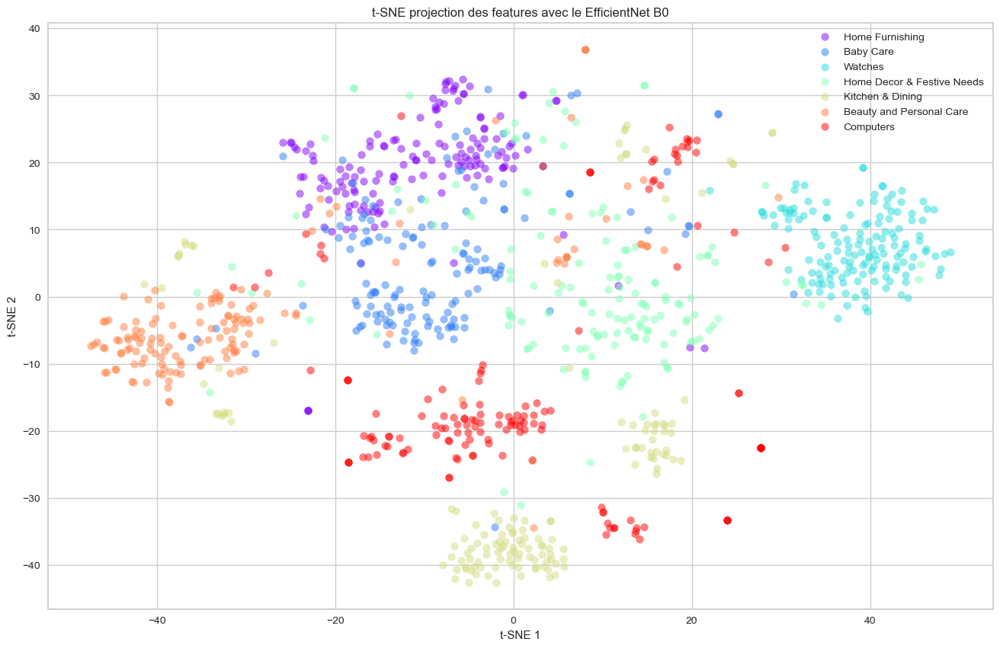

In [58]:
# Lire le DataFrame avec les features extraites
df_b7_tsne = pd.read_csv('df_effb7_with_features.csv')
#df_vgg_tsne.head(5)

# Vérifier le nombre de features disponibles dans le DataFrame
features_columns = [col for col in df_b7_tsne.columns if col.startswith('feature_')]
num_features = len(features_columns)
print(f'Number of feature columns: {num_features}')

# Appliquer t-SNE pour réduire les dimensions à 2D
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(df_b7_tsne[features_columns])

# Ajouter les résultats t-SNE au DataFrame
df_b7_tsne['tsne_2d_one'] = tsne_results[:, 0]
df_b7_tsne['tsne_2d_two'] = tsne_results[:, 1]

# Visualisation des résultats t-SNE avec Matplotlib
plt.figure(figsize=(16, 10))
categories = df_b7_tsne['Level_1'].unique()
colors = plt.cm.rainbow(np.linspace(0, 1, len(categories)))

for category, color in zip(categories, colors):
    subset = df_b7_tsne[df_b7_tsne['Level_1'] == category]
    plt.scatter(subset['tsne_2d_one'], subset['tsne_2d_two'], c=[color], label=category, alpha=0.5)

plt.title('t-SNE projection des features avec le EfficientNet B0')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(loc='best')
plt.show()


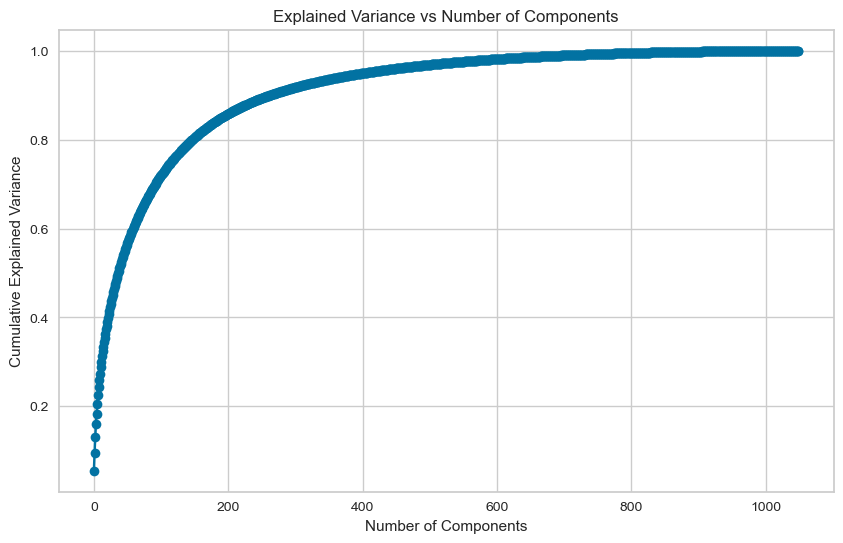

Entrez le seuil de variance à conserver (entre 0 et 1) :  0.98


Nombre de composantes retenues: 590


,product_name,image,Level_1,PC1,PC2,PC3,PC4,PC5,PC6,PC7,...,PC581,PC582,PC583,PC584,PC585,PC586,PC587,PC588,PC589,PC590
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,-4.484961,6.381158,3.408304,-3.769199,-2.897339,2.904455,-9.323144,...,-0.630572,-0.618243,-0.515955,-0.522719,0.262391,0.416367,-0.325261,-0.249688,-0.210350,0.976262
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,-6.143977,9.463125,-5.636317,-2.689599,-5.010439,-1.877630,-0.669926,...,-0.497681,-0.392675,0.436594,0.348130,-0.551931,-0.205231,-0.113890,0.070517,0.045092,0.621254
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,-14.067074,19.088278,-3.729055,-10.068318,-4.009534,-5.549298,1.709855,...,-0.216069,0.988813,-0.118176,0.055461,-0.033461,0.134193,-0.021100,-0.894047,0.362576,-0.245010


In [59]:
# Séparer les colonnes string
string_columns = df_effb7[['product_name','image','Level_1']]

# Suppression des colonnes 'product_name' et 'level_1' pour la PCA
df_cleaned = df_effb7.drop(columns=['product_name','image','Level_1'])

# Standardisation des données
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_cleaned)

# Application de la PCA pour déterminer le nombre de composantes
pca = PCA().fit(df_scaled)

# Calcul de la variance cumulée
cumulative_variance = pca.explained_variance_ratio_.cumsum()

# Affichage de la variance cumulée pour choisir le seuil
plt.figure(figsize=(10, 6))
plt.plot(cumulative_variance, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance vs Number of Components')
plt.grid(True)
plt.show()

# Demander à l'utilisateur de choisir le seuil de variance
variance_threshold = float(input("Entrez le seuil de variance à conserver (entre 0 et 1) : "))

# Déterminer le nombre de composantes nécessaires pour atteindre le seuil de variance
num_components = next(i for i, total_variance in enumerate(cumulative_variance) if total_variance >= variance_threshold) + 1

# Application de la PCA avec le nombre de composantes sélectionné
pca = PCA(n_components=num_components)
df_pca = pca.fit_transform(df_scaled)

# Création d'un DataFrame pour les résultats de la PCA
df_pca_result = pd.DataFrame(df_pca, columns=[f'PC{i+1}' for i in range(df_pca.shape[1])])

# Ajout des colonnes string au DataFrame final
df_effb7_pca = pd.concat([string_columns, df_pca_result], axis=1)

# Affichage du nombre de composantes retenues
print(f"Nombre de composantes retenues: {num_components}")
df_effb7_pca.head(3)


In [60]:
# Définition des hyperparamètres pour K-means
n_clusters = 7  
init = 'k-means++' 
n_init = 25  
max_iter = 300  
random_state = 42

# Application de K-means avec les hyperparamètres définis
kmeans = KMeans(n_clusters=n_clusters, init=init, n_init=n_init, max_iter=max_iter, random_state=random_state)
kmeans.fit(df_pca)

# Ajout des labels K-means au DataFrame final
df_effb7_pca['kmeans_label'] = kmeans.labels_

In [61]:
# Évaluation des performances du K-means
df_effb7_pca['Level_1'] = df_effb7_pca['Level_1'].astype('category')

# Liste pour stocker les évaluations
evaluations = []
evaluations_std = []

def fit_and_evaluate(km, X, labels, name=None, n_runs=5):
    name = km.__class__.__name__ if name is None else name

    train_times = []
    scores = defaultdict(list)
    for seed in range(n_runs):
        km.set_params(random_state=seed)
        t0 = time()
        km.fit(X)
        train_times.append(time() - t0)
        scores["Homogeneity"].append(metrics.homogeneity_score(labels, km.labels_))
        scores["Completeness"].append(metrics.completeness_score(labels, km.labels_))
        scores["V-measure"].append(metrics.v_measure_score(labels, km.labels_))
        scores["Adjusted Rand-Index"].append(
            metrics.adjusted_rand_score(labels, km.labels_)
        )
        scores["Silhouette Coefficient"].append(
            metrics.silhouette_score(X, km.labels_, sample_size=2000)
        )
    train_times = np.asarray(train_times)

    print(f"Clustering done in {train_times.mean():.2f} ± {train_times.std():.2f} s ")
    evaluation = {
        "estimator": name,
        "train_time": train_times.mean(),
    }
    evaluation_std = {
        "estimator": name,
        "train_time": train_times.std(),
    }
    for score_name, score_values in scores.items():
        mean_score, std_score = np.mean(score_values), np.std(score_values)
        print(f"{score_name}: {mean_score:.3f} ± {std_score:.3f}")
        evaluation[score_name] = mean_score
        evaluation_std[score_name] = std_score
    evaluations.append(evaluation)
    evaluations_std.append(evaluation_std)

# Application de la fonction d'évaluation
fit_and_evaluate(kmeans, df_pca, df_effb7_pca['Level_1'].cat.codes)

Clustering done in 0.87 ± 0.03 s 
Homogeneity: 0.572 ± 0.012
Completeness: 0.611 ± 0.011
V-measure: 0.591 ± 0.011
Adjusted Rand-Index: 0.438 ± 0.023
Silhouette Coefficient: 0.064 ± 0.000


# IV. Modélisation en supervisée (classification)

Nous allons utiliser deux modèles robustes & performants en classification qui sont le SVM et les forêts aléatoires

## A. Approche avec les descripteurs Sift (histogrammes)

### 1. Initialisation du dataframe

In [36]:
labels_df = pd.read_csv('augmented_labels.csv')
labels_df.head(5)

,image_name,Level_1
0,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_0.jpg,Home Furnishing
1,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_1.jpg,Home Furnishing
2,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_2.jpg,Home Furnishing
3,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_3.jpg,Home Furnishing
4,55b85ea15a1536d46b7190ad6fff8ce7_final_aug_4.jpg,Home Furnishing


### 2. Chargement des histogrammes & préparation de la matrice X

In [37]:
# Charger les histogrammes
with open('image_histograms.pkl', 'rb') as f:
    image_histograms = pickle.load(f)

# Afficher les colonnes du DataFrame pour vérification
print("Colonnes du DataFrame labels_df:", labels_df.columns)

# 'image_name' est bien la colonne contenant les noms des images
if 'image_name' not in labels_df.columns:
    raise ValueError("La colonne 'image_name' n'est pas présente dans labels.csv. Vérifiez le nom de la colonne.")

# Utiliser la colonne correcte pour l'index
labels_df.set_index('image_name', inplace=True)

# Préparer les données
X = []
y = []

# Associer les histogrammes aux noms des images et aux catégories
for image_filename, histogram in image_histograms.items():
    if image_filename in labels_df.index:
        X.append(histogram)
        y.append(labels_df.loc[image_filename, 'Level_1'])

X = np.array(X)
y = np.array(y)

# Vérifier la forme des données avant de normaliser
print("Shape of X before reshaping:", X.shape)

# matrice x en 2D
if len(X.shape) == 1:
    X = np.array([x for x in X if x is not None])
    X = np.array(X).reshape(-1, 1)
elif len(X.shape) == 2 and X.shape[1] == 0:
    raise ValueError("All histograms are empty.")

print("Shape of X after reshaping:", X.shape)

Colonnes du DataFrame labels_df: Index(['image_name', 'Level_1'], dtype='object')
Shape of X before reshaping: (5250, 500)
Shape of X after reshaping: (5250, 500)


### 3. Modélisation avec le SVM

In [34]:
# Normaliser les données
scaler = StandardScaler()
X = scaler.fit_transform(X)

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Entraîner le modèle SVM
svm_model = SVC(kernel='rbf') 
svm_model.fit(X_train, y_train)

# Prédire sur l'ensemble de test
y_pred = svm_model.predict(X_test)

# Évaluer le modèle
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))

Accuracy: 0.8323809523809523
                            precision    recall  f1-score   support

                 Baby Care       0.84      0.77      0.81       155
  Beauty and Personal Care       0.90      0.84      0.87       145
                 Computers       0.69      0.86      0.77       147
Home Decor & Festive Needs       0.78      0.81      0.79       146
           Home Furnishing       0.87      0.88      0.87       156
          Kitchen & Dining       0.87      0.75      0.81       166
                   Watches       0.94      0.93      0.93       135

                  accuracy                           0.83      1050
                 macro avg       0.84      0.83      0.83      1050
              weighted avg       0.84      0.83      0.83      1050



In [35]:
# Configurer la validation croisée en 10 plis
cv = StratifiedKFold(n_splits=10)

# Effectuer la validation croisée
cv_scores = cross_val_score(svm_model, X, y, cv=cv, scoring='accuracy')

# Calculer la moyenne globale
mean_accuracy = cv_scores.mean()

# Créer un tableau des résultats pour chaque pli avec trois chiffres après la virgule
cv_results_df = pd.DataFrame({'Fold': range(1, len(cv_scores) + 1), 'Accuracy': [f"{score:.3f}" for score in cv_scores]})

# Ajouter la moyenne globale en haut du tableau
mean_row = pd.DataFrame({'Fold': ['Mean'], 'Accuracy': [f"{mean_accuracy:.3f}"]})
cv_results_df_svm_sift = pd.concat([mean_row, cv_results_df], ignore_index=True)

# Afficher les résultats
cv_results_df_svm_sift

,Fold,Accuracy
0,Mean,0.559
1,1,0.594
2,2,0.577
3,3,0.501
4,4,0.549
5,5,0.608
6,6,0.541
7,7,0.528
8,8,0.604
9,9,0.531


### 4. Modélisation avec le RandomForestClassifier

In [38]:
# Normaliser les données
scaler = StandardScaler()
X = scaler.fit_transform(X)

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Entraînement du modèle Random Forest
rf_model = RandomForestClassifier(n_estimators=300, random_state=42)
rf_model.fit(X_train, y_train)

# Prédictions sur l'ensemble de test
y_pred = rf_model.predict(X_test)

# Évaluer le modèle
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))


Accuracy: 0.7476190476190476
                            precision    recall  f1-score   support

                 Baby Care       0.79      0.68      0.73       155
  Beauty and Personal Care       0.73      0.73      0.73       145
                 Computers       0.64      0.76      0.69       147
Home Decor & Festive Needs       0.63      0.78      0.70       146
           Home Furnishing       0.91      0.70      0.79       156
          Kitchen & Dining       0.76      0.70      0.73       166
                   Watches       0.86      0.90      0.88       135

                  accuracy                           0.75      1050
                 macro avg       0.76      0.75      0.75      1050
              weighted avg       0.76      0.75      0.75      1050



In [39]:
# Configurer la validation croisée en 10 plis
cv = StratifiedKFold(n_splits=10)

# Effectuer la validation croisée
cv_scores = cross_val_score(rf_model, X, y, cv=cv, scoring='accuracy')

# Calculer la moyenne globale
mean_accuracy = cv_scores.mean()

# Créer un tableau des résultats pour chaque pli avec trois chiffres après la virgule
cv_results_df = pd.DataFrame({'Fold': range(1, len(cv_scores) + 1), 'Accuracy': [f"{score:.3f}" for score in cv_scores]})

# Ajouter la moyenne globale en haut du tableau
mean_row = pd.DataFrame({'Fold': ['Mean'], 'Accuracy': [f"{mean_accuracy:.3f}"]})
cv_results_df_rf_sift = pd.concat([mean_row, cv_results_df], ignore_index=True)

# Afficher les résultats
cv_results_df_rf_sift

,Fold,Accuracy
0,Mean,0.502
1,1,0.510
2,2,0.533
3,3,0.411
4,4,0.490
5,5,0.619
6,6,0.432
7,7,0.467
8,8,0.535
9,9,0.480


### 5. Approfondissement avec le SVM

##### i. Utilisation de la gridsearchcv

Les différents kernel ont été testé en amont. Le 'RBF' étant le plus performant, il a été conservé et choisi.

In [8]:
# Normaliser les données
scaler = StandardScaler()
X = scaler.fit_transform(X)

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Définir la grille d'hyperparamètres
param_grid = {
    'C': [0.1, 1, 10, 100],
    'gamma': [1, 0.1, 0.01, 0.001],
    'kernel': ['rbf']
}

# Effectuer la recherche par validation croisée
grid_search = GridSearchCV(SVC(), param_grid, refit=True, verbose=2, cv=5)
grid_search.fit(X_train, y_train)

# Afficher les meilleurs hyperparamètres trouvés
print("Best parameters found: ", grid_search.best_params_)

# Utiliser le meilleur modèle pour prédire sur l'ensemble de test
best_svm_model = grid_search.best_estimator_
y_pred = best_svm_model.predict(X_test)

# Évaluer le modèle
print("Accuracy:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))


Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   9.6s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   9.9s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   9.2s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   9.8s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   9.7s
[CV] END .......................C=0.1, gamma=0.1, kernel=rbf; total time=   7.9s
[CV] END .......................C=0.1, gamma=0.1, kernel=rbf; total time=   9.0s
[CV] END .......................C=0.1, gamma=0.1, kernel=rbf; total time=   8.8s
[CV] END .......................C=0.1, gamma=0.1, kernel=rbf; total time=   8.7s
[CV] END .......................C=0.1, gamma=0.1, kernel=rbf; total time=   9.3s
[CV] END ......................C=0.1, gamma=0.01, kernel=rbf; total time=   8.4s
[CV] END ......................C=0.1, gamma=0.01

In [11]:
from sklearn.metrics import accuracy_score, classification_report
# Afficher les meilleurs hyperparamètres trouvés
print("Best parameters found: ", grid_search.best_params_)

# Évaluer le modèle
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.3f}")
print(classification_report(y_test, y_pred))


Best parameters found:  {'C': 10, 'gamma': 0.001, 'kernel': 'rbf'}
Accuracy: 0.870
                            precision    recall  f1-score   support

                 Baby Care       0.82      0.85      0.84       155
  Beauty and Personal Care       0.91      0.89      0.90       145
                 Computers       0.80      0.91      0.85       147
Home Decor & Festive Needs       0.83      0.84      0.83       146
           Home Furnishing       0.86      0.86      0.86       156
          Kitchen & Dining       0.90      0.78      0.84       166
                   Watches       0.99      0.97      0.98       135

                  accuracy                           0.87      1050
                 macro avg       0.87      0.87      0.87      1050
              weighted avg       0.87      0.87      0.87      1050



In [22]:
# Obtenir les noms des classes
class_names = best_svm_model.classes_
print(class_names)

['Baby Care' 'Beauty and Personal Care' 'Computers'
 'Home Decor & Festive Needs' 'Home Furnishing' 'Kitchen & Dining'
 'Watches']


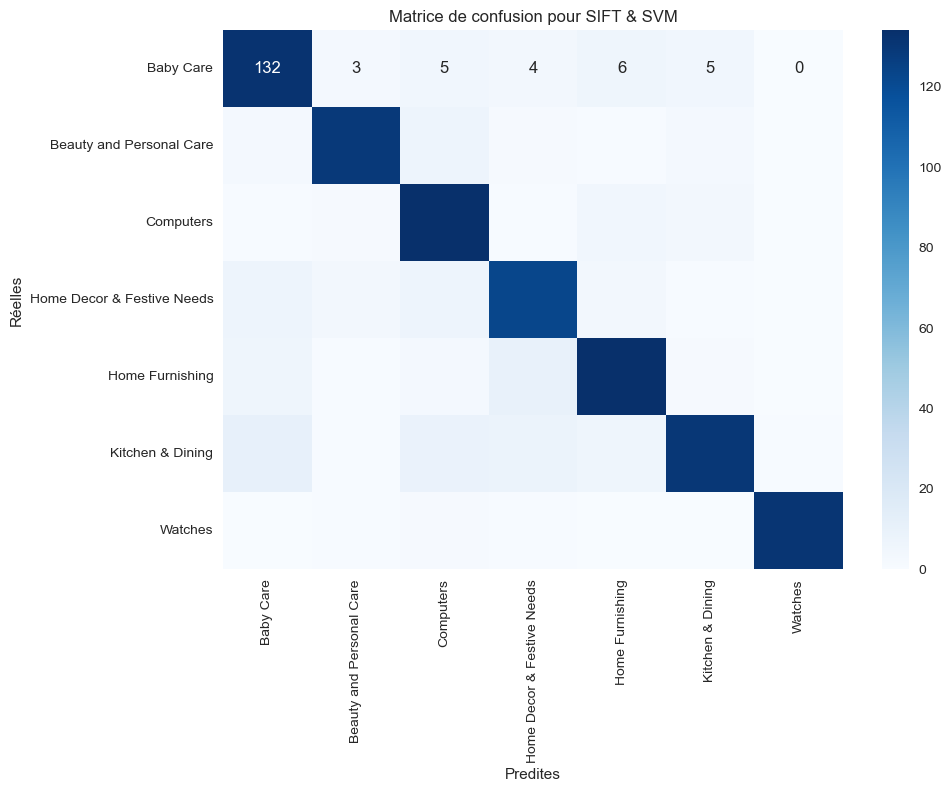

In [23]:
# Calculer la matrice de confusion
conf_matrix = confusion_matrix(y_test, y_pred)

# Afficher la matrice de confusion
plt.figure(figsize=(10,7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predites')
plt.ylabel('Réelles')
plt.title('Matrice de confusion pour SIFT & SVM')
plt.show()

In [31]:
# Configurer la validation croisée en 10 plis
cv = StratifiedKFold(n_splits=10)

# Effectuer la validation croisée
cv_scores = cross_val_score(best_svm_model, X, y, cv=cv, scoring='accuracy')

# Calculer la moyenne globale
mean_accuracy = cv_scores.mean()

# Créer un tableau des résultats pour chaque pli avec trois chiffres après la virgule
cv_results_df = pd.DataFrame({'Fold': range(1, len(cv_scores) + 1), 'Accuracy': [f"{score:.3f}" for score in cv_scores]})

# Ajouter la moyenne globale en haut du tableau
mean_row = pd.DataFrame({'Fold': ['Mean'], 'Accuracy': [f"{mean_accuracy:.3f}"]})
cv_results_df_svm_sift = pd.concat([mean_row, cv_results_df], ignore_index=True)

# Afficher les résultats
cv_results_df_svm_sift

,Fold,Accuracy
0,Mean,0.527
1,1,0.545
2,2,0.537
3,3,0.490
4,4,0.509
5,5,0.564
6,6,0.512
7,7,0.518
8,8,0.564
9,9,0.503


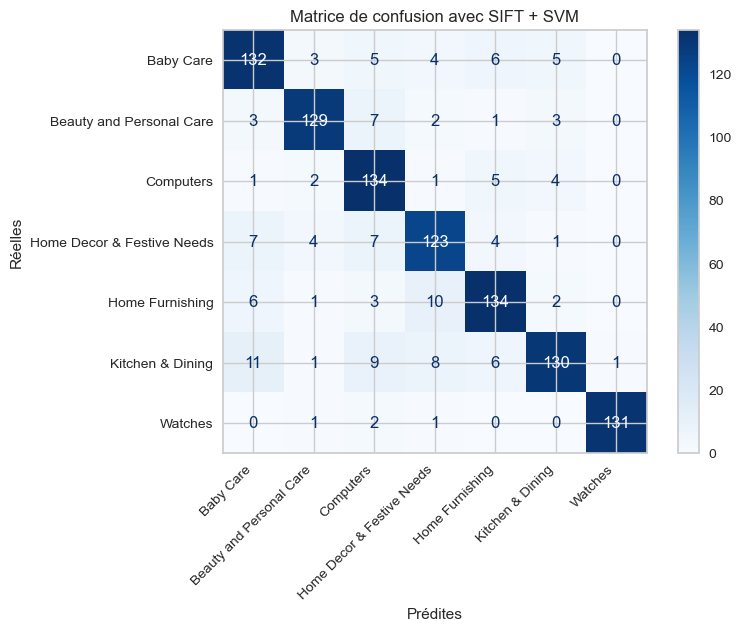

In [27]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
# Calculer la matrice de confusion
conf_matrix = confusion_matrix(y_test, y_pred)
#print("Confusion Matrix:")
#print(conf_matrix)

# Afficher la matrice de confusion sous forme graphique avec des étiquettes
class_names = ["Baby Care", "Beauty and Personal Care", "Computers", "Home Decor & Festive Needs", 
               "Home Furnishing", "Kitchen & Dining", "Watches"]
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=class_names)
disp.plot(cmap=plt.cm.Blues)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Prédites')
plt.ylabel('Réelles')
plt.title('Matrice de confusion avec SIFT + SVM')
plt.show()

## B. Approche avec les features CNN

### 1. Chargement des données 'features' issues des modèles de CNN

In [5]:
df_sup_effb0 = pd.read_csv('df_effb0_with_features.csv')
df_sup_effb7 = pd.read_csv('df_effb7_with_features.csv')
df_sup_resnet = pd.read_csv('df_pict_with_features.csv')
df_sup_vgg = pd.read_csv('df_vgg_with_features.csv')
df_resnet_50 = pd.read_csv('df_cnn_with_features.csv')

### 2. Réduction des données avec une PCA

Entrez le seuil de variance à conserver (entre 0 et 1) :  0.98


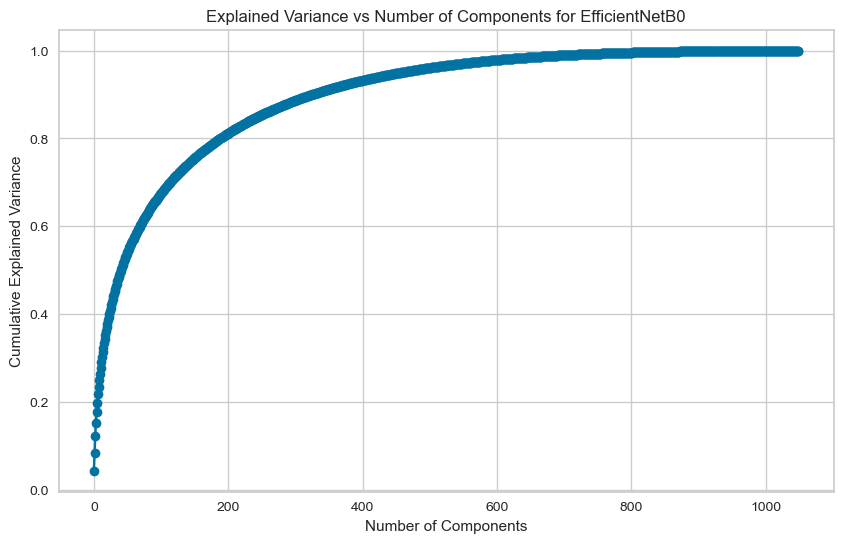

Nombre de composantes retenues pour EfficientNetB0: 608


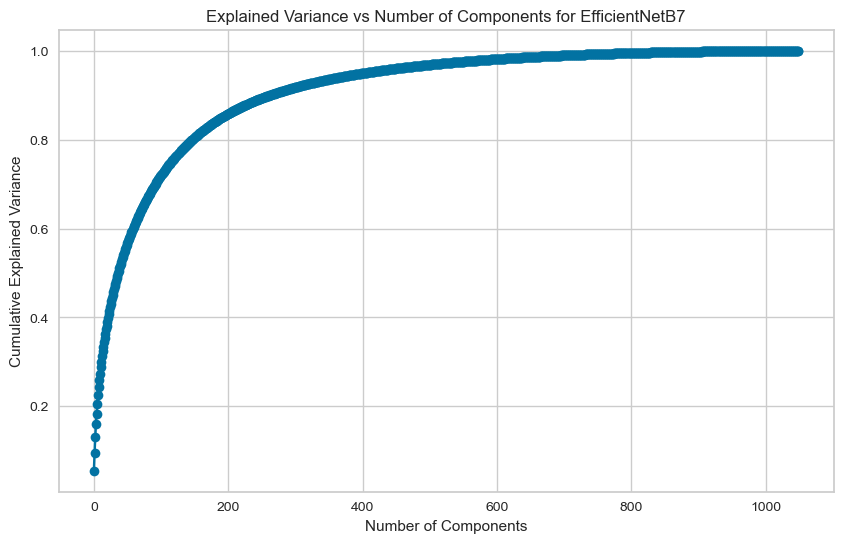

Nombre de composantes retenues pour EfficientNetB7: 590


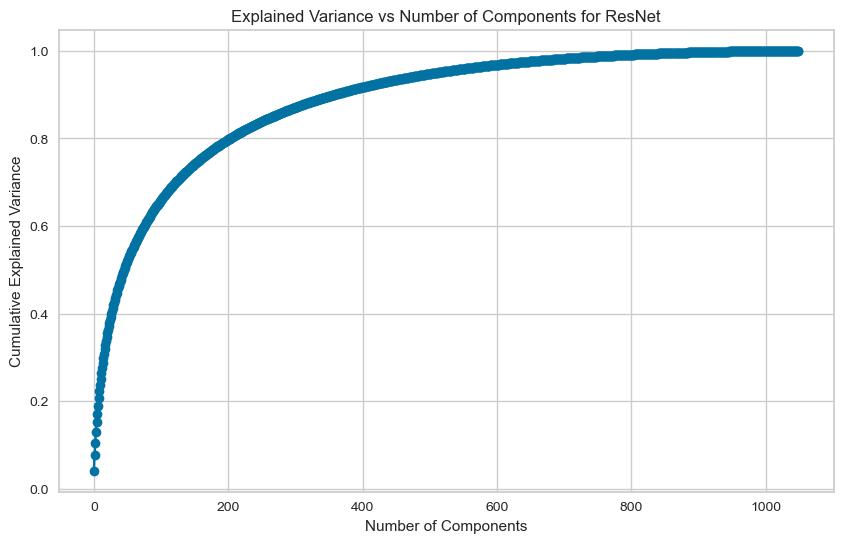

Nombre de composantes retenues pour ResNet: 685


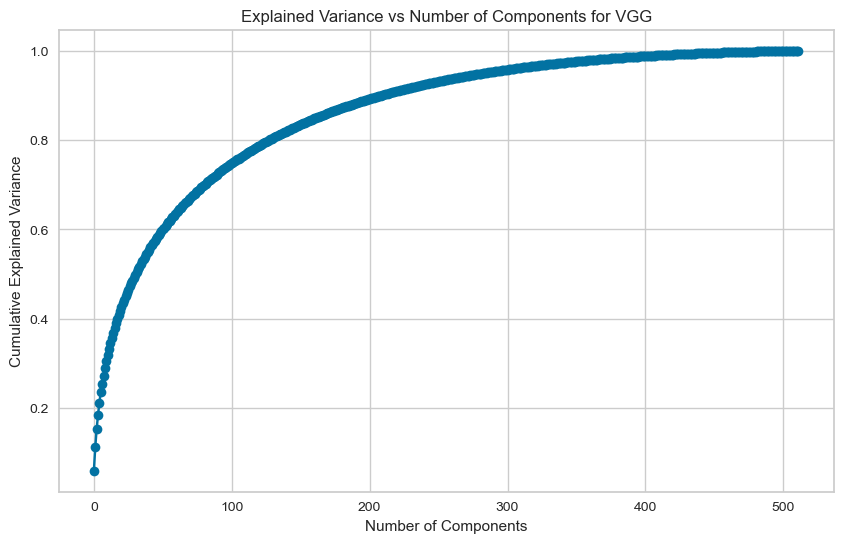

Nombre de composantes retenues pour VGG: 366


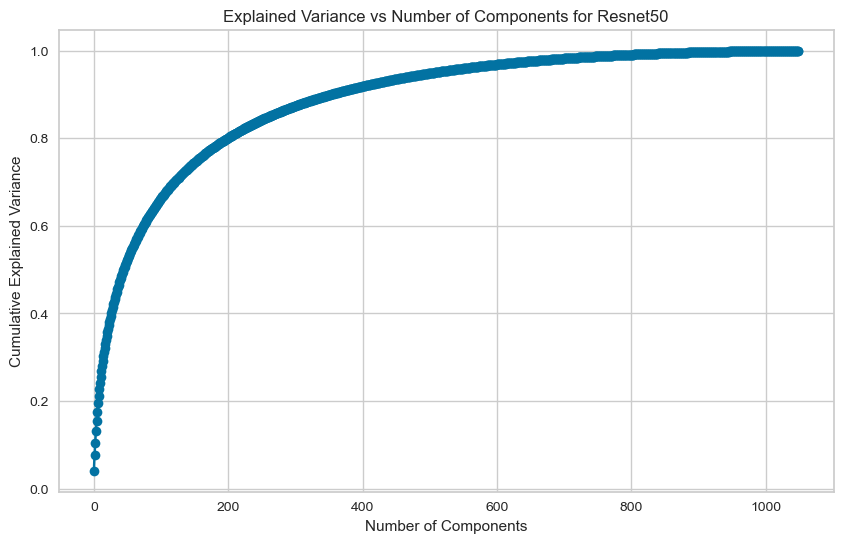

Nombre de composantes retenues pour Resnet50: 682


In [13]:
# Fonction pour appliquer la PCA sur un DataFrame donné
def apply_pca(df, model_name, variance_threshold):
    # Séparer les colonnes string
    string_columns = df[['product_name', 'Level_1', 'image']]

    # Suppression des colonnes 'product_name' et 'Level_1' pour la PCA
    df_cleaned = df.drop(columns=['product_name', 'Level_1', 'image'])

    # Standardisation des données
    scaler = StandardScaler()
    df_scaled = scaler.fit_transform(df_cleaned)

    # Application de la PCA pour déterminer le nombre de composantes
    pca = PCA().fit(df_scaled)

    # Calcul de la variance cumulée
    cumulative_variance = pca.explained_variance_ratio_.cumsum()

    # Affichage de la variance cumulée pour choisir le seuil
    plt.figure(figsize=(10, 6))
    plt.plot(cumulative_variance, marker='o')
    plt.xlabel('Number of Components')
    plt.ylabel('Cumulative Explained Variance')
    plt.title(f'Explained Variance vs Number of Components for {model_name}')
    plt.grid(True)
    plt.show()

    # Déterminer le nombre de composantes nécessaires pour atteindre le seuil de variance
    num_components = next(i for i, total_variance in enumerate(cumulative_variance) if total_variance >= variance_threshold) + 1

    # Application de la PCA avec le nombre de composantes sélectionné
    pca = PCA(n_components=num_components)
    df_pca = pca.fit_transform(df_scaled)

    # Création d'un DataFrame pour les résultats de la PCA
    df_pca_result = pd.DataFrame(df_pca, columns=[f'PC{i+1}' for i in range(df_pca.shape[1])])

    # Ajout des colonnes string au DataFrame final
    df_final = pd.concat([string_columns, df_pca_result], axis=1)
    
    # Ajout d'une colonne pour le nom du modèle
    df_final['model'] = model_name

    # Affichage du nombre de composantes retenues
    print(f"Nombre de composantes retenues pour {model_name}: {num_components}")
    return df_final

# Définir le seuil de variance à conserver (entre 0 et 1)
variance_threshold = float(input("Entrez le seuil de variance à conserver (entre 0 et 1) : "))

# Appliquer la PCA sur chaque DataFrame
df_effb0_pca = apply_pca(df_sup_effb0, 'EfficientNetB0', variance_threshold)
df_effb7_pca = apply_pca(df_sup_effb7, 'EfficientNetB7', variance_threshold)
df_resnet_pca = apply_pca(df_sup_resnet, 'ResNet', variance_threshold)
df_vgg_pca = apply_pca(df_sup_vgg, 'VGG', variance_threshold)
df_resnet50_pca = apply_pca(df_resnet_50, 'Resnet50', variance_threshold)

### 3. Modélisation avec le SVM sur les  modèles de CNN

In [14]:
# Fonction pour entraîner et évaluer le modèle SVM
def train_and_evaluate_svm(df_final, model_name):
    # Préparation des données pour le SVM
    X = df_final.drop(columns=['Level_1', 'product_name', 'image','model'])
    y = df_final['Level_1']

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Entraînement du modèle SVM
    svm_model = SVC(kernel='rbf')
    svm_model.fit(X_train, y_train)

    # Prédictions sur l'ensemble de test
    y_pred = svm_model.predict(X_test)

    # Évaluation du modèle
    accuracy = accuracy_score(y_test, y_pred)
    report = classification_report(y_test, y_pred)

    print(f"Model: {model_name}")
    print(f"Accuracy: {accuracy}")
    print("Classification Report:")
    print(report)
    print("\n" + "-"*50 + "\n")

# Appliquer la modélisation SVM sur chaque DataFrame
train_and_evaluate_svm(df_effb0_pca, 'EfficientNetB0')
train_and_evaluate_svm(df_effb7_pca, 'EfficientNetB7')
train_and_evaluate_svm(df_resnet_pca, 'ResNet101')
train_and_evaluate_svm(df_vgg_pca, 'VGG')
train_and_evaluate_svm(df_resnet50_pca, 'ResNet50')



Model: EfficientNetB0
Accuracy: 0.8698412698412699
Classification Report:
                            precision    recall  f1-score   support

                 Baby Care       0.89      0.73      0.80        45
  Beauty and Personal Care       0.97      0.83      0.90        36
                 Computers       0.85      0.98      0.91        52
Home Decor & Festive Needs       0.68      0.89      0.77        44
           Home Furnishing       0.88      0.88      0.88        52
          Kitchen & Dining       0.94      0.76      0.84        38
                   Watches       0.98      0.96      0.97        48

                  accuracy                           0.87       315
                 macro avg       0.88      0.86      0.87       315
              weighted avg       0.88      0.87      0.87       315


--------------------------------------------------

Model: EfficientNetB7
Accuracy: 0.8666666666666667
Classification Report:
                            precision    recall 

Fitting 10 folds for each of 16 candidates, totalling 160 fits
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.3s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.3s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.3s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.3s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.4s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.3s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.4s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.4s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.4s
[CV] END .........................C=0.1, gamma=1, kernel=rbf; total time=   0.4s
[CV] END .......................C=0.1, gamma=0.1, kernel=rbf; total time=   0.3s
[CV] END .......................C=0.1, gamma=0

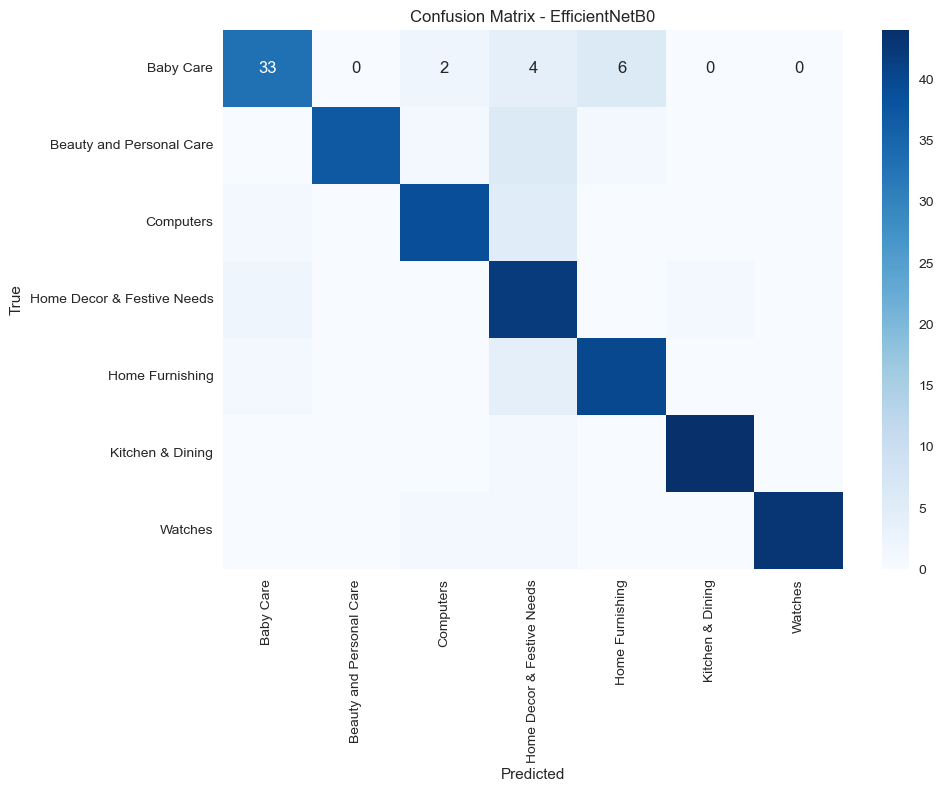

In [16]:
from sklearn.model_selection import StratifiedKFold
def train_evaluate_and_cross_validate_svm(df_final, model_name):
    # Préparation des données pour le SVM
    X = df_final.drop(columns=['Level_1', 'product_name', 'image','model'])
    y = df_final['Level_1']

    # Configurer la validation croisée en 10 plis
    cv = StratifiedKFold(n_splits=10)

    # Paramètres pour GridSearchCV
    param_grid = {
        'C': [0.1, 1, 10, 100],
        'gamma': [1, 0.1, 0.01, 0.001],
        'kernel': ['rbf']
    }

    # Initialisation du modèle SVM
    svm = SVC()

    # GridSearchCV
    grid = GridSearchCV(svm, param_grid, refit=True, verbose=2, cv=cv)
    grid.fit(X, y)

    # Validation croisée
    cv_scores = cross_val_score(grid.best_estimator_, X, y, cv=cv, scoring='accuracy')
    
    # Calculer la moyenne globale
    mean_accuracy = cv_scores.mean()

    # Créer un tableau des résultats pour chaque pli avec trois chiffres après la virgule
    cv_results_df = pd.DataFrame({'Fold': range(1, len(cv_scores) + 1), 'Accuracy': [f"{score:.3f}" for score in cv_scores]})

    # Ajouter la moyenne globale en haut du tableau
    mean_row = pd.DataFrame({'Fold': ['Mean'], 'Accuracy': [f"{mean_accuracy:.3f}"]})
    cv_results_df = pd.concat([mean_row, cv_results_df], ignore_index=True)

    # Afficher les résultats de la validation croisée
    print(cv_results_df)

    # Diviser les données pour l'affichage de la matrice de confusion
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)
    
    # Entraîner le modèle avec les meilleurs paramètres trouvés
    grid.best_estimator_.fit(X_train, y_train)
    
    # Prédictions sur l'ensemble de test
    y_pred = grid.best_estimator_.predict(X_test)
    
    # Évaluation du modèle
    accuracy = accuracy_score(y_test, y_pred)
    report = classification_report(y_test, y_pred)
    conf_matrix = confusion_matrix(y_test, y_pred, labels=grid.classes_)

    print(f"Model: {model_name}")
    print(f"Best Parameters: {grid.best_params_}")
    print(f"Test Accuracy: {accuracy:.3f}")
    print("Classification Report:")
    print(report)
    print("\n" + "-"*50 + "\n")

    # Affichage de la matrice de confusion
    plt.figure(figsize=(10, 7))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=grid.classes_, yticklabels=grid.classes_)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix - {model_name}')
    plt.show()

# Appliquer la modélisation SVM avec GridSearchCV, validation croisée et afficher la matrice de confusion sur le DataFrame EfficientNetB0
train_evaluate_and_cross_validate_svm(df_effb0_pca, 'EfficientNetB0')


### 4. Modélisation avec le RandomClassifier sur les  modèles de CNN

In [42]:
# Fonction pour entraîner et évaluer le modèle randomforest
def train_and_evaluate_rf(df_final, model_name):
    # Préparation des données pour le randomforest
    X = df_final.drop(columns=['Level_1', 'product_name', 'image','model'])
    y = df_final['Level_1']

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Entraînement du modèle SVM
    rf_model = RandomForestClassifier(n_estimators=300, random_state=42)
    rf_model.fit(X_train, y_train)

    # Prédictions sur l'ensemble de test
    y_pred = rf_model.predict(X_test)

    # Évaluation du modèle
    accuracy = accuracy_score(y_test, y_pred)
    report = classification_report(y_test, y_pred)

    print(f"Model: {model_name}")
    print(f"Accuracy: {accuracy}")
    print("Classification Report:")
    print(report)
    print("\n" + "-"*50 + "\n")

# Appliquer la modélisation SVM sur chaque DataFrame
train_and_evaluate_rf(df_effb0_pca, 'EfficientNetB0')
train_and_evaluate_rf(df_effb7_pca, 'EfficientNetB7')
train_and_evaluate_rf(df_resnet_pca, 'ResNet')
train_and_evaluate_rf(df_vgg_pca, 'VGG')
train_and_evaluate_rf(df_resnet50_pca, 'Resnet50')

Model: EfficientNetB0
Accuracy: 0.8317460317460318
Classification Report:
                            precision    recall  f1-score   support

                 Baby Care       0.77      0.67      0.71        45
  Beauty and Personal Care       0.85      0.81      0.83        36
                 Computers       0.82      0.88      0.85        52
Home Decor & Festive Needs       0.74      0.84      0.79        44
           Home Furnishing       0.81      0.92      0.86        52
          Kitchen & Dining       0.88      0.76      0.82        38
                   Watches       0.98      0.90      0.93        48

                  accuracy                           0.83       315
                 macro avg       0.84      0.83      0.83       315
              weighted avg       0.84      0.83      0.83       315


--------------------------------------------------

Model: EfficientNetB7
Accuracy: 0.8253968253968254
Classification Report:
                            precision    recall 

Les premières modélisations placent le combo "CNN : l'efficientnetB0 " & "le SVM : kernel RBF" comme la plus performance avec une accuracy de 0.869.. Marge légère car suivi de près avec le efficientnetB7.
Nous allons donc tenter d'aller un peu plus loin en terme de précision, en essayant d'optimiser au mieux les hyperparamètres.

### 5. Modélisation complète avec le efficient net b0

*test d'une modélisation avec le classifier inclus dans le modèle efficientnetb0*

In [10]:
df_final = df[['image',
            'Level_1']].copy()

# Échantillonnage aléatoire en conservant la proportion de 'Level_1'
#df_final = df_final.groupby('Level_1', group_keys=False).apply(lambda x: x.sample(150))

# Vérification des proportions
print(df_final['Level_1'].value_counts())
#print(df_final.info())

Level_1
Home Furnishing               150
Baby Care                     150
Watches                       150
Home Decor & Festive Needs    150
Kitchen & Dining              150
Beauty and Personal Care      150
Computers                     150
Name: count, dtype: int64


In [10]:
# Ajouter le chemin complet des images
dossier_images = r'C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\Images'
df_final['image_path'] = df_final['image'].apply(lambda x: os.path.join(dossier_images, x))

# Split des données
train_df, val_df = train_test_split(df_final, test_size=0.2, stratify=df_final['Level_1'], random_state=42)

# Générateur d'images avec augmentation
train_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

train_generator = train_datagen.flow_from_dataframe(
    train_df,
    x_col='image_path',
    y_col='Level_1',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical'
)

val_generator = val_datagen.flow_from_dataframe(
    val_df,
    x_col='image_path',
    y_col='Level_1',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical'
)

# Chargement du modèle pré-entraîné ResNet101
base_model = ResNet101(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
base_model.trainable = False

# Création du modèle CNN
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(512, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(len(train_generator.class_indices), activation='softmax')
])

# Compilation du modèle
model.compile(optimizer=optimizers.Adam(),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Early stopping pour éviter le surapprentissage
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Entraînement du modèle
history = model.fit(
    train_generator,
    epochs=30,
    validation_data=val_generator,
    callbacks=[early_stopping]
)

# Évaluation du modèle
loss, accuracy = model.evaluate(val_generator)
print(f'Validation Accuracy: {accuracy * 100:.2f}%')


Found 840 validated image filenames belonging to 7 classes.
Found 210 validated image filenames belonging to 7 classes.
Epoch 1/30


C:\Users\justi\AppData\Roaming\Python\Python311\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


 7/27 ━━━━━━━━━━━━━━━━━━━━ 1:01 3s/step - accuracy: 0.2574 - loss: 2.6940

C:\ProgramData\anaconda3\Lib\site-packages\PIL\Image.py:3186: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


27/27 ━━━━━━━━━━━━━━━━━━━━ 168s 5s/step - accuracy: 0.4776 - loss: 1.8867 - val_accuracy: 0.7857 - val_loss: 0.7430
Epoch 2/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 158s 6s/step - accuracy: 0.8726 - loss: 0.4642 - val_accuracy: 0.8238 - val_loss: 0.6181
Epoch 3/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 151s 5s/step - accuracy: 0.8565 - loss: 0.4376 - val_accuracy: 0.8048 - val_loss: 0.5978
Epoch 4/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 148s 5s/step - accuracy: 0.9181 - loss: 0.2617 - val_accuracy: 0.8238 - val_loss: 0.5470
Epoch 5/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 155s 5s/step - accuracy: 0.9271 - loss: 0.2272 - val_accuracy: 0.7952 - val_loss: 0.6689
Epoch 6/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 175s 6s/step - accuracy: 0.9313 - loss: 0.2243 - val_accuracy: 0.8000 - val_loss: 0.6628
Epoch 7/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 191s 7s/step - accuracy: 0.9514 - loss: 0.1724 - val_accuracy: 0.8190 - val_loss: 0.5851
Epoch 8/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 160s 6s/step - accuracy: 0.9347 - loss: 0.1746 - val_accuracy: 0.8286 - val_loss: 0.

Epoch 1/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 59s 2s/step - accuracy: 0.8445 - loss: 0.9889 - val_accuracy: 0.7905 - val_loss: 2.3342
Epoch 2/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 58s 2s/step - accuracy: 0.8414 - loss: 1.2344 - val_accuracy: 0.8333 - val_loss: 2.1967
Epoch 3/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 58s 2s/step - accuracy: 0.8437 - loss: 1.1124 - val_accuracy: 0.8762 - val_loss: 2.0929
Epoch 4/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 59s 2s/step - accuracy: 0.8432 - loss: 1.4090 - val_accuracy: 0.8048 - val_loss: 1.8483
Epoch 5/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 59s 2s/step - accuracy: 0.8370 - loss: 1.0926 - val_accuracy: 0.7762 - val_loss: 2.2512
Epoch 6/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 58s 2s/step - accuracy: 0.8452 - loss: 0.8189 - val_accuracy: 0.8095 - val_loss: 2.2131
Epoch 7/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 59s 2s/step - accuracy: 0.8412 - loss: 0.8286 - val_accuracy: 0.8190 - val_loss: 2.1114
Epoch 8/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 59s 2s/step - accuracy: 0.8590 - loss: 0.7334 - val_accuracy: 0.8429 - val_loss:

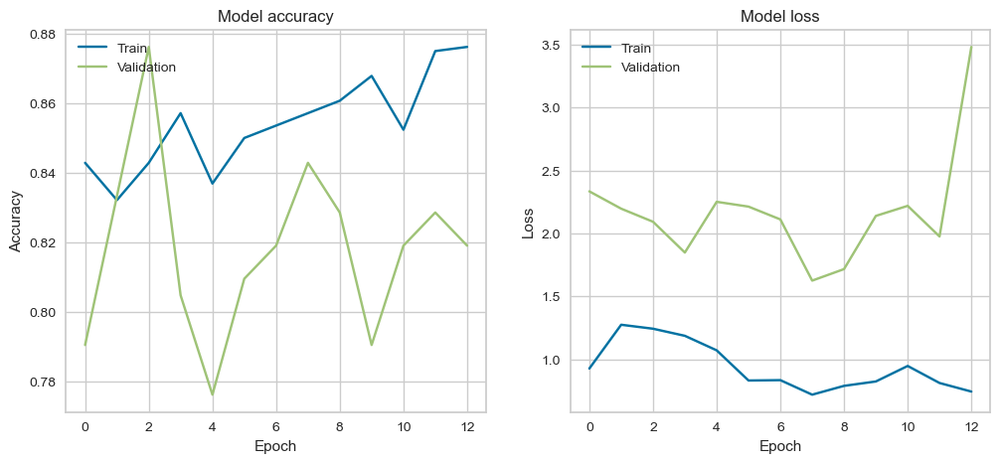

In [50]:
# Tracer les courbes de loss et d'accuracy
def plot_history(history):
    # Plot training & validation accuracy values
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')

    plt.show()

# Entraînement du modèle
history = model.fit(
    train_generator,
    epochs=30,
    validation_data=val_generator,
    callbacks=[early_stopping]
)

# Évaluation du modèle
loss, accuracy = model.evaluate(val_generator)
print(f'Validation Accuracy: {accuracy * 100:.2f}%')

# Tracer l'historique de l'entraînement
plot_history(history)


In [13]:
# Augmenter la limite de décompression
Image.MAX_IMAGE_PIXELS = None

# Ajouter le chemin complet des images
dossier_images = r'C:\Users\justi\OneDrive\Cours - Travail\DATA SCIENCE\Formation - DataScientist\Projet n°6\NOTEBOOK - DATA\Dataset+projet+prétraitement+textes+images\Flipkart\Images'
df_final['image_path'] = df_final['image'].apply(lambda x: os.path.join(dossier_images, x))

# Redimensionner les images avant de les charger
def resize_image(image_path, target_size=(224, 224)):
    img = Image.open(image_path)
    img = img.resize(target_size, Image.ANTIALIAS)
    return img

# Split des données
train_df, val_df = train_test_split(df_final, test_size=0.2, stratify=df_final['Level_1'], random_state=42)

# Générateur d'images avec augmentation
train_datagen = ImageDataGenerator(
    preprocessing_function=caffe_preprocess_input,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

val_datagen = ImageDataGenerator(preprocessing_function=caffe_preprocess_input)

train_generator = train_datagen.flow_from_dataframe(
    train_df,
    x_col='image_path',
    y_col='Level_1',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical'
)

val_generator = val_datagen.flow_from_dataframe(
    val_df,
    x_col='image_path',
    y_col='Level_1',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical'
)

# Chargement du modèle pré-entraîné EfficientNetB0
base_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
base_model.trainable = False

# Création du modèle CNN
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(512, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(len(train_generator.class_indices), activation='softmax')
])

# Compilation du modèle
model.compile(optimizer=optimizers.Adam(),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Early stopping pour éviter le surapprentissage
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Entraînement du modèle
history = model.fit(
    train_generator,
    epochs=30,
    validation_data=val_generator,
    callbacks=[early_stopping]
)

# Stockage des valeurs de métriques dans un DataFrame
history_df = pd.DataFrame(history.history)

# Évaluation du modèle
loss, accuracy = model.evaluate(val_generator)
print(f'Validation Accuracy: {accuracy * 100:.2f}%')

# Affichage des premières lignes du DataFrame des métriques
print(history_df.head())


Found 840 validated image filenames belonging to 7 classes.
Found 210 validated image filenames belonging to 7 classes.
Epoch 1/30


C:\Users\justi\AppData\Roaming\Python\Python311\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


27/27 ━━━━━━━━━━━━━━━━━━━━ 51s 1s/step - accuracy: 0.5639 - loss: 1.2342 - val_accuracy: 0.8143 - val_loss: 0.6181
Epoch 2/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 33s 987ms/step - accuracy: 0.8245 - loss: 0.5065 - val_accuracy: 0.8286 - val_loss: 0.5001
Epoch 3/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 35s 1s/step - accuracy: 0.9201 - loss: 0.2744 - val_accuracy: 0.8571 - val_loss: 0.5011
Epoch 4/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 35s 1s/step - accuracy: 0.9231 - loss: 0.2512 - val_accuracy: 0.8667 - val_loss: 0.4542
Epoch 5/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 34s 1s/step - accuracy: 0.9404 - loss: 0.1881 - val_accuracy: 0.8619 - val_loss: 0.5334
Epoch 6/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 35s 1s/step - accuracy: 0.9582 - loss: 0.1375 - val_accuracy: 0.8524 - val_loss: 0.5122
Epoch 7/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 35s 1s/step - accuracy: 0.9569 - loss: 0.1316 - val_accuracy: 0.8571 - val_loss: 0.5183
Epoch 8/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 35s 1s/step - accuracy: 0.9662 - loss: 0.1220 - val_accuracy: 0.8714 - val_loss: 0.4959


Epoch 1/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 35s 1s/step - accuracy: 0.9561 - loss: 0.1580 - val_accuracy: 0.8619 - val_loss: 0.5245
Epoch 2/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step - accuracy: 0.9619 - loss: 0.1247 - val_accuracy: 0.8524 - val_loss: 0.4946
Epoch 3/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 34s 1s/step - accuracy: 0.9586 - loss: 0.1245 - val_accuracy: 0.8619 - val_loss: 0.4797
Epoch 4/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 34s 1s/step - accuracy: 0.9752 - loss: 0.0936 - val_accuracy: 0.8619 - val_loss: 0.5197
Epoch 5/30
27/27 ━━━━━━━━━━━━━━━━━━━━ 34s 1s/step - accuracy: 0.9759 - loss: 0.0869 - val_accuracy: 0.8571 - val_loss: 0.5152
7/7 ━━━━━━━━━━━━━━━━━━━━ 6s 780ms/step - accuracy: 0.8486 - loss: 0.6153
Validation Accuracy: 86.19%


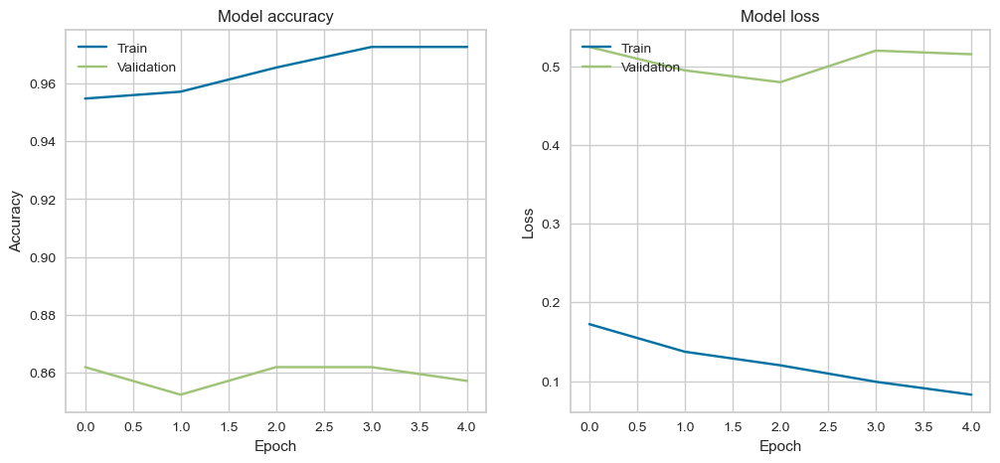

In [15]:
# Tracer les courbes de loss et d'accuracy
def plot_history(history):
    # Plot training & validation accuracy values
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')

    plt.show()

# Entraînement du modèle
history = model.fit(
    train_generator,
    epochs=30,
    validation_data=val_generator,
    callbacks=[early_stopping]
)

# Évaluation du modèle
loss, accuracy = model.evaluate(val_generator)
print(f'Validation Accuracy: {accuracy * 100:.2f}%')

# Stockage des valeurs de métriques dans un DataFrame
history_df = pd.DataFrame(history.history)

# Tracer l'historique de l'entraînement
plot_history(history)

In [16]:
history_df

,accuracy,loss,val_accuracy,val_loss
0,0.954762,0.172417,0.861905,0.524457
1,0.957143,0.137371,0.852381,0.494645
2,0.965476,0.120149,0.861905,0.479684
3,0.972619,0.099248,0.861905,0.519736
4,0.972619,0.082869,0.857143,0.515163
